# Homework1

Please upload to Brightspace a **.zip** archive containing your Jupyter Notebook with solutions and all data required to reproduce your solutions. 

Please also prepare a **requirements.txt** file which lists all the packages that you have used for your homework, one package per line. This will allow us to install all required packages.

Please name your .zip archive using your full name and student id as follows - **Firstname_Lastname_12345678_COMP47350_Homework1.zip**. 

For your Notebook, please split the code and explanations into many little cells so it is easy to see and read the results of each step of your solution. Please remember to name your variables and methods with self-explanatory names. Please remember to write comments and where needed, justifications, for the decisions you make and code you write. Feel free to revisit *tips_to_keep_your_ipython_notebook_readable_and_easy_to_debug.html* provided on Brightspace.

Your code and analysis is like a story that awaits to be read, make it a nice story please. Always start with an introduction about the problem and your understanding of the problem domain and data analytics solution and describe the steps you do and your findings from each step.

The accepted file formats for the homework are:
    - .ipynb
    - .zip
    - .pdf
    - .csv
    
Please keep the whole code in a single notebook. Usage of external tools/files is discouraged for portability reasons. Files in any other format but mentioned above can be used but will be ignored and not considered for the submission (including .doc, .rar, .7z, .pages, .xlsx, .tex etc.). 
Any image format is allowed to be used as far as the images appear embedded in your report (.ipynb or .pdf or .html).

**Deadline: Monday, 8 March, 2021, midnight.** 

## Exercises

This homework focuses on data understanding and preparation for a particular problem and dataset.
The data comes from the Centers for Disease Control and Prevention (CDC: https://covid.cdc.gov/covid-data-tracker/). CDC is a USA health protection agency and is in charge of collecting data about the COVID-19 pandemic, and in particular, tracking cases, deaths, and trends of COVID-19 in the United States. CDC collects and makes public deidentified individual-case data on a daily basis, submitted using standardized case reporting forms. In this analysis, we focus on using the data collected by CDC to build a data analytics solution for death risk prediction. CDC collects demographic characteristics, exposure history, disease severity indicators and outcomes, clinical data, laboratory diagnostic test results, and comorbidities. It also includes information on whether the individual survived or not.

The dataset we work with is a sample of the public data released by CDC, where the outcome for the target feature death_yn is known (i.e., either 'yes' or 'no'):
https://data.cdc.gov/Case-Surveillance/COVID-19-Case-Surveillance-Public-Use-Data/vbim-akqf

Each student will work with a different subset of the data. The CSV file is named using the format: **covid19-cdc-[your-student-number].csv**, e.g., **covid19-cdc-12345678.csv** is the data file for a student with number 12345678. You need to work with the CSV file corresponding to your student number, available from this link: https://drive.google.com/drive/folders/1HiAbcwh7-JT3UXn5qfd4Xo89kfwXISJ9?usp=sharing. There are 4 parts for this homework. Each part has an indicative maximum percentage given in brackets, e.g., part (1) has a maximum of 40% shown as [40].



(1). [40] Prepare a data quality report for your CSV file. Below you have a set of guideline steps to help you in this process.

    - Check how many rows and columns your CSV has.
    
    - Print the first and the last 5 rows.
    
    - Convert the features to their appropriate data types (e.g., decide which features are more appropriate as 
    continuos and which ones as categorical types). 
    
    - Drop duplicate rows and columns, if any.
    
    - Drop constant columns, if any.
    
    - Save your updated/cleaned data frame to a new csv file.
  
For the updated CSV and data frame (after column/row removal):

    - Prepare a table with descriptive statistics for all the continuous features.
    
    - Prepare a table with descriptive statistics for all the categorical features.
    
    - Plot histograms for all the continuous features.
    
    - Plot box plots for all the continuous features.
    
    - Plot bar plots for all the categorical features.
    
    - Discuss your initial findings.
    
    - Save the initial discussion of your findings into a single data quality report PDF file.      
    
The PDF report should focus on the key issues identified in the data and discuss potential strategies to handle them. Simple listing of tables and plots without discussion of findings will not receive full marks. To receive full marks you need to show your understanding and analysis of the dataset, through a detailed discussion for each feature. The report should be concise and complete, the goal is not to make it long for the sake of length, but to cover all the important aspects of the features.

(2). [30] Prepare a data quality plan for the cleaned CSV file. 

    - Mark down all the features where there are potential problems or data quality issues.
    
    - Propose solutions to deal with the problems identified. Explain why did you choose one solution over 
    potentially many other. It is very important to provide justification for your thinking in this part and to list potential solutions, including the solution that will be implemented to clean the data.
    
    - Apply your solutions to obtain a new CSV file where the identified data quality issues were addressed. 
    
    - Save the new CSV file with a self explanatory name. 
    
    - Save the data quality plan to a single PDF file.
        
(3). [15] Exploring relationships between feature pairs:

    - Choose a subset of features you find promising and plot pairwise feature interactions (e.g., 
    continuous-continuous feature plot or continuous-categorical plots or correlation plots). 
    Explain your choices.
    
    - Discuss your findings from the plots above. Do you find any features or feature combinations that are 
    indicative of the target outcome? Explain in plain words (a short paragraph) the story of your
    findings so far.
    
(4). [15] Transform, extend or combine the existing features to create a few new features (at least 3) with the aim to better capture the problem domain and the target outcome. Justify the steps and choices you are making. Add these features to your clean dataset and save it as a CSV file with a self explanatory name. 

In [1]:
###---------------BEGIN-------------------###

# Data Analytics - Data Preparation and Understanding - HW01

## Audit

Author: ARyan - 14395076

Module: COMP47350

DC:     2021-02-08

DLM:    2021-02-08

Desc:   This file contains an analysis of the COVID19 data set and produces a data quality report.

Dict:   The Data Dictionary for the Data Set is available at: https://www.cdc.gov/coronavirus/2019-ncov/downloads/data-dictionary.pdf

## Table of Contents

00. Introduction

01. Exec Summary and Results

02. Modules

03. Constants

04. Ingestion

05. Cleansing

07. Automated Analysis Functions


## 00. Introduction

### 00.01 Background

COVID-19 is an infectious disease caused by SARS-CoV-2, a coronavirus strain discovered in December 2019 first identified following an outbreak in the Chinese city Wuhan, with the WHO declaring the outbreak a global pandemic in March 2020.

Since its discovery, health organisations have been actively gathering data to assess aspects of the disease including infectivity, symptoms, and mortality rate. Active interest has been paid to factors which may increase a patient's risk of serious symptons or death.

In this analysis, we focus on using the data collected by CDC to build an analytics solution for predicting a patients' death risk prediction. CDC collects demographic characteristics, exposure history, disease severity indicators and outcomes, clinical data, laboratory diagnostic test results, and comorbidities. It also includes information on whether the individual survived or not.

### 00.02 Problem Scope

We wish to develop a model to predict the risk of a patient dying based on various metrics collected by the CDC.

### 00.03 Data

The CDC collects demographic data, exposure history, disease severity indicators, outcomes, clinical data, comorbidities, and whether the patient survived. The full data dictionary provided by the CDC is available at the following location: https://www.cdc.gov/coronavirus/2019-ncov/downloads/data-dictionary.pdf

For this assignment, a sample of ten thousand rows are provided from the full dataset available from: https://covid.cdc.gov/covid-data-tracker/

### 00.04 Approach

The assignment was broadly approached as follows but these were non-hard boundaries:

1. Exploratory Data Analysis - Investigsating the Data Set Provided.
2. Data Quality Report - Investigating the Sample Provided for Data Quality Issues 
3. Data Quality Plan - Developing a plan to address and action issues with data quality.
4. Extending Data - Addding additional features
5. Exploratory Analysis - Comparing the relationships between key feature pairs.

This does not align with the structure provided as for the dataset provided a less rigid approach made more sense.

### 00.05 Limitation

As requested in the exercise, the key findings are prepared within the Notebook File and accompanying PDFs.

## 1. Data Quality Report


#### 0. Background

COVID-19 is an infectious disease caused by SARS-CoV-2, a coronavirus strain discovered in December 2019 first identified following an outbreak in the Chinese city Wuhan, with the WHO declaring the outbreak a global pandemic in March 2020.

Since its discovery, health organisations have been actively gathering data to assess aspects of the disease including infectivity, symptoms, and mortality rate. Active interest has been paid to factors which may increase a patient's risk of serious symptons or death.

In this analysis, we focus on using the data collected by CDC to build an analytics solution for predicting a patients' death risk prediction. CDC collects demographic characteristics, exposure history, disease severity indicators and outcomes, clinical data, laboratory diagnostic test results, and comorbidities. It also includes information on whether the individual survived or not.

#### 1. Overview
This report will outline the initial findings based on the provided sample of the CDC dataset. It will summarise the data, describe the various data quality issues observed and how they will be addressed. 

Appendix includes terminology, assumptions, explanations and summary of changes made to the original dataset. This also includes feature summaries and boxplots used to visualise the data.

#### 2. Summary
The following are the key points in relation to the data set and approach:

* The dataset lacks a primary key.

* The dataset lacks a patient identifier so we cannot look for readmitted patients.

* The dataset consists of 10,000 rows and 12 (non-repeated) columns.
    * 4 features are datetime features formatted as YYYY/MM/DD.
    * 3 of these are demographic
    * 4 are booleans with additional values
    * 1 is a diagnosis classifier
    * All features are categorical in nature, however there is scope for the addition of featuers.

* While null values are largely absent from the dataset, there are high proportions of values flagged as 'missing' and 'unknown', with some features containing both missing and unknown values. The distinction between missing and unknown should be confirmed with a source knowledgeable on the data set, however the author's initial recommendation is that these features would be likely targets for imputation mapping both features to a single 'unknown' value.

* The datetime columns are most heavily affected by null or missing values. The author notes that the cdc data dictionary highlights the depreciation of the cdc_report_dt column and points to the usage of cdc_case_earliest_dt in its place. Following this, the author recommends removing the now depreciated cdc_report_dt column.
    * 515 rows feature a cdc_case_earliest_dt date which does not match the minimum of the other datetime columns as implied in the cdc data dictionary. These instances should be checked with a domain expert to understand the source of these dates and if they are valid. The author suggests including these until later revision.

* The volume of duplicate rows is low at 431 rows (4.3%). Investigation into the cause of duplicates highlights sparse population of data, or common data population, is the primary cause of duplicates (e.g. racial info is missing in 90% of duplicate instances, with icu and medical condition info missing in over 95% of duplicate instances. Although these instances are likely 'valid', the recommendation is to drop these duplicate instances as the high prevalence of missing information is unlikely to provide useful information into our model.

* The features prevalent are good targets for conversion to a 'category' datatype with limited valid values prevelant across all category features.

* There is one record where there is an icu admission flagged but not a hospital admission. This record should be removed due to inconsistency in the data and low impact on overall set.

* The current_status column contains 93% Laboratory confirmed cases. It should be identified with a domain expert as to whether the probable cases must be considered. If the probable cases can be dropped, the recommendation is to remoe the probable cases and remove this feature however this will be included in further components of the analysis.

#### 3. Logical Integrity

As the dataset has a heavy focus on categorical data, the following tests were carried out to asses the integrity of the dataset

* T1: Check if there are cdc_case_earliest_dt's which are not the earliest of the other dates
    *Result: 2857 (29%) Records which are not the earliest
    *Result: 515 (5%) Records which are not the earliest where not all of the other dates are populated
        *Query: Where does this data come from?

* T2: Check if there are ICU admissions without hospital admissions.
    *Result: 1 Record which should be updated
    
* T3: Check if there are probable cases with a confirmed positive specimen
    *Result: 227 Record which should be updated to laboratory confirmed
    *Result: 248 Records when hospital admission is also true.
    

#### 4. Non-Datetime Categorical Features
There are 8 non-categorical features in the dataset:

* F1: current_status - A feature to flag if the case is confirmed via lab or suspected.
        * Null: Not applicable.
        * Top Value: Laboratory Confirmed Case - 93% of rows.
        * Unique Values: 2
        * Overall data is reasonable. Actionable item to update probable cases where there is a positive lab specimen.

* F2: sex - A feature to flag the patients' sex.
        * Null: Not applicable.
        * Top Value: Female 53%
        * Unique Values: 4
        * Should be updated to combine unknown values

* F3: age_group - A feature to flag the patients' age group.
        * Null: Not applicable.
        * Top Value: 20-29 Years 18%
        * Unique Values: 10
        * 14 records have an unknown age grouping.

* F4: race_ethnicity_combined - A feature to flag the patients' ethnicity.
        * Null: Not applicable.
        * Top Value: Unknown 41%
        * Unique Values: 10
        * 41% unknown values.
        * Contatenated field with comma separated values. Separation denotes Hispanic or not. This info is already captured via the racial component.


* F5: hosp_yn - A feature to flag if the patient was hospitalised.
        * Null: Not applicable.
        * Top Value: No 52%
        * Unique Values: 5
        * Missing and unknown two separate values. OTH present in one record.
        
* F6: icu_yn - A feature to flag if the patient was admitted to ICU
        * Null: Not applicable.
        * Top Value: Missing 77%
        * Unique Values: 4
        * Check with domain expecrt on missing % reason. Are missing values indicative that the patient never ended up in the ICU and hence it was not flagged? Initial investigation suggsts that Missing Corresponds with No. Note in particular that for younger patients are more heavily represented as a percentage of their age group within the missing category, and similarly older patients are more likely to be represented in the no category than younger patients as a proportion of their age group (something that would appear contradictory). My initial recommendation would be to populate this with 'no' where it is missing, however I would leave any population of the value as the final actionable step so that the ML model can be easily tested with and without this value to decide on a sensible approach. I suspect that older patients are flagged explicitly as being non-ICU patients as there might be more concern over it being needed resulting in an almost skewing of the value.
        
* F7: medcond_yn - A feature to flag if the patient had comorbidities.
        * Null: Not applicable.
        * Top Value: Missing 75%
        * Unique Values: 4
        * 82% unknown and missing values.
  
* **Target Feature**: death_yn - A feature to flag if the patient died.
        * Populated. 3% are yes.
        
#### 5 Datetime Categorical Features
There are 4 categorical datetime features in the dataset:

* D1: cdc_case_earliest_dt - A feature to flag if the case is confirmed via lab or suspected.
        * Null: Not applicable.
        * Top Value: Laboratory Confirmed Case - 93% of rows.
        * Unique Values: 2
        * Overall data is reasonable. Actionable item to update probable cases where there is a positive lab specimen.
        *Covers 325 2nd January 2020 to 16th January 2021 (missing days present) 

* D2: cdc_report_dt - A depreciated column. CDC recommendation is to drop for D1.
        * Should be dropped due to depreciation.

* D3: pos_spec_dt - First positive specimen collected
        * Null: Yes 72% missing
        * Rec: Use to update Status and drop as missing percentage too high.

* D4: onset_dt - Date of symptom onset
        * Null: Yes 49% missing.
        * Top Value: Unknown 41%
        * Unique Values: 326
        * 41% unknown values.
        * Keep for determining time between reporting and symptom onset.
        *Covers 2nd January 2020 to 28th January 2021. 


#### 6 BoxPlots
BoxPlots were produced for all categorical data. These are present in the appendix due to the size of the file. All pairs of data and single value info was calculated as an initial exploration.
    
#### 8. Note: 
The steps provided in the assignment outline more of a linearisation in the process, however upon reviewing the data I did not believe the outlined processed was particularly suitable for this dataset. 

In particular, the processing steps outlined suggest the removal of duplicate values prior to data exploration. As I did not beleive the records were, in fact, duplicates but instead were driven by other elements, it was more reasonable to explore the relationships between various factors before taking any steps to drop rows with overlap, in order to better understand why.

Similarly, the steps provided suggest not adding columns until the final section. Due to the nature of the data and the variety of missing values within some of the indicator and date columns, it seemed to me that valuable information could be obtained based on my initial exploration before any final removal occurs. In particular, the onset datetime column looks to have key value in relation to the asymptomatic prevalence of COVID and the time between initial presentation and symptom onset date. Therefore, adjusting the nature of this column and adding on attributes which reflected the data that was in the original column while preserving and enhancing the data set was logical as an approach before simply dropping this feature for missing prevalency. Similarly, the race column contains race and ethnicity combined however this can be replaced with the racial info as that alone is sufficient to capture the concatenated nature of this. While there may be a need from a reporting purpose in the CDC to compare Hispanic vs Non-Hispanics demographics, reducing the memory usage of the field by stripping the redundant info still allows recovery if this would be insightful.

Due to all of the above, the data quality plan and data quality actioning were, in a sense, completed as a joint process as proper cleansing of the set did not allow for a full linearisation of this process. This steps is detailed below.

### 2 Data Quality Plan

Based on the initial insights, the following is the data quality plan. Full details on reasoning have been already outlined in the data quality report.

A key note is the author wishes to avoid dropping data as an intermediate step unless necessary or directly contradictory data. Acquisition cost of data is too significant to justify dropping data until a step just prior to usage in ML models as retrieval can be challenging. As such, data is being imputed into missing values in general. The Data Action Dictionary is:

data_action_dictionary= 
                          
                          {
                          'cdc_case_earliest_dt':
                                {
                                "Data Quality Issues": "515 Rows where not minimum of other dates populated"
                                ,"Data Quality Actions": "Confirm reason. Otherwise leave as-is"
                                }
                         
                            ,'cdc_report_dt':                                
                                {
                                "Data Quality Issues": "Depreciated"
                                ,"Data Quality Actions":"Drop"
                                }
                         
                            ,'pos_spec_dt':
                                {
                                "Data Quality Issues":"72% of data missing"
                                ,"Data Quality Actions":"Drop after using for status correction"
                                }
                         

                            ,'onset_dt':
                                {
                                "Data Quality Issues":"49% of Data Missing. <1% of dates where onset_dt is too far after case date."
                                ,"Data Quality Actions":"Split into days since symptom. Flag missing data. Drop column. Statistically relevant. Enquire on why some values are so extreme after earliest date"
                                }
                         

                            ,'current_status':
    
                                {
                                "Data Quality Issues": "Probable Cases that should be Laboratory Confirmed Cases"
                                ,"Data Quality Actions":"Update instances"
                                }
                         
    
                            ,'sex':
                                {
                                "Data Quality Issues": "Missing and Unknown flags"
                                ,"Data Quality Actions": "Bin into Unknown category"
                                }
                         

                            ,'age_group':
                                {
                                "Data Quality Issues": "Missing and Unknown flags"
                                ,"Data Quality Actions":"Bin into groups"
                                }
                         
                          ,'race_ethnicity_combined':
                                {
                                "Data Quality Issues":"Concatenated field. Race sufficient to capture all info."
                                ,"Data Quality Actions":"Split field and drop ethnicity"
                                }
                         
                         
                          ,'hosp_yn':
                                {
                                "Data Quality Issues":"Missing, Unknown, and OTH values"
                                ,"Data Quality Actions":"Bin unknown into groups"
                                }
                         
    
                         ,'icu_yn':
                                {
                                "Data Quality Issues":"Missing data 72%."
                                ,"Data Quality Actions":"Determine if missing because 'no'. Column is relevant so await answer before dropping"
                                }
                         
    
                         ,'death_yn':
                                {
                                "Data Quality Issues":"Not applicable"
                                ,"Data Quality Actions":"No action"
                                }
                         
    
                         ,'medcond_yn':
                                    {
                                "Data Quality Issues":"80% missing"
                                ,"Data Quality Actions":"Grouping missing consistently. Column is relevant so keep until answer on cause of missing values"
                                }
                         
                }

A key note is the author wishes to avoid dropping data as an intermediate step unless necessary or directly contradictory data. Acquisition cost of data is too significant to justify dropping data until a step just prior to usage in ML models as retrieval can be challenging. As such, data is being imputed into missing values in general.

# 01. Modules for Code

In [2]:
####--------------------------------------
#00.Import Modules
####--------------------------------------

######---------BEGIN
#      SUPPRESS DEPRECIATION WARNINGS: Applicable to datetime_is_numeric=True
######--------END

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

######---------BEGIN
#      ML
######--------END

#import nltk as nl
#import sklearn as sk
#import matplotlib as mp
#import xgboost as xg
#import pymc3 as pymc
#import sympy as sym



######---------BEGIN
#      SQL/API
######--------END


#import requests as rq
#import sqlalchemy as sqla
#import pyodbc
#import cx_oracle as cx


######---------BEGIN
#     GENERAL
######--------END

import pandas as pd
import datetime as dt
import numpy as np
import sys
import os
#import json
#import time
#import socket
#import traceback as tb
#import platform
#from psutil import virtual_memory
import pickle as pck


######---------BEGIN
#     VISUALISATIONS
######--------END


import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.dates as mdates


#For showing plots directly in the notebook run the command below
%matplotlib inline


###HTML Output Hiding
#Install hide input extension
#!pip install jupyter_contrib_nbextensions
#!jupyter contrib nbextension install --user
#!jupyter nbextension enable hide_input_all/main
#!jupyter nbextension enable hide_input/main
#!jupyter nbextension enable codefolding/main

#!jupyter nbextension disable hide_input_all/main
#!jupyter nbextension disable hide_input/main
#!jupyter nbextension disable codefolding/main

#Update with Filename: Run in Terminal, post completion, after hiding all cells for report
#!jupyter nbconvert --to=html 14395076_Adam_Ryan_HW1_COMP47350.ipynb

In [3]:
#!jupyter nbextension enable hide_input_all/main
#!jupyter nbextension disable hide_input/main
#!jupyter nbextension disable codefolding/main

In [4]:
#!jupyter nbconvert --to=html 14395076_Adam_Ryan_HW1_COMP47350.ipynb

# 02. Constants

In [5]:
i

# 03. Read in CSV

In [6]:
def ingest_orig_covid_data(fp,cdc_dictionary):
    """A function to read in CSV Data and Validate """

    print("Inside ingest_orig_covid_data({},dictionary)".format(fp))

    #Valid Filepath
    if os.path.isfile(fp):

        #read_csv - Do Not Let Pandas Manipulate the Data First - Auto-assign is more memory intensive.
        raw_df=pd.read_csv(fp,dtype=str)
        print(raw_df)

        #row_column data
        shape_of_df=raw_df.shape
        row_count=shape_of_df[0]
        column_count=shape_of_df[1]

        #print info to user
        row_column_print_statement='Your file contains: \n{} rows x {} columns.\n\n'
        row_column_print_statement=row_column_print_statement.format(row_count,column_count)
        print(row_column_print_statement)
        header_statement='The following columns are present:\n'

        #print the headers
        for header in raw_df.columns:
            header_statement+='"{}"\n'.format(header)

        print(header_statement)

        #check if the schema is correct
        if set(raw_df.columns)==set(cdc_dictionary.keys()) and len(raw_df.columns)==len(cdc_dictionary.keys()):
            print('The columns in this data sample match the CDCs schema')

        else:
            print('The columns in this data sample do not match the CDCs schema')

        return raw_df
    
    #Not Valid Filepath
    else:
        print("Invalid filepath - Correct the filepath and re-ingest")
        
        return

In [7]:
raw_covid_sample_data_df=ingest_orig_covid_data(original_filepath,data_dictionary_per_cdc)

Inside ingest_orig_covid_data(.//covid19-cdc-14395076.csv,dictionary)
     cdc_case_earliest_dt cdc_report_dt pos_spec_dt    onset_dt  \
0              2020/09/30    2021/01/27  2020/09/30         NaN   
1              2020/04/16           NaN         NaN         NaN   
2              2020/09/22    2020/10/01         NaN  2020/09/22   
3              2020/10/30    2021/01/22         NaN  2020/10/30   
4              2020/12/17    2020/12/17         NaN         NaN   
...                   ...           ...         ...         ...   
9995           2020/09/24    2020/10/03         NaN  2020/09/24   
9996           2020/12/30           NaN         NaN         NaN   
9997           2020/08/27    2020/08/28         NaN  2020/08/28   
9998           2021/01/04           NaN         NaN         NaN   
9999           2020/09/07    2020/09/26         NaN  2020/09/07   

                 current_status      sex      age_group  \
0     Laboratory-confirmed case   Female  50 - 59 Years   
1     L

# 1. Report begins

## 1.1.  Check how many rows and columns your CSV has.

In [8]:
##Already contained above
shape_of_df=raw_covid_sample_data_df.shape
row_count=shape_of_df[0]
column_count=shape_of_df[1]

#print info to user
row_column_print_statement='Your file contains: \n{} rows x {} columns.\n\n'
row_column_print_statement=row_column_print_statement.format(row_count,column_count)
print(row_column_print_statement)
header_statement='The following columns are present:\n'

Your file contains: 
10000 rows x 12 columns.




## 1.2.  Print the first and the last 5 rows.

In [9]:
sample_statement="The {} {} rows are: "

In [10]:
print(sample_statement.format('first',5))
raw_covid_sample_data_df.head()

The first 5 rows are: 


,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn
0,2020/09/30,2021/01/27,2020/09/30,NaN,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Missing,Missing,No,Missing
1,2020/04/16,NaN,NaN,NaN,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Missing,Missing,No,Missing
2,2020/09/22,2020/10/01,NaN,2020/09/22,Laboratory-confirmed case,Female,10 - 19 Years,"White, Non-Hispanic",No,No,No,No
3,2020/10/30,2021/01/22,NaN,2020/10/30,Laboratory-confirmed case,Female,60 - 69 Years,"Multiple/Other, Non-Hispanic",No,Missing,No,Missing
4,2020/12/17,2020/12/17,NaN,NaN,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Missing,Missing,No,Missing


In [11]:
print(sample_statement.format('last',5))
raw_covid_sample_data_df.tail()

The last 5 rows are: 


,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn
9995,2020/09/24,2020/10/03,NaN,2020/09/24,Laboratory-confirmed case,Female,30 - 39 Years,Hispanic/Latino,No,Missing,No,Missing
9996,2020/12/30,NaN,NaN,NaN,Laboratory-confirmed case,Female,30 - 39 Years,Unknown,Missing,Missing,No,Missing
9997,2020/08/27,2020/08/28,NaN,2020/08/28,Laboratory-confirmed case,Female,10 - 19 Years,Unknown,No,Missing,No,Missing
9998,2021/01/04,NaN,NaN,NaN,Laboratory-confirmed case,Unknown,30 - 39 Years,Unknown,Missing,Missing,No,Missing
9999,2020/09/07,2020/09/26,NaN,2020/09/07,Laboratory-confirmed case,Male,40 - 49 Years,Hispanic/Latino,No,Missing,No,Missing


## 1.3 Convert the features to their appropriate data types (e.g., decide which features are more appropriate as continuos and which ones as categorical types).

## Discussion: 

Based on initially observing Head and Tail, the following are quick obsercations:

Date format on \_datetime columns is 'YYYY/MM/DD'

cdc_report_dt and pos_spect_dt and onset_dt contain empty values

current_status looks to have only one unique value - to be confirmed.

sex - Looks like it should be one of the four values in the data dictionary

age_group - Also looks like it should be one of the mapped values but ensure no entry errors and check for unknowns

race_ethnicity - Looks like missing values are unknown

hosp_yn,icu_yn,medcond_yn = Boolean, but missing is present - identify if blank or not?

death_yn = Confirm Yes or No in all instances.

The data types and values are provided by the CDC data dictionary, and have been embedded into the data_dictionary variable. Analysis of the sample data suggests all data bar the \_dt columns are categorical, while the \_dt columns are of type datetime (and lacking timestamp). As an initial step, all columns will be converted to the appropriate type.

### Data Conversion Actions:

Based on the data dictionary and the sample data above the following decisions are made with respect to data conversion:

cdc_case_earliest_dt is a datetime of type 'YYYY/MM/DD'

cdc_report_dt is a nullable datetime of type 'YYYY/MM/DD'. Per the data dictionary this column is depreciated and should be dropped for 'cdc_case_earliest_dt'. This will be actioned later.

pos_spec_df is a nullable datetime of type 'YYYY/MM/DD'.

current_status is a category, but might be removable.

sex is a category but need to validate the list is valid

age_group is a category but need to validate the list is valid

race is a category but need to validate the list is valid

hosp_yn is a category but need to investigate entries

icu_yn is a category but need to investigate entries

death_yn is a category which looks mandatory.

medcond_yn is a category but need to investigate values

### 1.3.1 Create a staging dataframe. 
The dataflow for industry-implemented data science applications typically follows the ETL Process of:
01. Input
02. Staging
03. Load

A staging dataframe is a copy of the raw dataframe which is used for all work. Work on the original raw dataframe is unadvised as if recovery of original data is needed, the process of reloading the raw data may not be advised. This has a memory hit, but for the small dataset we are dealing with this will not be a problem.

In [12]:
staging_covid_sample_data_df=raw_covid_sample_data_df.copy(False)

### 1.3.2 Get the column types into appropriate lists from the data dictionary

In [13]:
#Take the Datatypes configured from the CDC Dictionary
datetime_columns=[column_headers for column_headers, column_desc_array in data_dictionary_per_cdc.items() if column_desc_array[1] == 'datetime']
categorical_columns=[column_headers for column_headers, column_desc_array in data_dictionary_per_cdc.items() if column_desc_array[1] == 'category']
num_columns=[column_headers for column_headers, column_desc_array in data_dictionary_per_cdc.items() if column_desc_array[1] == 'numeric']
datetime_format='%Y/%m/%d'

### 1.3.3 Convert the columns

In [14]:
def data_convert(df,types,columnlist,dt_format):
    """A function to convert all columns in a list into the appropriate type"""
    
    print("Inside data_convert()")
    
    ###Check if empty
    if df.empty==False:
        
        ##Check if datetime or other
        if types=='datetime':
       
            ###Check if 0
            if len(columnlist)>0:
                print('Converting to {}'.format(types))
                df[columnlist]=df[columnlist].apply(pd.to_datetime,format=dt_format,errors='ignore')
                
            else:
                print('No need to convert to: {}'.format(types))
              
        ###Numeric type
        elif types=='category':
            ###Check if 0
            if len(categorical_columns)>0:
                print('Converting to {}'.format(types))
                df[columnlist]=df[columnlist].astype('category')
                
            ###Nothing to convert
            else:
                print('No need to convert')
                
        ###Numeric type
        elif types=='numeric':
            
            ###Check if 0
            if len(num_columns)>0:
                print('Converting to Numerical')
                df[columnlist]=df[columnlist].apply(pd.to_numeric, errors='ignore')
                
            else:
                print('No need to convert')
                
        ###Other type - e.g. Boolean, string - Dont do anything - force the above types.
        else:
            print('Unknown type')
                
    ###Empty data set          
    else:
        print("Empty dataframe")

In [15]:
data_convert(staging_covid_sample_data_df,'datetime',datetime_columns,datetime_format)
data_convert(staging_covid_sample_data_df,'category',categorical_columns,datetime_format)
data_convert(staging_covid_sample_data_df,'numeric',num_columns,datetime_format)

Inside data_convert()
Converting to datetime
Inside data_convert()
Converting to category
Inside data_convert()
No need to convert


#### 1.3.3.1 Validate the conversion

Check that the columns were converted and explicitly outline the result

In [16]:
staging_covid_sample_data_df.dtypes

cdc_case_earliest_dt       datetime64[ns]
cdc_report_dt              datetime64[ns]
pos_spec_dt                datetime64[ns]
onset_dt                   datetime64[ns]
current_status                   category
sex                              category
age_group                        category
race_ethnicity_combined          category
hosp_yn                          category
icu_yn                           category
death_yn                         category
medcond_yn                       category
dtype: object

### 1.3.4 Explore the Data.

### 1.3.4.1 Produce The Describe table

Description: Before dropping 'duplicates' or any further manipulation, it makes sense to explore the dataframe and identify noteworthy elements. In particular, we will pay attention to 'nullable' columns, identify what values are in each column and the composition of columns, and any apparent noteworthy aspects before doing anything further. Duplicates or columns should not be dropped until the data is thoroughly understood in case there is valuable data or there are, in fact, not duplicates.

In [17]:
def missing_check(row):
    """Highlight rows with potential missing_values"""

    #Configuration Values
    col_to_check=10
    default_colour = 'white'
    flag_colour=''
    high_flag_colour_val='red'
    med_flag_colour_val='orange'
    low_flag_colour_val='yellow'
    val_to_check=0

    #Row length valid
    if len(row)>=col_to_check:

        #
        if row.values[col_to_check] == 'High':
            flag_colour = high_flag_colour_val
            
        elif row.values[col_to_check] == 'Medium':
            flag_colour = med_flag_colour_val
            
        elif row.values[col_to_check] == 'Low':
            flag_colour = low_flag_colour_val

        if flag_colour=='':
            colour=default_colour
        else:
            colour=flag_colour

        return ['background-color: {}'.format(colour)]*len(row.values)

    else:
        print('Row too short - Reconfigure Column Number')
        return ['background-color: {}'.format(default_colour)]*len(row.values)
    
def dt_missing_check(row):
    """Highlight rows with potential missing_values"""

    #Configuration Values
    col_to_check=9
    default_colour = 'white'
    flag_colour=''
    high_flag_colour_val='red'
    med_flag_colour_val='orange'
    low_flag_colour_val='yellow'
    val_to_check=0

    #Row length valid
    if len(row)>=col_to_check:

        #
        if row.values[col_to_check] == 'High':
            flag_colour = high_flag_colour_val
            
        elif row.values[col_to_check] == 'Medium':
            flag_colour = med_flag_colour_val
            
        elif row.values[col_to_check] == 'Low':
            flag_colour = low_flag_colour_val

        if flag_colour=='':
            colour=default_colour
        else:
            colour=flag_colour

        return ['background-color: {}'.format(colour)]*len(row.values)

    else:
        print('Row too short - Reconfigure Column Number')
        return ['background-color: {}'.format(default_colour)]*len(row.values)

#### 1.3.4.1.2 Datetime type note.
The source code of pandas deals with datetimes as both strings and numeric values

In [18]:
#Format Dictionary:
non_numeric_format_dictionary={
                              '% Populated': "{:.0f}%"
                              ,'% Missing': "{:.0f}%"
                                ,'% Top Value':"{:.0f}%"}





#Produce a summary table - Note the continuous features in this dataset are dates
#Note: As of now, pandas allows using describe with dates so keeping it in, but this will be depreciated
category_summary_df=staging_covid_sample_data_df.describe().T

#Add what Percent is populated
category_summary_df['% Populated']=100*(category_summary_df['count']/row_count)

#Percent missing
category_summary_df['% Missing']=100-category_summary_df['% Populated']

#Prevelance of top vlaue
category_summary_df['% Top Value']=100*(category_summary_df['freq']/row_count)

#Give a warning depending on quartile of missing data - upper quartiles are high
category_summary_df['Missing Warning']=np.select([(category_summary_df['% Missing']==0),(category_summary_df['% Missing']>0) & (category_summary_df['% Missing']<25),(category_summary_df['% Missing']>=25) & (category_summary_df['% Missing']<50),category_summary_df['% Missing']>=50],['None','Low','Medium','High'])

category_summary_df=category_summary_df.reset_index()
category_summary_df=category_summary_df.rename(columns={"index": "feature"})


(category_summary_df.style.apply(missing_check, axis=1)
                                         .format(non_numeric_format_dictionary))

,feature,count,unique,top,freq,first,last,% Populated,% Missing,% Top Value,Missing Warning
0,cdc_case_earliest_dt,10000,325,2020-12-29 00:00:00,119,2020-01-02 00:00:00,2021-01-16 00:00:00,100%,0%,1%,None
1,cdc_report_dt,7658,323,2020-06-10 00:00:00,125,2020-01-20 00:00:00,2021-01-29 00:00:00,77%,23%,1%,Low
2,pos_spec_dt,2825,316,2020-11-09 00:00:00,36,2020-03-05 00:00:00,2021-01-23 00:00:00,28%,72%,0%,High
3,onset_dt,5084,326,2020-12-08 00:00:00,44,2020-01-02 00:00:00,2021-01-28 00:00:00,51%,49%,0%,Medium
4,current_status,10000,2,Laboratory-confirmed case,9330,NaT,NaT,100%,0%,93%,None
5,sex,10000,4,Female,5339,NaT,NaT,100%,0%,53%,None
6,age_group,10000,10,20 - 29 Years,1826,NaT,NaT,100%,0%,18%,None
7,race_ethnicity_combined,10000,9,Unknown,4071,NaT,NaT,100%,0%,41%,None
8,hosp_yn,10000,5,No,5249,NaT,NaT,100%,0%,52%,None
9,icu_yn,10000,4,Missing,7662,NaT,NaT,100%,0%,77%,None


#### Discussion:
Population is primarily good outside of the date columns. Oddly the booleans have a uniqueness count above what is expected. We will identify this later and impute 'missing' values consistently. Only 3% of rows feature a death_yn, 25% of rows are missing a medical condition, and 23% of rows are msising icu_yn.

In [19]:
numeric_format_dictionary={'count':"{:.0f}"
                 ,'% Populated': "{:.0f}%"
                ,'% Missing': "{:.0f}%"
                ,'% Top Value':"{:.0f}%"}

date_staging_df=staging_covid_sample_data_df.describe(datetime_is_numeric=True).T


#Add what Percent is populated
date_staging_df['% Populated']=100*(date_staging_df['count']/row_count)
date_staging_df['% Missing']=100-date_staging_df['% Populated']
#date_staging_df['% Top Value']=100*(date_staging_df['freq']/row_count)
date_staging_df['Missing Warning']=np.select([(date_staging_df['% Missing']==0),(date_staging_df['% Missing']>0) & (date_staging_df['% Missing']<25),(date_staging_df['% Missing']>=25) & (date_staging_df['% Missing']<50),date_staging_df['% Missing']>=50],['None','Low','Medium','High'])
date_staging_df = pd.concat([date_staging_df, pd.DataFrame(staging_covid_sample_data_df[datetime_columns].nunique(),columns=['unique'])], axis=1)

(date_staging_df.style.apply(dt_missing_check, axis=1)
                                         .format(numeric_format_dictionary))

,count,mean,min,25%,50%,75%,max,% Populated,% Missing,Missing Warning,unique
cdc_case_earliest_dt,10000,2020-10-04 13:02:21.120000,2020-01-02 00:00:00,2020-07-25 00:00:00,2020-11-06 00:00:00,2020-12-15 00:00:00,2021-01-16 00:00:00,100%,0%,None,325
cdc_report_dt,7658,2020-10-15 12:43:48.780360448,2020-01-20 00:00:00,2020-08-13 00:00:00,2020-11-12 00:00:00,2020-12-21 00:00:00,2021-01-29 00:00:00,77%,23%,Low,323
pos_spec_dt,2825,2020-09-17 09:01:20.283185920,2020-03-05 00:00:00,2020-07-03 00:00:00,2020-10-16 00:00:00,2020-12-01 00:00:00,2021-01-23 00:00:00,28%,72%,High,316
onset_dt,5084,2020-09-21 17:11:33.941778176,2020-01-02 00:00:00,2020-07-15 00:00:00,2020-10-20 00:00:00,2020-12-02 00:00:00,2021-01-28 00:00:00,51%,49%,Medium,326


### 1.3.4.2 Unique values and frequency.
As part of the initial exploration, we will group all unique values, and provide a dataframe output and a PDF graphing the values.

A sensible initial starting point is to look first at the single column, and then all pairs of relations as an initial exploratory step.

In order to capture the fact that we have not yet cleansed any data, and as we have not yet fully examined which dates are more prevelant, we will normalise each of the graphs but NOT scale the graph results. As a result, another dimension will be added to the graph capturing the dominance of certain features by how much of the graph the column occupies.

Similarly, as I am not grouping for multi-indexed dataframes the same column twice, these values will be present in the dataframe with '0' due to the usage of the 'category' column type (this is in-built Python behaviour where all categories are shown even if not explicitly listed when grouped over). These single value featuers should be examined as part of the grouping over single features

In [20]:
def group_over_single_categories(df,categorical_columns,pdf_fn, save_fig=True):
    """A function to group over the categories"""
    
    print("Inside group_over_single_categories()")
    row_count=len(df)

    grouping_type={}
    timestamp_now=dt.datetime.timestamp(dt.datetime.now())
    
    #Dataframe is not empty, and there are categorical columns to group over:
    if df.empty==False and len(categorical_columns)>0:
        with PdfPages(pdf_fn) as pp: #lab
            column=''

            #Let's go through the category column type
            for column in categorical_columns:

                #Separator
                print('\n\n----------------------\n\n')
                agg_df=df.groupby([column]).agg({df.columns[0]:"count"})
                print(agg_df)
                agg_df=agg_df.reset_index()
                agg_df=agg_df.rename(columns={df.columns[0]:'Rows'})

                #Note: Could also do value_counts but I prefer that for graphing.
                agg_df['% Frequency']=100*(agg_df['Rows']/row_count)

                #Be explicit over what we're displaying
                print('Grouping over {} results in:\n'.format(column))

                #Display the result
                display(agg_df)
                #Graphing Section:

                figure = (
                            df[column]
                              .value_counts(dropna=True, normalize=True)
                              .plot(kind='bar'
                                    ,title='Count of values for {}'.format(column)
                                    , xlabel='Field Values'
                                    , ylabel='Count of Values'
                                    , figsize=(35,35)
                                   )
                 )
                #This grid style is from the sample Lab5 as I like how it looks
                plt.ylim([0,1])
                plt.grid(b=True, which='major', color='#666666', linestyle='-')
                plt.setp(figure.get_xticklabels(), ha="right", rotation=0)
                plt.minorticks_on()
                plt.grid(b=True, which='minor', color='#999999', linestyle='-', alpha=0.2)
                plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)
                plt.show()
                grouping_type[column]=agg_df

                if save_fig:
                    pp.savefig(figure.get_figure())


                





    
    return grouping_type

In [21]:
def group_over_multi_categories(df,categorical_columns,pdf_fn,save_output=False,save_fig=False):
    """A function to group over all pairs of categories
    
    Warning: This can be memory intensive as we have (columnCount)C(2) pairings, so only run this if your device is able!"""
    
    print("Inside group_over_multi_categories()")
    row_count=len(df)
    grouping_type={}
    timestamp_now=dt.datetime.timestamp(dt.datetime.now())
    
    #Try run this
    try:
    
        #Dataframe is not empty, and there are categorical columns to group over:
        if df.empty==False and len(categorical_columns)>0:
            with PdfPages(pdf_fn) as pp:
                column=''
                second_column=''
                
                #Let's go through the category column type
                for column in categorical_columns:

                    #Second index, n^2
                    for second_column in categorical_columns:
                        multi_column=[column]


                        #Create a key to access - pipe delimited as columns contain _
                        grouping_key="{}|{}"

                        #No point in grouping the same column twice
                        if second_column!=column:
                            multi_column+=[second_column]
                            grouping_key=grouping_key.format(column,second_column)

                            #Separator
                            print('\n\n----------------------\n\n')
                            agg_df=df.groupby(multi_column).agg({df.columns[0]:"count"})
                            agg_df=agg_df.reset_index()
                            agg_df=agg_df.rename(columns={df.columns[0]:'Rows'})
                            agg_df['% Frequency']=100*(agg_df['Rows']/row_count)

                            #Be explicit over what we're displaying
                            print('Grouping over {} results in:\n'.format(grouping_key))

                            #Display the result
                            display(agg_df)
                            
                            #Graph
                            figure = (
                                        (df[multi_column]
                                              .dropna()
                                              .value_counts(normalize=True)
                                              .reset_index()
                                              .pivot_table(index=column,columns=second_column)
                                              .fillna(0))[0]
                                                      .plot(kind='bar'
                                                        , stacked=True
                                                        , title='Count of values for {} vs {}'.format(second_column,column)
                                                        , xlabel='Field Values'
                                                        , ylabel='Count of Values'
                                                        , figsize=(35,35)

                                                            
                                                           )
                                     )
                
                            #This grid style is from the sample Lab5 as I like how it looks
                            plt.ylim([0,1])
                            plt.grid(b=True, which='major', color='#666666', linestyle='-')
                            plt.setp(figure.get_xticklabels(), ha="right", rotation=0)
                            plt.minorticks_on()
                            plt.grid(b=True, which='minor', color='#999999', linestyle='-', alpha=0.2)
                            plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)
                            plt.show()

                            

                            if save_fig:
                                pp.savefig(figure.get_figure())

                            #Only save if explicitly passed - This could kill your memory.
                            if save_output:
                                grouping_type[grouping_key]=agg_df

                        
    #Catch exceptions
    except Exception as exc:
        print("Function exception:\n")
        #check exception is memory error
        if exc==MemoryError:
            print("Sorry, your device is not able to run this function as you have hit a memory limit")
            
        print(exc)
        

    return grouping_type

#### 1.3.4.2.1 Single Groupings

Inside group_over_single_categories()


----------------------


                           cdc_case_earliest_dt
current_status                                 
Laboratory-confirmed case                  9330
Probable Case                               670
Grouping over current_status results in:



,current_status,Rows,% Frequency
0,Laboratory-confirmed case,9330,93.3
1,Probable Case,670,6.7


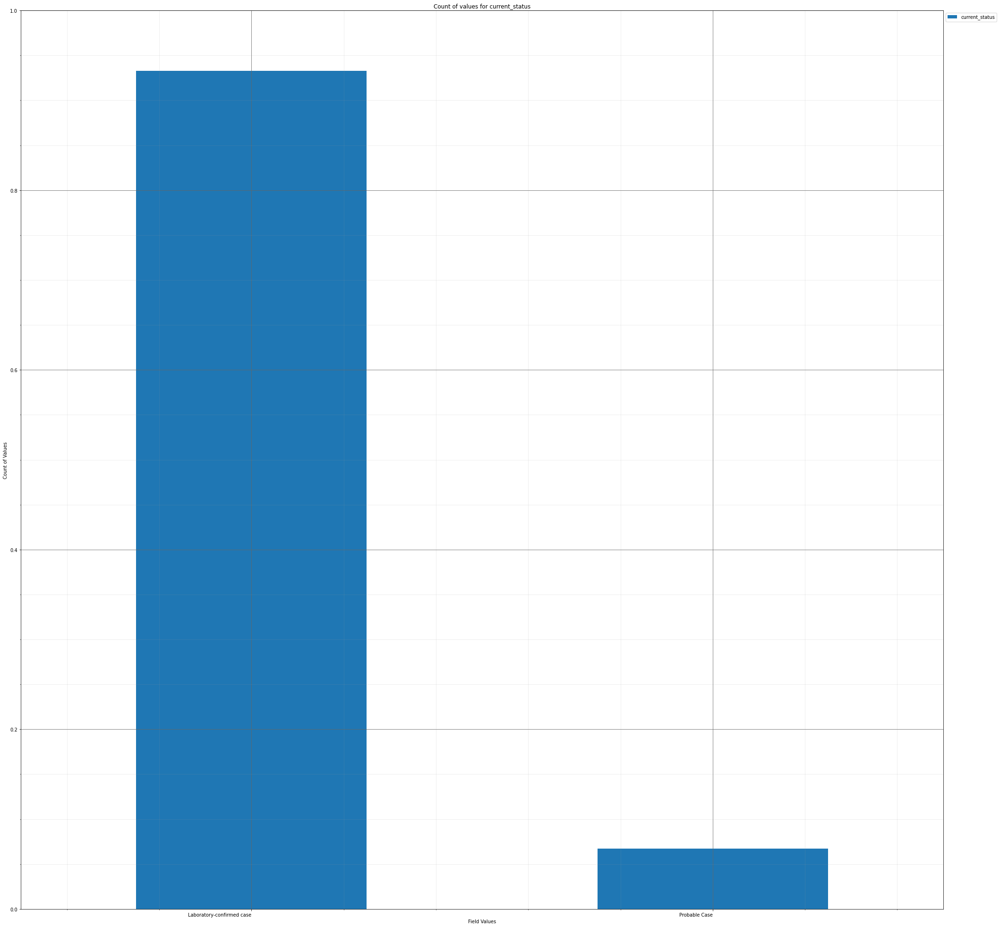



----------------------


         cdc_case_earliest_dt
sex                          
Female                   5339
Male                     4576
Missing                    13
Unknown                    72
Grouping over sex results in:



,sex,Rows,% Frequency
0,Female,5339,53.39
1,Male,4576,45.76
2,Missing,13,0.13
3,Unknown,72,0.72


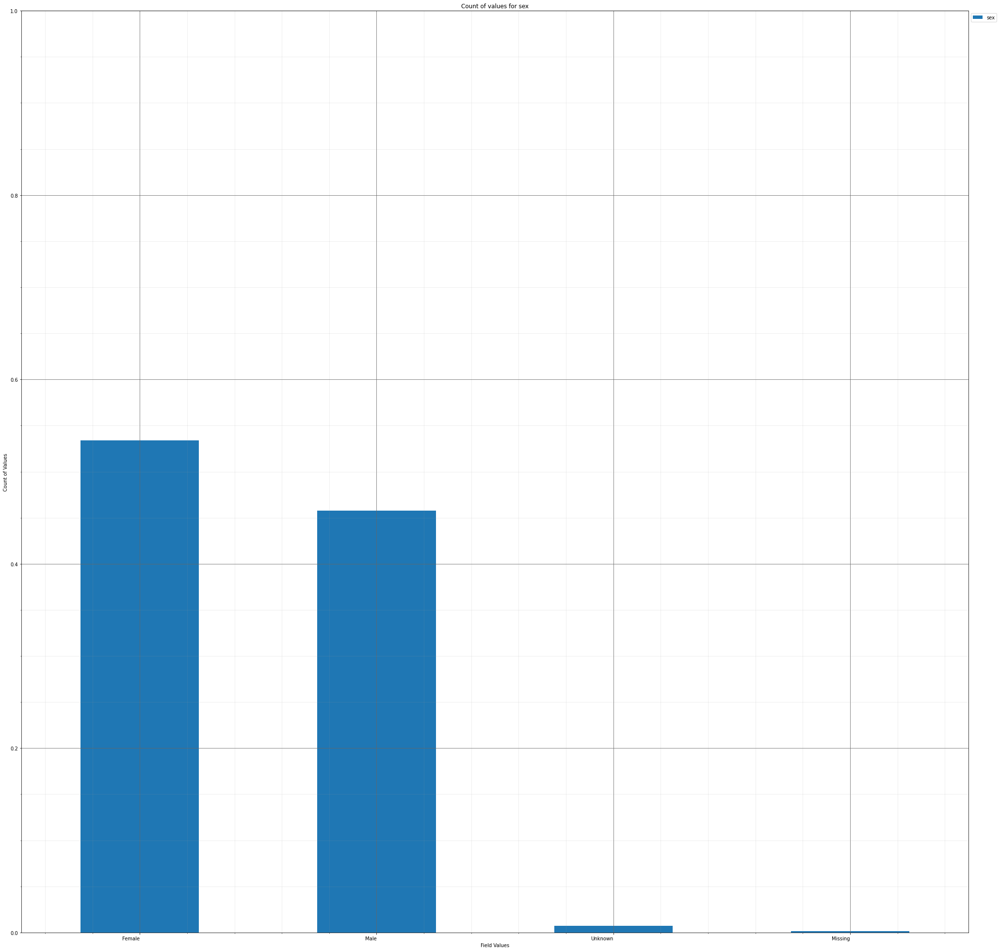



----------------------


               cdc_case_earliest_dt
age_group                          
0 - 9 Years                     468
10 - 19 Years                  1069
20 - 29 Years                  1826
30 - 39 Years                  1611
40 - 49 Years                  1472
50 - 59 Years                  1409
60 - 69 Years                  1047
70 - 79 Years                   622
80+ Years                       462
Missing                          14
Grouping over age_group results in:



,age_group,Rows,% Frequency
0,0 - 9 Years,468,4.68
1,10 - 19 Years,1069,10.69
2,20 - 29 Years,1826,18.26
3,30 - 39 Years,1611,16.11
4,40 - 49 Years,1472,14.72
5,50 - 59 Years,1409,14.09
6,60 - 69 Years,1047,10.47
7,70 - 79 Years,622,6.22
8,80+ Years,462,4.62
9,Missing,14,0.14


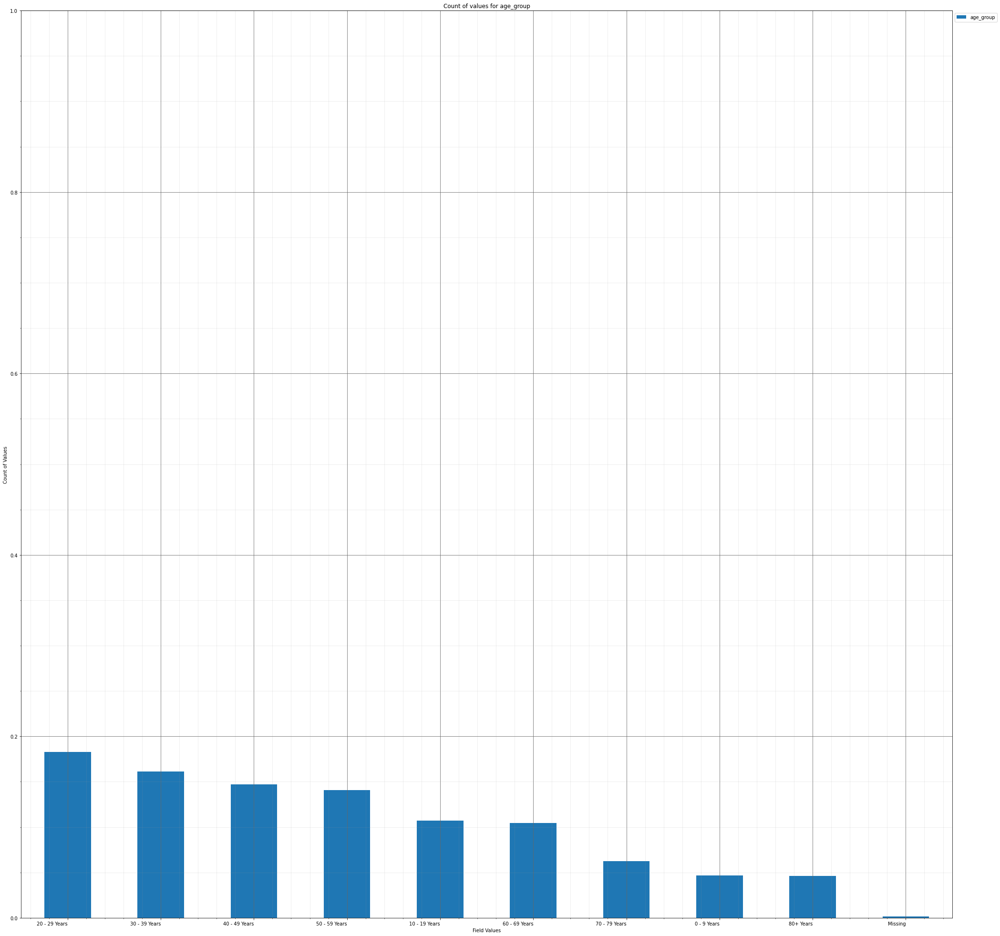



----------------------


                                                    cdc_case_earliest_dt
race_ethnicity_combined                                                 
American Indian/Alaska Native, Non-Hispanic                           66
Asian, Non-Hispanic                                                  242
Black, Non-Hispanic                                                  695
Hispanic/Latino                                                      929
Missing                                                              109
Multiple/Other, Non-Hispanic                                         518
Native Hawaiian/Other Pacific Islander, Non-His...                    23
Unknown                                                             4071
White, Non-Hispanic                                                 3347
Grouping over race_ethnicity_combined results in:



,race_ethnicity_combined,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",66,0.66
1,"Asian, Non-Hispanic",242,2.42
2,"Black, Non-Hispanic",695,6.95
3,Hispanic/Latino,929,9.29
4,Missing,109,1.09
5,"Multiple/Other, Non-Hispanic",518,5.18
6,"Native Hawaiian/Other Pacific Islander, Non-Hi...",23,0.23
7,Unknown,4071,40.71
8,"White, Non-Hispanic",3347,33.47


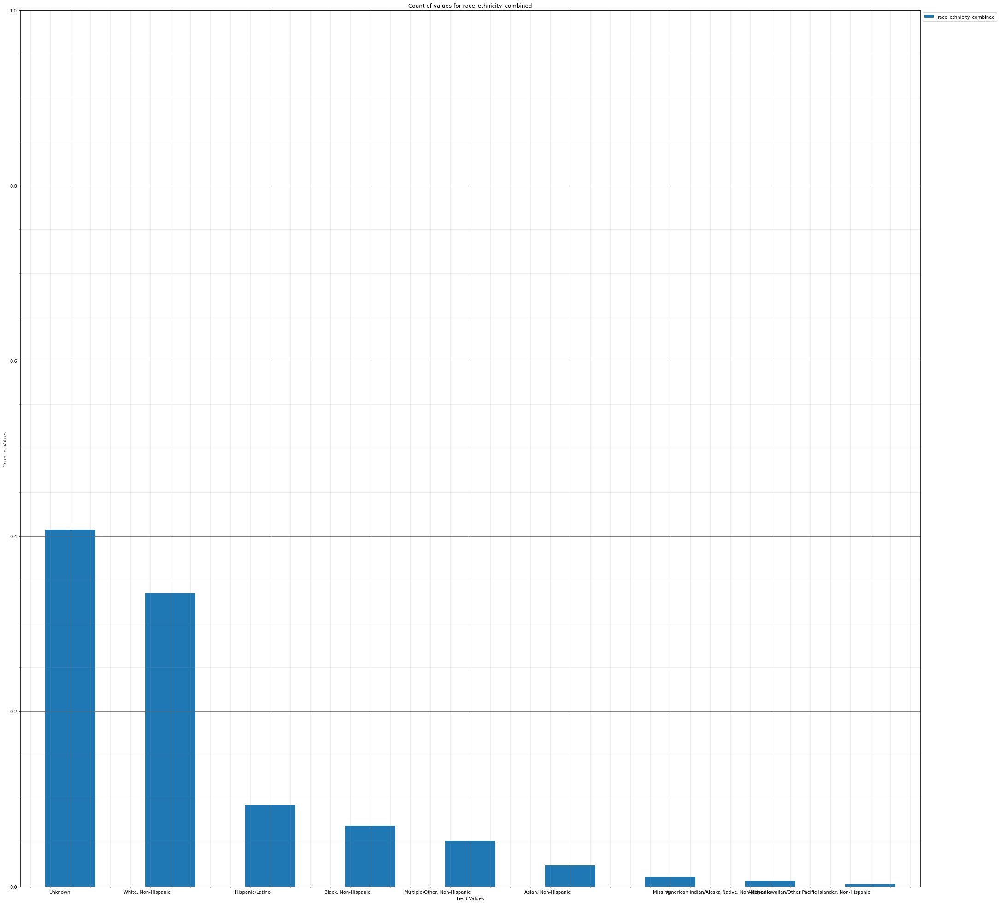



----------------------


         cdc_case_earliest_dt
hosp_yn                      
Missing                  2343
No                       5249
OTH                         1
Unknown                  1708
Yes                       699
Grouping over hosp_yn results in:



,hosp_yn,Rows,% Frequency
0,Missing,2343,23.43
1,No,5249,52.49
2,OTH,1,0.01
3,Unknown,1708,17.08
4,Yes,699,6.99


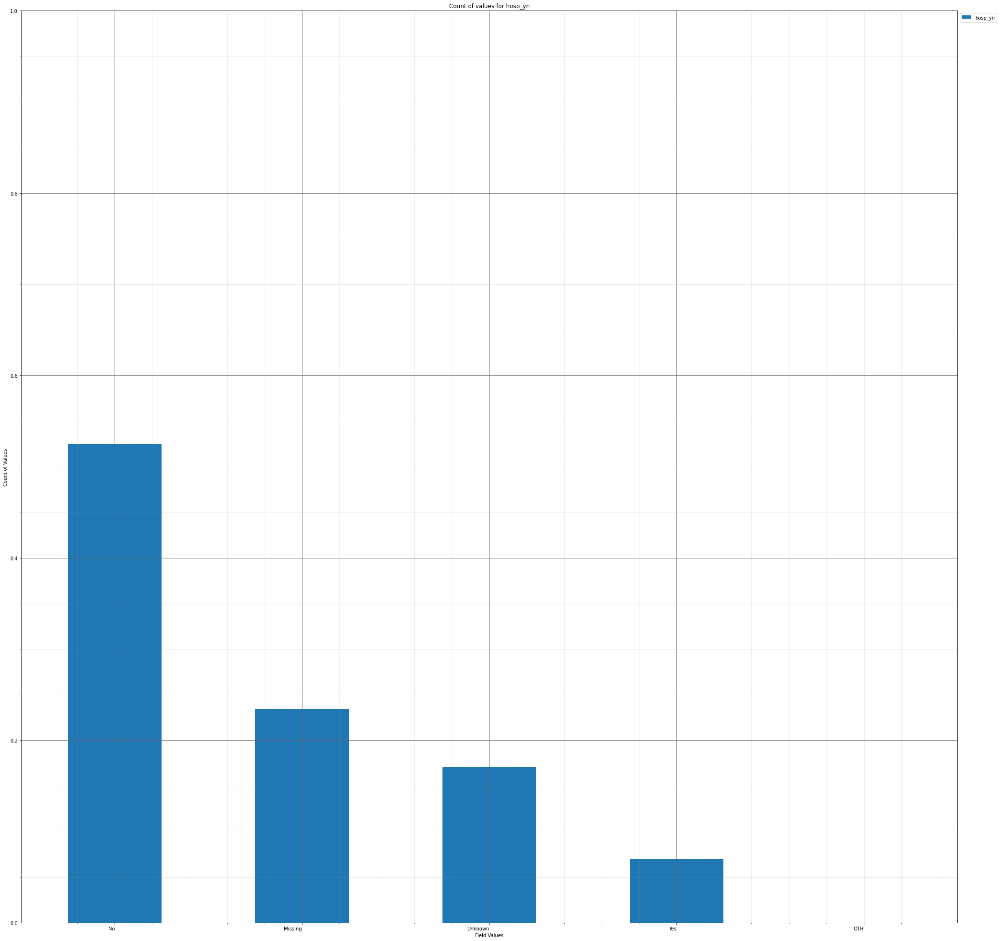



----------------------


         cdc_case_earliest_dt
icu_yn                       
Missing                  7662
No                        958
Unknown                  1288
Yes                        92
Grouping over icu_yn results in:



,icu_yn,Rows,% Frequency
0,Missing,7662,76.62
1,No,958,9.58
2,Unknown,1288,12.88
3,Yes,92,0.92


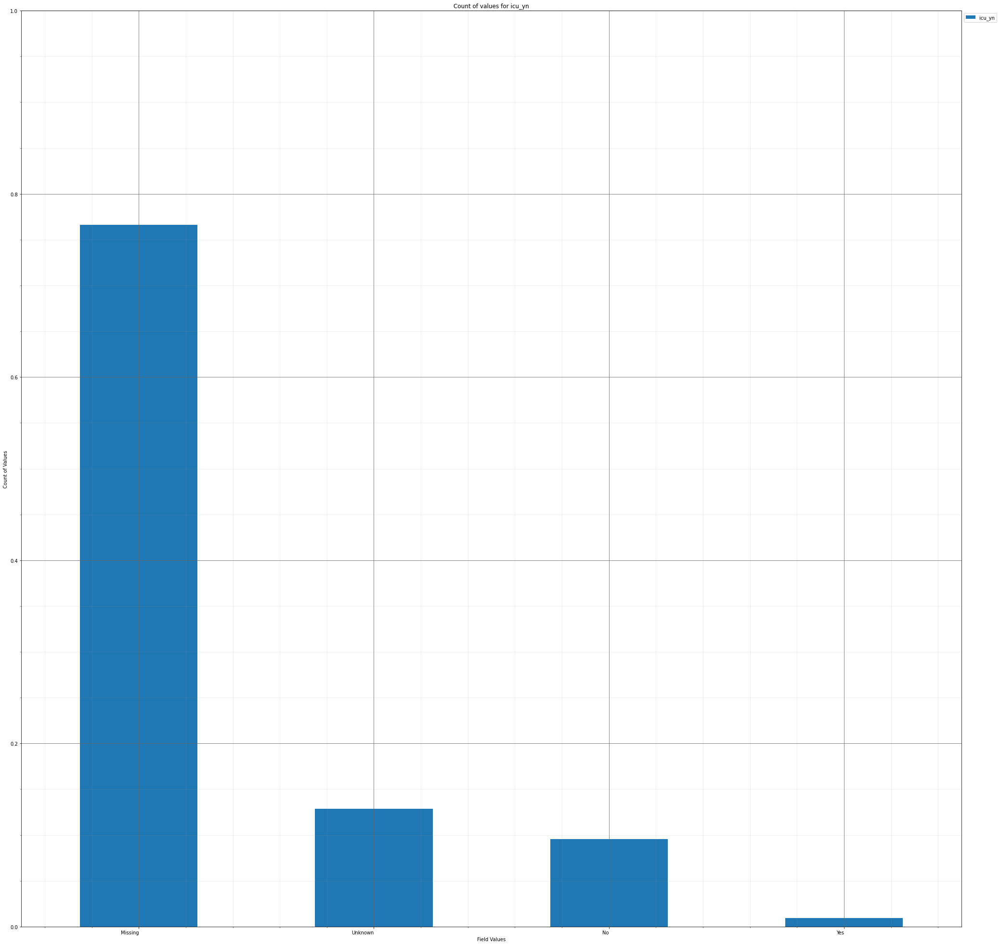



----------------------


          cdc_case_earliest_dt
death_yn                      
No                        9665
Yes                        335
Grouping over death_yn results in:



,death_yn,Rows,% Frequency
0,No,9665,96.65
1,Yes,335,3.35


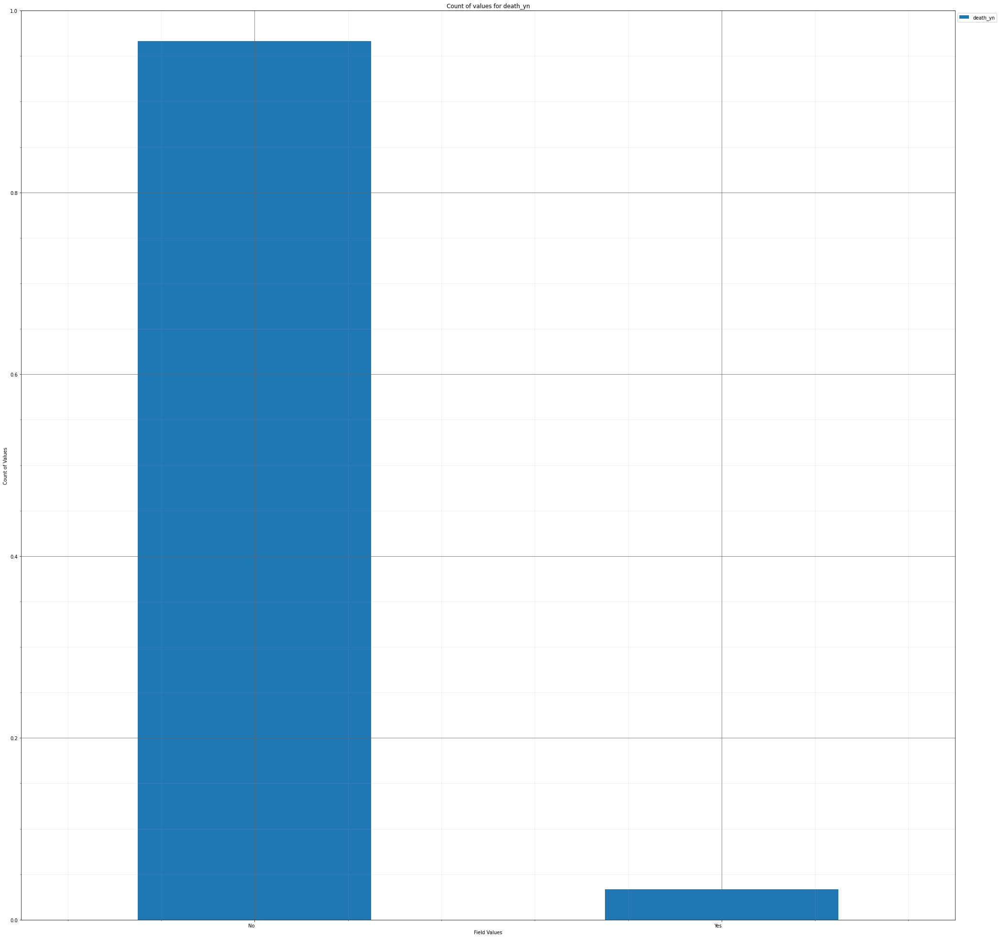



----------------------


            cdc_case_earliest_dt
medcond_yn                      
Missing                     7509
No                           932
Unknown                      722
Yes                          837
Grouping over medcond_yn results in:



,medcond_yn,Rows,% Frequency
0,Missing,7509,75.09
1,No,932,9.32
2,Unknown,722,7.22
3,Yes,837,8.37


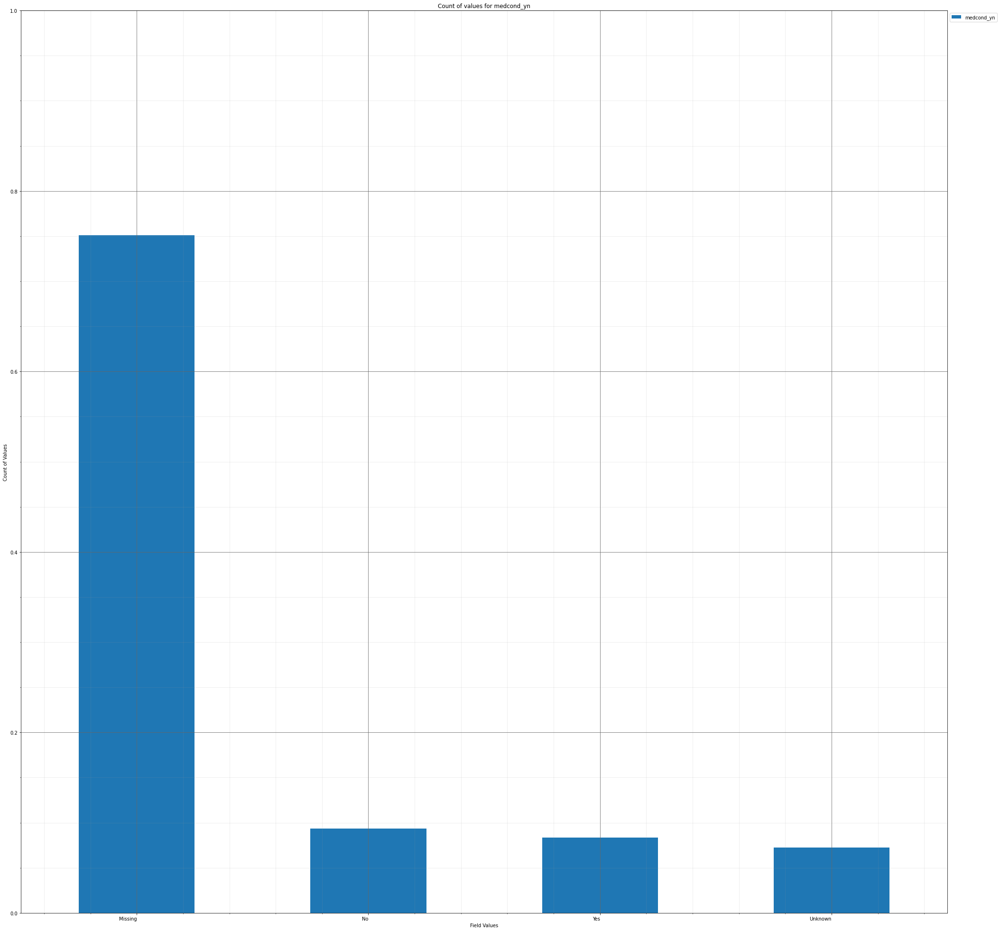

In [22]:
single_frequency_dict={}
single_frequency_dict=group_over_single_categories(staging_covid_sample_data_df,categorical_columns,save_fig=True,pdf_fn=single_categorical_barplot_initial_fn)

#### 1.3.4.2.2 Paired Groupings

Inside group_over_multi_categories()


----------------------


Grouping over current_status|sex results in:



,current_status,sex,Rows,% Frequency
0,Laboratory-confirmed case,Female,4993,49.93
1,Laboratory-confirmed case,Male,4259,42.59
2,Laboratory-confirmed case,Missing,12,0.12
3,Laboratory-confirmed case,Unknown,66,0.66
4,Probable Case,Female,346,3.46
5,Probable Case,Male,317,3.17
6,Probable Case,Missing,1,0.01
7,Probable Case,Unknown,6,0.06


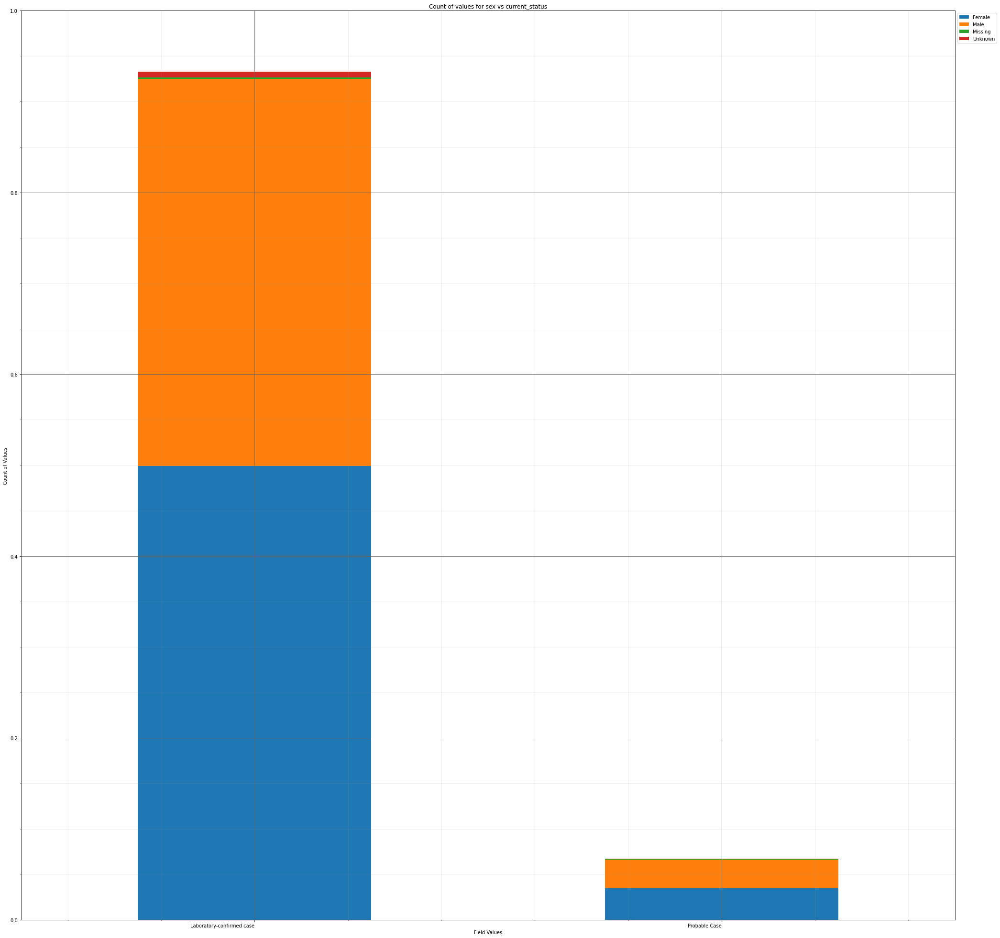



----------------------


Grouping over current_status|age_group results in:



,current_status,age_group,Rows,% Frequency
0,Laboratory-confirmed case,0 - 9 Years,435,4.35
1,Laboratory-confirmed case,10 - 19 Years,984,9.84
2,Laboratory-confirmed case,20 - 29 Years,1715,17.15
3,Laboratory-confirmed case,30 - 39 Years,1527,15.27
4,Laboratory-confirmed case,40 - 49 Years,1381,13.81
5,Laboratory-confirmed case,50 - 59 Years,1312,13.12
6,Laboratory-confirmed case,60 - 69 Years,960,9.60
7,Laboratory-confirmed case,70 - 79 Years,584,5.84
8,Laboratory-confirmed case,80+ Years,428,4.28
9,Laboratory-confirmed case,Missing,4,0.04


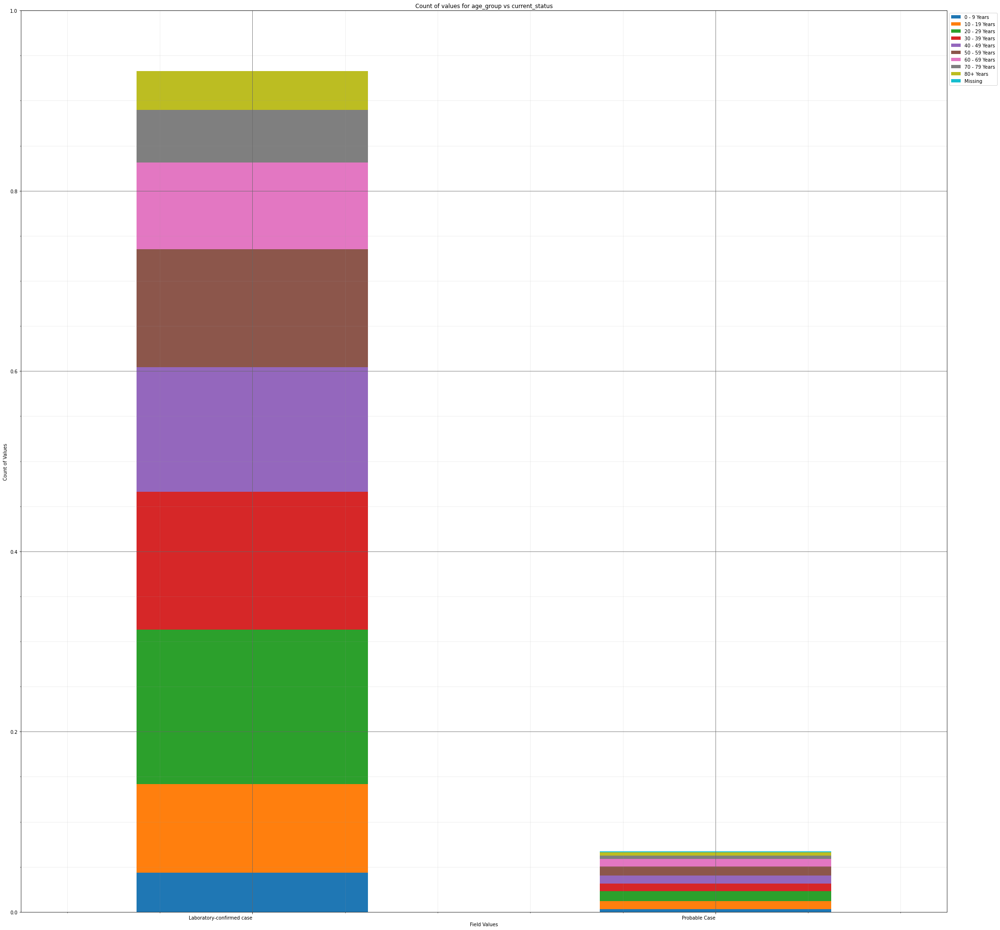



----------------------


Grouping over current_status|race_ethnicity_combined results in:



,current_status,race_ethnicity_combined,Rows,% Frequency
0,Laboratory-confirmed case,"American Indian/Alaska Native, Non-Hispanic",60,0.60
1,Laboratory-confirmed case,"Asian, Non-Hispanic",234,2.34
2,Laboratory-confirmed case,"Black, Non-Hispanic",661,6.61
3,Laboratory-confirmed case,Hispanic/Latino,894,8.94
4,Laboratory-confirmed case,Missing,88,0.88
5,Laboratory-confirmed case,"Multiple/Other, Non-Hispanic",482,4.82
6,Laboratory-confirmed case,"Native Hawaiian/Other Pacific Islander, Non-Hi...",23,0.23
7,Laboratory-confirmed case,Unknown,3845,38.45
8,Laboratory-confirmed case,"White, Non-Hispanic",3043,30.43
9,Probable Case,"American Indian/Alaska Native, Non-Hispanic",6,0.06


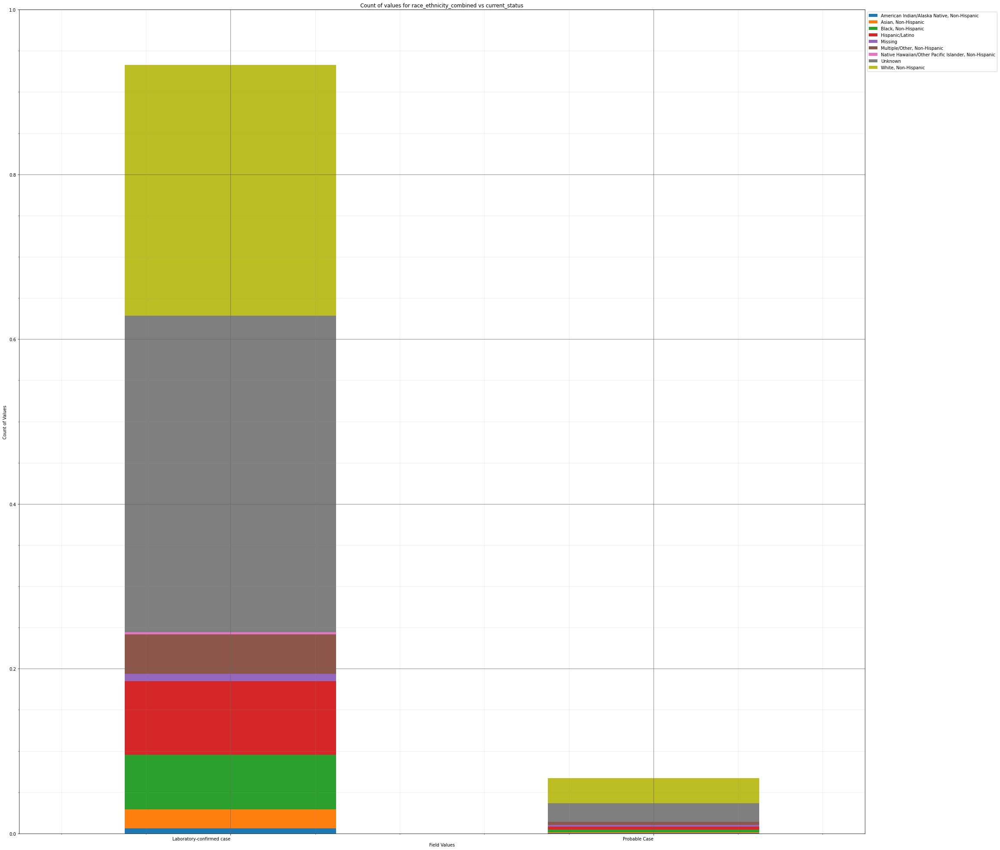



----------------------


Grouping over current_status|hosp_yn results in:



,current_status,hosp_yn,Rows,% Frequency
0,Laboratory-confirmed case,Missing,2173,21.73
1,Laboratory-confirmed case,No,4828,48.28
2,Laboratory-confirmed case,OTH,1,0.01
3,Laboratory-confirmed case,Unknown,1654,16.54
4,Laboratory-confirmed case,Yes,674,6.74
5,Probable Case,Missing,170,1.70
6,Probable Case,No,421,4.21
7,Probable Case,OTH,0,0.00
8,Probable Case,Unknown,54,0.54
9,Probable Case,Yes,25,0.25


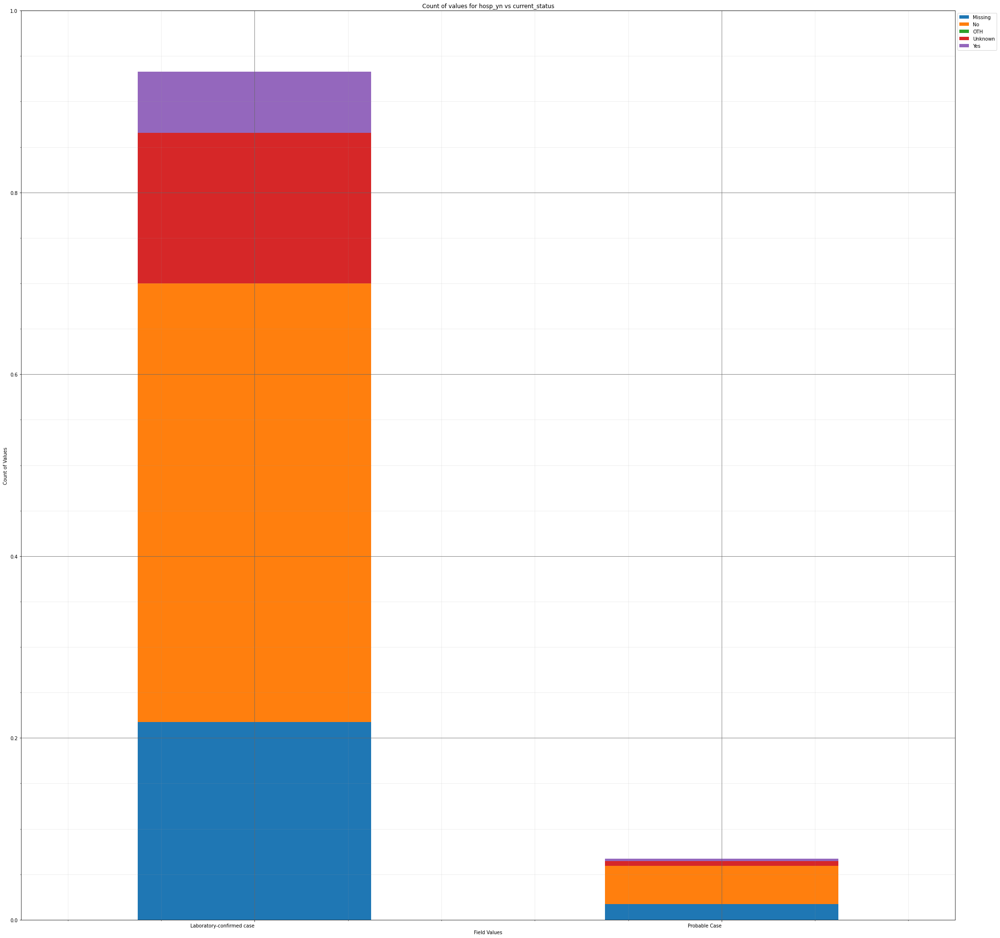



----------------------


Grouping over current_status|icu_yn results in:



,current_status,icu_yn,Rows,% Frequency
0,Laboratory-confirmed case,Missing,7200,72.00
1,Laboratory-confirmed case,No,879,8.79
2,Laboratory-confirmed case,Unknown,1160,11.60
3,Laboratory-confirmed case,Yes,91,0.91
4,Probable Case,Missing,462,4.62
5,Probable Case,No,79,0.79
6,Probable Case,Unknown,128,1.28
7,Probable Case,Yes,1,0.01


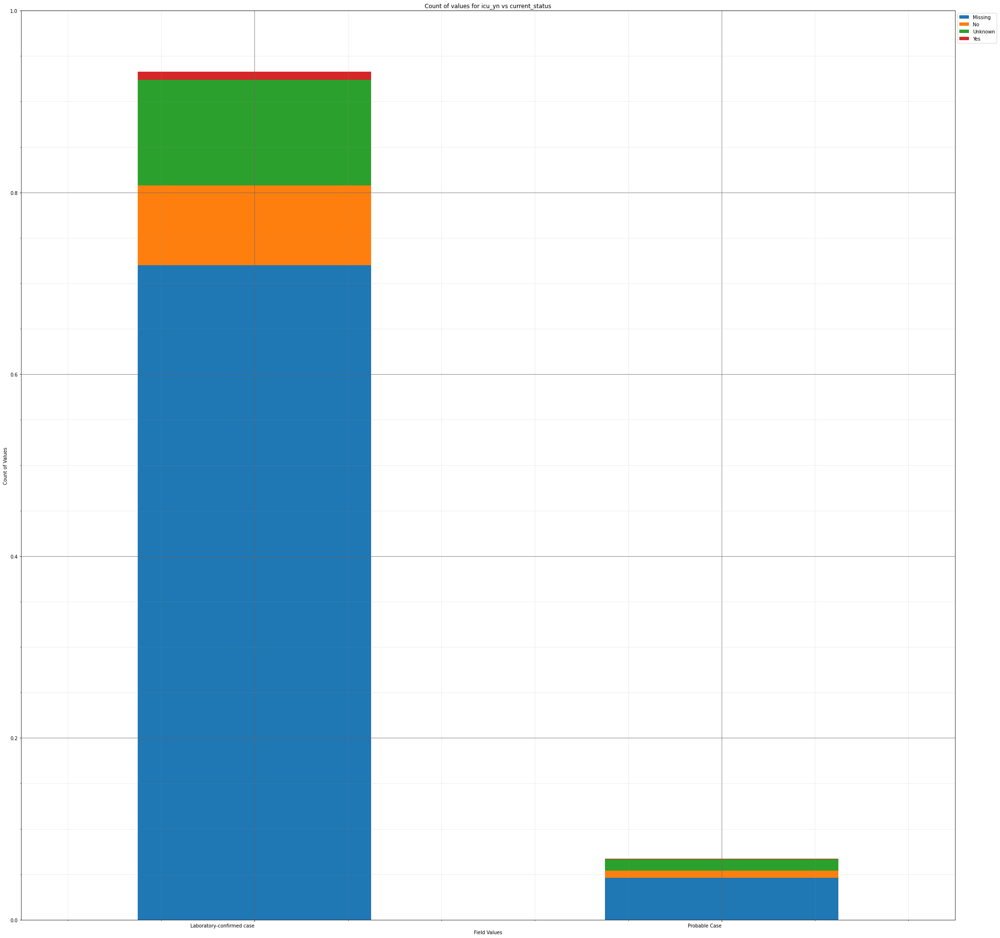



----------------------


Grouping over current_status|death_yn results in:



,current_status,death_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,9022,90.22
1,Laboratory-confirmed case,Yes,308,3.08
2,Probable Case,No,643,6.43
3,Probable Case,Yes,27,0.27


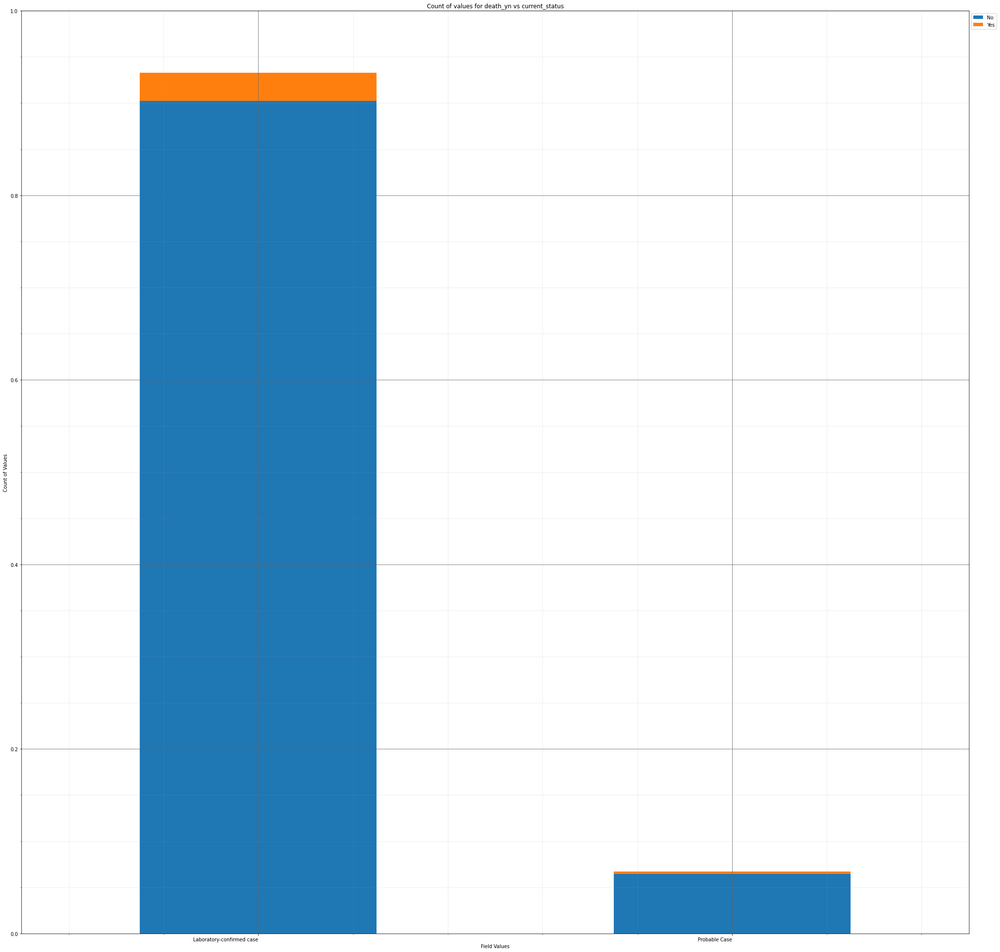



----------------------


Grouping over current_status|medcond_yn results in:



,current_status,medcond_yn,Rows,% Frequency
0,Laboratory-confirmed case,Missing,7028,70.28
1,Laboratory-confirmed case,No,857,8.57
2,Laboratory-confirmed case,Unknown,651,6.51
3,Laboratory-confirmed case,Yes,794,7.94
4,Probable Case,Missing,481,4.81
5,Probable Case,No,75,0.75
6,Probable Case,Unknown,71,0.71
7,Probable Case,Yes,43,0.43


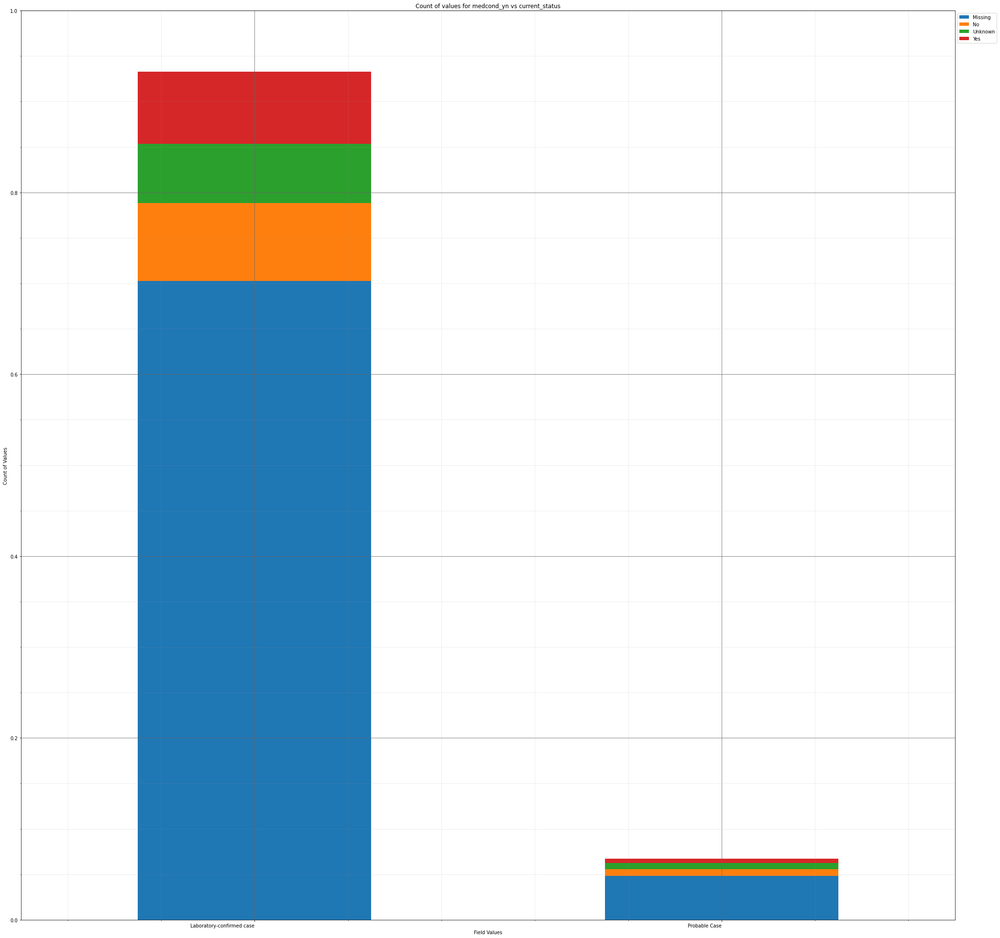



----------------------


Grouping over sex|current_status results in:



,sex,current_status,Rows,% Frequency
0,Female,Laboratory-confirmed case,4993,49.93
1,Female,Probable Case,346,3.46
2,Male,Laboratory-confirmed case,4259,42.59
3,Male,Probable Case,317,3.17
4,Missing,Laboratory-confirmed case,12,0.12
5,Missing,Probable Case,1,0.01
6,Unknown,Laboratory-confirmed case,66,0.66
7,Unknown,Probable Case,6,0.06


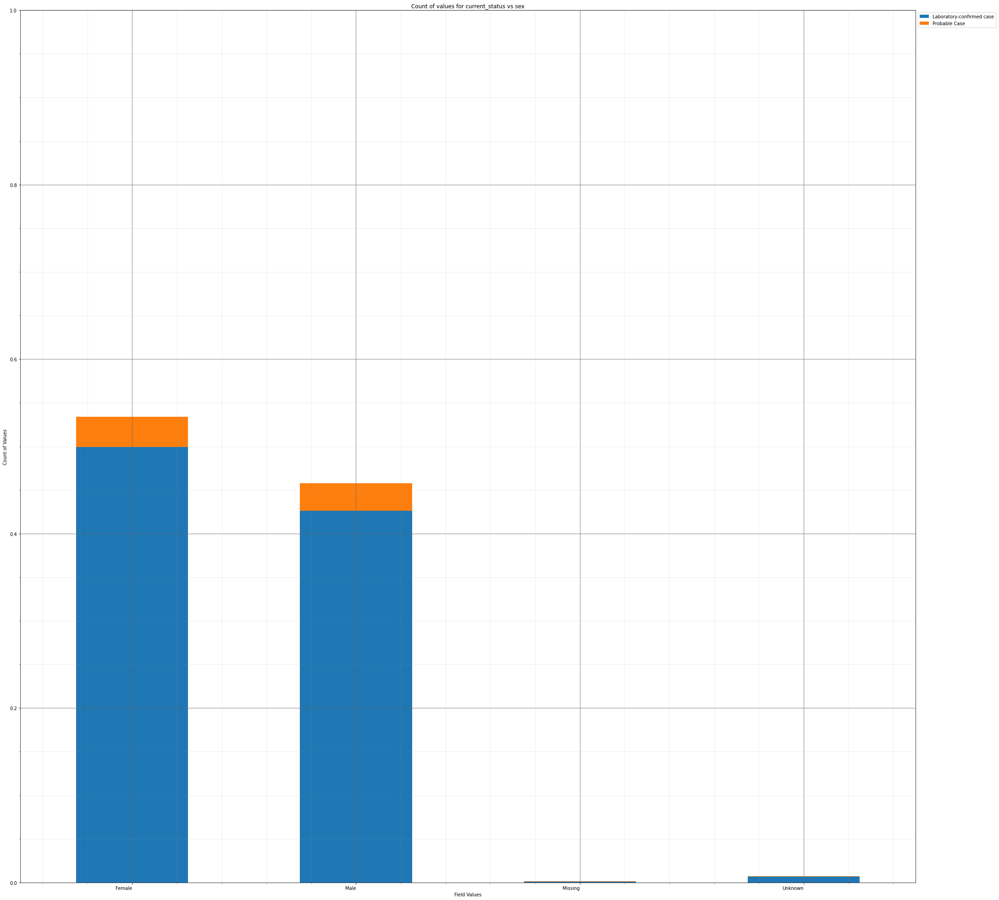



----------------------


Grouping over sex|age_group results in:



,sex,age_group,Rows,% Frequency
0,Female,0 - 9 Years,238,2.38
1,Female,10 - 19 Years,559,5.59
2,Female,20 - 29 Years,983,9.83
3,Female,30 - 39 Years,867,8.67
4,Female,40 - 49 Years,772,7.72
5,Female,50 - 59 Years,749,7.49
6,Female,60 - 69 Years,545,5.45
7,Female,70 - 79 Years,319,3.19
8,Female,80+ Years,297,2.97
9,Female,Missing,10,0.10


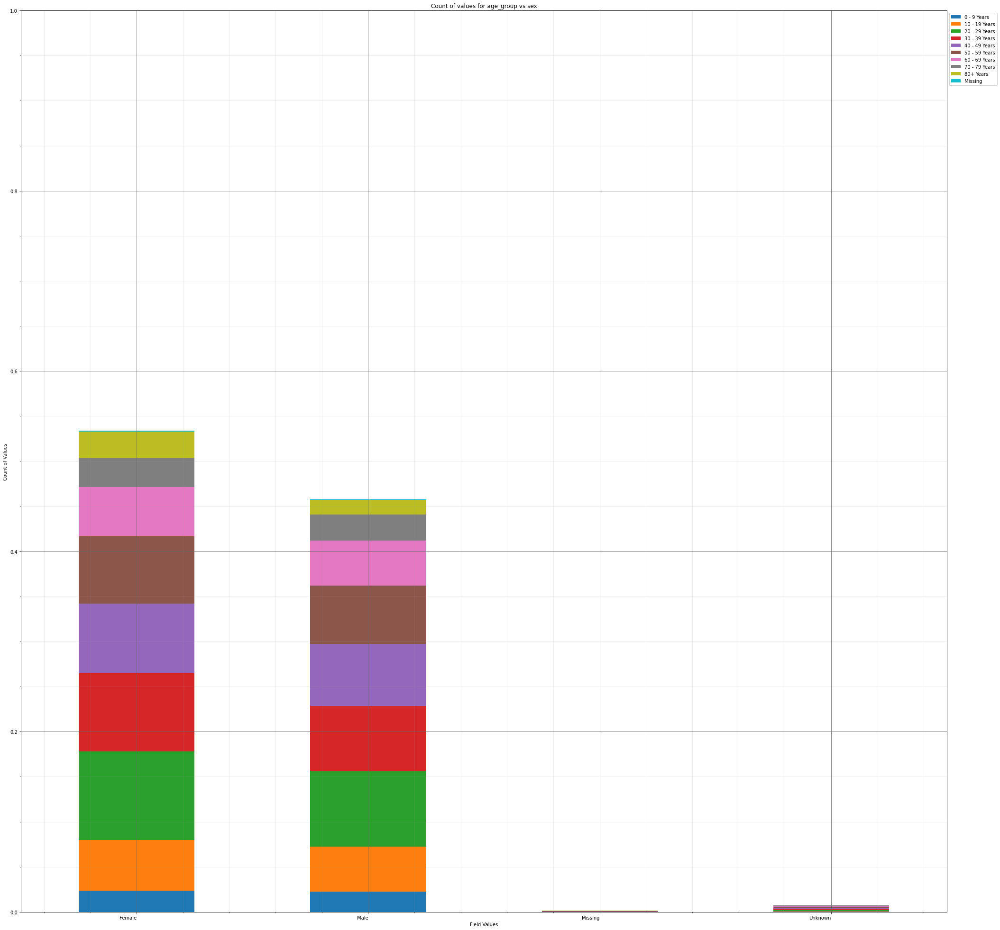



----------------------


Grouping over sex|race_ethnicity_combined results in:



,sex,race_ethnicity_combined,Rows,% Frequency
0,Female,"American Indian/Alaska Native, Non-Hispanic",34,0.34
1,Female,"Asian, Non-Hispanic",123,1.23
2,Female,"Black, Non-Hispanic",412,4.12
3,Female,Hispanic/Latino,510,5.10
4,Female,Missing,54,0.54
5,Female,"Multiple/Other, Non-Hispanic",267,2.67
6,Female,"Native Hawaiian/Other Pacific Islander, Non-Hi...",14,0.14
7,Female,Unknown,2121,21.21
8,Female,"White, Non-Hispanic",1804,18.04
9,Male,"American Indian/Alaska Native, Non-Hispanic",32,0.32


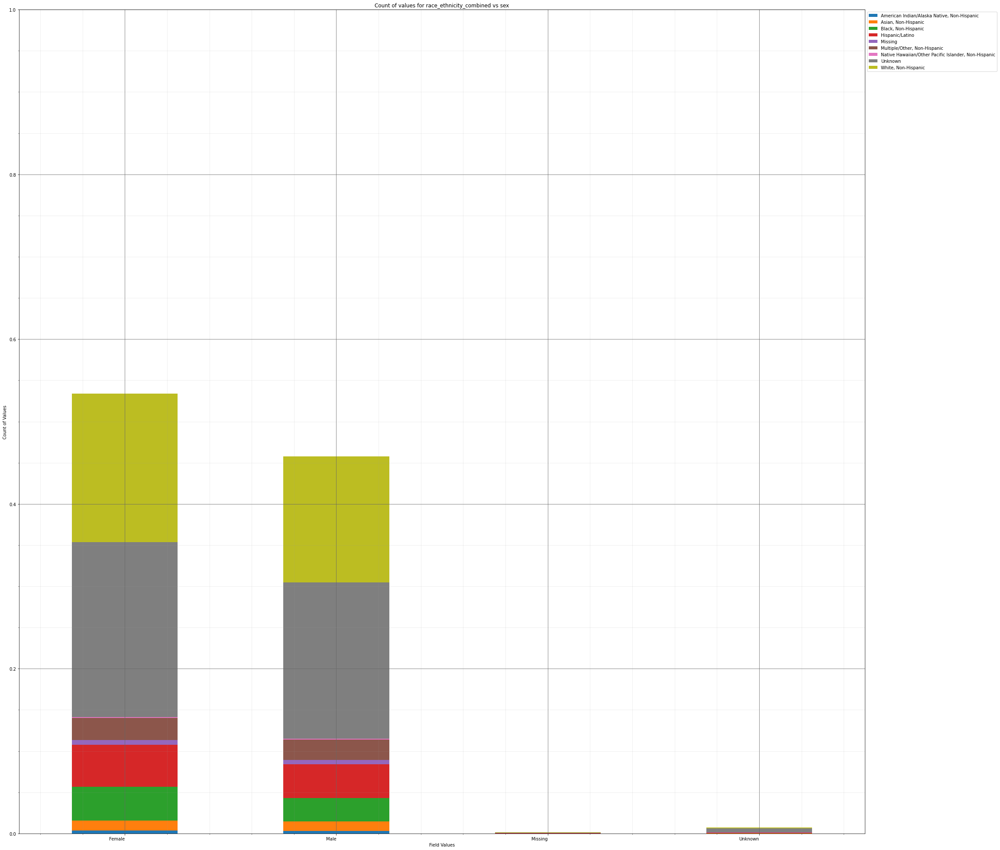



----------------------


Grouping over sex|hosp_yn results in:



,sex,hosp_yn,Rows,% Frequency
0,Female,Missing,1254,12.54
1,Female,No,2878,28.78
2,Female,OTH,0,0.00
3,Female,Unknown,860,8.60
4,Female,Yes,347,3.47
5,Male,Missing,1060,10.60
6,Male,No,2344,23.44
7,Male,OTH,1,0.01
8,Male,Unknown,820,8.20
9,Male,Yes,351,3.51


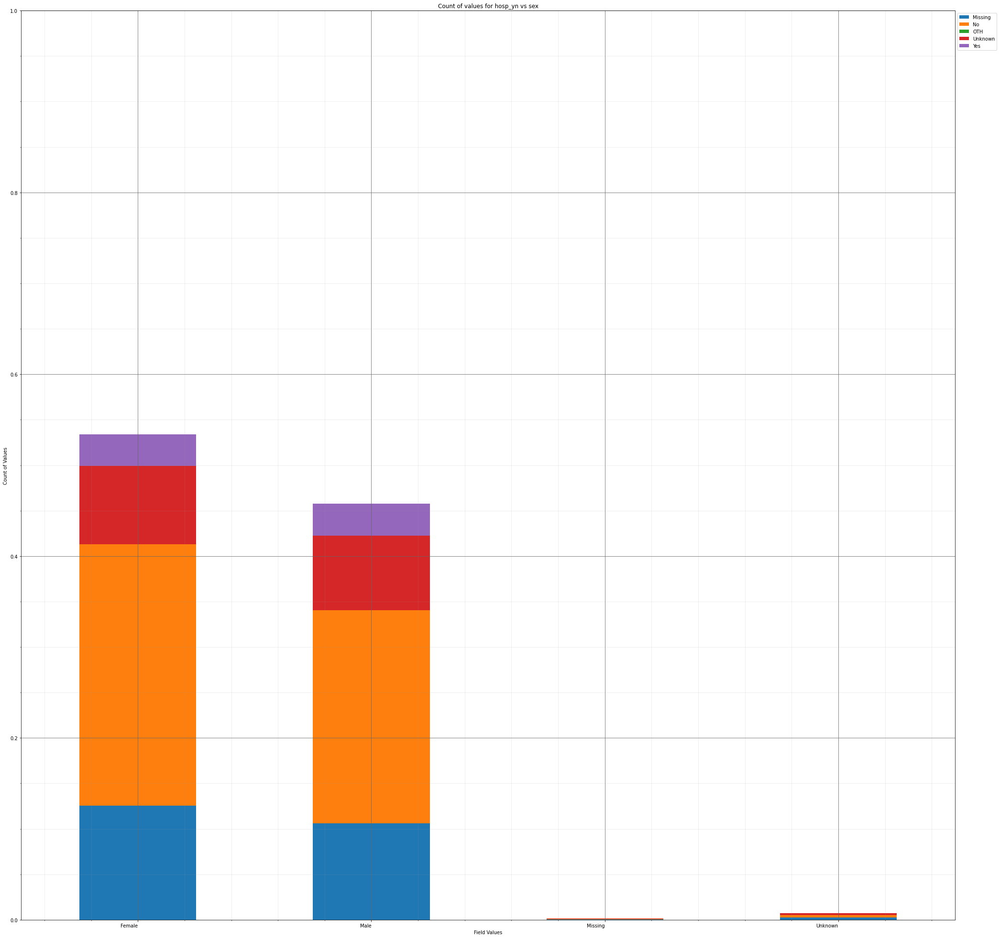



----------------------


Grouping over sex|icu_yn results in:



,sex,icu_yn,Rows,% Frequency
0,Female,Missing,4084,40.84
1,Female,No,512,5.12
2,Female,Unknown,701,7.01
3,Female,Yes,42,0.42
4,Male,Missing,3509,35.09
5,Male,No,442,4.42
6,Male,Unknown,576,5.76
7,Male,Yes,49,0.49
8,Missing,Missing,5,0.05
9,Missing,No,0,0.00


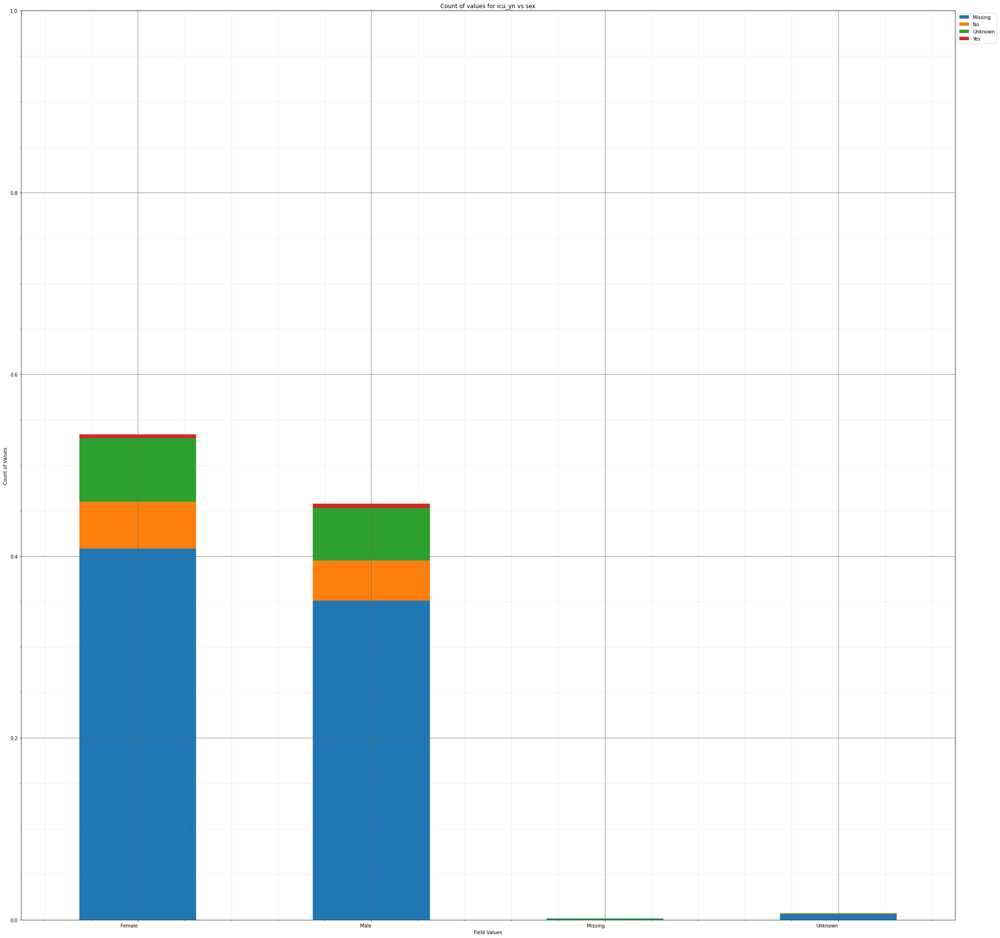



----------------------


Grouping over sex|death_yn results in:



,sex,death_yn,Rows,% Frequency
0,Female,No,5172,51.72
1,Female,Yes,167,1.67
2,Male,No,4411,44.11
3,Male,Yes,165,1.65
4,Missing,No,12,0.12
5,Missing,Yes,1,0.01
6,Unknown,No,70,0.70
7,Unknown,Yes,2,0.02


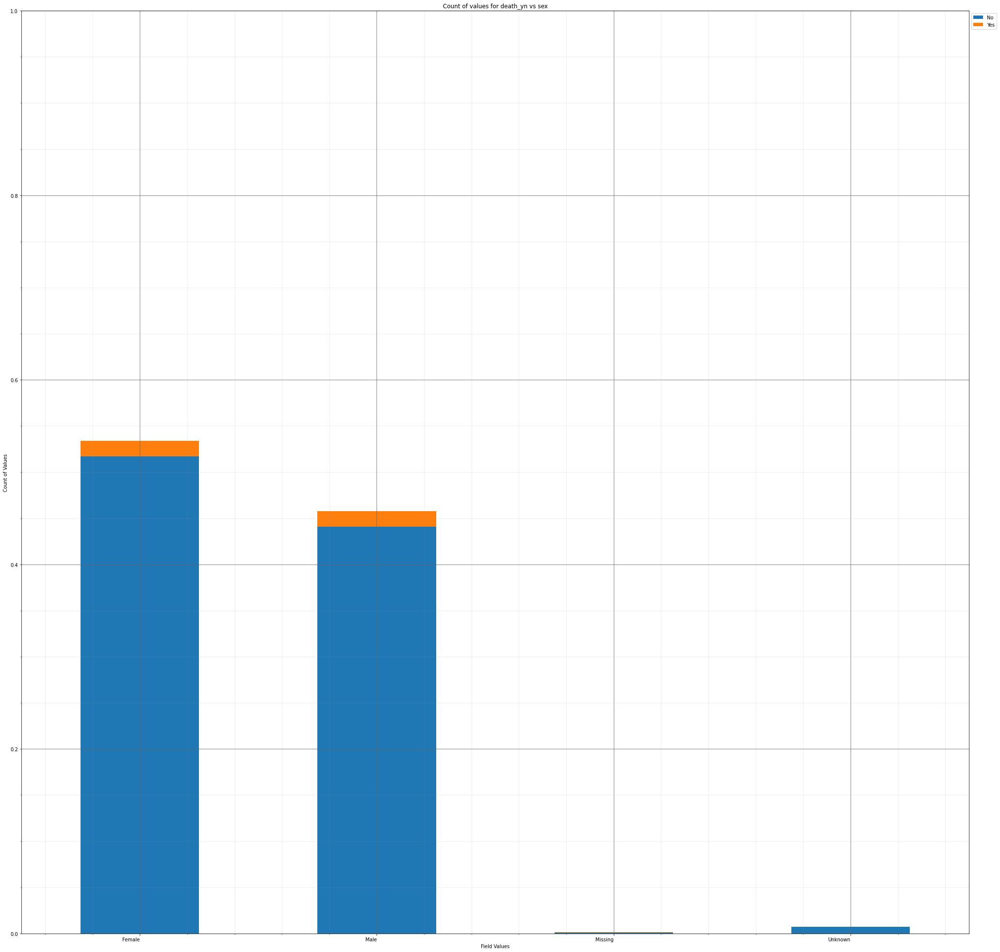



----------------------


Grouping over sex|medcond_yn results in:



,sex,medcond_yn,Rows,% Frequency
0,Female,Missing,3972,39.72
1,Female,No,508,5.08
2,Female,Unknown,399,3.99
3,Female,Yes,460,4.60
4,Male,Missing,3469,34.69
5,Male,No,417,4.17
6,Male,Unknown,316,3.16
7,Male,Yes,374,3.74
8,Missing,Missing,4,0.04
9,Missing,No,3,0.03


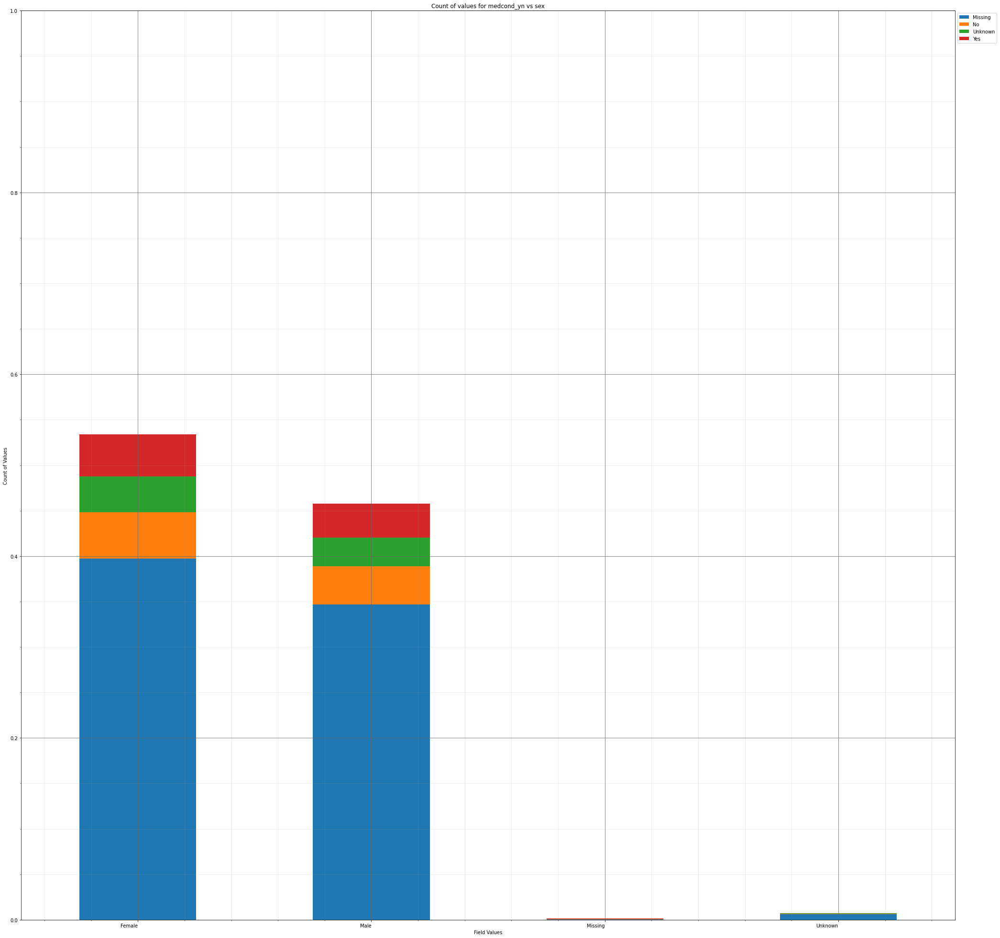



----------------------


Grouping over age_group|current_status results in:



,age_group,current_status,Rows,% Frequency
0,0 - 9 Years,Laboratory-confirmed case,435,4.35
1,0 - 9 Years,Probable Case,33,0.33
2,10 - 19 Years,Laboratory-confirmed case,984,9.84
3,10 - 19 Years,Probable Case,85,0.85
4,20 - 29 Years,Laboratory-confirmed case,1715,17.15
5,20 - 29 Years,Probable Case,111,1.11
6,30 - 39 Years,Laboratory-confirmed case,1527,15.27
7,30 - 39 Years,Probable Case,84,0.84
8,40 - 49 Years,Laboratory-confirmed case,1381,13.81
9,40 - 49 Years,Probable Case,91,0.91


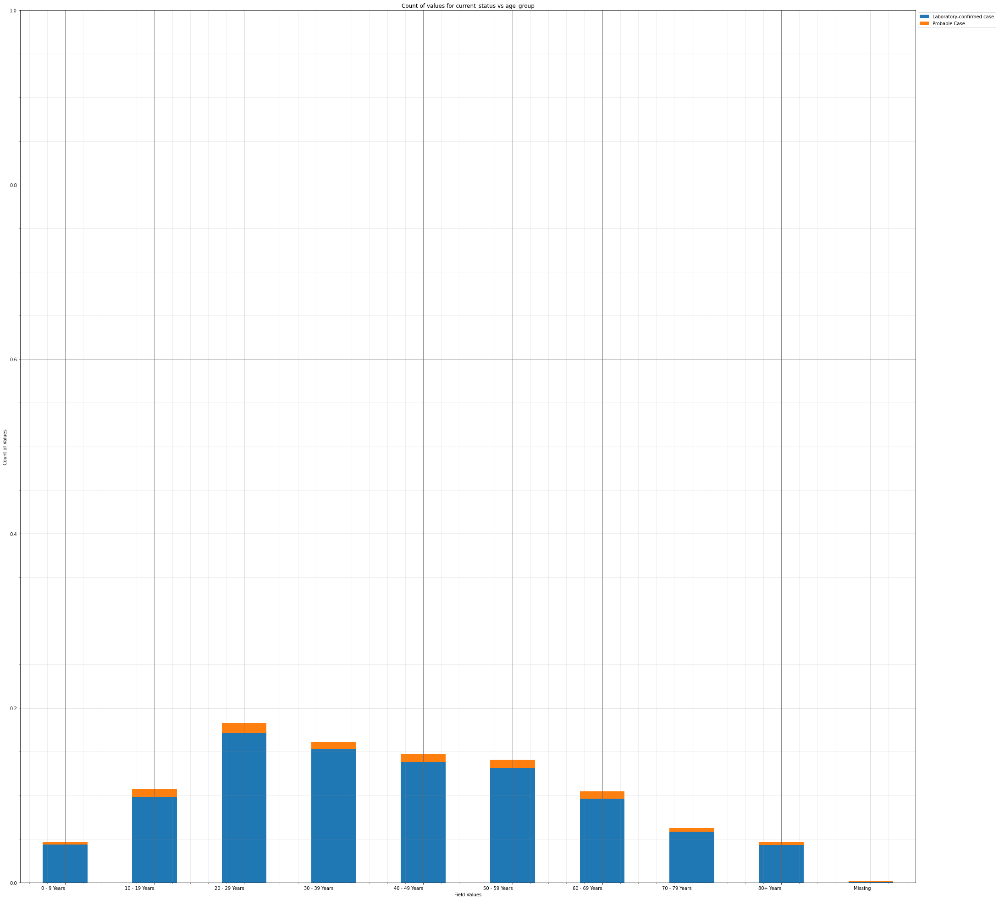



----------------------


Grouping over age_group|sex results in:



,age_group,sex,Rows,% Frequency
0,0 - 9 Years,Female,238,2.38
1,0 - 9 Years,Male,226,2.26
2,0 - 9 Years,Missing,2,0.02
3,0 - 9 Years,Unknown,2,0.02
4,10 - 19 Years,Female,559,5.59
5,10 - 19 Years,Male,498,4.98
6,10 - 19 Years,Missing,2,0.02
7,10 - 19 Years,Unknown,10,0.10
8,20 - 29 Years,Female,983,9.83
9,20 - 29 Years,Male,834,8.34


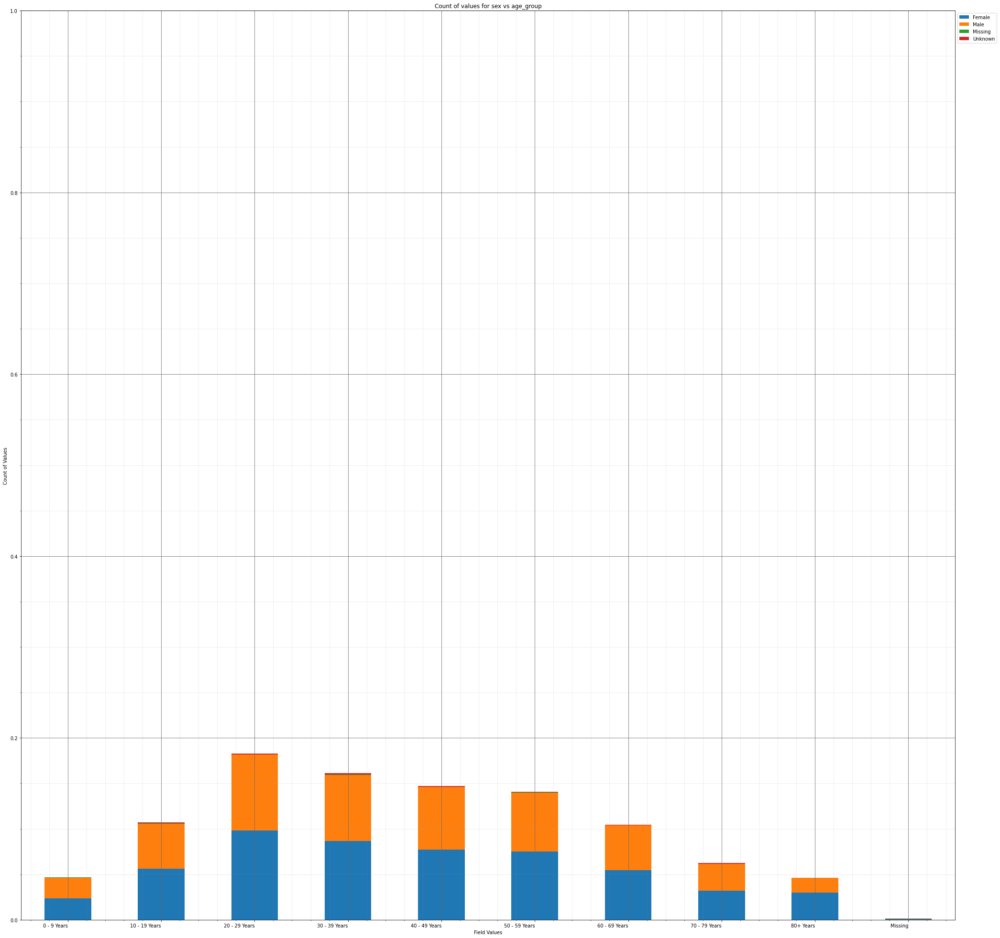



----------------------


Grouping over age_group|race_ethnicity_combined results in:



,age_group,race_ethnicity_combined,Rows,% Frequency
0,0 - 9 Years,"American Indian/Alaska Native, Non-Hispanic",4,0.04
1,0 - 9 Years,"Asian, Non-Hispanic",12,0.12
2,0 - 9 Years,"Black, Non-Hispanic",29,0.29
3,0 - 9 Years,Hispanic/Latino,53,0.53
4,0 - 9 Years,Missing,1,0.01
...,...,...,...,...
85,Missing,Missing,1,0.01
86,Missing,"Multiple/Other, Non-Hispanic",2,0.02
87,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",0,0.00
88,Missing,Unknown,10,0.10


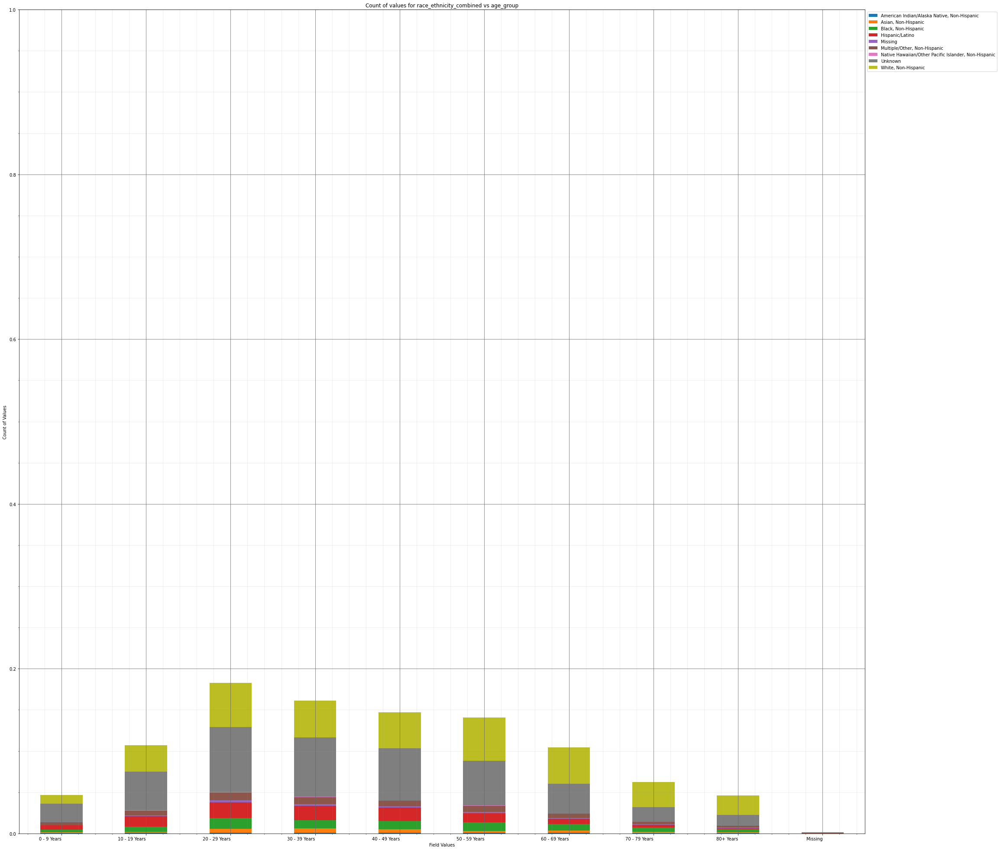



----------------------


Grouping over age_group|hosp_yn results in:



,age_group,hosp_yn,Rows,% Frequency
0,0 - 9 Years,Missing,97,0.97
1,0 - 9 Years,No,263,2.63
2,0 - 9 Years,OTH,0,0.00
3,0 - 9 Years,Unknown,100,1.00
4,0 - 9 Years,Yes,8,0.08
5,10 - 19 Years,Missing,246,2.46
6,10 - 19 Years,No,621,6.21
7,10 - 19 Years,OTH,0,0.00
8,10 - 19 Years,Unknown,192,1.92
9,10 - 19 Years,Yes,10,0.10


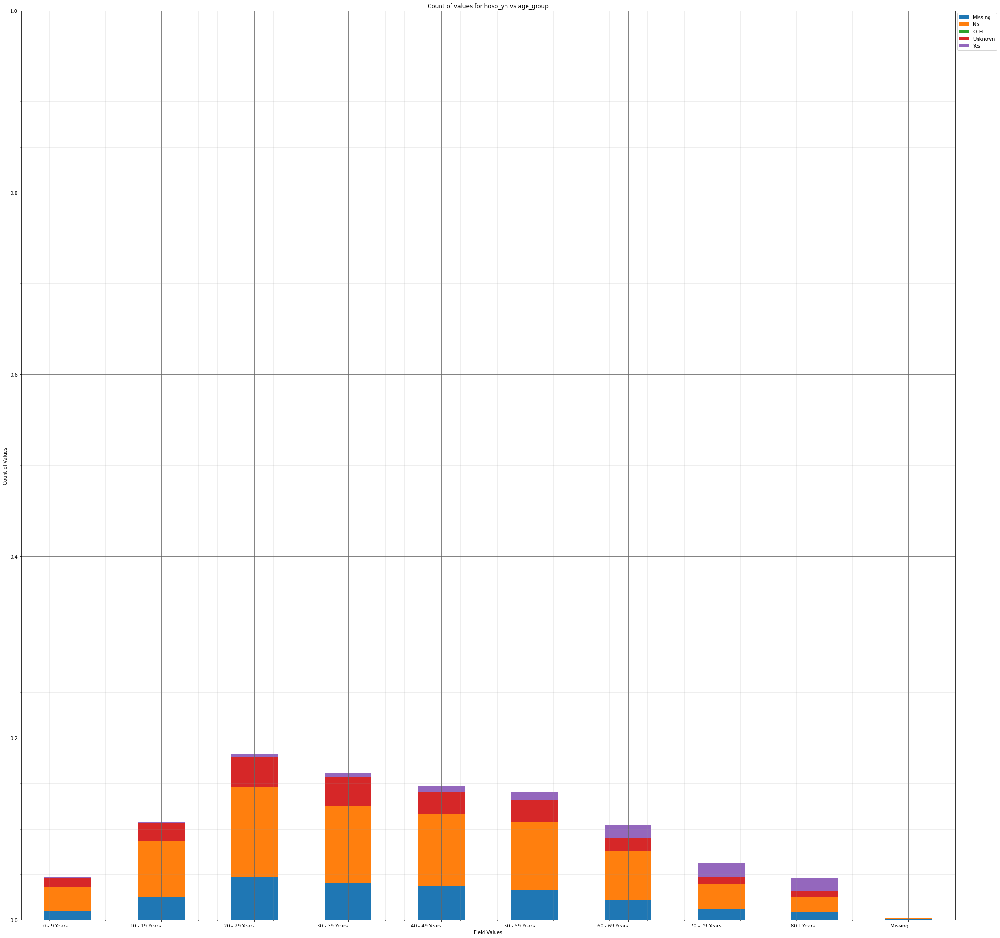



----------------------


Grouping over age_group|icu_yn results in:



,age_group,icu_yn,Rows,% Frequency
0,0 - 9 Years,Missing,383,3.83
1,0 - 9 Years,No,32,0.32
2,0 - 9 Years,Unknown,53,0.53
3,0 - 9 Years,Yes,0,0.00
4,10 - 19 Years,Missing,830,8.30
5,10 - 19 Years,No,116,1.16
6,10 - 19 Years,Unknown,121,1.21
7,10 - 19 Years,Yes,2,0.02
8,20 - 29 Years,Missing,1437,14.37
9,20 - 29 Years,No,168,1.68


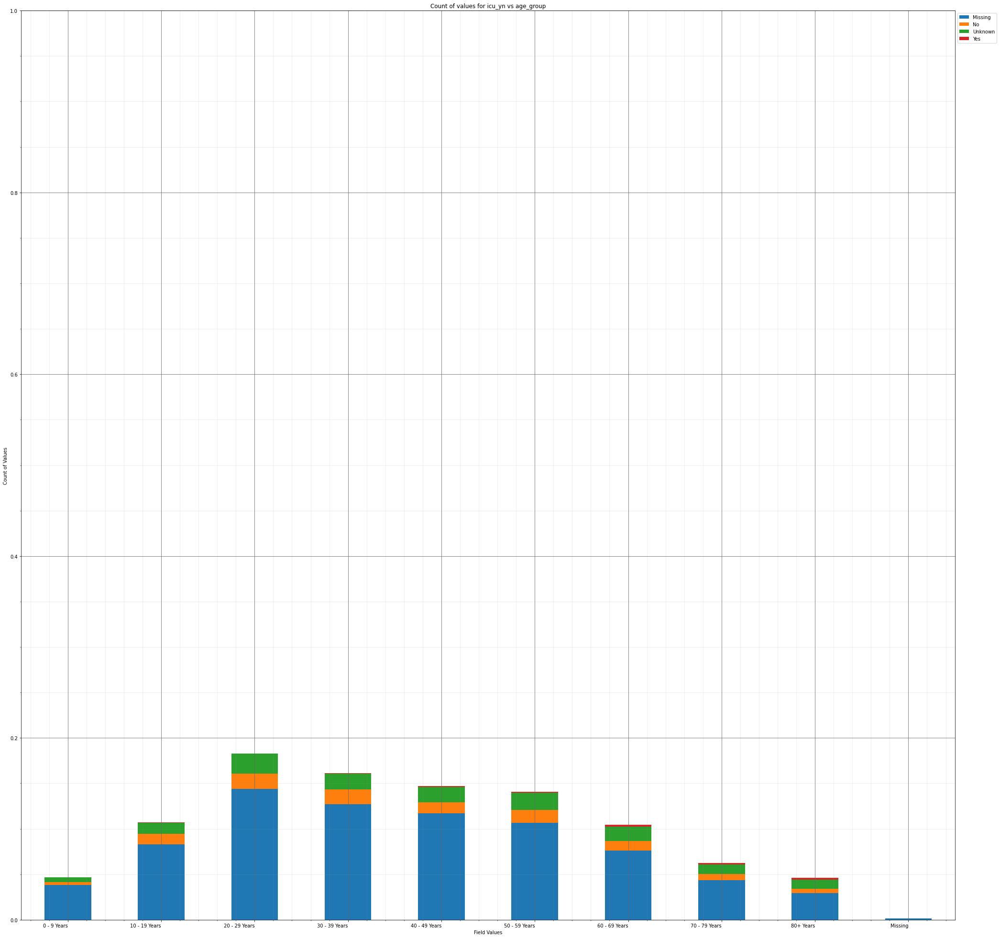



----------------------


Grouping over age_group|death_yn results in:



,age_group,death_yn,Rows,% Frequency
0,0 - 9 Years,No,468,4.68
1,0 - 9 Years,Yes,0,0.00
2,10 - 19 Years,No,1069,10.69
3,10 - 19 Years,Yes,0,0.00
4,20 - 29 Years,No,1826,18.26
5,20 - 29 Years,Yes,0,0.00
6,30 - 39 Years,No,1609,16.09
7,30 - 39 Years,Yes,2,0.02
8,40 - 49 Years,No,1460,14.60
9,40 - 49 Years,Yes,12,0.12


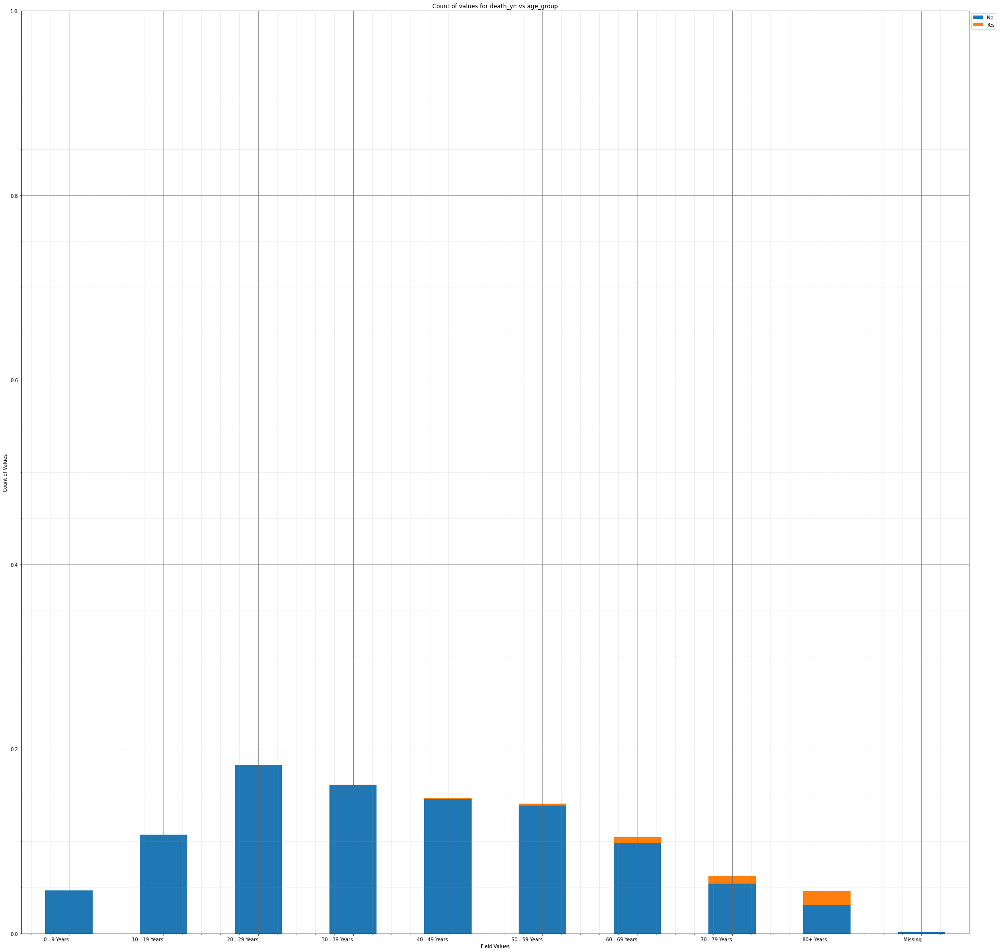



----------------------


Grouping over age_group|medcond_yn results in:



,age_group,medcond_yn,Rows,% Frequency
0,0 - 9 Years,Missing,367,3.67
1,0 - 9 Years,No,52,0.52
2,0 - 9 Years,Unknown,36,0.36
3,0 - 9 Years,Yes,13,0.13
4,10 - 19 Years,Missing,822,8.22
5,10 - 19 Years,No,144,1.44
6,10 - 19 Years,Unknown,70,0.70
7,10 - 19 Years,Yes,33,0.33
8,20 - 29 Years,Missing,1392,13.92
9,20 - 29 Years,No,222,2.22


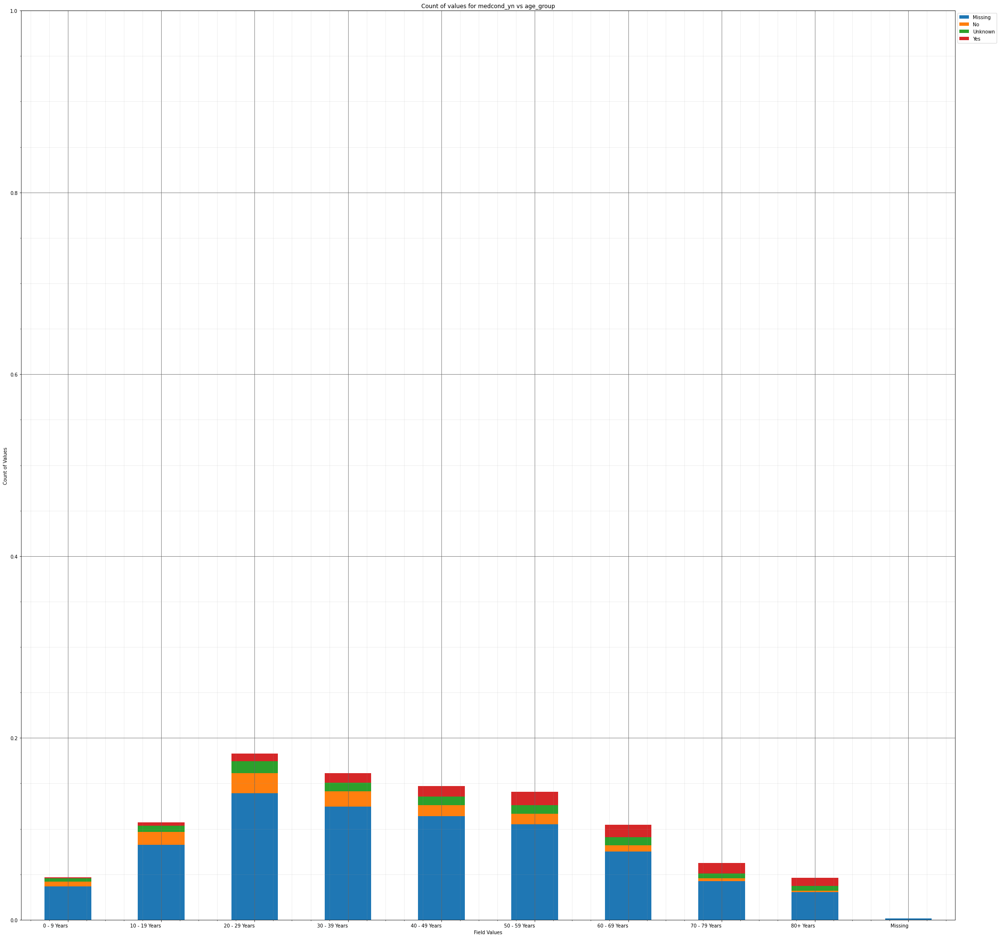



----------------------


Grouping over race_ethnicity_combined|current_status results in:



,race_ethnicity_combined,current_status,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Laboratory-confirmed case,60,0.60
1,"American Indian/Alaska Native, Non-Hispanic",Probable Case,6,0.06
2,"Asian, Non-Hispanic",Laboratory-confirmed case,234,2.34
3,"Asian, Non-Hispanic",Probable Case,8,0.08
4,"Black, Non-Hispanic",Laboratory-confirmed case,661,6.61
5,"Black, Non-Hispanic",Probable Case,34,0.34
6,Hispanic/Latino,Laboratory-confirmed case,894,8.94
7,Hispanic/Latino,Probable Case,35,0.35
8,Missing,Laboratory-confirmed case,88,0.88
9,Missing,Probable Case,21,0.21


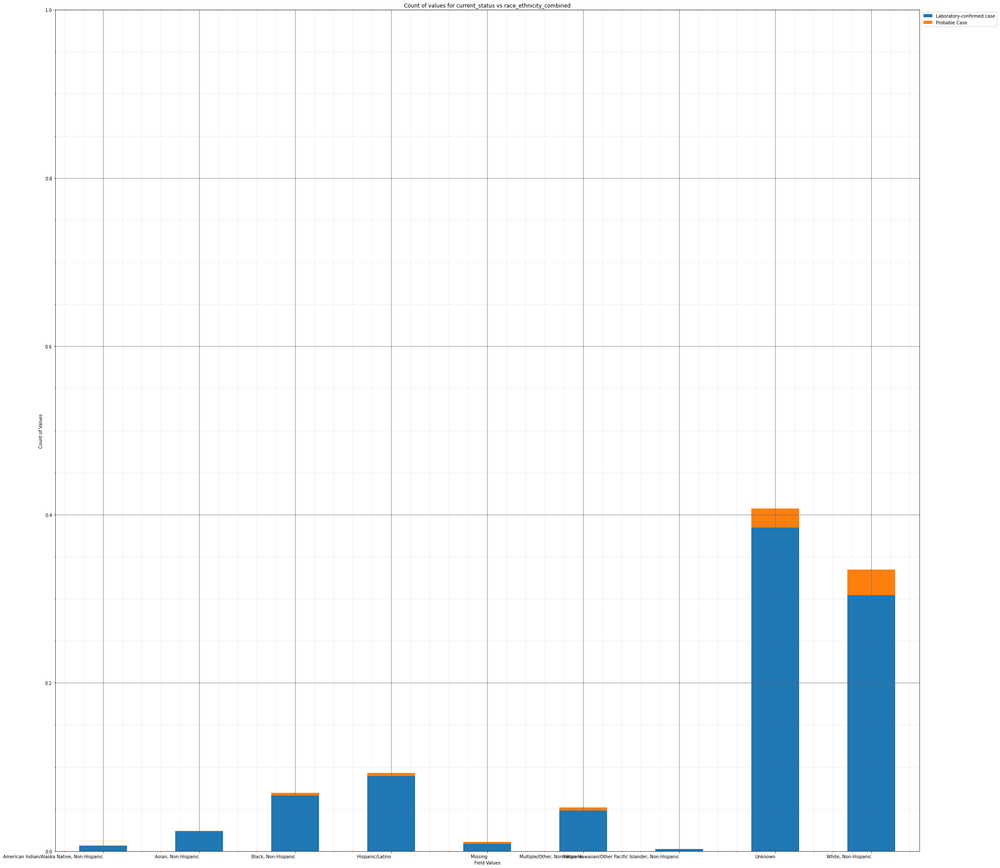



----------------------


Grouping over race_ethnicity_combined|sex results in:



,race_ethnicity_combined,sex,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Female,34,0.34
1,"American Indian/Alaska Native, Non-Hispanic",Male,32,0.32
2,"American Indian/Alaska Native, Non-Hispanic",Missing,0,0.00
3,"American Indian/Alaska Native, Non-Hispanic",Unknown,0,0.00
4,"Asian, Non-Hispanic",Female,123,1.23
5,"Asian, Non-Hispanic",Male,116,1.16
6,"Asian, Non-Hispanic",Missing,1,0.01
7,"Asian, Non-Hispanic",Unknown,2,0.02
8,"Black, Non-Hispanic",Female,412,4.12
9,"Black, Non-Hispanic",Male,281,2.81


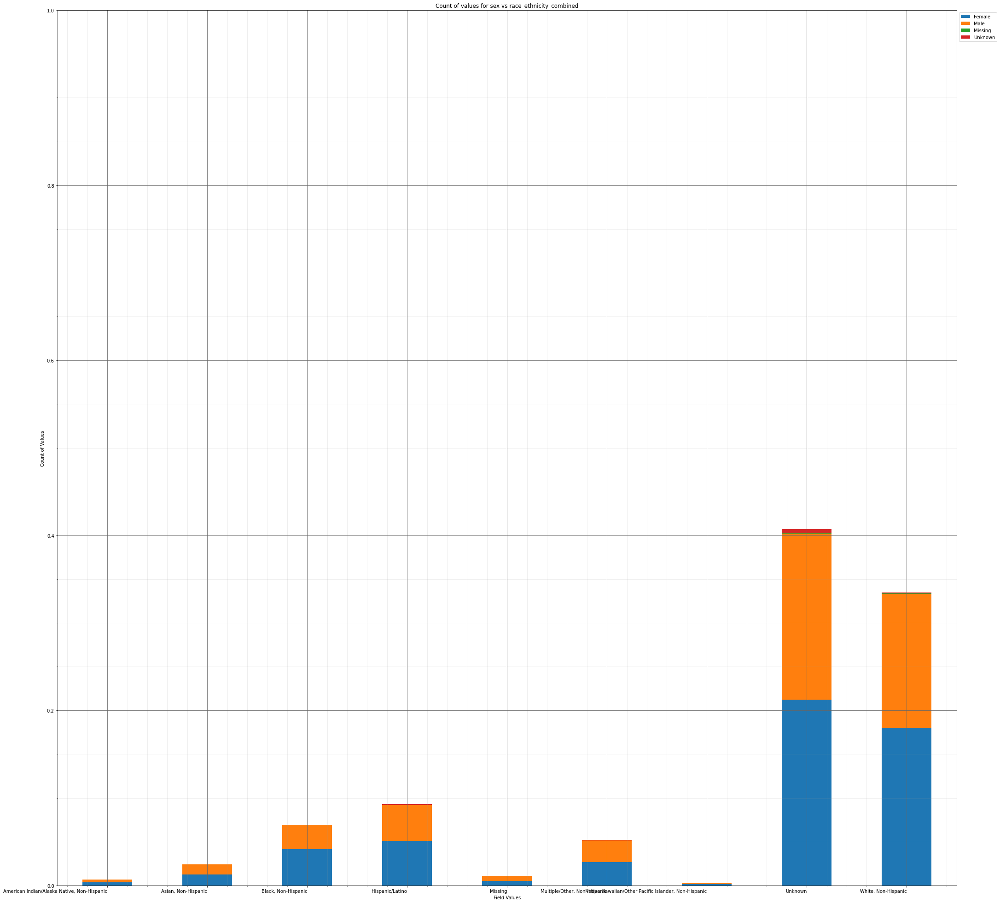



----------------------


Grouping over race_ethnicity_combined|age_group results in:



,race_ethnicity_combined,age_group,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",0 - 9 Years,4,0.04
1,"American Indian/Alaska Native, Non-Hispanic",10 - 19 Years,8,0.08
2,"American Indian/Alaska Native, Non-Hispanic",20 - 29 Years,12,0.12
3,"American Indian/Alaska Native, Non-Hispanic",30 - 39 Years,8,0.08
4,"American Indian/Alaska Native, Non-Hispanic",40 - 49 Years,12,0.12
...,...,...,...,...
85,"White, Non-Hispanic",50 - 59 Years,525,5.25
86,"White, Non-Hispanic",60 - 69 Years,442,4.42
87,"White, Non-Hispanic",70 - 79 Years,302,3.02
88,"White, Non-Hispanic",80+ Years,238,2.38


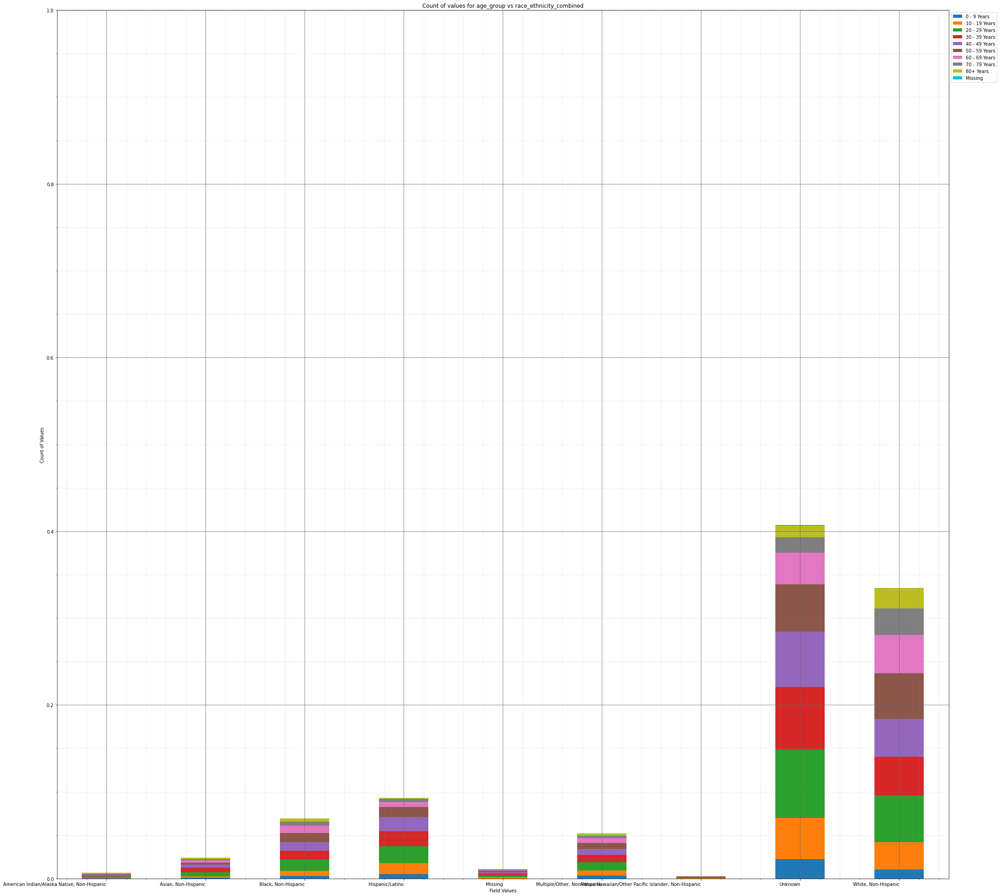



----------------------


Grouping over race_ethnicity_combined|hosp_yn results in:



,race_ethnicity_combined,hosp_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Missing,9,0.09
1,"American Indian/Alaska Native, Non-Hispanic",No,39,0.39
2,"American Indian/Alaska Native, Non-Hispanic",OTH,0,0.00
3,"American Indian/Alaska Native, Non-Hispanic",Unknown,5,0.05
4,"American Indian/Alaska Native, Non-Hispanic",Yes,13,0.13
5,"Asian, Non-Hispanic",Missing,65,0.65
6,"Asian, Non-Hispanic",No,116,1.16
7,"Asian, Non-Hispanic",OTH,0,0.00
8,"Asian, Non-Hispanic",Unknown,38,0.38
9,"Asian, Non-Hispanic",Yes,23,0.23


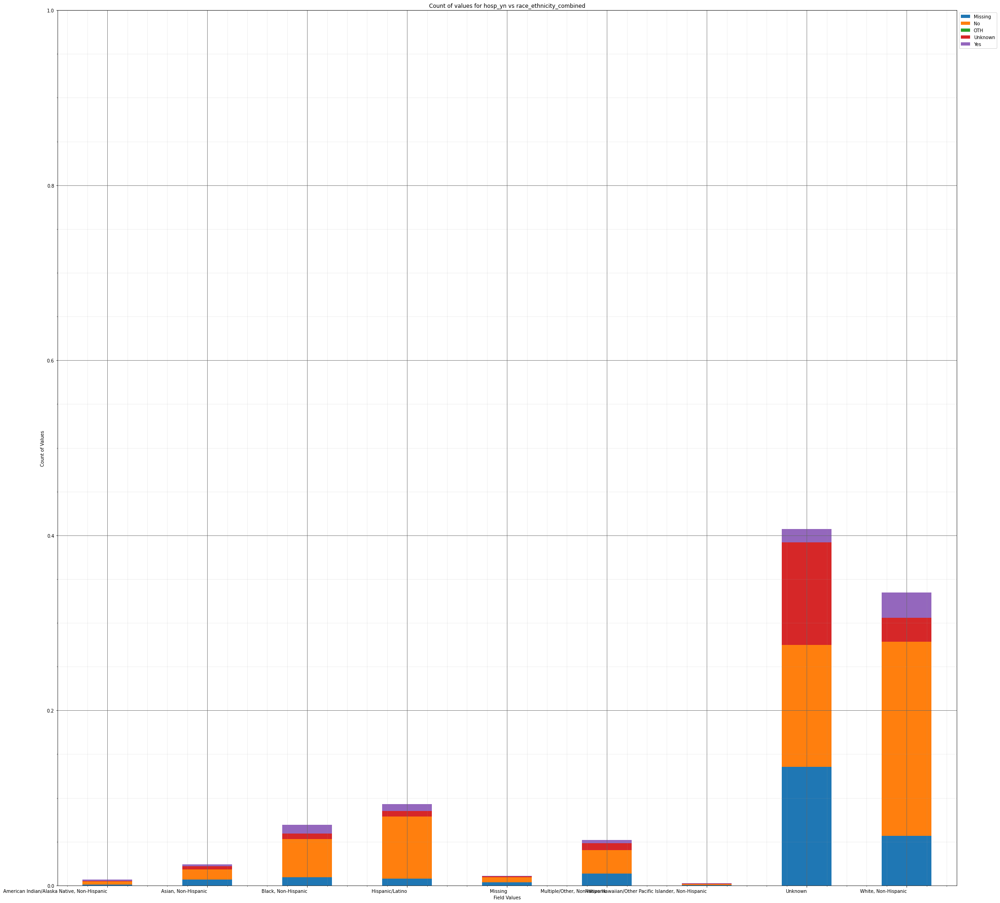



----------------------


Grouping over race_ethnicity_combined|icu_yn results in:



,race_ethnicity_combined,icu_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Missing,52,0.52
1,"American Indian/Alaska Native, Non-Hispanic",No,7,0.07
2,"American Indian/Alaska Native, Non-Hispanic",Unknown,5,0.05
3,"American Indian/Alaska Native, Non-Hispanic",Yes,2,0.02
4,"Asian, Non-Hispanic",Missing,203,2.03
5,"Asian, Non-Hispanic",No,14,0.14
6,"Asian, Non-Hispanic",Unknown,21,0.21
7,"Asian, Non-Hispanic",Yes,4,0.04
8,"Black, Non-Hispanic",Missing,483,4.83
9,"Black, Non-Hispanic",No,68,0.68


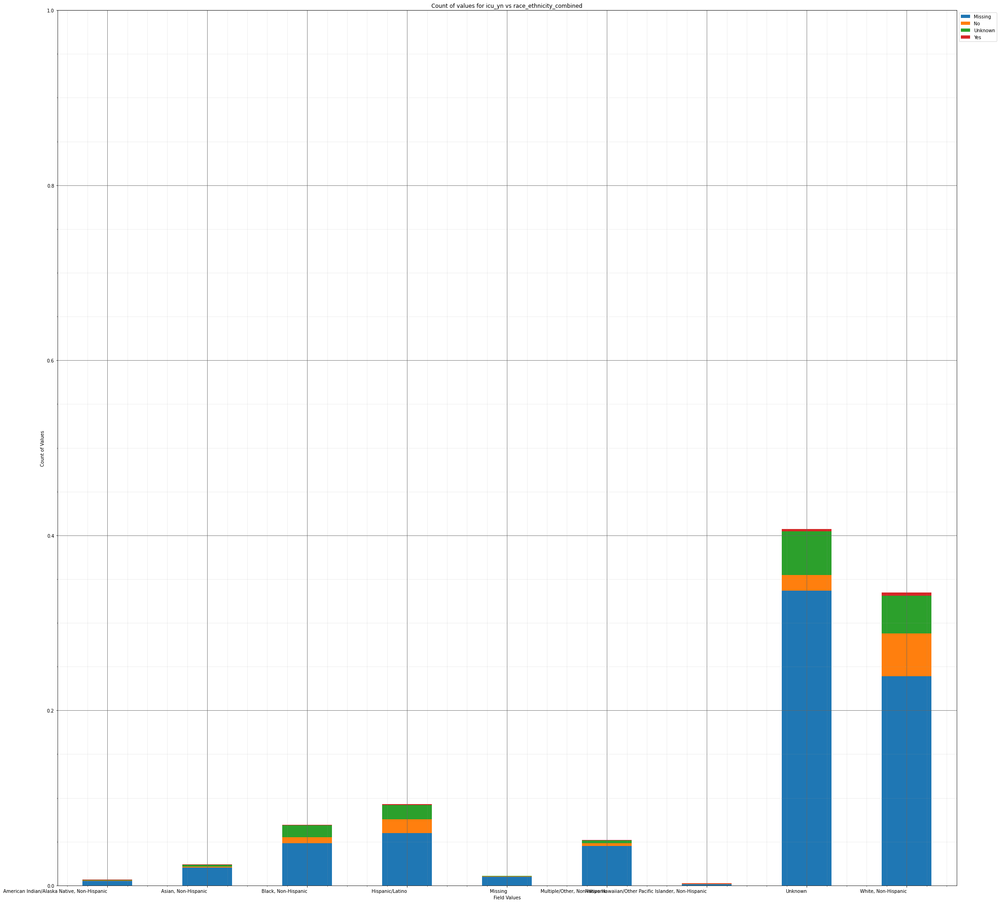



----------------------


Grouping over race_ethnicity_combined|death_yn results in:



,race_ethnicity_combined,death_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",No,60,0.60
1,"American Indian/Alaska Native, Non-Hispanic",Yes,6,0.06
2,"Asian, Non-Hispanic",No,232,2.32
3,"Asian, Non-Hispanic",Yes,10,0.10
4,"Black, Non-Hispanic",No,657,6.57
5,"Black, Non-Hispanic",Yes,38,0.38
6,Hispanic/Latino,No,901,9.01
7,Hispanic/Latino,Yes,28,0.28
8,Missing,No,102,1.02
9,Missing,Yes,7,0.07


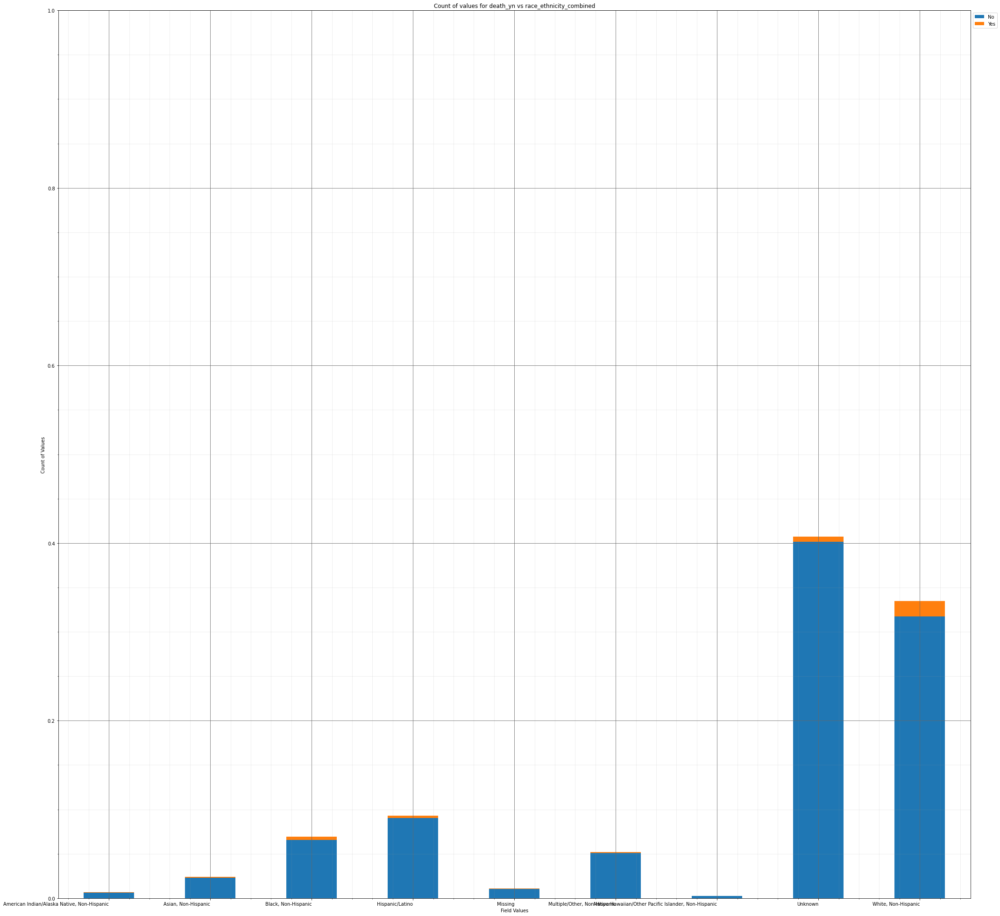



----------------------


Grouping over race_ethnicity_combined|medcond_yn results in:



,race_ethnicity_combined,medcond_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Missing,51,0.51
1,"American Indian/Alaska Native, Non-Hispanic",No,4,0.04
2,"American Indian/Alaska Native, Non-Hispanic",Unknown,4,0.04
3,"American Indian/Alaska Native, Non-Hispanic",Yes,7,0.07
4,"Asian, Non-Hispanic",Missing,201,2.01
5,"Asian, Non-Hispanic",No,17,0.17
6,"Asian, Non-Hispanic",Unknown,6,0.06
7,"Asian, Non-Hispanic",Yes,18,0.18
8,"Black, Non-Hispanic",Missing,439,4.39
9,"Black, Non-Hispanic",No,69,0.69


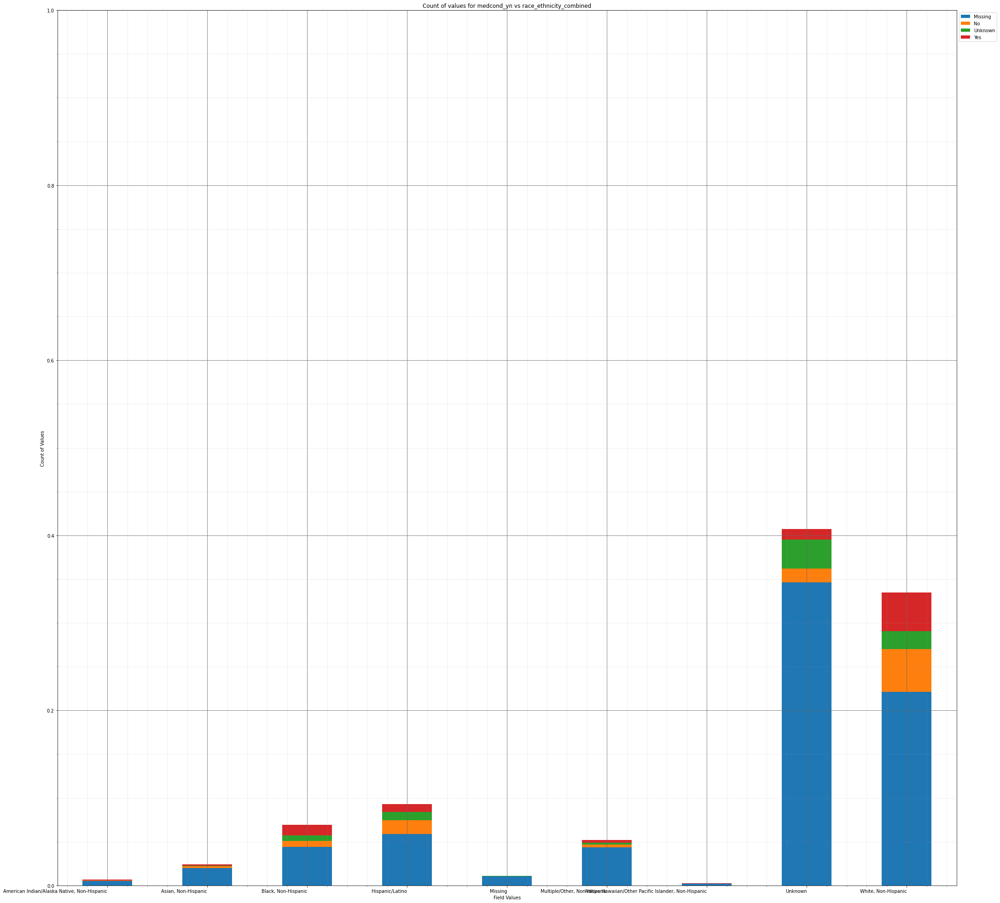



----------------------


Grouping over hosp_yn|current_status results in:



,hosp_yn,current_status,Rows,% Frequency
0,Missing,Laboratory-confirmed case,2173,21.73
1,Missing,Probable Case,170,1.70
2,No,Laboratory-confirmed case,4828,48.28
3,No,Probable Case,421,4.21
4,OTH,Laboratory-confirmed case,1,0.01
5,OTH,Probable Case,0,0.00
6,Unknown,Laboratory-confirmed case,1654,16.54
7,Unknown,Probable Case,54,0.54
8,Yes,Laboratory-confirmed case,674,6.74
9,Yes,Probable Case,25,0.25


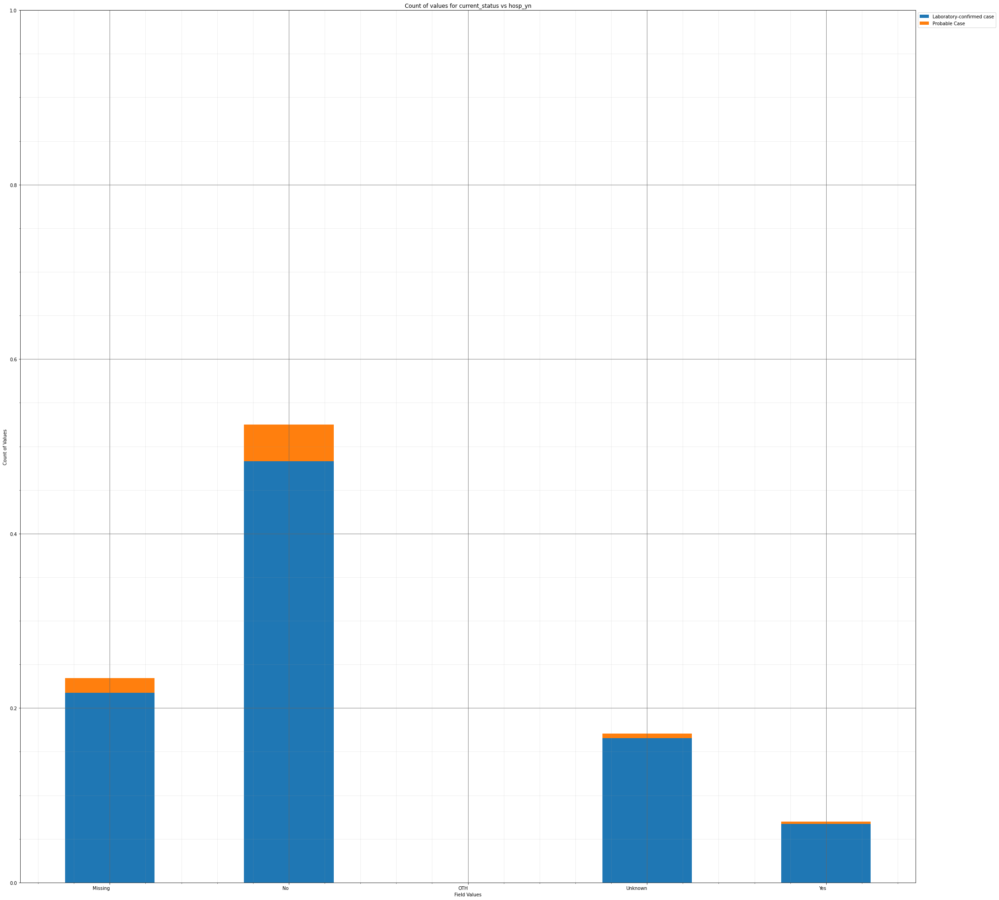



----------------------


Grouping over hosp_yn|sex results in:



,hosp_yn,sex,Rows,% Frequency
0,Missing,Female,1254,12.54
1,Missing,Male,1060,10.60
2,Missing,Missing,2,0.02
3,Missing,Unknown,27,0.27
4,No,Female,2878,28.78
5,No,Male,2344,23.44
6,No,Missing,5,0.05
7,No,Unknown,22,0.22
8,OTH,Female,0,0.00
9,OTH,Male,1,0.01


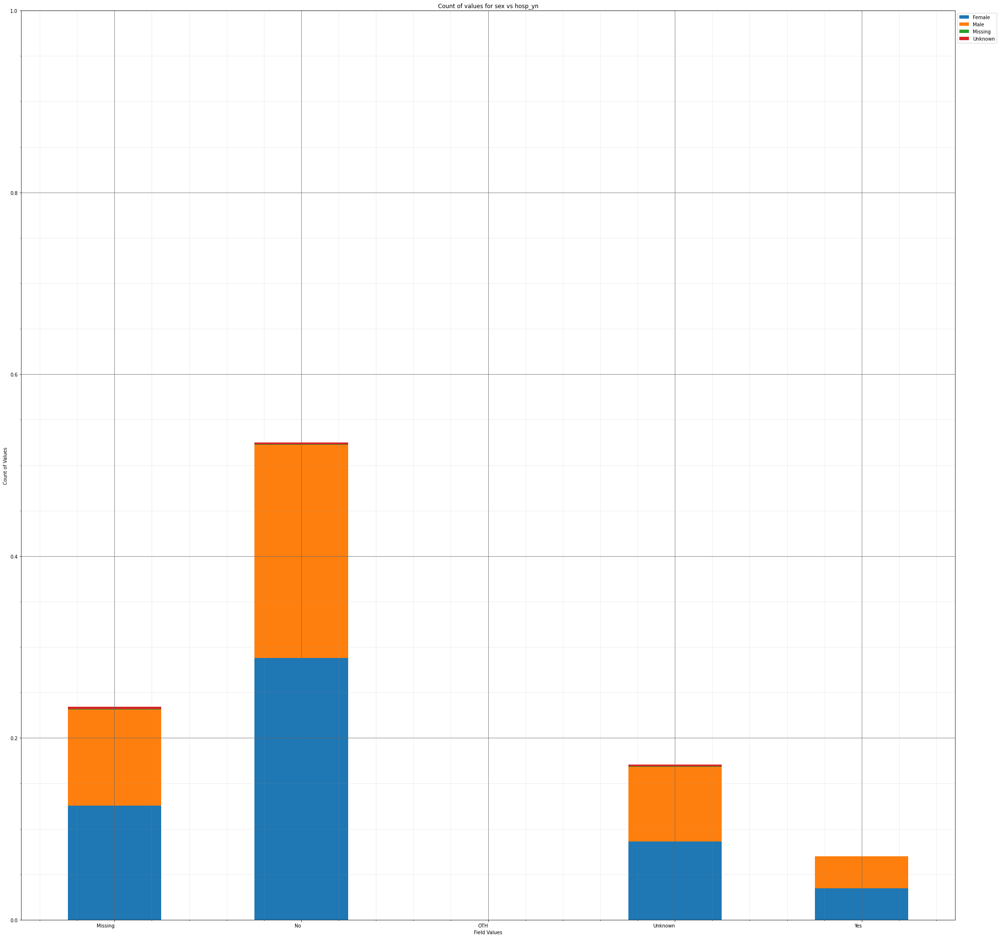



----------------------


Grouping over hosp_yn|age_group results in:



,hosp_yn,age_group,Rows,% Frequency
0,Missing,0 - 9 Years,97,0.97
1,Missing,10 - 19 Years,246,2.46
2,Missing,20 - 29 Years,468,4.68
3,Missing,30 - 39 Years,410,4.10
4,Missing,40 - 49 Years,367,3.67
5,Missing,50 - 59 Years,328,3.28
6,Missing,60 - 69 Years,220,2.20
7,Missing,70 - 79 Years,116,1.16
8,Missing,80+ Years,88,0.88
9,Missing,Missing,3,0.03


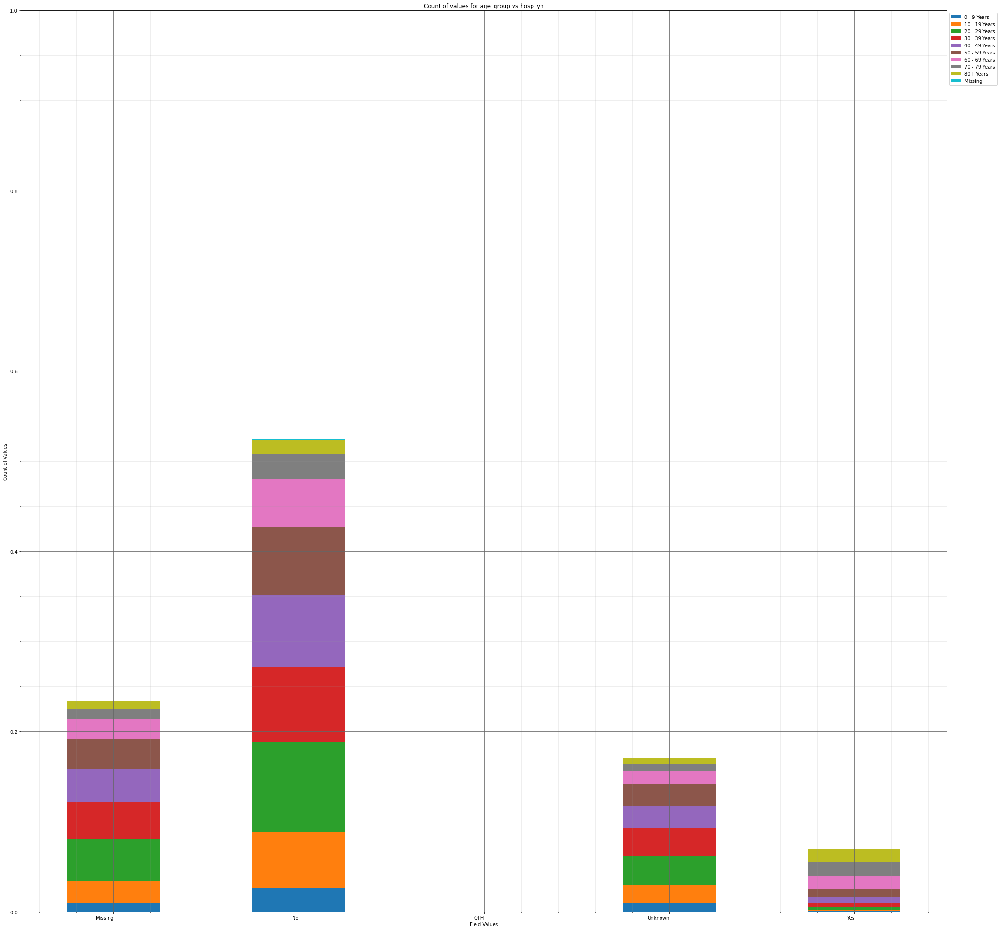



----------------------


Grouping over hosp_yn|race_ethnicity_combined results in:



,hosp_yn,race_ethnicity_combined,Rows,% Frequency
0,Missing,"American Indian/Alaska Native, Non-Hispanic",9,0.09
1,Missing,"Asian, Non-Hispanic",65,0.65
2,Missing,"Black, Non-Hispanic",93,0.93
3,Missing,Hispanic/Latino,80,0.80
4,Missing,Missing,35,0.35
5,Missing,"Multiple/Other, Non-Hispanic",134,1.34
6,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",5,0.05
7,Missing,Unknown,1354,13.54
8,Missing,"White, Non-Hispanic",568,5.68
9,No,"American Indian/Alaska Native, Non-Hispanic",39,0.39


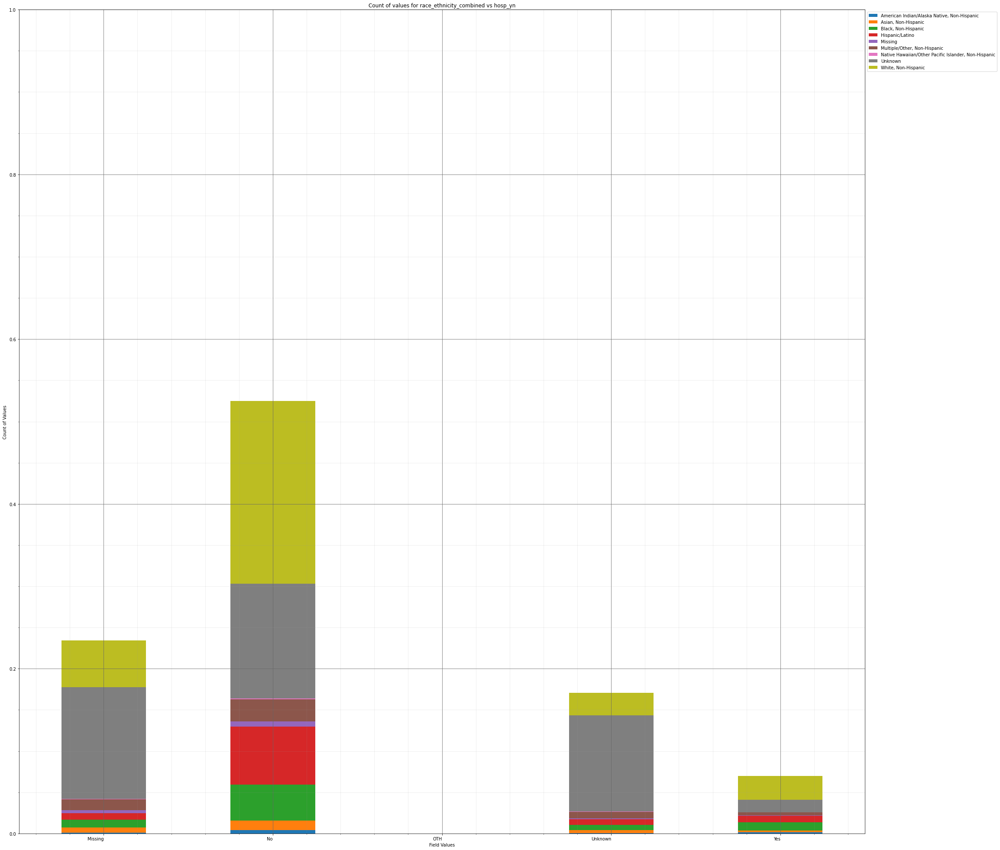



----------------------


Grouping over hosp_yn|icu_yn results in:



,hosp_yn,icu_yn,Rows,% Frequency
0,Missing,Missing,2328,23.28
1,Missing,No,14,0.14
2,Missing,Unknown,1,0.01
3,Missing,Yes,0,0.00
4,No,Missing,3842,38.42
5,No,No,799,7.99
6,No,Unknown,607,6.07
7,No,Yes,1,0.01
8,OTH,Missing,1,0.01
9,OTH,No,0,0.00


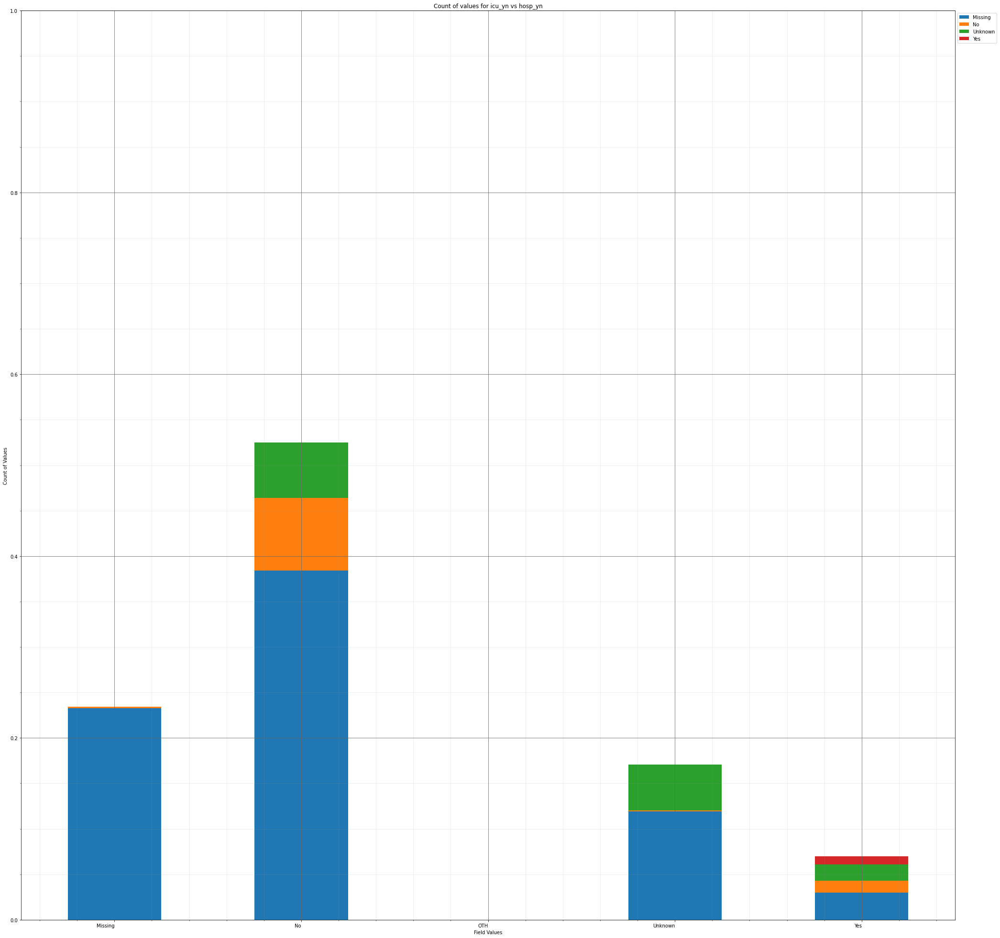



----------------------


Grouping over hosp_yn|death_yn results in:



,hosp_yn,death_yn,Rows,% Frequency
0,Missing,No,2298,22.98
1,Missing,Yes,45,0.45
2,No,No,5201,52.01
3,No,Yes,48,0.48
4,OTH,No,1,0.01
5,OTH,Yes,0,0.00
6,Unknown,No,1672,16.72
7,Unknown,Yes,36,0.36
8,Yes,No,493,4.93
9,Yes,Yes,206,2.06


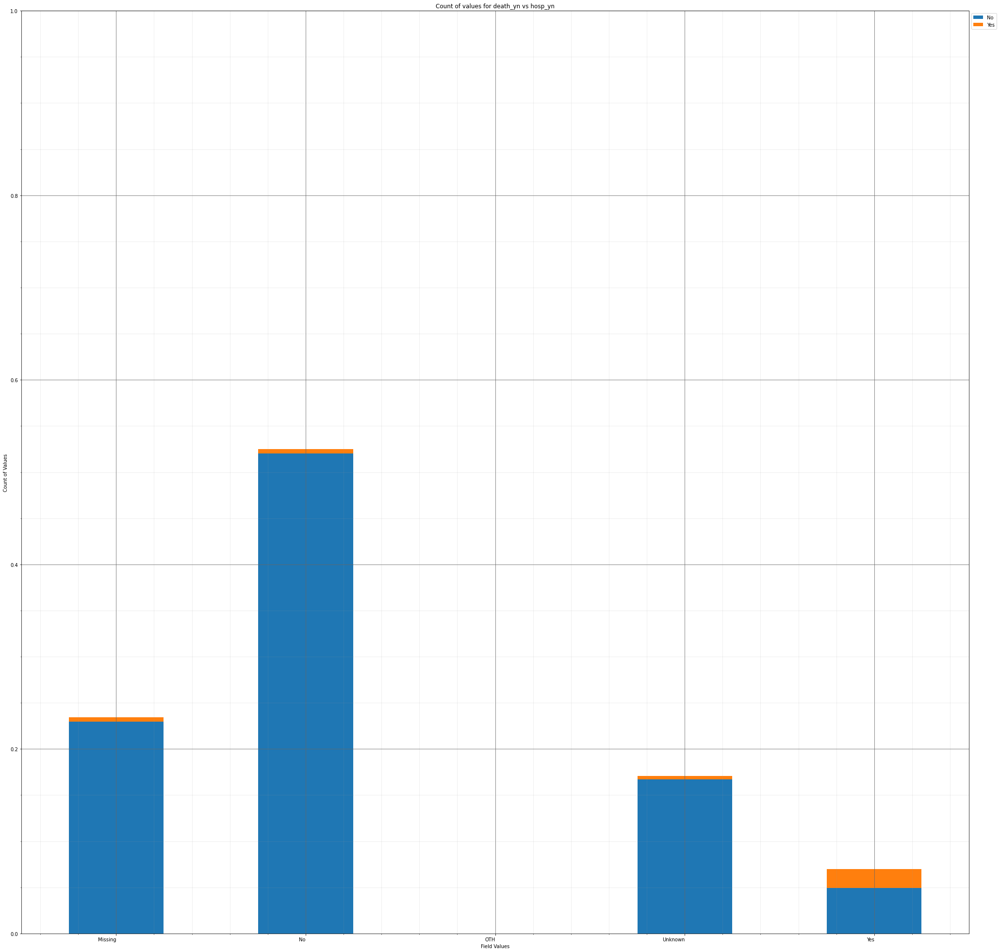



----------------------


Grouping over hosp_yn|medcond_yn results in:



,hosp_yn,medcond_yn,Rows,% Frequency
0,Missing,Missing,2063,20.63
1,Missing,No,192,1.92
2,Missing,Unknown,5,0.05
3,Missing,Yes,83,0.83
4,No,Missing,3746,37.46
5,No,No,695,6.95
6,No,Unknown,251,2.51
7,No,Yes,557,5.57
8,OTH,Missing,0,0.00
9,OTH,No,0,0.00


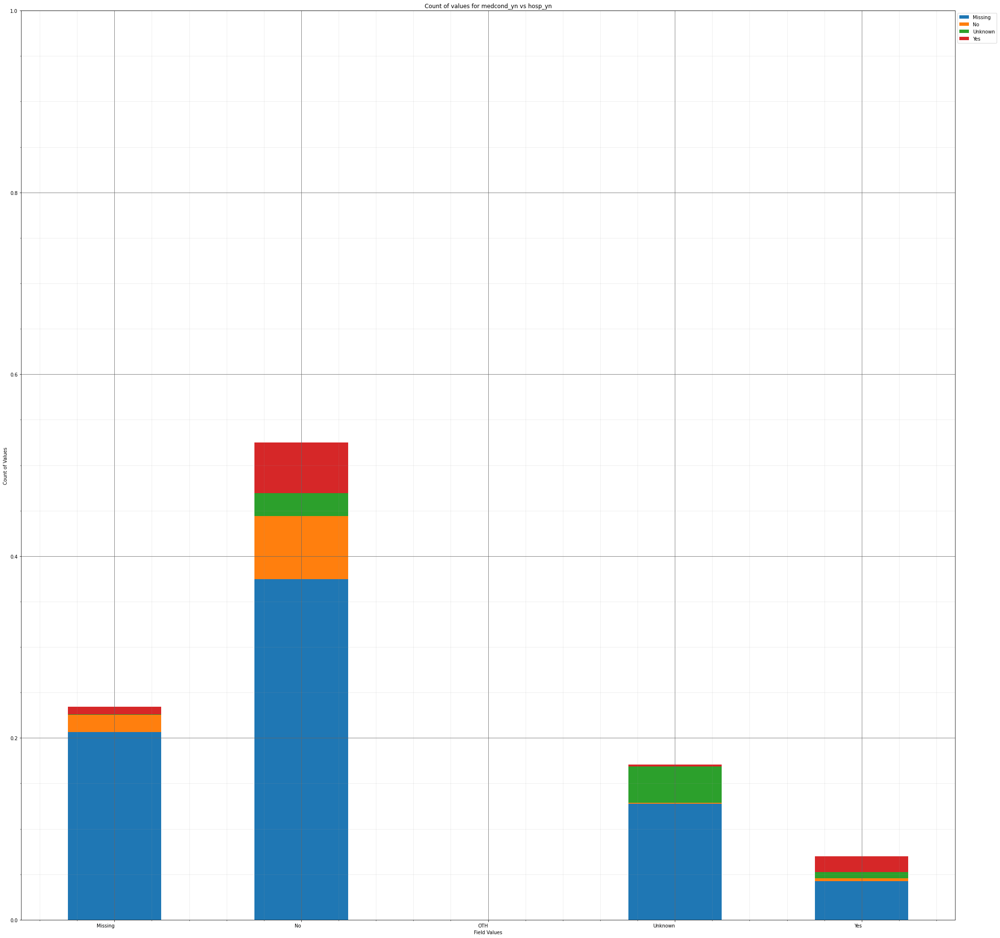



----------------------


Grouping over icu_yn|current_status results in:



,icu_yn,current_status,Rows,% Frequency
0,Missing,Laboratory-confirmed case,7200,72.00
1,Missing,Probable Case,462,4.62
2,No,Laboratory-confirmed case,879,8.79
3,No,Probable Case,79,0.79
4,Unknown,Laboratory-confirmed case,1160,11.60
5,Unknown,Probable Case,128,1.28
6,Yes,Laboratory-confirmed case,91,0.91
7,Yes,Probable Case,1,0.01


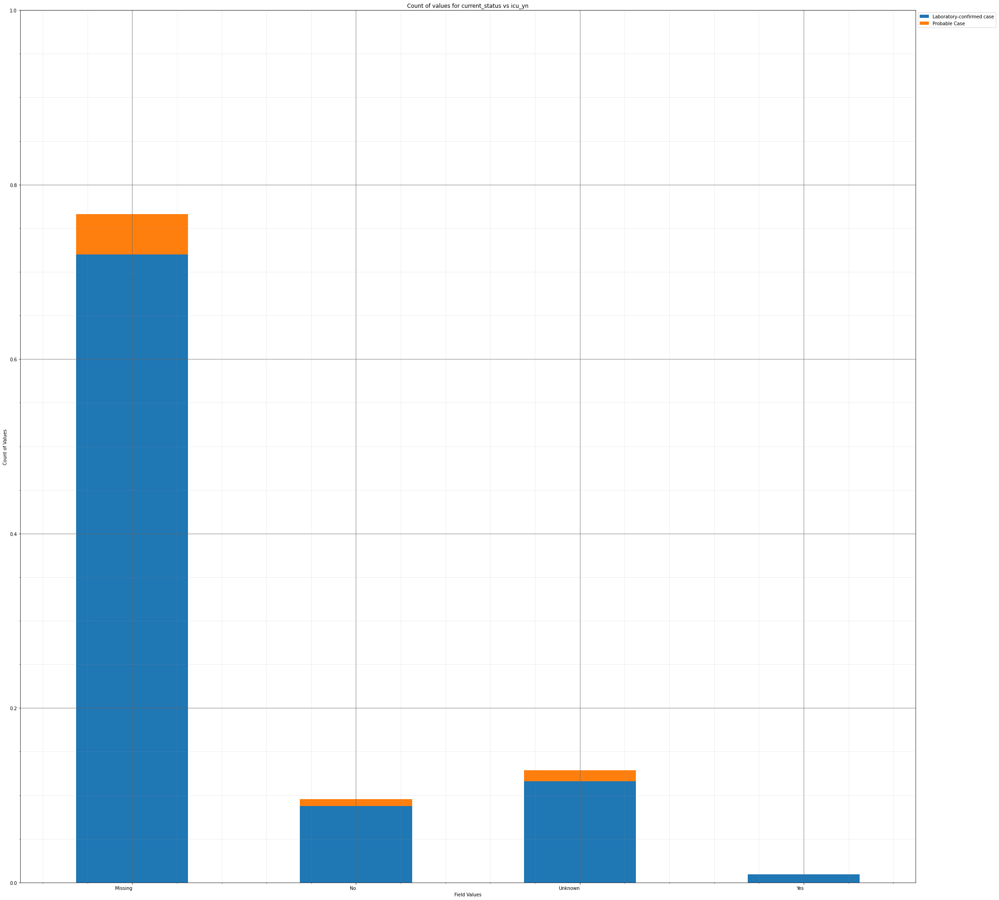



----------------------


Grouping over icu_yn|sex results in:



,icu_yn,sex,Rows,% Frequency
0,Missing,Female,4084,40.84
1,Missing,Male,3509,35.09
2,Missing,Missing,5,0.05
3,Missing,Unknown,64,0.64
4,No,Female,512,5.12
5,No,Male,442,4.42
6,No,Missing,0,0.00
7,No,Unknown,4,0.04
8,Unknown,Female,701,7.01
9,Unknown,Male,576,5.76


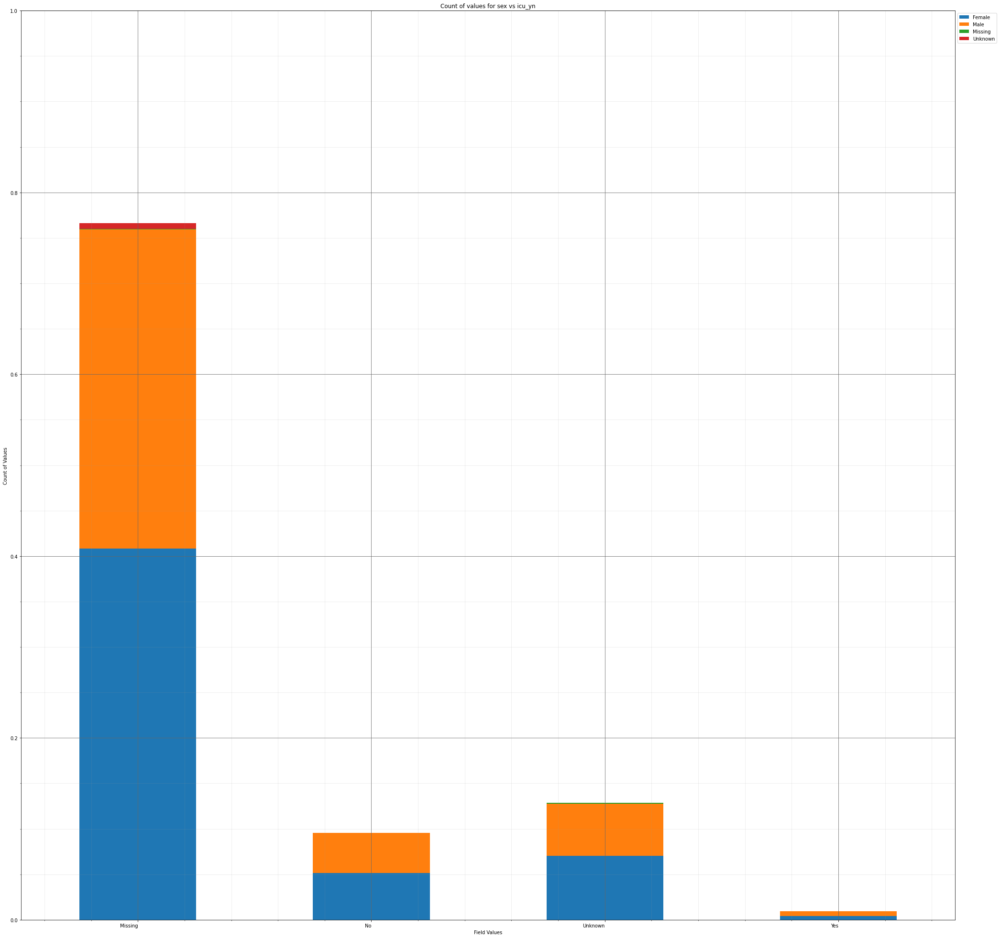



----------------------


Grouping over icu_yn|age_group results in:



,icu_yn,age_group,Rows,% Frequency
0,Missing,0 - 9 Years,383,3.83
1,Missing,10 - 19 Years,830,8.30
2,Missing,20 - 29 Years,1437,14.37
3,Missing,30 - 39 Years,1271,12.71
4,Missing,40 - 49 Years,1171,11.71
5,Missing,50 - 59 Years,1067,10.67
6,Missing,60 - 69 Years,761,7.61
7,Missing,70 - 79 Years,435,4.35
8,Missing,80+ Years,294,2.94
9,Missing,Missing,13,0.13


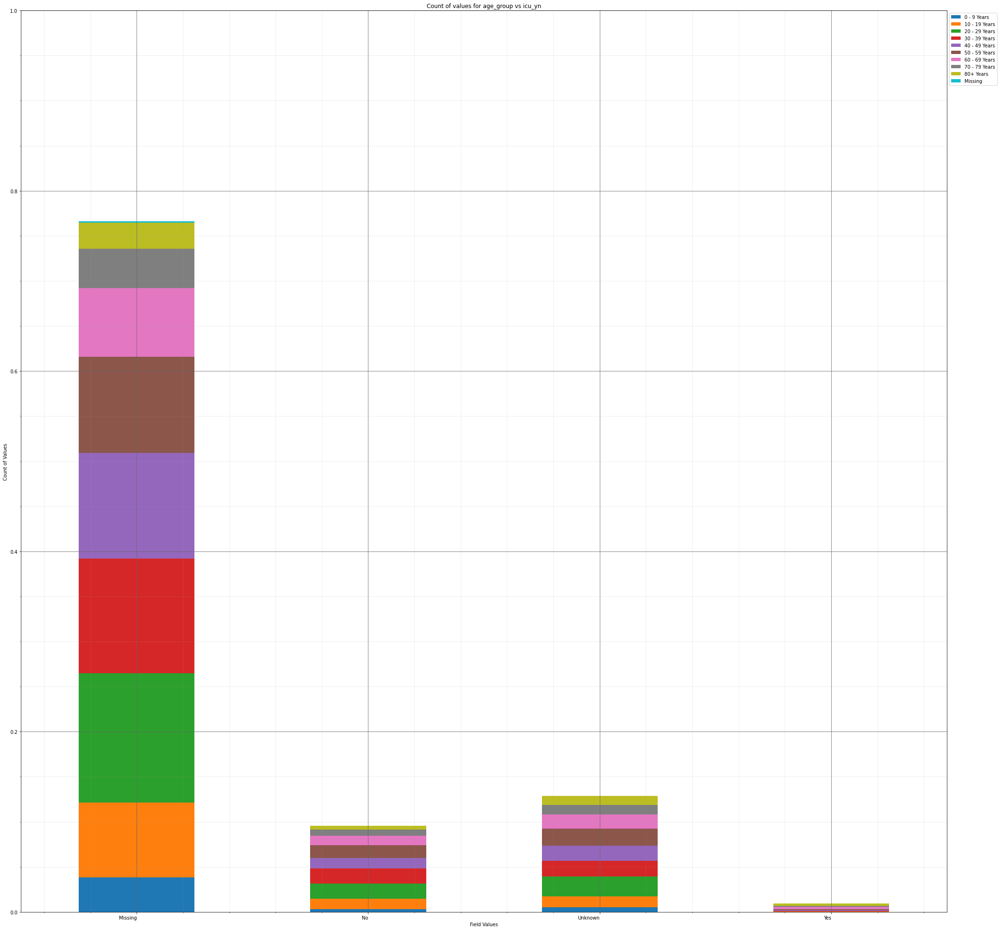



----------------------


Grouping over icu_yn|race_ethnicity_combined results in:



,icu_yn,race_ethnicity_combined,Rows,% Frequency
0,Missing,"American Indian/Alaska Native, Non-Hispanic",52,0.52
1,Missing,"Asian, Non-Hispanic",203,2.03
2,Missing,"Black, Non-Hispanic",483,4.83
3,Missing,Hispanic/Latino,599,5.99
4,Missing,Missing,100,1.00
5,Missing,"Multiple/Other, Non-Hispanic",449,4.49
6,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",16,0.16
7,Missing,Unknown,3370,33.70
8,Missing,"White, Non-Hispanic",2390,23.90
9,No,"American Indian/Alaska Native, Non-Hispanic",7,0.07


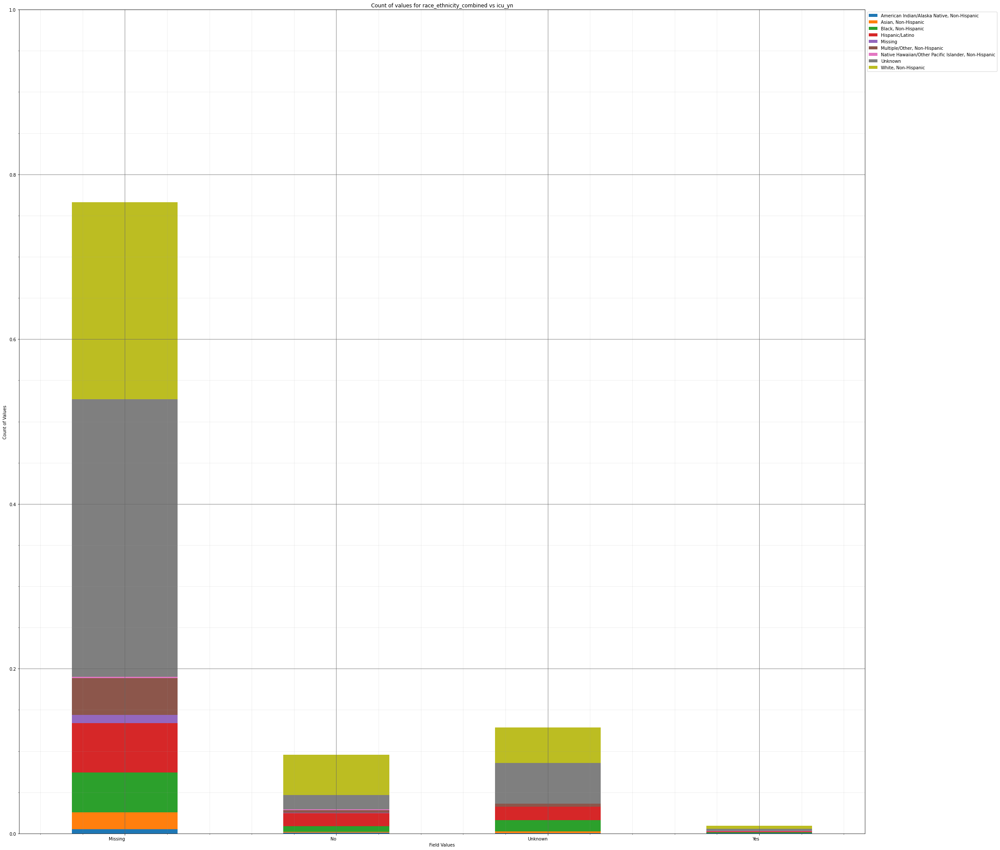



----------------------


Grouping over icu_yn|hosp_yn results in:



,icu_yn,hosp_yn,Rows,% Frequency
0,Missing,Missing,2328,23.28
1,Missing,No,3842,38.42
2,Missing,OTH,1,0.01
3,Missing,Unknown,1192,11.92
4,Missing,Yes,299,2.99
5,No,Missing,14,0.14
6,No,No,799,7.99
7,No,OTH,0,0.00
8,No,Unknown,13,0.13
9,No,Yes,132,1.32


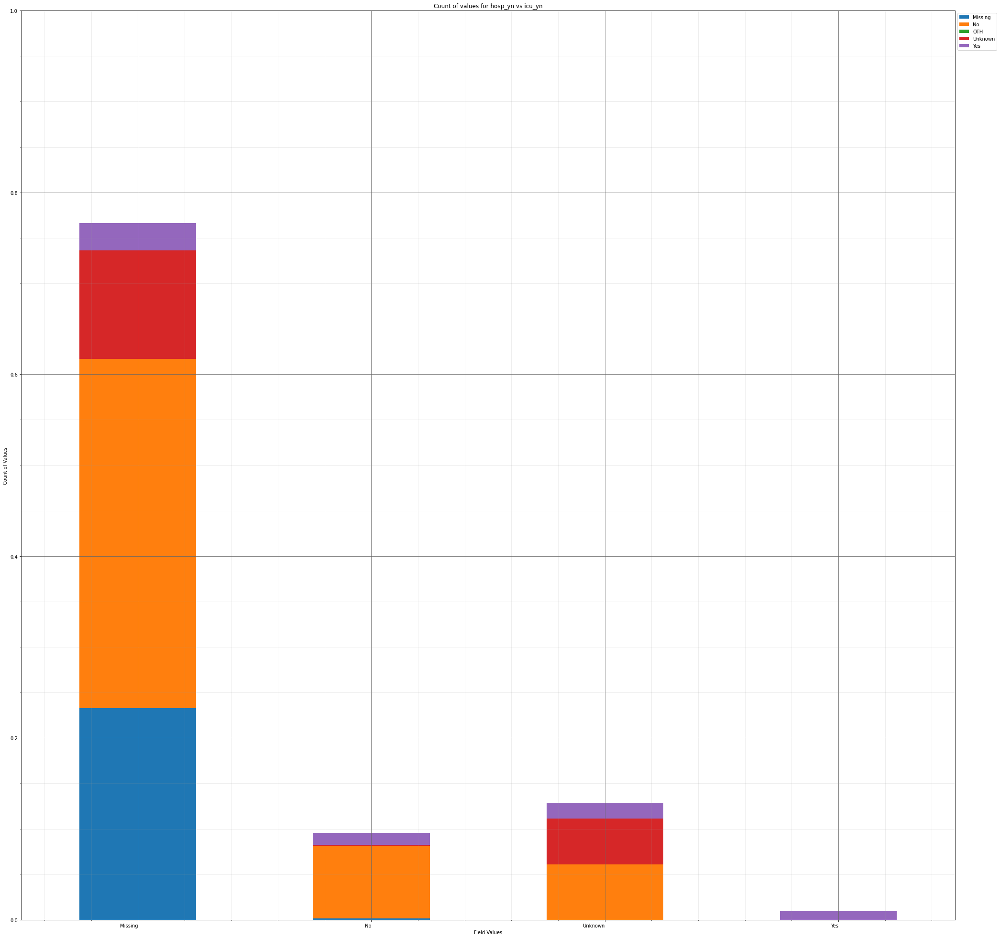



----------------------


Grouping over icu_yn|death_yn results in:



,icu_yn,death_yn,Rows,% Frequency
0,Missing,No,7498,74.98
1,Missing,Yes,164,1.64
2,No,No,929,9.29
3,No,Yes,29,0.29
4,Unknown,No,1195,11.95
5,Unknown,Yes,93,0.93
6,Yes,No,43,0.43
7,Yes,Yes,49,0.49


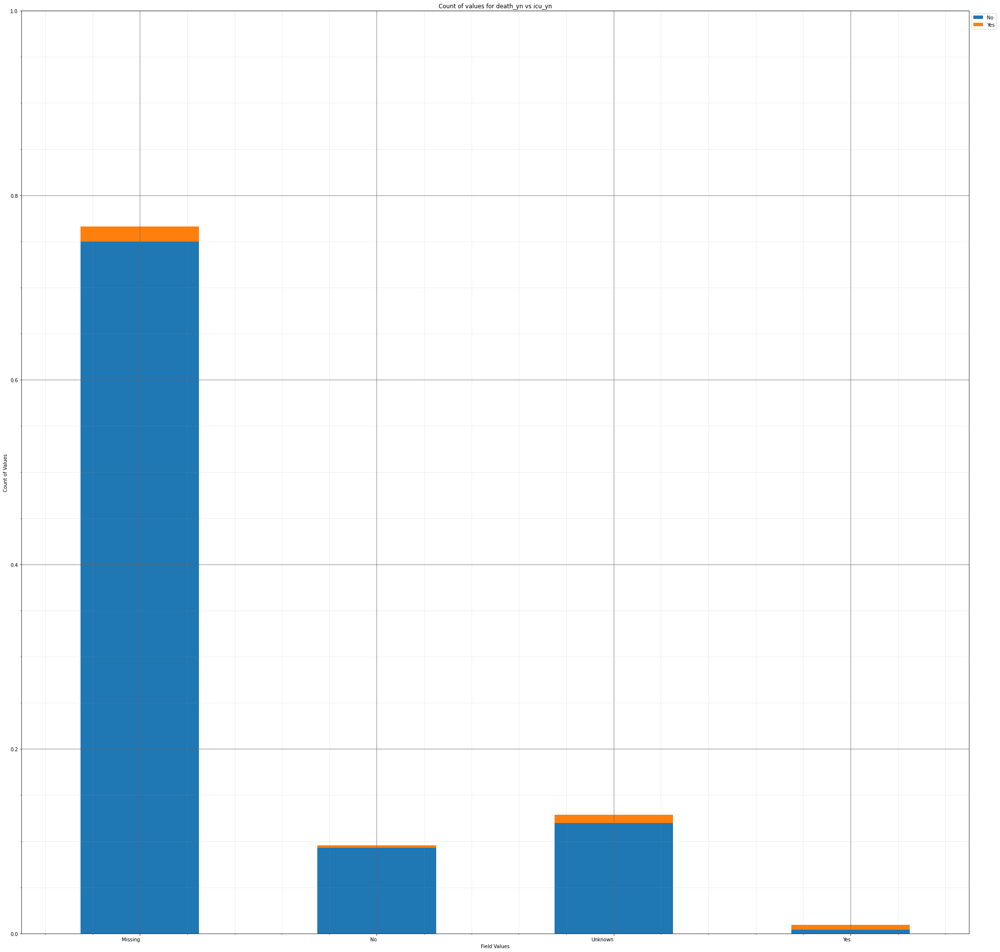



----------------------


Grouping over icu_yn|medcond_yn results in:



,icu_yn,medcond_yn,Rows,% Frequency
0,Missing,Missing,7038,70.38
1,Missing,No,311,3.11
2,Missing,Unknown,35,0.35
3,Missing,Yes,278,2.78
4,No,Missing,216,2.16
5,No,No,402,4.02
6,No,Unknown,34,0.34
7,No,Yes,306,3.06
8,Unknown,Missing,216,2.16
9,Unknown,No,212,2.12


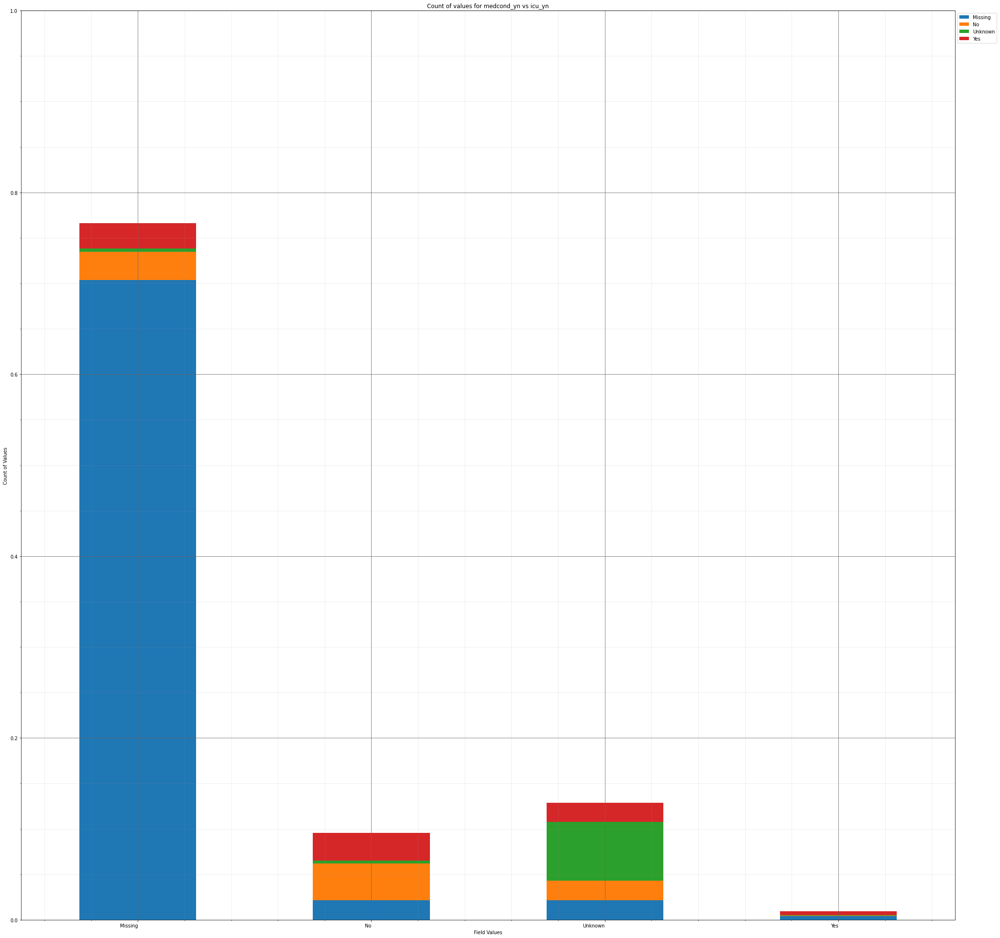



----------------------


Grouping over death_yn|current_status results in:



,death_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,9022,90.22
1,No,Probable Case,643,6.43
2,Yes,Laboratory-confirmed case,308,3.08
3,Yes,Probable Case,27,0.27


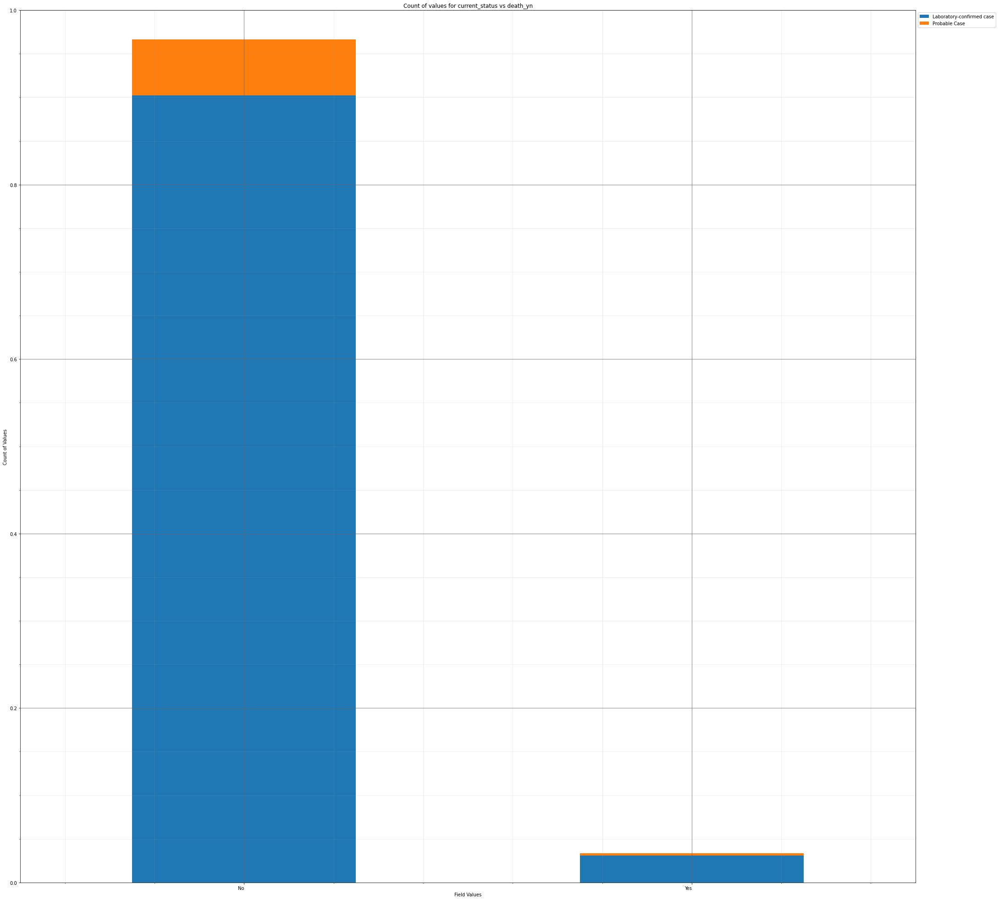



----------------------


Grouping over death_yn|sex results in:



,death_yn,sex,Rows,% Frequency
0,No,Female,5172,51.72
1,No,Male,4411,44.11
2,No,Missing,12,0.12
3,No,Unknown,70,0.70
4,Yes,Female,167,1.67
5,Yes,Male,165,1.65
6,Yes,Missing,1,0.01
7,Yes,Unknown,2,0.02


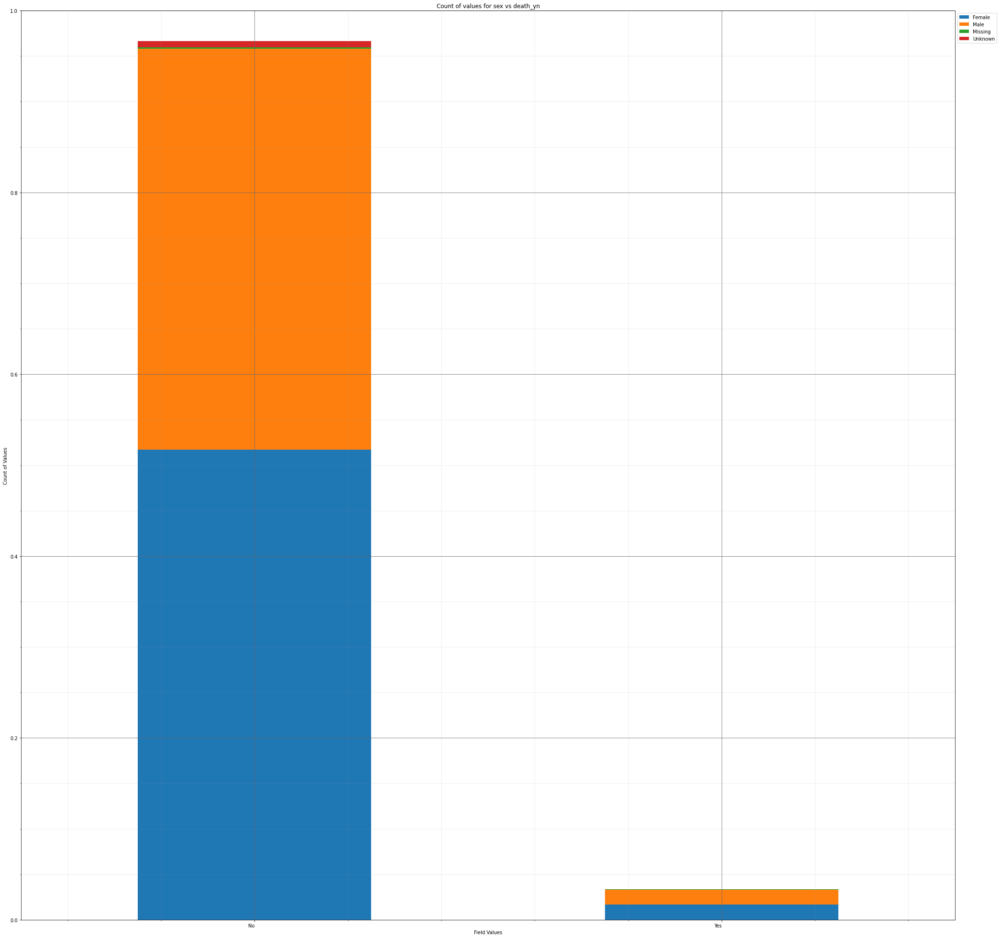



----------------------


Grouping over death_yn|age_group results in:



,death_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,468,4.68
1,No,10 - 19 Years,1069,10.69
2,No,20 - 29 Years,1826,18.26
3,No,30 - 39 Years,1609,16.09
4,No,40 - 49 Years,1460,14.60
5,No,50 - 59 Years,1389,13.89
6,No,60 - 69 Years,984,9.84
7,No,70 - 79 Years,538,5.38
8,No,80+ Years,309,3.09
9,No,Missing,13,0.13


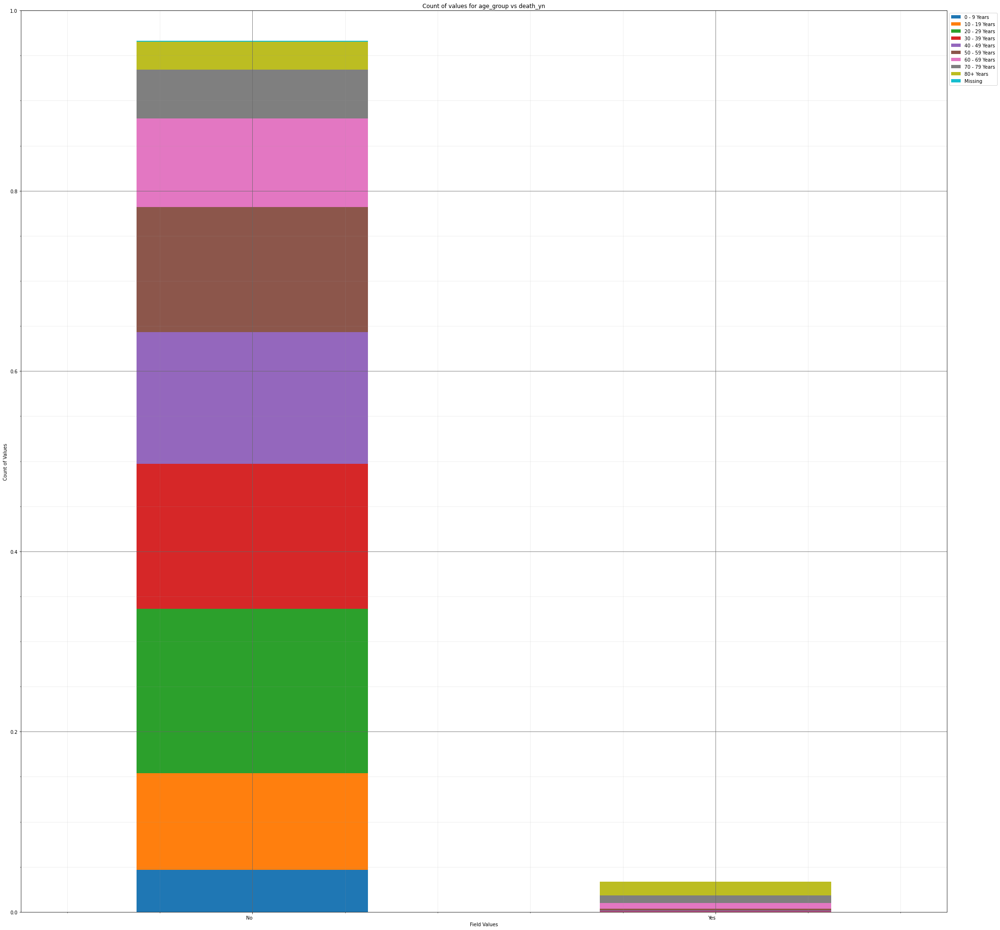



----------------------


Grouping over death_yn|race_ethnicity_combined results in:



,death_yn,race_ethnicity_combined,Rows,% Frequency
0,No,"American Indian/Alaska Native, Non-Hispanic",60,0.60
1,No,"Asian, Non-Hispanic",232,2.32
2,No,"Black, Non-Hispanic",657,6.57
3,No,Hispanic/Latino,901,9.01
4,No,Missing,102,1.02
5,No,"Multiple/Other, Non-Hispanic",507,5.07
6,No,"Native Hawaiian/Other Pacific Islander, Non-Hi...",23,0.23
7,No,Unknown,4012,40.12
8,No,"White, Non-Hispanic",3171,31.71
9,Yes,"American Indian/Alaska Native, Non-Hispanic",6,0.06


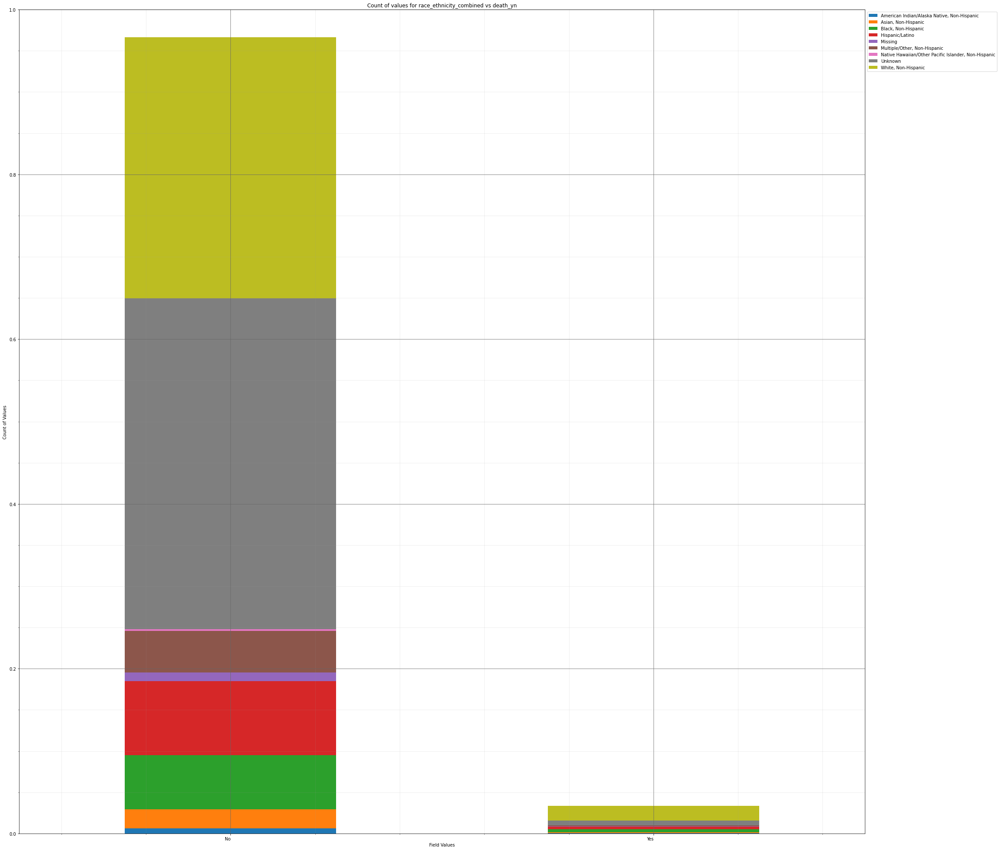



----------------------


Grouping over death_yn|hosp_yn results in:



,death_yn,hosp_yn,Rows,% Frequency
0,No,Missing,2298,22.98
1,No,No,5201,52.01
2,No,OTH,1,0.01
3,No,Unknown,1672,16.72
4,No,Yes,493,4.93
5,Yes,Missing,45,0.45
6,Yes,No,48,0.48
7,Yes,OTH,0,0.00
8,Yes,Unknown,36,0.36
9,Yes,Yes,206,2.06


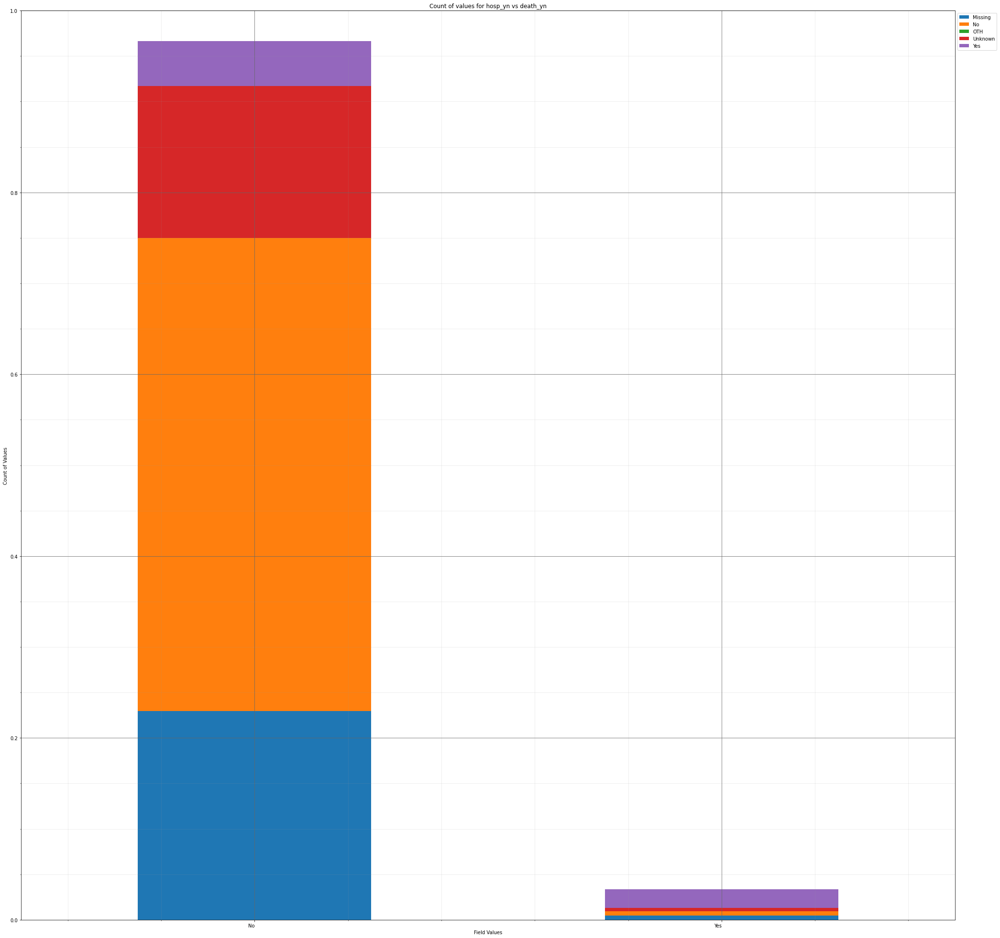



----------------------


Grouping over death_yn|icu_yn results in:



,death_yn,icu_yn,Rows,% Frequency
0,No,Missing,7498,74.98
1,No,No,929,9.29
2,No,Unknown,1195,11.95
3,No,Yes,43,0.43
4,Yes,Missing,164,1.64
5,Yes,No,29,0.29
6,Yes,Unknown,93,0.93
7,Yes,Yes,49,0.49


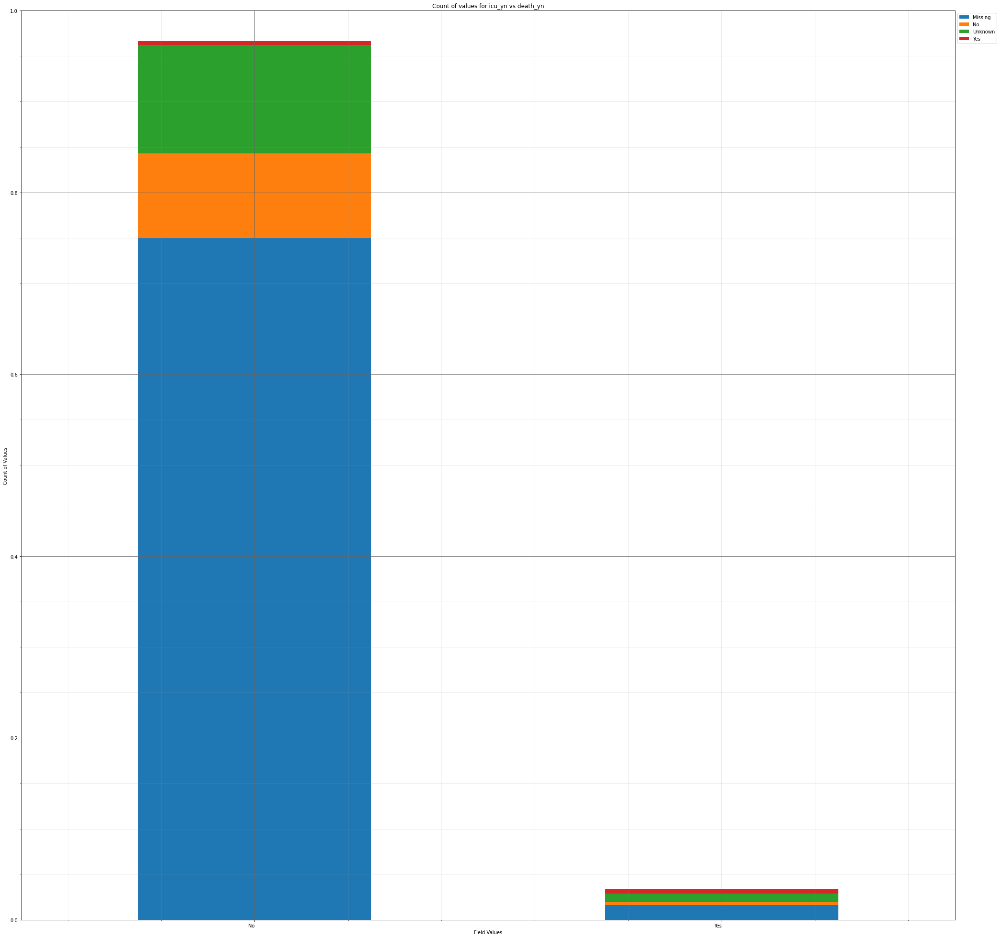



----------------------


Grouping over death_yn|medcond_yn results in:



,death_yn,medcond_yn,Rows,% Frequency
0,No,Missing,7325,73.25
1,No,No,924,9.24
2,No,Unknown,673,6.73
3,No,Yes,743,7.43
4,Yes,Missing,184,1.84
5,Yes,No,8,0.08
6,Yes,Unknown,49,0.49
7,Yes,Yes,94,0.94


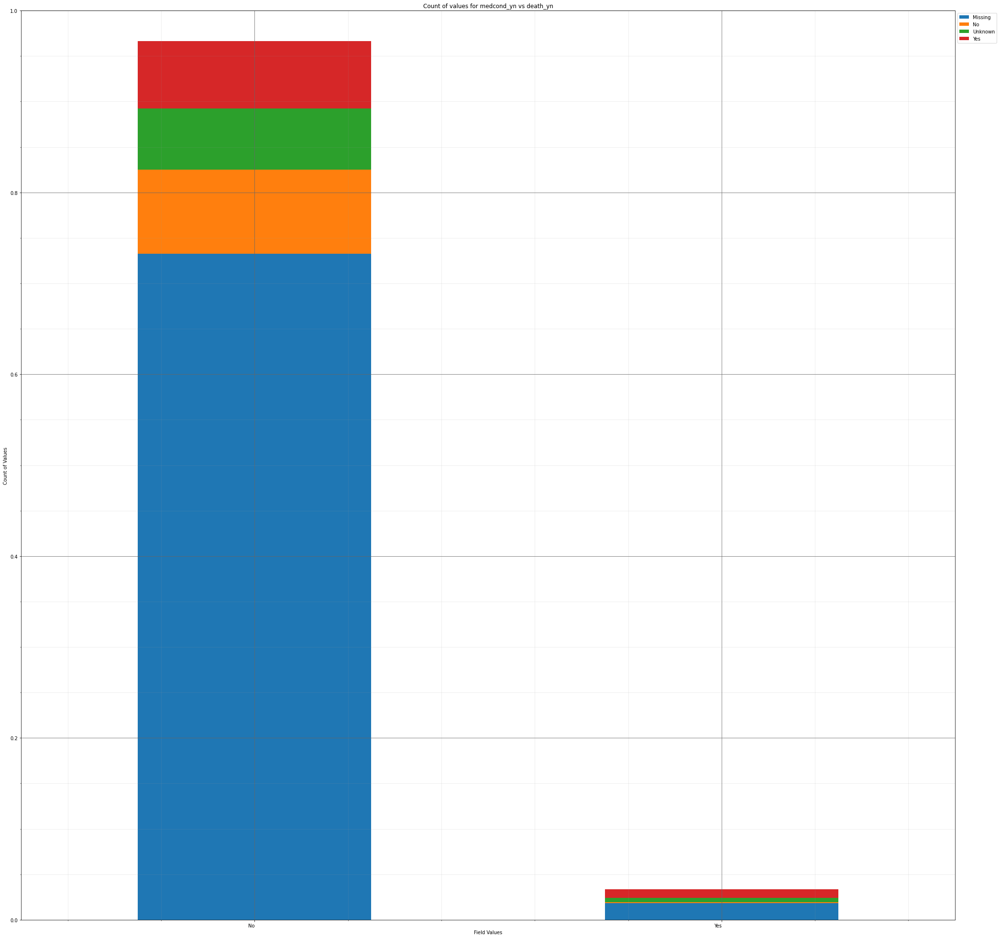



----------------------


Grouping over medcond_yn|current_status results in:



,medcond_yn,current_status,Rows,% Frequency
0,Missing,Laboratory-confirmed case,7028,70.28
1,Missing,Probable Case,481,4.81
2,No,Laboratory-confirmed case,857,8.57
3,No,Probable Case,75,0.75
4,Unknown,Laboratory-confirmed case,651,6.51
5,Unknown,Probable Case,71,0.71
6,Yes,Laboratory-confirmed case,794,7.94
7,Yes,Probable Case,43,0.43


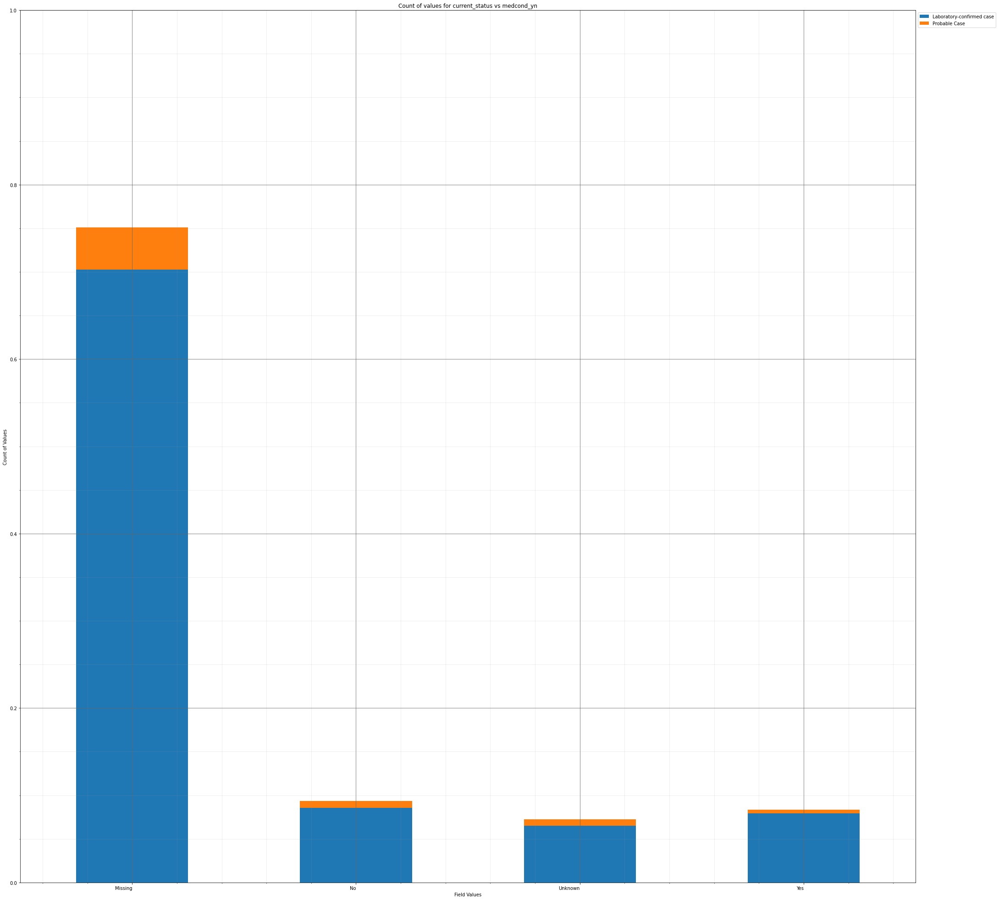



----------------------


Grouping over medcond_yn|sex results in:



,medcond_yn,sex,Rows,% Frequency
0,Missing,Female,3972,39.72
1,Missing,Male,3469,34.69
2,Missing,Missing,4,0.04
3,Missing,Unknown,64,0.64
4,No,Female,508,5.08
5,No,Male,417,4.17
6,No,Missing,3,0.03
7,No,Unknown,4,0.04
8,Unknown,Female,399,3.99
9,Unknown,Male,316,3.16


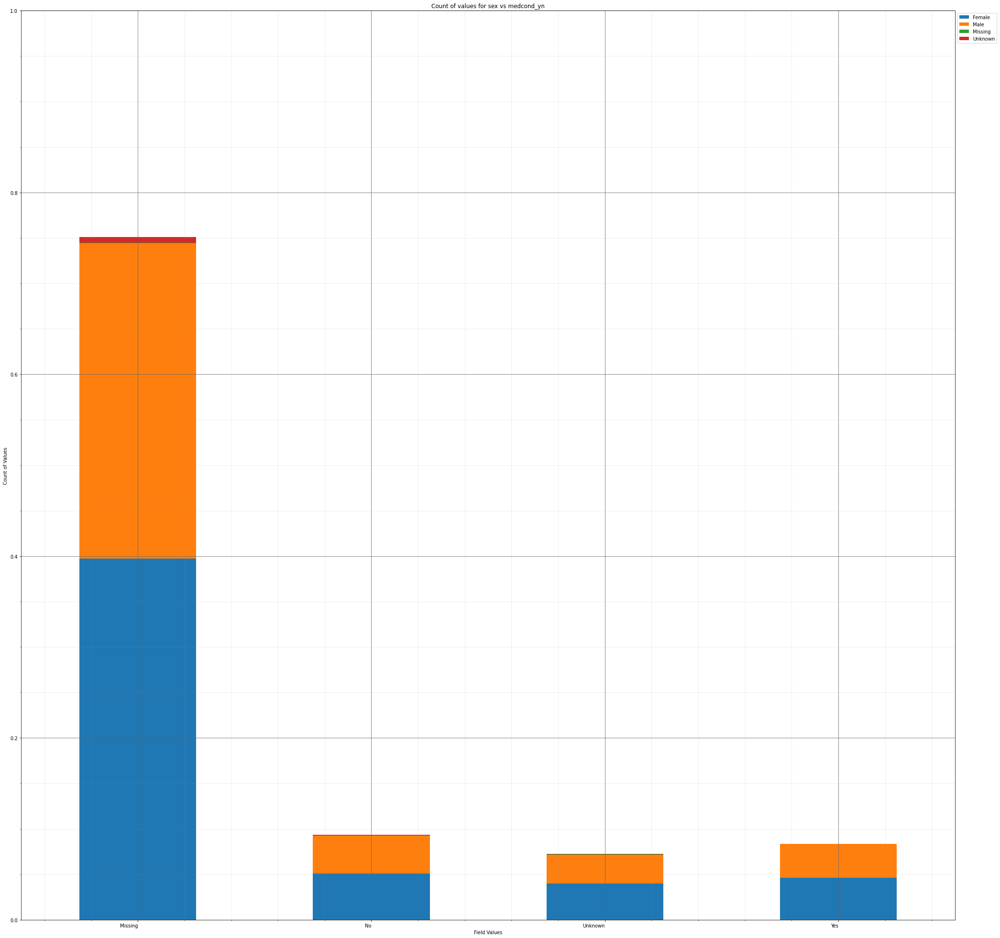



----------------------


Grouping over medcond_yn|age_group results in:



,medcond_yn,age_group,Rows,% Frequency
0,Missing,0 - 9 Years,367,3.67
1,Missing,10 - 19 Years,822,8.22
2,Missing,20 - 29 Years,1392,13.92
3,Missing,30 - 39 Years,1243,12.43
4,Missing,40 - 49 Years,1140,11.40
5,Missing,50 - 59 Years,1050,10.50
6,Missing,60 - 69 Years,751,7.51
7,Missing,70 - 79 Years,426,4.26
8,Missing,80+ Years,305,3.05
9,Missing,Missing,13,0.13


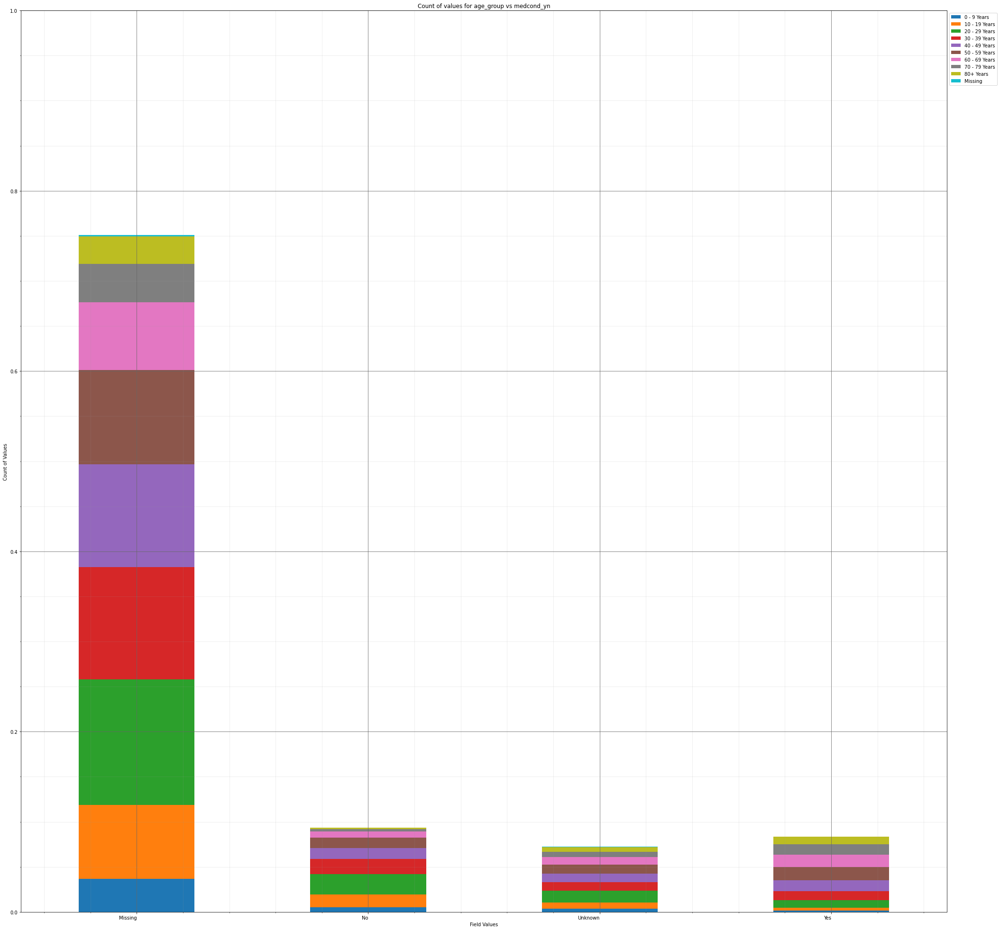



----------------------


Grouping over medcond_yn|race_ethnicity_combined results in:



,medcond_yn,race_ethnicity_combined,Rows,% Frequency
0,Missing,"American Indian/Alaska Native, Non-Hispanic",51,0.51
1,Missing,"Asian, Non-Hispanic",201,2.01
2,Missing,"Black, Non-Hispanic",439,4.39
3,Missing,Hispanic/Latino,589,5.89
4,Missing,Missing,103,1.03
5,Missing,"Multiple/Other, Non-Hispanic",435,4.35
6,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",19,0.19
7,Missing,Unknown,3462,34.62
8,Missing,"White, Non-Hispanic",2210,22.10
9,No,"American Indian/Alaska Native, Non-Hispanic",4,0.04


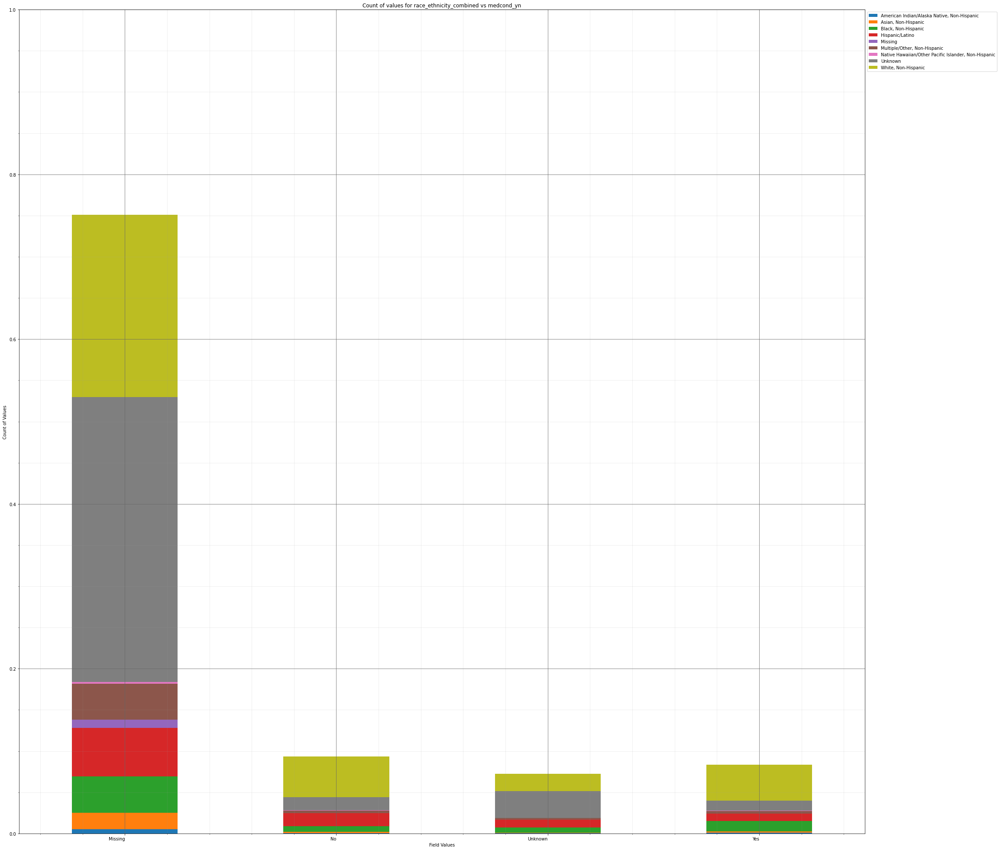



----------------------


Grouping over medcond_yn|hosp_yn results in:



,medcond_yn,hosp_yn,Rows,% Frequency
0,Missing,Missing,2063,20.63
1,Missing,No,3746,37.46
2,Missing,OTH,0,0.00
3,Missing,Unknown,1276,12.76
4,Missing,Yes,424,4.24
5,No,Missing,192,1.92
6,No,No,695,6.95
7,No,OTH,0,0.00
8,No,Unknown,11,0.11
9,No,Yes,34,0.34


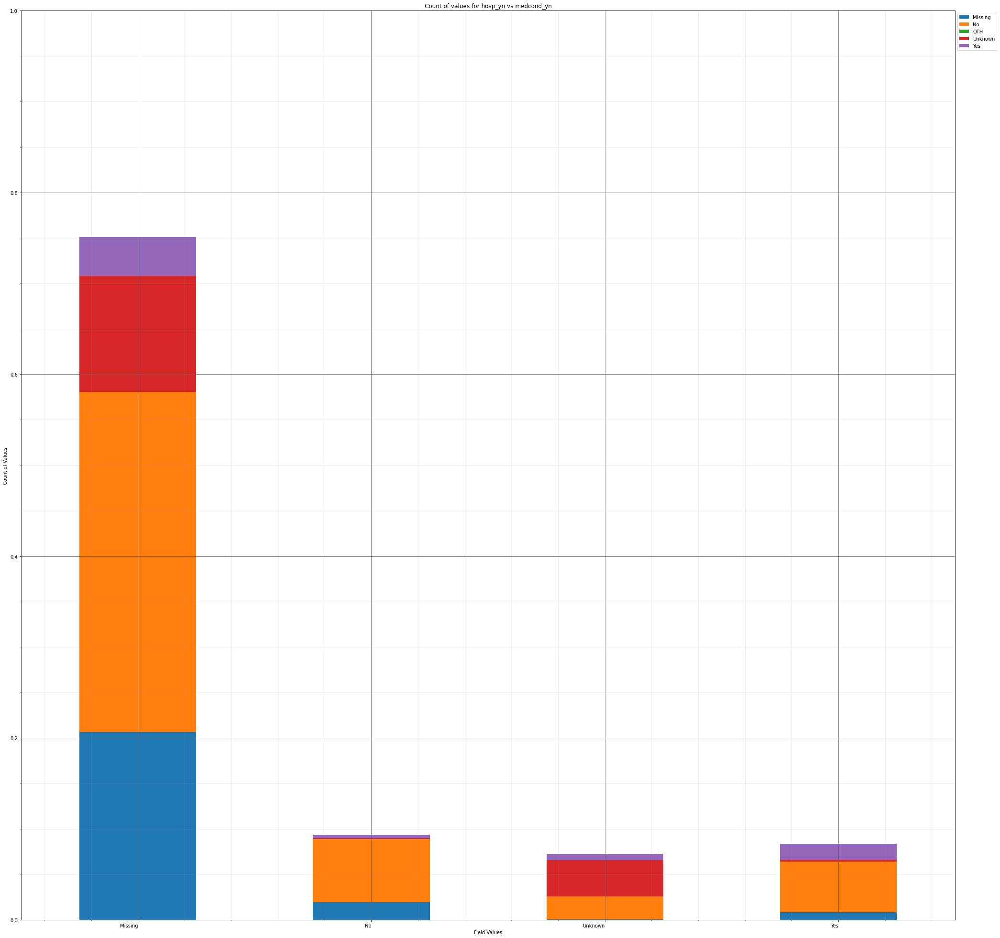



----------------------


Grouping over medcond_yn|icu_yn results in:



,medcond_yn,icu_yn,Rows,% Frequency
0,Missing,Missing,7038,70.38
1,Missing,No,216,2.16
2,Missing,Unknown,216,2.16
3,Missing,Yes,39,0.39
4,No,Missing,311,3.11
5,No,No,402,4.02
6,No,Unknown,212,2.12
7,No,Yes,7,0.07
8,Unknown,Missing,35,0.35
9,Unknown,No,34,0.34


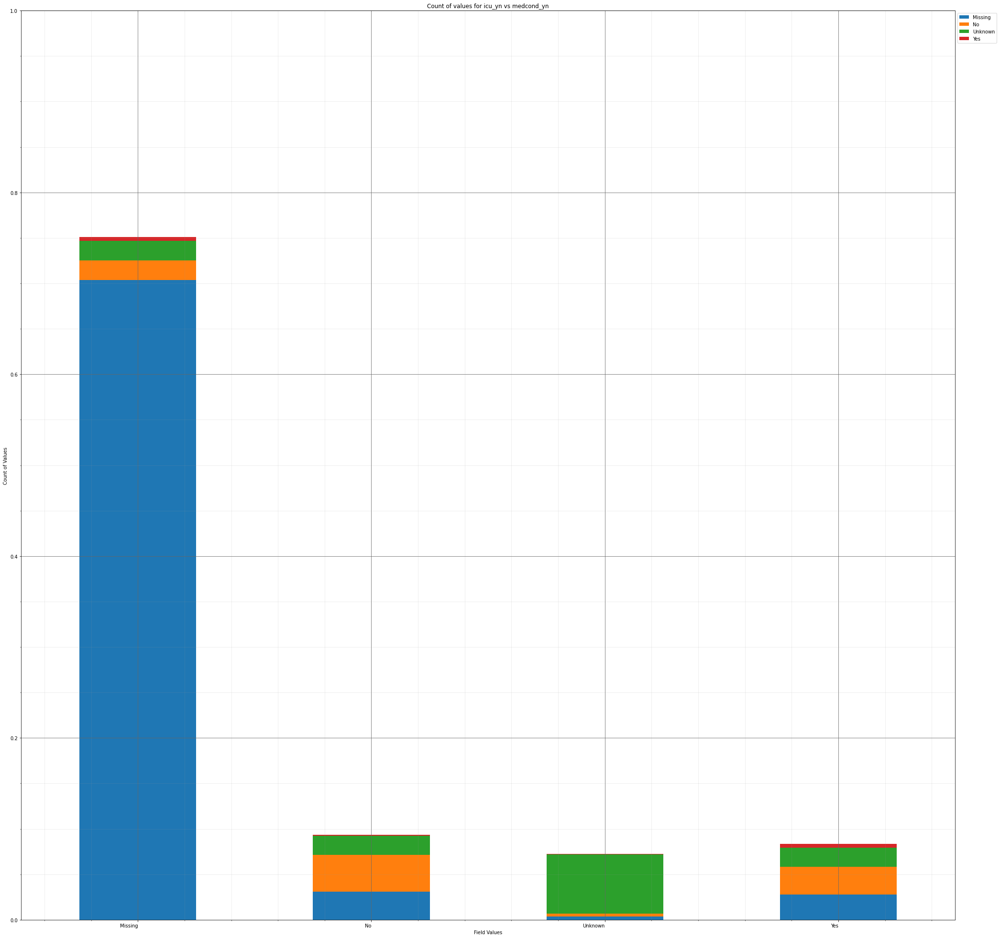



----------------------


Grouping over medcond_yn|death_yn results in:



,medcond_yn,death_yn,Rows,% Frequency
0,Missing,No,7325,73.25
1,Missing,Yes,184,1.84
2,No,No,924,9.24
3,No,Yes,8,0.08
4,Unknown,No,673,6.73
5,Unknown,Yes,49,0.49
6,Yes,No,743,7.43
7,Yes,Yes,94,0.94


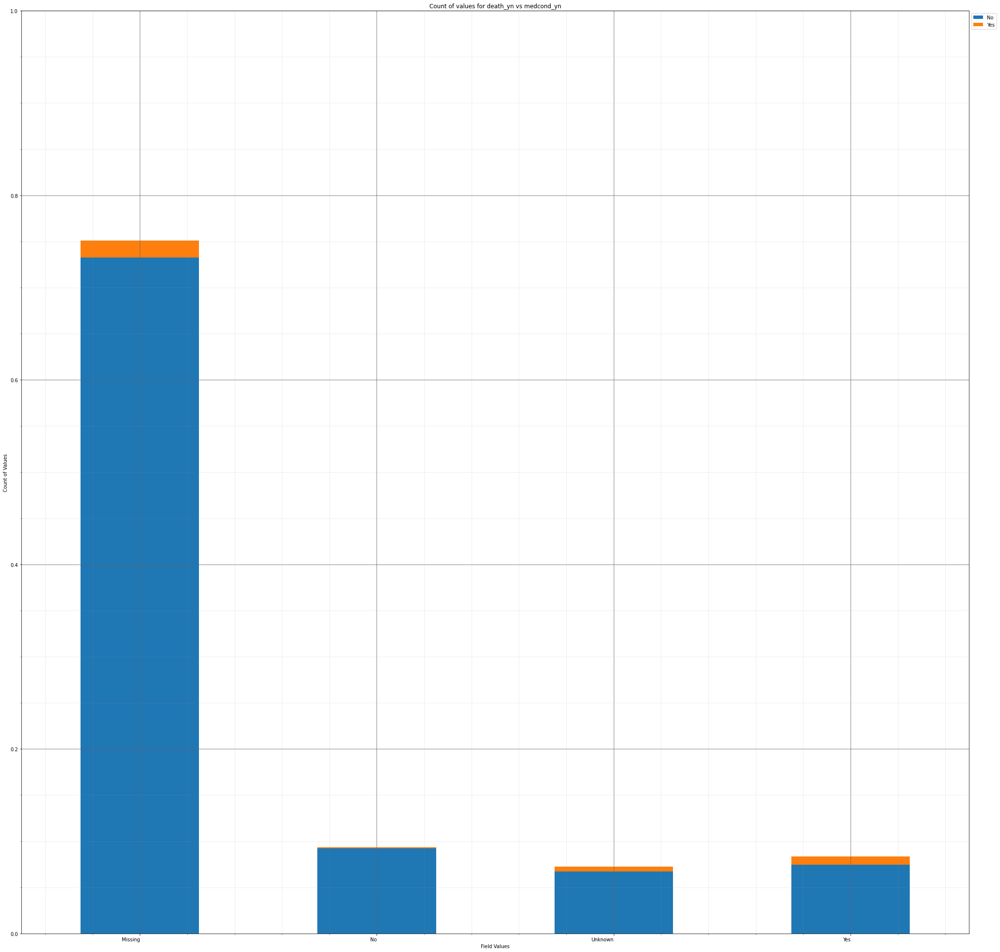

In [23]:
pair_frequency_dict={}
pair_frequency_dict=group_over_multi_categories(staging_covid_sample_data_df,categorical_columns,save_output=True,save_fig=True,pdf_fn=multi_categorical_barplot_initial_fn)

#### 1.3.4.2.3 Create print statements showing lists with the unique values for validation

In [24]:
#Check the unique values
for column in categorical_columns:
    print('For {} the unique values are: {}\n'.format(column,staging_covid_sample_data_df[column].unique()))

For current_status the unique values are: ['Laboratory-confirmed case', 'Probable Case']
Categories (2, object): ['Laboratory-confirmed case', 'Probable Case']

For sex the unique values are: ['Female', 'Male', 'Unknown', 'Missing']
Categories (4, object): ['Female', 'Male', 'Unknown', 'Missing']

For age_group the unique values are: ['50 - 59 Years', '10 - 19 Years', '60 - 69 Years', '40 - 49 Years', '30 - 39 Years', '80+ Years', '20 - 29 Years', '0 - 9 Years', '70 - 79 Years', 'Missing']
Categories (10, object): ['50 - 59 Years', '10 - 19 Years', '60 - 69 Years', '40 - 49 Years', ..., '20 - 29 Years', '0 - 9 Years', '70 - 79 Years', 'Missing']

For race_ethnicity_combined the unique values are: ['Unknown', 'White, Non-Hispanic', 'Multiple/Other, Non-Hispanic', 'Asian, Non-Hispanic', 'Hispanic/Latino', 'Black, Non-Hispanic', 'American Indian/Alaska Native, Non-Hispanic', 'Missing', 'Native Hawaiian/Other Pacific Islander, Non-H...]
Categories (9, object): ['Unknown', 'White, Non-Hispa

#### 1.3.4.2.4 Check that cdc_case_earliest_dt is the minimum date as per the CDC

In [25]:
no_cdc_dt = list(set(datetime_columns) - set(["cdc_case_earliest_dt"]))

staging_covid_sample_data_df['min_clinical_cdc_dt']=staging_covid_sample_data_df[no_cdc_dt].min(axis=1)
staging_covid_sample_data_df['cdc_case_earliest_dt_validator']=(staging_covid_sample_data_df['min_clinical_cdc_dt']==staging_covid_sample_data_df["cdc_case_earliest_dt"]) #Boolean type by default

display(staging_covid_sample_data_df[staging_covid_sample_data_df['cdc_case_earliest_dt_validator']==False])

print("There are {} rows where the cdc_case_earliest_dt date does not match the minimum".format(len(staging_covid_sample_data_df[staging_covid_sample_data_df['cdc_case_earliest_dt_validator']==False])))

display(staging_covid_sample_data_df[staging_covid_sample_data_df['cdc_case_earliest_dt_validator']==False].dropna(how='all',subset=no_cdc_dt))

print("There are {} rows where the cdc_case_earliest_dt date does not match the minimum and the dates are not null".format(len(staging_covid_sample_data_df[staging_covid_sample_data_df['cdc_case_earliest_dt_validator']==False].dropna(how='all',subset=no_cdc_dt))))

,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
1,2020-04-16,NaT,NaT,NaT,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Missing,Missing,No,Missing,NaT,False
7,2021-01-01,NaT,NaT,NaT,Laboratory-confirmed case,Female,80+ Years,"Asian, Non-Hispanic",No,Missing,No,Missing,NaT,False
8,2020-09-23,NaT,NaT,NaT,Laboratory-confirmed case,Female,30 - 39 Years,Unknown,Unknown,Missing,No,Missing,NaT,False
9,2020-12-28,NaT,NaT,NaT,Laboratory-confirmed case,Female,60 - 69 Years,Unknown,Unknown,Missing,No,Missing,NaT,False
12,2020-07-08,NaT,NaT,NaT,Laboratory-confirmed case,Male,20 - 29 Years,Unknown,No,Missing,No,Missing,NaT,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,2020-05-19,NaT,NaT,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Unknown,Missing,No,Missing,NaT,False
9994,2021-01-14,NaT,NaT,NaT,Laboratory-confirmed case,Female,80+ Years,"Multiple/Other, Non-Hispanic",No,Missing,No,Missing,NaT,False
9996,2020-12-30,NaT,NaT,NaT,Laboratory-confirmed case,Female,30 - 39 Years,Unknown,Missing,Missing,No,Missing,NaT,False
9997,2020-08-27,2020-08-28,NaT,2020-08-28,Laboratory-confirmed case,Female,10 - 19 Years,Unknown,No,Missing,No,Missing,2020-08-28,False


There are 2857 rows where the cdc_case_earliest_dt date does not match the minimum


,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
29,2020-12-02,2020-12-09,NaT,2020-12-09,Laboratory-confirmed case,Male,10 - 19 Years,Unknown,No,Missing,No,Missing,2020-12-09,False
39,2020-09-30,2020-10-05,NaT,NaT,Laboratory-confirmed case,Male,20 - 29 Years,Hispanic/Latino,No,Missing,No,Missing,2020-10-05,False
65,2020-03-15,2020-04-30,NaT,NaT,Probable Case,Male,80+ Years,"Asian, Non-Hispanic",Yes,Unknown,Yes,Yes,2020-04-30,False
74,2020-12-06,2020-12-07,NaT,2020-12-07,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,No,Missing,No,Missing,2020-12-07,False
82,2020-05-01,2020-06-21,NaT,NaT,Laboratory-confirmed case,Female,70 - 79 Years,"White, Non-Hispanic",Yes,Missing,No,Missing,2020-06-21,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9970,2020-07-27,2020-08-01,NaT,NaT,Laboratory-confirmed case,Male,80+ Years,Missing,No,Missing,No,Missing,2020-08-01,False
9973,2020-11-12,2020-11-14,NaT,NaT,Laboratory-confirmed case,Female,10 - 19 Years,"White, Non-Hispanic",No,Missing,No,Missing,2020-11-14,False
9986,2020-12-18,2020-12-19,NaT,NaT,Laboratory-confirmed case,Female,20 - 29 Years,"Black, Non-Hispanic",Yes,Missing,No,Missing,2020-12-19,False
9987,2020-10-28,2020-11-13,NaT,NaT,Laboratory-confirmed case,Male,30 - 39 Years,Unknown,No,Missing,No,Missing,2020-11-13,False


There are 515 rows where the cdc_case_earliest_dt date does not match the minimum and the dates are not null


#### 1.3.4.2.5 Investigating Duplicates

431 Duplicated Rows



,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
120,2020-12-29,NaT,NaT,NaT,Laboratory-confirmed case,Female,30 - 39 Years,Unknown,No,Missing,No,Missing,NaT,False
760,2020-12-08,NaT,NaT,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,No,Missing,No,Missing,NaT,False
781,2020-12-13,NaT,NaT,NaT,Laboratory-confirmed case,Female,50 - 59 Years,"Multiple/Other, Non-Hispanic",Unknown,Missing,No,Missing,NaT,False
964,2020-12-24,2020-12-24,2020-12-24,NaT,Laboratory-confirmed case,Male,30 - 39 Years,"White, Non-Hispanic",Unknown,Unknown,No,Unknown,2020-12-24,True
998,2020-12-21,NaT,NaT,NaT,Laboratory-confirmed case,Male,10 - 19 Years,Unknown,Unknown,Missing,No,Missing,NaT,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9950,2020-11-30,NaT,NaT,NaT,Laboratory-confirmed case,Male,20 - 29 Years,Unknown,Unknown,Missing,No,Missing,NaT,False
9959,2020-04-16,2021-01-20,2020-04-16,NaT,Laboratory-confirmed case,Female,60 - 69 Years,Unknown,Missing,Missing,No,Missing,2020-04-16,True
9971,2021-01-04,NaT,NaT,NaT,Laboratory-confirmed case,Female,40 - 49 Years,Unknown,Unknown,Missing,No,Missing,NaT,False
9984,2020-12-08,NaT,NaT,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Missing,Missing,No,Missing,NaT,False


-----
Investigating Cause
-----
Inside group_over_single_categories()


----------------------


                           cdc_case_earliest_dt
current_status                                 
Laboratory-confirmed case                   425
Probable Case                                 6
Grouping over current_status results in:



,current_status,Rows,% Frequency
0,Laboratory-confirmed case,425,98.607889
1,Probable Case,6,1.392111


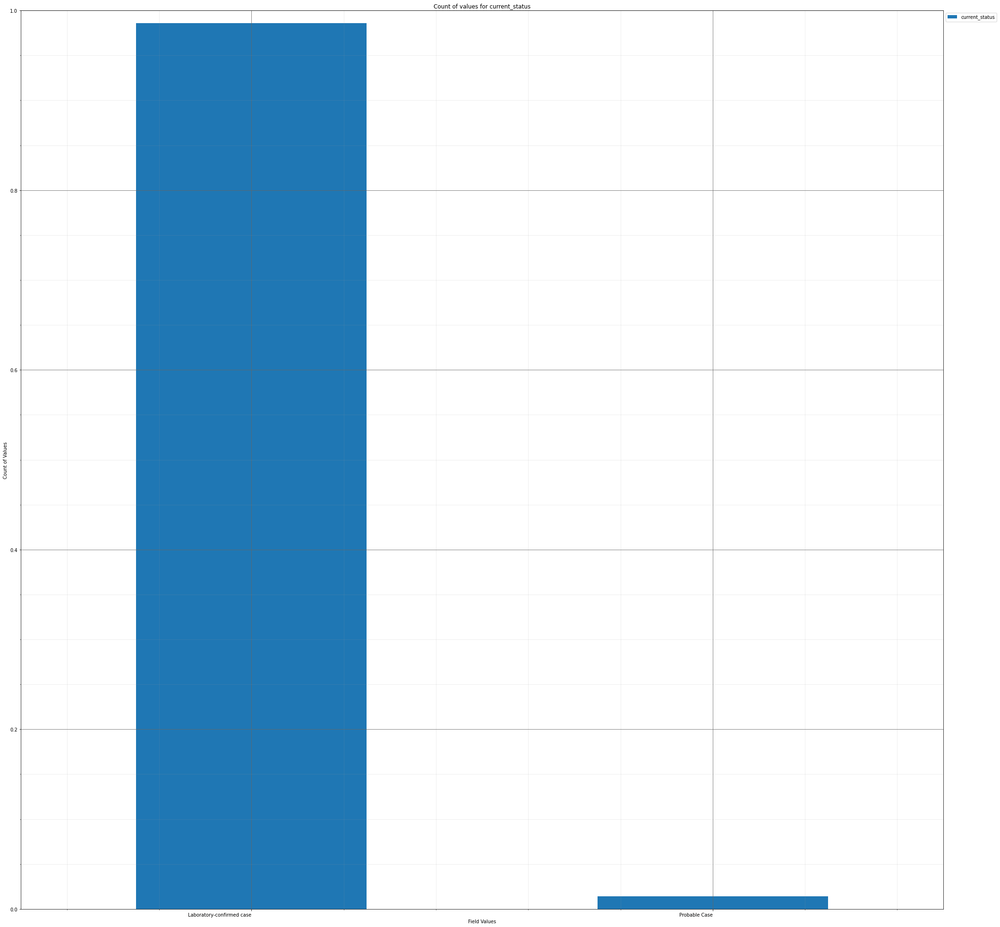



----------------------


         cdc_case_earliest_dt
sex                          
Female                    242
Male                      187
Missing                     0
Unknown                     2
Grouping over sex results in:



,sex,Rows,% Frequency
0,Female,242,56.148492
1,Male,187,43.387471
2,Missing,0,0.000000
3,Unknown,2,0.464037


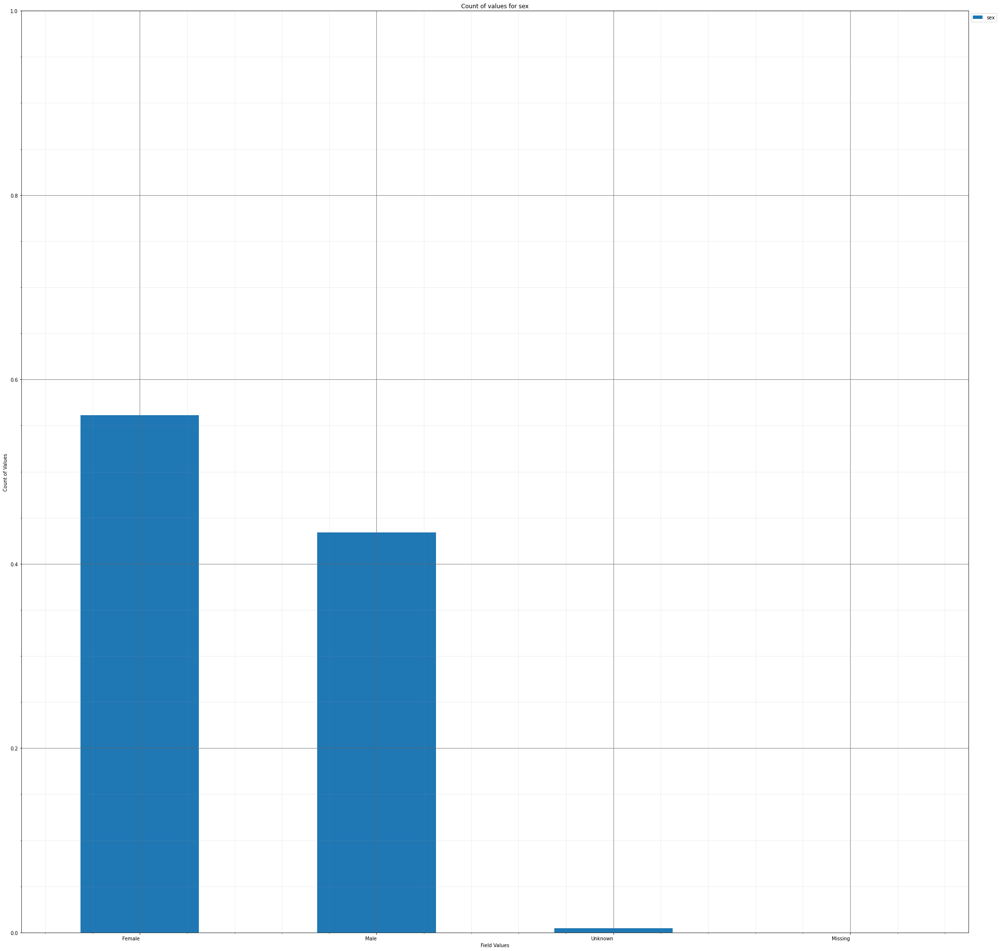



----------------------


               cdc_case_earliest_dt
age_group                          
0 - 9 Years                      10
10 - 19 Years                    52
20 - 29 Years                   106
30 - 39 Years                   106
40 - 49 Years                    74
50 - 59 Years                    46
60 - 69 Years                    28
70 - 79 Years                     6
80+ Years                         3
Missing                           0
Grouping over age_group results in:



,age_group,Rows,% Frequency
0,0 - 9 Years,10,2.320186
1,10 - 19 Years,52,12.064965
2,20 - 29 Years,106,24.593968
3,30 - 39 Years,106,24.593968
4,40 - 49 Years,74,17.169374
5,50 - 59 Years,46,10.672854
6,60 - 69 Years,28,6.496520
7,70 - 79 Years,6,1.392111
8,80+ Years,3,0.696056
9,Missing,0,0.000000


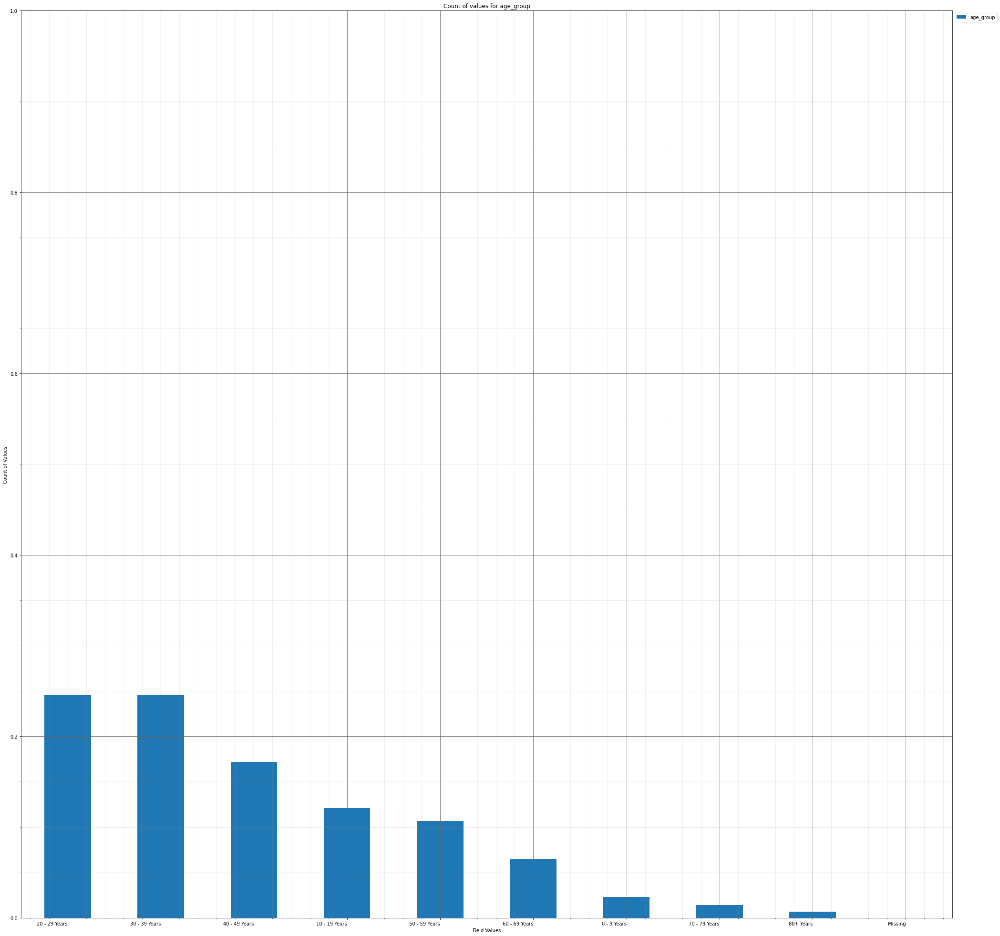



----------------------


                                                    cdc_case_earliest_dt
race_ethnicity_combined                                                 
American Indian/Alaska Native, Non-Hispanic                            0
Asian, Non-Hispanic                                                    1
Black, Non-Hispanic                                                    1
Hispanic/Latino                                                        0
Missing                                                                0
Multiple/Other, Non-Hispanic                                           8
Native Hawaiian/Other Pacific Islander, Non-His...                     0
Unknown                                                              387
White, Non-Hispanic                                                   34
Grouping over race_ethnicity_combined results in:



,race_ethnicity_combined,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",0,0.000000
1,"Asian, Non-Hispanic",1,0.232019
2,"Black, Non-Hispanic",1,0.232019
3,Hispanic/Latino,0,0.000000
4,Missing,0,0.000000
5,"Multiple/Other, Non-Hispanic",8,1.856148
6,"Native Hawaiian/Other Pacific Islander, Non-Hi...",0,0.000000
7,Unknown,387,89.791183
8,"White, Non-Hispanic",34,7.888631


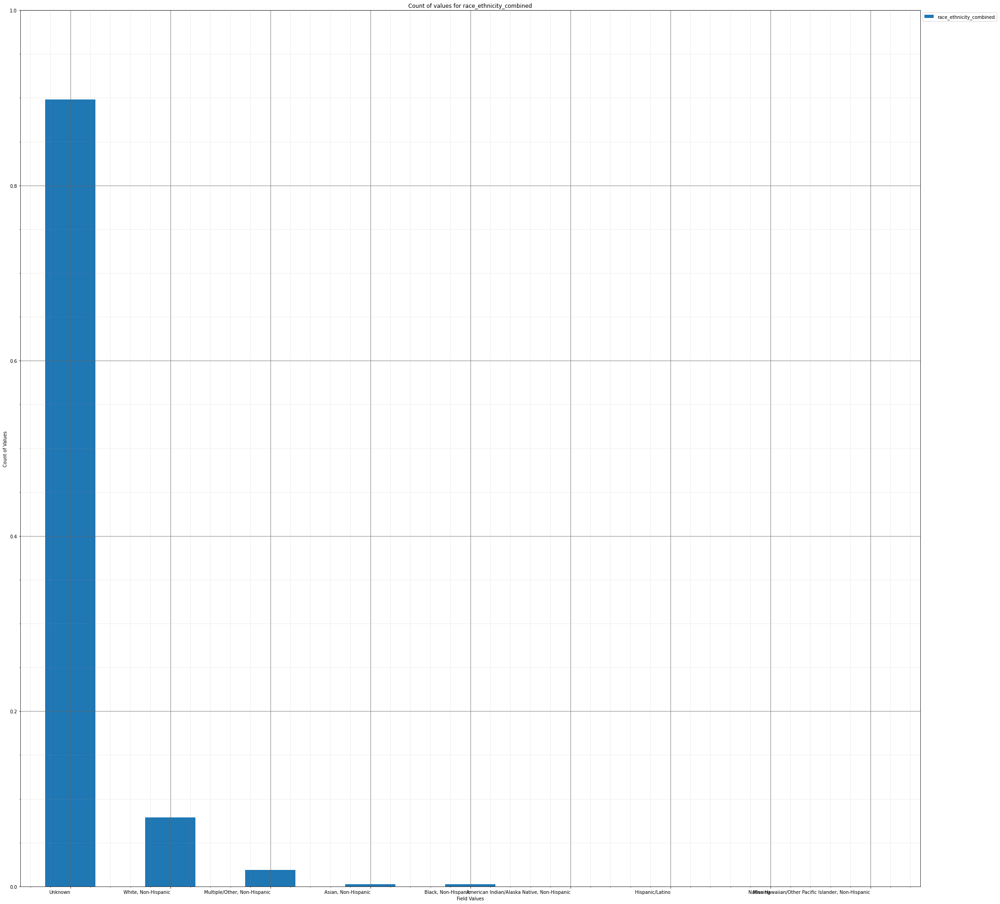



----------------------


         cdc_case_earliest_dt
hosp_yn                      
Missing                   221
No                         77
OTH                         0
Unknown                   133
Yes                         0
Grouping over hosp_yn results in:



,hosp_yn,Rows,% Frequency
0,Missing,221,51.276102
1,No,77,17.865429
2,OTH,0,0.000000
3,Unknown,133,30.858469
4,Yes,0,0.000000


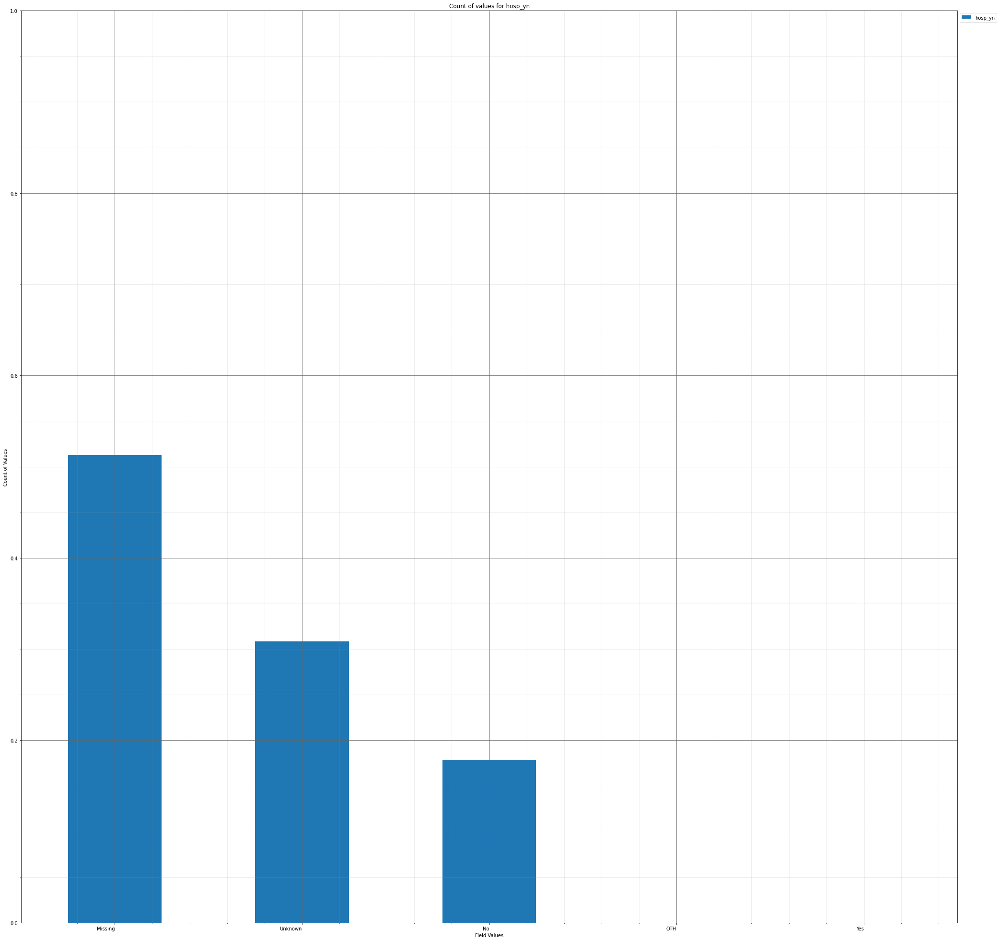



----------------------


         cdc_case_earliest_dt
icu_yn                       
Missing                   418
No                          0
Unknown                    13
Yes                         0
Grouping over icu_yn results in:



,icu_yn,Rows,% Frequency
0,Missing,418,96.983759
1,No,0,0.000000
2,Unknown,13,3.016241
3,Yes,0,0.000000


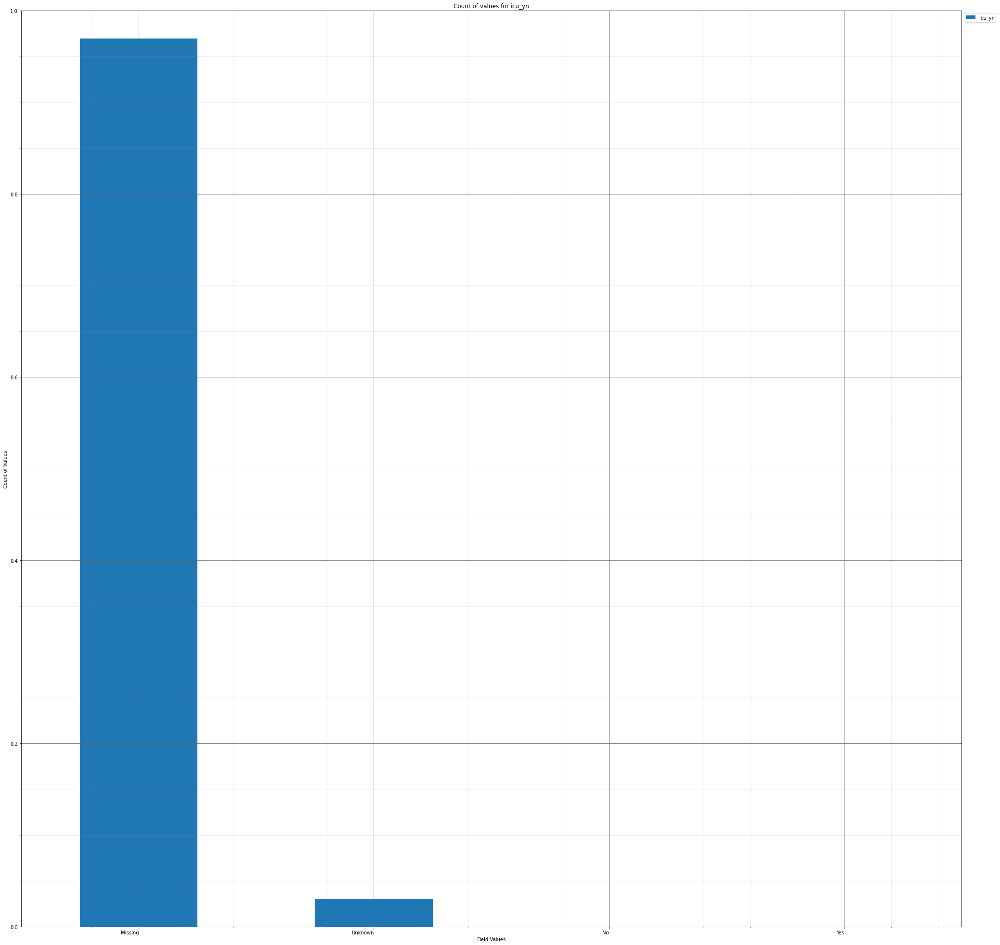



----------------------


          cdc_case_earliest_dt
death_yn                      
No                         431
Yes                          0
Grouping over death_yn results in:



,death_yn,Rows,% Frequency
0,No,431,100.0
1,Yes,0,0.0


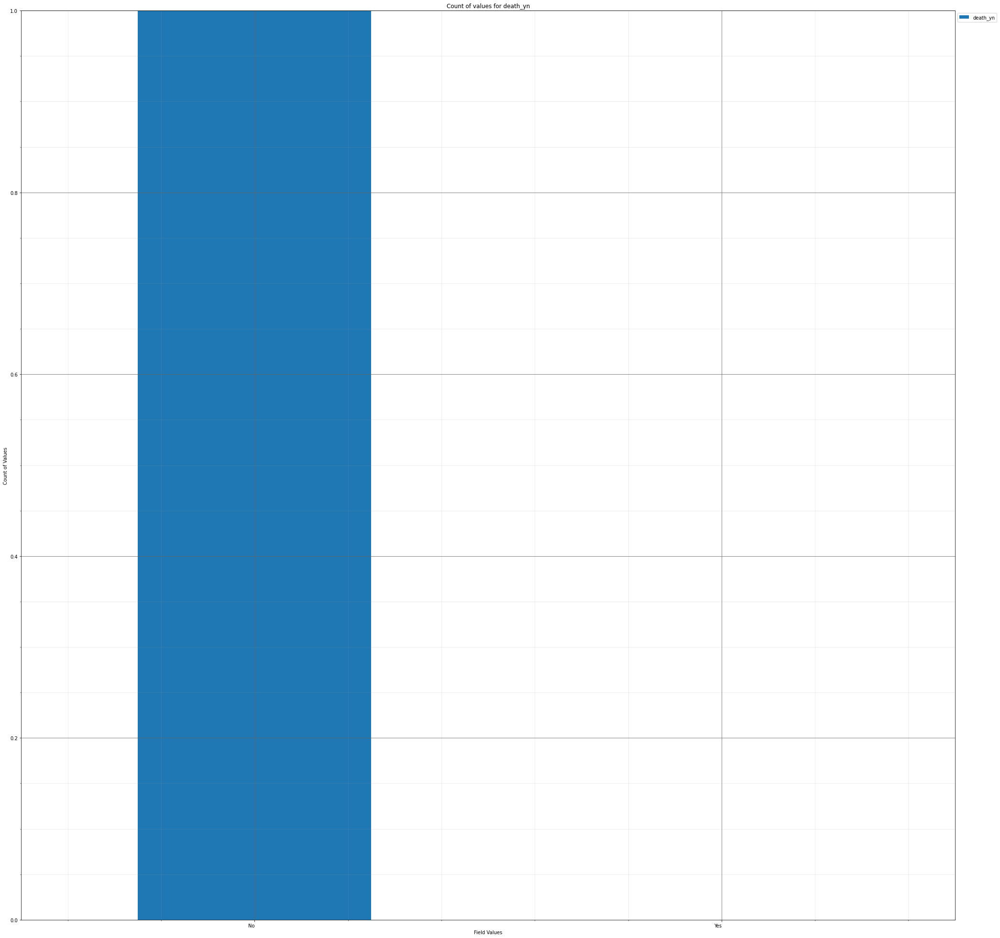



----------------------


            cdc_case_earliest_dt
medcond_yn                      
Missing                      418
No                             1
Unknown                       11
Yes                            1
Grouping over medcond_yn results in:



,medcond_yn,Rows,% Frequency
0,Missing,418,96.983759
1,No,1,0.232019
2,Unknown,11,2.552204
3,Yes,1,0.232019


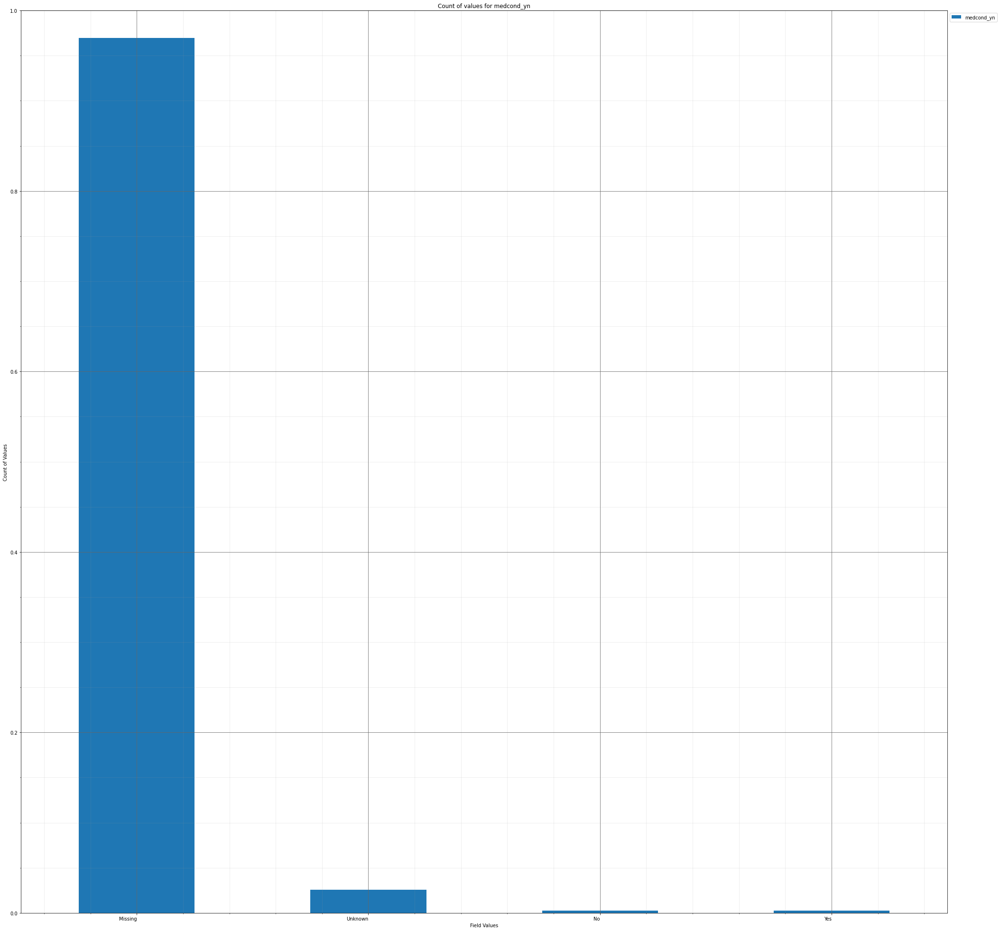

In [26]:
print('{} Duplicated Rows\n'.format(staging_covid_sample_data_df.duplicated().sum()))
display(staging_covid_sample_data_df[staging_covid_sample_data_df.duplicated()])

print("-----")
print("Investigating Cause")
print("-----")
single_frequency_dict=group_over_single_categories(staging_covid_sample_data_df[staging_covid_sample_data_df.duplicated()],categorical_columns,save_fig=False,pdf_fn=dupe_single_categorical_barplot_initial_fn)

#### 1.3.4.2.6 Investigating ICU Admission Without Hospital Admission

In [27]:
staging_covid_sample_data_df[(staging_covid_sample_data_df['hosp_yn']!='Yes')&(staging_covid_sample_data_df['icu_yn']=='Yes')]

,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
2655,2020-07-24,2020-07-25,2020-07-24,NaT,Laboratory-confirmed case,Female,80+ Years,"White, Non-Hispanic",No,Yes,No,Yes,2020-07-24,True


#### 1.3.4.2.7 Investigating Probable Cases with Details

In [28]:
print("Probable and Positive: {}".format(len(staging_covid_sample_data_df[(staging_covid_sample_data_df['current_status'] == 'Probable Case') 
               & ((staging_covid_sample_data_df["pos_spec_dt"].notna()))])))
display(staging_covid_sample_data_df[(staging_covid_sample_data_df['current_status'] == 'Probable Case') 
               & ((staging_covid_sample_data_df["pos_spec_dt"].notna()))])




print("Hospital or Positive: {}".format(len(staging_covid_sample_data_df[(staging_covid_sample_data_df['current_status'] == 'Probable Case') 
               & ((staging_covid_sample_data_df["pos_spec_dt"].notna())| (staging_covid_sample_data_df['hosp_yn']=='Yes'))])))
display(staging_covid_sample_data_df[(staging_covid_sample_data_df['current_status'] == 'Probable Case') 
               & ((staging_covid_sample_data_df["pos_spec_dt"].notna())| (staging_covid_sample_data_df['hosp_yn']=='Yes'))])

Probable and Positive: 227


,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
121,2020-08-04,2021-01-25,2020-08-04,NaT,Probable Case,Male,40 - 49 Years,Unknown,Missing,Missing,No,Missing,2020-08-04,True
125,2020-12-23,2020-12-23,2020-12-23,2020-12-23,Probable Case,Male,20 - 29 Years,"White, Non-Hispanic",No,Unknown,No,Unknown,2020-12-23,True
131,2020-10-05,2020-10-05,2020-10-09,2020-10-05,Probable Case,Female,20 - 29 Years,"White, Non-Hispanic",No,Unknown,No,Unknown,2020-10-05,True
134,2020-11-11,2020-11-11,2020-11-11,NaT,Probable Case,Male,30 - 39 Years,"White, Non-Hispanic",No,Unknown,No,No,2020-11-11,True
144,2020-05-14,2021-01-23,2020-05-14,NaT,Probable Case,Female,50 - 59 Years,Unknown,Missing,Missing,No,Missing,2020-05-14,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9827,2020-09-24,2020-09-24,2020-09-24,NaT,Probable Case,Female,0 - 9 Years,"White, Non-Hispanic",No,Unknown,No,No,2020-09-24,True
9836,2020-12-31,2020-12-31,2020-12-31,NaT,Probable Case,Female,20 - 29 Years,"White, Non-Hispanic",Unknown,Unknown,No,Unknown,2020-12-31,True
9910,2020-12-22,2021-01-12,2020-12-28,2020-12-22,Probable Case,Female,20 - 29 Years,"White, Non-Hispanic",Missing,Missing,No,No,2020-12-22,True
9951,2020-04-27,2021-01-21,2020-04-27,NaT,Probable Case,Male,70 - 79 Years,Unknown,Missing,Missing,No,Missing,2020-04-27,True


Hospital or Positive: 248


,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
65,2020-03-15,2020-04-30,NaT,NaT,Probable Case,Male,80+ Years,"Asian, Non-Hispanic",Yes,Unknown,Yes,Yes,2020-04-30,False
84,2020-10-11,2020-11-12,NaT,2020-10-11,Probable Case,Female,70 - 79 Years,"White, Non-Hispanic",Yes,Missing,No,Missing,2020-10-11,True
121,2020-08-04,2021-01-25,2020-08-04,NaT,Probable Case,Male,40 - 49 Years,Unknown,Missing,Missing,No,Missing,2020-08-04,True
125,2020-12-23,2020-12-23,2020-12-23,2020-12-23,Probable Case,Male,20 - 29 Years,"White, Non-Hispanic",No,Unknown,No,Unknown,2020-12-23,True
131,2020-10-05,2020-10-05,2020-10-09,2020-10-05,Probable Case,Female,20 - 29 Years,"White, Non-Hispanic",No,Unknown,No,Unknown,2020-10-05,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9827,2020-09-24,2020-09-24,2020-09-24,NaT,Probable Case,Female,0 - 9 Years,"White, Non-Hispanic",No,Unknown,No,No,2020-09-24,True
9836,2020-12-31,2020-12-31,2020-12-31,NaT,Probable Case,Female,20 - 29 Years,"White, Non-Hispanic",Unknown,Unknown,No,Unknown,2020-12-31,True
9910,2020-12-22,2021-01-12,2020-12-28,2020-12-22,Probable Case,Female,20 - 29 Years,"White, Non-Hispanic",Missing,Missing,No,No,2020-12-22,True
9951,2020-04-27,2021-01-21,2020-04-27,NaT,Probable Case,Male,70 - 79 Years,Unknown,Missing,Missing,No,Missing,2020-04-27,True


#### 1.3.4.2.8 Investigating Missing ICU Proportion

In [29]:
age_df=single_frequency_dict['age_group']
icu_age_df=pair_frequency_dict['icu_yn|age_group']
icu_df=icu_age_df.merge(age_df, left_on='age_group', right_on='age_group', suffixes=('_pair', '_age'))

In [30]:
icu_df['% of Total Age']=(icu_df['Rows_pair']/icu_df['Rows_age'])*100

In [31]:
display(icu_df[icu_df['icu_yn'].isin(['Missing'])])
#Note: More likely to be missing for younger
display(icu_df[icu_df['icu_yn'].isin(['No'])])
#Note: More likely No for Older - Suggests flagged for older!!!

,icu_yn,age_group,Rows_pair,% Frequency_pair,Rows_age,% Frequency_age,% of Total Age
0,Missing,0 - 9 Years,383,3.83,10,2.320186,3830.000000
4,Missing,10 - 19 Years,830,8.30,52,12.064965,1596.153846
8,Missing,20 - 29 Years,1437,14.37,106,24.593968,1355.660377
12,Missing,30 - 39 Years,1271,12.71,106,24.593968,1199.056604
16,Missing,40 - 49 Years,1171,11.71,74,17.169374,1582.432432
20,Missing,50 - 59 Years,1067,10.67,46,10.672854,2319.565217
24,Missing,60 - 69 Years,761,7.61,28,6.496520,2717.857143
28,Missing,70 - 79 Years,435,4.35,6,1.392111,7250.000000
32,Missing,80+ Years,294,2.94,3,0.696056,9800.000000
36,Missing,Missing,13,0.13,0,0.000000,inf


,icu_yn,age_group,Rows_pair,% Frequency_pair,Rows_age,% Frequency_age,% of Total Age
1,No,0 - 9 Years,32,0.32,10,2.320186,320.000000
5,No,10 - 19 Years,116,1.16,52,12.064965,223.076923
9,No,20 - 29 Years,168,1.68,106,24.593968,158.490566
13,No,30 - 39 Years,164,1.64,106,24.593968,154.716981
17,No,40 - 49 Years,120,1.20,74,17.169374,162.162162
21,No,50 - 59 Years,140,1.40,46,10.672854,304.347826
25,No,60 - 69 Years,103,1.03,28,6.496520,367.857143
29,No,70 - 79 Years,69,0.69,6,1.392111,1150.000000
33,No,80+ Years,46,0.46,3,0.696056,1533.333333
37,No,Missing,0,0.00,0,0.000000,NaN


### 1.3.5. Data Quality Report – Initial - Pre-Alteration.


#### 0. Background

COVID-19 is an infectious disease caused by SARS-CoV-2, a coronavirus strain discovered in December 2019 first identified following an outbreak in the Chinese city Wuhan, with the WHO declaring the outbreak a global pandemic in March 2020.

Since its discovery, health organisations have been actively gathering data to assess aspects of the disease including infectivity, symptoms, and mortality rate. Active interest has been paid to factors which may increase a patient's risk of serious symptons or death.

In this analysis, we focus on using the data collected by CDC to build an analytics solution for predicting a patients' death risk prediction. CDC collects demographic characteristics, exposure history, disease severity indicators and outcomes, clinical data, laboratory diagnostic test results, and comorbidities. It also includes information on whether the individual survived or not.

#### 1. Overview
This report will outline the initial findings based on the provided sample of the CDC dataset. It will summarise the data, describe the various data quality issues observed and how they will be addressed. 

Appendix includes terminology, assumptions, explanations and summary of changes made to the original dataset. This also includes feature summaries and boxplots used to visualise the data.

#### 2. Summary
The following are the key points in relation to the data set and approach:

* The dataset lacks a primary key.

* The dataset lacks a patient identifier so we cannot look for readmitted patients.

* The dataset consists of 10,000 rows and 12 (non-repeated) columns.
    * 4 features are datetime features formatted as YYYY/MM/DD.
    * 3 of these are demographic
    * 4 are booleans with additional values
    * 1 is a diagnosis classifier
    * All features are categorical in nature, however there is scope for the addition of featuers.

* While null values are largely absent from the dataset, there are high proportions of values flagged as 'missing' and 'unknown', with some features containing both missing and unknown values. The distinction between missing and unknown should be confirmed with a source knowledgeable on the data set, however the author's initial recommendation is that these features would be likely targets for imputation mapping both features to a single 'unknown' value.

* The datetime columns are most heavily affected by null or missing values. The author notes that the cdc data dictionary highlights the depreciation of the cdc_report_dt column and points to the usage of cdc_case_earliest_dt in its place. Following this, the author recommends removing the now depreciated cdc_report_dt column.
    * 515 rows feature a cdc_case_earliest_dt date which does not match the minimum of the other datetime columns as implied in the cdc data dictionary. These instances should be checked with a domain expert to understand the source of these dates and if they are valid. The author suggests including these until later revision.

* The volume of duplicate rows is low at 431 rows (4.3%). Investigation into the cause of duplicates highlights sparse population of data, or common data population, is the primary cause of duplicates (e.g. racial info is missing in 90% of duplicate instances, with icu and medical condition info missing in over 95% of duplicate instances. Although these instances are likely 'valid', the recommendation is to drop these duplicate instances as the high prevalence of missing information is unlikely to provide useful information into our model.

* The features prevalent are good targets for conversion to a 'category' datatype with limited valid values prevelant across all category features.

* There is one record where there is an icu admission flagged but not a hospital admission. This record should be removed due to inconsistency in the data and low impact on overall set.

* The current_status column contains 93% Laboratory confirmed cases. It should be identified with a domain expert as to whether the probable cases must be considered. If the probable cases can be dropped, the recommendation is to remoe the probable cases and remove this feature however this will be included in further components of the analysis.

#### 3. Logical Integrity

As the dataset has a heavy focus on categorical data, the following tests were carried out to asses the integrity of the dataset

* T1: Check if there are cdc_case_earliest_dt's which are not the earliest of the other dates
    *Result: 2857 (29%) Records which are not the earliest
    *Result: 515 (5%) Records which are not the earliest where not all of the other dates are populated
        *Query: Where does this data come from?

* T2: Check if there are ICU admissions without hospital admissions.
    *Result: 1 Record which should be updated
    
* T3: Check if there are probable cases with a confirmed positive specimen
    *Result: 227 Record which should be updated to laboratory confirmed
    *Result: 248 Records when hospital admission is also true.
    

#### 4. Non-Datetime Categorical Features
There are 8 non-categorical features in the dataset:

* F1: current_status - A feature to flag if the case is confirmed via lab or suspected.
        * Null: Not applicable.
        * Top Value: Laboratory Confirmed Case - 93% of rows.
        * Unique Values: 2
        * Overall data is reasonable. Actionable item to update probable cases where there is a positive lab specimen.

* F2: sex - A feature to flag the patients' sex.
        * Null: Not applicable.
        * Top Value: Female 53%
        * Unique Values: 4
        * Should be updated to combine unknown values

* F3: age_group - A feature to flag the patients' age group.
        * Null: Not applicable.
        * Top Value: 20-29 Years 18%
        * Unique Values: 10
        * 14 records have an unknown age grouping.

* F4: race_ethnicity_combined - A feature to flag the patients' ethnicity.
        * Null: Not applicable.
        * Top Value: Unknown 41%
        * Unique Values: 10
        * 41% unknown values.
        * Contatenated field with comma separated values. Separation denotes Hispanic or not. This info is already captured via the racial component.


* F5: hosp_yn - A feature to flag if the patient was hospitalised.
        * Null: Not applicable.
        * Top Value: No 52%
        * Unique Values: 5
        * Missing and unknown two separate values. OTH present in one record.
        
* F6: icu_yn - A feature to flag if the patient was admitted to ICU
        * Null: Not applicable.
        * Top Value: Missing 77%
        * Unique Values: 4
        * Check with domain expecrt on missing % reason. P
        
* F7: medcond_yn - A feature to flag if the patient had comorbidities.
        * Null: Not applicable.
        * Top Value: Missing 75%
        * Unique Values: 4
        * 82% unknown and missing values.
  
* **Target Feature**: death_yn - A feature to flag if the patient died.
        * Populated. 3% are yes.
        
#### 5 Datetime Categorical Features
There are 4 categorical datetime features in the dataset:

* D1: cdc_case_earliest_dt - A feature to flag if the case is confirmed via lab or suspected.
        * Null: Not applicable.
        * Top Value: Laboratory Confirmed Case - 93% of rows.
        * Unique Values: 2
        * Overall data is reasonable. Actionable item to update probable cases where there is a positive lab specimen.
        *Covers 325 2nd January 2020 to 16th January 2021 (missing days present) 

* D2: cdc_report_dt - A depreciated column. CDC recommendation is to drop for D1.
        * Should be dropped due to depreciation.

* D3: pos_spec_dt - First positive specimen collected
        * Null: Yes 72% missing
        * Rec: Use to update Status and drop as missing percentage too high.

* D4: onset_dt - Date of symptom onset
        * Null: Yes 49% missing.
        * Top Value: Unknown 41%
        * Unique Values: 326
        * 41% unknown values.
        * Keep for determining time between reporting and symptom onset.
        *Covers 2nd January 2020 to 28th January 2021. 


#### 6 BoxPlots
BoxPlots were produced for all categorical data. These are present in the appendix due to the size of the file. All pairs of data and single value info was calculated as an initial exploration.
    
### 8. Note: 
The steps provided in the assignment outline more of a linearisation in the process, however upon reviewing the data I did not believe the outlined processed was particularly suitable for this dataset. 

In particular, the processing steps outlined suggest the removal of duplicate values prior to data exploration. As I did not beleive the records were, in fact, duplicates but instead were driven by other elements, it was more reasonable to explore the relationships between various factors before taking any steps to drop rows with overlap, in order to better understand why.

Similarly, the steps provided suggest not adding columns until the final section. Due to the nature of the data and the variety of missing values within some of the indicator and date columns, it seemed to me that valuable information could be obtained based on my initial exploration before any final removal occurs. In particular, the onset datetime column looks to have key value in relation to the asymptomatic prevalence of COVID and the time between initial presentation and symptom onset date. Therefore, adjusting the nature of this column and adding on attributes which reflected the data that was in the original column while preserving and enhancing the data set was logical as an approach before simply dropping this feature for missing prevalency. Similarly, the race column contains race and ethnicity combined however this can be replaced with the racial info as that alone is sufficient to capture the concatenated nature of this. While there may be a need from a reporting purpose in the CDC to compare Hispanic vs Non-Hispanics demographics, reducing the memory usage of the field by stripping the redundant info still allows recovery if this would be insightful.

Due to all of the above, the data quality plan and data quality actioning were, in a sense, completed as a joint process as proper cleansing of the set did not allow for a full linearisation of this process. This steps is detailed below.

### 2 Data Quality Plan

Based on the initial insights, the following is the data quality plan. Full details on reasoning have been already outlined in the data quality report.

A key note is the author wishes to avoid dropping data as an intermediate step unless necessary or directly contradictory data. Acquisition cost of data is too significant to justify dropping data until a step just prior to usage in ML models as retrieval can be challenging. As such, data is being imputed into missing values in general.

In [32]:
data_action_dictionary={
                          'cdc_case_earliest_dt':
                                {
                                "Data Quality Issues": "515 Rows where not minimum of other dates populated"
                                ,"Data Quality Actions": "Confirm reason. Otherwise leave as-is"
                                }
                         
                            ,'cdc_report_dt':                                
                                {
                                "Data Quality Issues": "Depreciated"
                                ,"Data Quality Actions":"Drop"
                                }
                         
                            ,'pos_spec_dt':
                                {
                                "Data Quality Issues":"72% of data missing"
                                ,"Data Quality Actions":"Drop after using for status correction"
                                }
                         

                            ,'onset_dt':
                                {
                                "Data Quality Issues":"49% of Data Missing. <1% of dates where onset_dt is too far after case date."
                                ,"Data Quality Actions":"Split into days since symptom. Flag missing data. Drop column. Statistically relevant. Enquire on why some values are so extreme after earliest date"
                                }
                         

                            ,'current_status':
    
                                {
                                "Data Quality Issues": "Probable Cases that should be Laboratory Confirmed Cases"
                                ,"Data Quality Actions":"Update instances"
                                }
                         
    
                            ,'sex':
                                {
                                "Data Quality Issues": "Missing and Unknown flags"
                                ,"Data Quality Actions": "Bin into Unknown category"
                                }
                         

                            ,'age_group':
                                {
                                "Data Quality Issues": "Missing and Unknown flags"
                                ,"Data Quality Actions":"Bin into groups"
                                }
                         
                          ,'race_ethnicity_combined':
                                {
                                "Data Quality Issues":"Concatenated field. Race sufficient to capture all info."
                                ,"Data Quality Actions":"Split field and drop ethnicity"
                                }
                         
                         
                          ,'hosp_yn':
                                {
                                "Data Quality Issues":"Missing, Unknown, and OTH values"
                                ,"Data Quality Actions":"Bin unknown into groups"
                                }
                         
    
                         ,'icu_yn':
                                {
                                "Data Quality Issues":"Missing data 72%."
                                ,"Data Quality Actions":"Determine if missing because 'no'. Column is relevant so await answer before dropping"
                                }
                         
    
                         ,'death_yn':
                                {
                                "Data Quality Issues":"Not applicable"
                                ,"Data Quality Actions":"No action"
                                }
                         
    
                         ,'medcond_yn':
                                    {
                                "Data Quality Issues":"80% missing"
                                ,"Data Quality Actions":"Grouping missing consistently. Column is relevant so keep until answer on cause of missing values"
                                }
                         
                }

In [33]:
action_df=pd.DataFrame(data_action_dictionary)
action_df.T.to_csv('DataQualityPlan_{}.csv'.format(student_no))
action_df.T

,Data Quality Issues,Data Quality Actions
cdc_case_earliest_dt,515 Rows where not minimum of other dates popu...,Confirm reason. Otherwise leave as-is
cdc_report_dt,Depreciated,Drop
pos_spec_dt,72% of data missing,Drop after using for status correction
onset_dt,49% of Data Missing. <1% of dates where onset_...,Split into days since symptom. Flag missing da...
current_status,Probable Cases that should be Laboratory Confi...,Update instances
sex,Missing and Unknown flags,Bin into Unknown category
age_group,Missing and Unknown flags,Bin into groups
race_ethnicity_combined,Concatenated field. Race sufficient to capture...,Split field and drop ethnicity
hosp_yn,"Missing, Unknown, and OTH values",Bin unknown into groups
icu_yn,Missing data 72%.,Determine if missing because 'no'. Column is r...


Across all columns and the dataset, due to the determination that duplicates are primarily from generic and missing values, data will be removed as these rows are unlikely to be of value to the final model and thus will be dropped. Missing values will be consistently categorised into 'unknown'.

In [34]:
#Action elements in the initial report

In [35]:
staging_covid_sample_data_df=staging_covid_sample_data_df.drop_duplicates()
display(staging_covid_sample_data_df)
new_shape=staging_covid_sample_data_df.shape
new_row_count=new_shape[0]
print()
print("There are {} duplicates.".format(staging_covid_sample_data_df.duplicated().sum()))

,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn,min_clinical_cdc_dt,cdc_case_earliest_dt_validator
0,2020-09-30,2021-01-27,2020-09-30,NaT,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Missing,Missing,No,Missing,2020-09-30,True
1,2020-04-16,NaT,NaT,NaT,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Missing,Missing,No,Missing,NaT,False
2,2020-09-22,2020-10-01,NaT,2020-09-22,Laboratory-confirmed case,Female,10 - 19 Years,"White, Non-Hispanic",No,No,No,No,2020-09-22,True
3,2020-10-30,2021-01-22,NaT,2020-10-30,Laboratory-confirmed case,Female,60 - 69 Years,"Multiple/Other, Non-Hispanic",No,Missing,No,Missing,2020-10-30,True
4,2020-12-17,2020-12-17,NaT,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Missing,Missing,No,Missing,2020-12-17,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9994,2021-01-14,NaT,NaT,NaT,Laboratory-confirmed case,Female,80+ Years,"Multiple/Other, Non-Hispanic",No,Missing,No,Missing,NaT,False
9995,2020-09-24,2020-10-03,NaT,2020-09-24,Laboratory-confirmed case,Female,30 - 39 Years,Hispanic/Latino,No,Missing,No,Missing,2020-09-24,True
9997,2020-08-27,2020-08-28,NaT,2020-08-28,Laboratory-confirmed case,Female,10 - 19 Years,Unknown,No,Missing,No,Missing,2020-08-28,False
9998,2021-01-04,NaT,NaT,NaT,Laboratory-confirmed case,Unknown,30 - 39 Years,Unknown,Missing,Missing,No,Missing,NaT,False



There are 0 duplicates.


### 1.3.6 Save as CSV File.

Note: Saving to CSV due to requirements however saving to pickle as the 'right' way to save a dataframe. Saving to a csv file means you have to reassign attributes on subsequent loads. Pickled files are designed to save that info.

In [36]:
staging_covid_sample_data_df=staging_covid_sample_data_df[['cdc_case_earliest_dt', 'cdc_report_dt', 'pos_spec_dt', 'onset_dt',
       'current_status', 'sex', 'age_group', 'race_ethnicity_combined',
       'hosp_yn', 'icu_yn', 'death_yn', 'medcond_yn']]

staging_covid_sample_data_df.to_csv(staging_filepath, index_label=False)
try:
    staging_covid_sample_data_df[['cdc_case_earliest_dt', 'cdc_report_dt', 'pos_spec_dt', 'onset_dt',
       'current_status', 'sex', 'age_group', 'race_ethnicity_combined',
       'hosp_yn', 'icu_yn', 'death_yn', 'medcond_yn']].to_pickle(staging_filepath[:-3]+'pickle')
except:
    print('You need to install the pickle module appropriately.')

## 2.1 Read Cleansed File

In [37]:
#Read Pickle
try:
    deduped_covid_sample_df=pd.read_pickle(staging_filepath[:-3]+'pickle')

#You don't have pickle available 
except:
    deduped_covid_sample_df=ingest_orig_covid_data(staging_filepath,data_dictionary_per_cdc)
    data_convert(deduped_covid_sample_df,'datetime',datetime_columns,datetime_format)
    data_convert(deduped_covid_sample_df,'category',categorical_columns,datetime_format)
    data_convert(deduped_covid_sample_df,'numeric',num_columns,datetime_format)

In [38]:
deduped_covid_sample_df
dd_row_count=deduped_covid_sample_df.shape[0]

## 2.2 Rerun Descriptive Stats and Graph

In [39]:
#Format Dictionary:
non_numeric_format_dictionary={
                              '% Populated': "{:.0f}%"
                              ,'% Missing': "{:.0f}%"
                                ,'% Top Value':"{:.0f}%"}





#Produce a summary table - Note the continuous features in this dataset are dates
#Note: As of now, pandas allows using describe with dates so keeping it in, but this will be depreciated
category_summary_df=deduped_covid_sample_df.describe().T

#Add what Percent is populated
category_summary_df['% Populated']=100*(category_summary_df['count']/dd_row_count)

#Percent missing
category_summary_df['% Missing']=100-category_summary_df['% Populated']

#Prevelance of top vlaue
category_summary_df['% Top Value']=100*(category_summary_df['freq']/dd_row_count)

#Give a warning depending on quartile of missing data - upper quartiles are high
category_summary_df['Missing Warning']=np.select([(category_summary_df['% Missing']==0),(category_summary_df['% Missing']>0) & (category_summary_df['% Missing']<25),(category_summary_df['% Missing']>=25) & (category_summary_df['% Missing']<50),category_summary_df['% Missing']>=50],['None','Low','Medium','High'])

category_summary_df=category_summary_df.reset_index()
category_summary_df=category_summary_df.rename(columns={"index": "feature"})


(category_summary_df.style.apply(missing_check, axis=1)
                                         .format(non_numeric_format_dictionary))

,feature,count,unique,top,freq,first,last,% Populated,% Missing,% Top Value,Missing Warning
0,cdc_case_earliest_dt,9569,325,2020-12-29 00:00:00,102,2020-01-02 00:00:00,2021-01-16 00:00:00,100%,0%,1%,None
1,cdc_report_dt,7567,323,2020-06-10 00:00:00,124,2020-01-20 00:00:00,2021-01-29 00:00:00,79%,21%,1%,Low
2,pos_spec_dt,2798,316,2020-11-09 00:00:00,36,2020-03-05 00:00:00,2021-01-23 00:00:00,29%,71%,0%,High
3,onset_dt,5036,326,2020-12-08 00:00:00,43,2020-01-02 00:00:00,2021-01-28 00:00:00,53%,47%,0%,Medium
4,current_status,9569,2,Laboratory-confirmed case,8905,NaT,NaT,100%,0%,93%,None
5,sex,9569,4,Female,5097,NaT,NaT,100%,0%,53%,None
6,age_group,9569,10,20 - 29 Years,1720,NaT,NaT,100%,0%,18%,None
7,race_ethnicity_combined,9569,9,Unknown,3684,NaT,NaT,100%,0%,38%,None
8,hosp_yn,9569,5,No,5172,NaT,NaT,100%,0%,54%,None
9,icu_yn,9569,4,Missing,7244,NaT,NaT,100%,0%,76%,None


## 2.2.2 Rerun Graphs and Pairing

Inside group_over_single_categories()


----------------------


                           cdc_case_earliest_dt
current_status                                 
Laboratory-confirmed case                  8905
Probable Case                               664
Grouping over current_status results in:



,current_status,Rows,% Frequency
0,Laboratory-confirmed case,8905,93.060926
1,Probable Case,664,6.939074


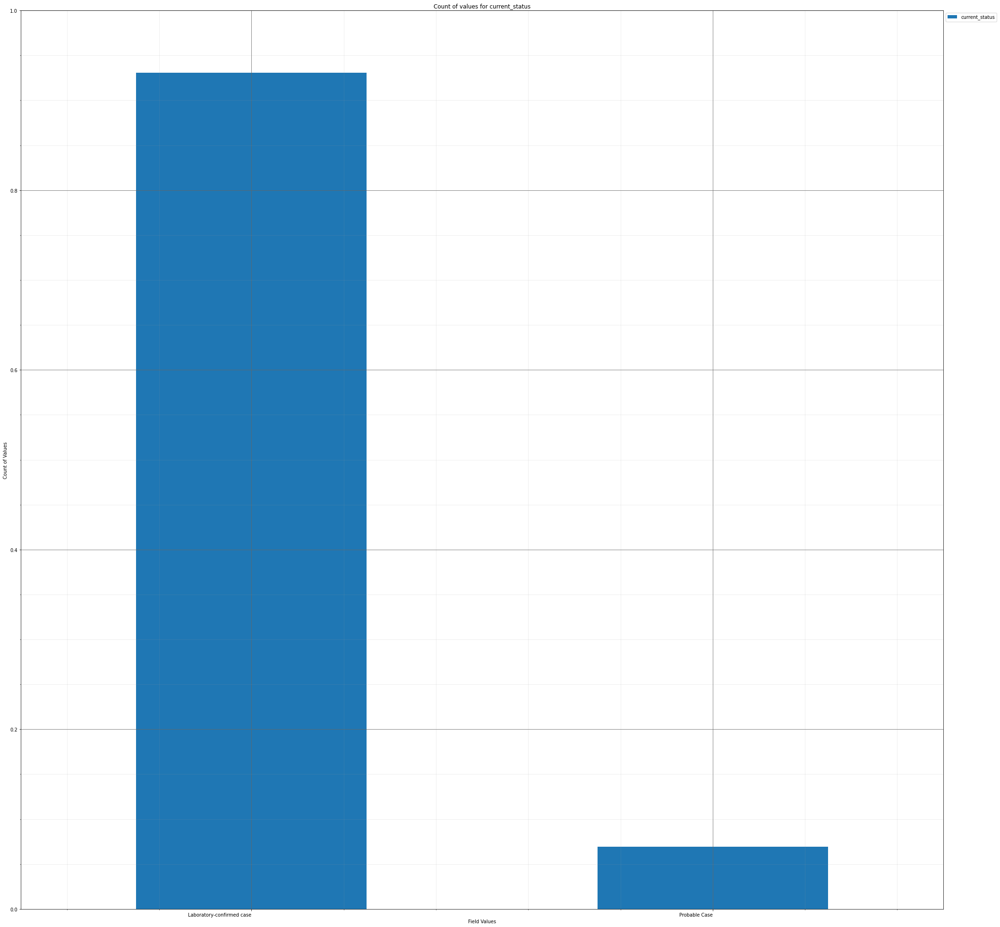



----------------------


         cdc_case_earliest_dt
sex                          
Female                   5097
Male                     4389
Missing                    13
Unknown                    70
Grouping over sex results in:



,sex,Rows,% Frequency
0,Female,5097,53.265754
1,Male,4389,45.866862
2,Missing,13,0.135855
3,Unknown,70,0.731529


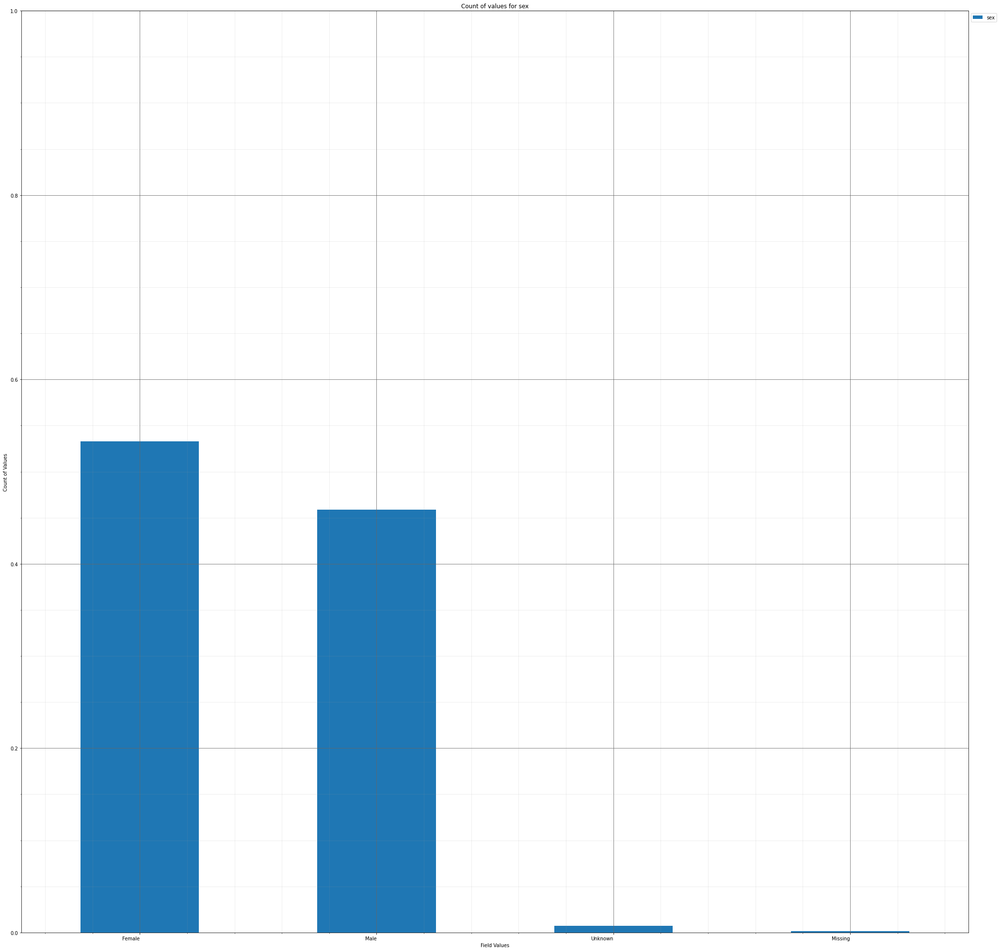



----------------------


               cdc_case_earliest_dt
age_group                          
0 - 9 Years                     458
10 - 19 Years                  1017
20 - 29 Years                  1720
30 - 39 Years                  1505
40 - 49 Years                  1398
50 - 59 Years                  1363
60 - 69 Years                  1019
70 - 79 Years                   616
80+ Years                       459
Missing                          14
Grouping over age_group results in:



,age_group,Rows,% Frequency
0,0 - 9 Years,458,4.786289
1,10 - 19 Years,1017,10.628070
2,20 - 29 Years,1720,17.974710
3,30 - 39 Years,1505,15.727871
4,40 - 49 Years,1398,14.609677
5,50 - 59 Years,1363,14.243913
6,60 - 69 Years,1019,10.648971
7,70 - 79 Years,616,6.437454
8,80+ Years,459,4.796739
9,Missing,14,0.146306


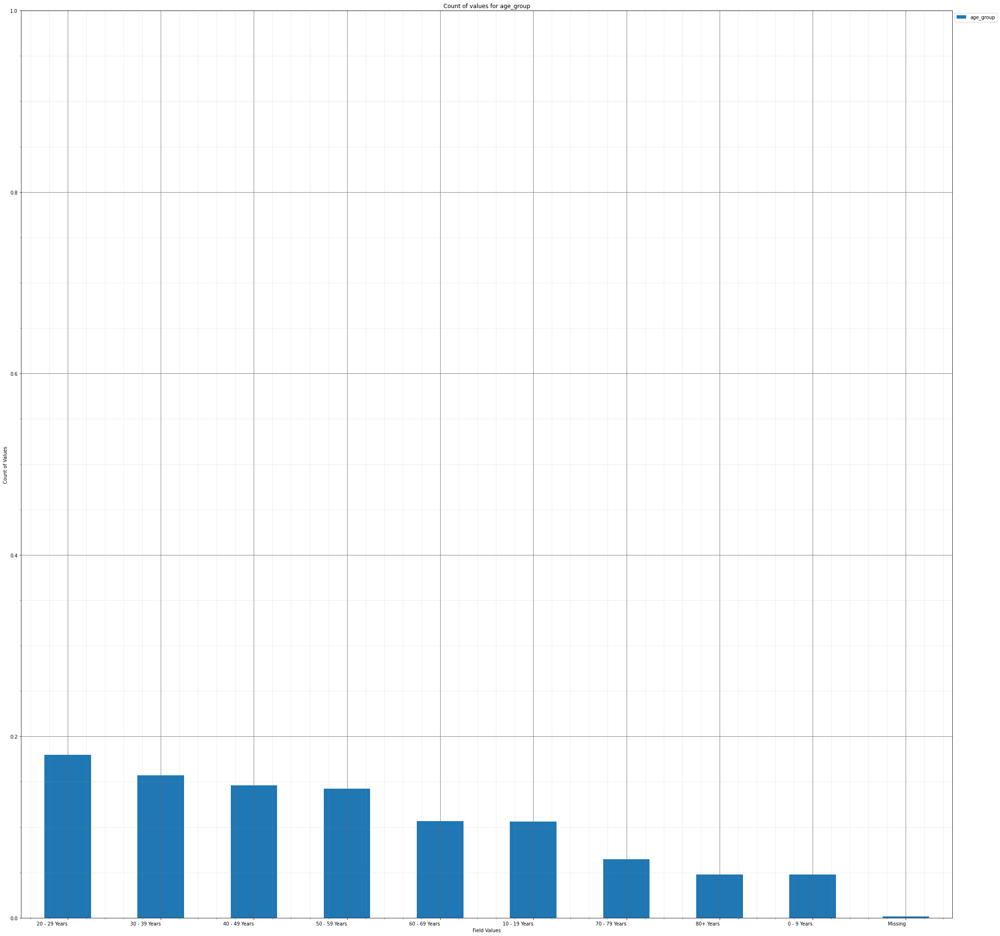



----------------------


                                                    cdc_case_earliest_dt
race_ethnicity_combined                                                 
American Indian/Alaska Native, Non-Hispanic                           66
Asian, Non-Hispanic                                                  241
Black, Non-Hispanic                                                  694
Hispanic/Latino                                                      929
Missing                                                              109
Multiple/Other, Non-Hispanic                                         510
Native Hawaiian/Other Pacific Islander, Non-His...                    23
Unknown                                                             3684
White, Non-Hispanic                                                 3313
Grouping over race_ethnicity_combined results in:



,race_ethnicity_combined,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",66,0.689727
1,"Asian, Non-Hispanic",241,2.518549
2,"Black, Non-Hispanic",694,7.252586
3,Hispanic/Latino,929,9.708433
4,Missing,109,1.139095
5,"Multiple/Other, Non-Hispanic",510,5.329711
6,"Native Hawaiian/Other Pacific Islander, Non-Hi...",23,0.240359
7,Unknown,3684,38.499321
8,"White, Non-Hispanic",3313,34.622218


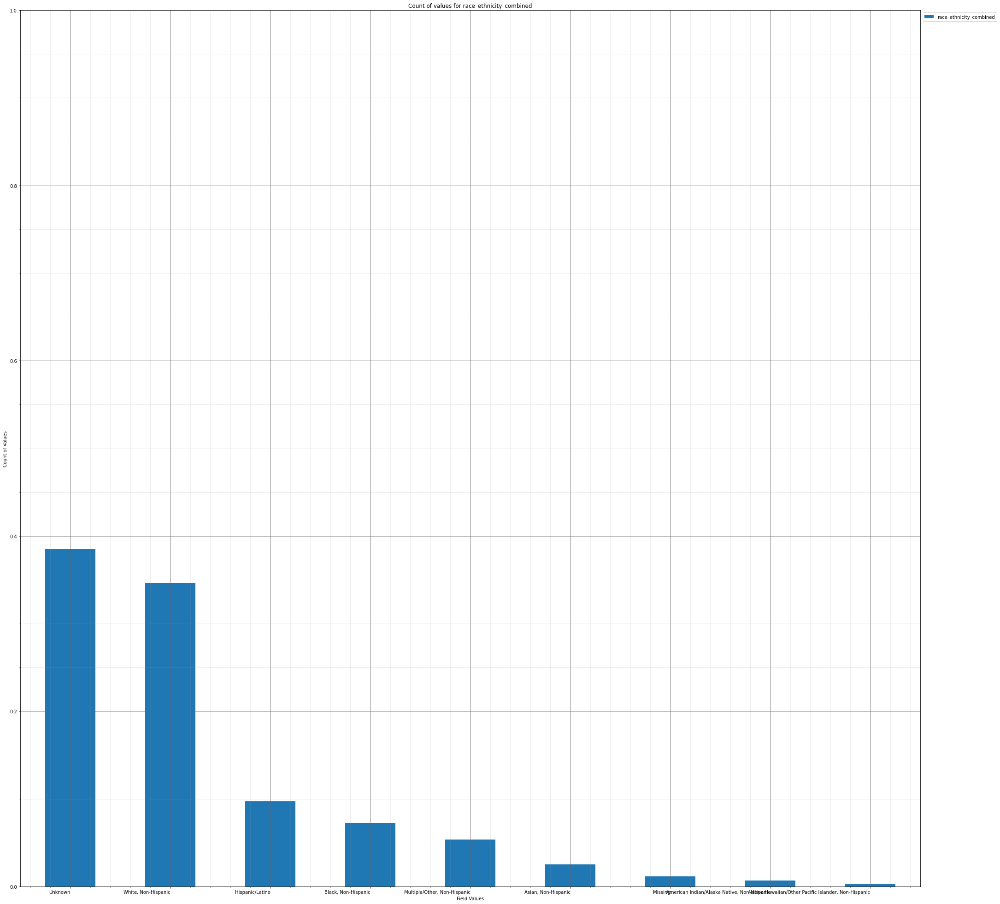



----------------------


         cdc_case_earliest_dt
hosp_yn                      
Missing                  2122
No                       5172
OTH                         1
Unknown                  1575
Yes                       699
Grouping over hosp_yn results in:



,hosp_yn,Rows,% Frequency
0,Missing,2122,22.175776
1,No,5172,54.049535
2,OTH,1,0.010450
3,Unknown,1575,16.459400
4,Yes,699,7.304839


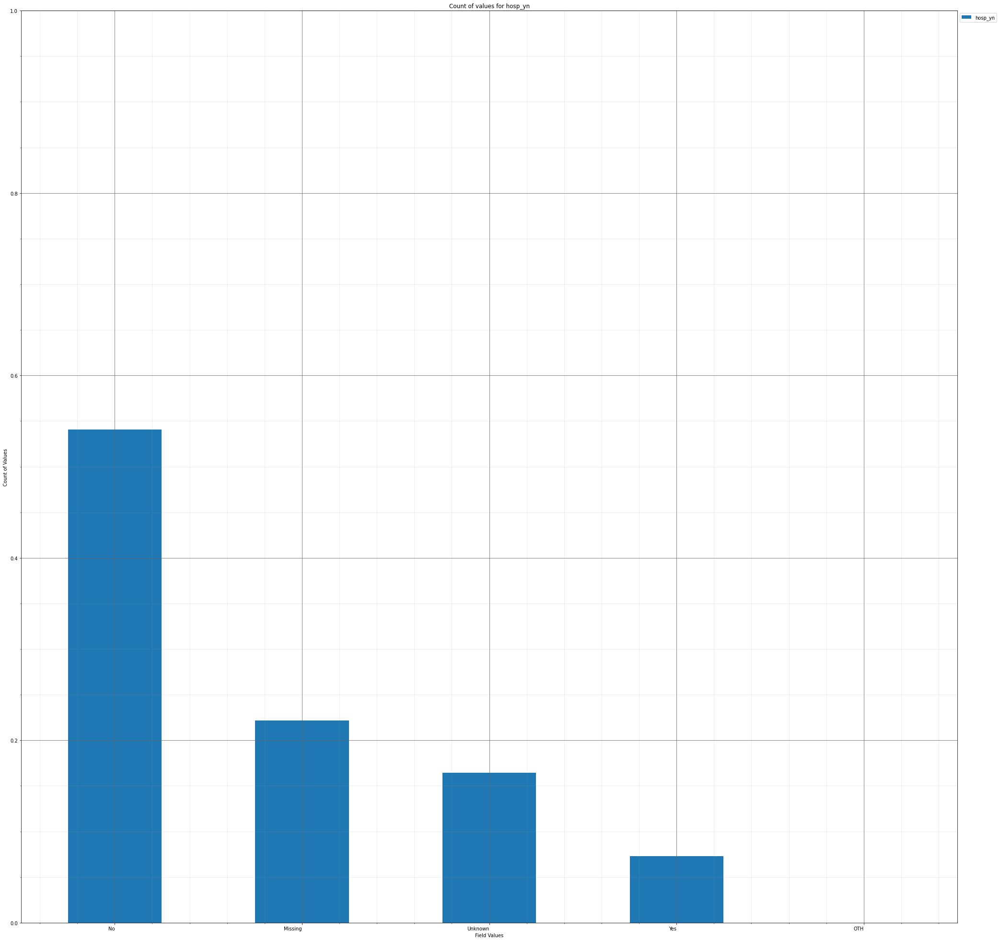



----------------------


         cdc_case_earliest_dt
icu_yn                       
Missing                  7244
No                        958
Unknown                  1275
Yes                        92
Grouping over icu_yn results in:



,icu_yn,Rows,% Frequency
0,Missing,7244,75.702790
1,No,958,10.011495
2,Unknown,1275,13.324276
3,Yes,92,0.961438


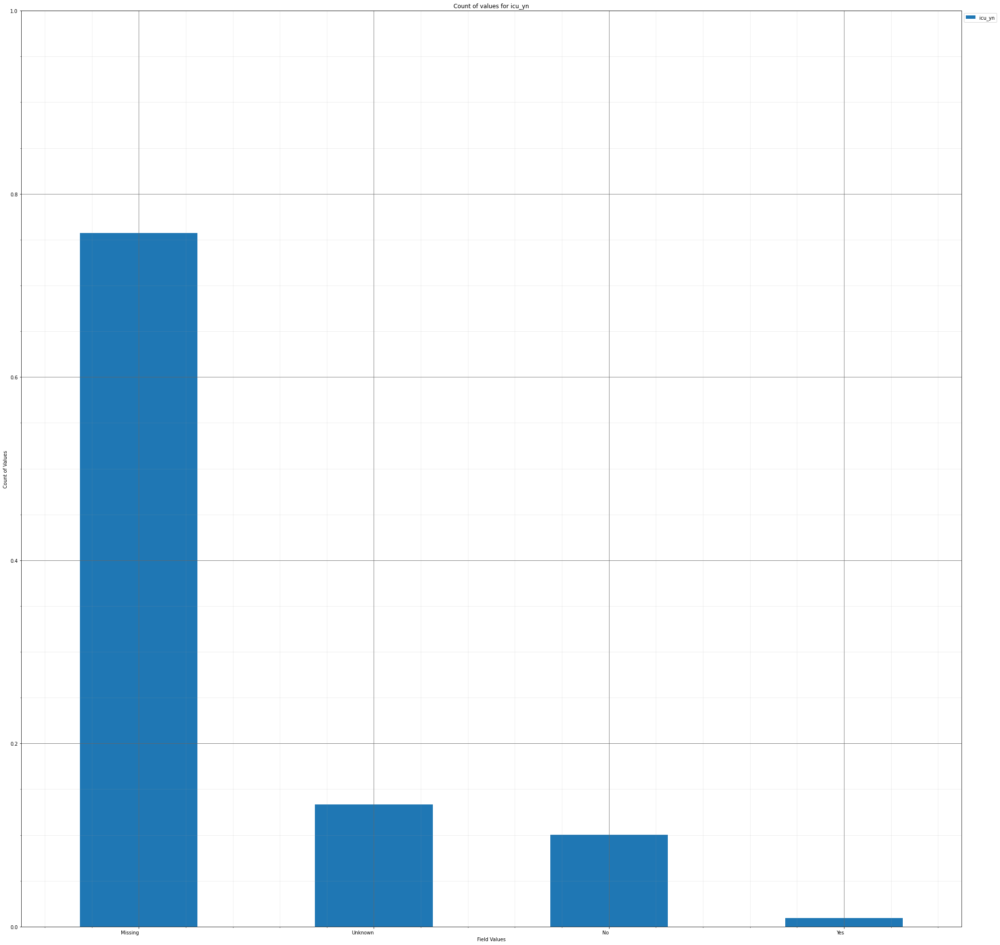



----------------------


          cdc_case_earliest_dt
death_yn                      
No                        9234
Yes                        335
Grouping over death_yn results in:



,death_yn,Rows,% Frequency
0,No,9234,96.499112
1,Yes,335,3.500888


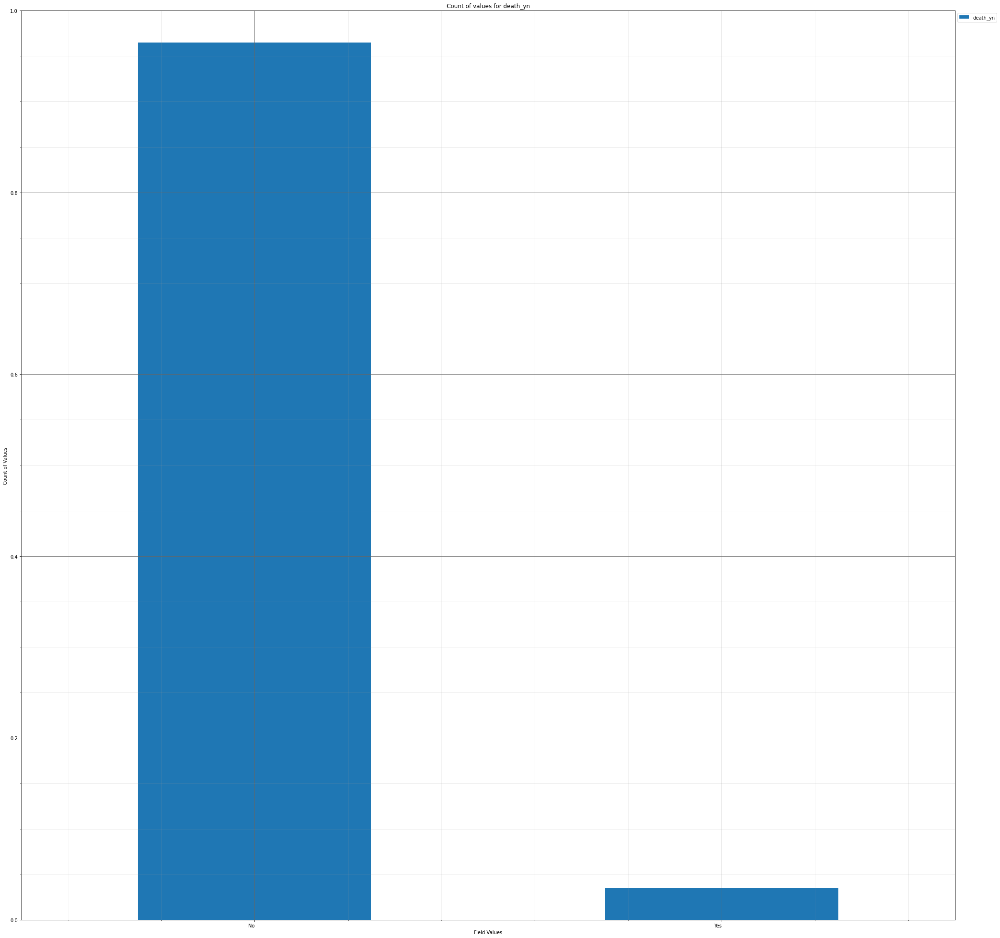



----------------------


            cdc_case_earliest_dt
medcond_yn                      
Missing                     7091
No                           931
Unknown                      711
Yes                          836
Grouping over medcond_yn results in:



,medcond_yn,Rows,% Frequency
0,Missing,7091,74.103877
1,No,931,9.729334
2,Unknown,711,7.430243
3,Yes,836,8.736545


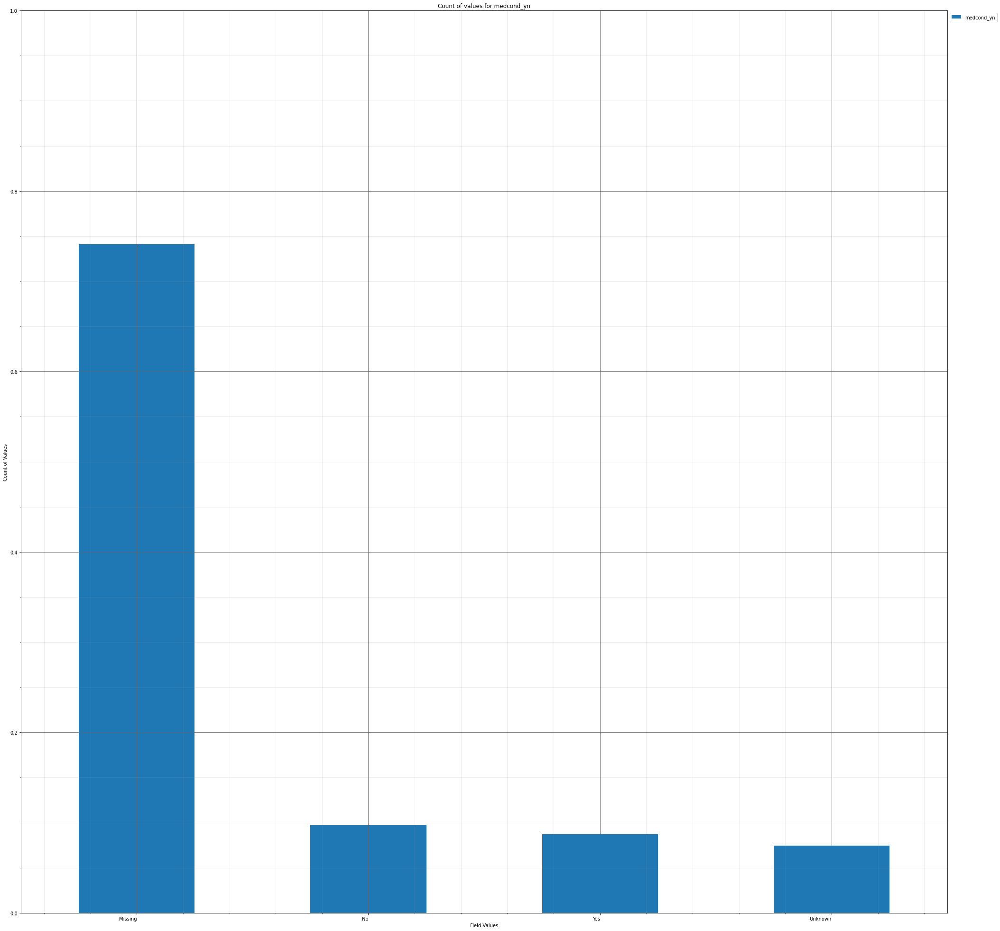

In [40]:
dd_single_frequency_dict=group_over_single_categories(deduped_covid_sample_df,categorical_columns,save_fig=True,pdf_fn=single_categorical_barplot_dedupe_fn)

Inside group_over_multi_categories()


----------------------


Grouping over current_status|sex results in:



,current_status,sex,Rows,% Frequency
0,Laboratory-confirmed case,Female,4753,49.670812
1,Laboratory-confirmed case,Male,4076,42.595883
2,Laboratory-confirmed case,Missing,12,0.125405
3,Laboratory-confirmed case,Unknown,64,0.668826
4,Probable Case,Female,344,3.594942
5,Probable Case,Male,313,3.270979
6,Probable Case,Missing,1,0.010450
7,Probable Case,Unknown,6,0.062702


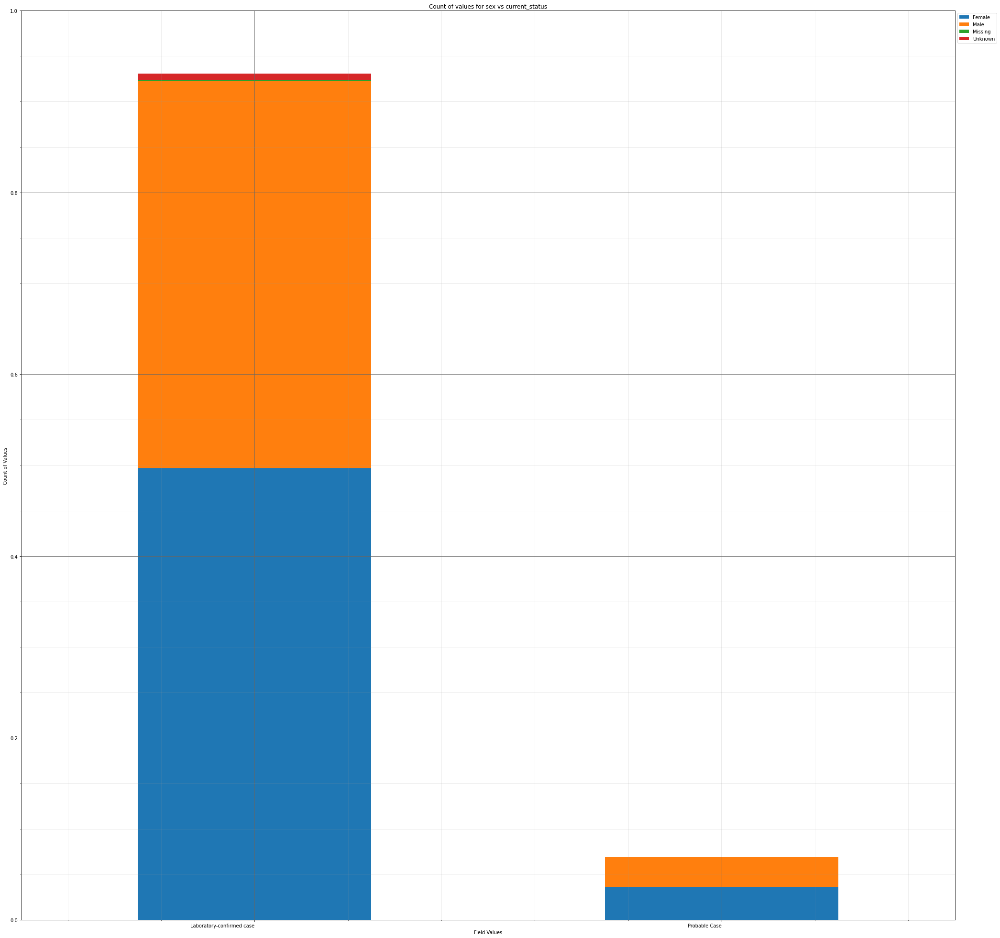



----------------------


Grouping over current_status|age_group results in:



,current_status,age_group,Rows,% Frequency
0,Laboratory-confirmed case,0 - 9 Years,425,4.441425
1,Laboratory-confirmed case,10 - 19 Years,934,9.760686
2,Laboratory-confirmed case,20 - 29 Years,1609,16.814714
3,Laboratory-confirmed case,30 - 39 Years,1421,14.850037
4,Laboratory-confirmed case,40 - 49 Years,1309,13.679590
5,Laboratory-confirmed case,50 - 59 Years,1267,13.240673
6,Laboratory-confirmed case,60 - 69 Years,933,9.750235
7,Laboratory-confirmed case,70 - 79 Years,578,6.040339
8,Laboratory-confirmed case,80+ Years,425,4.441425
9,Laboratory-confirmed case,Missing,4,0.041802


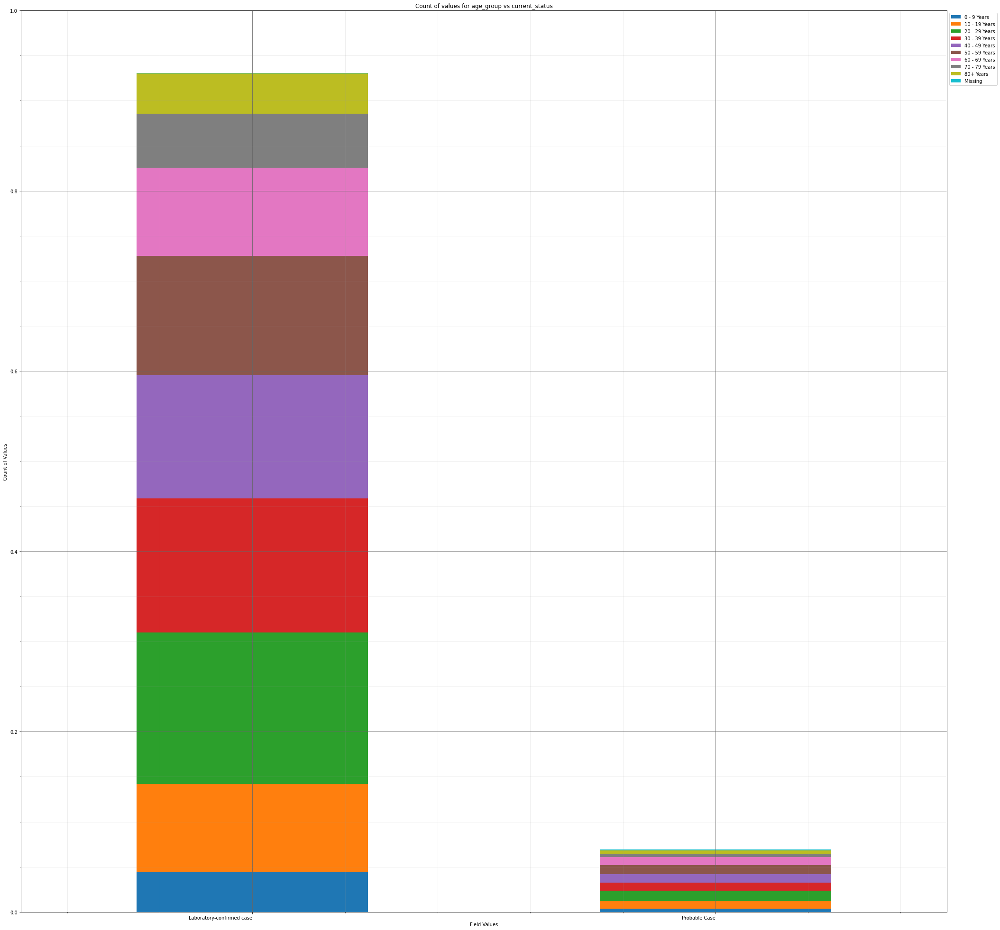



----------------------


Grouping over current_status|race_ethnicity_combined results in:



,current_status,race_ethnicity_combined,Rows,% Frequency
0,Laboratory-confirmed case,"American Indian/Alaska Native, Non-Hispanic",60,0.627025
1,Laboratory-confirmed case,"Asian, Non-Hispanic",233,2.434946
2,Laboratory-confirmed case,"Black, Non-Hispanic",660,6.897272
3,Laboratory-confirmed case,Hispanic/Latino,894,9.342669
4,Laboratory-confirmed case,Missing,88,0.919636
5,Laboratory-confirmed case,"Multiple/Other, Non-Hispanic",474,4.953496
6,Laboratory-confirmed case,"Native Hawaiian/Other Pacific Islander, Non-Hi...",23,0.240359
7,Laboratory-confirmed case,Unknown,3463,36.189779
8,Laboratory-confirmed case,"White, Non-Hispanic",3010,31.455743
9,Probable Case,"American Indian/Alaska Native, Non-Hispanic",6,0.062702


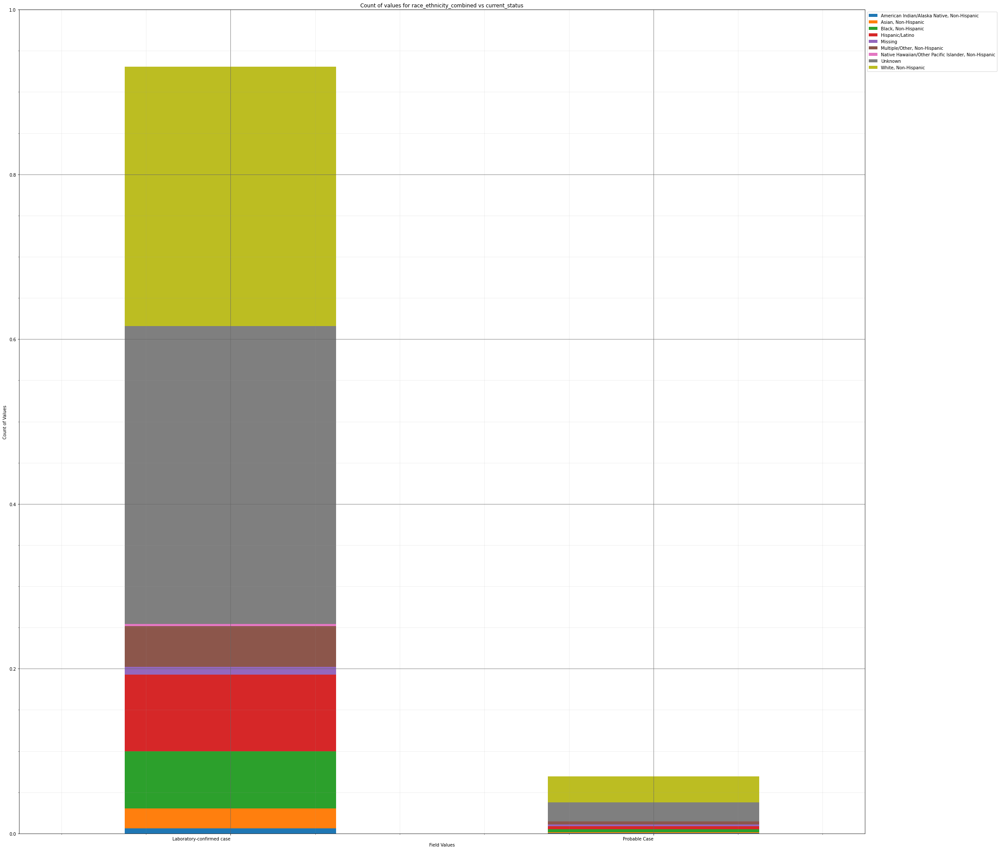



----------------------


Grouping over current_status|hosp_yn results in:



,current_status,hosp_yn,Rows,% Frequency
0,Laboratory-confirmed case,Missing,1957,20.451458
1,Laboratory-confirmed case,No,4752,49.660362
2,Laboratory-confirmed case,OTH,1,0.010450
3,Laboratory-confirmed case,Unknown,1521,15.895078
4,Laboratory-confirmed case,Yes,674,7.043578
5,Probable Case,Missing,165,1.724318
6,Probable Case,No,420,4.389173
7,Probable Case,OTH,0,0.000000
8,Probable Case,Unknown,54,0.564322
9,Probable Case,Yes,25,0.261260


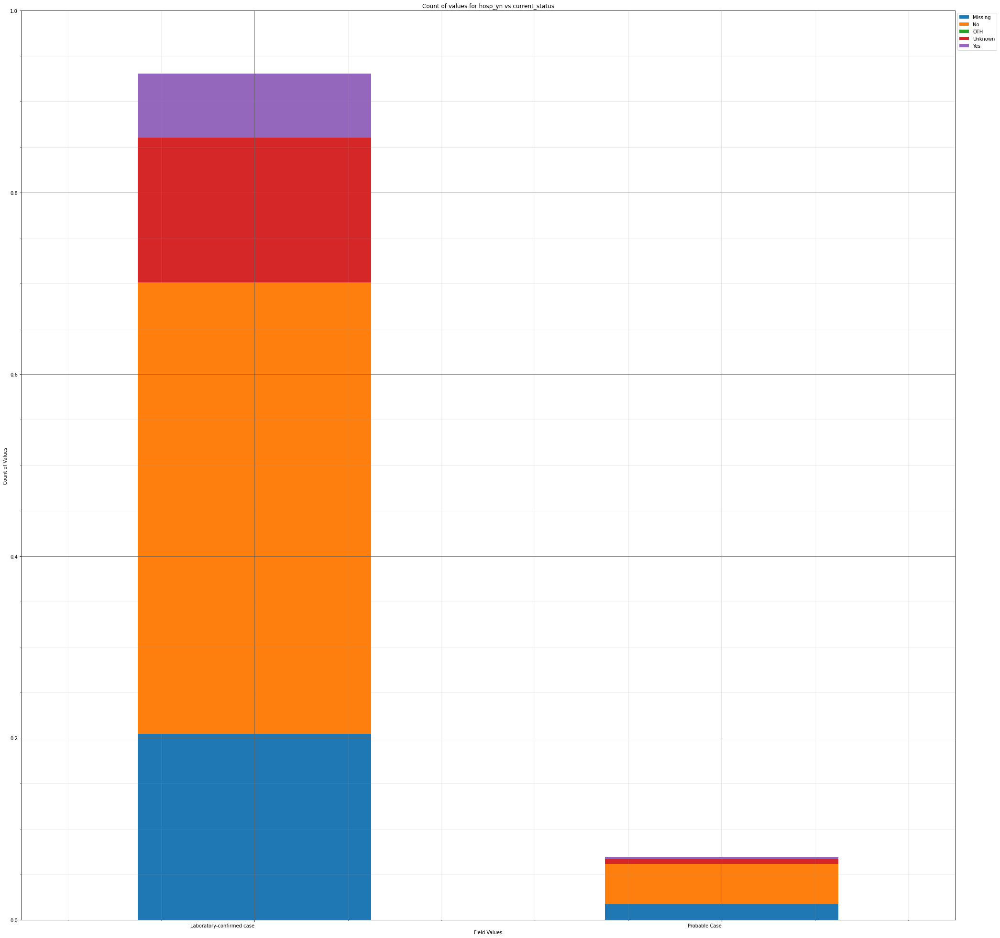



----------------------


Grouping over current_status|icu_yn results in:



,current_status,icu_yn,Rows,% Frequency
0,Laboratory-confirmed case,Missing,6788,70.937402
1,Laboratory-confirmed case,No,879,9.185913
2,Laboratory-confirmed case,Unknown,1147,11.986623
3,Laboratory-confirmed case,Yes,91,0.950988
4,Probable Case,Missing,456,4.765388
5,Probable Case,No,79,0.825583
6,Probable Case,Unknown,128,1.337653
7,Probable Case,Yes,1,0.010450


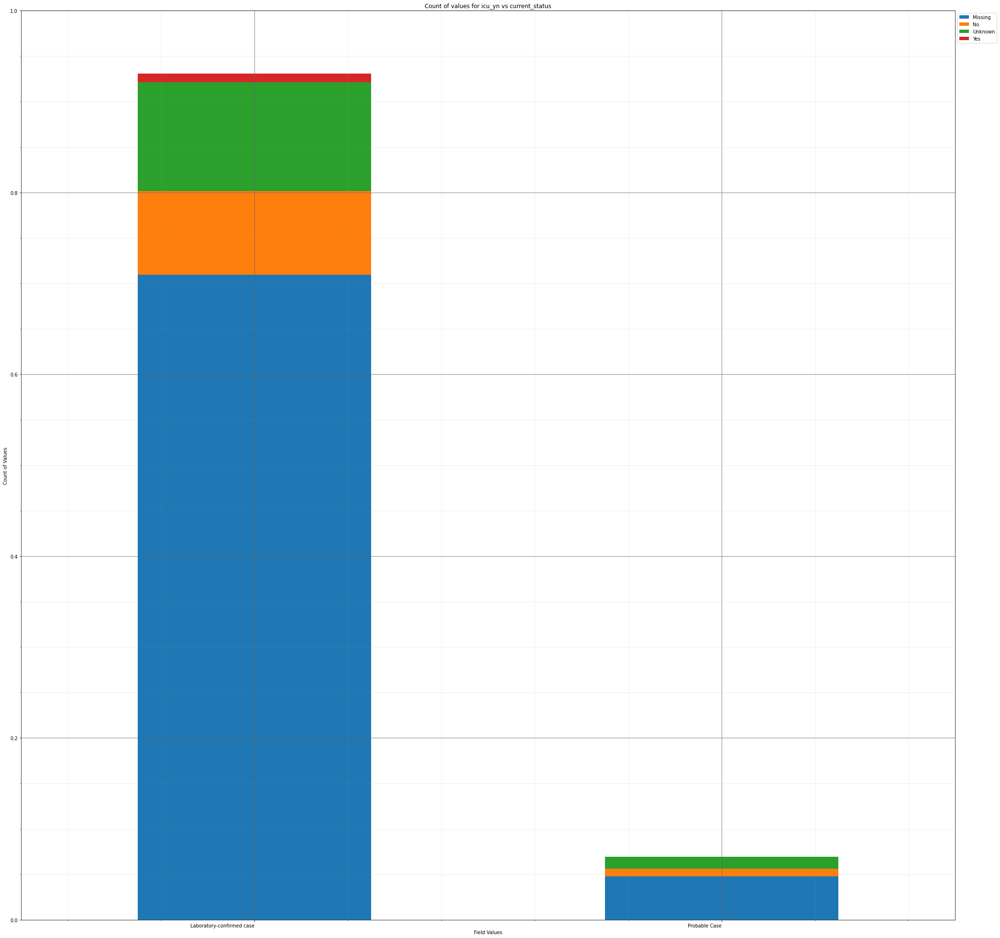



----------------------


Grouping over current_status|death_yn results in:



,current_status,death_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,8597,89.842199
1,Laboratory-confirmed case,Yes,308,3.218727
2,Probable Case,No,637,6.656913
3,Probable Case,Yes,27,0.282161


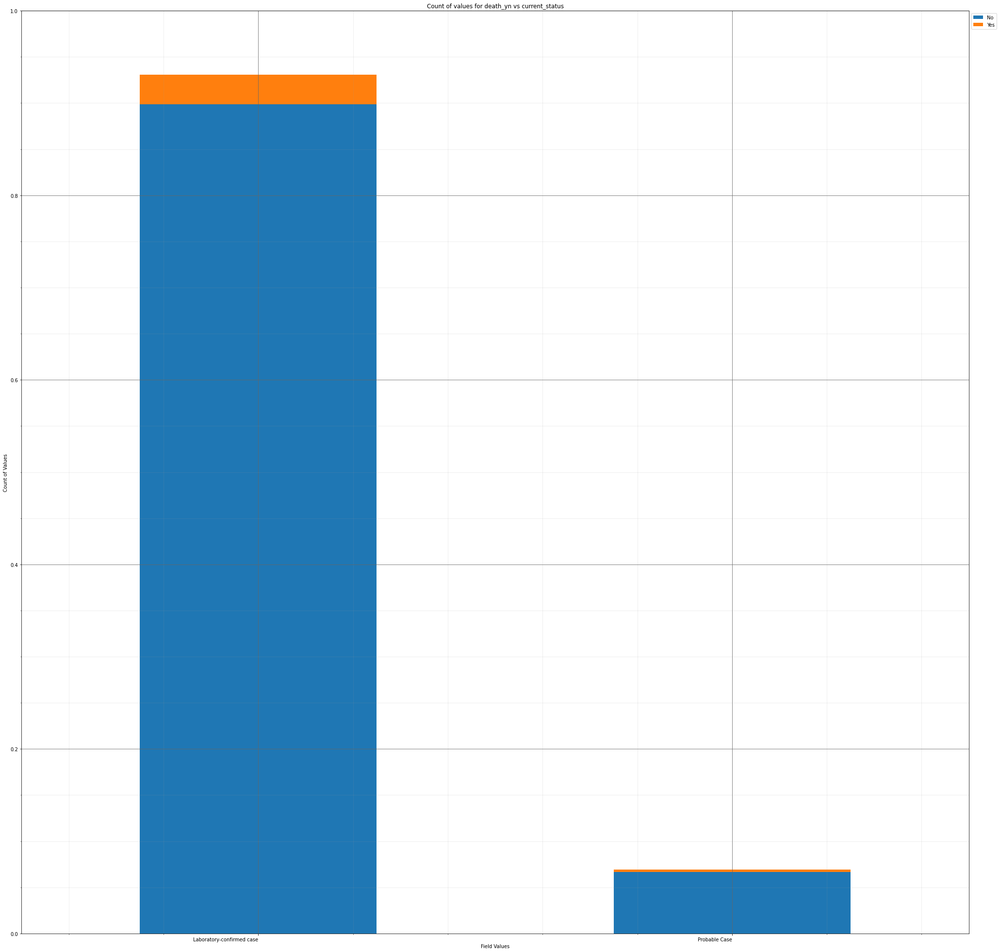



----------------------


Grouping over current_status|medcond_yn results in:



,current_status,medcond_yn,Rows,% Frequency
0,Laboratory-confirmed case,Missing,6616,69.139931
1,Laboratory-confirmed case,No,856,8.945553
2,Laboratory-confirmed case,Unknown,640,6.688264
3,Laboratory-confirmed case,Yes,793,8.287177
4,Probable Case,Missing,475,4.963946
5,Probable Case,No,75,0.783781
6,Probable Case,Unknown,71,0.741979
7,Probable Case,Yes,43,0.449368


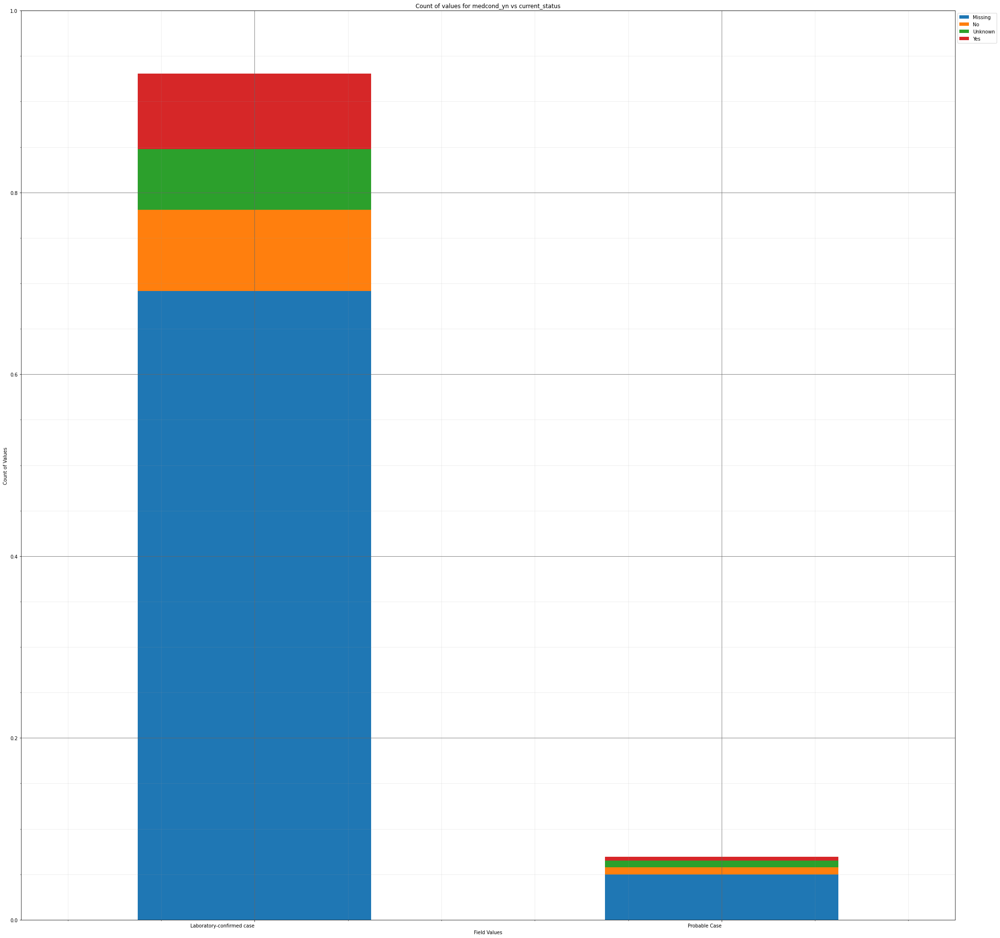



----------------------


Grouping over sex|current_status results in:



,sex,current_status,Rows,% Frequency
0,Female,Laboratory-confirmed case,4753,49.670812
1,Female,Probable Case,344,3.594942
2,Male,Laboratory-confirmed case,4076,42.595883
3,Male,Probable Case,313,3.270979
4,Missing,Laboratory-confirmed case,12,0.125405
5,Missing,Probable Case,1,0.010450
6,Unknown,Laboratory-confirmed case,64,0.668826
7,Unknown,Probable Case,6,0.062702


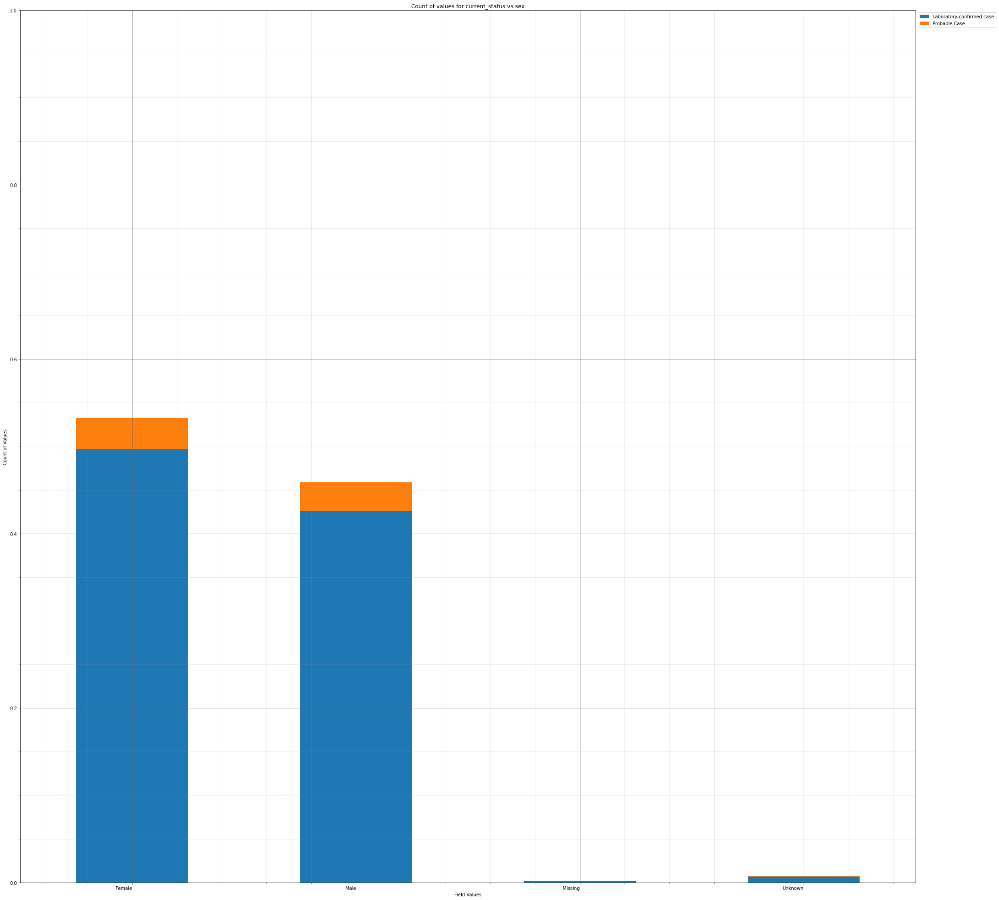



----------------------


Grouping over sex|age_group results in:



,sex,age_group,Rows,% Frequency
0,Female,0 - 9 Years,233,2.434946
1,Female,10 - 19 Years,526,5.496917
2,Female,20 - 29 Years,926,9.677082
3,Female,30 - 39 Years,806,8.423033
4,Female,40 - 49 Years,729,7.618351
5,Female,50 - 59 Years,726,7.587000
6,Female,60 - 69 Years,530,5.538719
7,Female,70 - 79 Years,316,3.302330
8,Female,80+ Years,295,3.082872
9,Female,Missing,10,0.104504


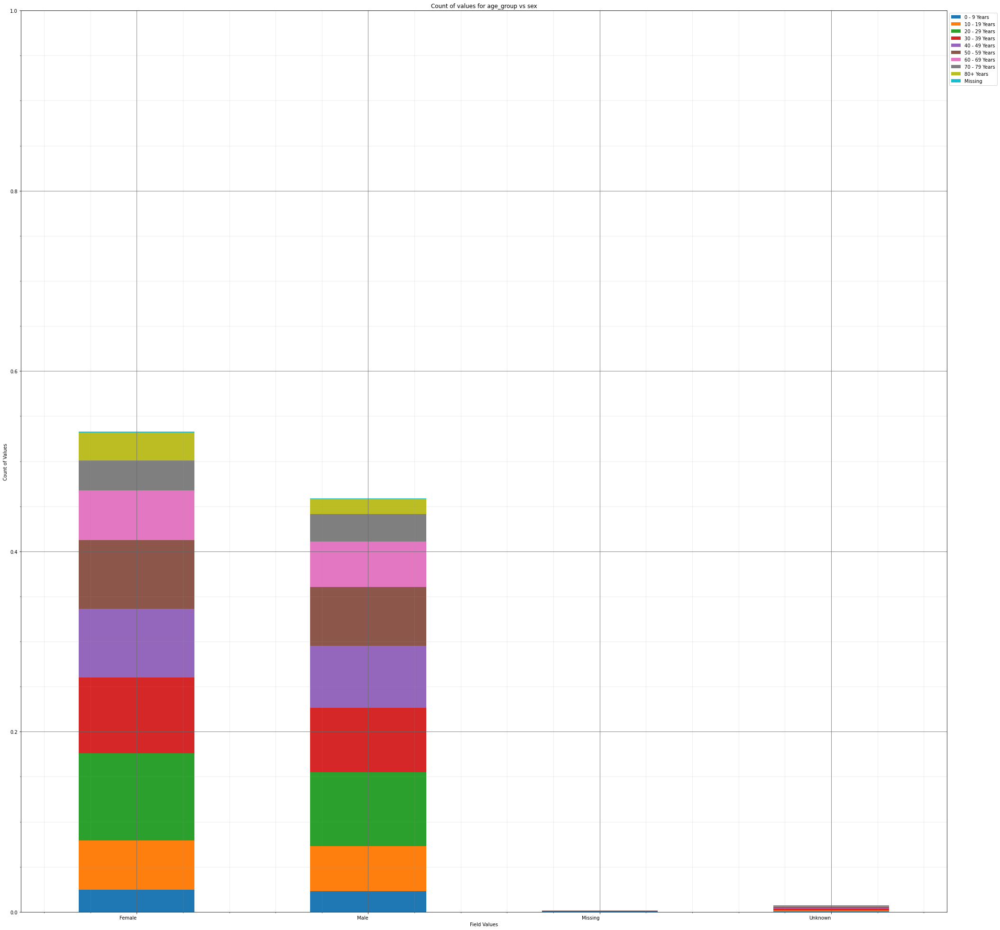



----------------------


Grouping over sex|race_ethnicity_combined results in:



,sex,race_ethnicity_combined,Rows,% Frequency
0,Female,"American Indian/Alaska Native, Non-Hispanic",34,0.355314
1,Female,"Asian, Non-Hispanic",122,1.274950
2,Female,"Black, Non-Hispanic",411,4.295120
3,Female,Hispanic/Latino,510,5.329711
4,Female,Missing,54,0.564322
5,Female,"Multiple/Other, Non-Hispanic",262,2.738008
6,Female,"Native Hawaiian/Other Pacific Islander, Non-Hi...",14,0.146306
7,Female,Unknown,1908,19.939388
8,Female,"White, Non-Hispanic",1782,18.622636
9,Male,"American Indian/Alaska Native, Non-Hispanic",32,0.334413


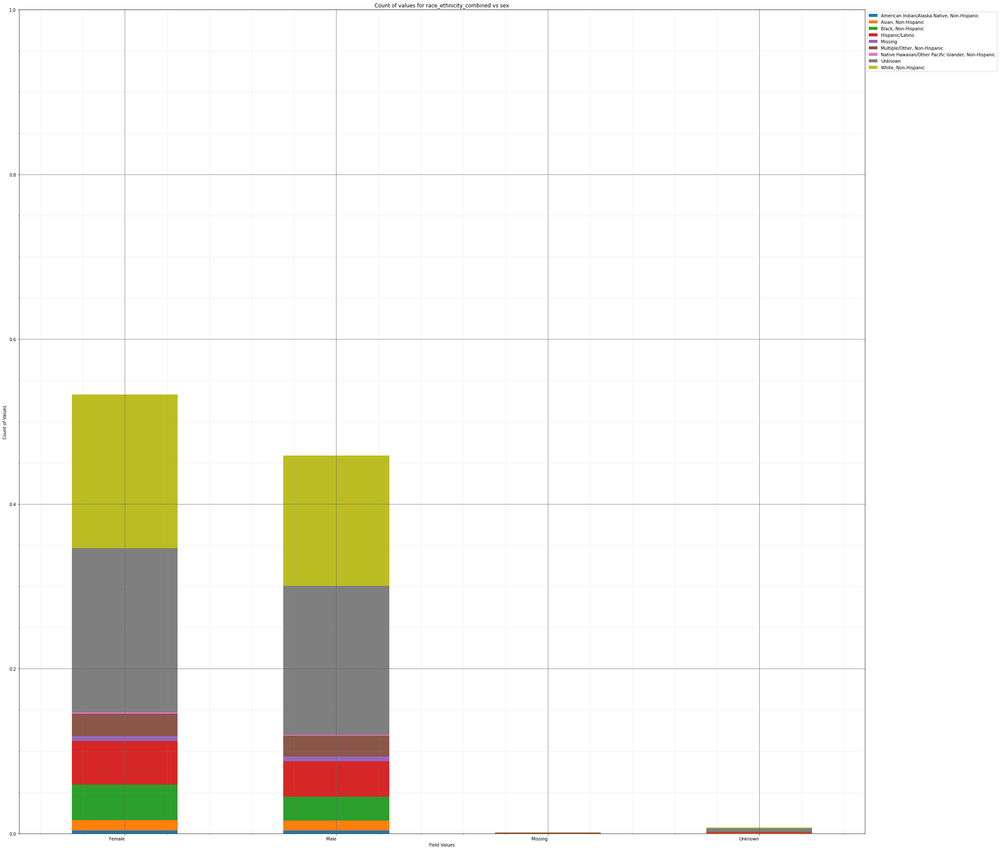



----------------------


Grouping over sex|hosp_yn results in:



,sex,hosp_yn,Rows,% Frequency
0,Female,Missing,1123,11.735814
1,Female,No,2829,29.564218
2,Female,OTH,0,0.000000
3,Female,Unknown,798,8.339429
4,Female,Yes,347,3.626293
5,Male,Missing,971,10.147351
6,Male,No,2316,24.203156
7,Male,OTH,1,0.010450
8,Male,Unknown,750,7.837810
9,Male,Yes,351,3.668095


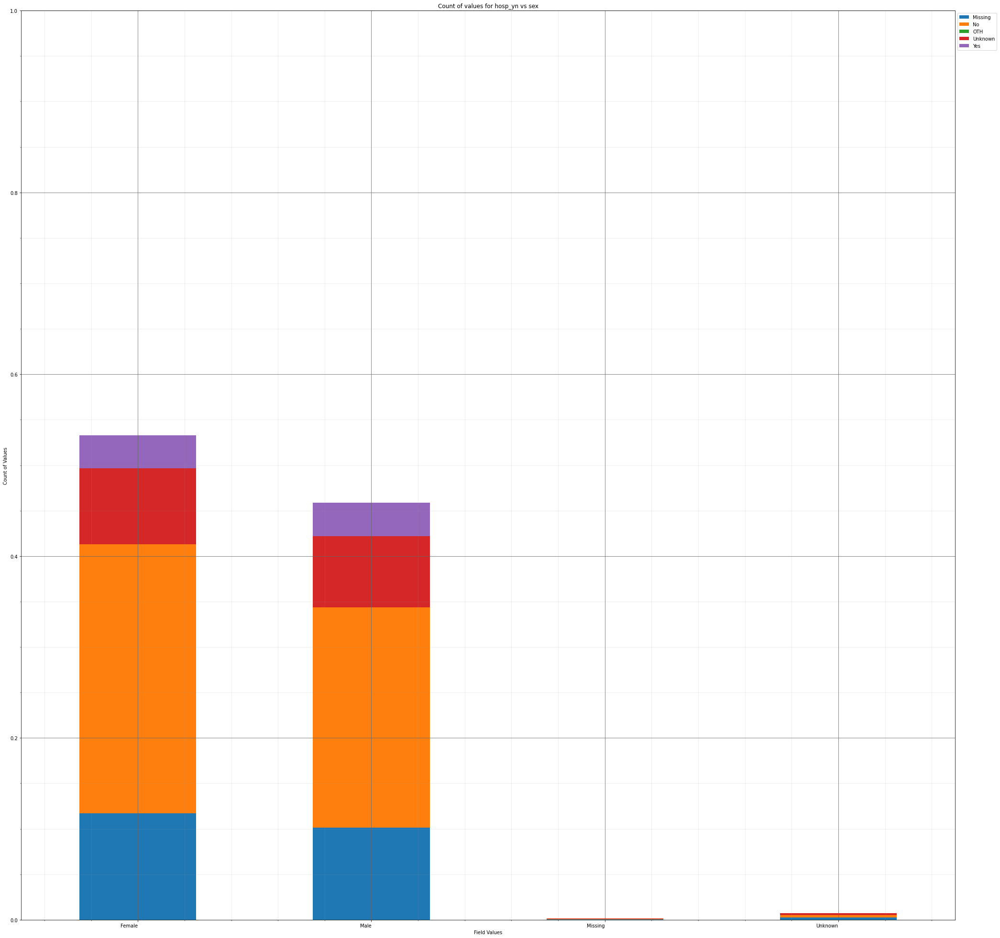



----------------------


Grouping over sex|icu_yn results in:



,sex,icu_yn,Rows,% Frequency
0,Female,Missing,3849,40.223639
1,Female,No,512,5.350611
2,Female,Unknown,694,7.252586
3,Female,Yes,42,0.438917
4,Male,Missing,3328,34.778974
5,Male,No,442,4.619082
6,Male,Unknown,570,5.956735
7,Male,Yes,49,0.512070
8,Missing,Missing,5,0.052252
9,Missing,No,0,0.000000


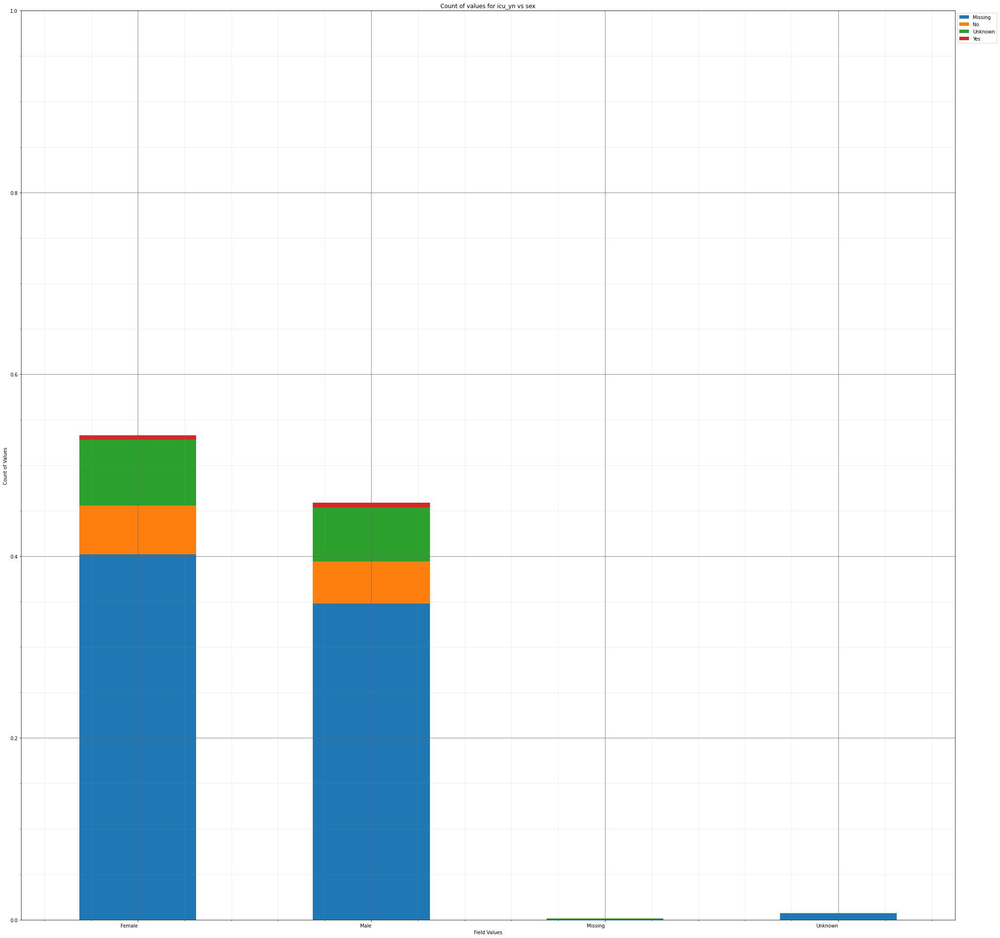



----------------------


Grouping over sex|death_yn results in:



,sex,death_yn,Rows,% Frequency
0,Female,No,4930,51.520535
1,Female,Yes,167,1.745219
2,Male,No,4224,44.142544
3,Male,Yes,165,1.724318
4,Missing,No,12,0.125405
5,Missing,Yes,1,0.010450
6,Unknown,No,68,0.710628
7,Unknown,Yes,2,0.020901


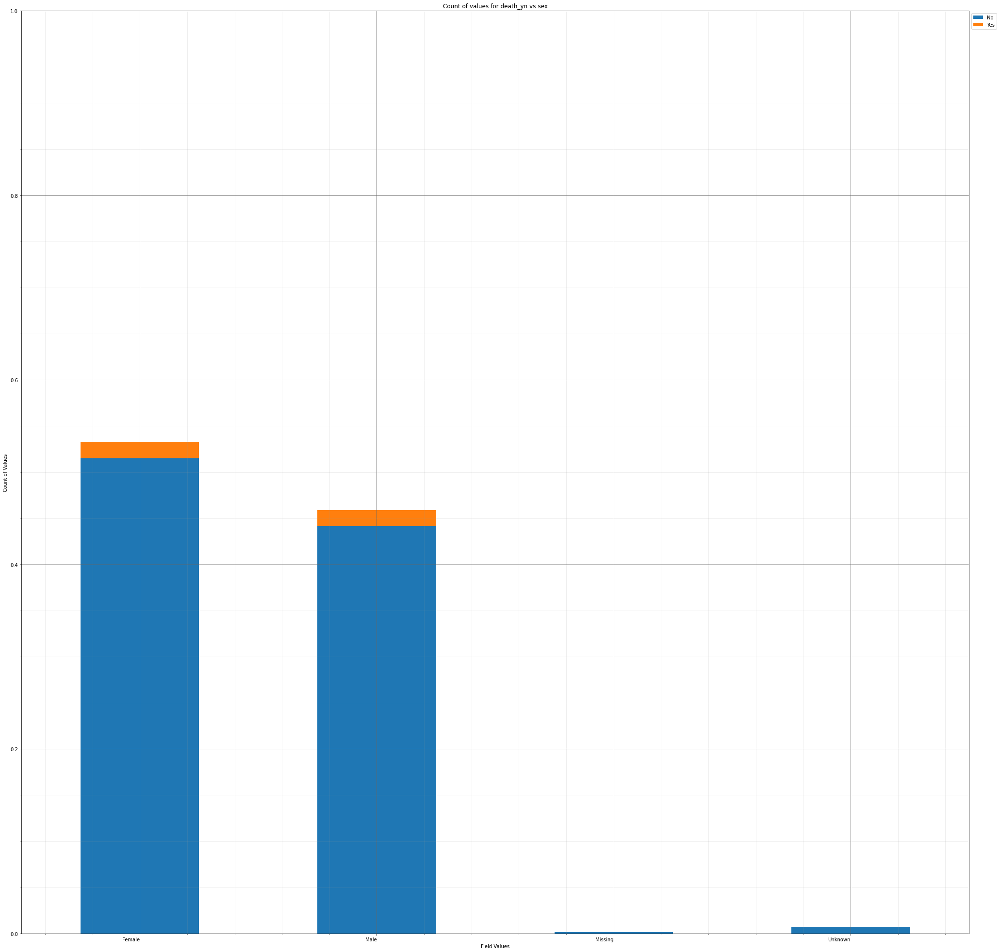



----------------------


Grouping over sex|medcond_yn results in:



,sex,medcond_yn,Rows,% Frequency
0,Female,Missing,3736,39.042742
1,Female,No,508,5.308810
2,Female,Unknown,393,4.107012
3,Female,Yes,460,4.807190
4,Male,Missing,3289,34.371408
5,Male,No,416,4.347372
6,Male,Unknown,311,3.250078
7,Male,Yes,373,3.898004
8,Missing,Missing,4,0.041802
9,Missing,No,3,0.031351


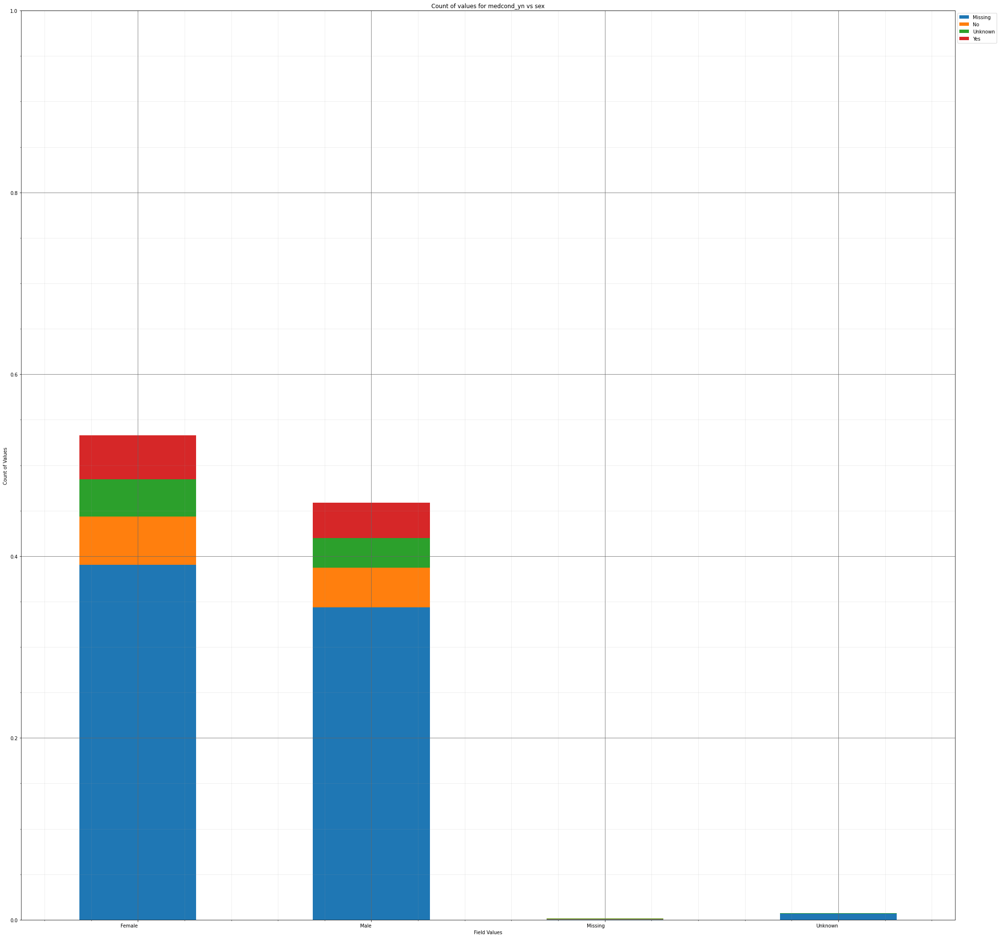



----------------------


Grouping over age_group|current_status results in:



,age_group,current_status,Rows,% Frequency
0,0 - 9 Years,Laboratory-confirmed case,425,4.441425
1,0 - 9 Years,Probable Case,33,0.344864
2,10 - 19 Years,Laboratory-confirmed case,934,9.760686
3,10 - 19 Years,Probable Case,83,0.867384
4,20 - 29 Years,Laboratory-confirmed case,1609,16.814714
5,20 - 29 Years,Probable Case,111,1.159996
6,30 - 39 Years,Laboratory-confirmed case,1421,14.850037
7,30 - 39 Years,Probable Case,84,0.877835
8,40 - 49 Years,Laboratory-confirmed case,1309,13.679590
9,40 - 49 Years,Probable Case,89,0.930087


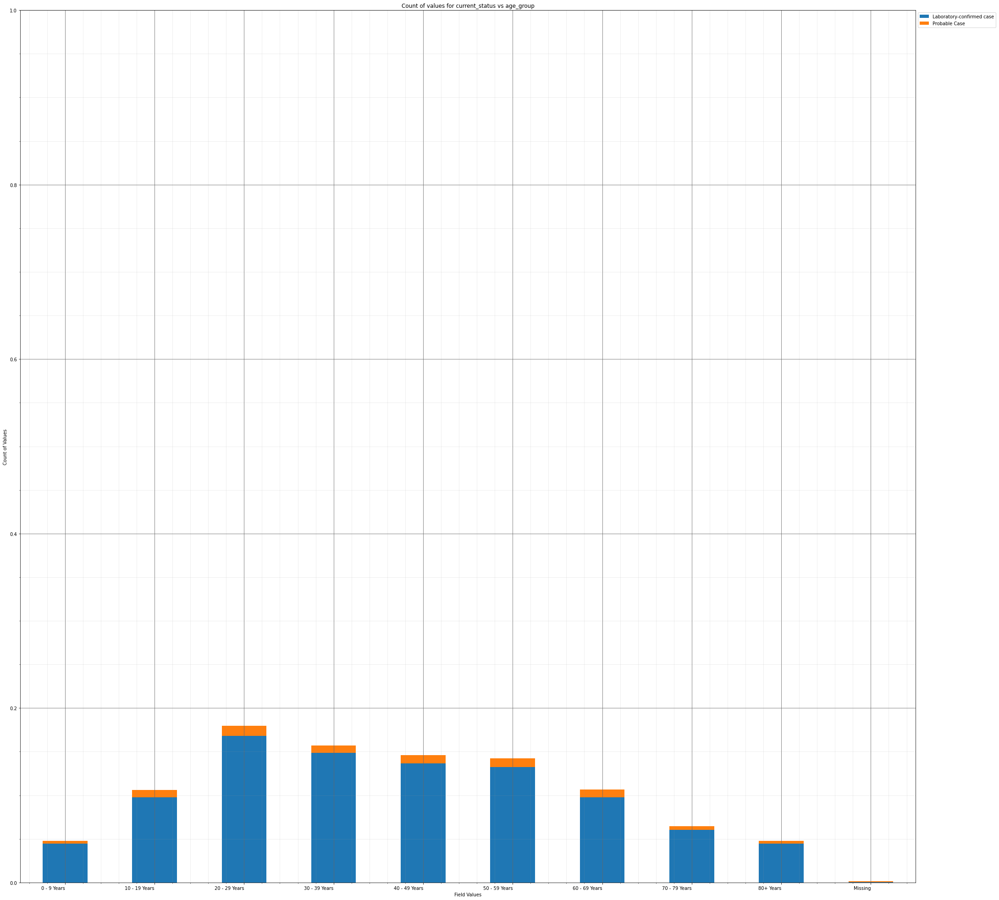



----------------------


Grouping over age_group|sex results in:



,age_group,sex,Rows,% Frequency
0,0 - 9 Years,Female,233,2.434946
1,0 - 9 Years,Male,221,2.309541
2,0 - 9 Years,Missing,2,0.020901
3,0 - 9 Years,Unknown,2,0.020901
4,10 - 19 Years,Female,526,5.496917
5,10 - 19 Years,Male,479,5.005748
6,10 - 19 Years,Missing,2,0.020901
7,10 - 19 Years,Unknown,10,0.104504
8,20 - 29 Years,Female,926,9.677082
9,20 - 29 Years,Male,785,8.203574


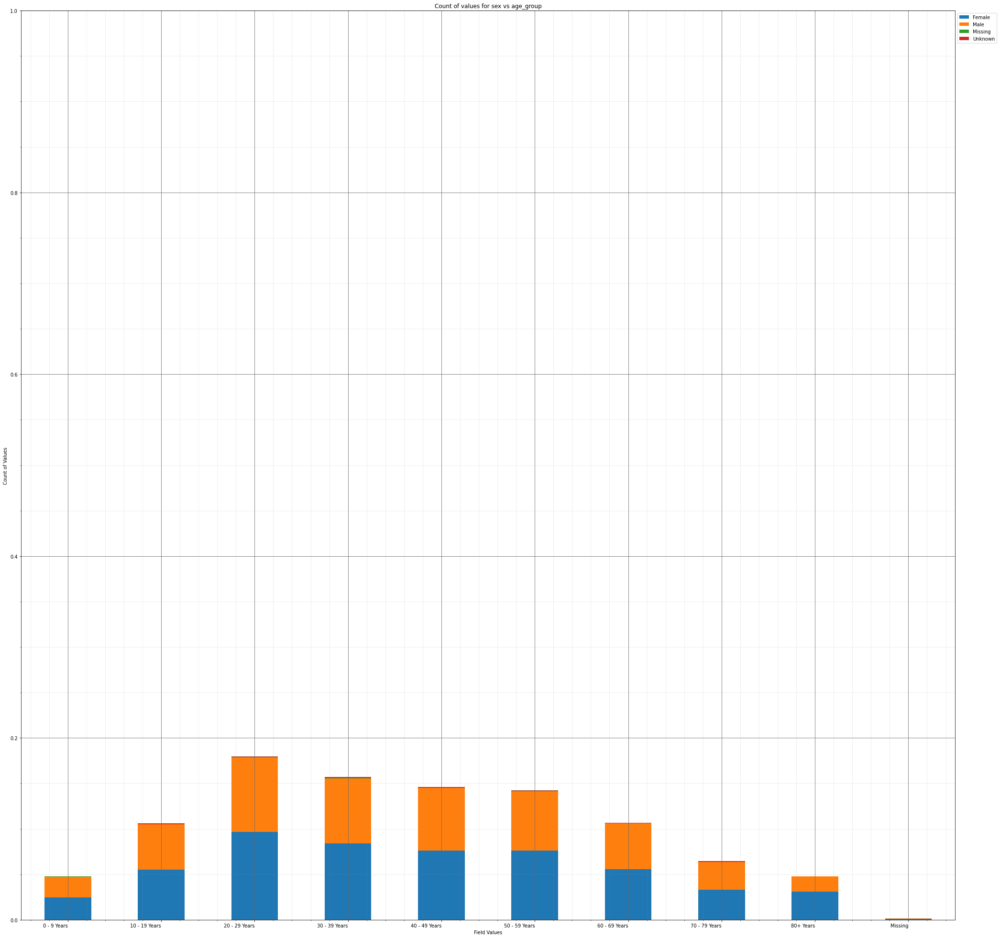



----------------------


Grouping over age_group|race_ethnicity_combined results in:



,age_group,race_ethnicity_combined,Rows,% Frequency
0,0 - 9 Years,"American Indian/Alaska Native, Non-Hispanic",4,0.041802
1,0 - 9 Years,"Asian, Non-Hispanic",12,0.125405
2,0 - 9 Years,"Black, Non-Hispanic",29,0.303062
3,0 - 9 Years,Hispanic/Latino,53,0.553872
4,0 - 9 Years,Missing,1,0.010450
...,...,...,...,...
85,Missing,Missing,1,0.010450
86,Missing,"Multiple/Other, Non-Hispanic",2,0.020901
87,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",0,0.000000
88,Missing,Unknown,10,0.104504


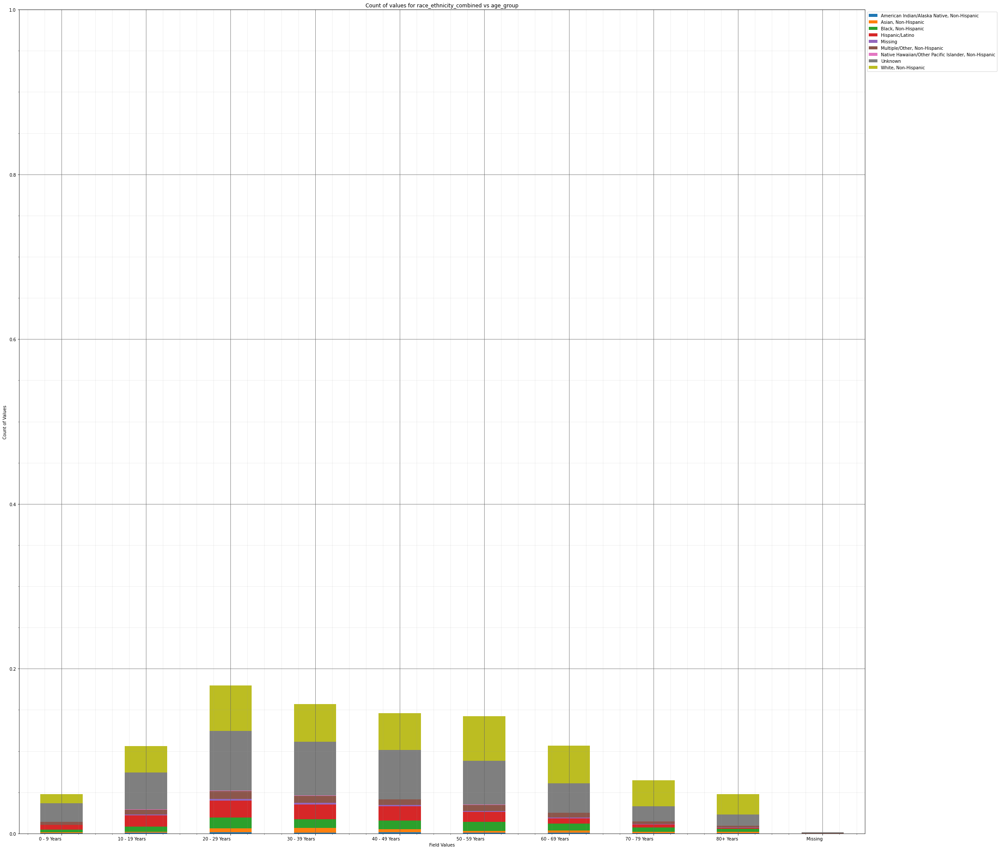



----------------------


Grouping over age_group|hosp_yn results in:



,age_group,hosp_yn,Rows,% Frequency
0,0 - 9 Years,Missing,95,0.992789
1,0 - 9 Years,No,259,2.706657
2,0 - 9 Years,OTH,0,0.000000
3,0 - 9 Years,Unknown,96,1.003240
4,0 - 9 Years,Yes,8,0.083603
5,10 - 19 Years,Missing,221,2.309541
6,10 - 19 Years,No,608,6.353851
7,10 - 19 Years,OTH,0,0.000000
8,10 - 19 Years,Unknown,178,1.860173
9,10 - 19 Years,Yes,10,0.104504


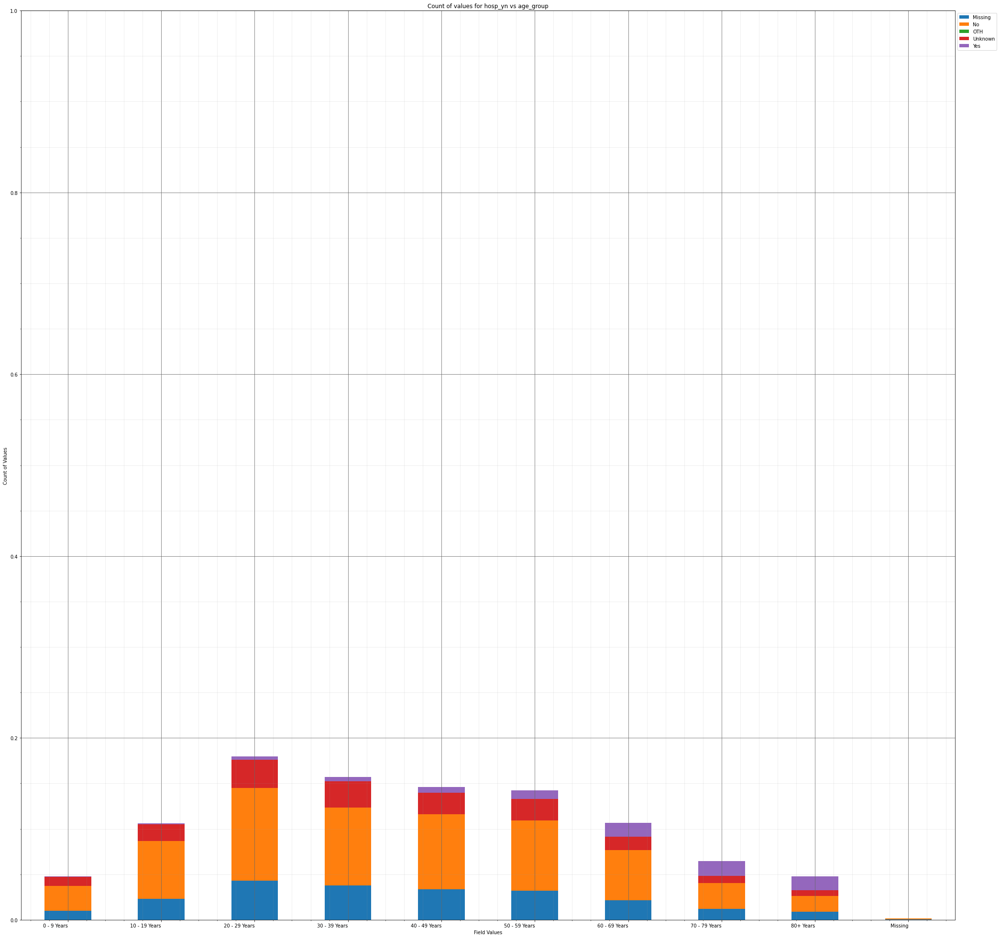



----------------------


Grouping over age_group|icu_yn results in:



,age_group,icu_yn,Rows,% Frequency
0,0 - 9 Years,Missing,373,3.898004
1,0 - 9 Years,No,32,0.334413
2,0 - 9 Years,Unknown,53,0.553872
3,0 - 9 Years,Yes,0,0.000000
4,10 - 19 Years,Missing,779,8.140872
5,10 - 19 Years,No,116,1.212248
6,10 - 19 Years,Unknown,120,1.254050
7,10 - 19 Years,Yes,2,0.020901
8,20 - 29 Years,Missing,1334,13.940851
9,20 - 29 Years,No,168,1.755669


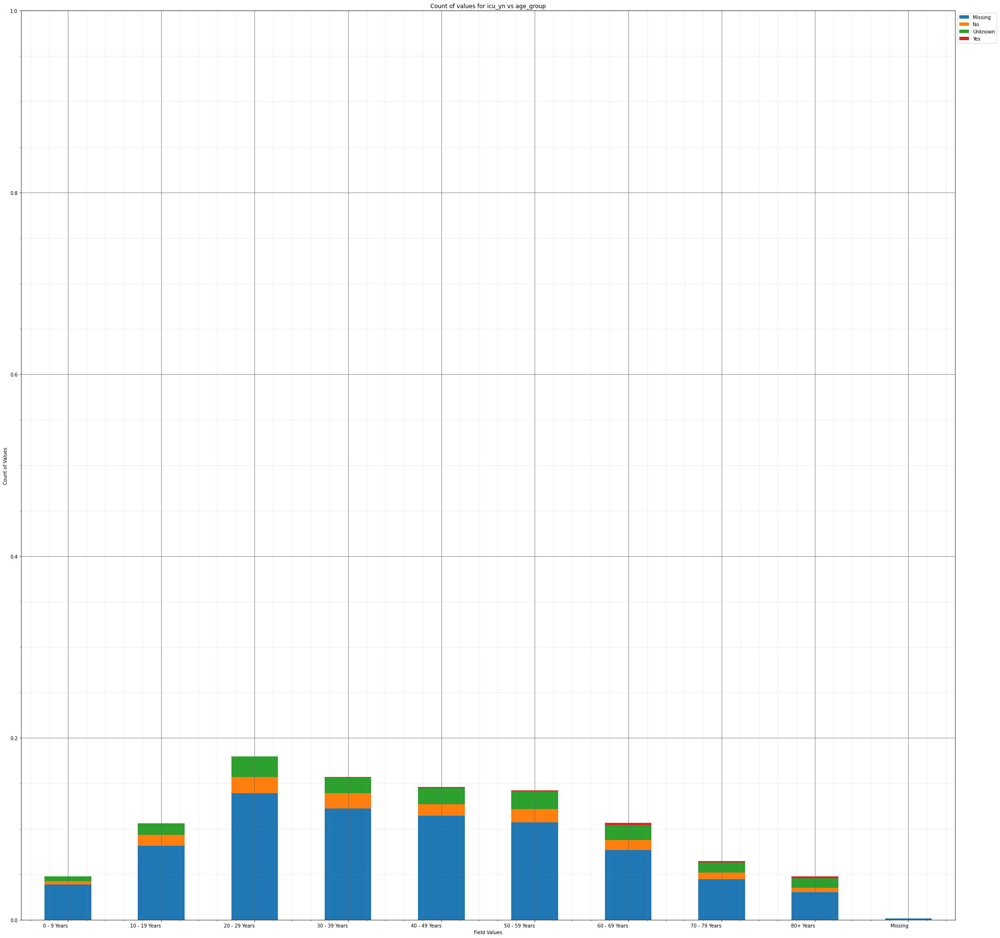



----------------------


Grouping over age_group|death_yn results in:



,age_group,death_yn,Rows,% Frequency
0,0 - 9 Years,No,458,4.786289
1,0 - 9 Years,Yes,0,0.000000
2,10 - 19 Years,No,1017,10.628070
3,10 - 19 Years,Yes,0,0.000000
4,20 - 29 Years,No,1720,17.974710
5,20 - 29 Years,Yes,0,0.000000
6,30 - 39 Years,No,1503,15.706970
7,30 - 39 Years,Yes,2,0.020901
8,40 - 49 Years,No,1386,14.484272
9,40 - 49 Years,Yes,12,0.125405


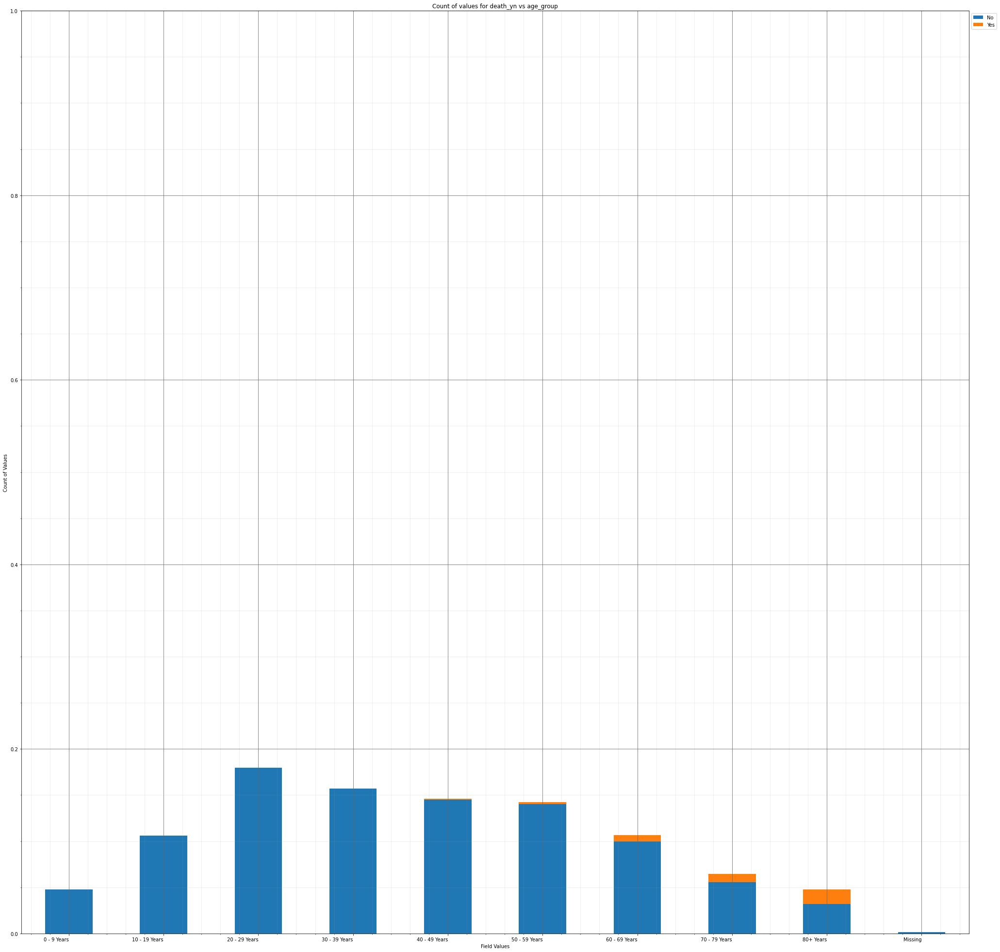



----------------------


Grouping over age_group|medcond_yn results in:



,age_group,medcond_yn,Rows,% Frequency
0,0 - 9 Years,Missing,357,3.730797
1,0 - 9 Years,No,52,0.543421
2,0 - 9 Years,Unknown,36,0.376215
3,0 - 9 Years,Yes,13,0.135855
4,10 - 19 Years,Missing,772,8.067719
5,10 - 19 Years,No,143,1.494409
6,10 - 19 Years,Unknown,69,0.721078
7,10 - 19 Years,Yes,33,0.344864
8,20 - 29 Years,Missing,1289,13.470582
9,20 - 29 Years,No,222,2.319992


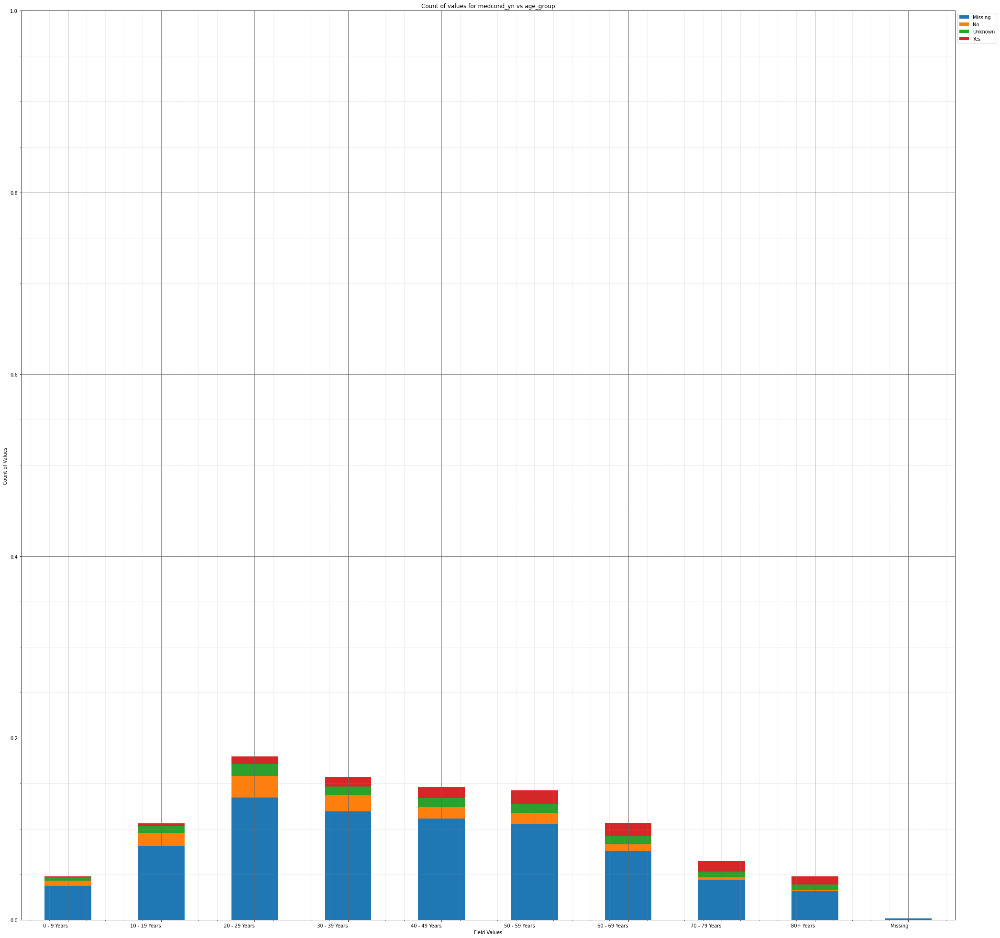



----------------------


Grouping over race_ethnicity_combined|current_status results in:



,race_ethnicity_combined,current_status,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Laboratory-confirmed case,60,0.627025
1,"American Indian/Alaska Native, Non-Hispanic",Probable Case,6,0.062702
2,"Asian, Non-Hispanic",Laboratory-confirmed case,233,2.434946
3,"Asian, Non-Hispanic",Probable Case,8,0.083603
4,"Black, Non-Hispanic",Laboratory-confirmed case,660,6.897272
5,"Black, Non-Hispanic",Probable Case,34,0.355314
6,Hispanic/Latino,Laboratory-confirmed case,894,9.342669
7,Hispanic/Latino,Probable Case,35,0.365764
8,Missing,Laboratory-confirmed case,88,0.919636
9,Missing,Probable Case,21,0.219459


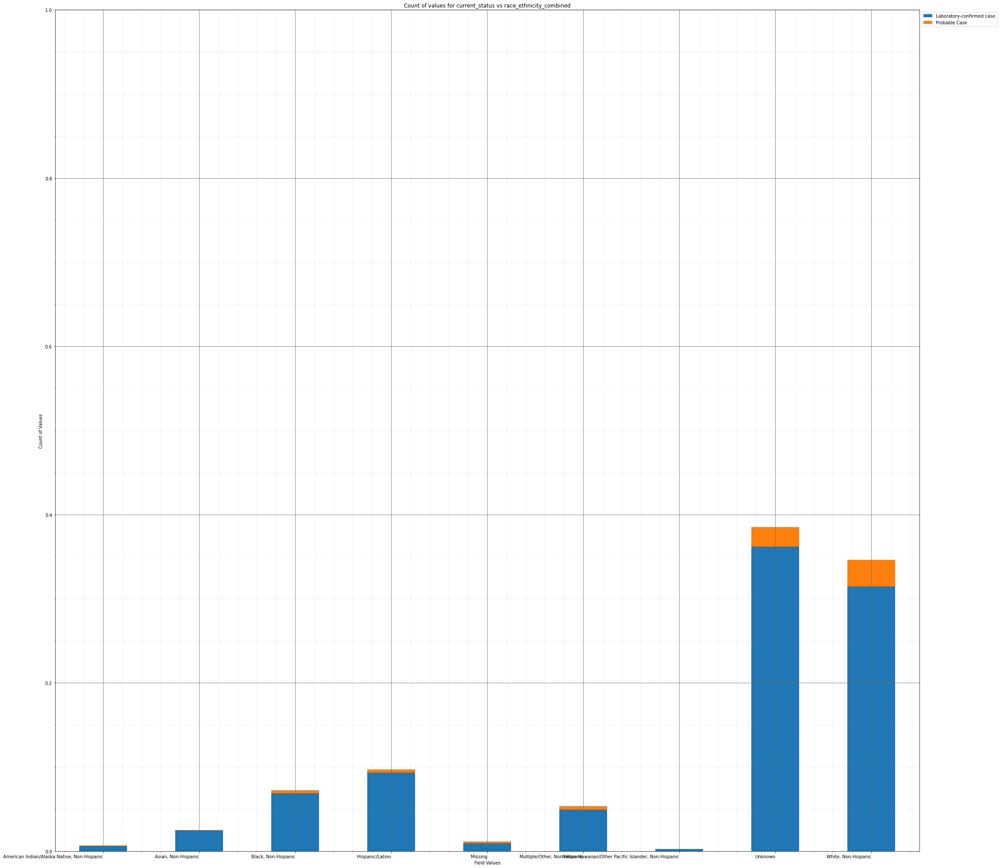



----------------------


Grouping over race_ethnicity_combined|sex results in:



,race_ethnicity_combined,sex,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Female,34,0.355314
1,"American Indian/Alaska Native, Non-Hispanic",Male,32,0.334413
2,"American Indian/Alaska Native, Non-Hispanic",Missing,0,0.000000
3,"American Indian/Alaska Native, Non-Hispanic",Unknown,0,0.000000
4,"Asian, Non-Hispanic",Female,122,1.274950
5,"Asian, Non-Hispanic",Male,116,1.212248
6,"Asian, Non-Hispanic",Missing,1,0.010450
7,"Asian, Non-Hispanic",Unknown,2,0.020901
8,"Black, Non-Hispanic",Female,411,4.295120
9,"Black, Non-Hispanic",Male,281,2.936566


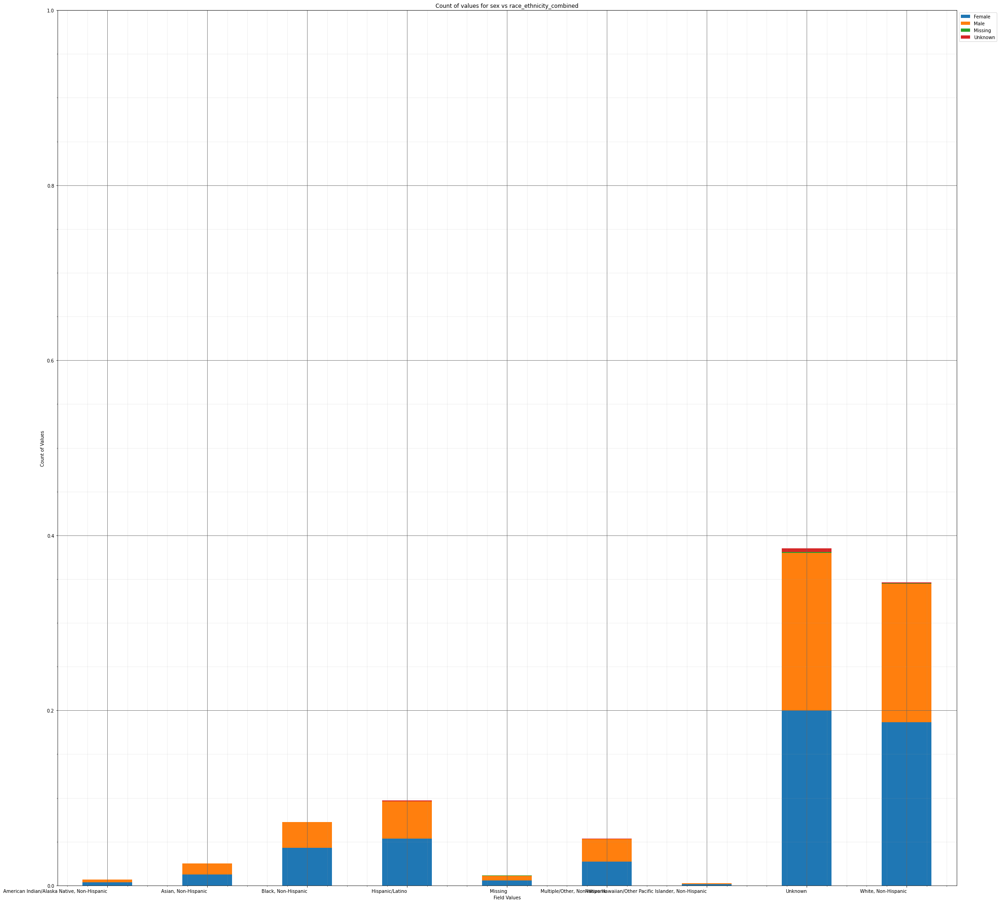



----------------------


Grouping over race_ethnicity_combined|age_group results in:



,race_ethnicity_combined,age_group,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",0 - 9 Years,4,0.041802
1,"American Indian/Alaska Native, Non-Hispanic",10 - 19 Years,8,0.083603
2,"American Indian/Alaska Native, Non-Hispanic",20 - 29 Years,12,0.125405
3,"American Indian/Alaska Native, Non-Hispanic",30 - 39 Years,8,0.083603
4,"American Indian/Alaska Native, Non-Hispanic",40 - 49 Years,12,0.125405
...,...,...,...,...
85,"White, Non-Hispanic",50 - 59 Years,521,5.444665
86,"White, Non-Hispanic",60 - 69 Years,439,4.587731
87,"White, Non-Hispanic",70 - 79 Years,301,3.145574
88,"White, Non-Hispanic",80+ Years,238,2.487198


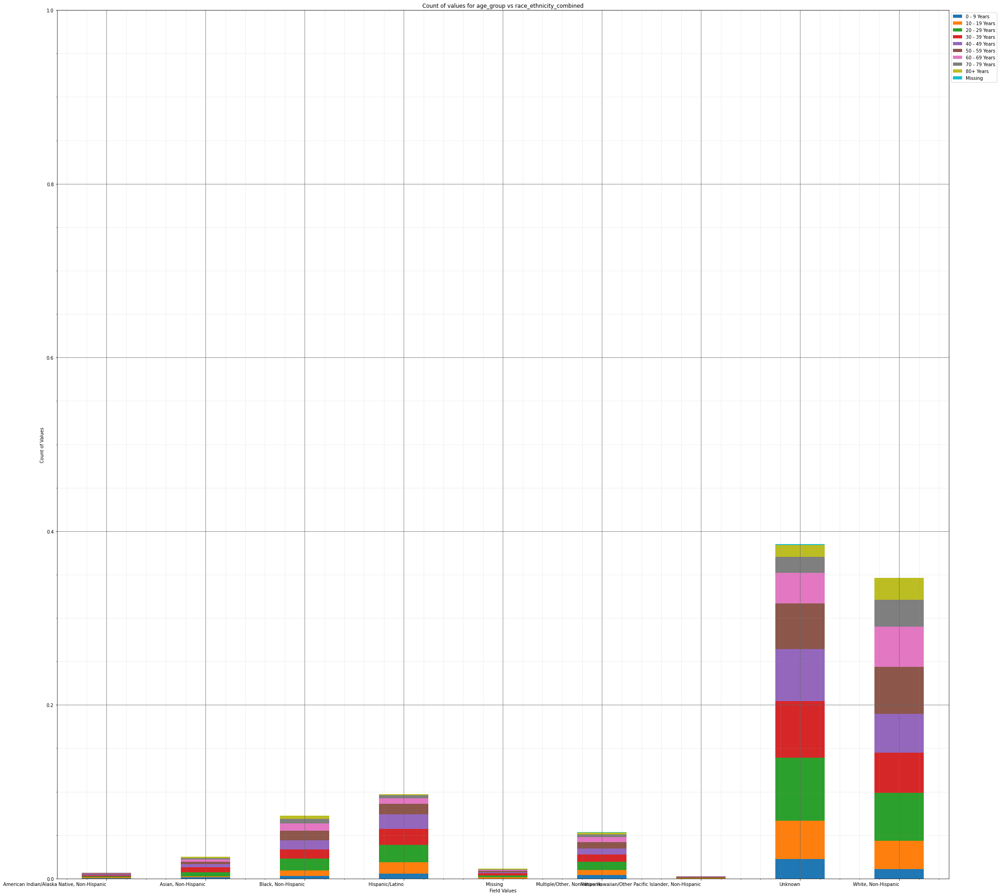



----------------------


Grouping over race_ethnicity_combined|hosp_yn results in:



,race_ethnicity_combined,hosp_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Missing,9,0.094054
1,"American Indian/Alaska Native, Non-Hispanic",No,39,0.407566
2,"American Indian/Alaska Native, Non-Hispanic",OTH,0,0.000000
3,"American Indian/Alaska Native, Non-Hispanic",Unknown,5,0.052252
4,"American Indian/Alaska Native, Non-Hispanic",Yes,13,0.135855
5,"Asian, Non-Hispanic",Missing,65,0.679277
6,"Asian, Non-Hispanic",No,115,1.201797
7,"Asian, Non-Hispanic",OTH,0,0.000000
8,"Asian, Non-Hispanic",Unknown,38,0.397116
9,"Asian, Non-Hispanic",Yes,23,0.240359


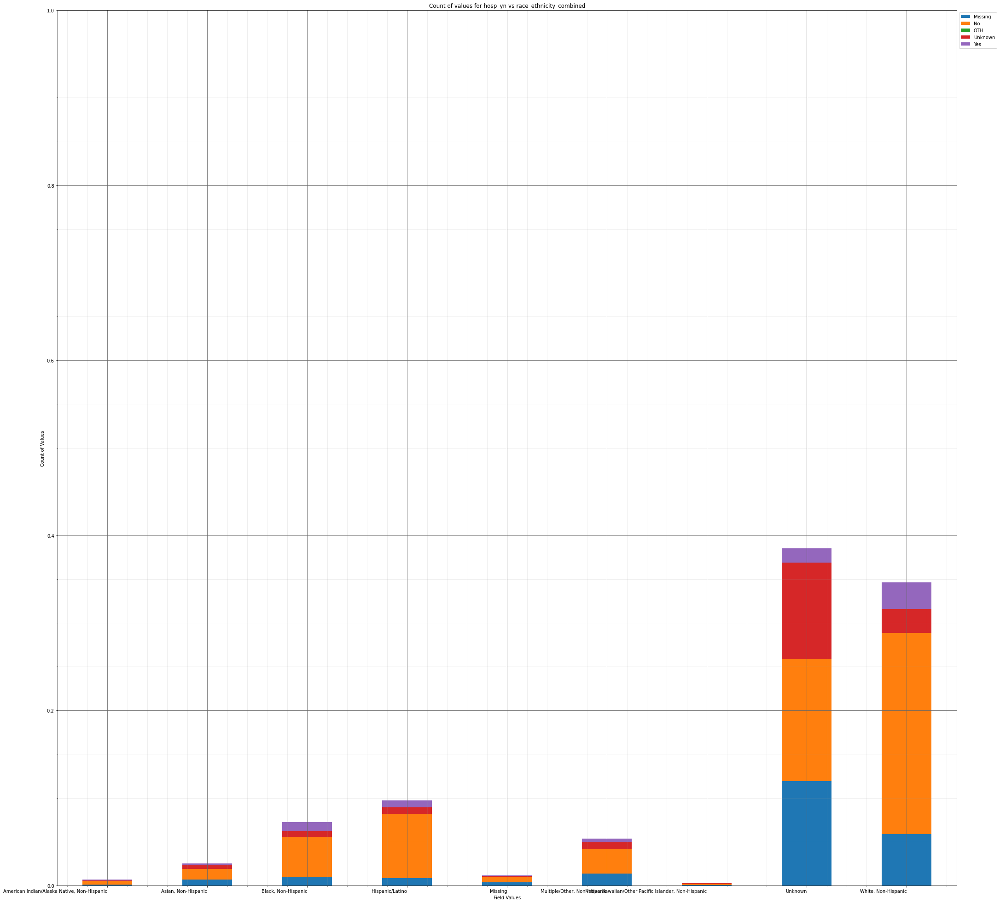



----------------------


Grouping over race_ethnicity_combined|icu_yn results in:



,race_ethnicity_combined,icu_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Missing,52,0.543421
1,"American Indian/Alaska Native, Non-Hispanic",No,7,0.073153
2,"American Indian/Alaska Native, Non-Hispanic",Unknown,5,0.052252
3,"American Indian/Alaska Native, Non-Hispanic",Yes,2,0.020901
4,"Asian, Non-Hispanic",Missing,202,2.110983
5,"Asian, Non-Hispanic",No,14,0.146306
6,"Asian, Non-Hispanic",Unknown,21,0.219459
7,"Asian, Non-Hispanic",Yes,4,0.041802
8,"Black, Non-Hispanic",Missing,482,5.037099
9,"Black, Non-Hispanic",No,68,0.710628


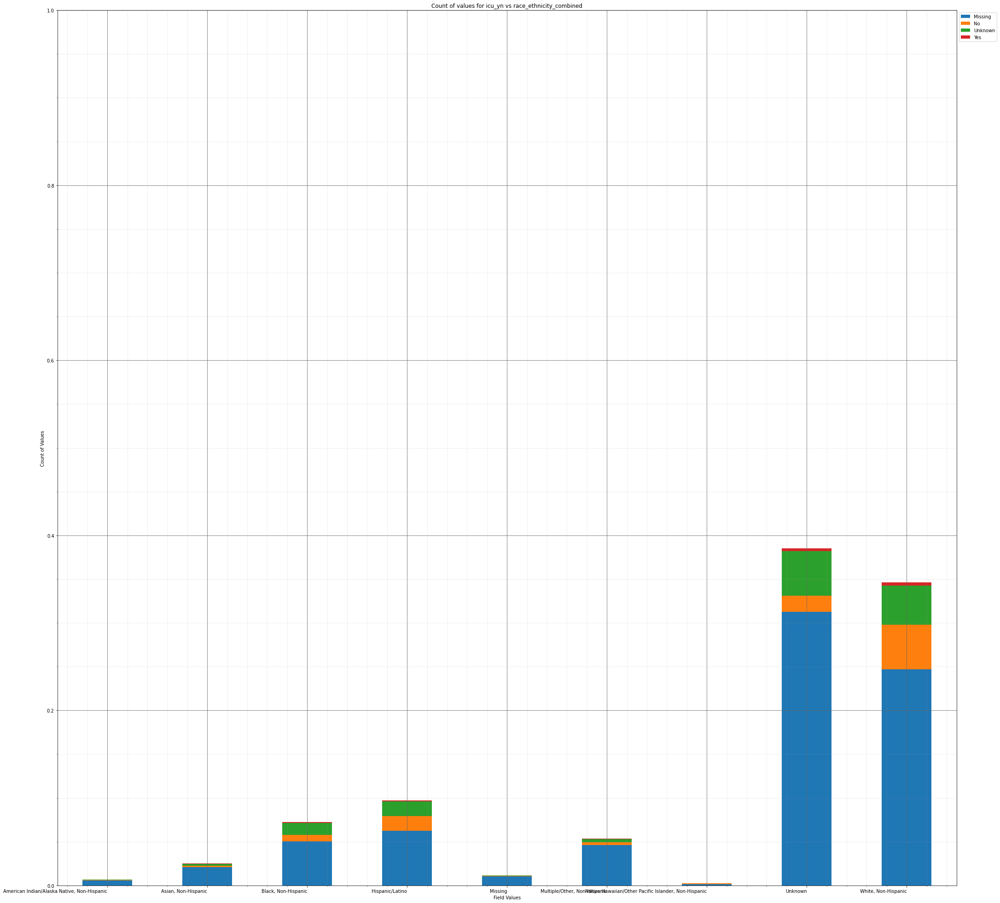



----------------------


Grouping over race_ethnicity_combined|death_yn results in:



,race_ethnicity_combined,death_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",No,60,0.627025
1,"American Indian/Alaska Native, Non-Hispanic",Yes,6,0.062702
2,"Asian, Non-Hispanic",No,231,2.414045
3,"Asian, Non-Hispanic",Yes,10,0.104504
4,"Black, Non-Hispanic",No,656,6.855471
5,"Black, Non-Hispanic",Yes,38,0.397116
6,Hispanic/Latino,No,901,9.415822
7,Hispanic/Latino,Yes,28,0.292612
8,Missing,No,102,1.065942
9,Missing,Yes,7,0.073153


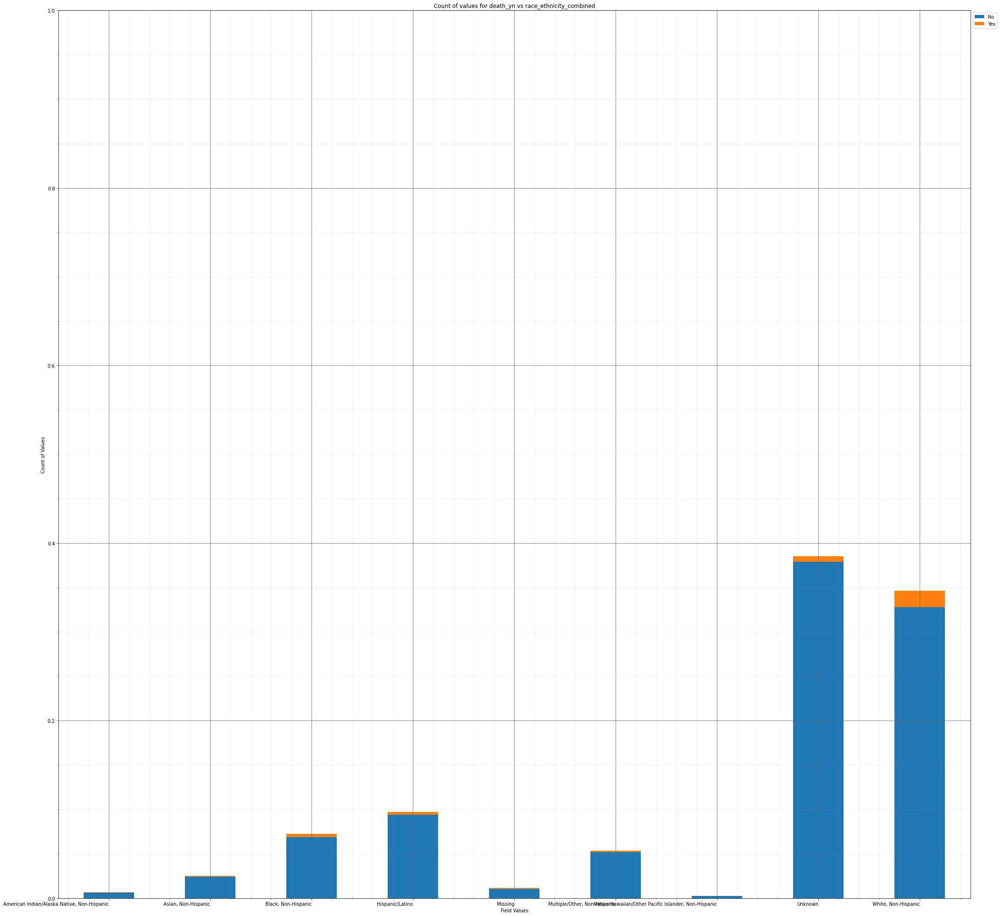



----------------------


Grouping over race_ethnicity_combined|medcond_yn results in:



,race_ethnicity_combined,medcond_yn,Rows,% Frequency
0,"American Indian/Alaska Native, Non-Hispanic",Missing,51,0.532971
1,"American Indian/Alaska Native, Non-Hispanic",No,4,0.041802
2,"American Indian/Alaska Native, Non-Hispanic",Unknown,4,0.041802
3,"American Indian/Alaska Native, Non-Hispanic",Yes,7,0.073153
4,"Asian, Non-Hispanic",Missing,200,2.090083
5,"Asian, Non-Hispanic",No,17,0.177657
6,"Asian, Non-Hispanic",Unknown,6,0.062702
7,"Asian, Non-Hispanic",Yes,18,0.188107
8,"Black, Non-Hispanic",Missing,438,4.577281
9,"Black, Non-Hispanic",No,69,0.721078


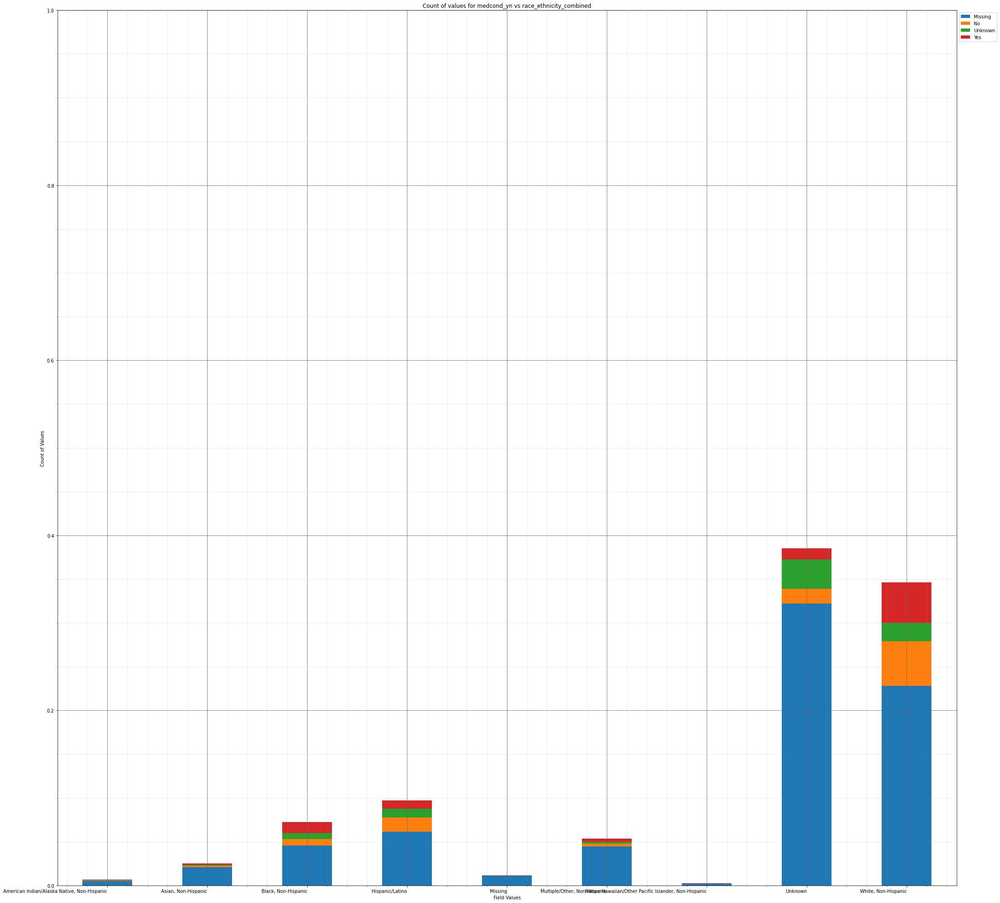



----------------------


Grouping over hosp_yn|current_status results in:



,hosp_yn,current_status,Rows,% Frequency
0,Missing,Laboratory-confirmed case,1957,20.451458
1,Missing,Probable Case,165,1.724318
2,No,Laboratory-confirmed case,4752,49.660362
3,No,Probable Case,420,4.389173
4,OTH,Laboratory-confirmed case,1,0.010450
5,OTH,Probable Case,0,0.000000
6,Unknown,Laboratory-confirmed case,1521,15.895078
7,Unknown,Probable Case,54,0.564322
8,Yes,Laboratory-confirmed case,674,7.043578
9,Yes,Probable Case,25,0.261260


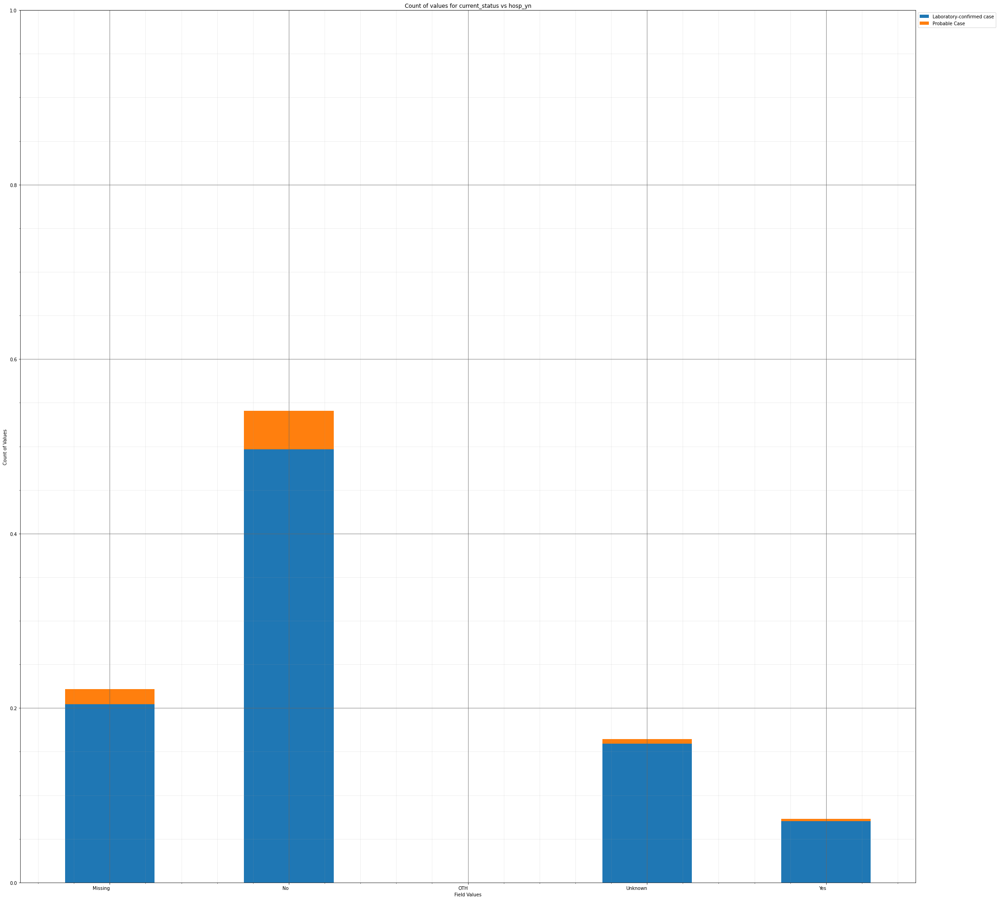



----------------------


Grouping over hosp_yn|sex results in:



,hosp_yn,sex,Rows,% Frequency
0,Missing,Female,1123,11.735814
1,Missing,Male,971,10.147351
2,Missing,Missing,2,0.020901
3,Missing,Unknown,26,0.271711
4,No,Female,2829,29.564218
5,No,Male,2316,24.203156
6,No,Missing,5,0.052252
7,No,Unknown,22,0.229909
8,OTH,Female,0,0.000000
9,OTH,Male,1,0.010450


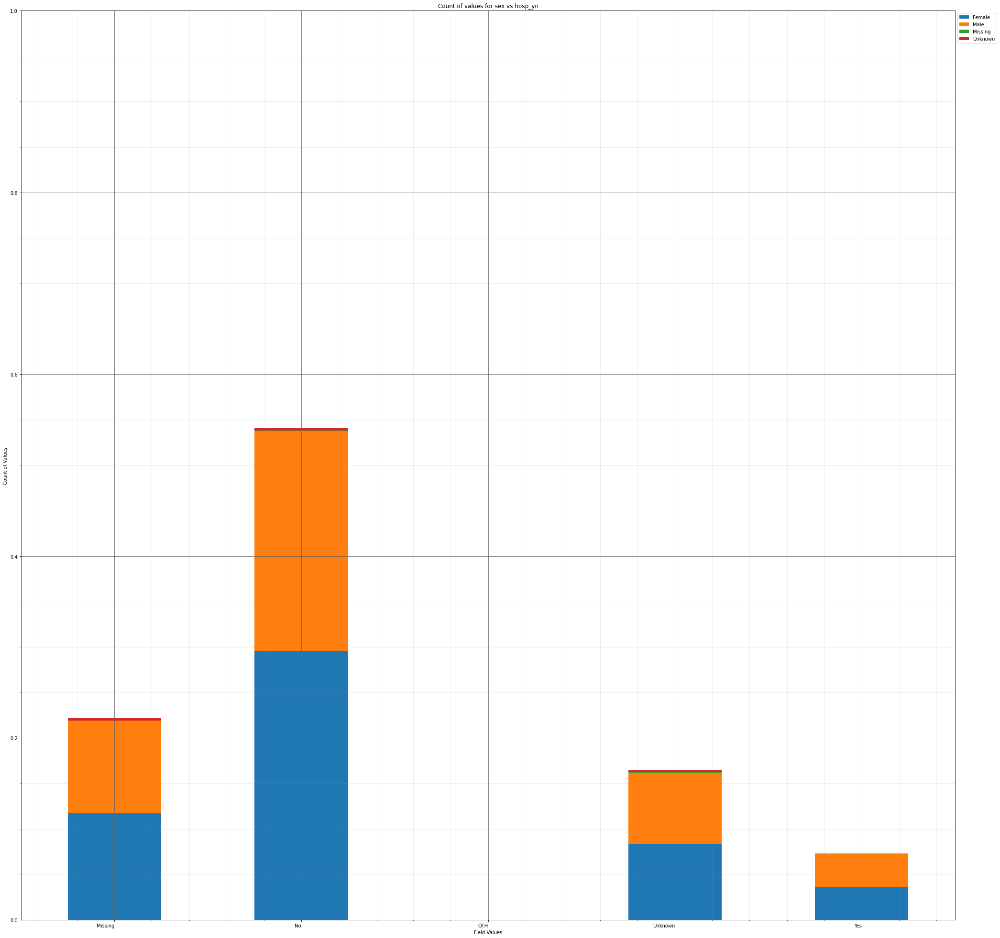



----------------------


Grouping over hosp_yn|age_group results in:



,hosp_yn,age_group,Rows,% Frequency
0,Missing,0 - 9 Years,95,0.992789
1,Missing,10 - 19 Years,221,2.309541
2,Missing,20 - 29 Years,413,4.316020
3,Missing,30 - 39 Years,360,3.762149
4,Missing,40 - 49 Years,323,3.375483
5,Missing,50 - 59 Years,305,3.187376
6,Missing,60 - 69 Years,203,2.121434
7,Missing,70 - 79 Years,113,1.180897
8,Missing,80+ Years,86,0.898736
9,Missing,Missing,3,0.031351


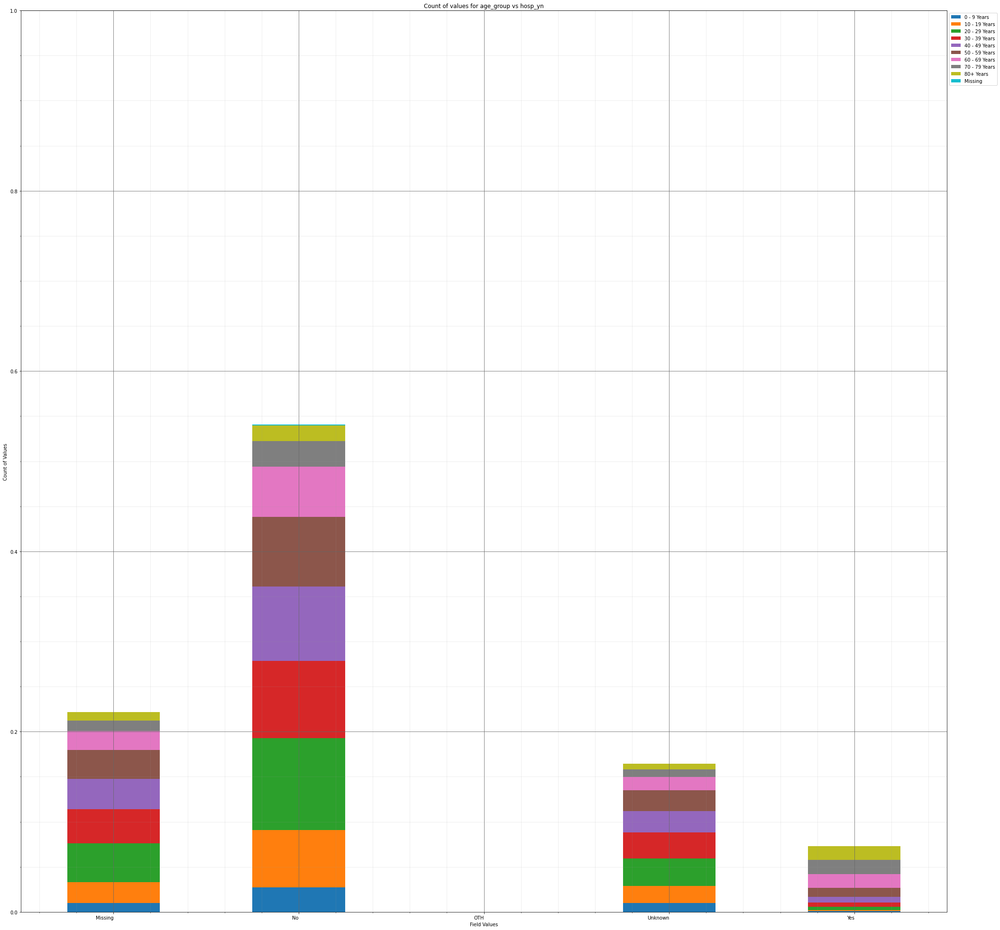



----------------------


Grouping over hosp_yn|race_ethnicity_combined results in:



,hosp_yn,race_ethnicity_combined,Rows,% Frequency
0,Missing,"American Indian/Alaska Native, Non-Hispanic",9,0.094054
1,Missing,"Asian, Non-Hispanic",65,0.679277
2,Missing,"Black, Non-Hispanic",93,0.971888
3,Missing,Hispanic/Latino,80,0.836033
4,Missing,Missing,35,0.365764
5,Missing,"Multiple/Other, Non-Hispanic",132,1.379454
6,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",5,0.052252
7,Missing,Unknown,1143,11.944822
8,Missing,"White, Non-Hispanic",560,5.852231
9,No,"American Indian/Alaska Native, Non-Hispanic",39,0.407566


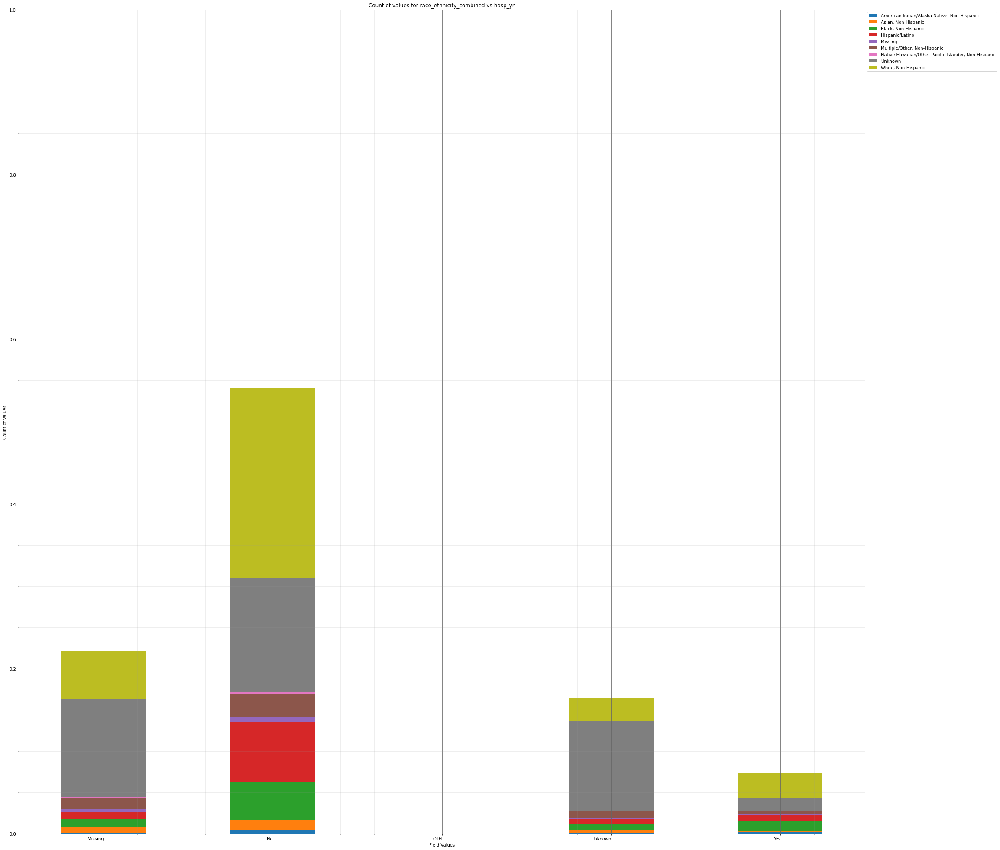



----------------------


Grouping over hosp_yn|icu_yn results in:



,hosp_yn,icu_yn,Rows,% Frequency
0,Missing,Missing,2107,22.019020
1,Missing,No,14,0.146306
2,Missing,Unknown,1,0.010450
3,Missing,Yes,0,0.000000
4,No,Missing,3766,39.356255
5,No,No,799,8.349880
6,No,Unknown,606,6.332950
7,No,Yes,1,0.010450
8,OTH,Missing,1,0.010450
9,OTH,No,0,0.000000


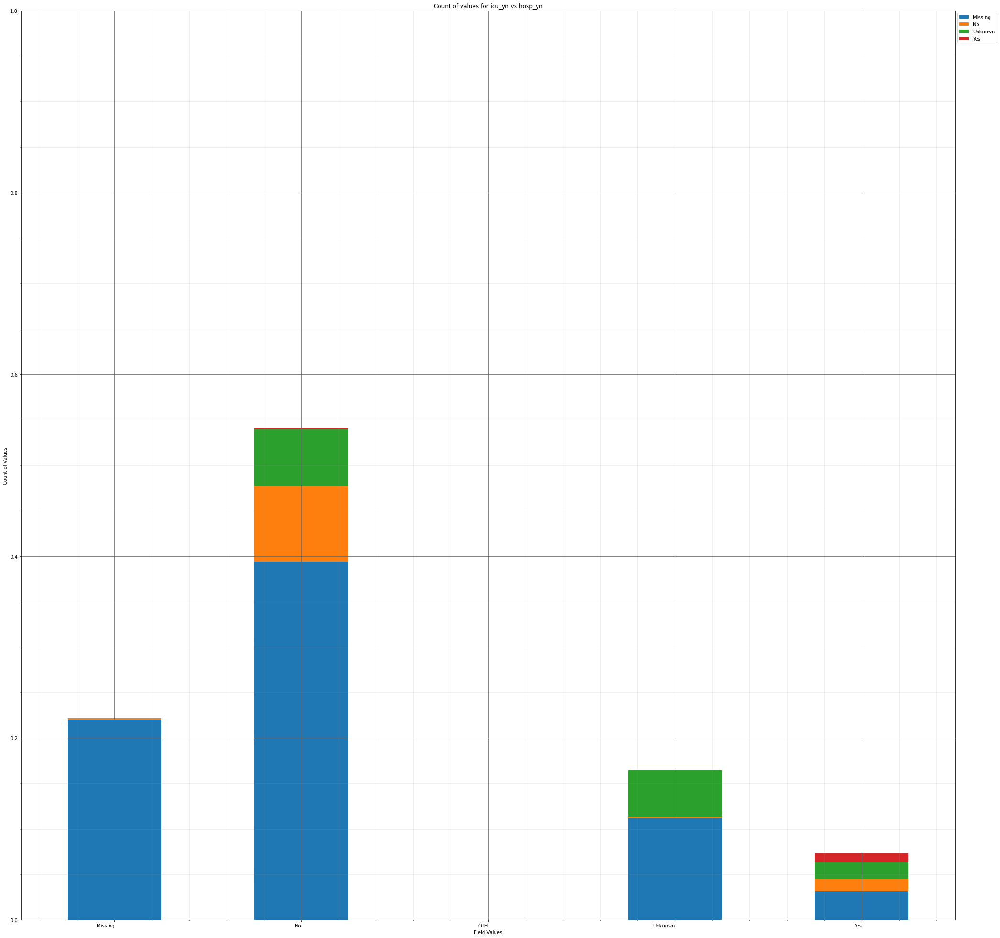



----------------------


Grouping over hosp_yn|death_yn results in:



,hosp_yn,death_yn,Rows,% Frequency
0,Missing,No,2077,21.705507
1,Missing,Yes,45,0.470269
2,No,No,5124,53.547915
3,No,Yes,48,0.501620
4,OTH,No,1,0.010450
5,OTH,Yes,0,0.000000
6,Unknown,No,1539,16.083185
7,Unknown,Yes,36,0.376215
8,Yes,No,493,5.152054
9,Yes,Yes,206,2.152785


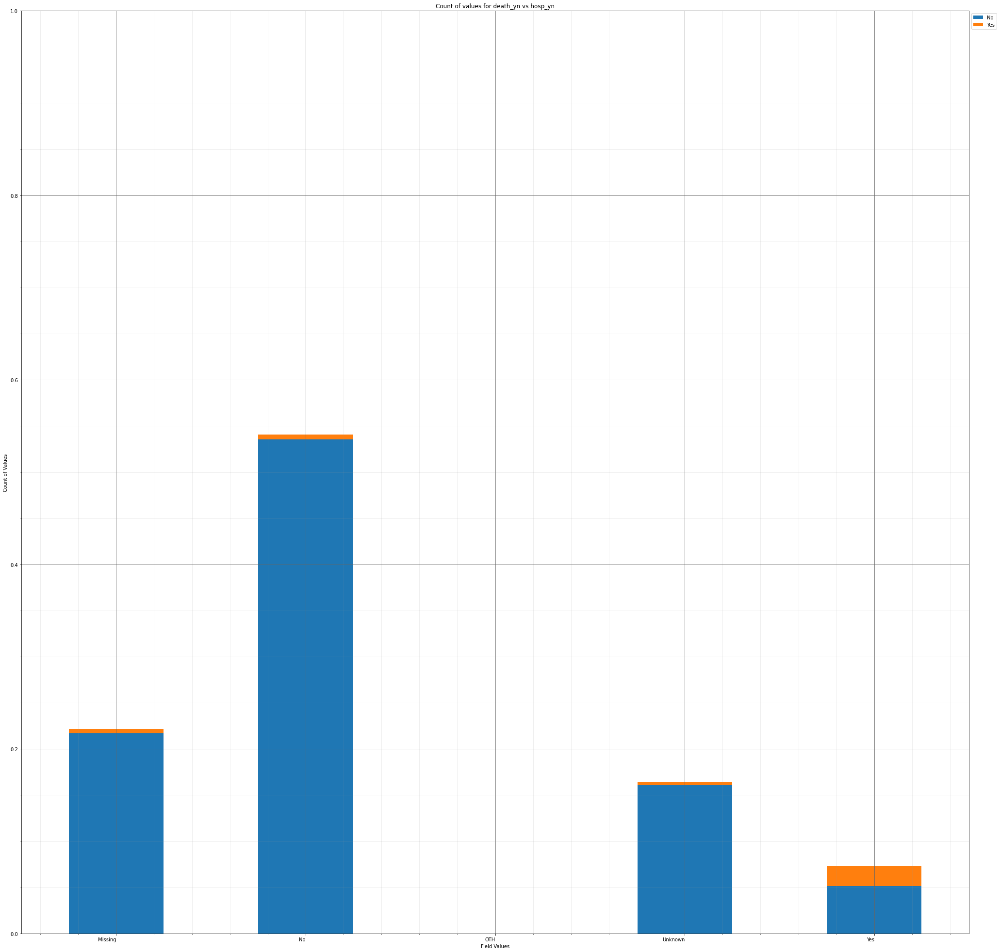



----------------------


Grouping over hosp_yn|medcond_yn results in:



,hosp_yn,medcond_yn,Rows,% Frequency
0,Missing,Missing,1843,19.260111
1,Missing,No,191,1.996029
2,Missing,Unknown,5,0.052252
3,Missing,Yes,83,0.867384
4,No,Missing,3670,38.353015
5,No,No,695,7.263037
6,No,Unknown,251,2.623054
7,No,Yes,556,5.810430
8,OTH,Missing,0,0.000000
9,OTH,No,0,0.000000


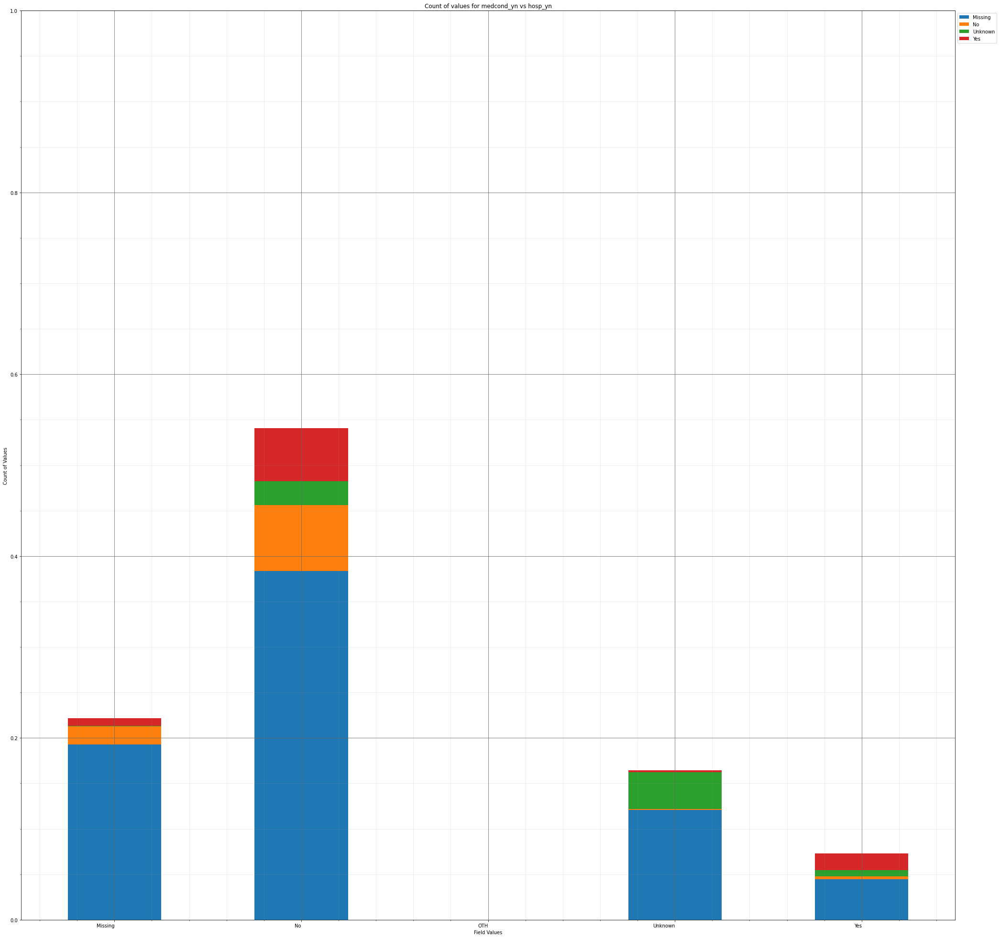



----------------------


Grouping over icu_yn|current_status results in:



,icu_yn,current_status,Rows,% Frequency
0,Missing,Laboratory-confirmed case,6788,70.937402
1,Missing,Probable Case,456,4.765388
2,No,Laboratory-confirmed case,879,9.185913
3,No,Probable Case,79,0.825583
4,Unknown,Laboratory-confirmed case,1147,11.986623
5,Unknown,Probable Case,128,1.337653
6,Yes,Laboratory-confirmed case,91,0.950988
7,Yes,Probable Case,1,0.010450


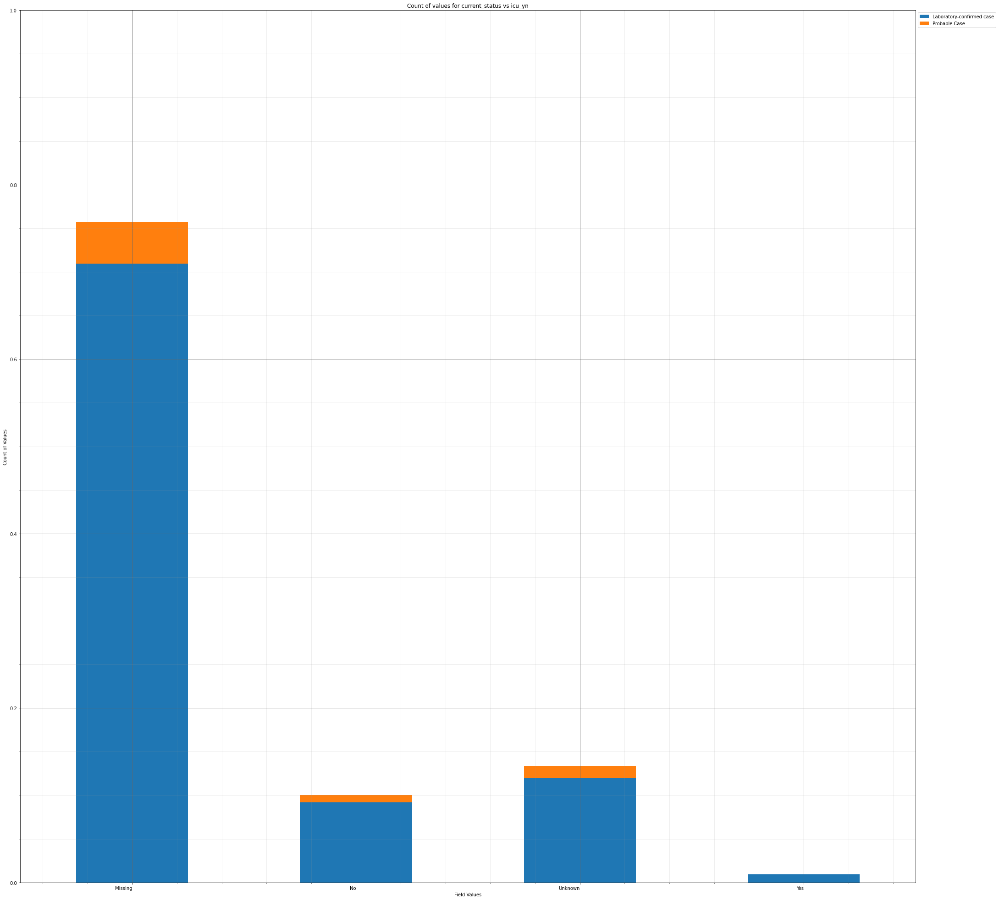



----------------------


Grouping over icu_yn|sex results in:



,icu_yn,sex,Rows,% Frequency
0,Missing,Female,3849,40.223639
1,Missing,Male,3328,34.778974
2,Missing,Missing,5,0.052252
3,Missing,Unknown,62,0.647926
4,No,Female,512,5.350611
5,No,Male,442,4.619082
6,No,Missing,0,0.000000
7,No,Unknown,4,0.041802
8,Unknown,Female,694,7.252586
9,Unknown,Male,570,5.956735


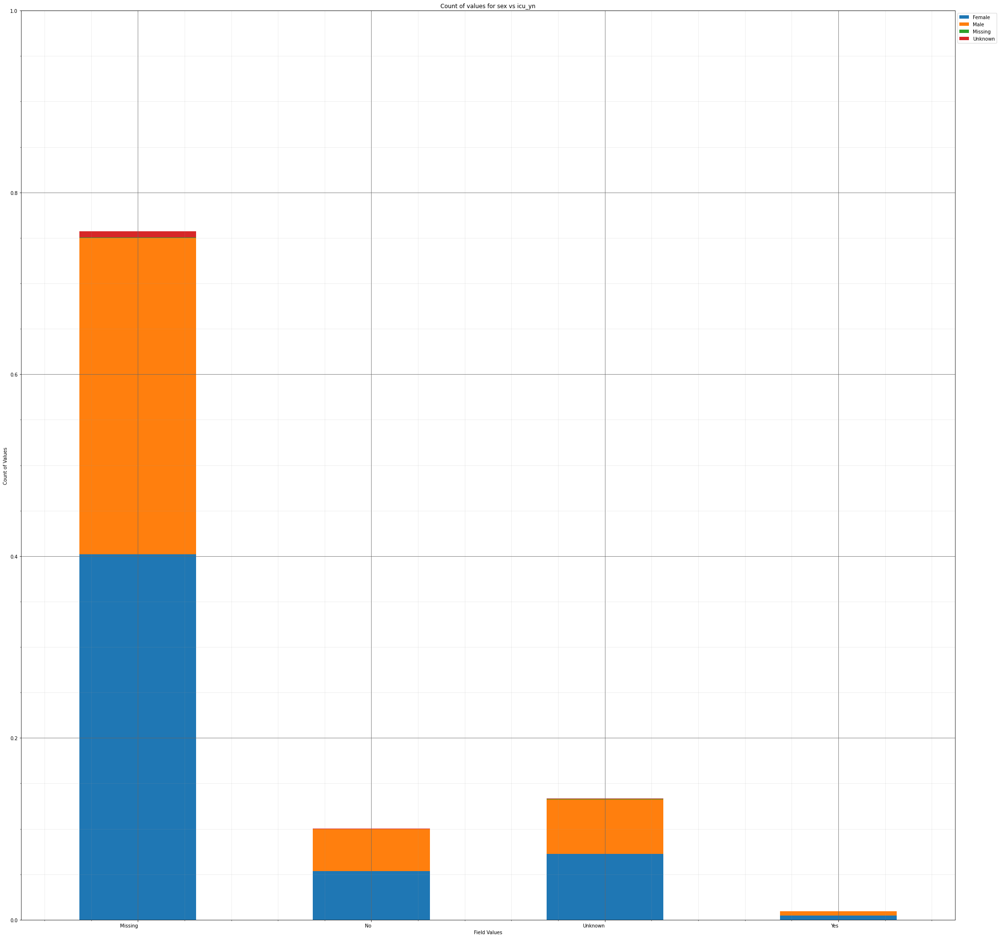



----------------------


Grouping over icu_yn|age_group results in:



,icu_yn,age_group,Rows,% Frequency
0,Missing,0 - 9 Years,373,3.898004
1,Missing,10 - 19 Years,779,8.140872
2,Missing,20 - 29 Years,1334,13.940851
3,Missing,30 - 39 Years,1169,12.216533
4,Missing,40 - 49 Years,1097,11.464103
5,Missing,50 - 59 Years,1024,10.701223
6,Missing,60 - 69 Years,735,7.681053
7,Missing,70 - 79 Years,429,4.483227
8,Missing,80+ Years,291,3.041070
9,Missing,Missing,13,0.135855


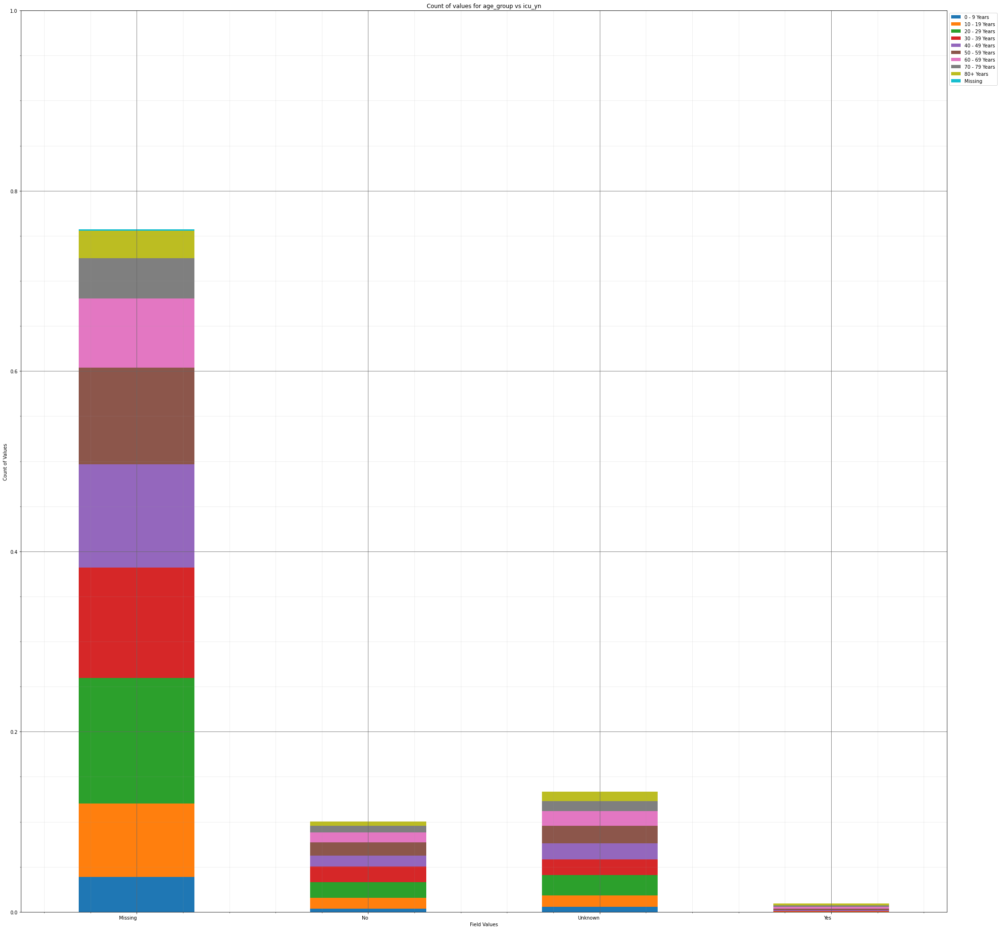



----------------------


Grouping over icu_yn|race_ethnicity_combined results in:



,icu_yn,race_ethnicity_combined,Rows,% Frequency
0,Missing,"American Indian/Alaska Native, Non-Hispanic",52,0.543421
1,Missing,"Asian, Non-Hispanic",202,2.110983
2,Missing,"Black, Non-Hispanic",482,5.037099
3,Missing,Hispanic/Latino,599,6.259797
4,Missing,Missing,100,1.045041
5,Missing,"Multiple/Other, Non-Hispanic",441,4.608632
6,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",16,0.167207
7,Missing,Unknown,2990,31.246734
8,Missing,"White, Non-Hispanic",2362,24.683875
9,No,"American Indian/Alaska Native, Non-Hispanic",7,0.073153


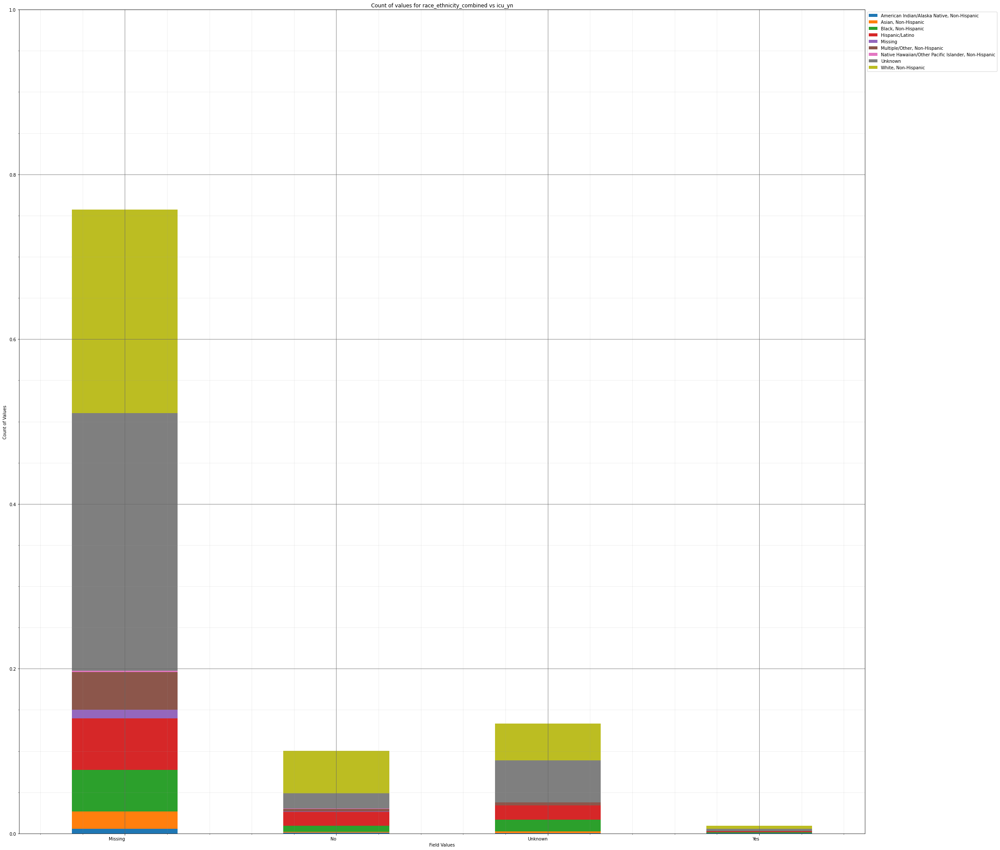



----------------------


Grouping over icu_yn|hosp_yn results in:



,icu_yn,hosp_yn,Rows,% Frequency
0,Missing,Missing,2107,22.019020
1,Missing,No,3766,39.356255
2,Missing,OTH,1,0.010450
3,Missing,Unknown,1071,11.192392
4,Missing,Yes,299,3.124673
5,No,Missing,14,0.146306
6,No,No,799,8.349880
7,No,OTH,0,0.000000
8,No,Unknown,13,0.135855
9,No,Yes,132,1.379454


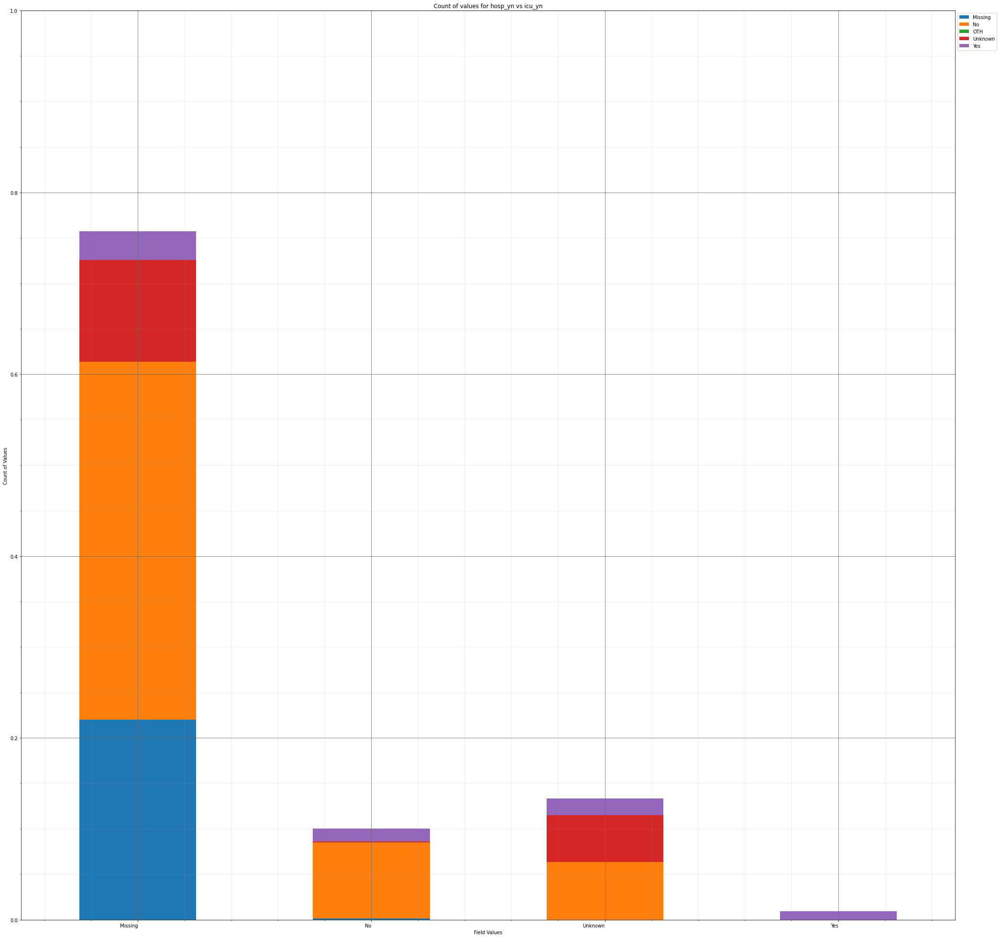



----------------------


Grouping over icu_yn|death_yn results in:



,icu_yn,death_yn,Rows,% Frequency
0,Missing,No,7080,73.988923
1,Missing,Yes,164,1.713868
2,No,No,929,9.708433
3,No,Yes,29,0.303062
4,Unknown,No,1182,12.352388
5,Unknown,Yes,93,0.971888
6,Yes,No,43,0.449368
7,Yes,Yes,49,0.512070


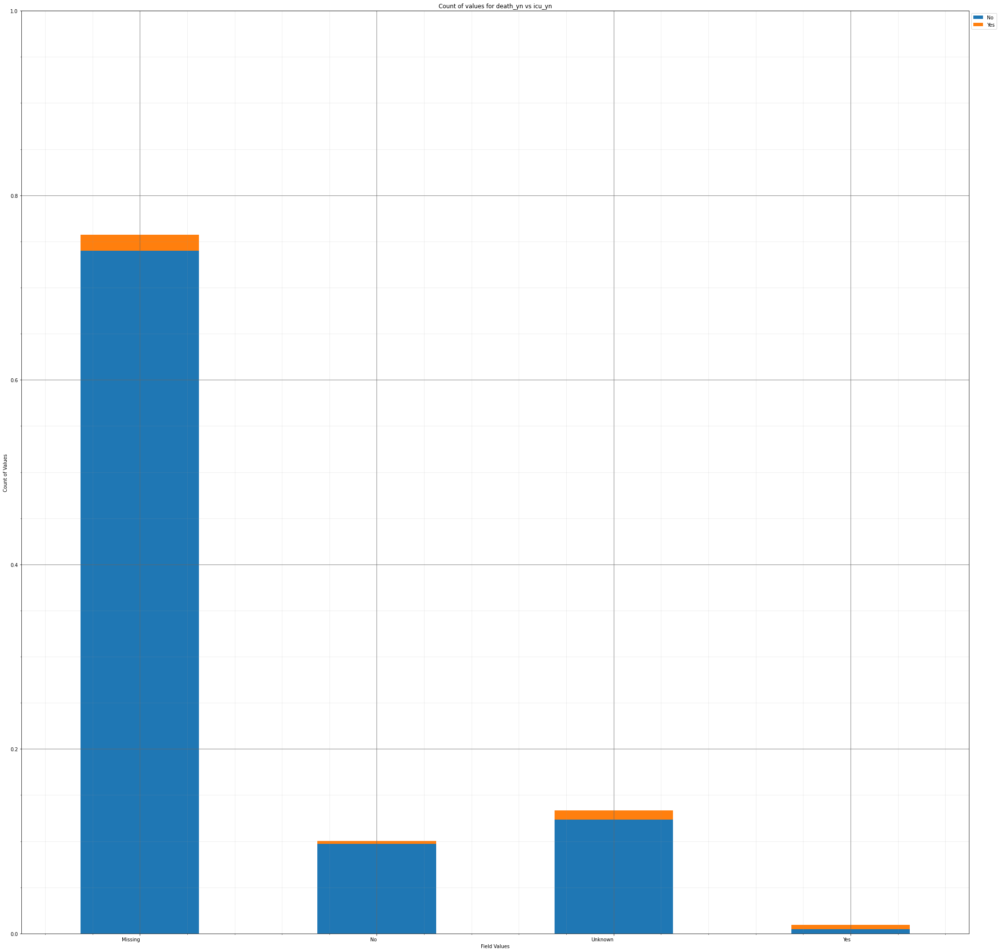



----------------------


Grouping over icu_yn|medcond_yn results in:



,icu_yn,medcond_yn,Rows,% Frequency
0,Missing,Missing,6621,69.192183
1,Missing,No,310,3.239628
2,Missing,Unknown,35,0.365764
3,Missing,Yes,278,2.905215
4,No,Missing,216,2.257289
5,No,No,402,4.201066
6,No,Unknown,34,0.355314
7,No,Yes,306,3.197826
8,Unknown,Missing,215,2.246839
9,Unknown,No,212,2.215488


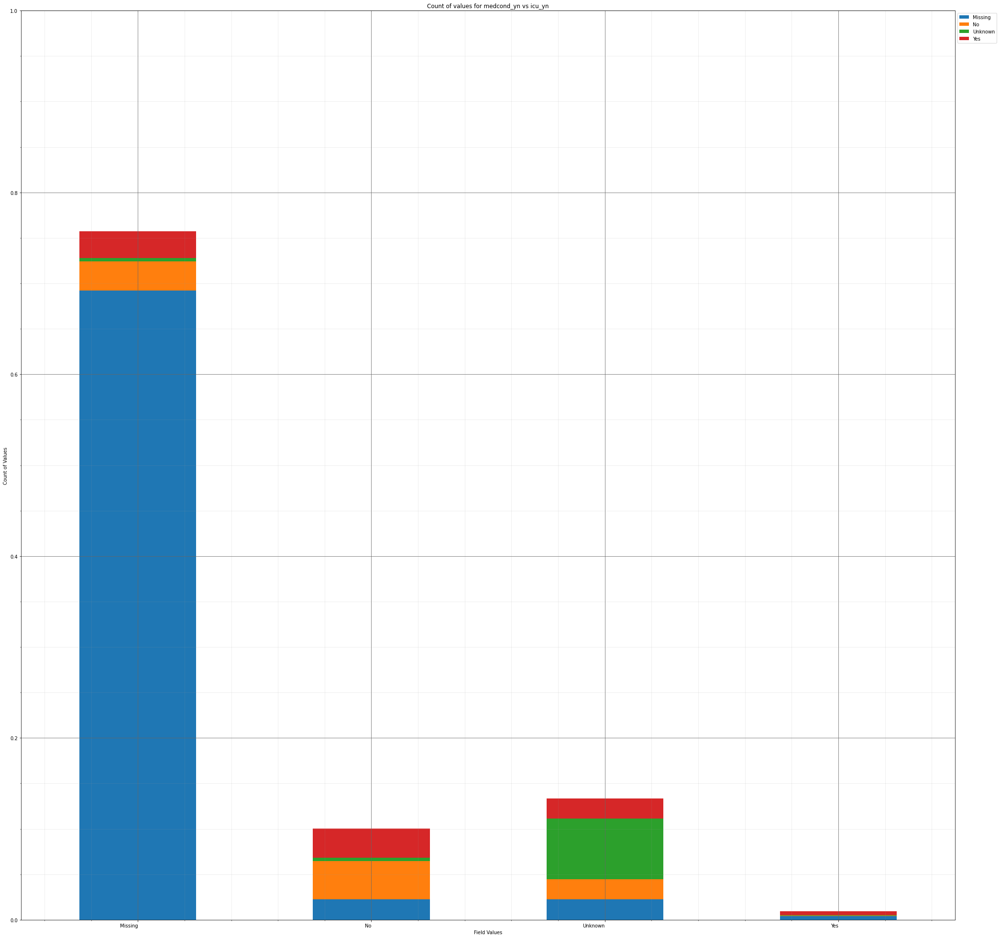



----------------------


Grouping over death_yn|current_status results in:



,death_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,8597,89.842199
1,No,Probable Case,637,6.656913
2,Yes,Laboratory-confirmed case,308,3.218727
3,Yes,Probable Case,27,0.282161


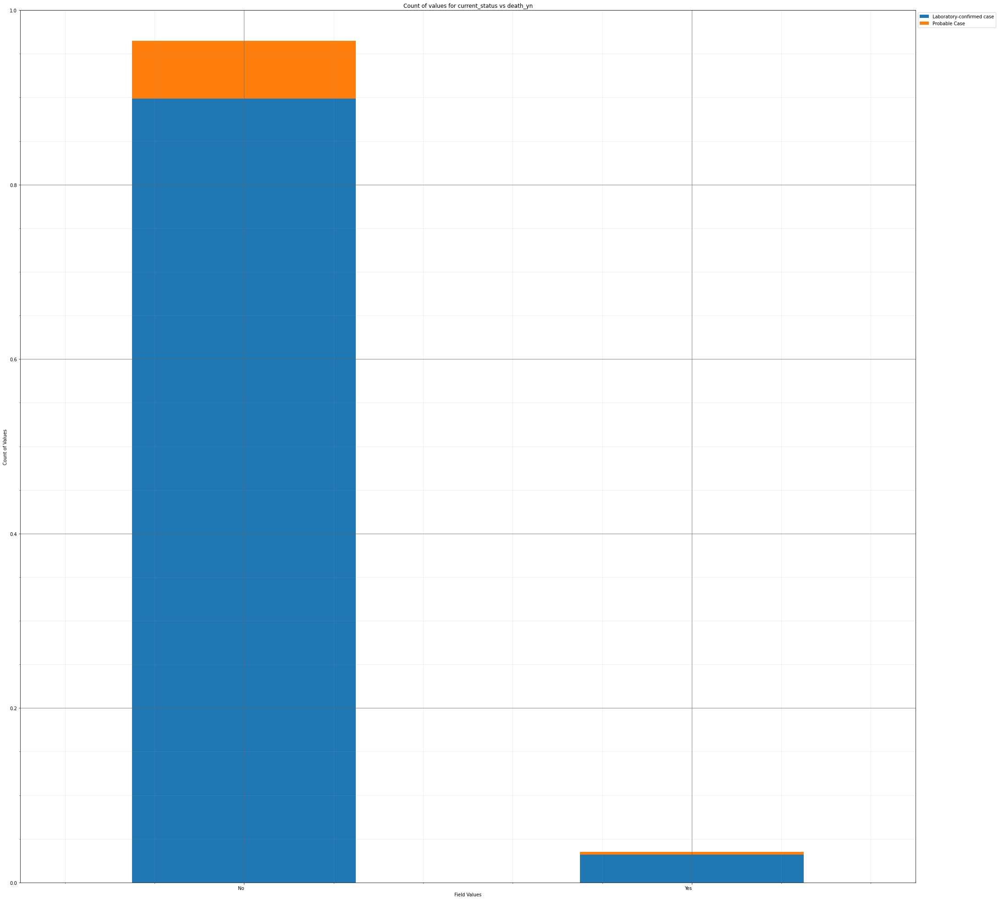



----------------------


Grouping over death_yn|sex results in:



,death_yn,sex,Rows,% Frequency
0,No,Female,4930,51.520535
1,No,Male,4224,44.142544
2,No,Missing,12,0.125405
3,No,Unknown,68,0.710628
4,Yes,Female,167,1.745219
5,Yes,Male,165,1.724318
6,Yes,Missing,1,0.010450
7,Yes,Unknown,2,0.020901


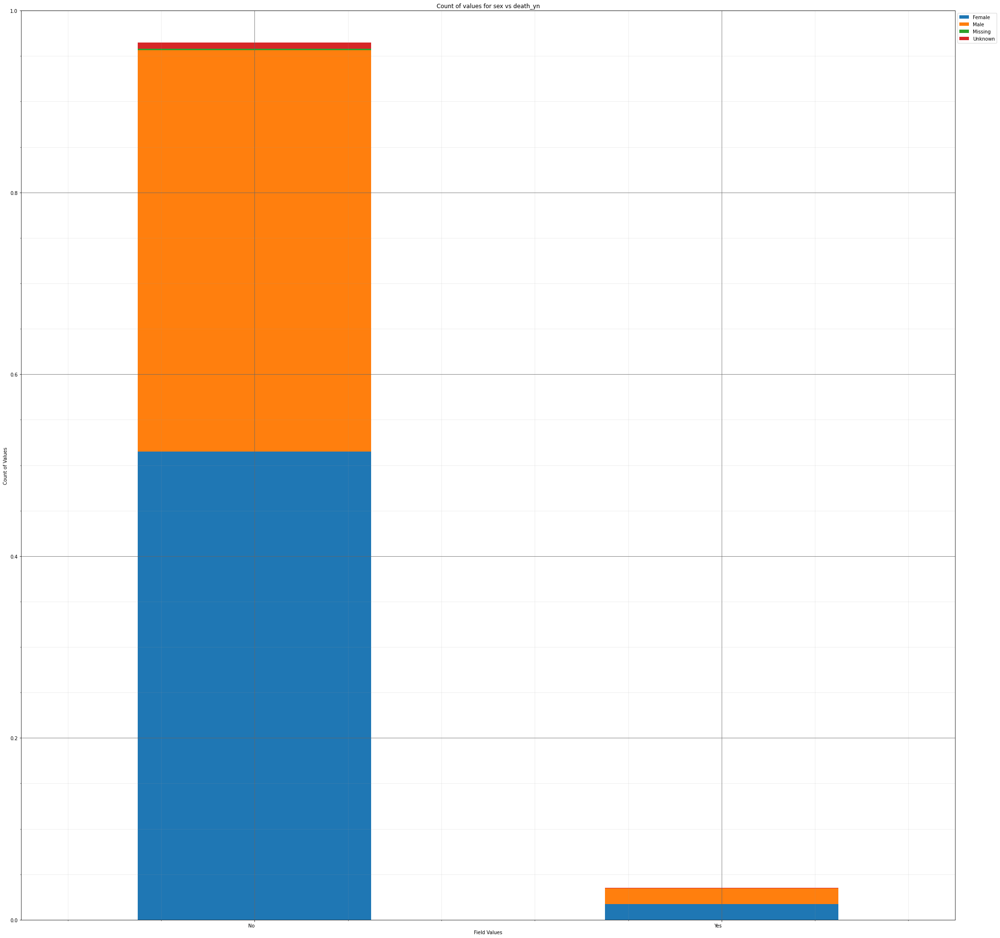



----------------------


Grouping over death_yn|age_group results in:



,death_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,458,4.786289
1,No,10 - 19 Years,1017,10.628070
2,No,20 - 29 Years,1720,17.974710
3,No,30 - 39 Years,1503,15.706970
4,No,40 - 49 Years,1386,14.484272
5,No,50 - 59 Years,1343,14.034904
6,No,60 - 69 Years,956,9.990595
7,No,70 - 79 Years,532,5.559620
8,No,80+ Years,306,3.197826
9,No,Missing,13,0.135855


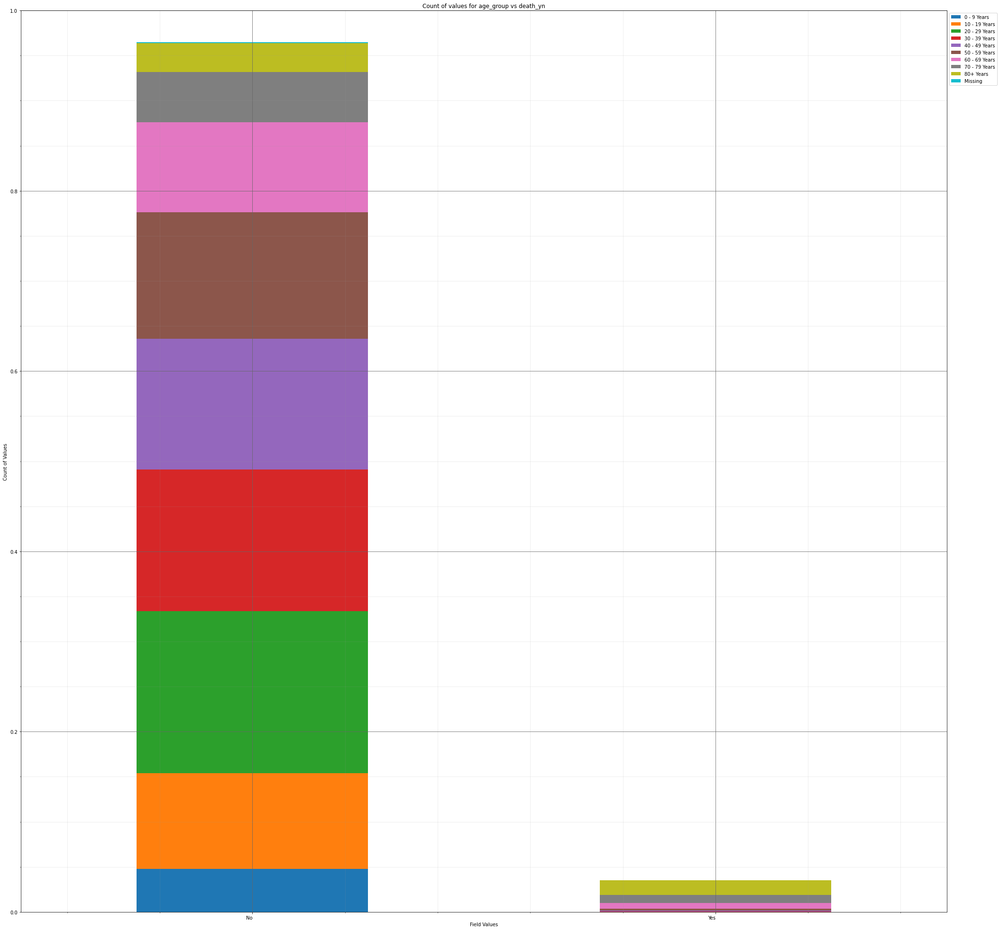



----------------------


Grouping over death_yn|race_ethnicity_combined results in:



,death_yn,race_ethnicity_combined,Rows,% Frequency
0,No,"American Indian/Alaska Native, Non-Hispanic",60,0.627025
1,No,"Asian, Non-Hispanic",231,2.414045
2,No,"Black, Non-Hispanic",656,6.855471
3,No,Hispanic/Latino,901,9.415822
4,No,Missing,102,1.065942
5,No,"Multiple/Other, Non-Hispanic",499,5.214756
6,No,"Native Hawaiian/Other Pacific Islander, Non-Hi...",23,0.240359
7,No,Unknown,3625,37.882746
8,No,"White, Non-Hispanic",3137,32.782945
9,Yes,"American Indian/Alaska Native, Non-Hispanic",6,0.062702


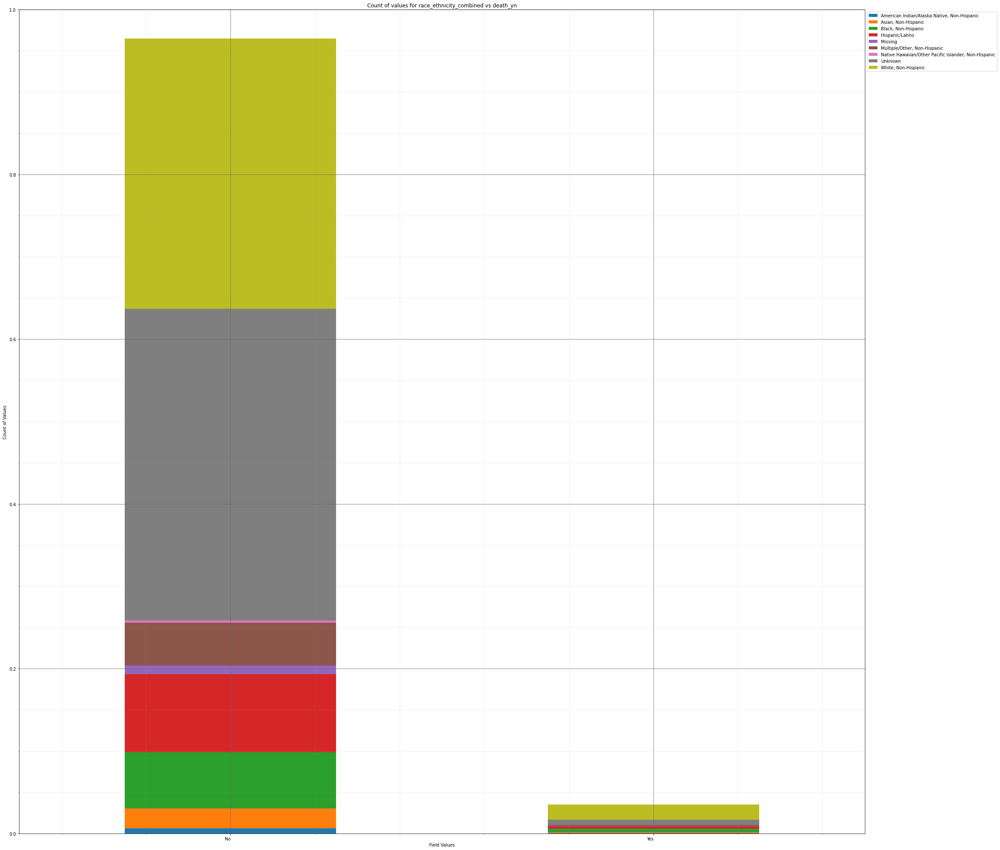



----------------------


Grouping over death_yn|hosp_yn results in:



,death_yn,hosp_yn,Rows,% Frequency
0,No,Missing,2077,21.705507
1,No,No,5124,53.547915
2,No,OTH,1,0.010450
3,No,Unknown,1539,16.083185
4,No,Yes,493,5.152054
5,Yes,Missing,45,0.470269
6,Yes,No,48,0.501620
7,Yes,OTH,0,0.000000
8,Yes,Unknown,36,0.376215
9,Yes,Yes,206,2.152785


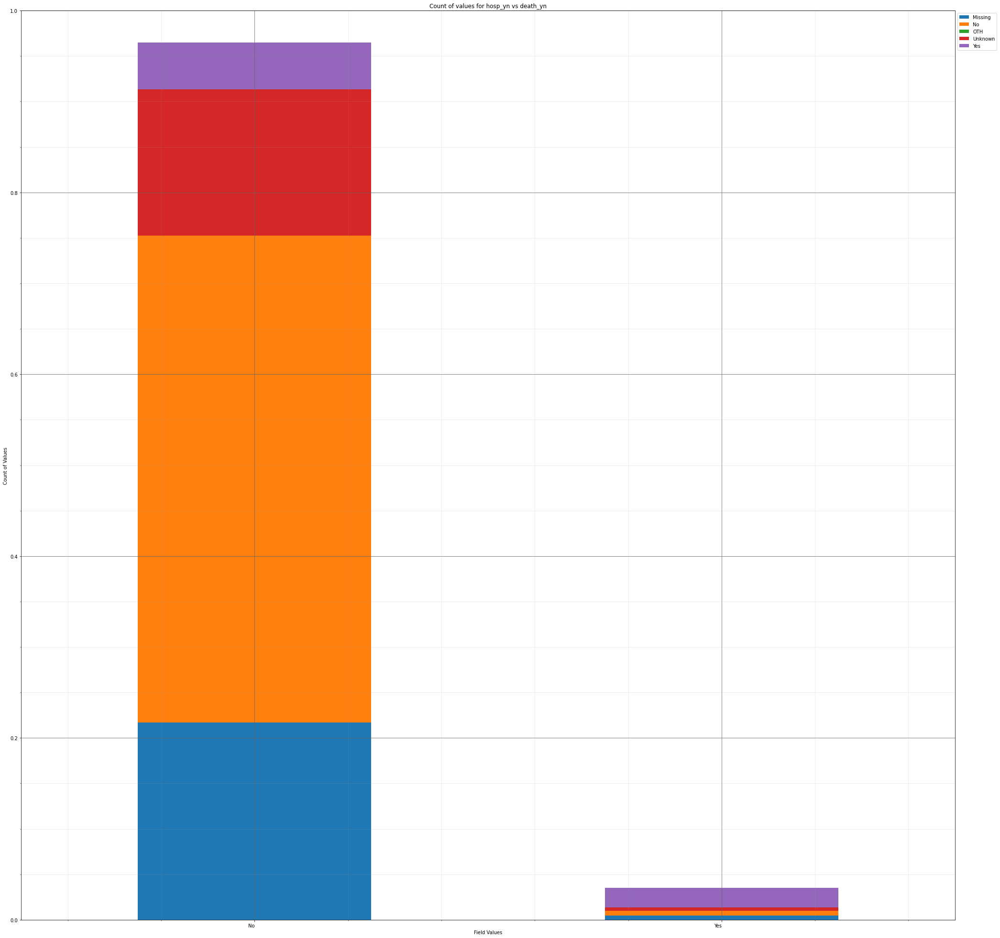



----------------------


Grouping over death_yn|icu_yn results in:



,death_yn,icu_yn,Rows,% Frequency
0,No,Missing,7080,73.988923
1,No,No,929,9.708433
2,No,Unknown,1182,12.352388
3,No,Yes,43,0.449368
4,Yes,Missing,164,1.713868
5,Yes,No,29,0.303062
6,Yes,Unknown,93,0.971888
7,Yes,Yes,49,0.512070


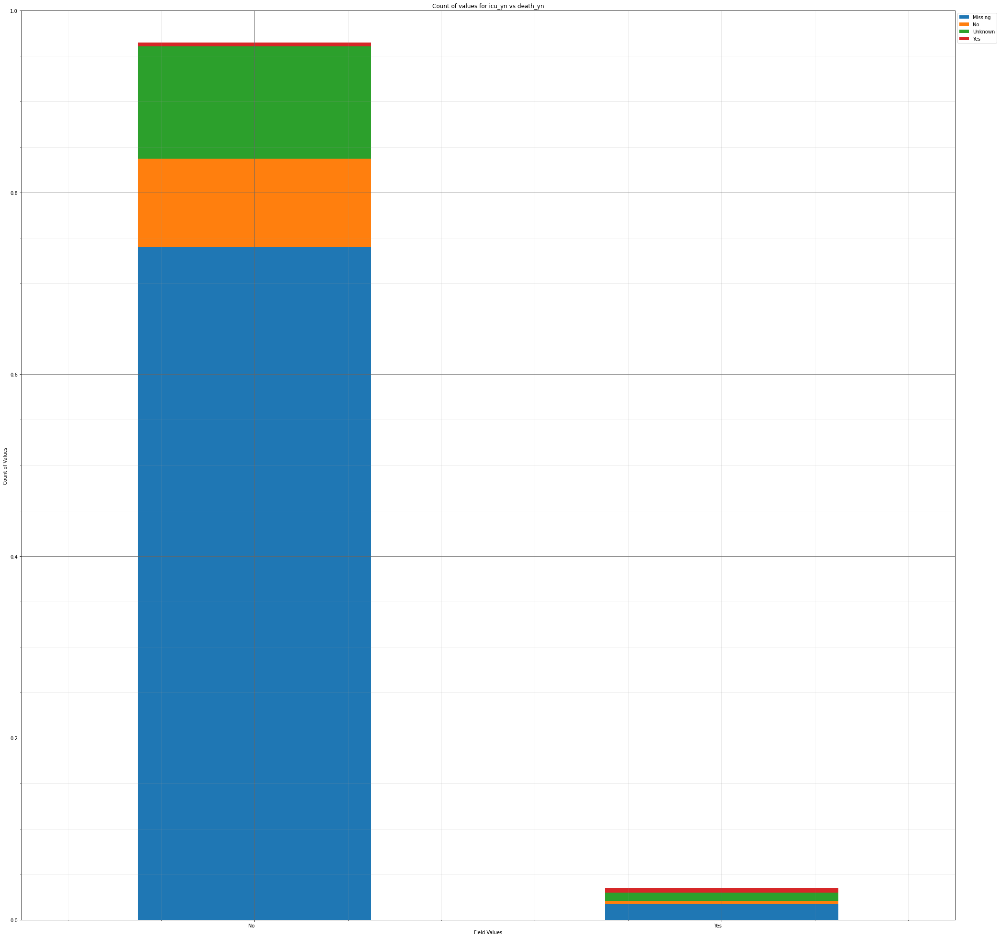



----------------------


Grouping over death_yn|medcond_yn results in:



,death_yn,medcond_yn,Rows,% Frequency
0,No,Missing,6907,72.181001
1,No,No,923,9.645731
2,No,Unknown,662,6.918173
3,No,Yes,742,7.754206
4,Yes,Missing,184,1.922876
5,Yes,No,8,0.083603
6,Yes,Unknown,49,0.512070
7,Yes,Yes,94,0.982339


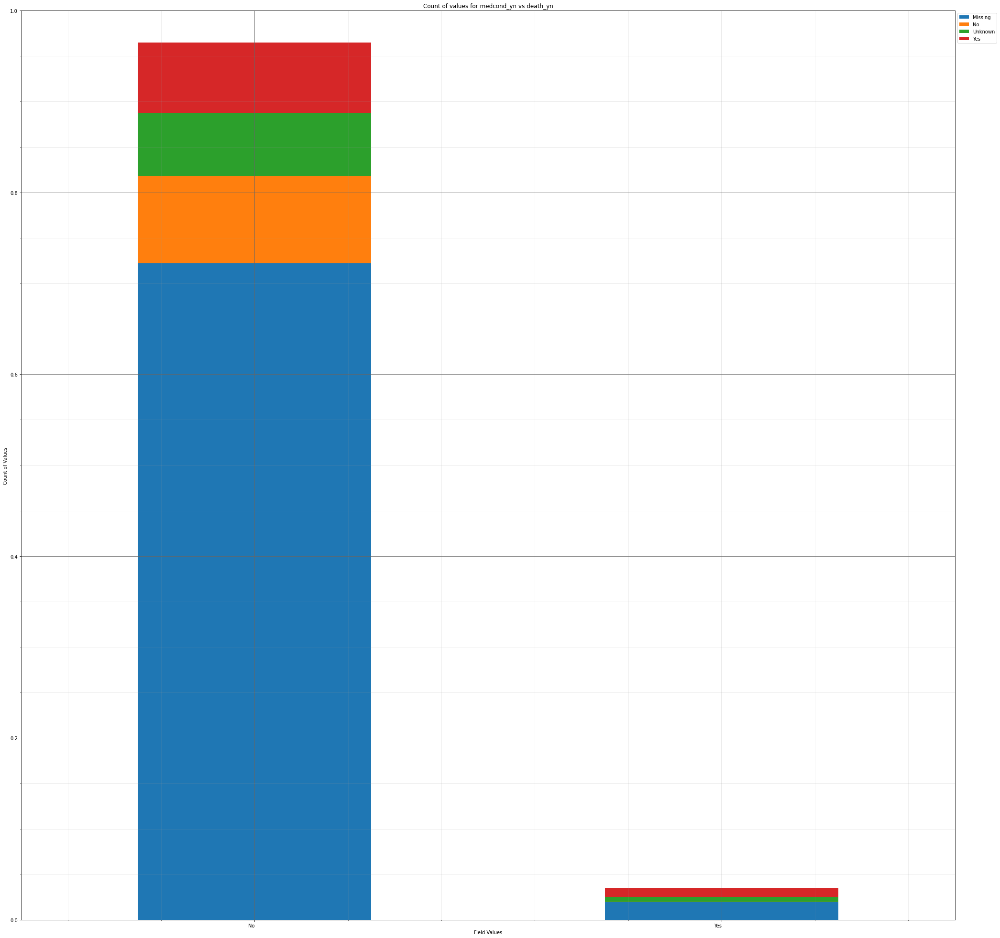



----------------------


Grouping over medcond_yn|current_status results in:



,medcond_yn,current_status,Rows,% Frequency
0,Missing,Laboratory-confirmed case,6616,69.139931
1,Missing,Probable Case,475,4.963946
2,No,Laboratory-confirmed case,856,8.945553
3,No,Probable Case,75,0.783781
4,Unknown,Laboratory-confirmed case,640,6.688264
5,Unknown,Probable Case,71,0.741979
6,Yes,Laboratory-confirmed case,793,8.287177
7,Yes,Probable Case,43,0.449368


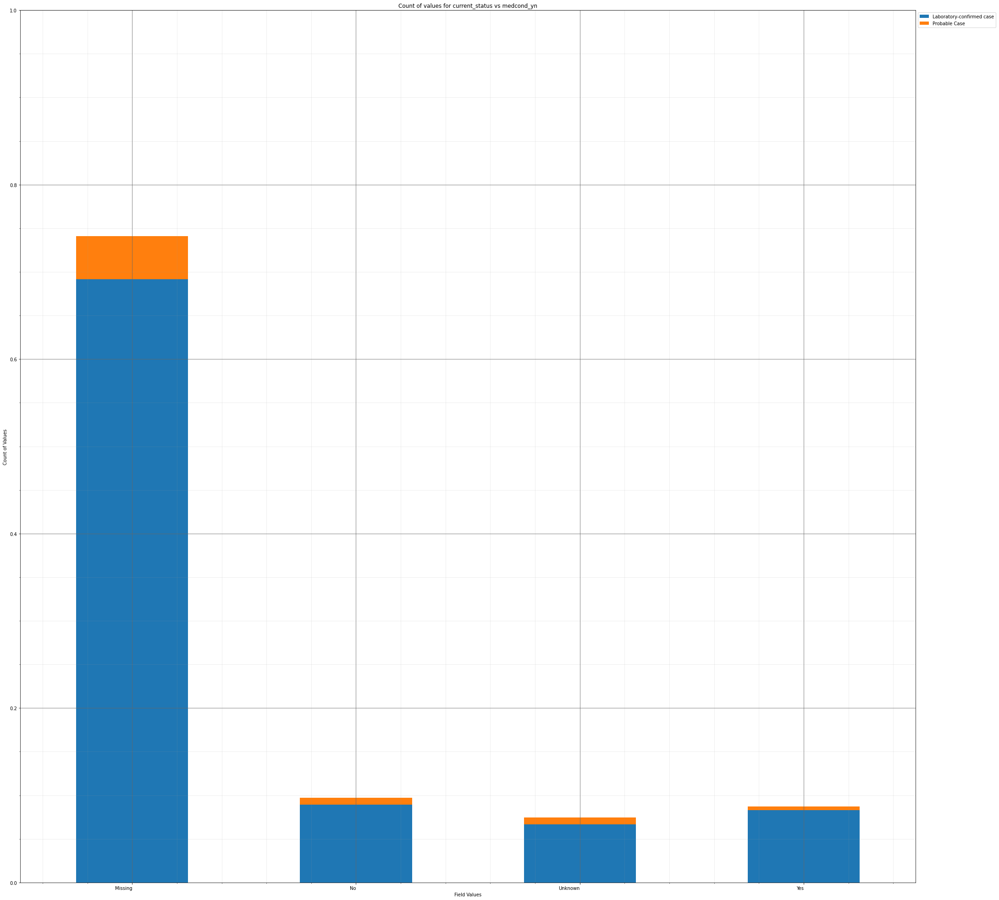



----------------------


Grouping over medcond_yn|sex results in:



,medcond_yn,sex,Rows,% Frequency
0,Missing,Female,3736,39.042742
1,Missing,Male,3289,34.371408
2,Missing,Missing,4,0.041802
3,Missing,Unknown,62,0.647926
4,No,Female,508,5.308810
5,No,Male,416,4.347372
6,No,Missing,3,0.031351
7,No,Unknown,4,0.041802
8,Unknown,Female,393,4.107012
9,Unknown,Male,311,3.250078


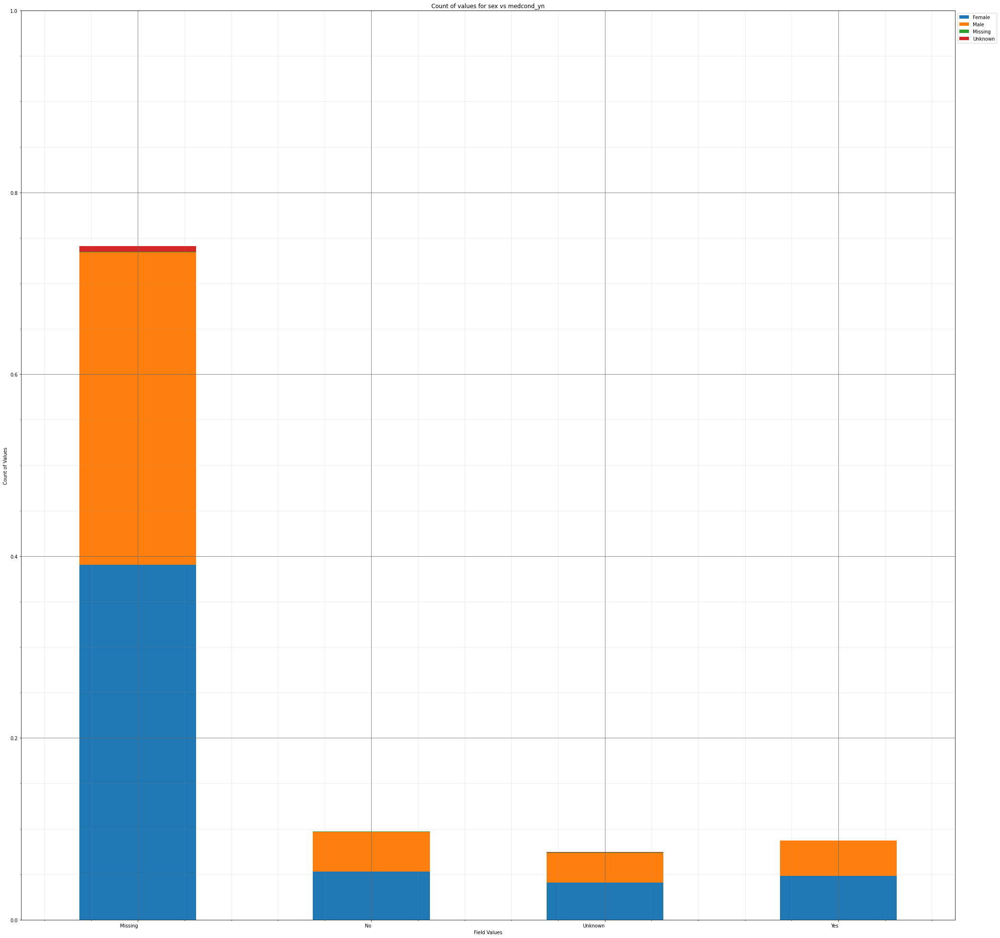



----------------------


Grouping over medcond_yn|age_group results in:



,medcond_yn,age_group,Rows,% Frequency
0,Missing,0 - 9 Years,357,3.730797
1,Missing,10 - 19 Years,772,8.067719
2,Missing,20 - 29 Years,1289,13.470582
3,Missing,30 - 39 Years,1141,11.923921
4,Missing,40 - 49 Years,1066,11.140140
5,Missing,50 - 59 Years,1006,10.513115
6,Missing,60 - 69 Years,725,7.576549
7,Missing,70 - 79 Years,420,4.389173
8,Missing,80+ Years,302,3.156025
9,Missing,Missing,13,0.135855


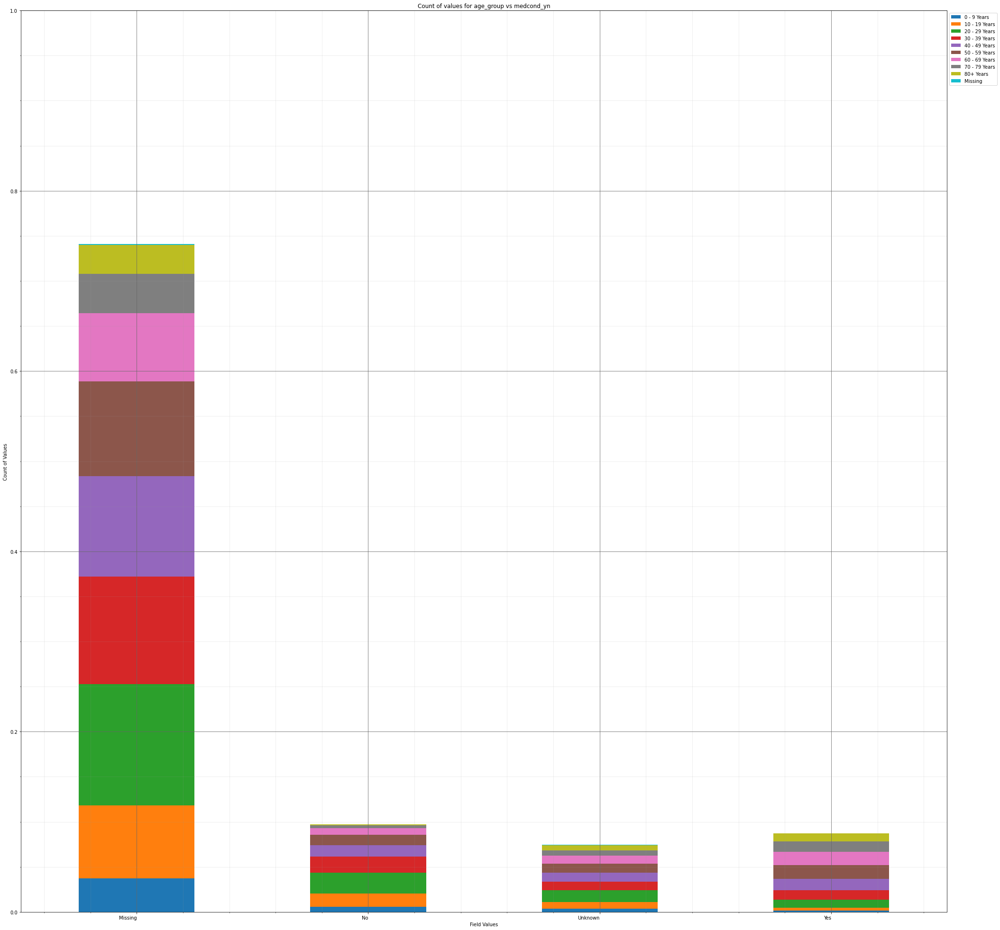



----------------------


Grouping over medcond_yn|race_ethnicity_combined results in:



,medcond_yn,race_ethnicity_combined,Rows,% Frequency
0,Missing,"American Indian/Alaska Native, Non-Hispanic",51,0.532971
1,Missing,"Asian, Non-Hispanic",200,2.090083
2,Missing,"Black, Non-Hispanic",438,4.577281
3,Missing,Hispanic/Latino,589,6.155293
4,Missing,Missing,103,1.076393
5,Missing,"Multiple/Other, Non-Hispanic",427,4.462326
6,Missing,"Native Hawaiian/Other Pacific Islander, Non-Hi...",19,0.198558
7,Missing,Unknown,3082,32.208172
8,Missing,"White, Non-Hispanic",2182,22.802801
9,No,"American Indian/Alaska Native, Non-Hispanic",4,0.041802


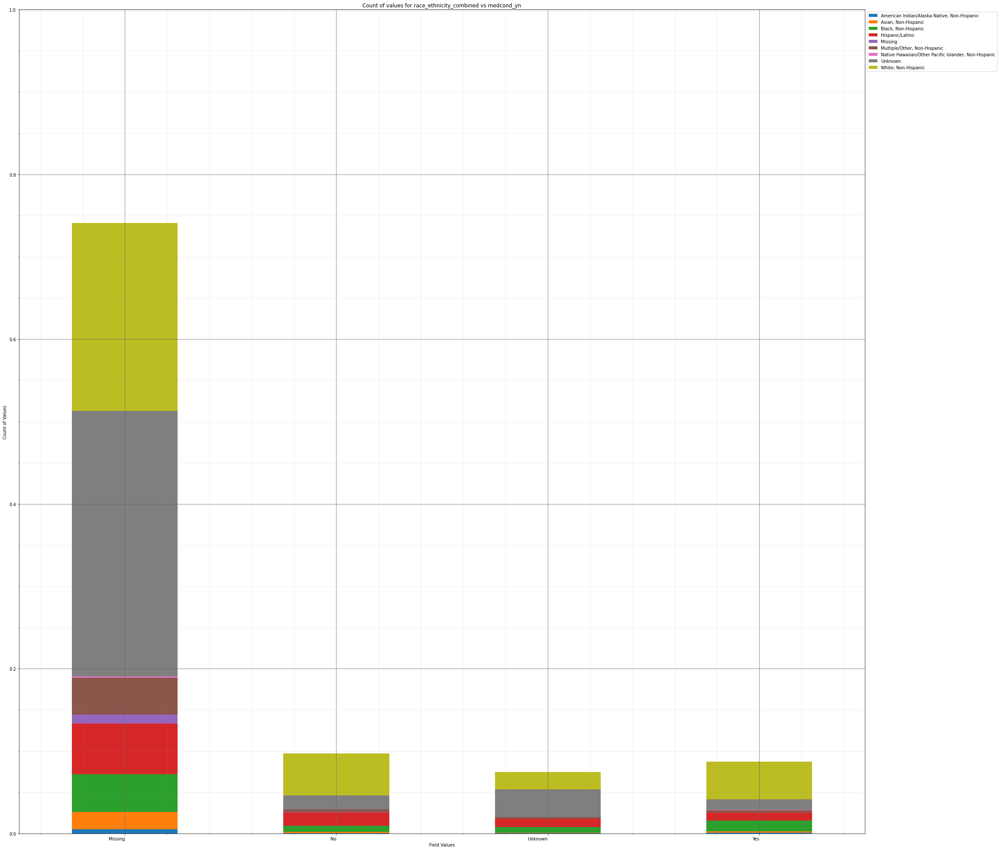



----------------------


Grouping over medcond_yn|hosp_yn results in:



,medcond_yn,hosp_yn,Rows,% Frequency
0,Missing,Missing,1843,19.260111
1,Missing,No,3670,38.353015
2,Missing,OTH,0,0.000000
3,Missing,Unknown,1154,12.059776
4,Missing,Yes,424,4.430975
5,No,Missing,191,1.996029
6,No,No,695,7.263037
7,No,OTH,0,0.000000
8,No,Unknown,11,0.114955
9,No,Yes,34,0.355314


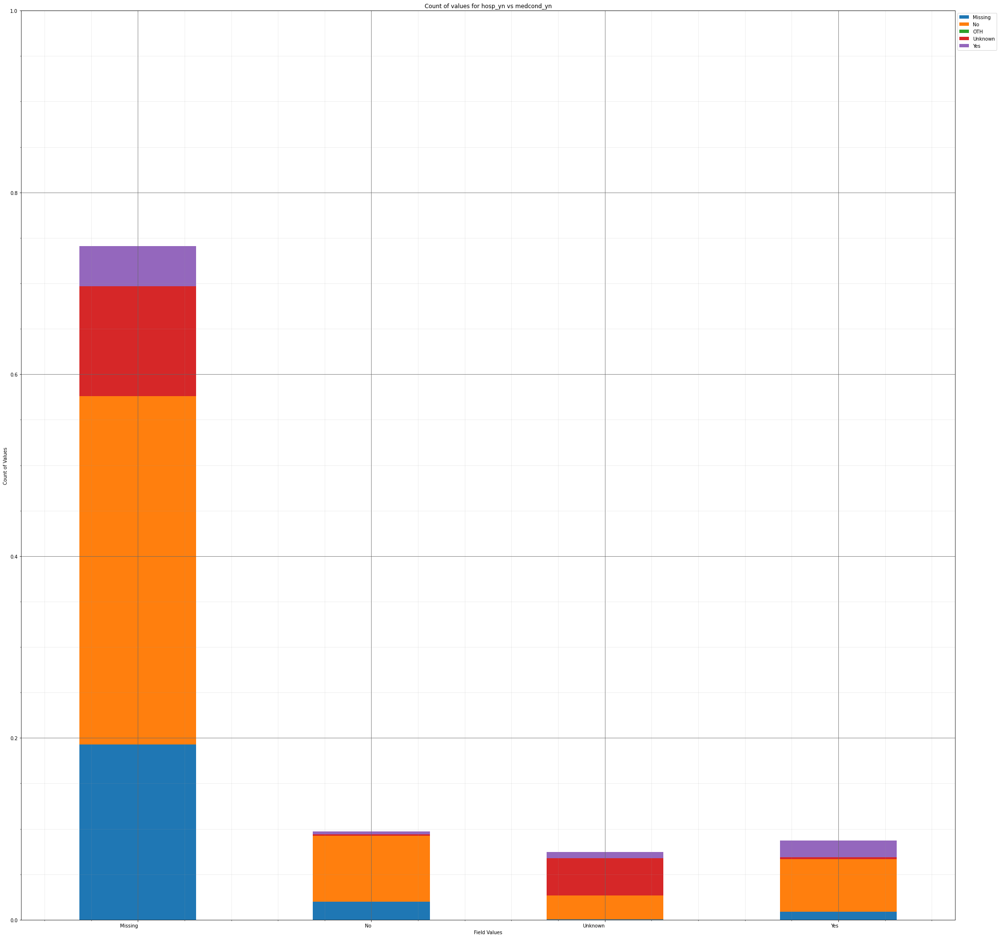



----------------------


Grouping over medcond_yn|icu_yn results in:



,medcond_yn,icu_yn,Rows,% Frequency
0,Missing,Missing,6621,69.192183
1,Missing,No,216,2.257289
2,Missing,Unknown,215,2.246839
3,Missing,Yes,39,0.407566
4,No,Missing,310,3.239628
5,No,No,402,4.201066
6,No,Unknown,212,2.215488
7,No,Yes,7,0.073153
8,Unknown,Missing,35,0.365764
9,Unknown,No,34,0.355314


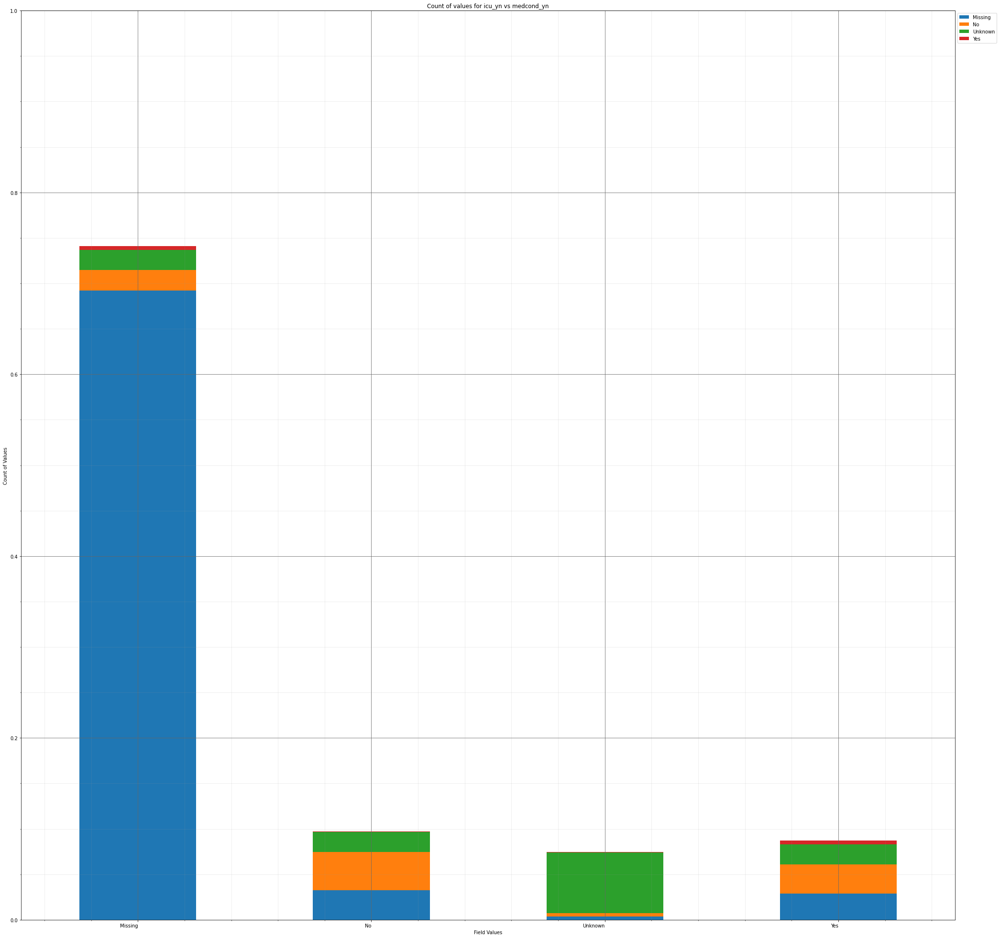



----------------------


Grouping over medcond_yn|death_yn results in:



,medcond_yn,death_yn,Rows,% Frequency
0,Missing,No,6907,72.181001
1,Missing,Yes,184,1.922876
2,No,No,923,9.645731
3,No,Yes,8,0.083603
4,Unknown,No,662,6.918173
5,Unknown,Yes,49,0.512070
6,Yes,No,742,7.754206
7,Yes,Yes,94,0.982339


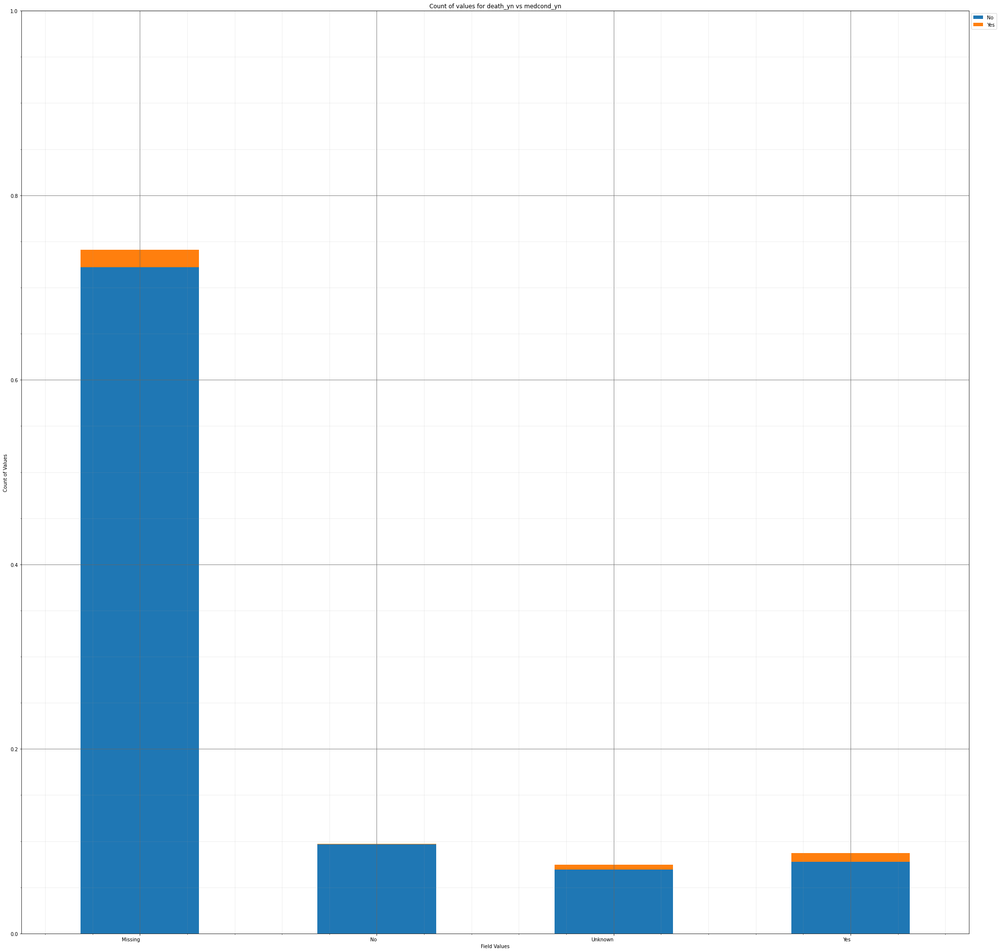

In [41]:
dd_multi_frequency_dict=group_over_multi_categories(deduped_covid_sample_df,categorical_columns,save_fig=True,pdf_fn=multi_categorical_barplot_dedupe_fn)

## 2.3 Consistent Values for Missing

In [42]:
for cat_column in categorical_columns:
    #This is an appalling work around
    deduped_covid_sample_df[cat_column]=deduped_covid_sample_df[cat_column].astype(str)
    deduped_covid_sample_df.loc[(deduped_covid_sample_df[cat_column].isin(['Missing','Unknown'])),cat_column]='Unknown'
    deduped_covid_sample_df[cat_column]=deduped_covid_sample_df[cat_column].astype('category')

In [43]:
deduped_covid_sample_df

,cdc_case_earliest_dt,cdc_report_dt,pos_spec_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn
0,2020-09-30,2021-01-27,2020-09-30,NaT,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Unknown,Unknown,No,Unknown
1,2020-04-16,NaT,NaT,NaT,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Unknown,Unknown,No,Unknown
2,2020-09-22,2020-10-01,NaT,2020-09-22,Laboratory-confirmed case,Female,10 - 19 Years,"White, Non-Hispanic",No,No,No,No
3,2020-10-30,2021-01-22,NaT,2020-10-30,Laboratory-confirmed case,Female,60 - 69 Years,"Multiple/Other, Non-Hispanic",No,Unknown,No,Unknown
4,2020-12-17,2020-12-17,NaT,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Unknown,Unknown,No,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...
9994,2021-01-14,NaT,NaT,NaT,Laboratory-confirmed case,Female,80+ Years,"Multiple/Other, Non-Hispanic",No,Unknown,No,Unknown
9995,2020-09-24,2020-10-03,NaT,2020-09-24,Laboratory-confirmed case,Female,30 - 39 Years,Hispanic/Latino,No,Unknown,No,Unknown
9997,2020-08-27,2020-08-28,NaT,2020-08-28,Laboratory-confirmed case,Female,10 - 19 Years,Unknown,No,Unknown,No,Unknown
9998,2021-01-04,NaT,NaT,NaT,Laboratory-confirmed case,Unknown,30 - 39 Years,Unknown,Unknown,Unknown,No,Unknown


## 2.4 Correction of Values for Missing Probable Case

In [44]:
deduped_covid_sample_df.loc[((deduped_covid_sample_df['current_status'] == 'Probable Case') & (deduped_covid_sample_df["pos_spec_dt"].notna())),'current_status']='Laboratory-confirmed case'

## 2.5 Drop pos_spec_dt for nulls and update hospital admission. Remove oth hosp_yn.

In [45]:
non_pos_spec=''
non_pos_spec=[x for x in deduped_covid_sample_df.columns if x!='pos_spec_dt']

deduped_covid_sample_df=deduped_covid_sample_df[non_pos_spec]

In [46]:
deduped_covid_sample_df=deduped_covid_sample_df.drop(deduped_covid_sample_df[deduped_covid_sample_df['hosp_yn']=='OTH'].index)

In [47]:
deduped_covid_sample_df.loc[(deduped_covid_sample_df['hosp_yn']!='Yes')&(deduped_covid_sample_df['icu_yn']=='Yes'),'hosp_yn']='Yes'

## 2.6 Drop cdc_report_dt for depreciation

In [48]:
non_rep_dt=[x for x in deduped_covid_sample_df.columns if x!='cdc_report_dt']
deduped_covid_sample_df=deduped_covid_sample_df[non_rep_dt]

In [49]:
deduped_covid_sample_df

,cdc_case_earliest_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn
0,2020-09-30,NaT,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Unknown,Unknown,No,Unknown
1,2020-04-16,NaT,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Unknown,Unknown,No,Unknown
2,2020-09-22,2020-09-22,Laboratory-confirmed case,Female,10 - 19 Years,"White, Non-Hispanic",No,No,No,No
3,2020-10-30,2020-10-30,Laboratory-confirmed case,Female,60 - 69 Years,"Multiple/Other, Non-Hispanic",No,Unknown,No,Unknown
4,2020-12-17,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Unknown,Unknown,No,Unknown
...,...,...,...,...,...,...,...,...,...,...
9994,2021-01-14,NaT,Laboratory-confirmed case,Female,80+ Years,"Multiple/Other, Non-Hispanic",No,Unknown,No,Unknown
9995,2020-09-24,2020-09-24,Laboratory-confirmed case,Female,30 - 39 Years,Hispanic/Latino,No,Unknown,No,Unknown
9997,2020-08-27,2020-08-28,Laboratory-confirmed case,Female,10 - 19 Years,Unknown,No,Unknown,No,Unknown
9998,2021-01-04,NaT,Laboratory-confirmed case,Unknown,30 - 39 Years,Unknown,Unknown,Unknown,No,Unknown


In [50]:
deduped_covid_sample_df[deduped_covid_sample_df['current_status'].isin(['Probable Case'])]

,cdc_case_earliest_dt,onset_dt,current_status,sex,age_group,race_ethnicity_combined,hosp_yn,icu_yn,death_yn,medcond_yn
64,2020-08-18,2020-08-18,Probable Case,Male,20 - 29 Years,"Multiple/Other, Non-Hispanic",No,Unknown,No,Unknown
65,2020-03-15,NaT,Probable Case,Male,80+ Years,"Asian, Non-Hispanic",Yes,Unknown,Yes,Yes
78,2020-10-25,NaT,Probable Case,Male,20 - 29 Years,"Multiple/Other, Non-Hispanic",Unknown,Unknown,No,Unknown
84,2020-10-11,2020-10-11,Probable Case,Female,70 - 79 Years,"White, Non-Hispanic",Yes,Unknown,No,Unknown
93,2020-11-22,2020-11-22,Probable Case,Male,60 - 69 Years,"White, Non-Hispanic",No,Unknown,No,Unknown
...,...,...,...,...,...,...,...,...,...,...
9882,2020-11-11,2020-11-11,Probable Case,Female,40 - 49 Years,"Black, Non-Hispanic",No,Unknown,No,Unknown
9886,2020-08-14,2020-08-14,Probable Case,Male,20 - 29 Years,"White, Non-Hispanic",No,No,No,Yes
9912,2020-11-28,NaT,Probable Case,Female,30 - 39 Years,Unknown,Unknown,Unknown,No,Unknown
9926,2020-08-24,2020-08-24,Probable Case,Female,60 - 69 Years,"White, Non-Hispanic",No,Unknown,No,Yes


## 2.7 Split Race Ethnicity

In [51]:
race_df=deduped_covid_sample_df['race_ethnicity_combined']
race_df = deduped_covid_sample_df['race_ethnicity_combined'].str.split(',',expand=True)
race_df.columns=['race','ethnicity']
race_df.loc[(race_df['race']=='Hispanic/Latino'),'ethnicity']='Hispanic/Latino'
race_df.loc[(race_df['race']=='Unknown'),'ethnicity']='Unknown'

In [52]:
race_df.columns=['race','ethnicity']
race_df.loc[(race_df['race']=='Hispanic/Latino'),'ethnicity']='Hispanic/Latino'
race_df.loc[(race_df['race']=='Unknown'),'ethnicity']='Unknown'

In [53]:
for col in race_df:
    race_df[col]=race_df[col].astype('category')

In [54]:
deduped_covid_sample_df=deduped_covid_sample_df.merge(race_df,left_index=True, right_index=True,suffixes=('_orig', '_race'))
non_rep_dt=[x for x in deduped_covid_sample_df.columns if x!='race_ethnicity_combined']
deduped_covid_sample_df=deduped_covid_sample_df[non_rep_dt]

I decided that ethnicity's info was captured in race so drop ethnicity.

In [55]:
non_ethn_df=[x for x in deduped_covid_sample_df.columns if x!='ethnicity']
deduped_covid_sample_df=deduped_covid_sample_df[non_ethn_df]

## 2.8 Rerun Descriptive Stats

In [56]:
#Format Dictionary:
non_numeric_format_dictionary={
                              '% Populated': "{:.0f}%"
                              ,'% Missing': "{:.0f}%"
                                ,'% Top Value':"{:.0f}%"}





#Produce a summary table - Note the continuous features in this dataset are dates
#Note: As of now, pandas allows using describe with dates so keeping it in, but this will be depreciated
category_summary_df=deduped_covid_sample_df.describe().T

#Add what Percent is populated
category_summary_df['% Populated']=100*(category_summary_df['count']/dd_row_count)

#Percent missing
category_summary_df['% Missing']=100-category_summary_df['% Populated']

#Prevelance of top vlaue
category_summary_df['% Top Value']=100*(category_summary_df['freq']/dd_row_count)

#Give a warning depending on quartile of missing data - upper quartiles are high
category_summary_df['Missing Warning']=np.select([(category_summary_df['% Missing']==0),(category_summary_df['% Missing']>0) & (category_summary_df['% Missing']<25),(category_summary_df['% Missing']>=25) & (category_summary_df['% Missing']<50),category_summary_df['% Missing']>=50],['None','Low','Medium','High'])

category_summary_df=category_summary_df.reset_index()
category_summary_df=category_summary_df.rename(columns={"index": "feature"})


(category_summary_df.style.apply(missing_check, axis=1)
                                         .format(non_numeric_format_dictionary))

categorical_columns=deduped_covid_sample_df.select_dtypes('category').columns
datetime_columns=deduped_covid_sample_df.select_dtypes('datetime').columns

Inside group_over_single_categories()


----------------------


                           cdc_case_earliest_dt
current_status                                 
Laboratory-confirmed case                  9126
Probable Case                               442
Grouping over current_status results in:



,current_status,Rows,% Frequency
0,Laboratory-confirmed case,9126,95.380435
1,Probable Case,442,4.619565


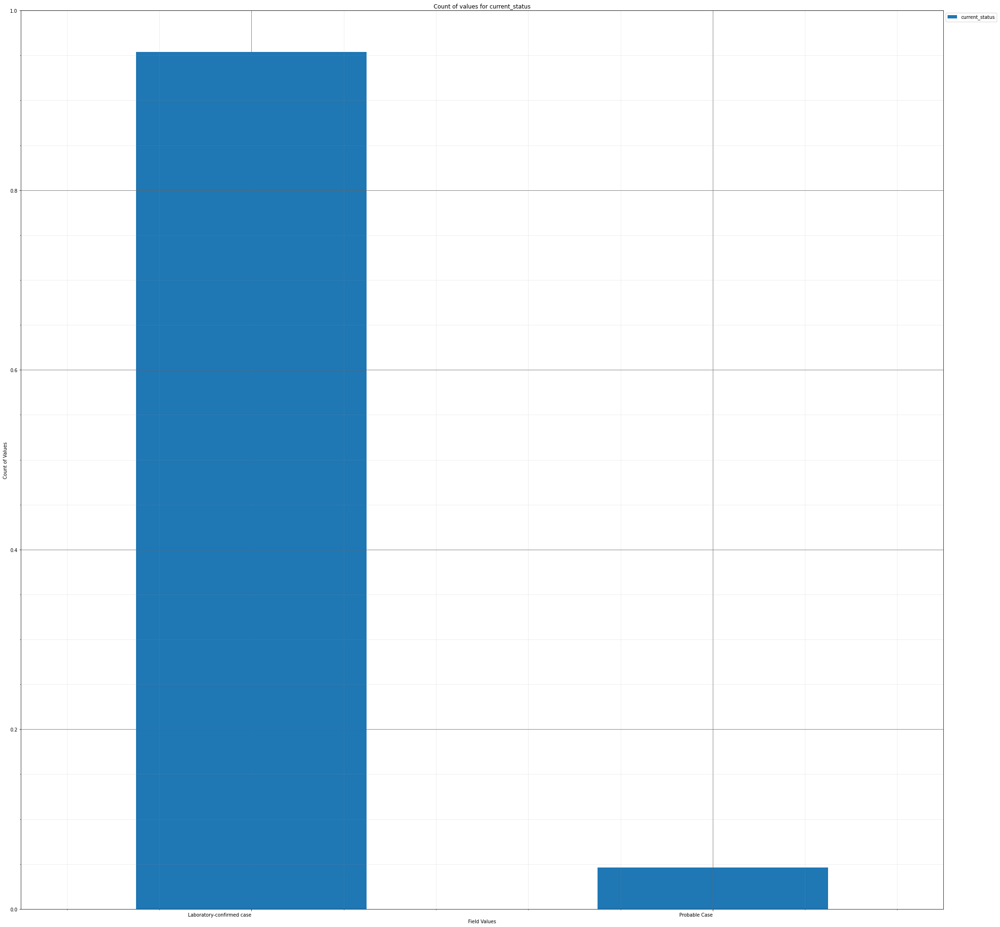



----------------------


         cdc_case_earliest_dt
sex                          
Female                   5097
Male                     4388
Unknown                    83
Grouping over sex results in:



,sex,Rows,% Frequency
0,Female,5097,53.271321
1,Male,4388,45.861204
2,Unknown,83,0.867475


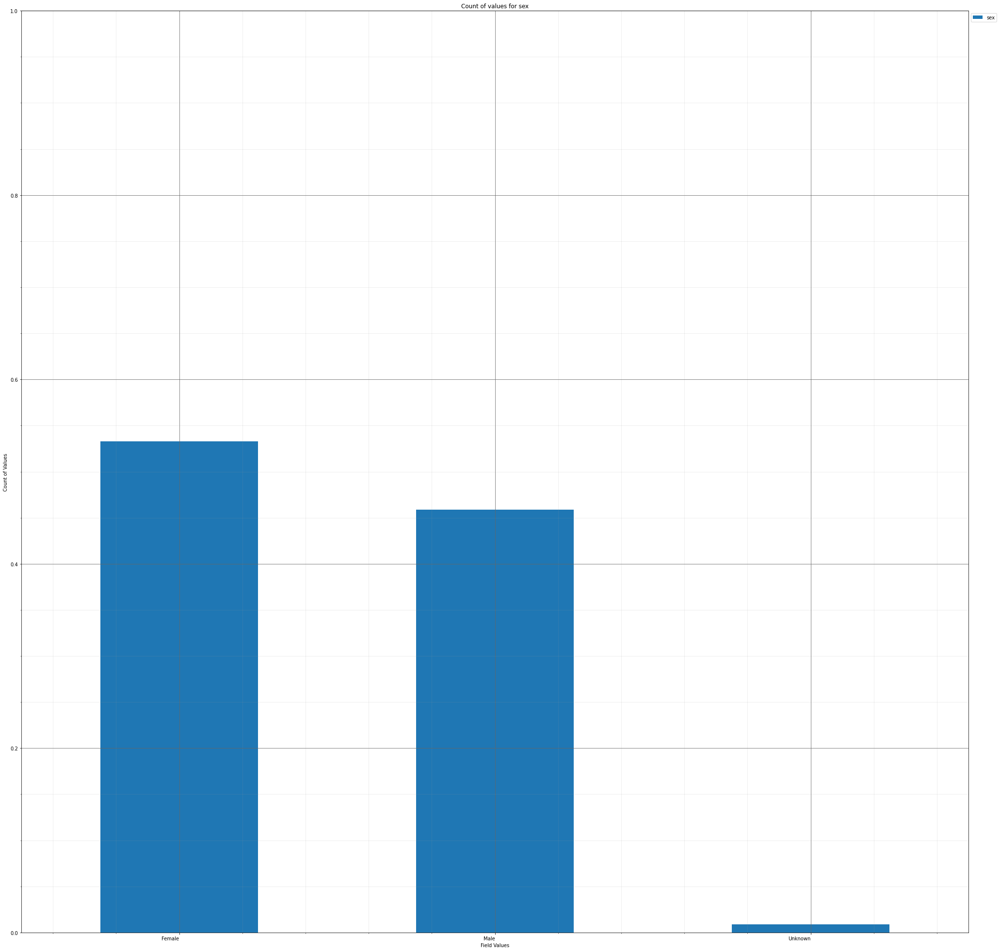



----------------------


               cdc_case_earliest_dt
age_group                          
0 - 9 Years                     458
10 - 19 Years                  1017
20 - 29 Years                  1720
30 - 39 Years                  1505
40 - 49 Years                  1398
50 - 59 Years                  1362
60 - 69 Years                  1019
70 - 79 Years                   616
80+ Years                       459
Unknown                          14
Grouping over age_group results in:



,age_group,Rows,% Frequency
0,0 - 9 Years,458,4.786789
1,10 - 19 Years,1017,10.629181
2,20 - 29 Years,1720,17.976589
3,30 - 39 Years,1505,15.729515
4,40 - 49 Years,1398,14.611204
5,50 - 59 Years,1362,14.234950
6,60 - 69 Years,1019,10.650084
7,70 - 79 Years,616,6.438127
8,80+ Years,459,4.797241
9,Unknown,14,0.146321


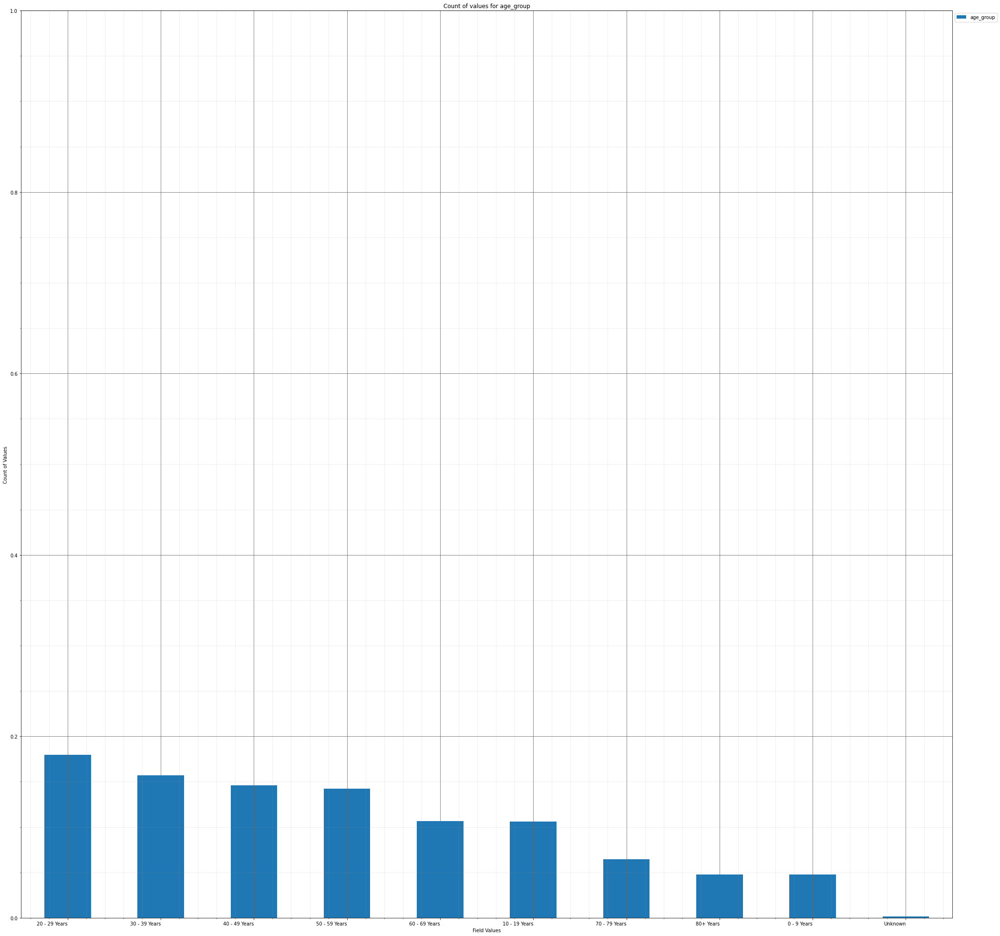



----------------------


         cdc_case_earliest_dt
hosp_yn                      
No                       5171
OTH                         0
Unknown                  3697
Yes                       700
Grouping over hosp_yn results in:



,hosp_yn,Rows,% Frequency
0,No,5171,54.044732
1,OTH,0,0.000000
2,Unknown,3697,38.639214
3,Yes,700,7.316054


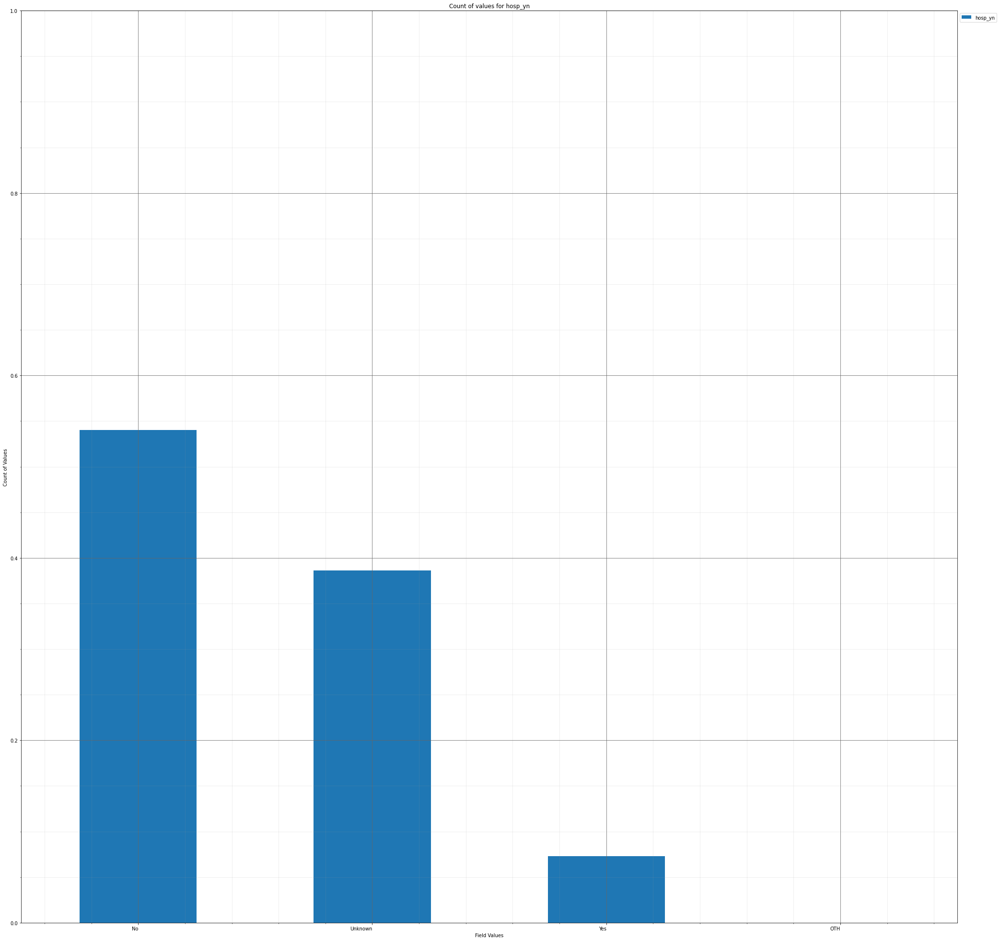



----------------------


         cdc_case_earliest_dt
icu_yn                       
No                        958
Unknown                  8518
Yes                        92
Grouping over icu_yn results in:



,icu_yn,Rows,% Frequency
0,No,958,10.012542
1,Unknown,8518,89.025920
2,Yes,92,0.961538


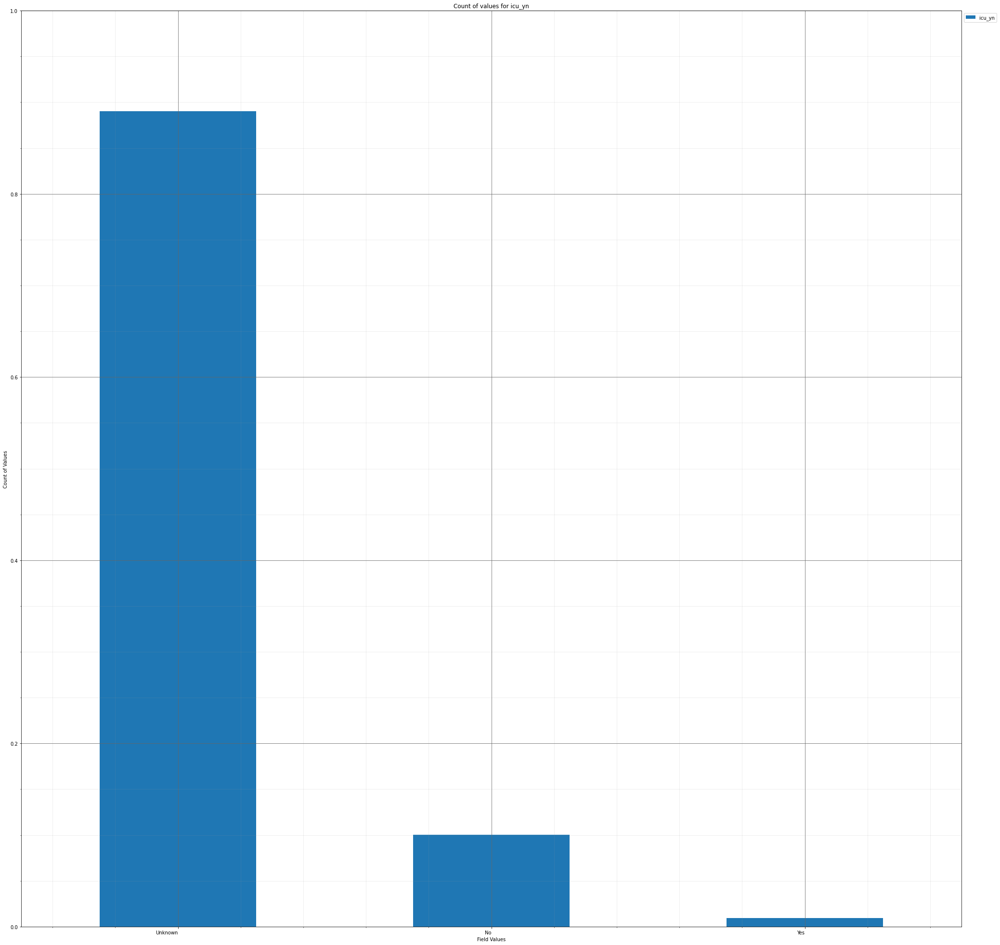



----------------------


          cdc_case_earliest_dt
death_yn                      
No                        9233
Yes                        335
Grouping over death_yn results in:



,death_yn,Rows,% Frequency
0,No,9233,96.498746
1,Yes,335,3.501254


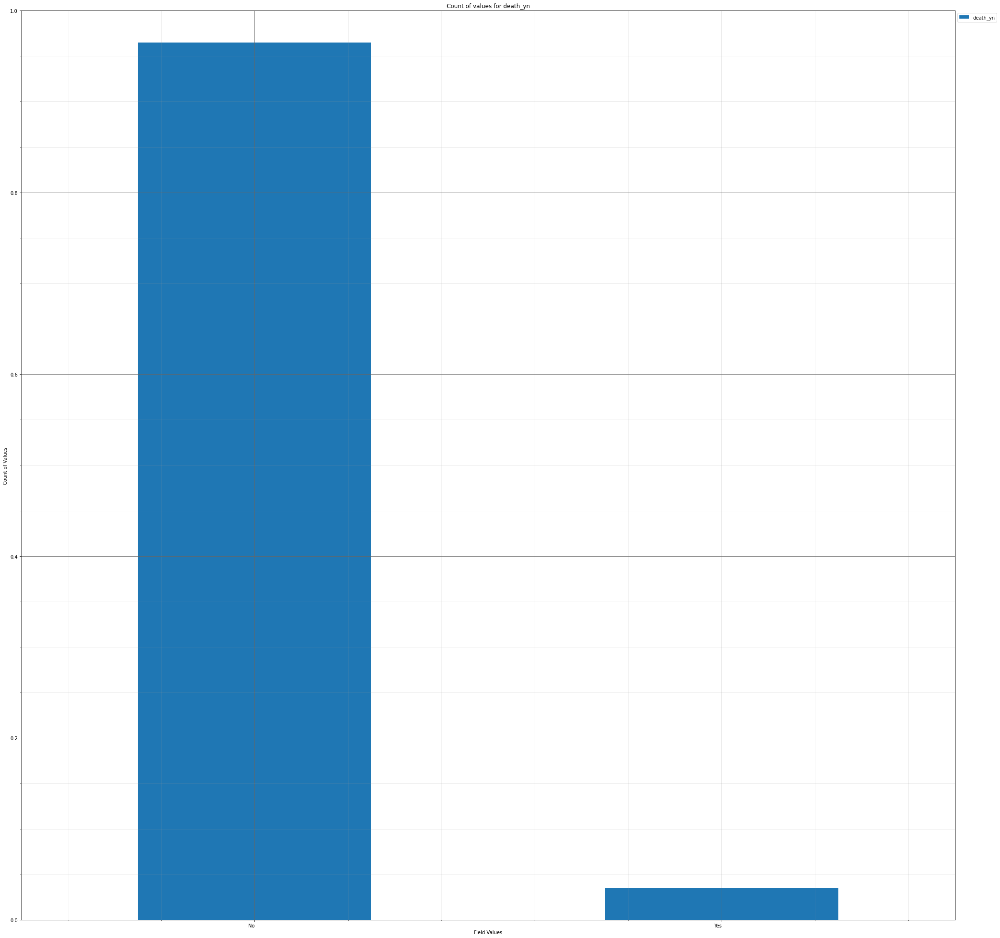



----------------------


            cdc_case_earliest_dt
medcond_yn                      
No                           931
Unknown                     7802
Yes                          835
Grouping over medcond_yn results in:



,medcond_yn,Rows,% Frequency
0,No,931,9.730351
1,Unknown,7802,81.542642
2,Yes,835,8.727007


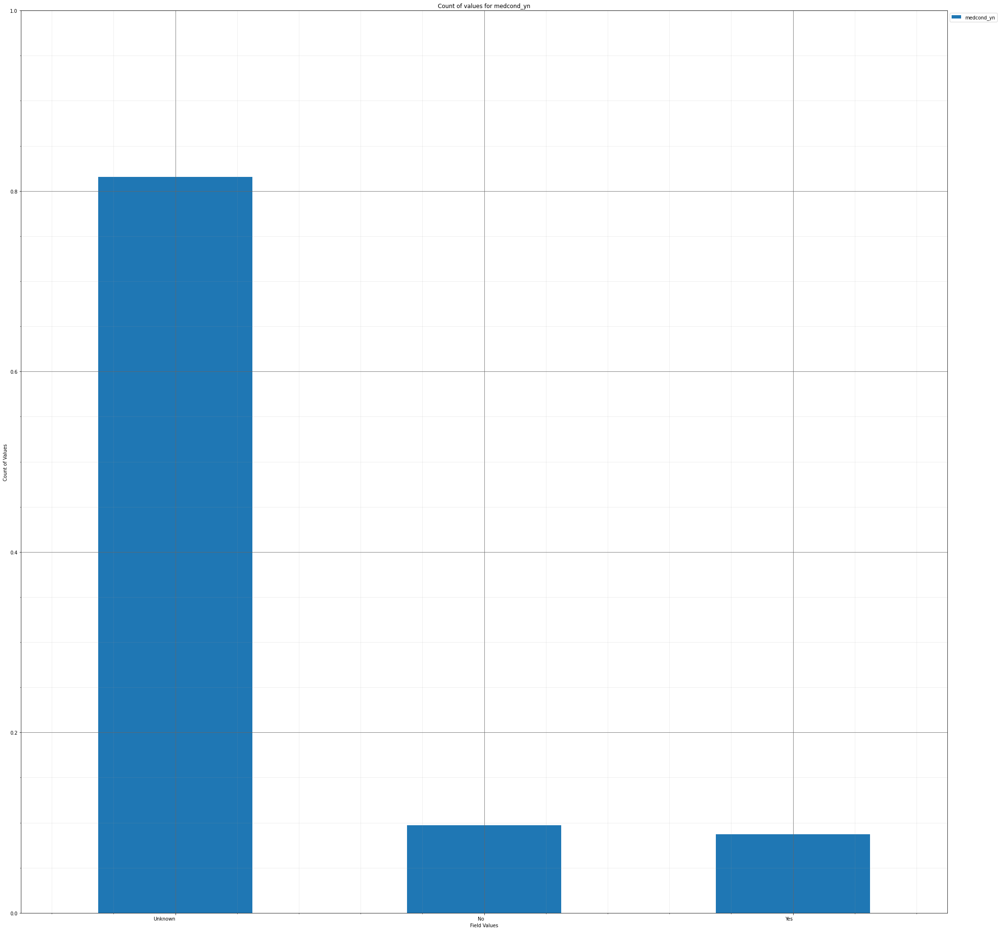



----------------------


                                        cdc_case_earliest_dt
race                                                        
American Indian/Alaska Native                             66
Asian                                                    241
Black                                                    694
Hispanic/Latino                                          929
Multiple/Other                                           510
Native Hawaiian/Other Pacific Islander                    23
Unknown                                                 3792
White                                                   3313
Grouping over race results in:



,race,Rows,% Frequency
0,American Indian/Alaska Native,66,0.689799
1,Asian,241,2.518813
2,Black,694,7.253344
3,Hispanic/Latino,929,9.709448
4,Multiple/Other,510,5.330268
5,Native Hawaiian/Other Pacific Islander,23,0.240385
6,Unknown,3792,39.632107
7,White,3313,34.625836


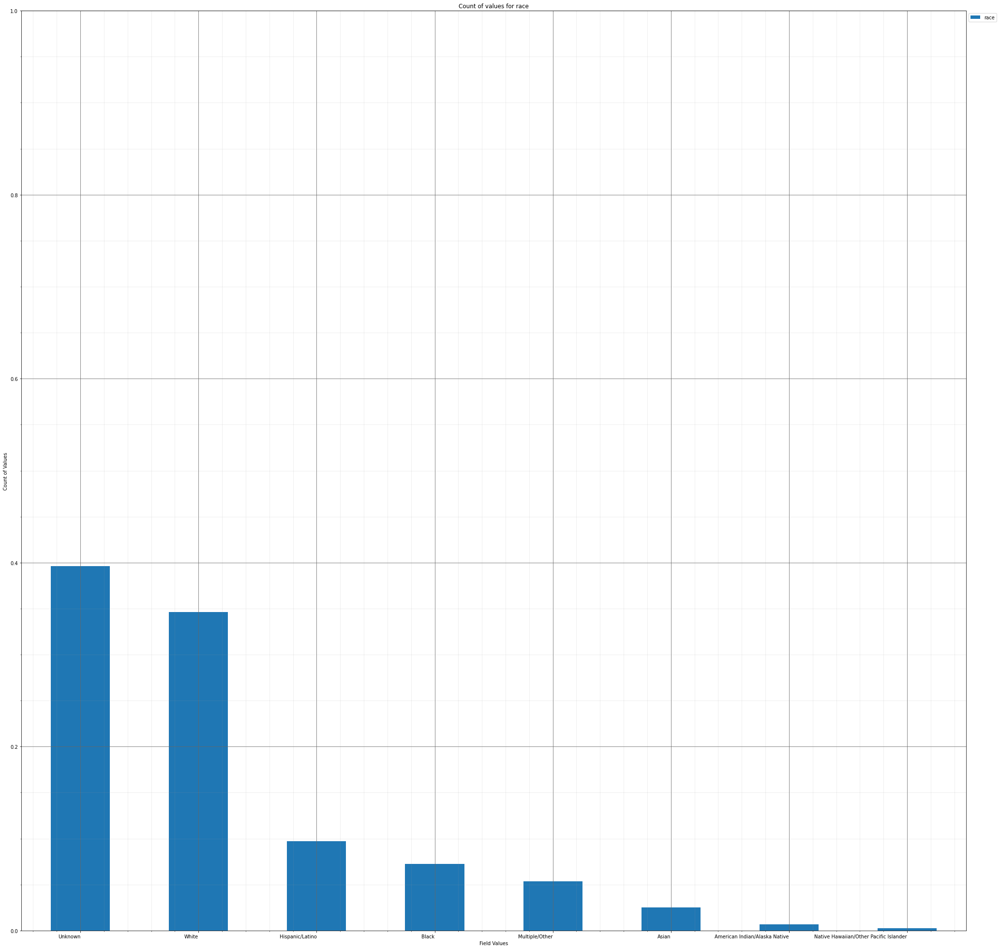

In [57]:
dd_stage_clnd_freq_dict=group_over_single_categories(deduped_covid_sample_df,categorical_columns,save_fig=True,pdf_fn=single_categorical_barplot_dedupe_cleanse1_fn)

Inside group_over_multi_categories()


----------------------


Grouping over current_status|sex results in:



,current_status,sex,Rows,% Frequency
0,Laboratory-confirmed case,Female,4870,50.898829
1,Laboratory-confirmed case,Male,4178,43.666388
2,Laboratory-confirmed case,Unknown,78,0.815217
3,Probable Case,Female,227,2.372492
4,Probable Case,Male,210,2.194816
5,Probable Case,Unknown,5,0.052258


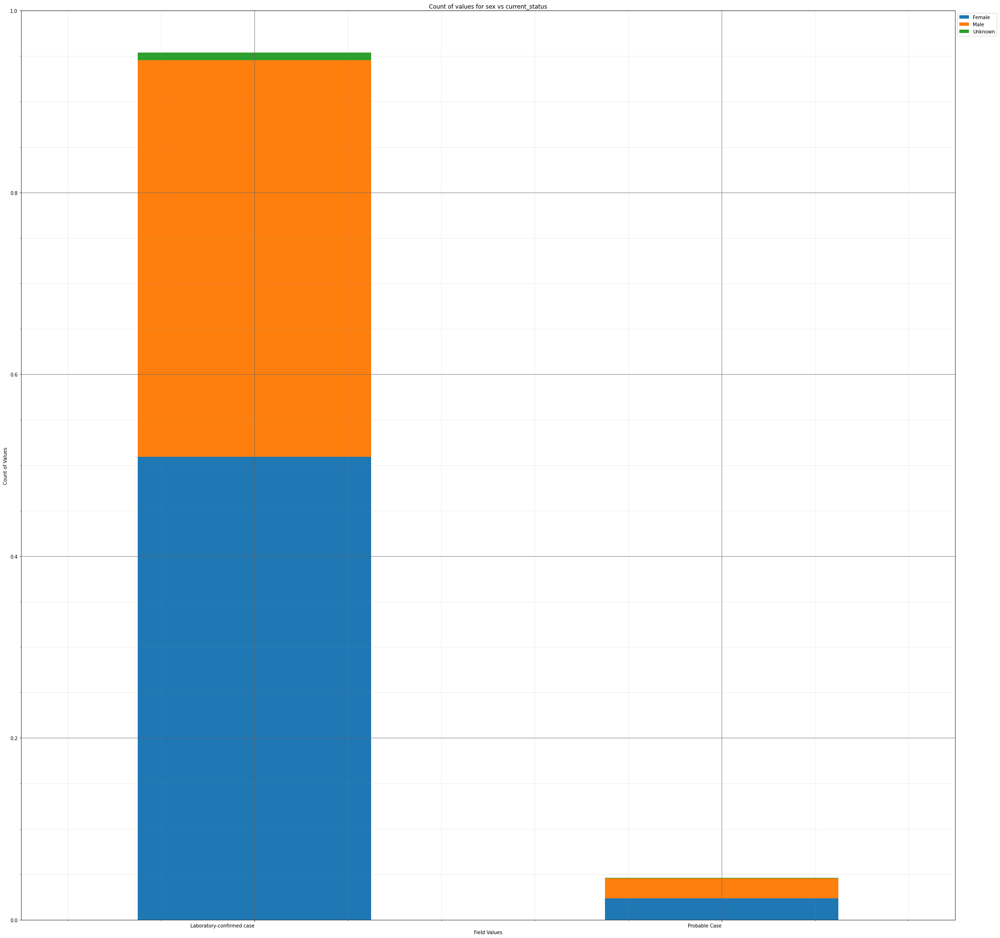



----------------------


Grouping over current_status|age_group results in:



,current_status,age_group,Rows,% Frequency
0,Laboratory-confirmed case,0 - 9 Years,430,4.494147
1,Laboratory-confirmed case,10 - 19 Years,963,10.064799
2,Laboratory-confirmed case,20 - 29 Years,1650,17.244983
3,Laboratory-confirmed case,30 - 39 Years,1451,15.165134
4,Laboratory-confirmed case,40 - 49 Years,1342,14.025920
5,Laboratory-confirmed case,50 - 59 Years,1298,13.566054
6,Laboratory-confirmed case,60 - 69 Years,966,10.096154
7,Laboratory-confirmed case,70 - 79 Years,593,6.197742
8,Laboratory-confirmed case,80+ Years,429,4.483696
9,Laboratory-confirmed case,Unknown,4,0.041806


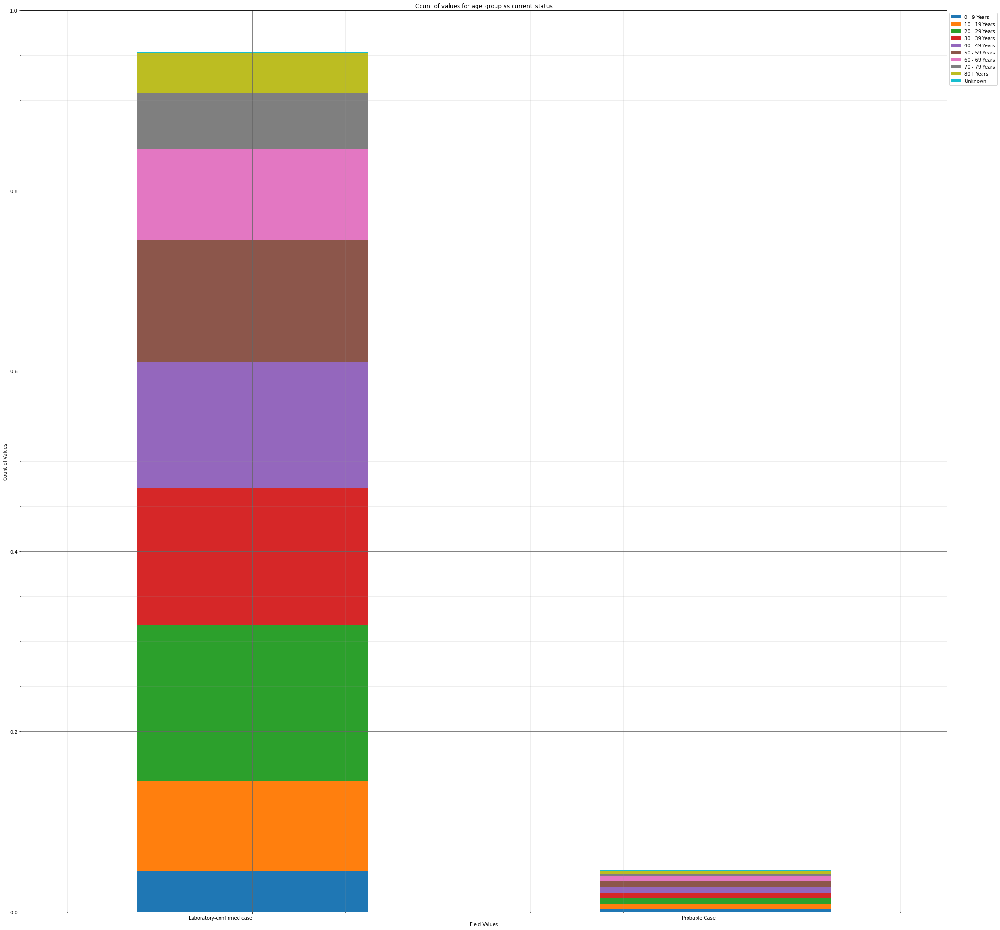



----------------------


Grouping over current_status|hosp_yn results in:



,current_status,hosp_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,4826,50.438963
1,Laboratory-confirmed case,OTH,0,0.000000
2,Laboratory-confirmed case,Unknown,3621,37.844900
3,Laboratory-confirmed case,Yes,679,7.096572
4,Probable Case,No,345,3.605769
5,Probable Case,OTH,0,0.000000
6,Probable Case,Unknown,76,0.794314
7,Probable Case,Yes,21,0.219482


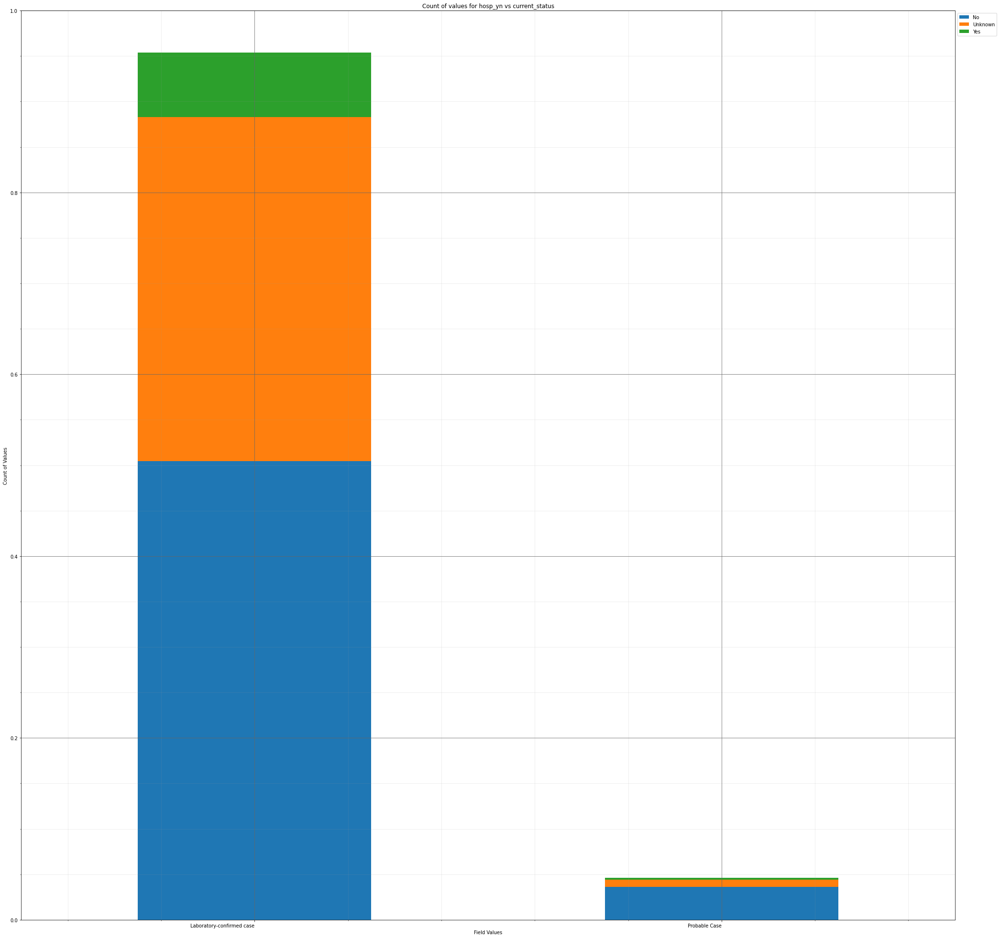



----------------------


Grouping over current_status|icu_yn results in:



,current_status,icu_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,905,9.458612
1,Laboratory-confirmed case,Unknown,8129,84.960284
2,Laboratory-confirmed case,Yes,92,0.961538
3,Probable Case,No,53,0.553930
4,Probable Case,Unknown,389,4.065635
5,Probable Case,Yes,0,0.000000


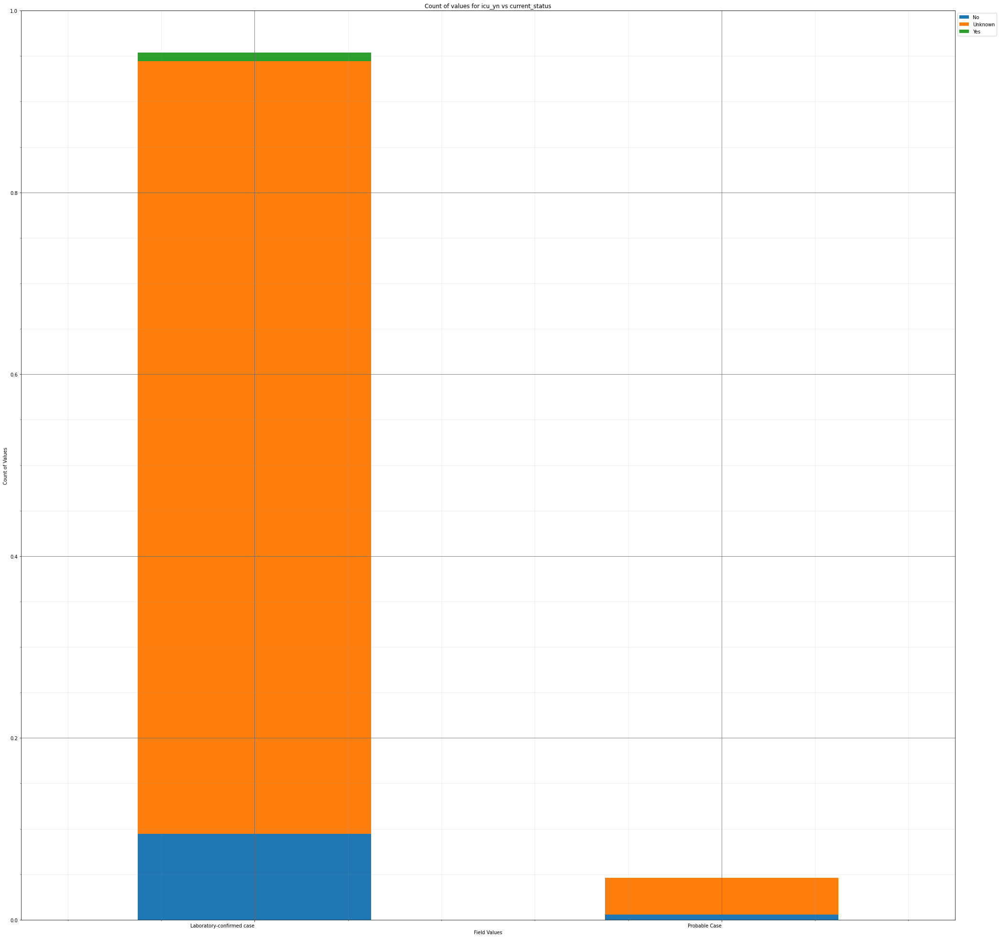



----------------------


Grouping over current_status|death_yn results in:



,current_status,death_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,8818,92.161371
1,Laboratory-confirmed case,Yes,308,3.219064
2,Probable Case,No,415,4.337375
3,Probable Case,Yes,27,0.282191


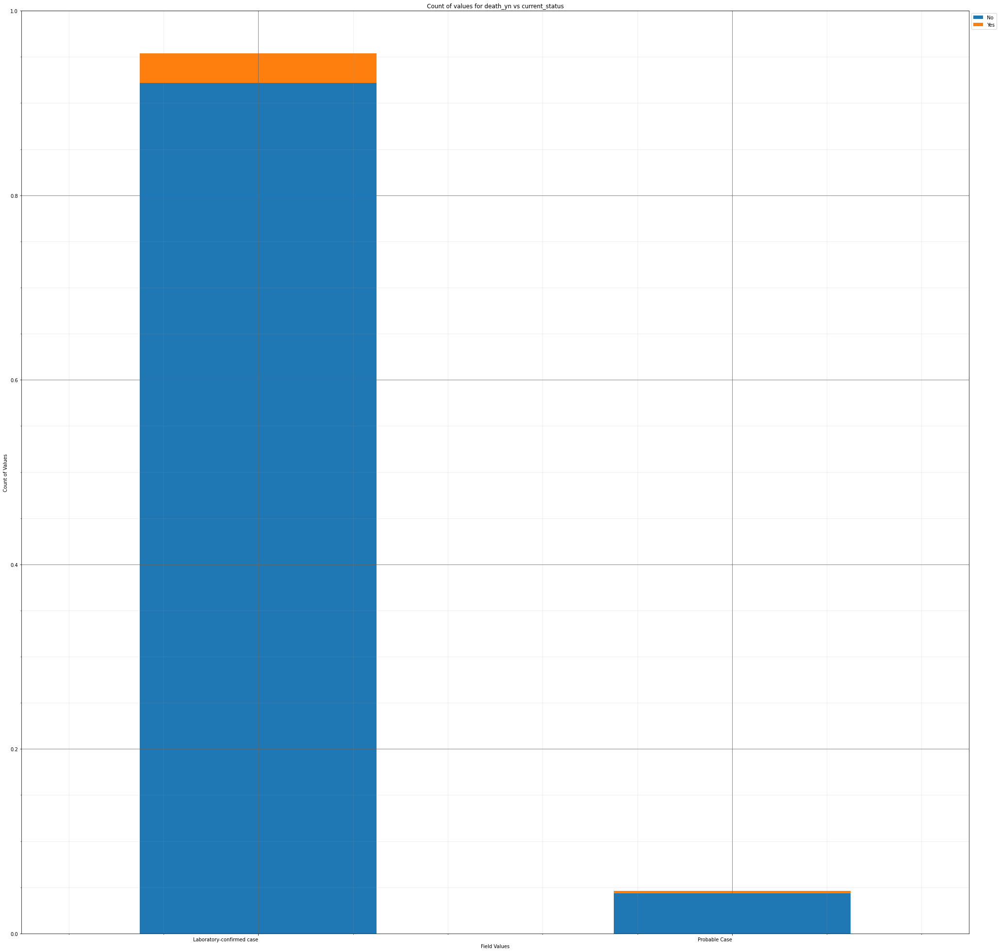



----------------------


Grouping over current_status|medcond_yn results in:



,current_status,medcond_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,893,9.333194
1,Laboratory-confirmed case,Unknown,7418,77.529264
2,Laboratory-confirmed case,Yes,815,8.517977
3,Probable Case,No,38,0.397157
4,Probable Case,Unknown,384,4.013378
5,Probable Case,Yes,20,0.209030


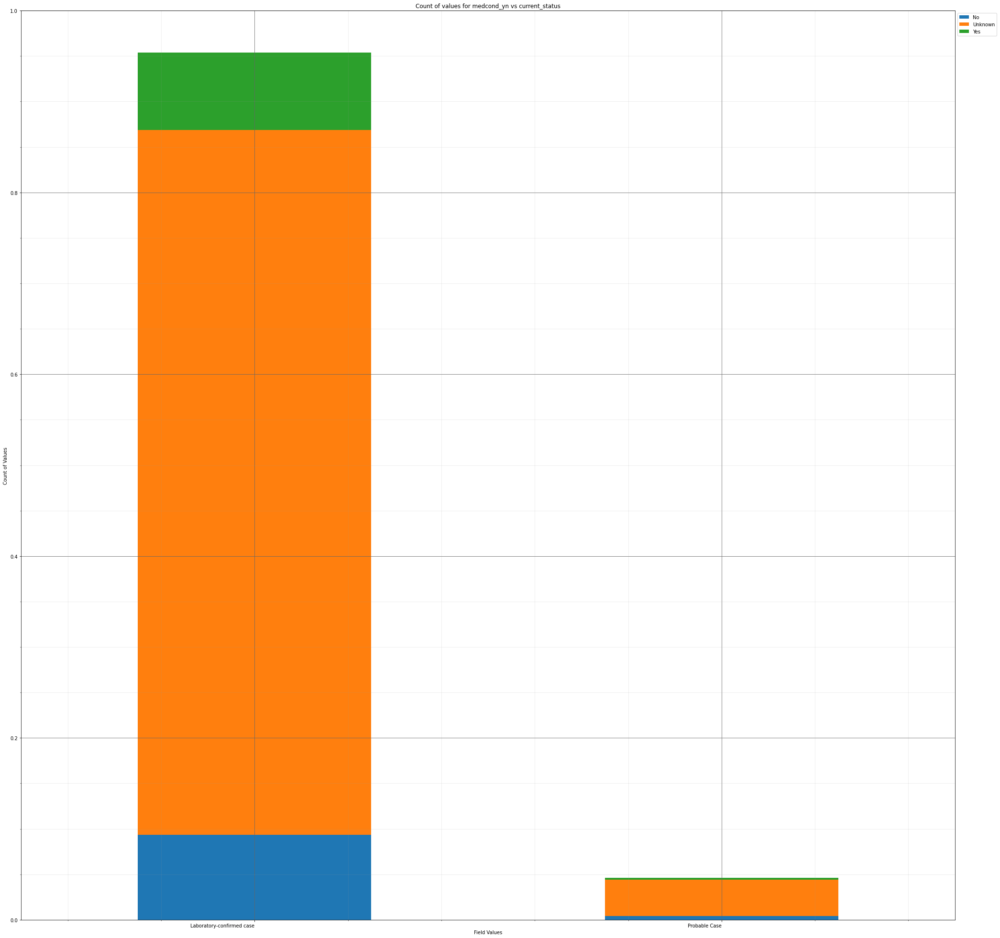



----------------------


Grouping over current_status|race results in:



,current_status,race,Rows,% Frequency
0,Laboratory-confirmed case,American Indian/Alaska Native,62,0.647993
1,Laboratory-confirmed case,Asian,233,2.435201
2,Laboratory-confirmed case,Black,670,7.002508
3,Laboratory-confirmed case,Hispanic/Latino,902,9.427258
4,Laboratory-confirmed case,Multiple/Other,478,4.995819
5,Laboratory-confirmed case,Native Hawaiian/Other Pacific Islander,23,0.240385
6,Laboratory-confirmed case,Unknown,3681,38.471990
7,Laboratory-confirmed case,White,3077,32.159281
8,Probable Case,American Indian/Alaska Native,4,0.041806
9,Probable Case,Asian,8,0.083612


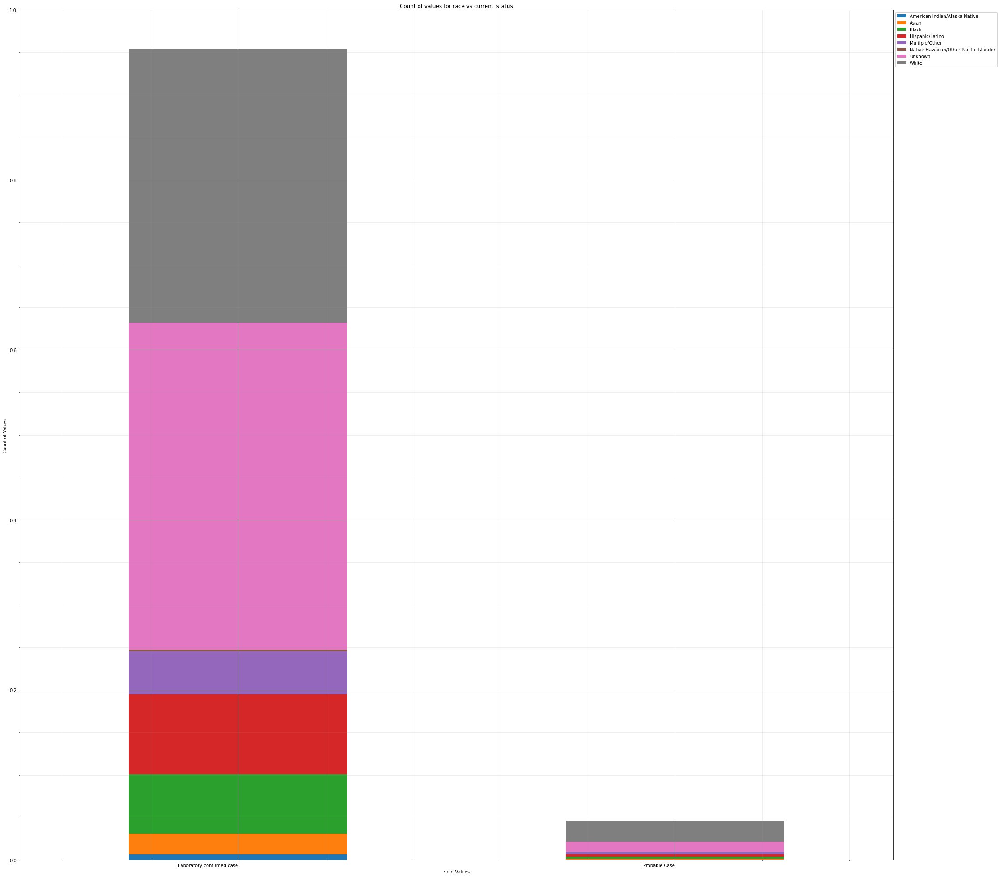



----------------------


Grouping over sex|current_status results in:



,sex,current_status,Rows,% Frequency
0,Female,Laboratory-confirmed case,4870,50.898829
1,Female,Probable Case,227,2.372492
2,Male,Laboratory-confirmed case,4178,43.666388
3,Male,Probable Case,210,2.194816
4,Unknown,Laboratory-confirmed case,78,0.815217
5,Unknown,Probable Case,5,0.052258


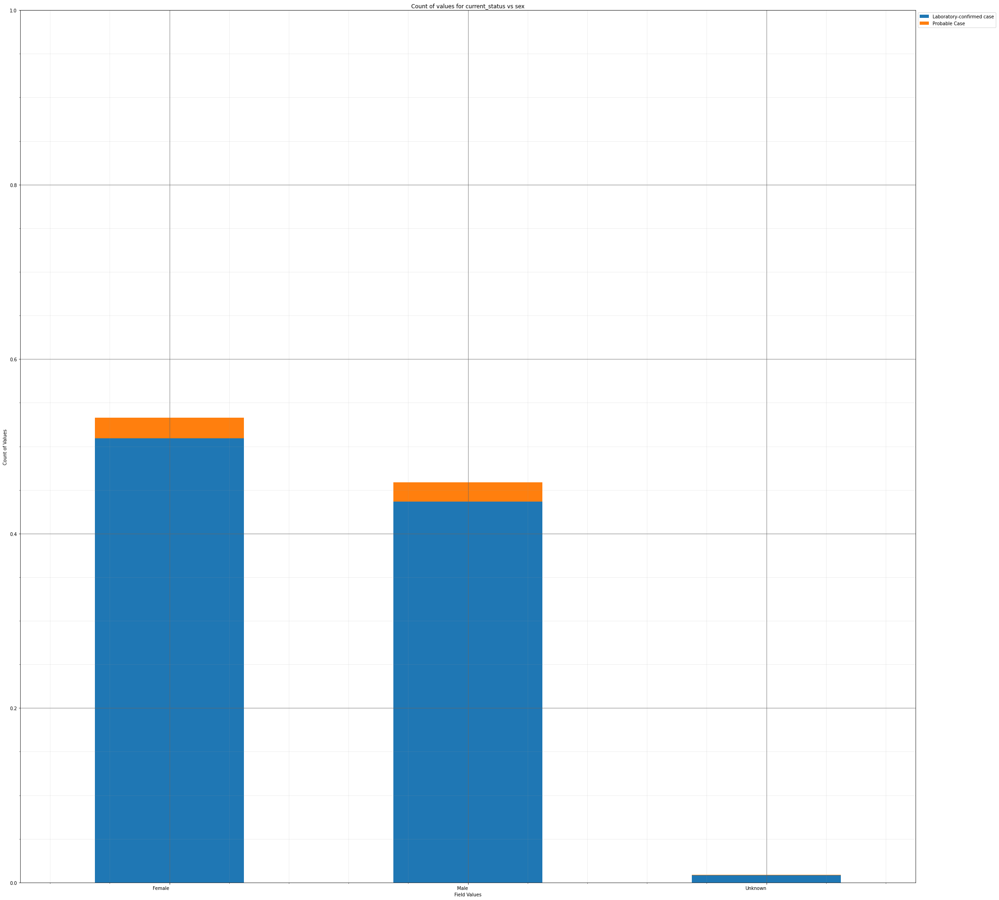



----------------------


Grouping over sex|age_group results in:



,sex,age_group,Rows,% Frequency
0,Female,0 - 9 Years,233,2.435201
1,Female,10 - 19 Years,526,5.497492
2,Female,20 - 29 Years,926,9.678094
3,Female,30 - 39 Years,806,8.423913
4,Female,40 - 49 Years,729,7.619147
5,Female,50 - 59 Years,726,7.587793
6,Female,60 - 69 Years,530,5.539298
7,Female,70 - 79 Years,316,3.302676
8,Female,80+ Years,295,3.083194
9,Female,Unknown,10,0.104515


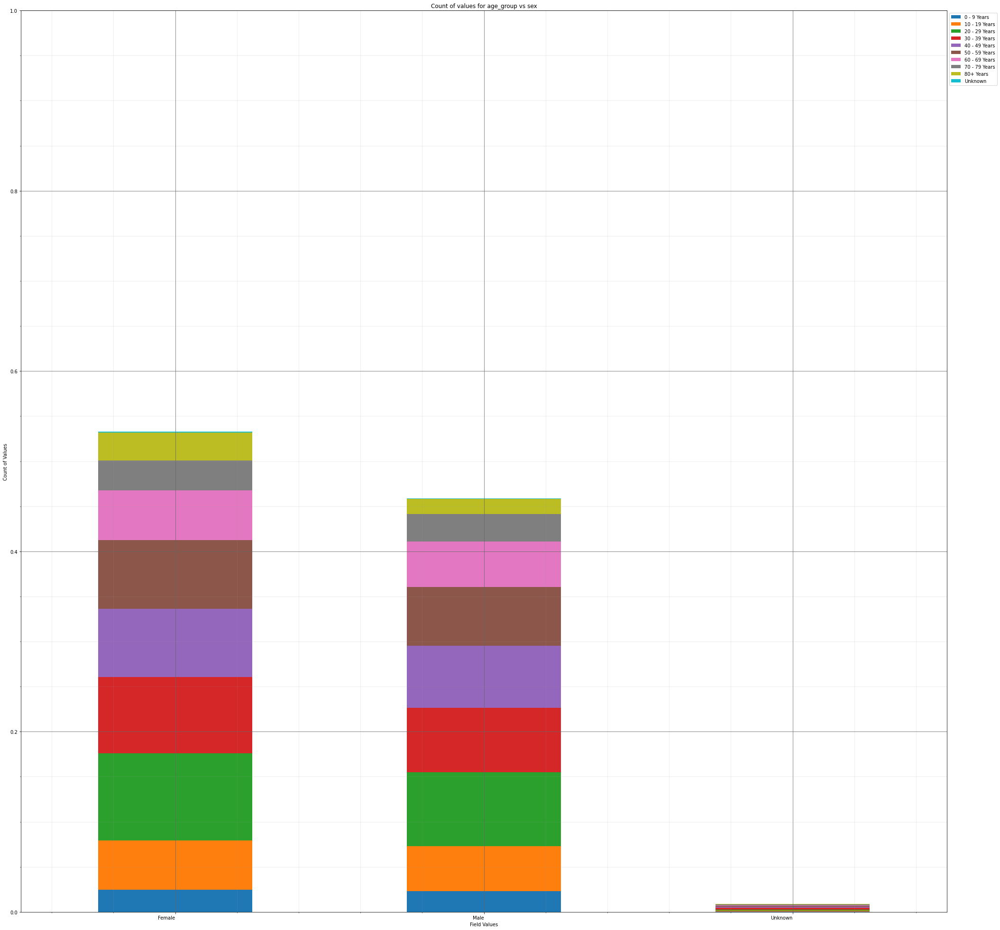



----------------------


Grouping over sex|hosp_yn results in:



,sex,hosp_yn,Rows,% Frequency
0,Female,No,2828,29.556856
1,Female,OTH,0,0.000000
2,Female,Unknown,1921,20.077341
3,Female,Yes,348,3.637124
4,Male,No,2316,24.205686
5,Male,OTH,0,0.000000
6,Male,Unknown,1721,17.987040
7,Male,Yes,351,3.668478
8,Unknown,No,27,0.282191
9,Unknown,OTH,0,0.000000


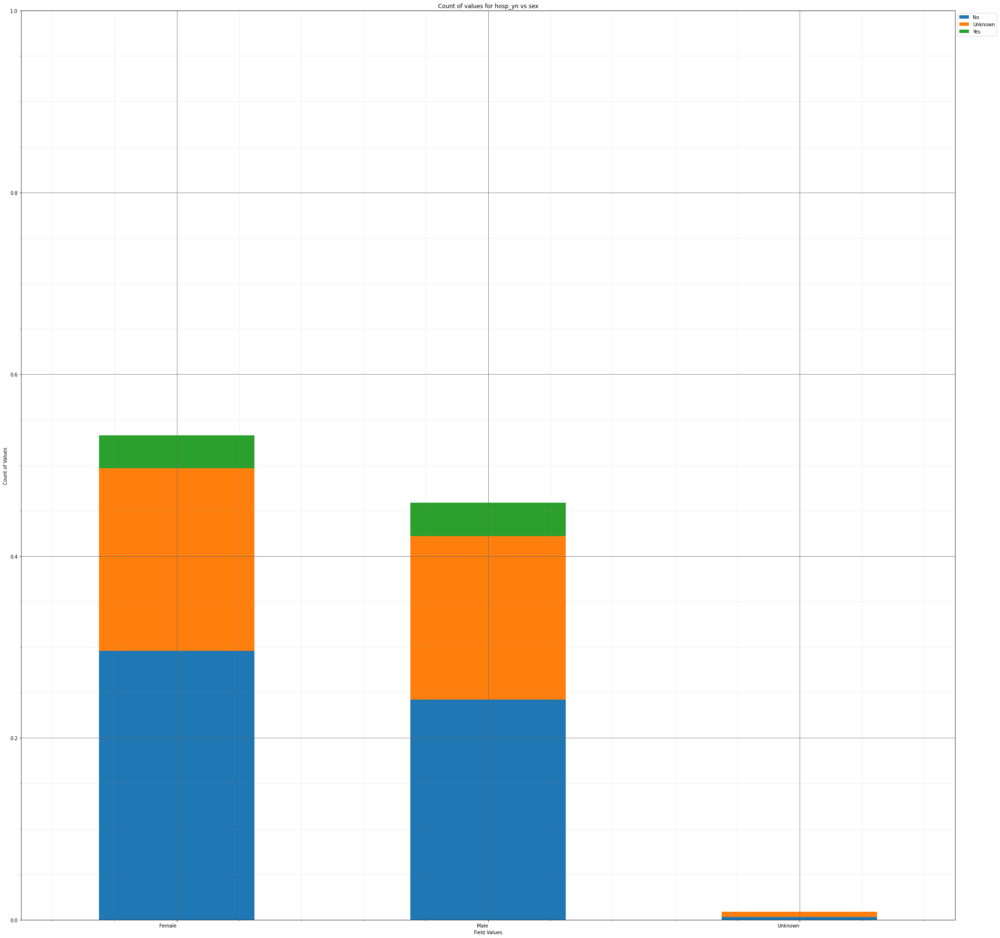



----------------------


Grouping over sex|icu_yn results in:



,sex,icu_yn,Rows,% Frequency
0,Female,No,512,5.351171
1,Female,Unknown,4543,47.481187
2,Female,Yes,42,0.438963
3,Male,No,442,4.619565
4,Male,Unknown,3897,40.729515
5,Male,Yes,49,0.512124
6,Unknown,No,4,0.041806
7,Unknown,Unknown,78,0.815217
8,Unknown,Yes,1,0.010452


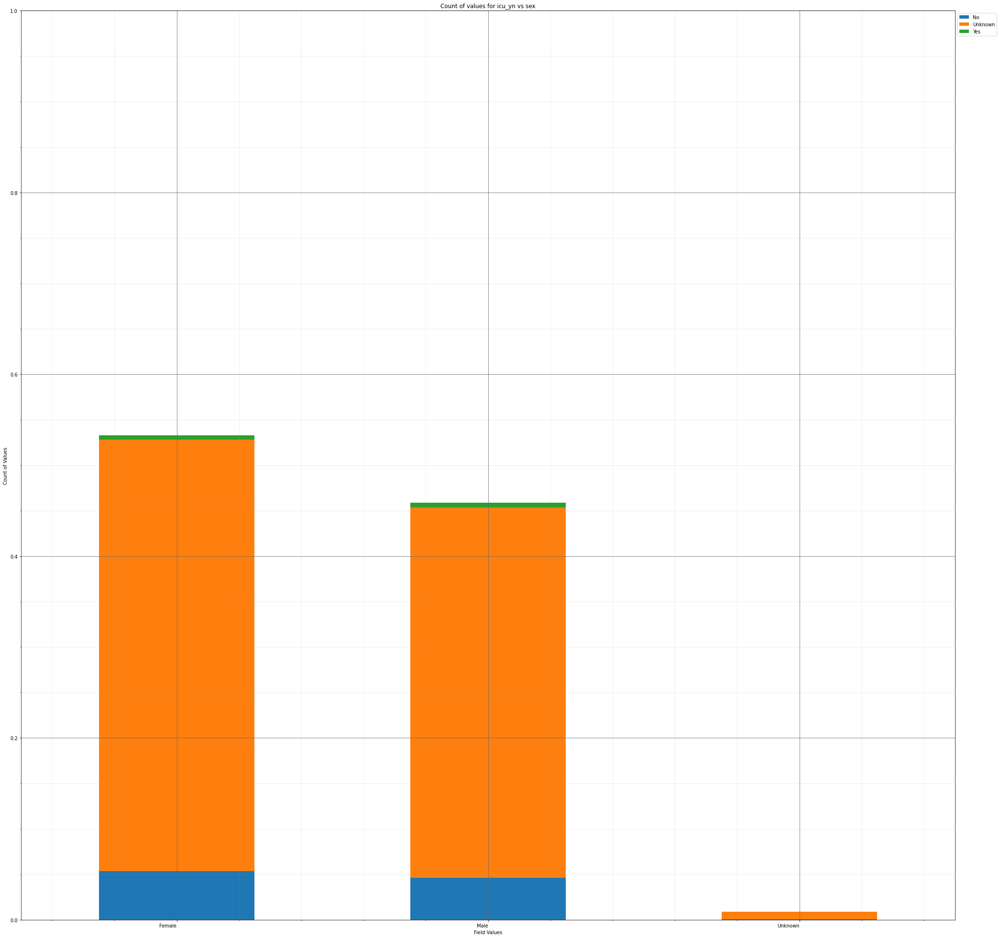



----------------------


Grouping over sex|death_yn results in:



,sex,death_yn,Rows,% Frequency
0,Female,No,4930,51.525920
1,Female,Yes,167,1.745401
2,Male,No,4223,44.136706
3,Male,Yes,165,1.724498
4,Unknown,No,80,0.836120
5,Unknown,Yes,3,0.031355


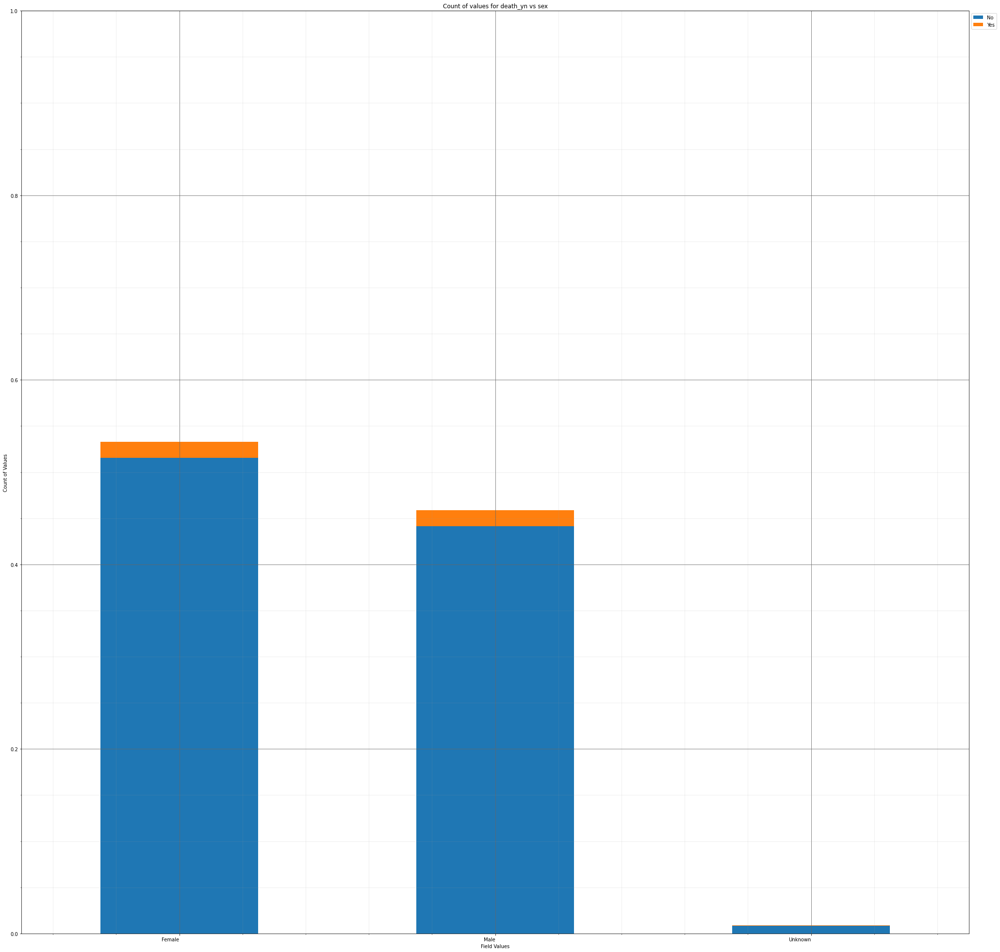



----------------------


Grouping over sex|medcond_yn results in:



,sex,medcond_yn,Rows,% Frequency
0,Female,No,508,5.309365
1,Female,Unknown,4129,43.154264
2,Female,Yes,460,4.807692
3,Male,No,416,4.347826
4,Male,Unknown,3600,37.625418
5,Male,Yes,372,3.887960
6,Unknown,No,7,0.073161
7,Unknown,Unknown,73,0.762960
8,Unknown,Yes,3,0.031355


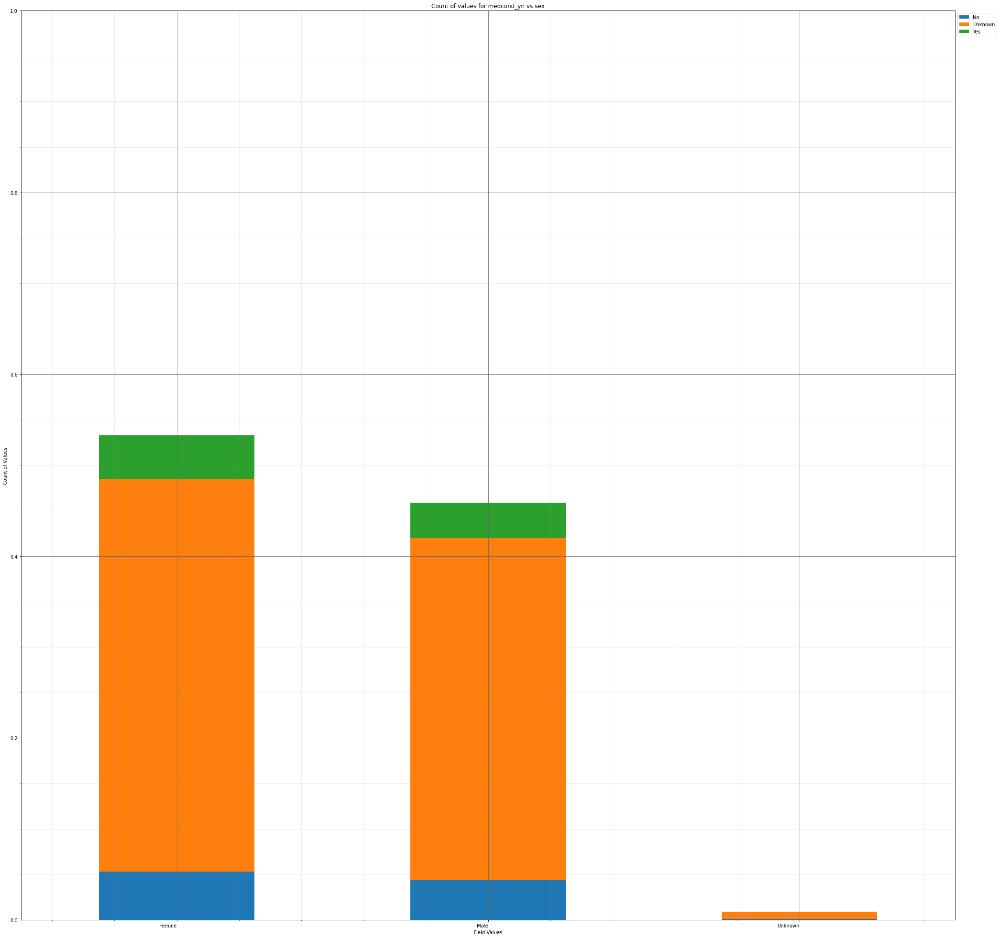



----------------------


Grouping over sex|race results in:



,sex,race,Rows,% Frequency
0,Female,American Indian/Alaska Native,34,0.355351
1,Female,Asian,122,1.275084
2,Female,Black,411,4.295569
3,Female,Hispanic/Latino,510,5.330268
4,Female,Multiple/Other,262,2.738294
5,Female,Native Hawaiian/Other Pacific Islander,14,0.146321
6,Female,Unknown,1962,20.505853
7,Female,White,1782,18.624582
8,Male,American Indian/Alaska Native,32,0.334448
9,Male,Asian,116,1.212375


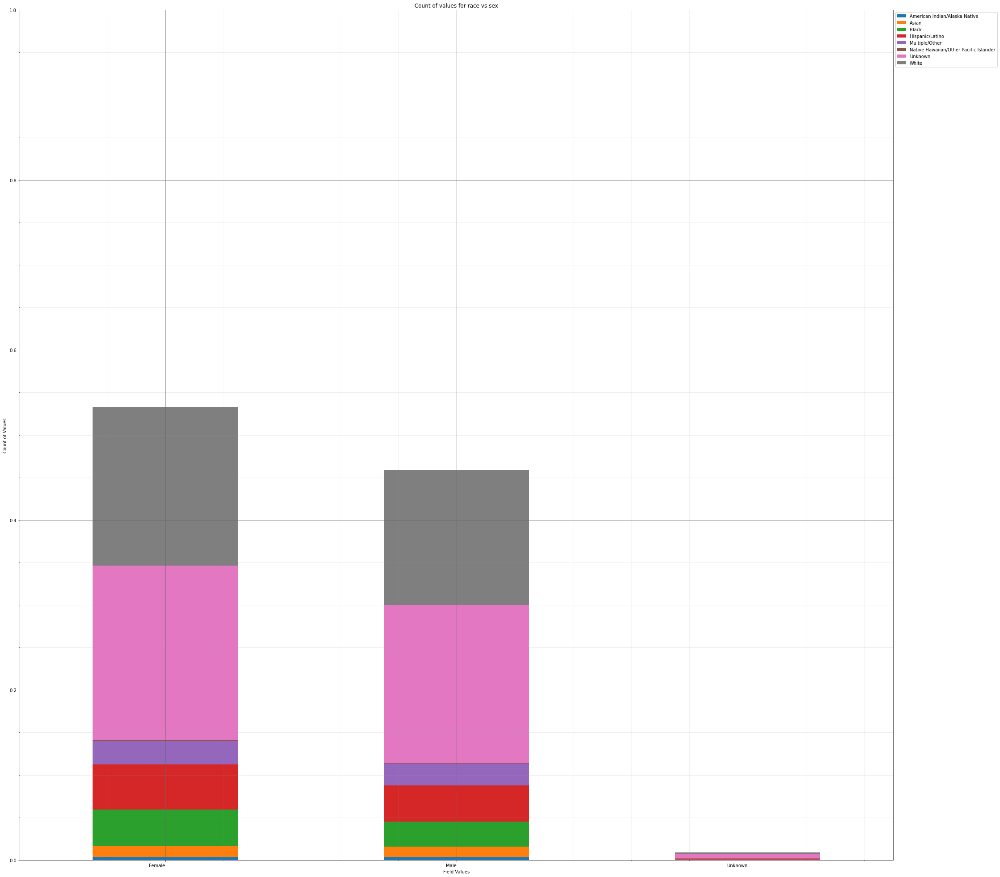



----------------------


Grouping over age_group|current_status results in:



,age_group,current_status,Rows,% Frequency
0,0 - 9 Years,Laboratory-confirmed case,430,4.494147
1,0 - 9 Years,Probable Case,28,0.292642
2,10 - 19 Years,Laboratory-confirmed case,963,10.064799
3,10 - 19 Years,Probable Case,54,0.564381
4,20 - 29 Years,Laboratory-confirmed case,1650,17.244983
5,20 - 29 Years,Probable Case,70,0.731605
6,30 - 39 Years,Laboratory-confirmed case,1451,15.165134
7,30 - 39 Years,Probable Case,54,0.564381
8,40 - 49 Years,Laboratory-confirmed case,1342,14.025920
9,40 - 49 Years,Probable Case,56,0.585284


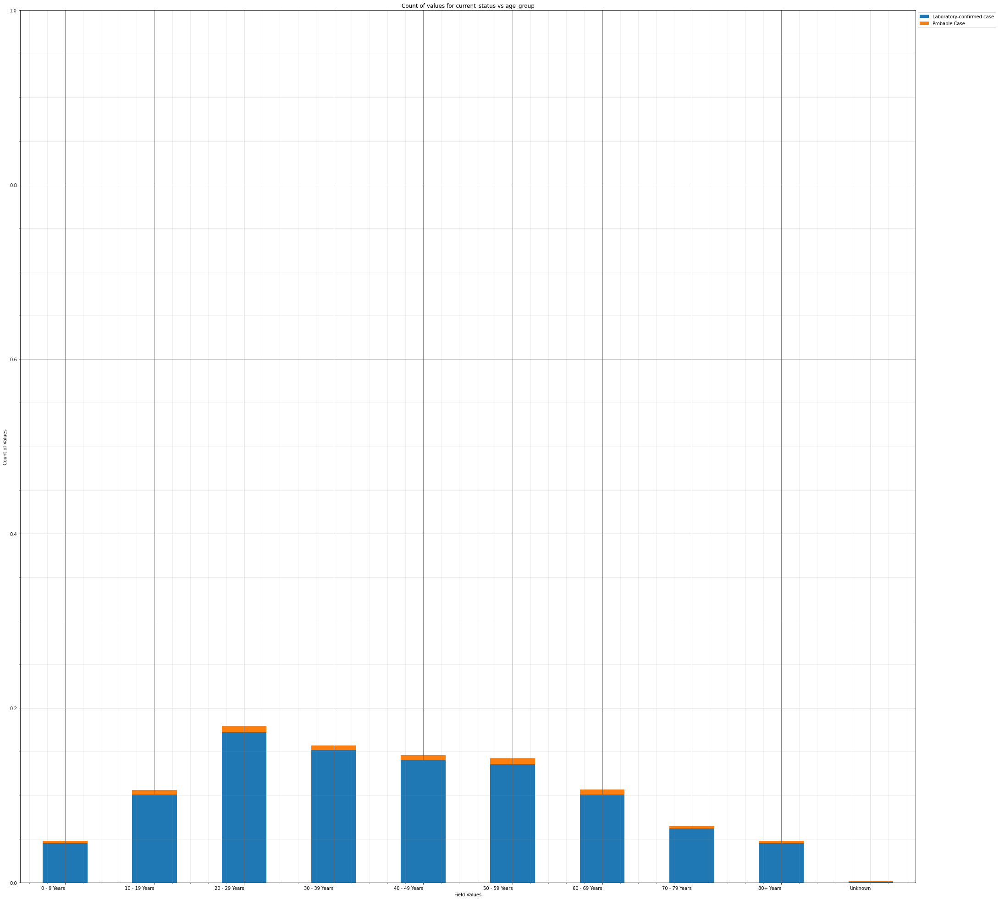



----------------------


Grouping over age_group|sex results in:



,age_group,sex,Rows,% Frequency
0,0 - 9 Years,Female,233,2.435201
1,0 - 9 Years,Male,221,2.309783
2,0 - 9 Years,Unknown,4,0.041806
3,10 - 19 Years,Female,526,5.497492
4,10 - 19 Years,Male,479,5.006271
5,10 - 19 Years,Unknown,12,0.125418
6,20 - 29 Years,Female,926,9.678094
7,20 - 29 Years,Male,785,8.204431
8,20 - 29 Years,Unknown,9,0.094064
9,30 - 39 Years,Female,806,8.423913


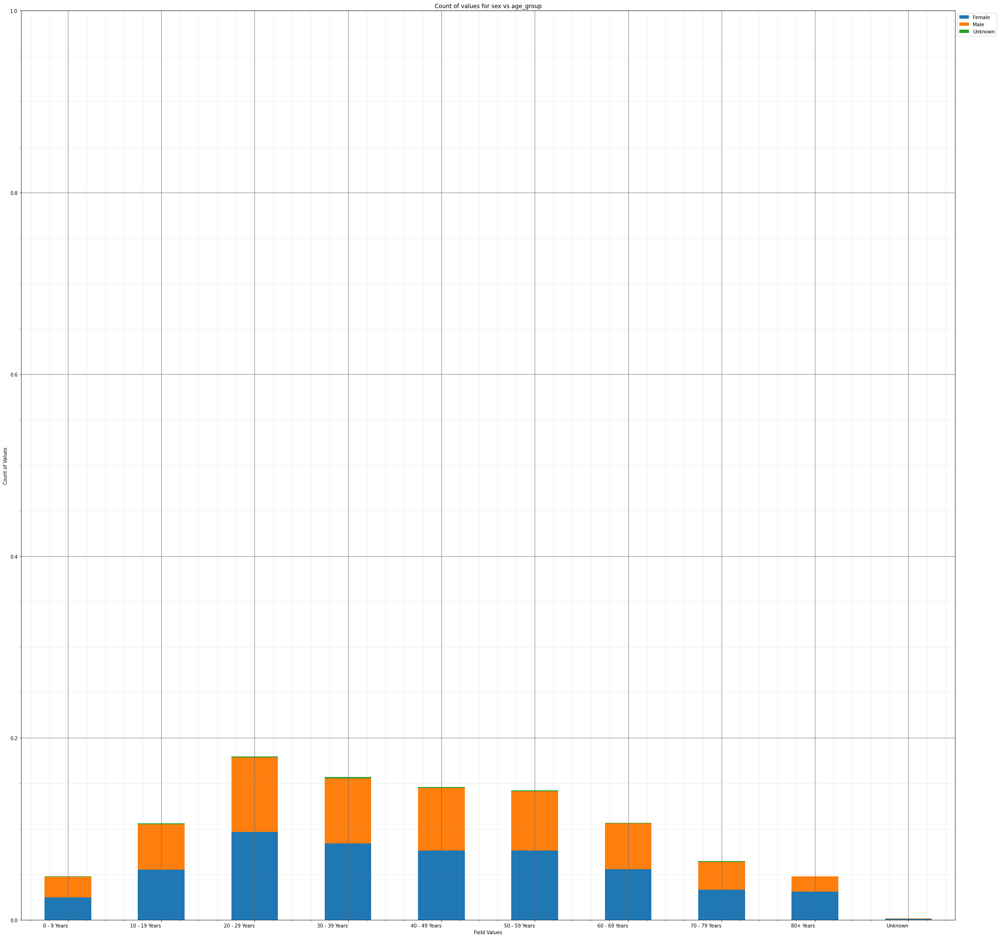



----------------------


Grouping over age_group|hosp_yn results in:



,age_group,hosp_yn,Rows,% Frequency
0,0 - 9 Years,No,259,2.706940
1,0 - 9 Years,OTH,0,0.000000
2,0 - 9 Years,Unknown,191,1.996237
3,0 - 9 Years,Yes,8,0.083612
4,10 - 19 Years,No,608,6.354515
5,10 - 19 Years,OTH,0,0.000000
6,10 - 19 Years,Unknown,399,4.170151
7,10 - 19 Years,Yes,10,0.104515
8,20 - 29 Years,No,976,10.200669
9,20 - 29 Years,OTH,0,0.000000


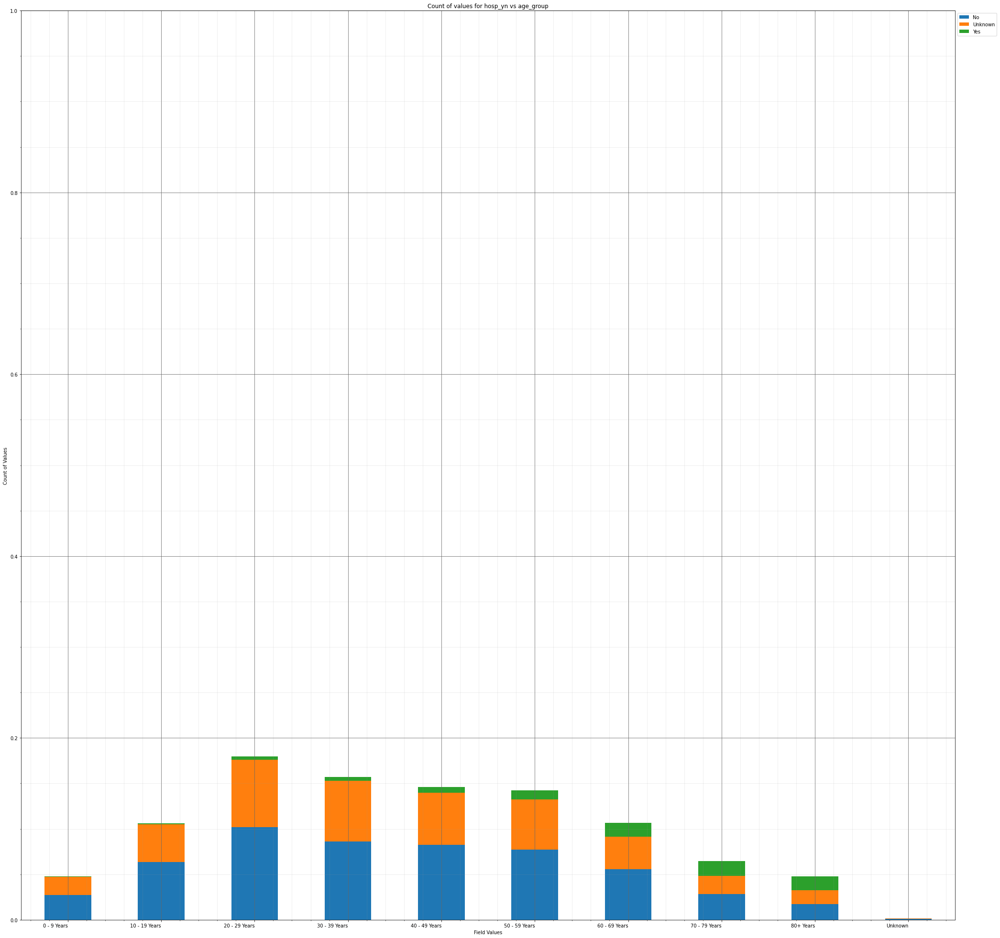



----------------------


Grouping over age_group|icu_yn results in:



,age_group,icu_yn,Rows,% Frequency
0,0 - 9 Years,No,32,0.334448
1,0 - 9 Years,Unknown,426,4.452341
2,0 - 9 Years,Yes,0,0.000000
3,10 - 19 Years,No,116,1.212375
4,10 - 19 Years,Unknown,899,9.395903
5,10 - 19 Years,Yes,2,0.020903
6,20 - 29 Years,No,168,1.755853
7,20 - 29 Years,Unknown,1552,16.220736
8,20 - 29 Years,Yes,0,0.000000
9,30 - 39 Years,No,164,1.714047


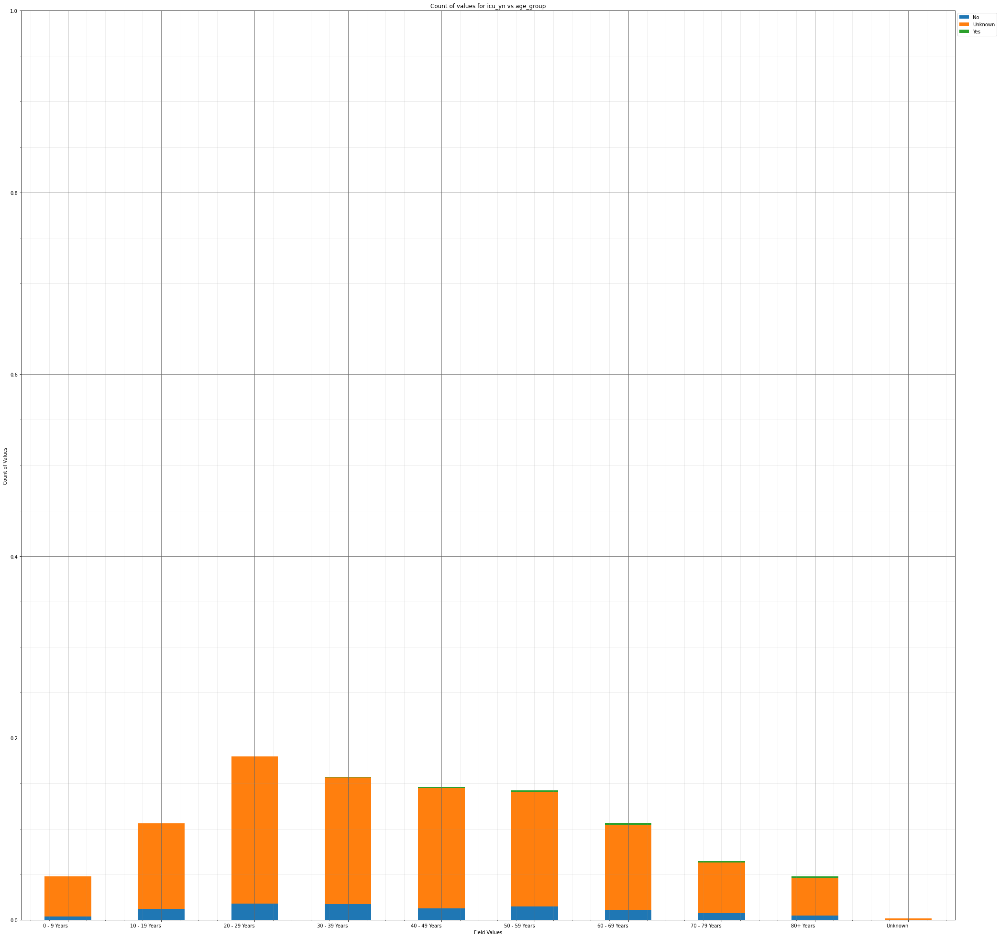



----------------------


Grouping over age_group|death_yn results in:



,age_group,death_yn,Rows,% Frequency
0,0 - 9 Years,No,458,4.786789
1,0 - 9 Years,Yes,0,0.000000
2,10 - 19 Years,No,1017,10.629181
3,10 - 19 Years,Yes,0,0.000000
4,20 - 29 Years,No,1720,17.976589
5,20 - 29 Years,Yes,0,0.000000
6,30 - 39 Years,No,1503,15.708612
7,30 - 39 Years,Yes,2,0.020903
8,40 - 49 Years,No,1386,14.485786
9,40 - 49 Years,Yes,12,0.125418


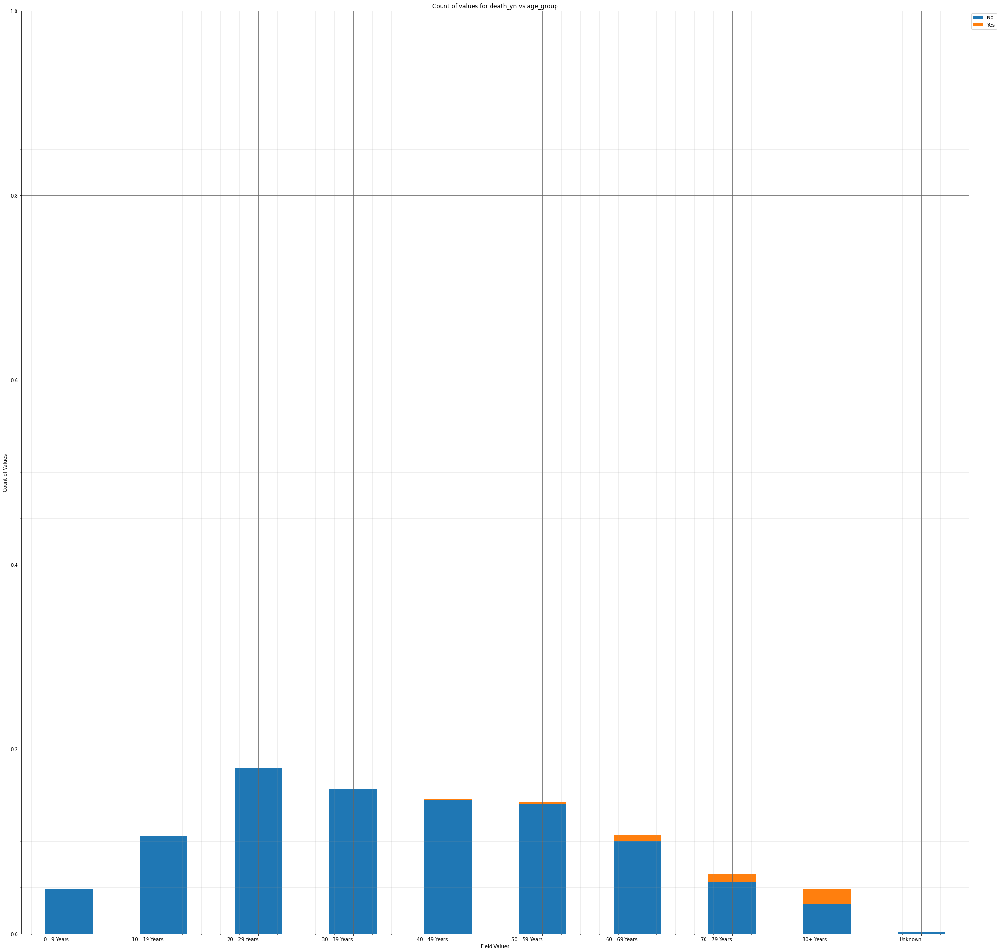



----------------------


Grouping over age_group|medcond_yn results in:



,age_group,medcond_yn,Rows,% Frequency
0,0 - 9 Years,No,52,0.543478
1,0 - 9 Years,Unknown,393,4.107441
2,0 - 9 Years,Yes,13,0.135870
3,10 - 19 Years,No,143,1.494565
4,10 - 19 Years,Unknown,841,8.789716
5,10 - 19 Years,Yes,33,0.344900
6,20 - 29 Years,No,222,2.320234
7,20 - 29 Years,Unknown,1415,14.788880
8,20 - 29 Years,Yes,83,0.867475
9,30 - 39 Years,No,172,1.797659


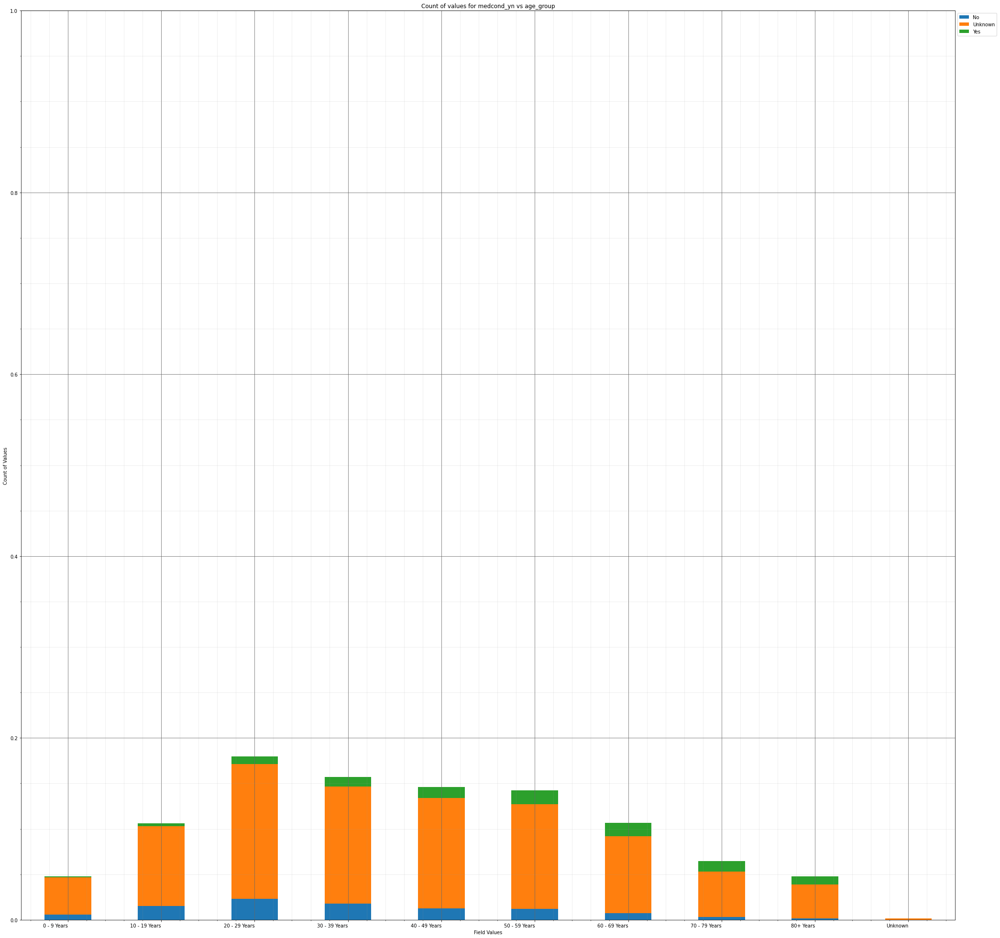



----------------------


Grouping over age_group|race results in:



,age_group,race,Rows,% Frequency
0,0 - 9 Years,American Indian/Alaska Native,4,0.041806
1,0 - 9 Years,Asian,12,0.125418
2,0 - 9 Years,Black,29,0.303094
3,0 - 9 Years,Hispanic/Latino,53,0.553930
4,0 - 9 Years,Multiple/Other,37,0.386706
...,...,...,...,...
75,Unknown,Hispanic/Latino,0,0.000000
76,Unknown,Multiple/Other,2,0.020903
77,Unknown,Native Hawaiian/Other Pacific Islander,0,0.000000
78,Unknown,Unknown,11,0.114967


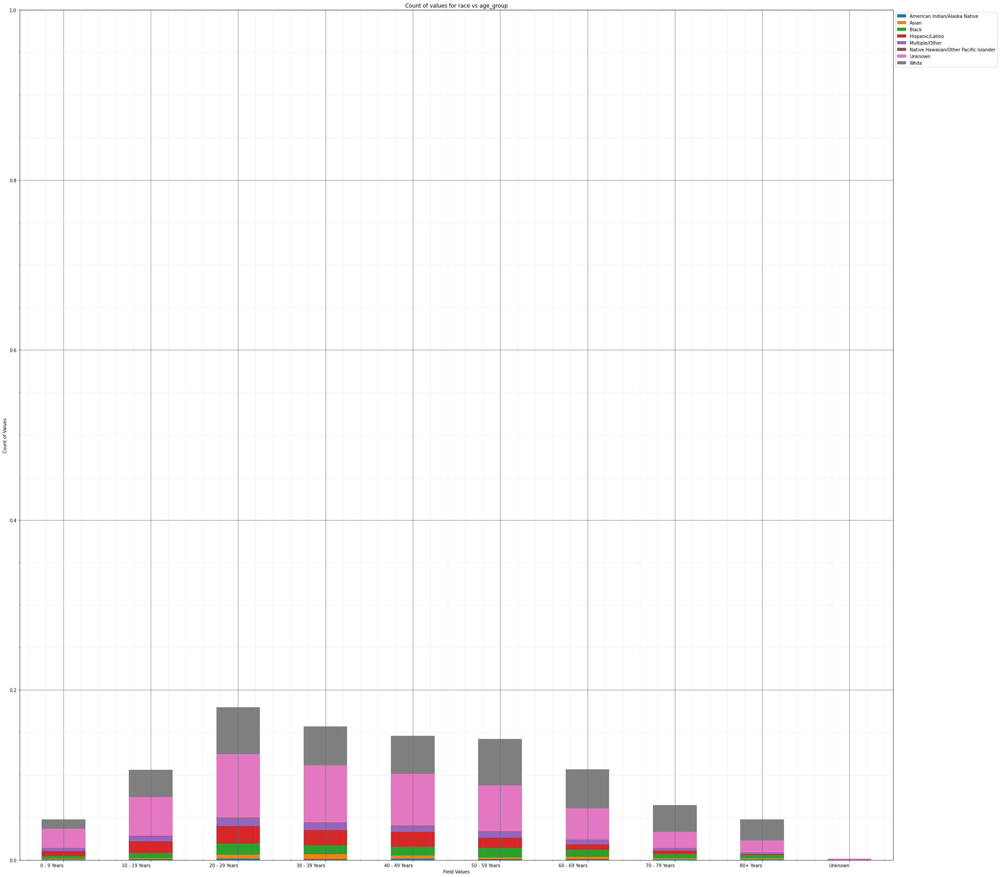



----------------------


Grouping over hosp_yn|current_status results in:



,hosp_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,4826,50.438963
1,No,Probable Case,345,3.605769
2,OTH,Laboratory-confirmed case,0,0.000000
3,OTH,Probable Case,0,0.000000
4,Unknown,Laboratory-confirmed case,3621,37.844900
5,Unknown,Probable Case,76,0.794314
6,Yes,Laboratory-confirmed case,679,7.096572
7,Yes,Probable Case,21,0.219482


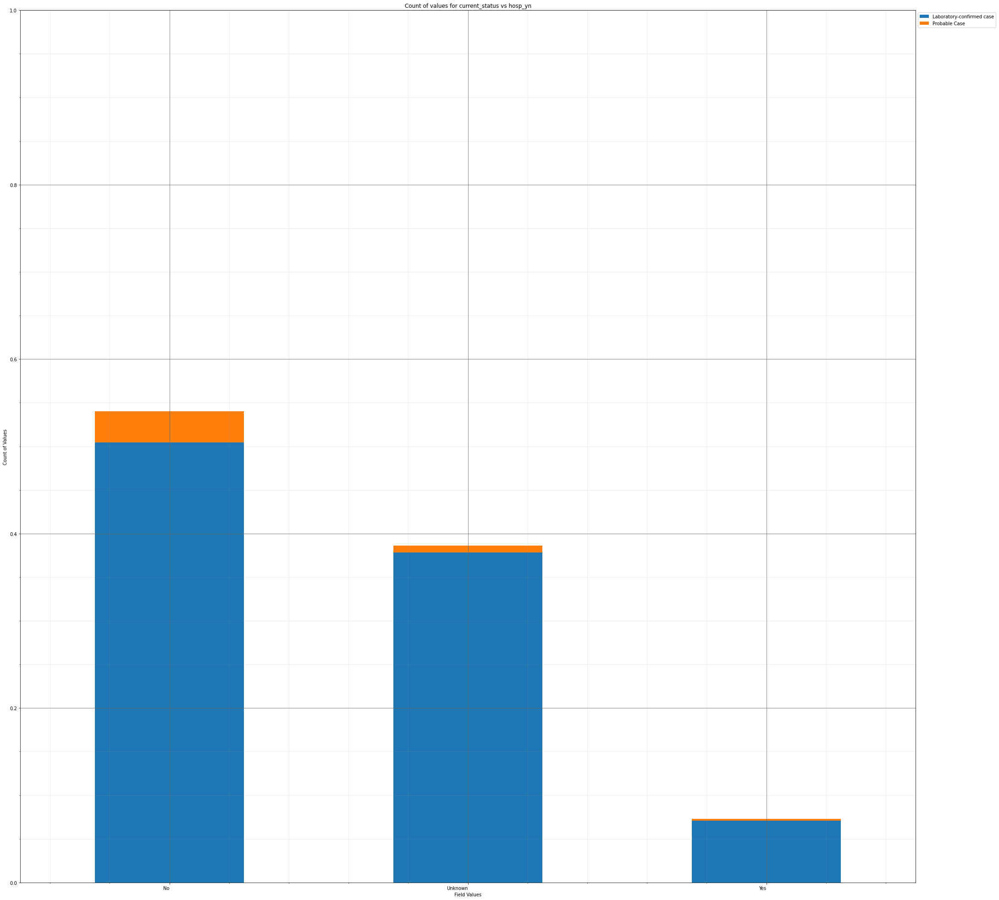



----------------------


Grouping over hosp_yn|sex results in:



,hosp_yn,sex,Rows,% Frequency
0,No,Female,2828,29.556856
1,No,Male,2316,24.205686
2,No,Unknown,27,0.282191
3,OTH,Female,0,0.000000
4,OTH,Male,0,0.000000
5,OTH,Unknown,0,0.000000
6,Unknown,Female,1921,20.077341
7,Unknown,Male,1721,17.987040
8,Unknown,Unknown,55,0.574833
9,Yes,Female,348,3.637124


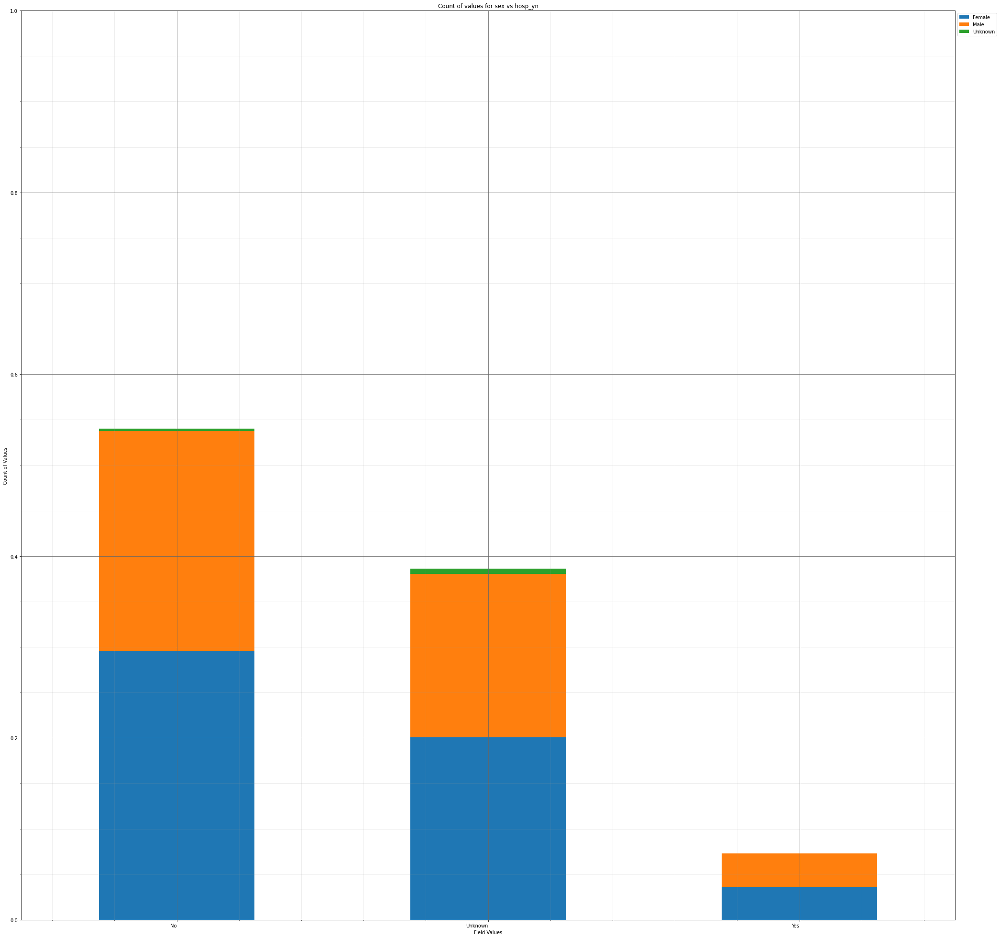



----------------------


Grouping over hosp_yn|age_group results in:



,hosp_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,259,2.706940
1,No,10 - 19 Years,608,6.354515
2,No,20 - 29 Years,976,10.200669
3,No,30 - 39 Years,823,8.601589
4,No,40 - 49 Years,788,8.235786
5,No,50 - 59 Years,740,7.734114
6,No,60 - 69 Years,532,5.560201
7,No,70 - 79 Years,271,2.832358
8,No,80+ Years,164,1.714047
9,No,Unknown,10,0.104515


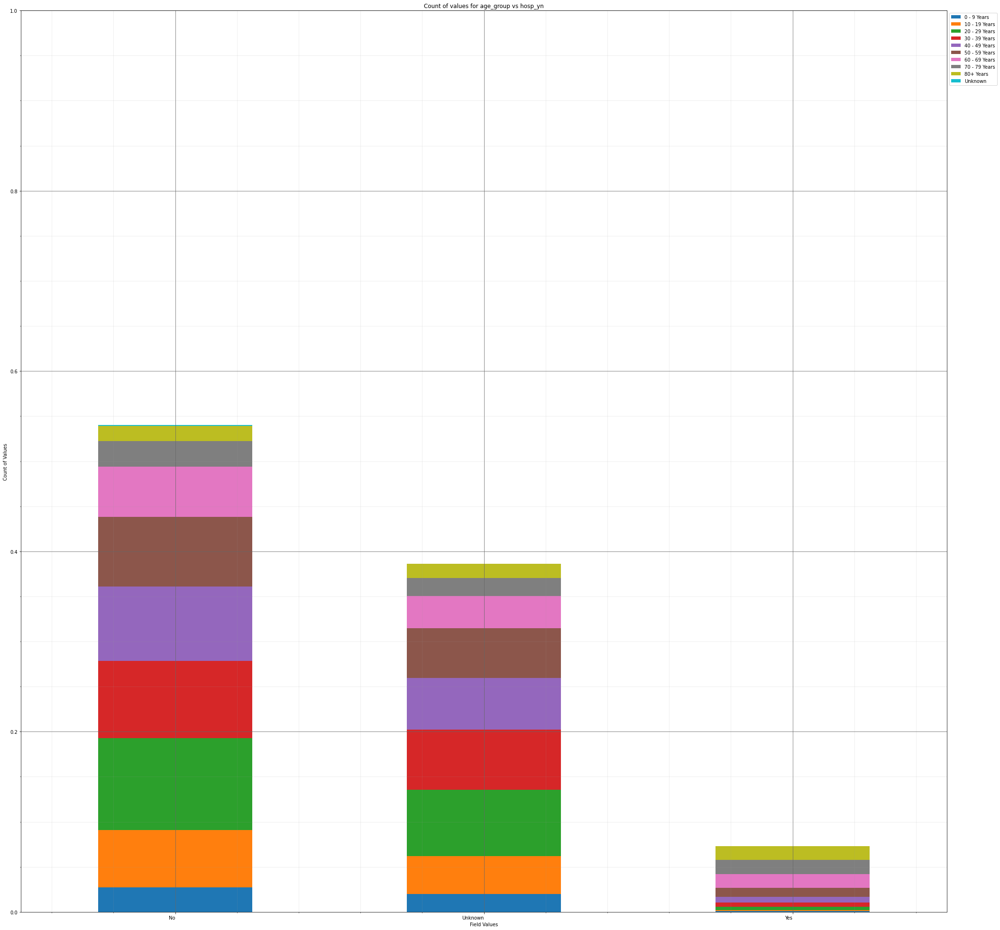



----------------------


Grouping over hosp_yn|icu_yn results in:



,hosp_yn,icu_yn,Rows,% Frequency
0,No,No,799,8.350753
1,No,Unknown,4372,45.693980
2,No,Yes,0,0.000000
3,OTH,No,0,0.000000
4,OTH,Unknown,0,0.000000
5,OTH,Yes,0,0.000000
6,Unknown,No,27,0.282191
7,Unknown,Unknown,3670,38.357023
8,Unknown,Yes,0,0.000000
9,Yes,No,132,1.379599


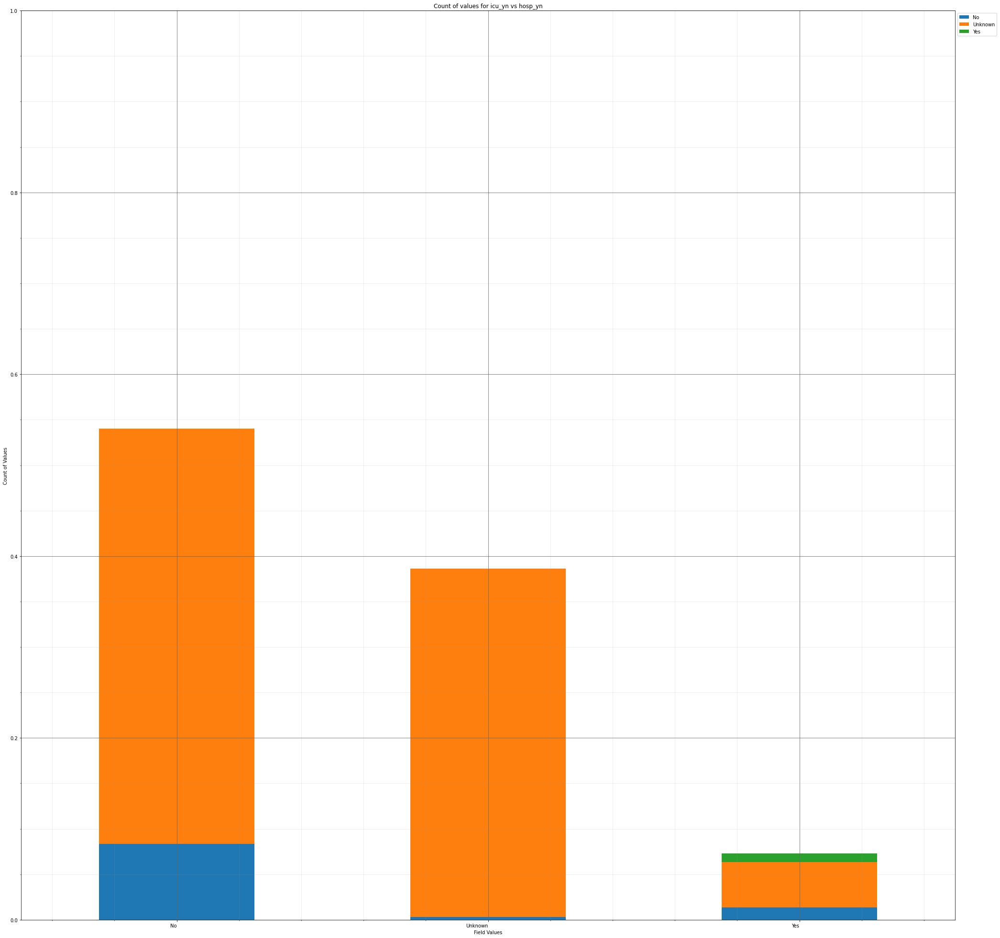



----------------------


Grouping over hosp_yn|death_yn results in:



,hosp_yn,death_yn,Rows,% Frequency
0,No,No,5123,53.543060
1,No,Yes,48,0.501672
2,OTH,No,0,0.000000
3,OTH,Yes,0,0.000000
4,Unknown,No,3616,37.792642
5,Unknown,Yes,81,0.846572
6,Yes,No,494,5.163043
7,Yes,Yes,206,2.153010


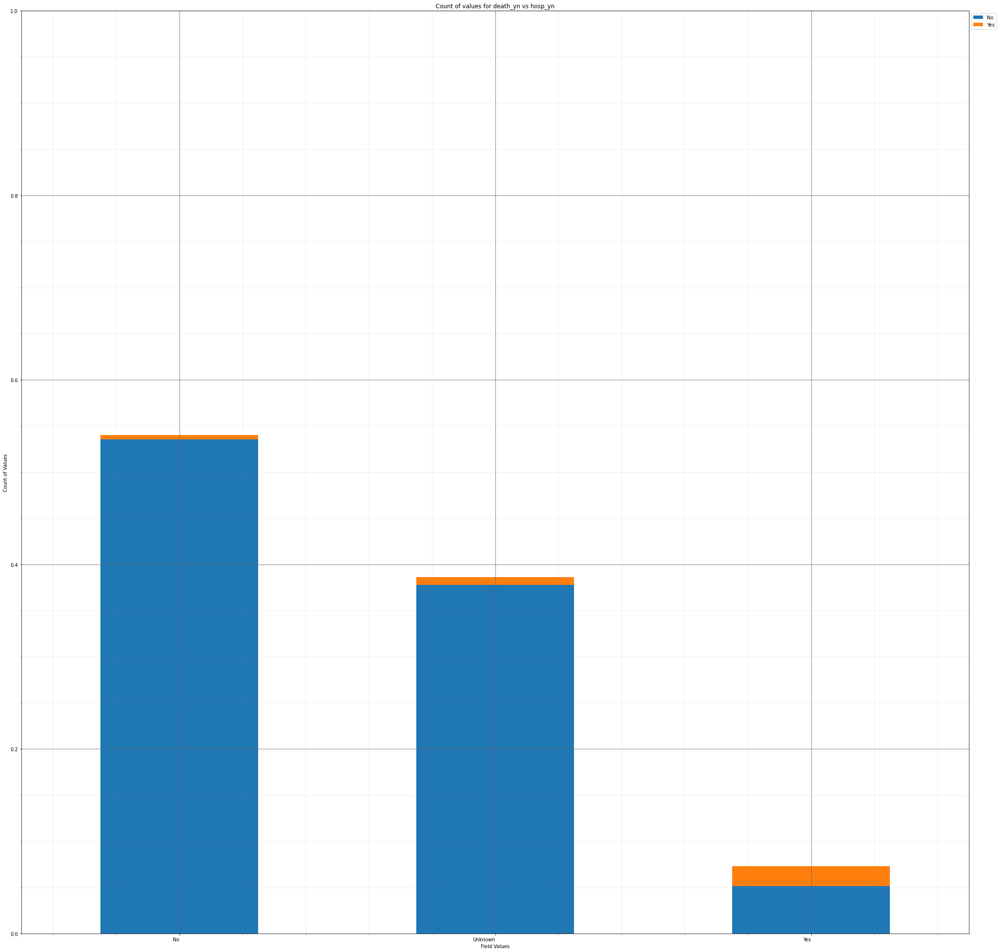



----------------------


Grouping over hosp_yn|medcond_yn results in:



,hosp_yn,medcond_yn,Rows,% Frequency
0,No,No,695,7.263796
1,No,Unknown,3921,40.980351
2,No,Yes,555,5.800585
3,OTH,No,0,0.000000
4,OTH,Unknown,0,0.000000
5,OTH,Yes,0,0.000000
6,Unknown,No,202,2.111204
7,Unknown,Unknown,3392,35.451505
8,Unknown,Yes,103,1.076505
9,Yes,No,34,0.355351


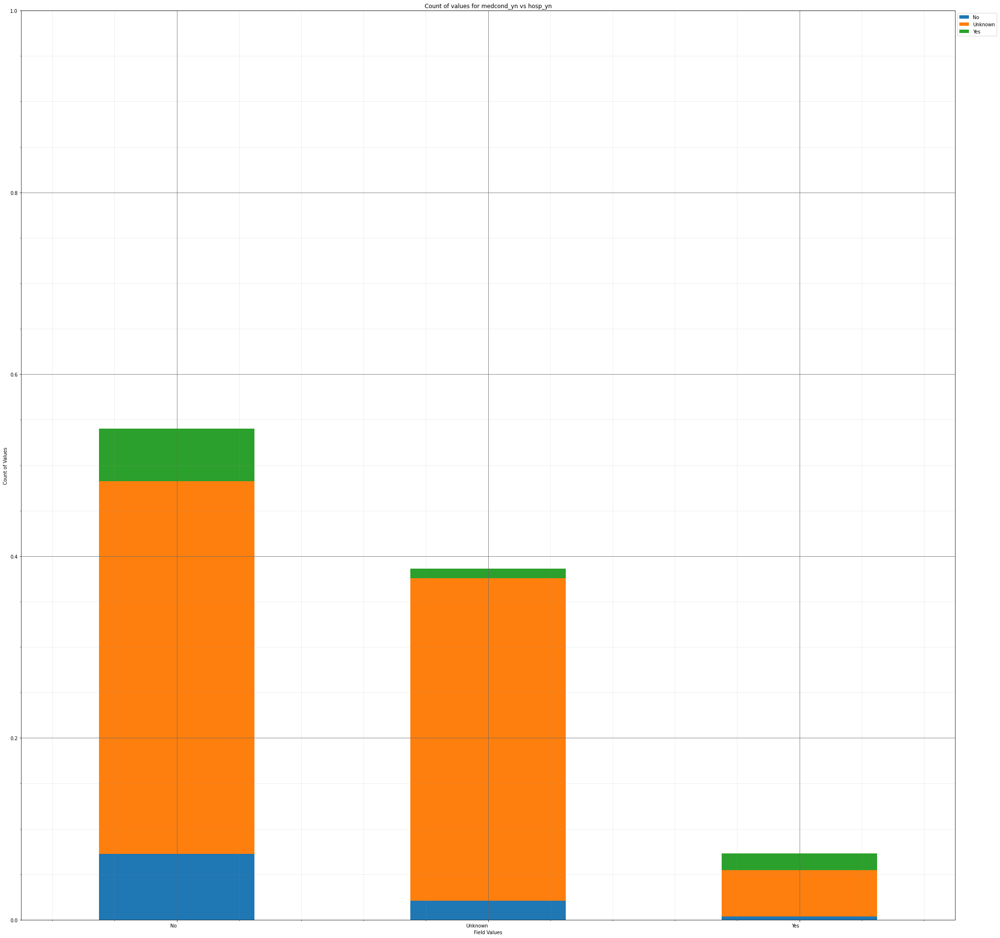



----------------------


Grouping over hosp_yn|race results in:



,hosp_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,39,0.407609
1,No,Asian,115,1.201923
2,No,Black,438,4.577759
3,No,Hispanic/Latino,705,7.368311
4,No,Multiple/Other,267,2.790552
5,No,Native Hawaiian/Other Pacific Islander,12,0.125418
6,No,Unknown,1394,14.569398
7,No,White,2201,23.003763
8,OTH,American Indian/Alaska Native,0,0.000000
9,OTH,Asian,0,0.000000


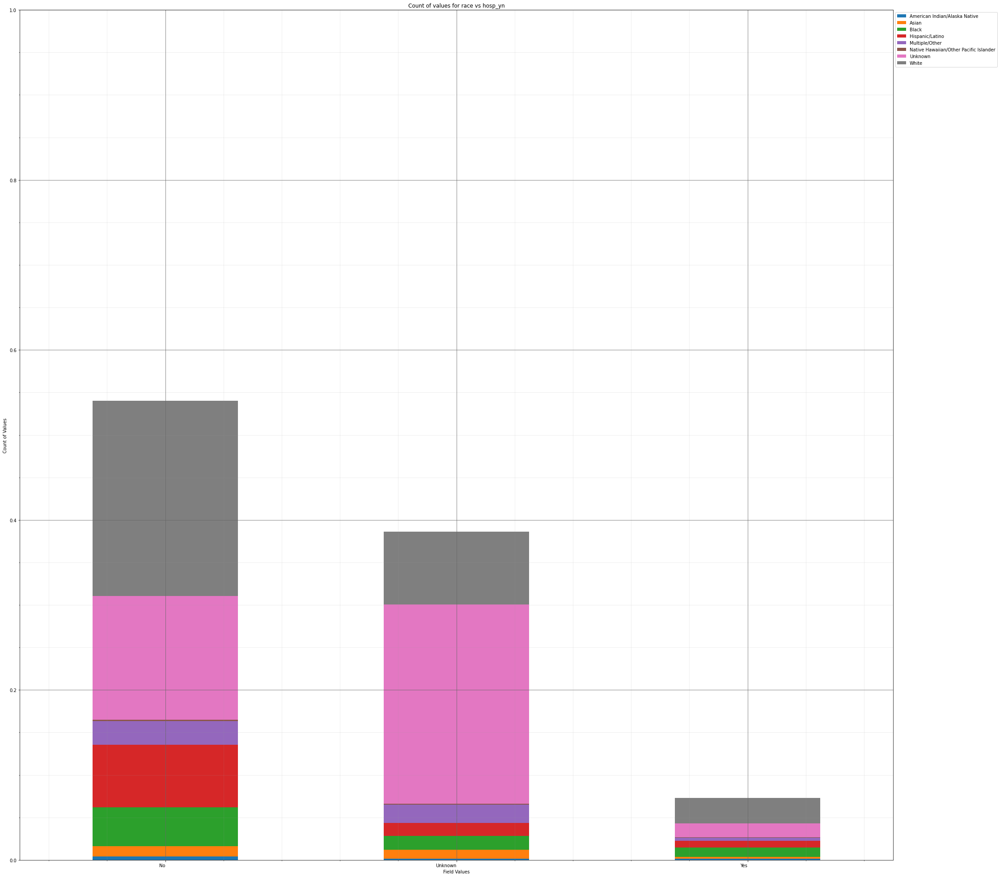



----------------------


Grouping over icu_yn|current_status results in:



,icu_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,905,9.458612
1,No,Probable Case,53,0.553930
2,Unknown,Laboratory-confirmed case,8129,84.960284
3,Unknown,Probable Case,389,4.065635
4,Yes,Laboratory-confirmed case,92,0.961538
5,Yes,Probable Case,0,0.000000


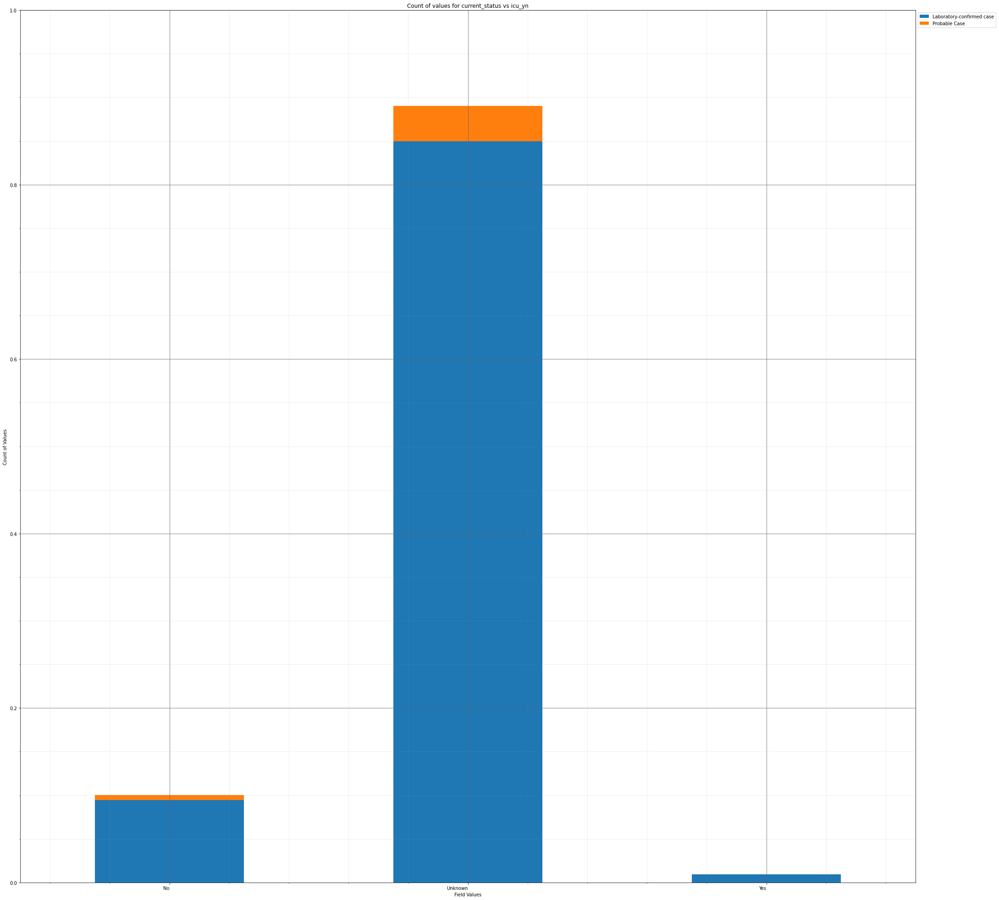



----------------------


Grouping over icu_yn|sex results in:



,icu_yn,sex,Rows,% Frequency
0,No,Female,512,5.351171
1,No,Male,442,4.619565
2,No,Unknown,4,0.041806
3,Unknown,Female,4543,47.481187
4,Unknown,Male,3897,40.729515
5,Unknown,Unknown,78,0.815217
6,Yes,Female,42,0.438963
7,Yes,Male,49,0.512124
8,Yes,Unknown,1,0.010452


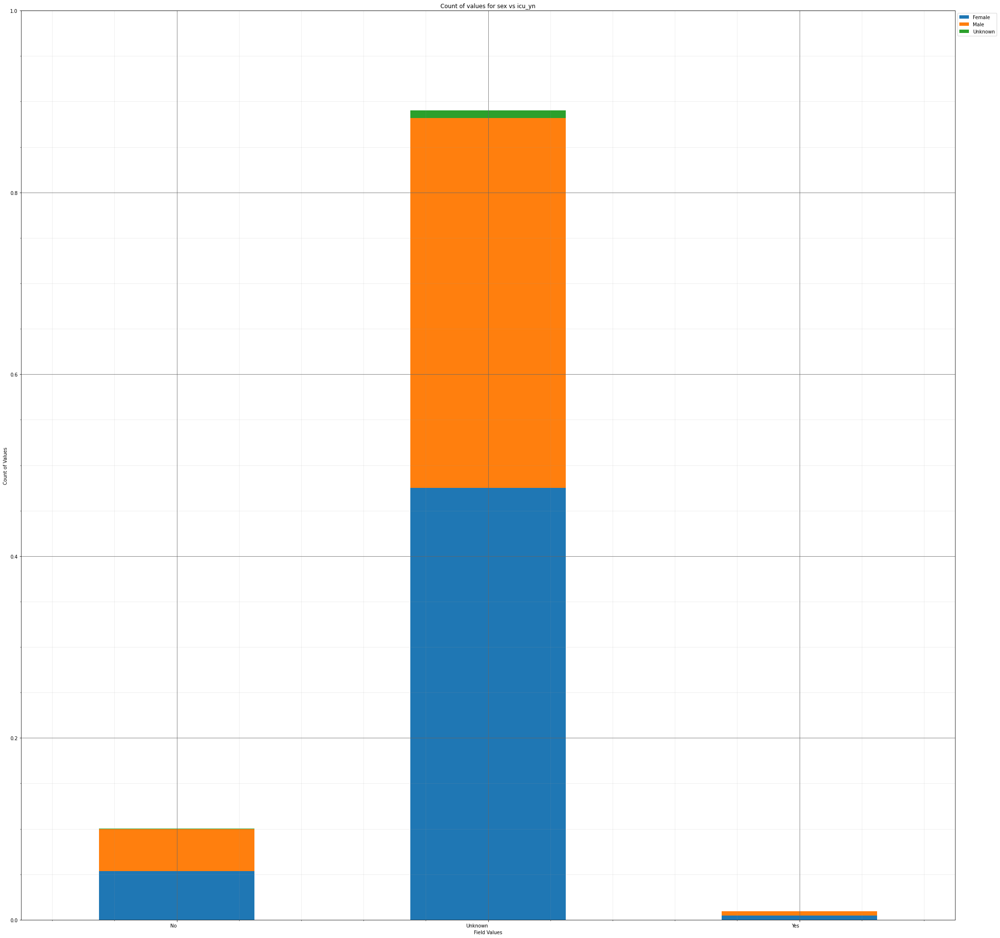



----------------------


Grouping over icu_yn|age_group results in:



,icu_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,32,0.334448
1,No,10 - 19 Years,116,1.212375
2,No,20 - 29 Years,168,1.755853
3,No,30 - 39 Years,164,1.714047
4,No,40 - 49 Years,120,1.254181
5,No,50 - 59 Years,140,1.463211
6,No,60 - 69 Years,103,1.076505
7,No,70 - 79 Years,69,0.721154
8,No,80+ Years,46,0.480769
9,No,Unknown,0,0.000000


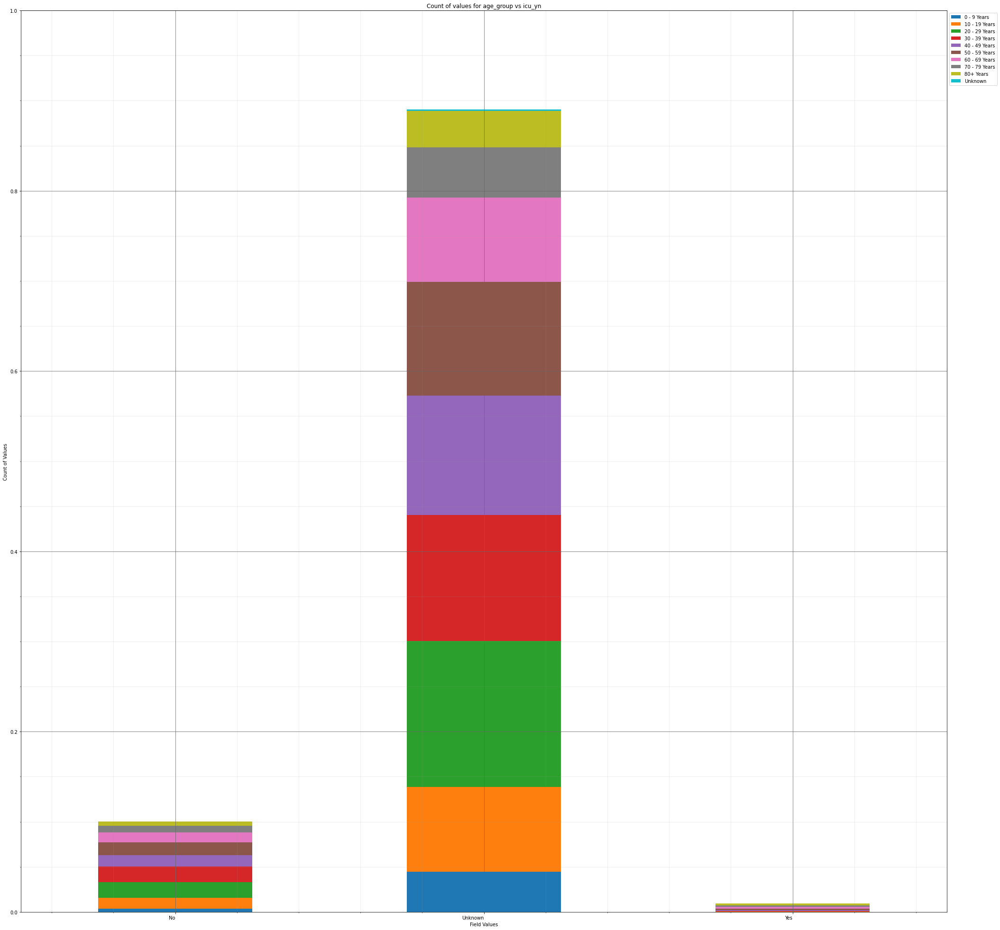



----------------------


Grouping over icu_yn|hosp_yn results in:



,icu_yn,hosp_yn,Rows,% Frequency
0,No,No,799,8.350753
1,No,OTH,0,0.000000
2,No,Unknown,27,0.282191
3,No,Yes,132,1.379599
4,Unknown,No,4372,45.693980
5,Unknown,OTH,0,0.000000
6,Unknown,Unknown,3670,38.357023
7,Unknown,Yes,476,4.974916
8,Yes,No,0,0.000000
9,Yes,OTH,0,0.000000


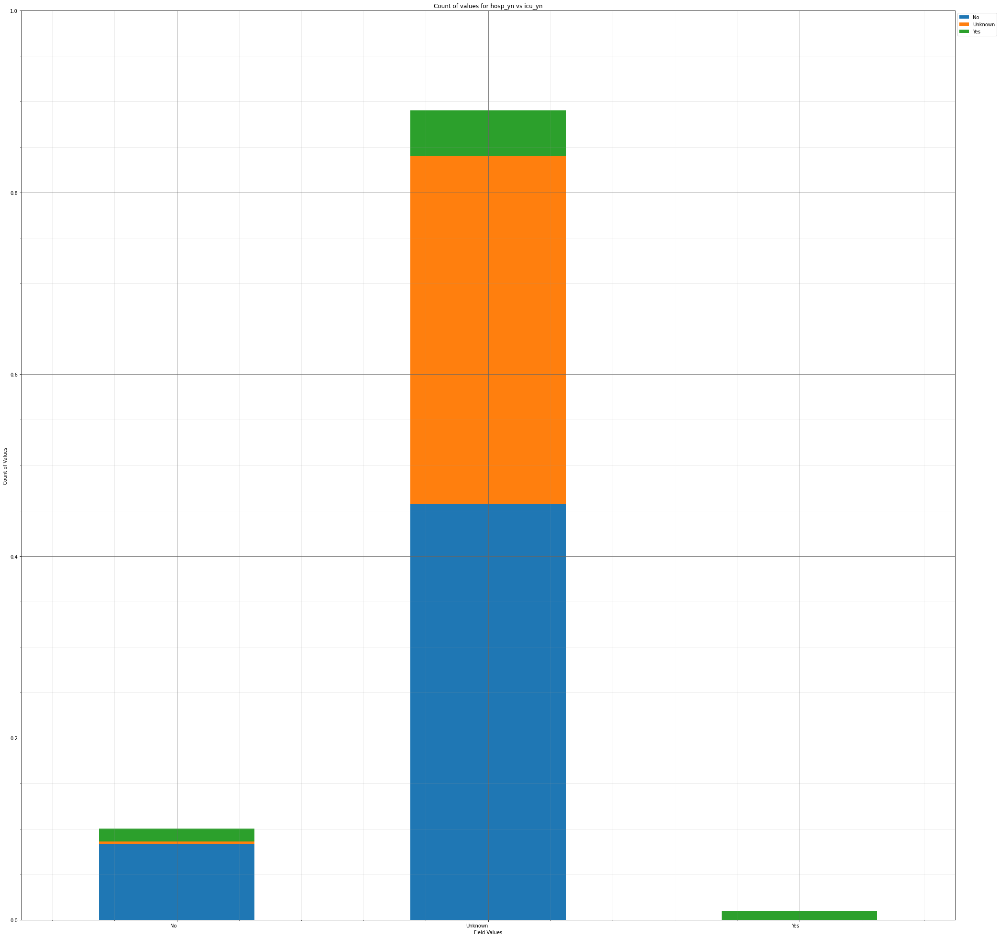



----------------------


Grouping over icu_yn|death_yn results in:



,icu_yn,death_yn,Rows,% Frequency
0,No,No,929,9.709448
1,No,Yes,29,0.303094
2,Unknown,No,8261,86.339883
3,Unknown,Yes,257,2.686037
4,Yes,No,43,0.449415
5,Yes,Yes,49,0.512124


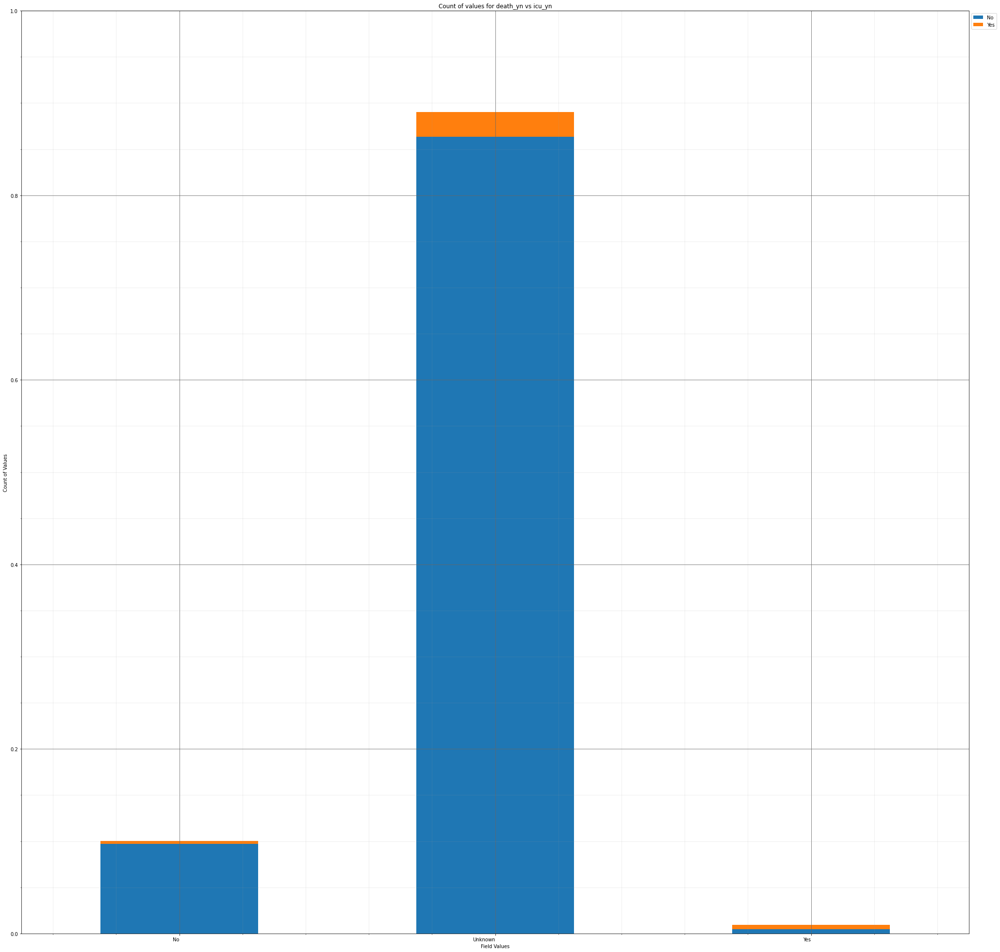



----------------------


Grouping over icu_yn|medcond_yn results in:



,icu_yn,medcond_yn,Rows,% Frequency
0,No,No,402,4.201505
1,No,Unknown,250,2.612876
2,No,Yes,306,3.198161
3,Unknown,No,522,5.455686
4,Unknown,Unknown,7510,78.490803
5,Unknown,Yes,486,5.079431
6,Yes,No,7,0.073161
7,Yes,Unknown,42,0.438963
8,Yes,Yes,43,0.449415


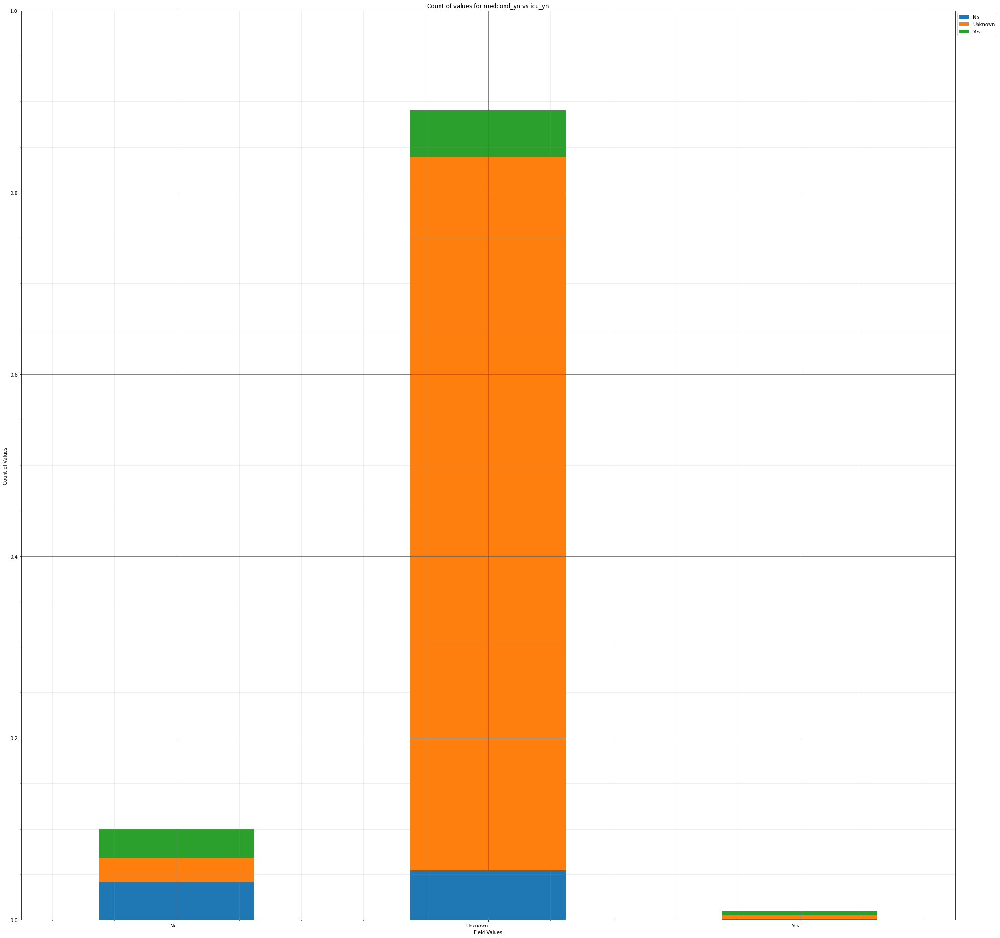



----------------------


Grouping over icu_yn|race results in:



,icu_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,7,0.073161
1,No,Asian,14,0.146321
2,No,Black,68,0.710702
3,No,Hispanic/Latino,159,1.661789
4,No,Multiple/Other,32,0.334448
5,No,Native Hawaiian/Other Pacific Islander,6,0.062709
6,No,Unknown,182,1.902174
7,No,White,490,5.121237
8,Unknown,American Indian/Alaska Native,57,0.595736
9,Unknown,Asian,223,2.330686


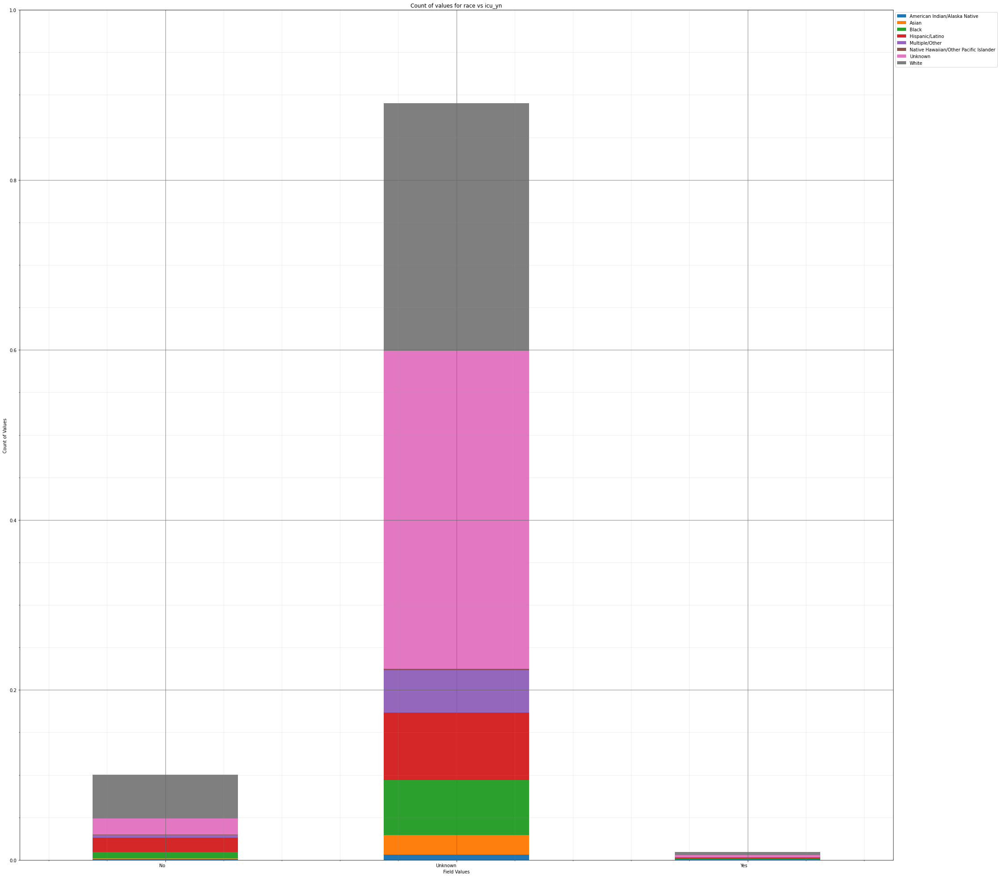



----------------------


Grouping over death_yn|current_status results in:



,death_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,8818,92.161371
1,No,Probable Case,415,4.337375
2,Yes,Laboratory-confirmed case,308,3.219064
3,Yes,Probable Case,27,0.282191


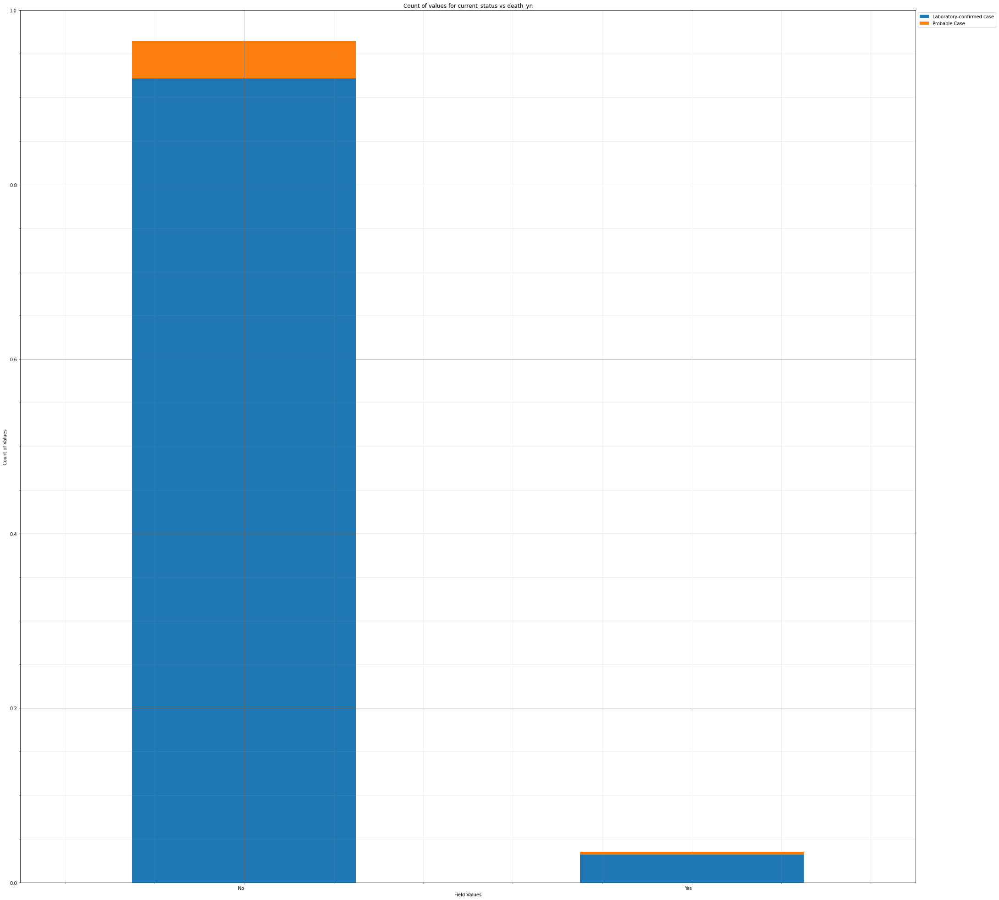



----------------------


Grouping over death_yn|sex results in:



,death_yn,sex,Rows,% Frequency
0,No,Female,4930,51.525920
1,No,Male,4223,44.136706
2,No,Unknown,80,0.836120
3,Yes,Female,167,1.745401
4,Yes,Male,165,1.724498
5,Yes,Unknown,3,0.031355


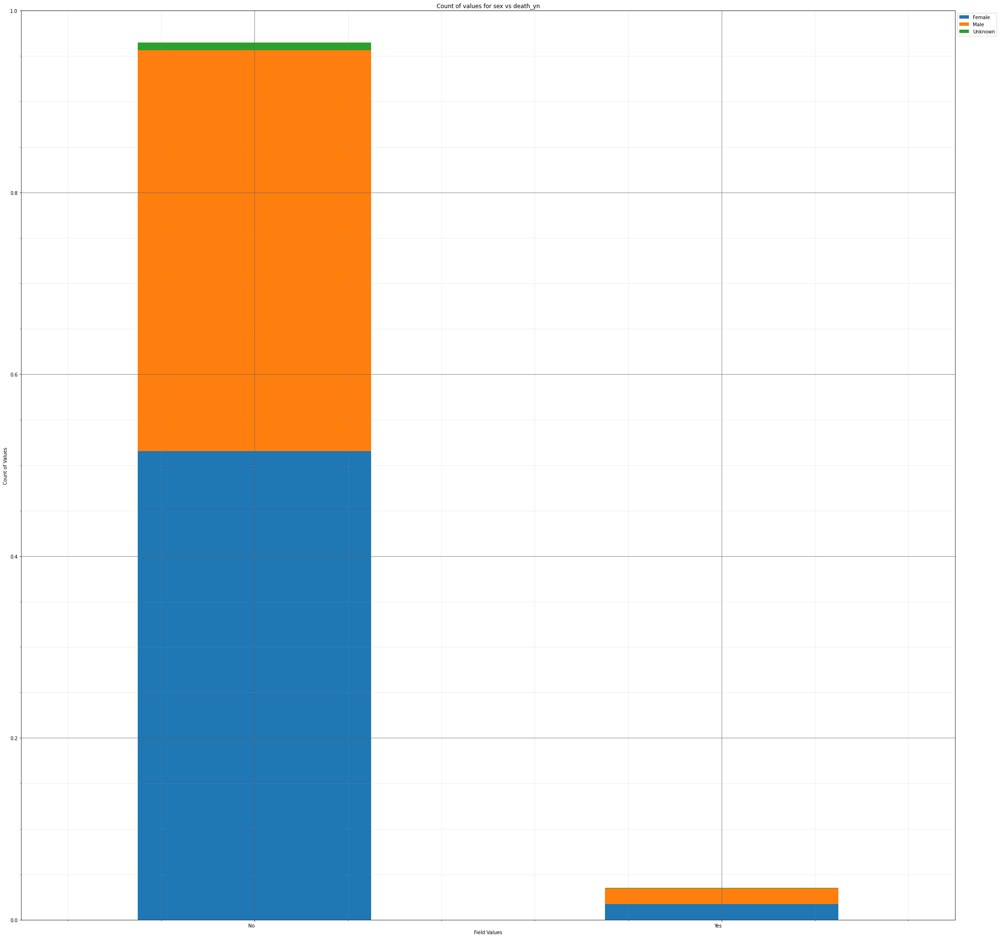



----------------------


Grouping over death_yn|age_group results in:



,death_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,458,4.786789
1,No,10 - 19 Years,1017,10.629181
2,No,20 - 29 Years,1720,17.976589
3,No,30 - 39 Years,1503,15.708612
4,No,40 - 49 Years,1386,14.485786
5,No,50 - 59 Years,1342,14.025920
6,No,60 - 69 Years,956,9.991639
7,No,70 - 79 Years,532,5.560201
8,No,80+ Years,306,3.198161
9,No,Unknown,13,0.135870


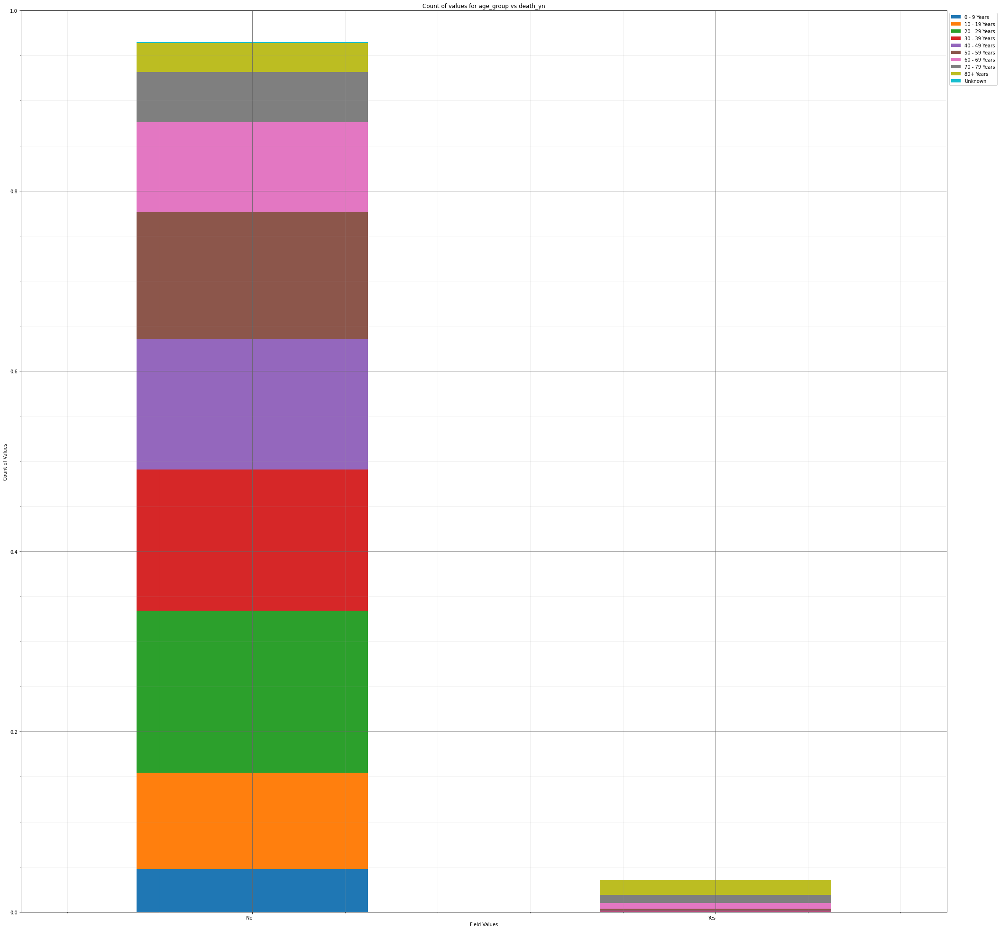



----------------------


Grouping over death_yn|hosp_yn results in:



,death_yn,hosp_yn,Rows,% Frequency
0,No,No,5123,53.543060
1,No,OTH,0,0.000000
2,No,Unknown,3616,37.792642
3,No,Yes,494,5.163043
4,Yes,No,48,0.501672
5,Yes,OTH,0,0.000000
6,Yes,Unknown,81,0.846572
7,Yes,Yes,206,2.153010


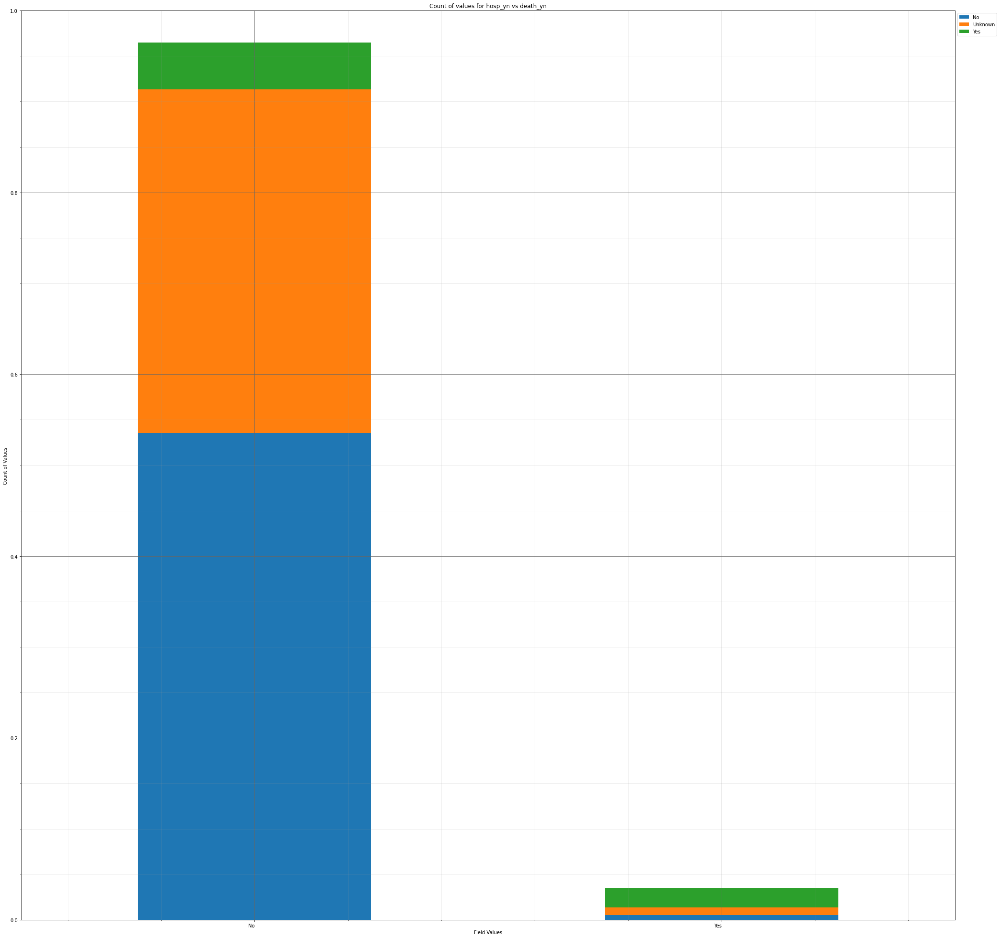



----------------------


Grouping over death_yn|icu_yn results in:



,death_yn,icu_yn,Rows,% Frequency
0,No,No,929,9.709448
1,No,Unknown,8261,86.339883
2,No,Yes,43,0.449415
3,Yes,No,29,0.303094
4,Yes,Unknown,257,2.686037
5,Yes,Yes,49,0.512124


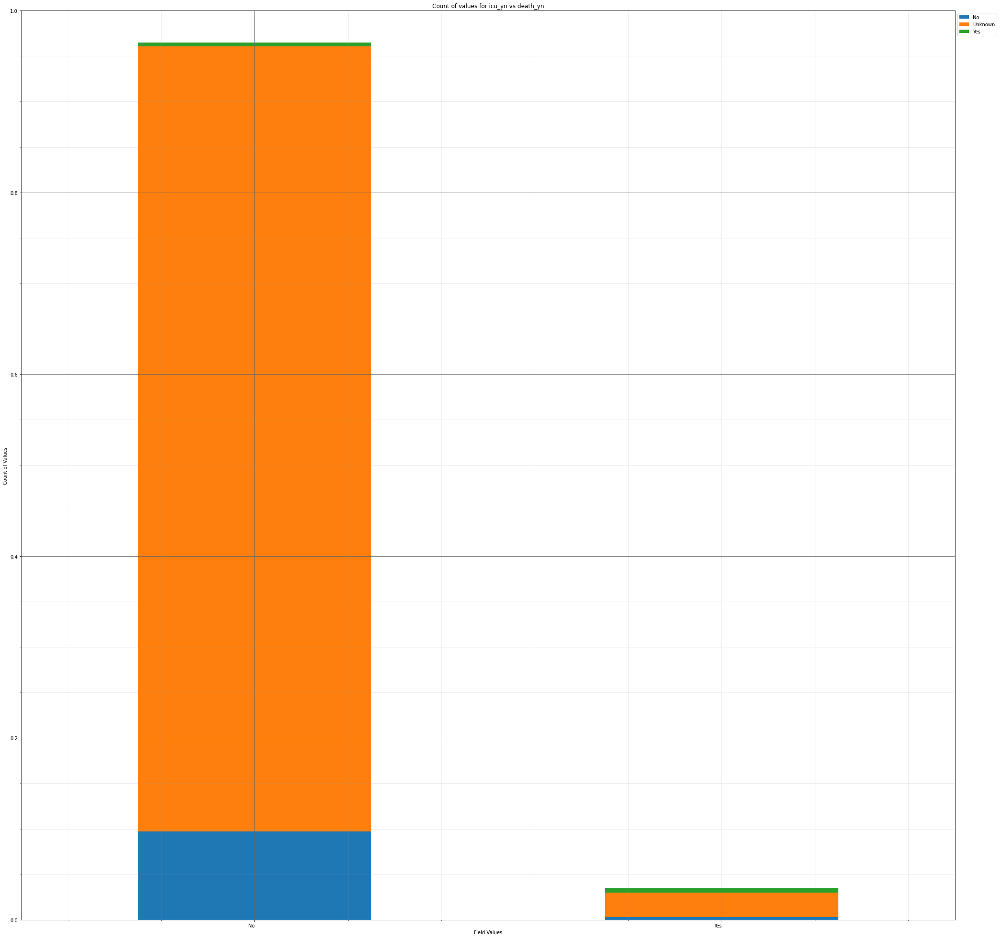



----------------------


Grouping over death_yn|medcond_yn results in:



,death_yn,medcond_yn,Rows,% Frequency
0,No,No,923,9.646739
1,No,Unknown,7569,79.107441
2,No,Yes,741,7.744565
3,Yes,No,8,0.083612
4,Yes,Unknown,233,2.435201
5,Yes,Yes,94,0.982441


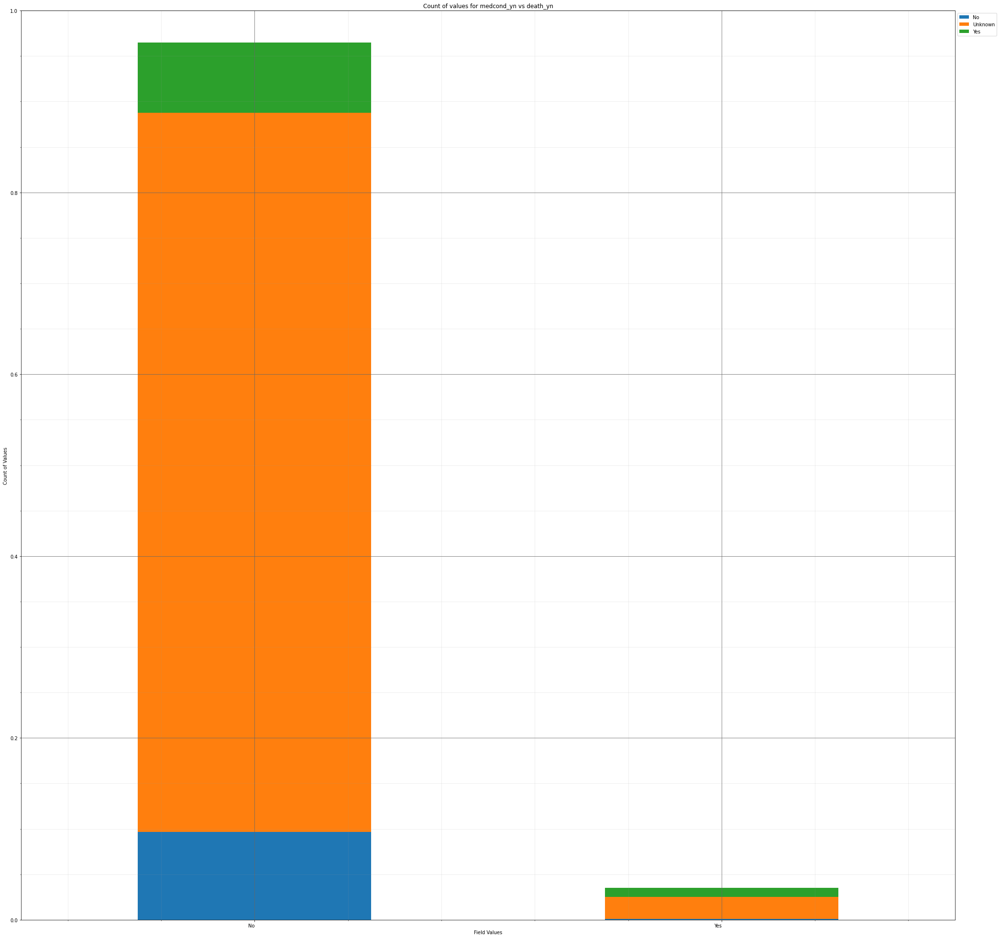



----------------------


Grouping over death_yn|race results in:



,death_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,60,0.627090
1,No,Asian,231,2.414298
2,No,Black,656,6.856187
3,No,Hispanic/Latino,901,9.416806
4,No,Multiple/Other,499,5.215301
5,No,Native Hawaiian/Other Pacific Islander,23,0.240385
6,No,Unknown,3726,38.942308
7,No,White,3137,32.786371
8,Yes,American Indian/Alaska Native,6,0.062709
9,Yes,Asian,10,0.104515


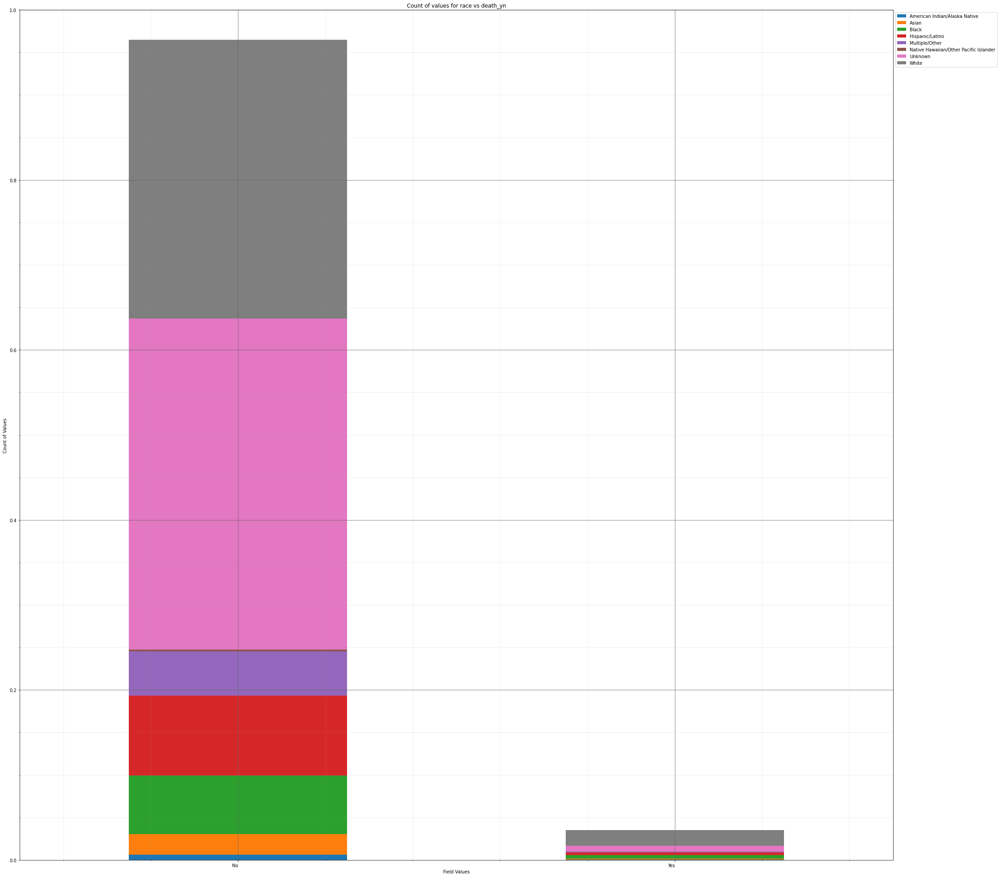



----------------------


Grouping over medcond_yn|current_status results in:



,medcond_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,893,9.333194
1,No,Probable Case,38,0.397157
2,Unknown,Laboratory-confirmed case,7418,77.529264
3,Unknown,Probable Case,384,4.013378
4,Yes,Laboratory-confirmed case,815,8.517977
5,Yes,Probable Case,20,0.209030


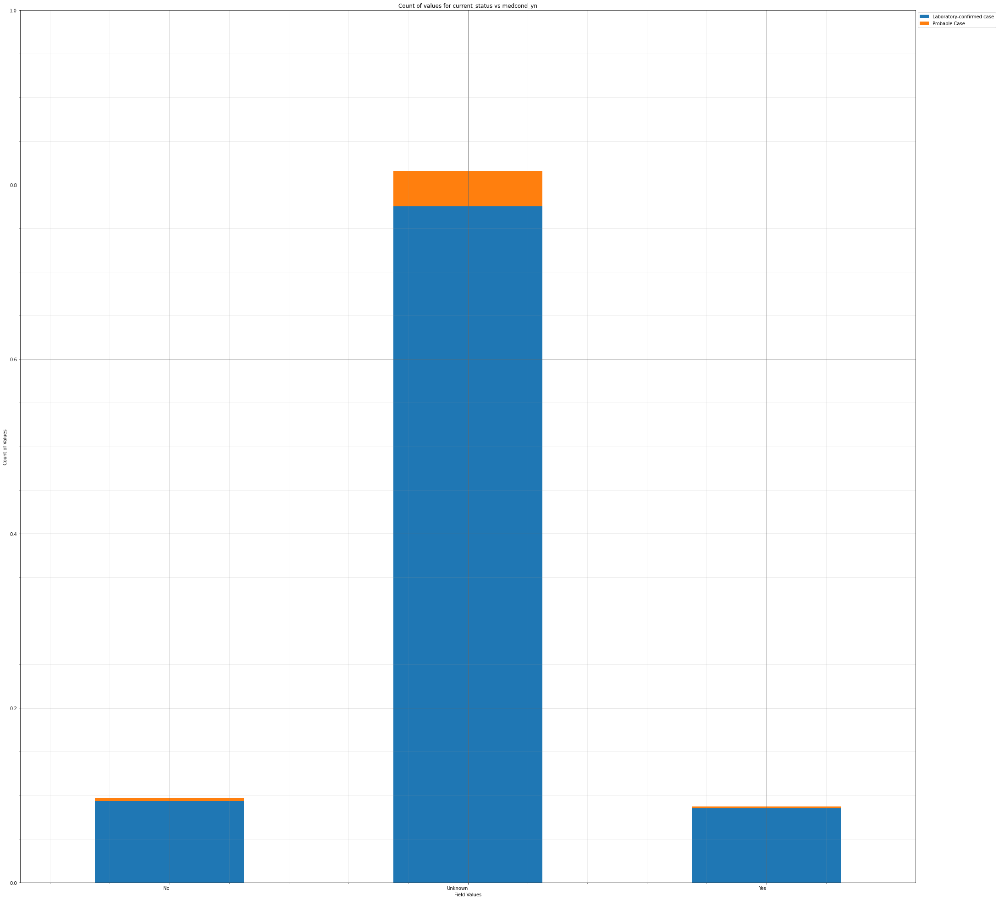



----------------------


Grouping over medcond_yn|sex results in:



,medcond_yn,sex,Rows,% Frequency
0,No,Female,508,5.309365
1,No,Male,416,4.347826
2,No,Unknown,7,0.073161
3,Unknown,Female,4129,43.154264
4,Unknown,Male,3600,37.625418
5,Unknown,Unknown,73,0.762960
6,Yes,Female,460,4.807692
7,Yes,Male,372,3.887960
8,Yes,Unknown,3,0.031355


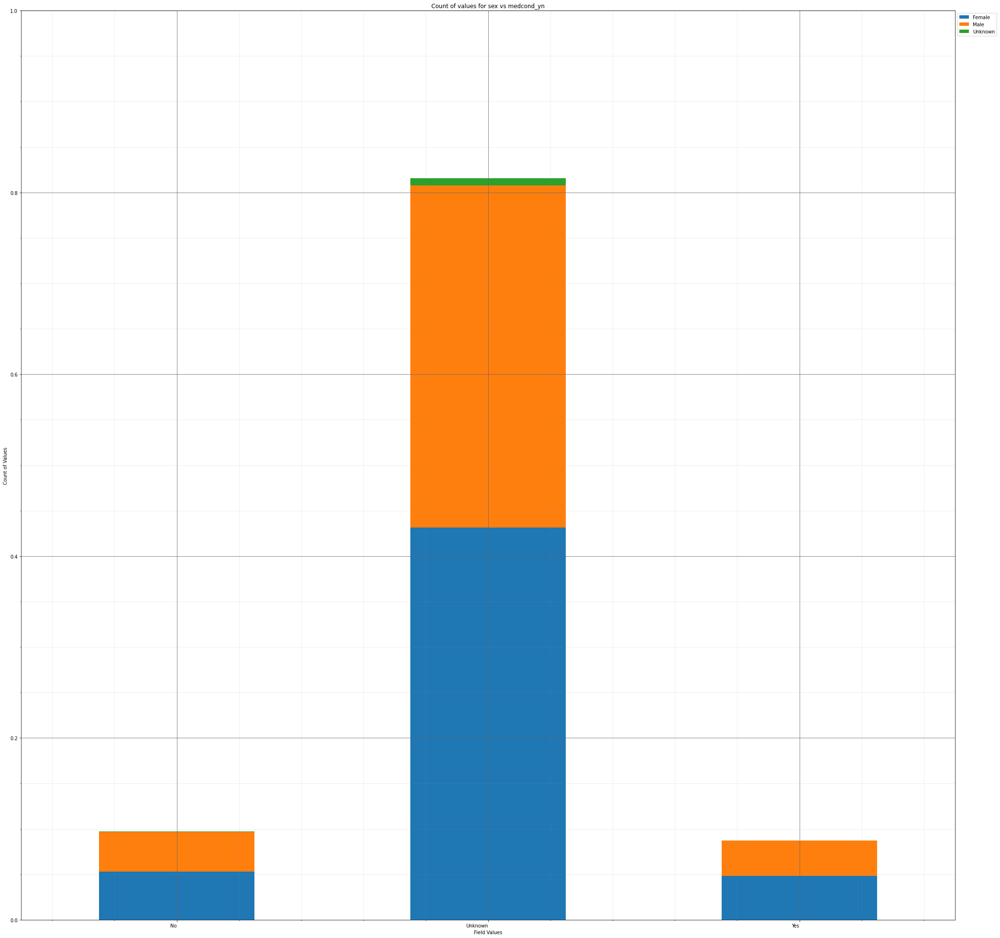



----------------------


Grouping over medcond_yn|age_group results in:



,medcond_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,52,0.543478
1,No,10 - 19 Years,143,1.494565
2,No,20 - 29 Years,222,2.320234
3,No,30 - 39 Years,172,1.797659
4,No,40 - 49 Years,118,1.233278
5,No,50 - 59 Years,114,1.191472
6,No,60 - 69 Years,70,0.731605
7,No,70 - 79 Years,28,0.292642
8,No,80+ Years,12,0.125418
9,No,Unknown,0,0.000000


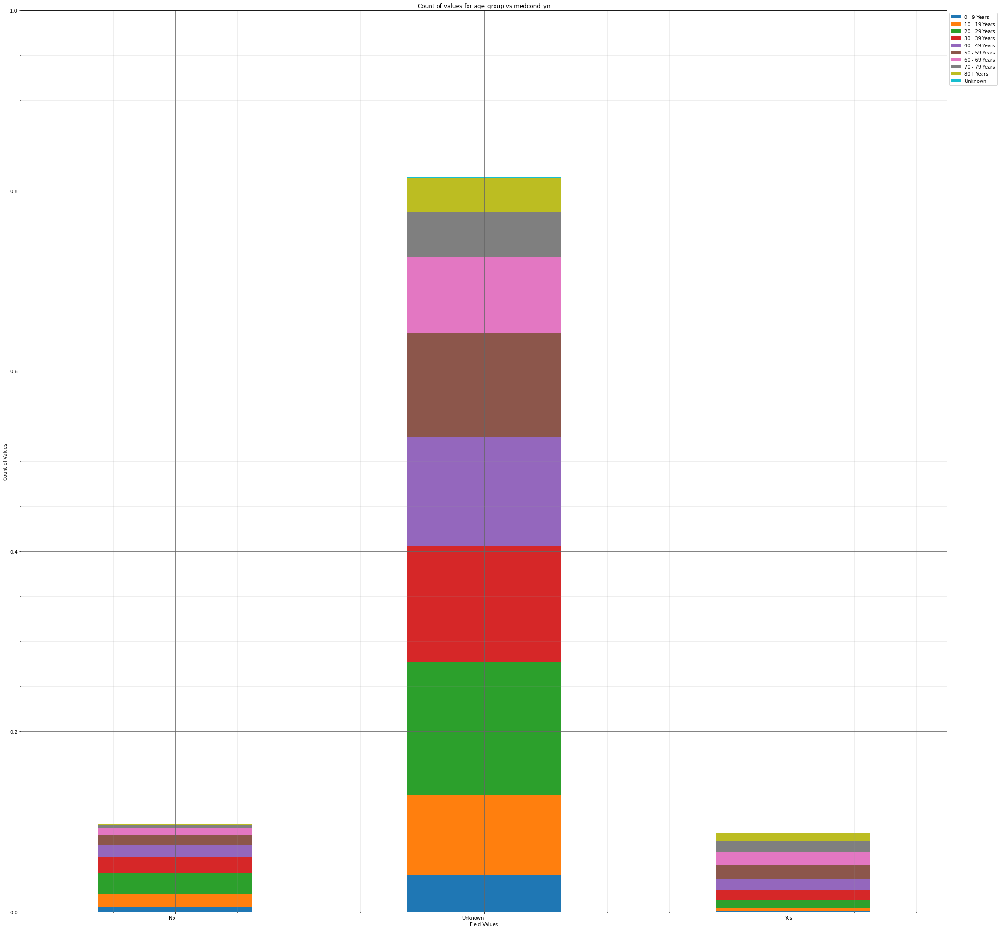



----------------------


Grouping over medcond_yn|hosp_yn results in:



,medcond_yn,hosp_yn,Rows,% Frequency
0,No,No,695,7.263796
1,No,OTH,0,0.000000
2,No,Unknown,202,2.111204
3,No,Yes,34,0.355351
4,Unknown,No,3921,40.980351
5,Unknown,OTH,0,0.000000
6,Unknown,Unknown,3392,35.451505
7,Unknown,Yes,489,5.110786
8,Yes,No,555,5.800585
9,Yes,OTH,0,0.000000


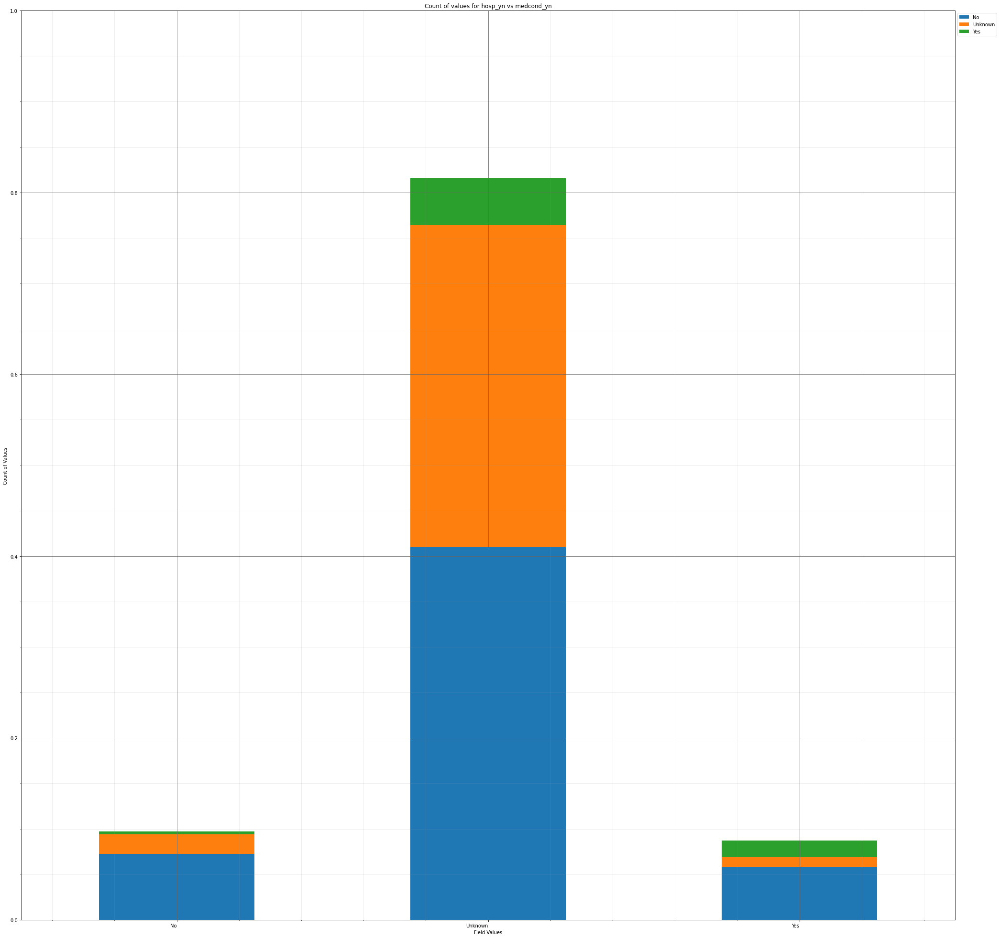



----------------------


Grouping over medcond_yn|icu_yn results in:



,medcond_yn,icu_yn,Rows,% Frequency
0,No,No,402,4.201505
1,No,Unknown,522,5.455686
2,No,Yes,7,0.073161
3,Unknown,No,250,2.612876
4,Unknown,Unknown,7510,78.490803
5,Unknown,Yes,42,0.438963
6,Yes,No,306,3.198161
7,Yes,Unknown,486,5.079431
8,Yes,Yes,43,0.449415


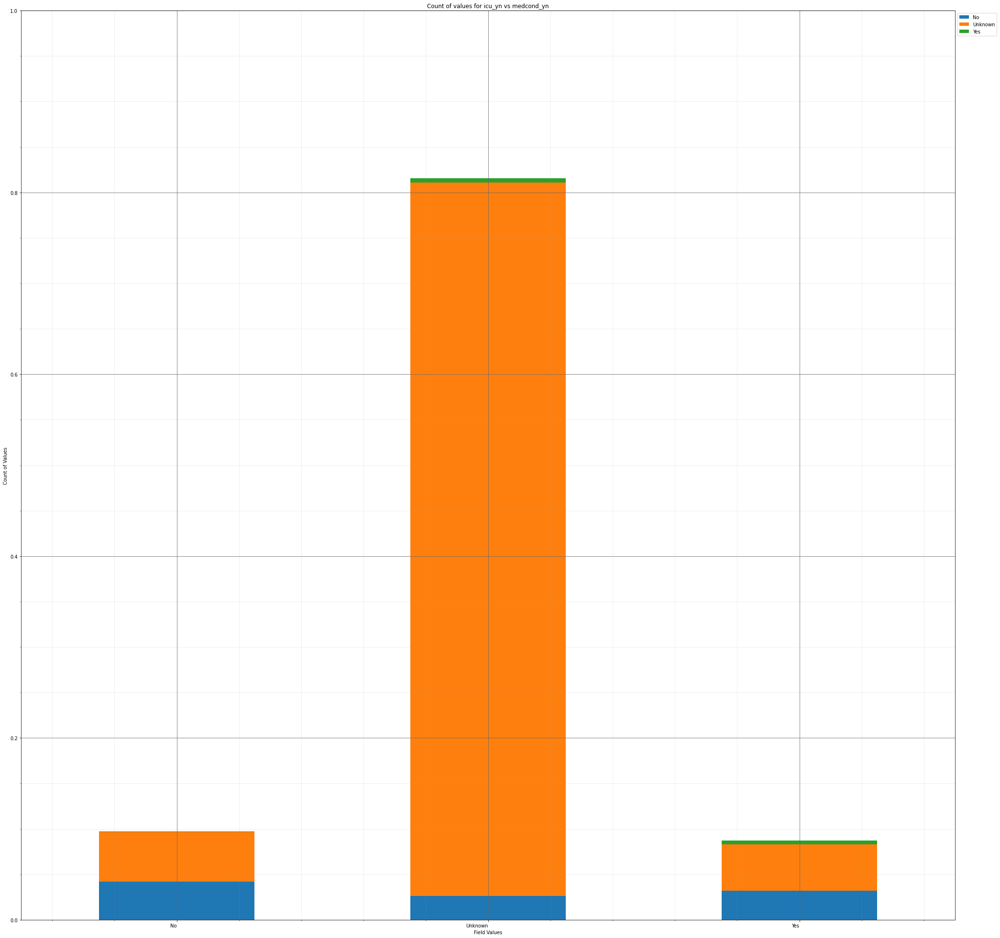



----------------------


Grouping over medcond_yn|death_yn results in:



,medcond_yn,death_yn,Rows,% Frequency
0,No,No,923,9.646739
1,No,Yes,8,0.083612
2,Unknown,No,7569,79.107441
3,Unknown,Yes,233,2.435201
4,Yes,No,741,7.744565
5,Yes,Yes,94,0.982441


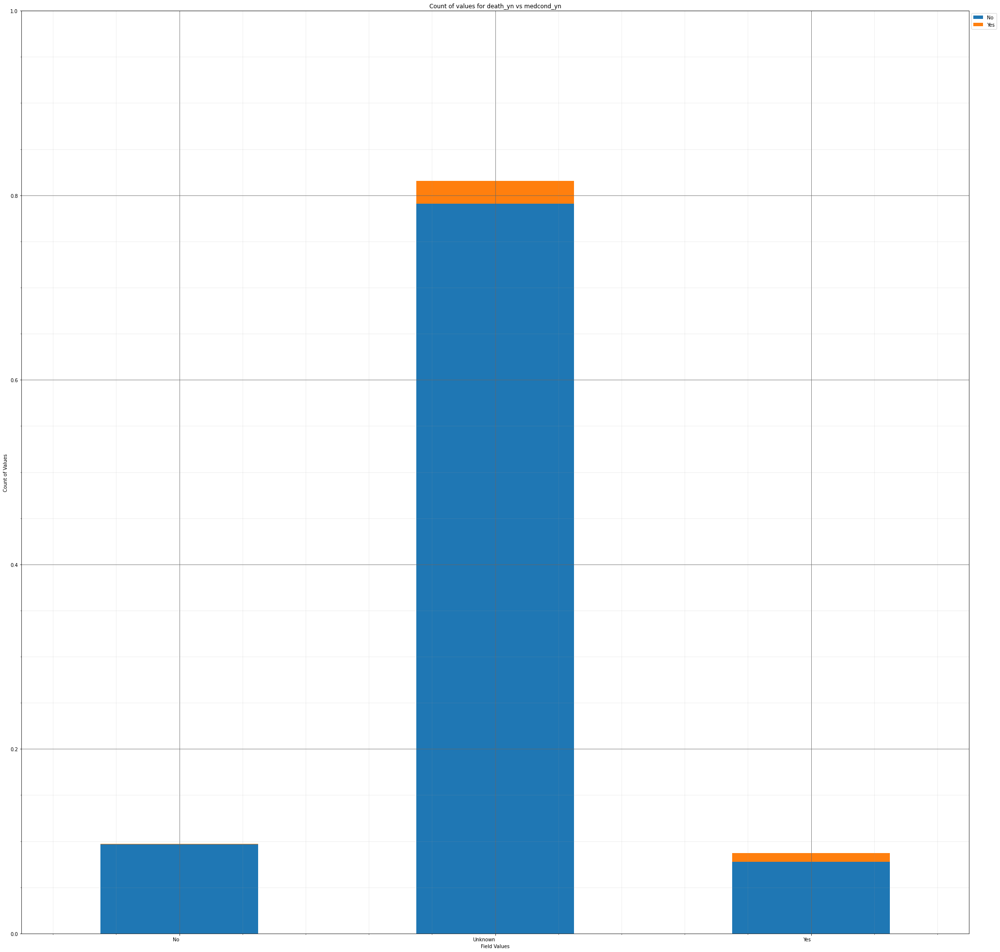



----------------------


Grouping over medcond_yn|race results in:



,medcond_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,4,0.041806
1,No,Asian,17,0.177676
2,No,Black,69,0.721154
3,No,Hispanic/Latino,155,1.619983
4,No,Multiple/Other,32,0.334448
5,No,Native Hawaiian/Other Pacific Islander,2,0.020903
6,No,Unknown,162,1.693144
7,No,White,490,5.121237
8,Unknown,American Indian/Alaska Native,55,0.574833
9,Unknown,Asian,206,2.153010


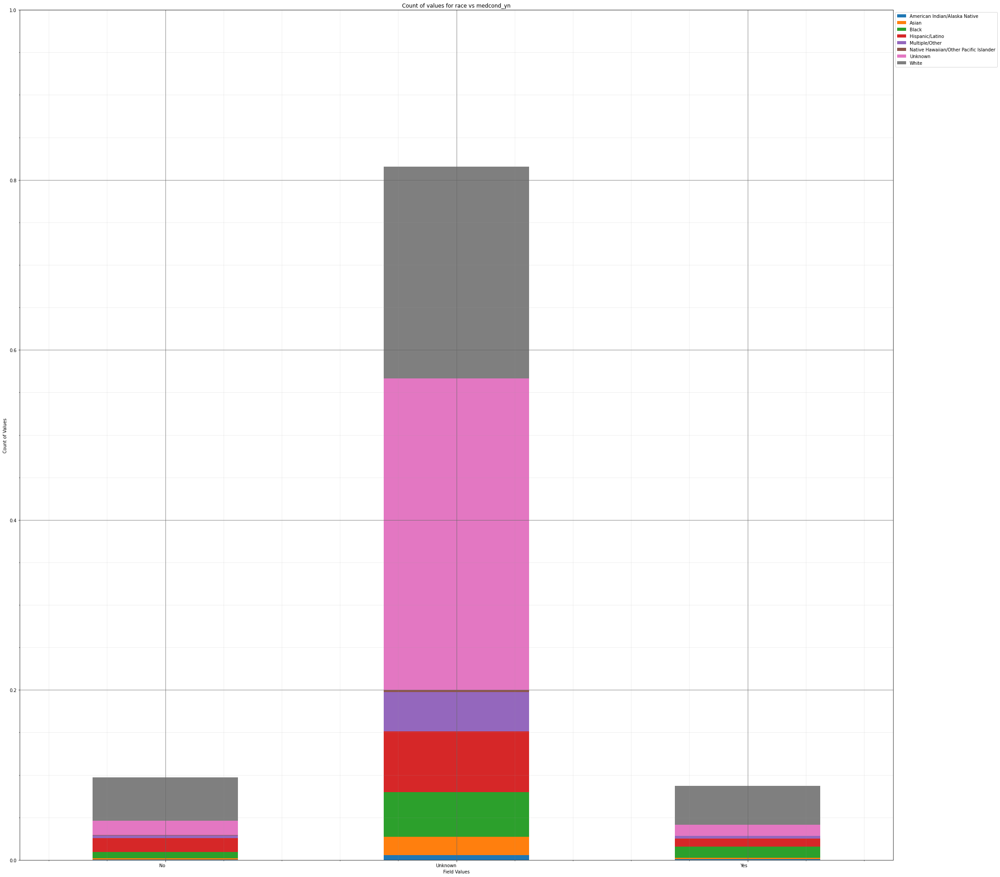



----------------------


Grouping over race|current_status results in:



,race,current_status,Rows,% Frequency
0,American Indian/Alaska Native,Laboratory-confirmed case,62,0.647993
1,American Indian/Alaska Native,Probable Case,4,0.041806
2,Asian,Laboratory-confirmed case,233,2.435201
3,Asian,Probable Case,8,0.083612
4,Black,Laboratory-confirmed case,670,7.002508
5,Black,Probable Case,24,0.250836
6,Hispanic/Latino,Laboratory-confirmed case,902,9.427258
7,Hispanic/Latino,Probable Case,27,0.282191
8,Multiple/Other,Laboratory-confirmed case,478,4.995819
9,Multiple/Other,Probable Case,32,0.334448


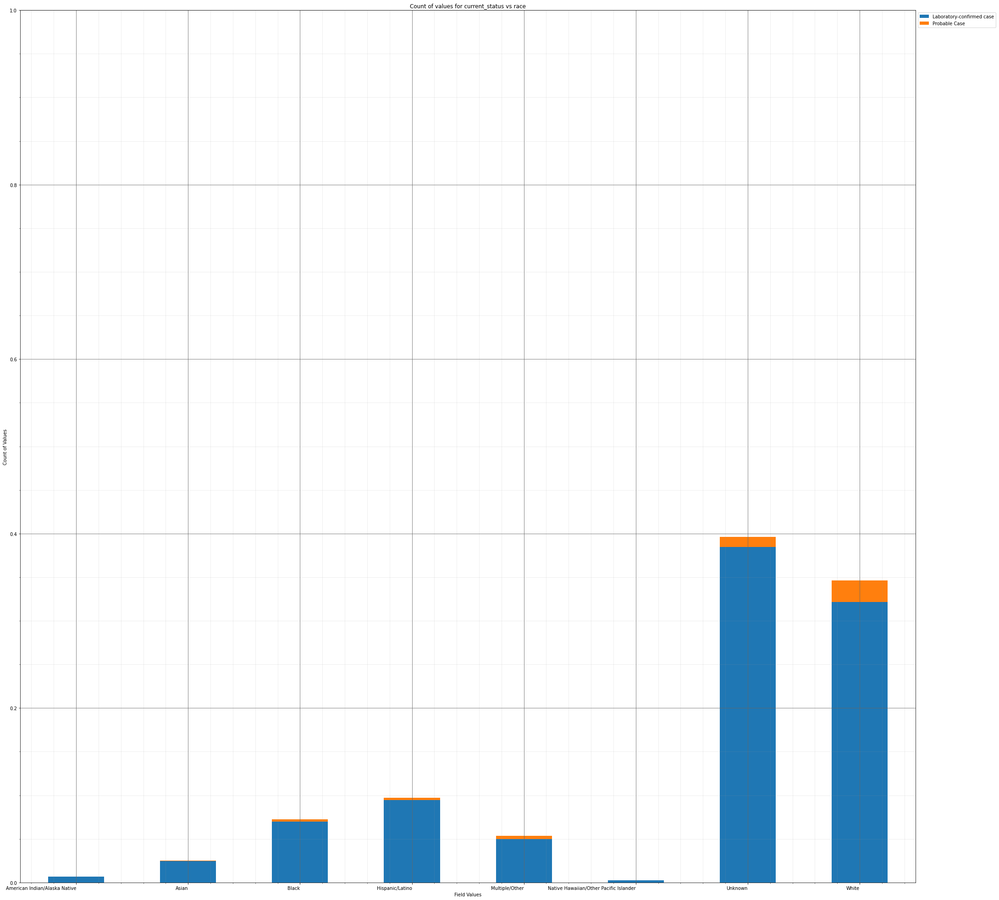



----------------------


Grouping over race|sex results in:



,race,sex,Rows,% Frequency
0,American Indian/Alaska Native,Female,34,0.355351
1,American Indian/Alaska Native,Male,32,0.334448
2,American Indian/Alaska Native,Unknown,0,0.000000
3,Asian,Female,122,1.275084
4,Asian,Male,116,1.212375
5,Asian,Unknown,3,0.031355
6,Black,Female,411,4.295569
7,Black,Male,281,2.936873
8,Black,Unknown,2,0.020903
9,Hispanic/Latino,Female,510,5.330268


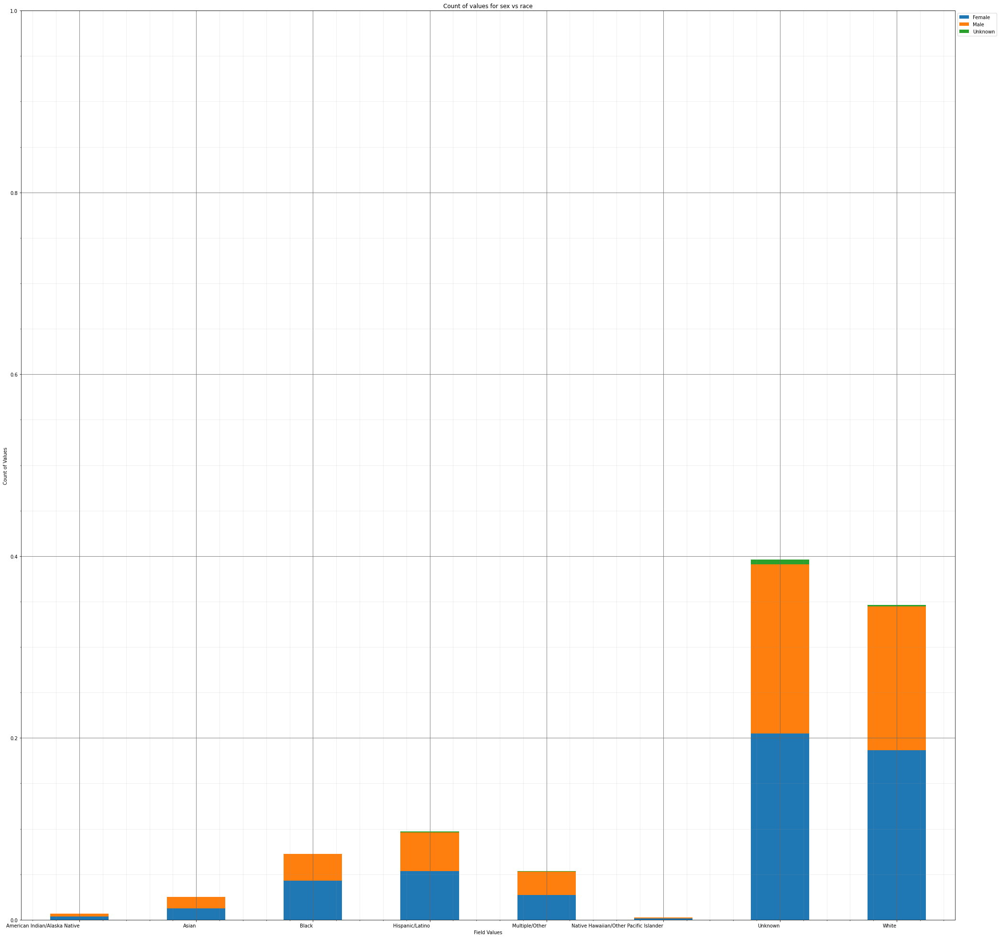



----------------------


Grouping over race|age_group results in:



,race,age_group,Rows,% Frequency
0,American Indian/Alaska Native,0 - 9 Years,4,0.041806
1,American Indian/Alaska Native,10 - 19 Years,8,0.083612
2,American Indian/Alaska Native,20 - 29 Years,12,0.125418
3,American Indian/Alaska Native,30 - 39 Years,8,0.083612
4,American Indian/Alaska Native,40 - 49 Years,12,0.125418
...,...,...,...,...
75,White,50 - 59 Years,521,5.445234
76,White,60 - 69 Years,439,4.588211
77,White,70 - 79 Years,301,3.145903
78,White,80+ Years,238,2.487458


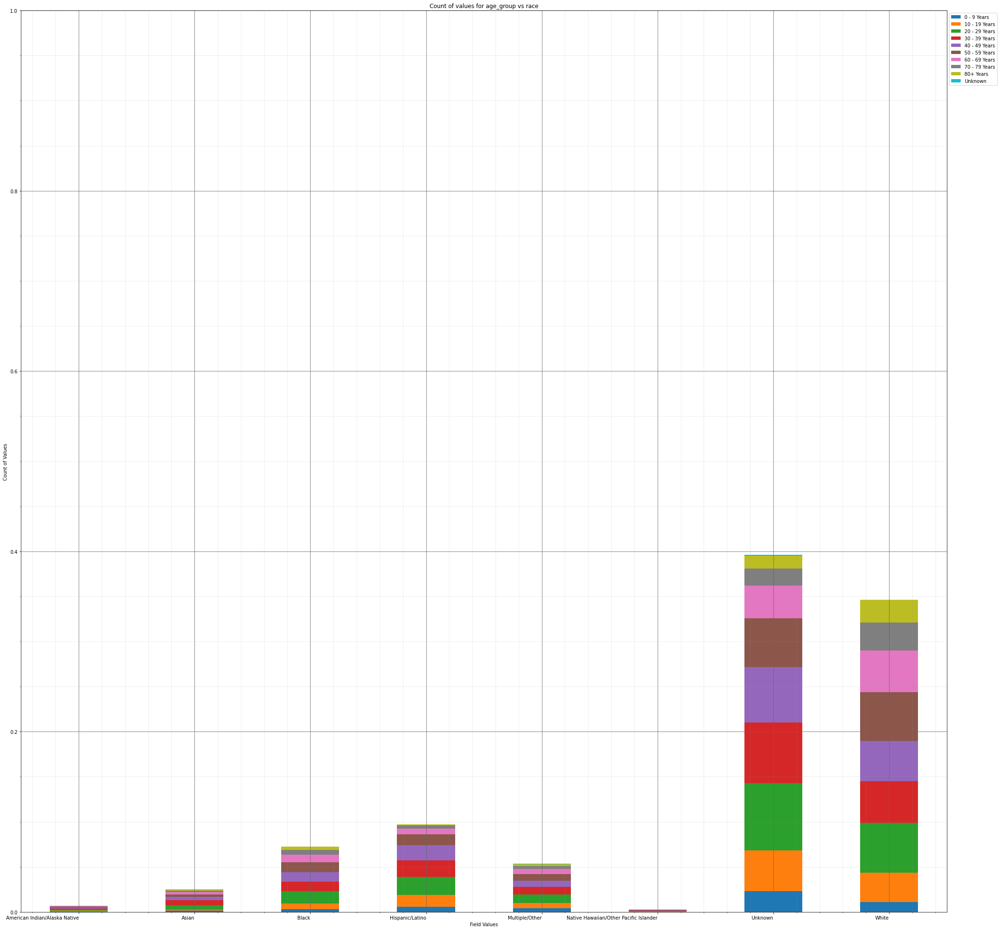



----------------------


Grouping over race|hosp_yn results in:



,race,hosp_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,39,0.407609
1,American Indian/Alaska Native,OTH,0,0.000000
2,American Indian/Alaska Native,Unknown,14,0.146321
3,American Indian/Alaska Native,Yes,13,0.135870
4,Asian,No,115,1.201923
5,Asian,OTH,0,0.000000
6,Asian,Unknown,103,1.076505
7,Asian,Yes,23,0.240385
8,Black,No,438,4.577759
9,Black,OTH,0,0.000000


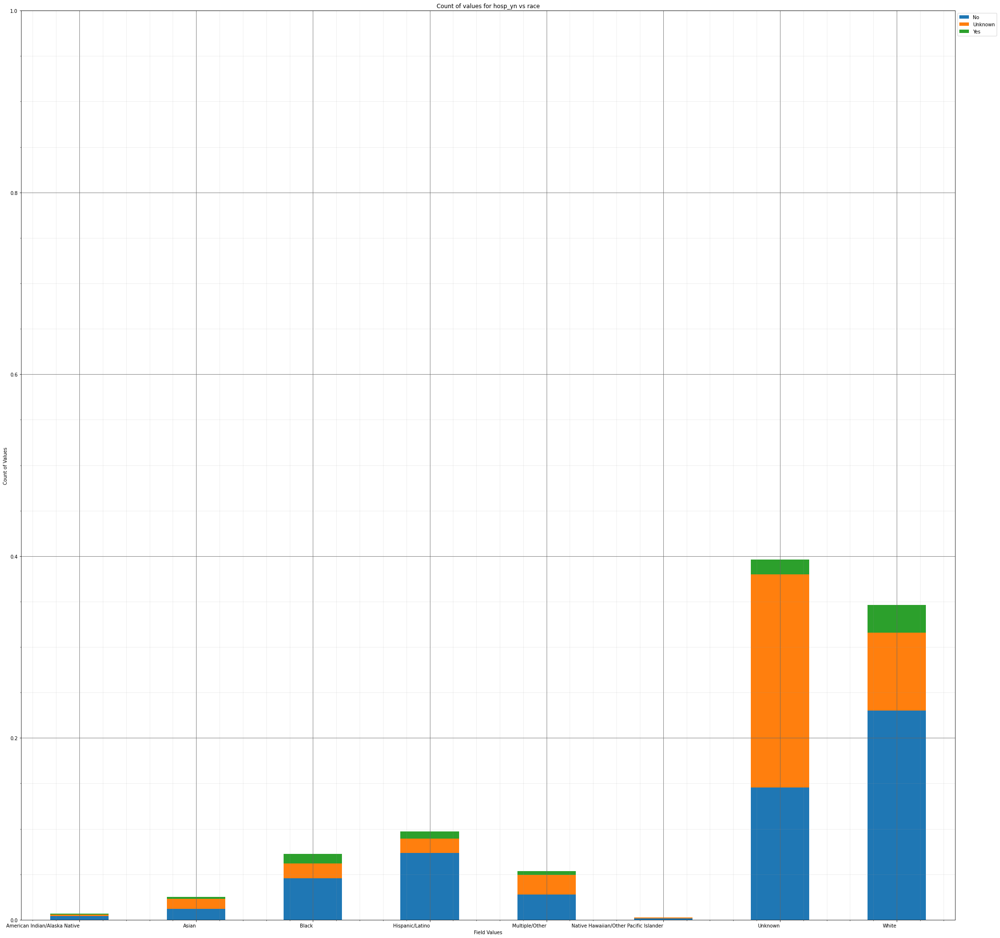



----------------------


Grouping over race|icu_yn results in:



,race,icu_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,7,0.073161
1,American Indian/Alaska Native,Unknown,57,0.595736
2,American Indian/Alaska Native,Yes,2,0.020903
3,Asian,No,14,0.146321
4,Asian,Unknown,223,2.330686
5,Asian,Yes,4,0.041806
6,Black,No,68,0.710702
7,Black,Unknown,617,6.448579
8,Black,Yes,9,0.094064
9,Hispanic/Latino,No,159,1.661789


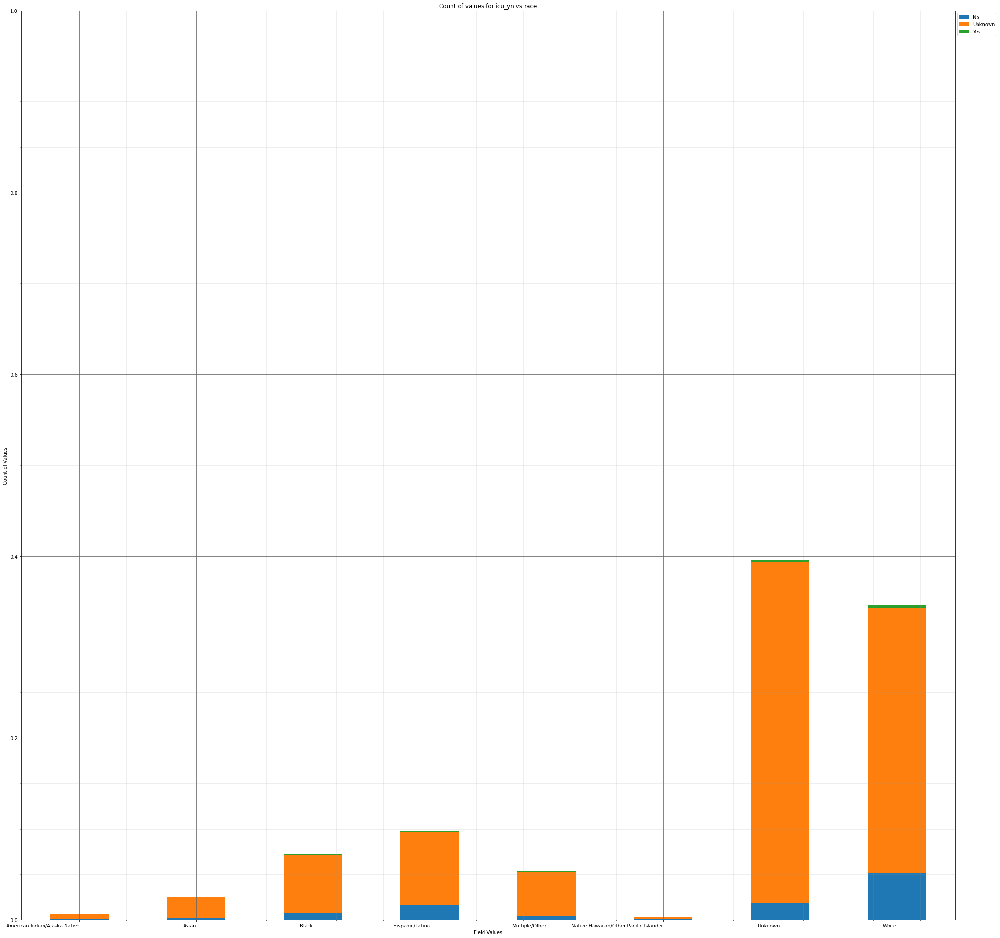



----------------------


Grouping over race|death_yn results in:



,race,death_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,60,0.627090
1,American Indian/Alaska Native,Yes,6,0.062709
2,Asian,No,231,2.414298
3,Asian,Yes,10,0.104515
4,Black,No,656,6.856187
5,Black,Yes,38,0.397157
6,Hispanic/Latino,No,901,9.416806
7,Hispanic/Latino,Yes,28,0.292642
8,Multiple/Other,No,499,5.215301
9,Multiple/Other,Yes,11,0.114967


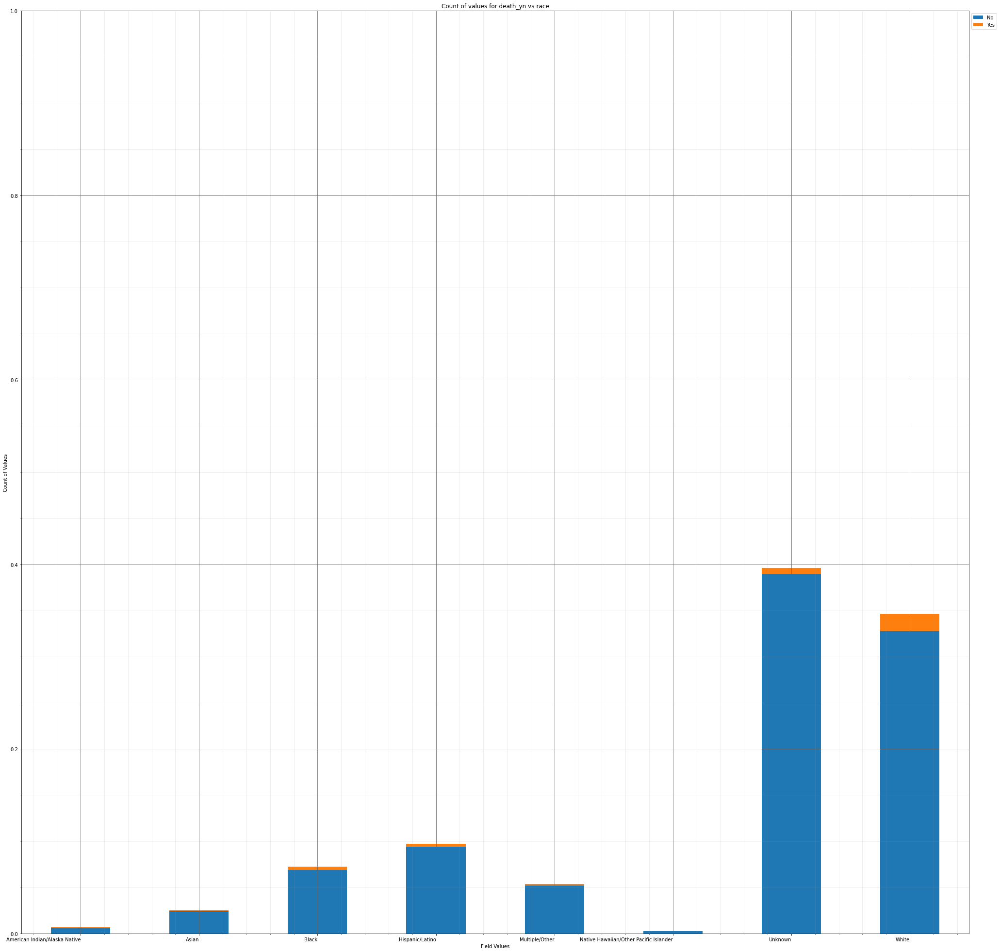



----------------------


Grouping over race|medcond_yn results in:



,race,medcond_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,4,0.041806
1,American Indian/Alaska Native,Unknown,55,0.574833
2,American Indian/Alaska Native,Yes,7,0.073161
3,Asian,No,17,0.177676
4,Asian,Unknown,206,2.153010
5,Asian,Yes,18,0.188127
6,Black,No,69,0.721154
7,Black,Unknown,501,5.236204
8,Black,Yes,124,1.295987
9,Hispanic/Latino,No,155,1.619983


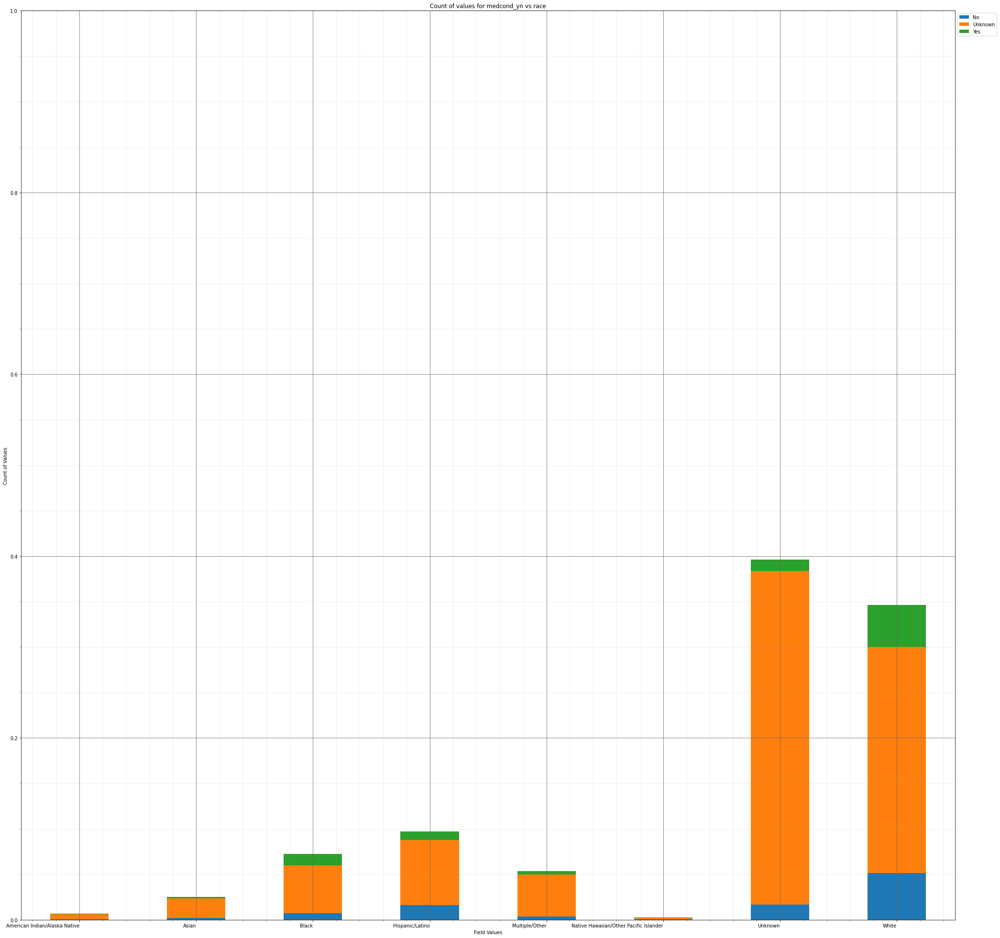

In [58]:
dd_multi_frequency_dict=group_over_multi_categories(deduped_covid_sample_df,categorical_columns,save_fig=True,pdf_fn=multi_categorical_barplot_dedupe_cleanse1_fn)

In [59]:
deduped_covid_sample_df['days_until_onset']=(deduped_covid_sample_df['onset_dt'] - deduped_covid_sample_df['cdc_case_earliest_dt']).dt.days

In [60]:
deduped_covid_sample_df[~deduped_covid_sample_df['days_until_onset'].isna()]['days_until_onset'].describe().T

count    5035.000000
mean        0.249652
std         4.165411
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max       162.000000
Name: days_until_onset, dtype: float64

In [61]:
deduped_covid_sample_df[~deduped_covid_sample_df['days_until_onset'].isna()]['days_until_onset']

2       0.0
3       0.0
10      0.0
11      0.0
13      0.0
       ... 
9992    0.0
9993    0.0
9995    0.0
9997    1.0
9999    0.0
Name: days_until_onset, Length: 5035, dtype: float64

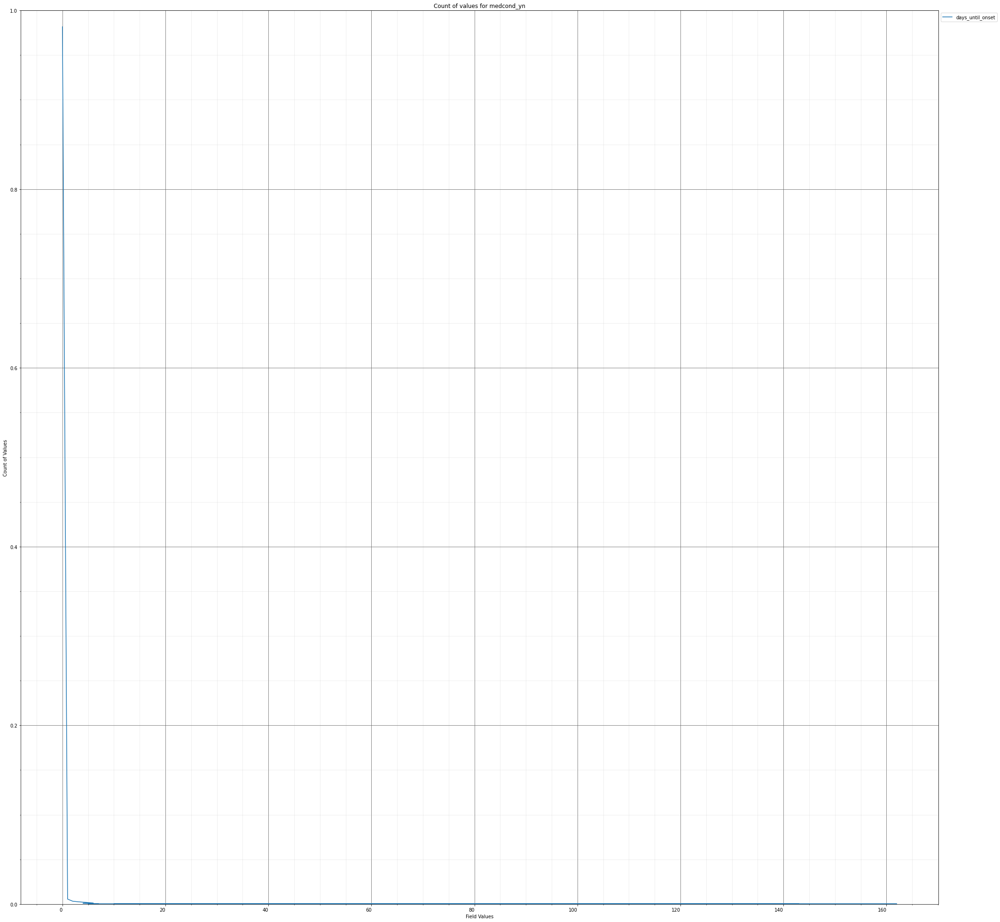

<Figure size 432x288 with 0 Axes>

In [62]:
figure = (
            deduped_covid_sample_df['days_until_onset']
              .value_counts(dropna=True, normalize=True)
              .plot(kind='line'
                    ,title='Count of values for {}'.format(column)
                    , xlabel='Field Values'
                    , ylabel='Count of Values'
                    , figsize=(35,35)
                   )
 )
#This grid style is from the sample Lab5 as I like how it looks
plt.ylim([0,1])
plt.grid(b=True, which='major', color='#666666', linestyle='-')
plt.setp(figure.get_xticklabels(), ha="right", rotation=0)
plt.minorticks_on()
plt.grid(b=True, which='minor', color='#999999', linestyle='-', alpha=0.2)
plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)
plt.show()
plt.savefig('days_until_offset_postcleanse.png')

In [63]:
(deduped_covid_sample_df['days_until_onset']
              .value_counts(dropna=True, normalize=False)
)

0.0      4943
1.0        28
2.0        16
3.0        13
6.0         6
4.0         4
7.0         2
5.0         2
30.0        1
34.0        1
59.0        1
55.0        1
69.0        1
31.0        1
22.0        1
68.0        1
43.0        1
20.0        1
143.0       1
19.0        1
10.0        1
73.0        1
162.0       1
49.0        1
25.0        1
26.0        1
29.0        1
28.0        1
87.0        1
Name: days_until_onset, dtype: int64

#### Some of these values are not sensible.

It is well publicised that the COVID19 symptomatic time period is within 14 days of diagnosis. While it would need to be confirmed with a domain expert, my recommendation given that 98% of values are 0 and a small volume of values are populated and most are less than 1, that we add a field called symptomatic. If the onset date is populated and within 14 days of diagnosis you are symptomatic, if outside this field should be zeroes and set to non-symptomatic, and if today's date is pre-14 days after the max date it is zero. All missing values are assumed to be denoted as 'unknown'. We drop the post-14 day values.

All our data is over 14 days away.

## 2.9 POS Value Correction and Feature Addition

In [64]:
print("Nonsense Rows to drop: {}".format(len(deduped_covid_sample_df[deduped_covid_sample_df['days_until_onset']>14].index)))
deduped_covid_sample_df=deduped_covid_sample_df.drop(deduped_covid_sample_df[deduped_covid_sample_df['days_until_onset']>14].index)

Nonsense Rows to drop: 20


In [65]:
deduped_covid_sample_df[deduped_covid_sample_df['days_until_onset'].isna()]

,cdc_case_earliest_dt,onset_dt,current_status,sex,age_group,hosp_yn,icu_yn,death_yn,medcond_yn,race,days_until_onset
0,2020-09-30,NaT,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Unknown,No,Unknown,Unknown,NaN
1,2020-04-16,NaT,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Unknown,No,Unknown,Unknown,NaN
4,2020-12-17,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Unknown,No,Unknown,Unknown,NaN
5,2020-11-13,NaT,Laboratory-confirmed case,Female,40 - 49 Years,Unknown,Unknown,No,Unknown,White,NaN
6,2020-11-26,NaT,Laboratory-confirmed case,Female,30 - 39 Years,Unknown,Unknown,No,Unknown,White,NaN
...,...,...,...,...,...,...,...,...,...,...,...
9989,2020-09-26,NaT,Laboratory-confirmed case,Male,10 - 19 Years,No,Unknown,No,Unknown,White,NaN
9990,2020-11-13,NaT,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Unknown,No,Unknown,White,NaN
9991,2021-01-11,NaT,Probable Case,Male,30 - 39 Years,No,Unknown,No,Unknown,Asian,NaN
9994,2021-01-14,NaT,Laboratory-confirmed case,Female,80+ Years,No,Unknown,No,Unknown,Multiple/Other,NaN


In [66]:
deduped_covid_sample_df.loc[(deduped_covid_sample_df['days_until_onset'].isna()),'onset_present']='False'
deduped_covid_sample_df.loc[~(deduped_covid_sample_df['days_until_onset'].isna()),'onset_present']='True'

In [67]:
deduped_covid_sample_df['days_until_onset']=deduped_covid_sample_df['days_until_onset'].fillna(0)

In [68]:
deduped_covid_sample_df

,cdc_case_earliest_dt,onset_dt,current_status,sex,age_group,hosp_yn,icu_yn,death_yn,medcond_yn,race,days_until_onset,onset_present
0,2020-09-30,NaT,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False
1,2020-04-16,NaT,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False
2,2020-09-22,2020-09-22,Laboratory-confirmed case,Female,10 - 19 Years,No,No,No,No,White,0.0,True
3,2020-10-30,2020-10-30,Laboratory-confirmed case,Female,60 - 69 Years,No,Unknown,No,Unknown,Multiple/Other,0.0,True
4,2020-12-17,NaT,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...
9994,2021-01-14,NaT,Laboratory-confirmed case,Female,80+ Years,No,Unknown,No,Unknown,Multiple/Other,0.0,False
9995,2020-09-24,2020-09-24,Laboratory-confirmed case,Female,30 - 39 Years,No,Unknown,No,Unknown,Hispanic/Latino,0.0,True
9997,2020-08-27,2020-08-28,Laboratory-confirmed case,Female,10 - 19 Years,No,Unknown,No,Unknown,Unknown,1.0,True
9998,2021-01-04,NaT,Laboratory-confirmed case,Unknown,30 - 39 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False


In [69]:
del deduped_covid_sample_df['onset_dt']

In [70]:
categorical_columns=deduped_covid_sample_df.select_dtypes('category').columns
datetime_columns=deduped_covid_sample_df.select_dtypes('datetime').columns
numeric_columns=deduped_covid_sample_df.select_dtypes('float')

Inside group_over_single_categories()


----------------------


                           cdc_case_earliest_dt
current_status                                 
Laboratory-confirmed case                  9106
Probable Case                               442
Grouping over current_status results in:



,current_status,Rows,% Frequency
0,Laboratory-confirmed case,9106,95.370758
1,Probable Case,442,4.629242


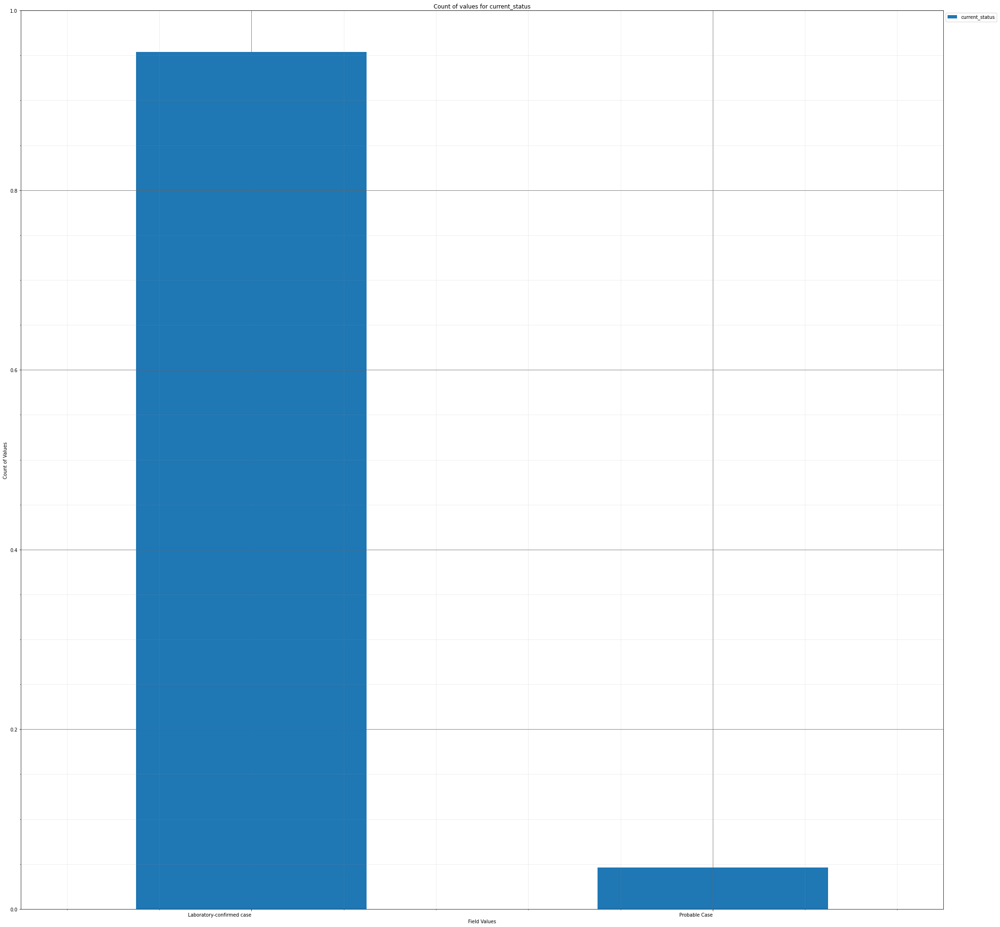



----------------------


         cdc_case_earliest_dt
sex                          
Female                   5089
Male                     4376
Unknown                    83
Grouping over sex results in:



,sex,Rows,% Frequency
0,Female,5089,53.299120
1,Male,4376,45.831588
2,Unknown,83,0.869292


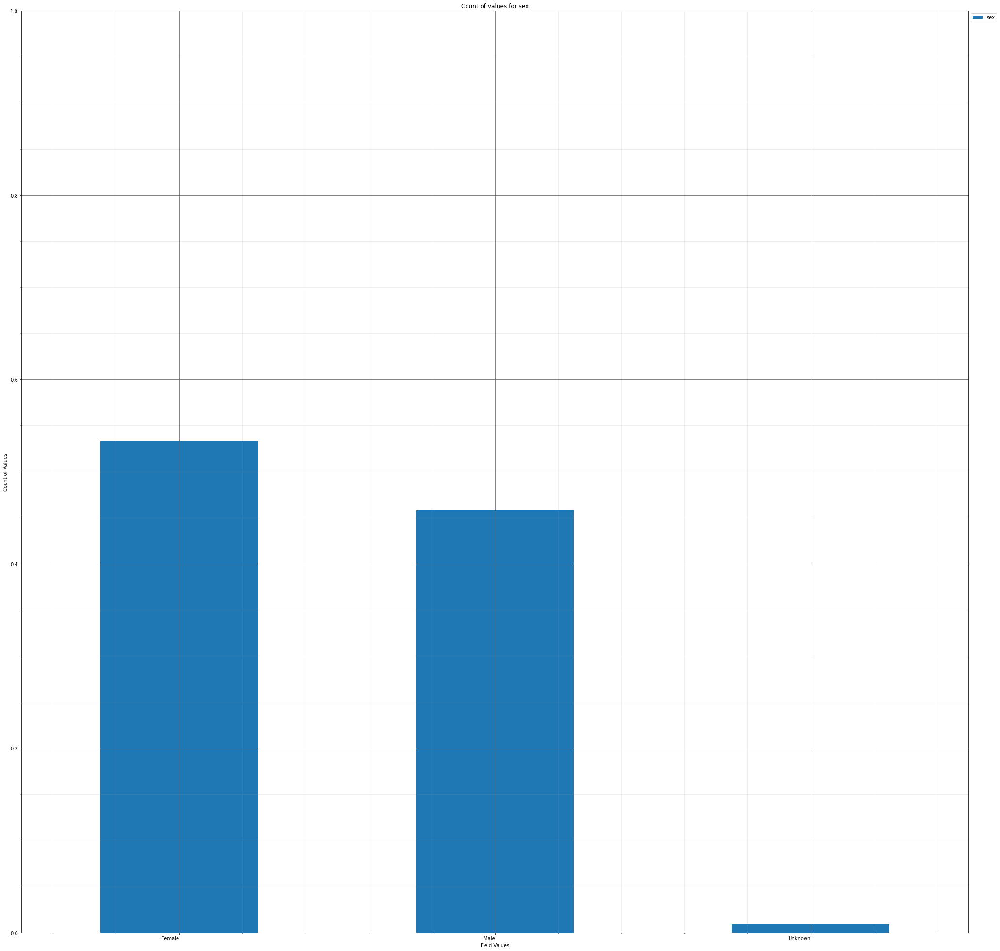



----------------------


               cdc_case_earliest_dt
age_group                          
0 - 9 Years                     458
10 - 19 Years                  1014
20 - 29 Years                  1718
30 - 39 Years                  1503
40 - 49 Years                  1396
50 - 59 Years                  1360
60 - 69 Years                  1017
70 - 79 Years                   611
80+ Years                       457
Unknown                          14
Grouping over age_group results in:



,age_group,Rows,% Frequency
0,0 - 9 Years,458,4.796816
1,10 - 19 Years,1014,10.620025
2,20 - 29 Years,1718,17.993297
3,30 - 39 Years,1503,15.741517
4,40 - 49 Years,1396,14.620863
5,50 - 59 Years,1360,14.243821
6,60 - 69 Years,1017,10.651445
7,70 - 79 Years,611,6.399246
8,80+ Years,457,4.786343
9,Unknown,14,0.146628


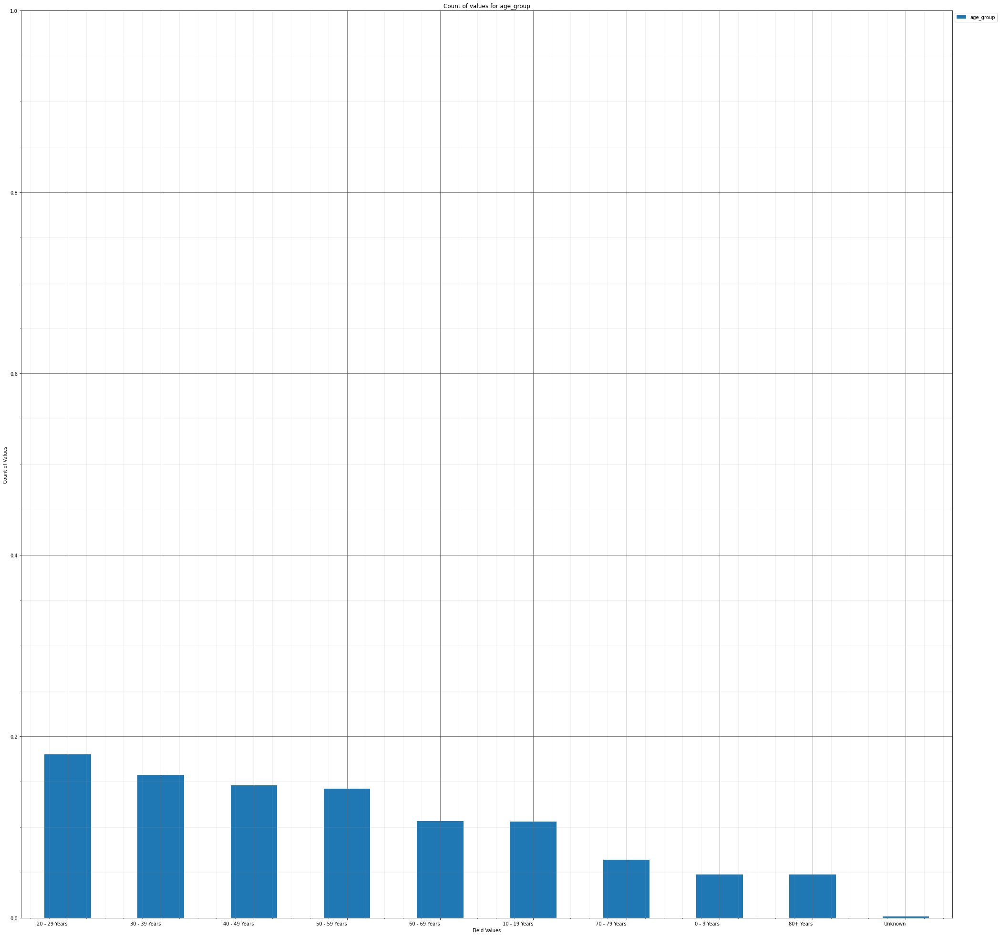



----------------------


         cdc_case_earliest_dt
hosp_yn                      
No                       5156
OTH                         0
Unknown                  3695
Yes                       697
Grouping over hosp_yn results in:



,hosp_yn,Rows,% Frequency
0,No,5156,54.000838
1,OTH,0,0.000000
2,Unknown,3695,38.699204
3,Yes,697,7.299958


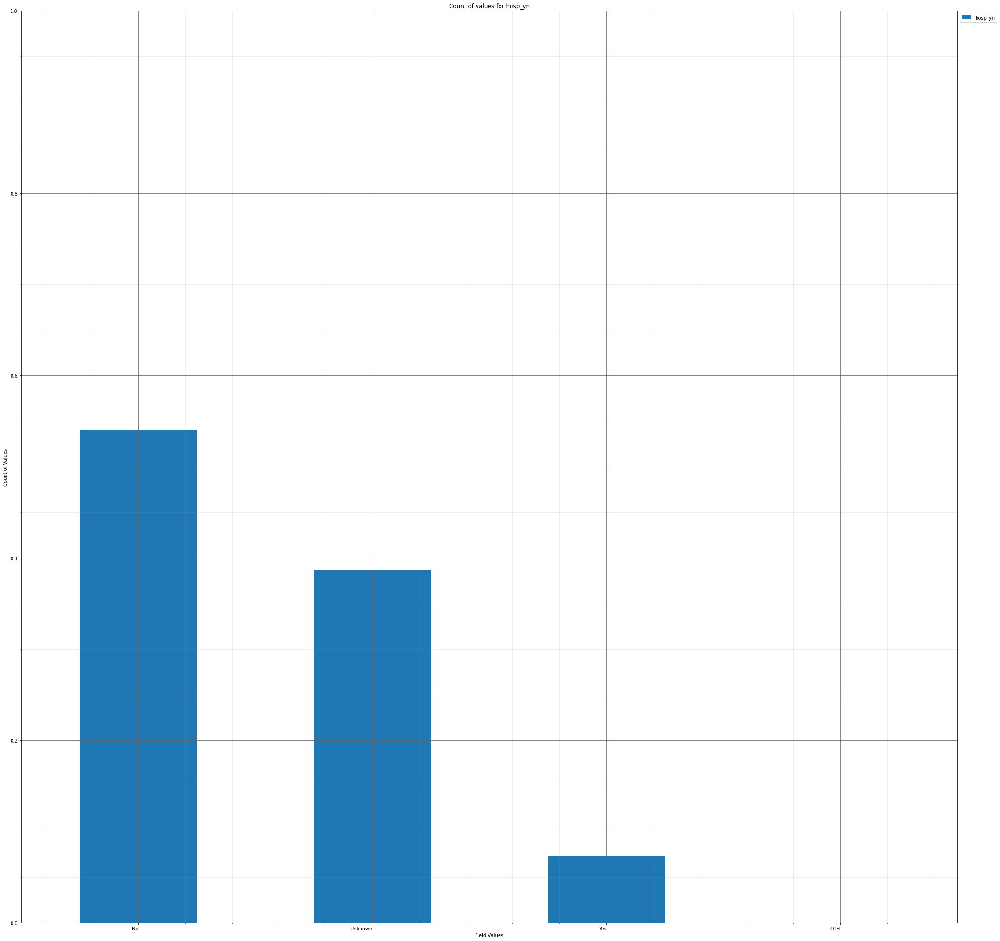



----------------------


         cdc_case_earliest_dt
icu_yn                       
No                        949
Unknown                  8509
Yes                        90
Grouping over icu_yn results in:



,icu_yn,Rows,% Frequency
0,No,949,9.939254
1,Unknown,8509,89.118140
2,Yes,90,0.942606


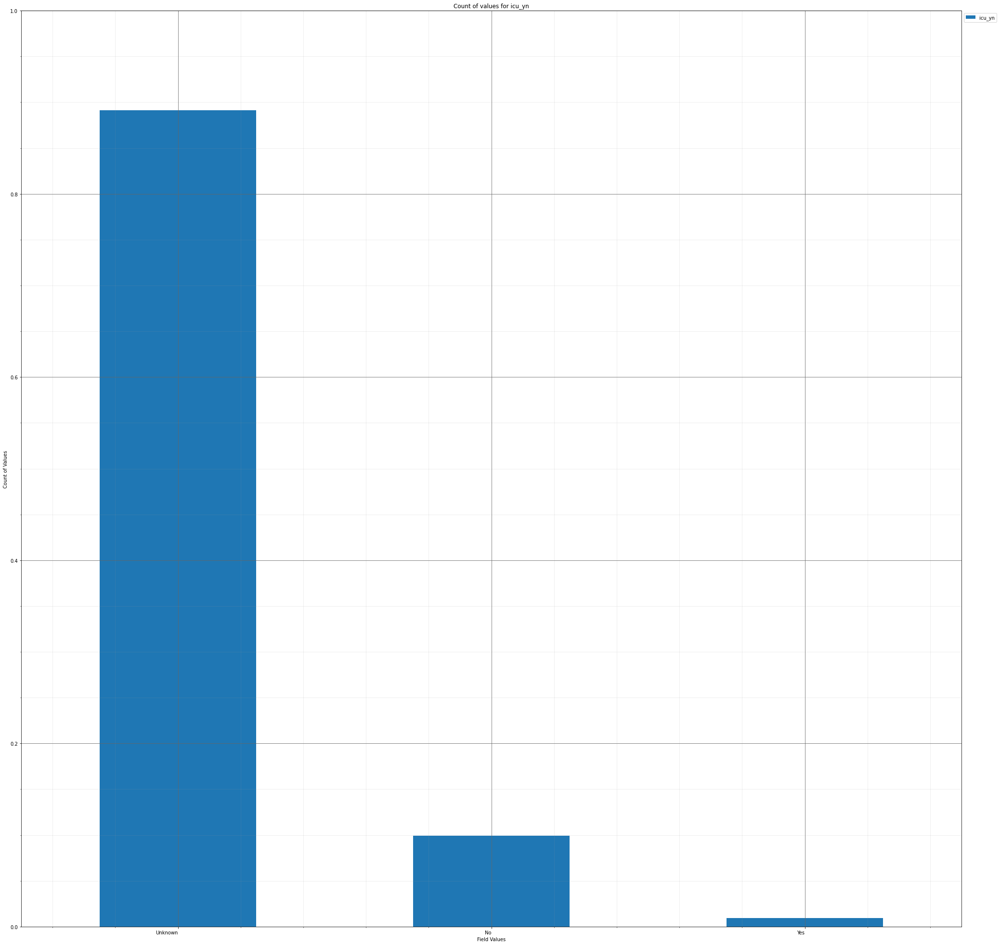



----------------------


          cdc_case_earliest_dt
death_yn                      
No                        9216
Yes                        332
Grouping over death_yn results in:



,death_yn,Rows,% Frequency
0,No,9216,96.522832
1,Yes,332,3.477168


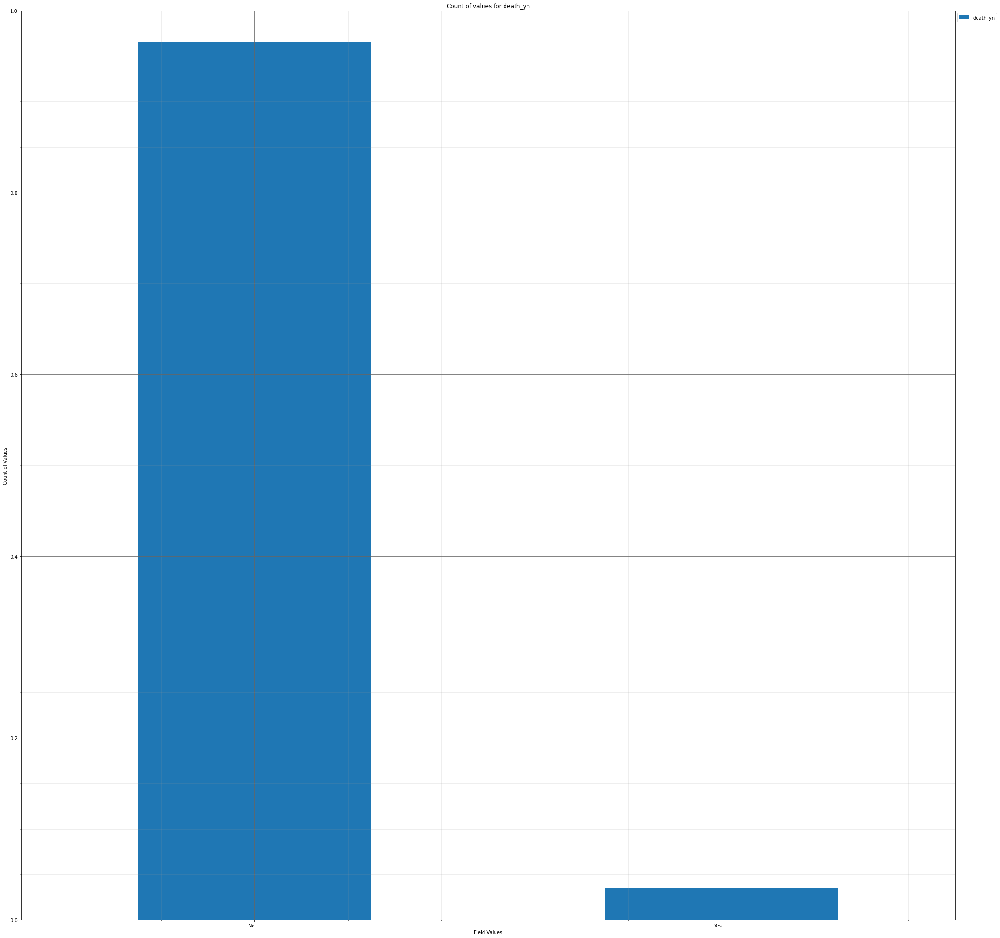



----------------------


            cdc_case_earliest_dt
medcond_yn                      
No                           926
Unknown                     7791
Yes                          831
Grouping over medcond_yn results in:



,medcond_yn,Rows,% Frequency
0,No,926,9.698366
1,Unknown,7791,81.598240
2,Yes,831,8.703393


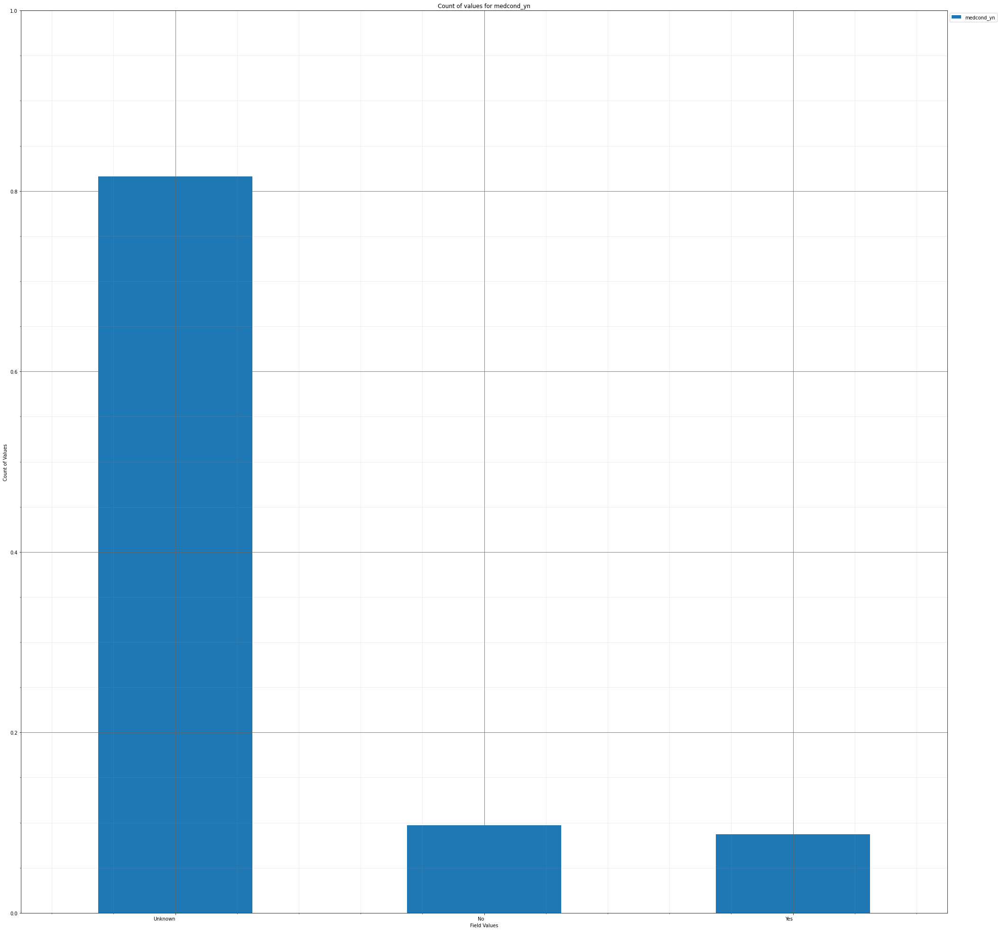



----------------------


                                        cdc_case_earliest_dt
race                                                        
American Indian/Alaska Native                             66
Asian                                                    239
Black                                                    693
Hispanic/Latino                                          928
Multiple/Other                                           510
Native Hawaiian/Other Pacific Islander                    23
Unknown                                                 3787
White                                                   3302
Grouping over race results in:



,race,Rows,% Frequency
0,American Indian/Alaska Native,66,0.691244
1,Asian,239,2.503142
2,Black,693,7.258065
3,Hispanic/Latino,928,9.719313
4,Multiple/Other,510,5.341433
5,Native Hawaiian/Other Pacific Islander,23,0.240888
6,Unknown,3787,39.662757
7,White,3302,34.583159


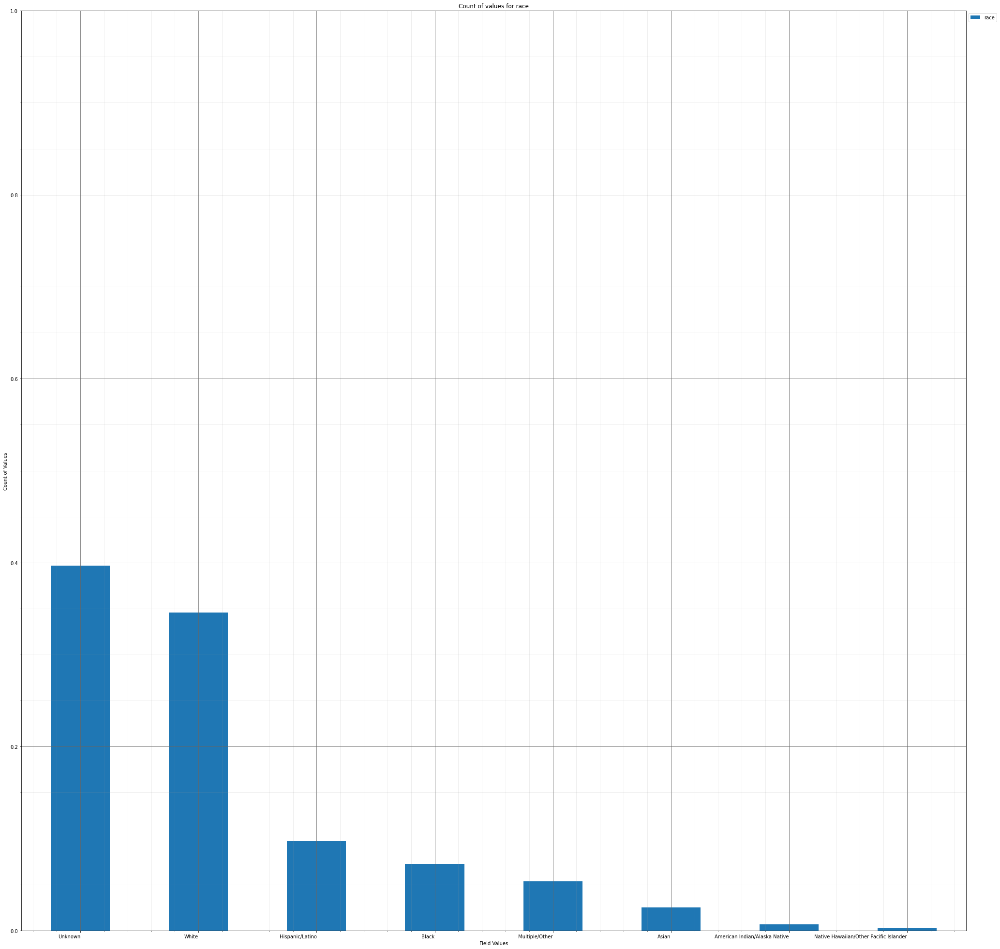

In [71]:
dd_stage_clnd_freq_dict=group_over_single_categories(deduped_covid_sample_df,categorical_columns,save_fig=True,pdf_fn=single_categorical_barplot_dedupe_cleanseF_fn)

Inside group_over_multi_categories()


----------------------


Grouping over current_status|sex results in:



,current_status,sex,Rows,% Frequency
0,Laboratory-confirmed case,Female,4862,50.921659
1,Laboratory-confirmed case,Male,4166,43.632174
2,Laboratory-confirmed case,Unknown,78,0.816925
3,Probable Case,Female,227,2.377461
4,Probable Case,Male,210,2.199413
5,Probable Case,Unknown,5,0.052367


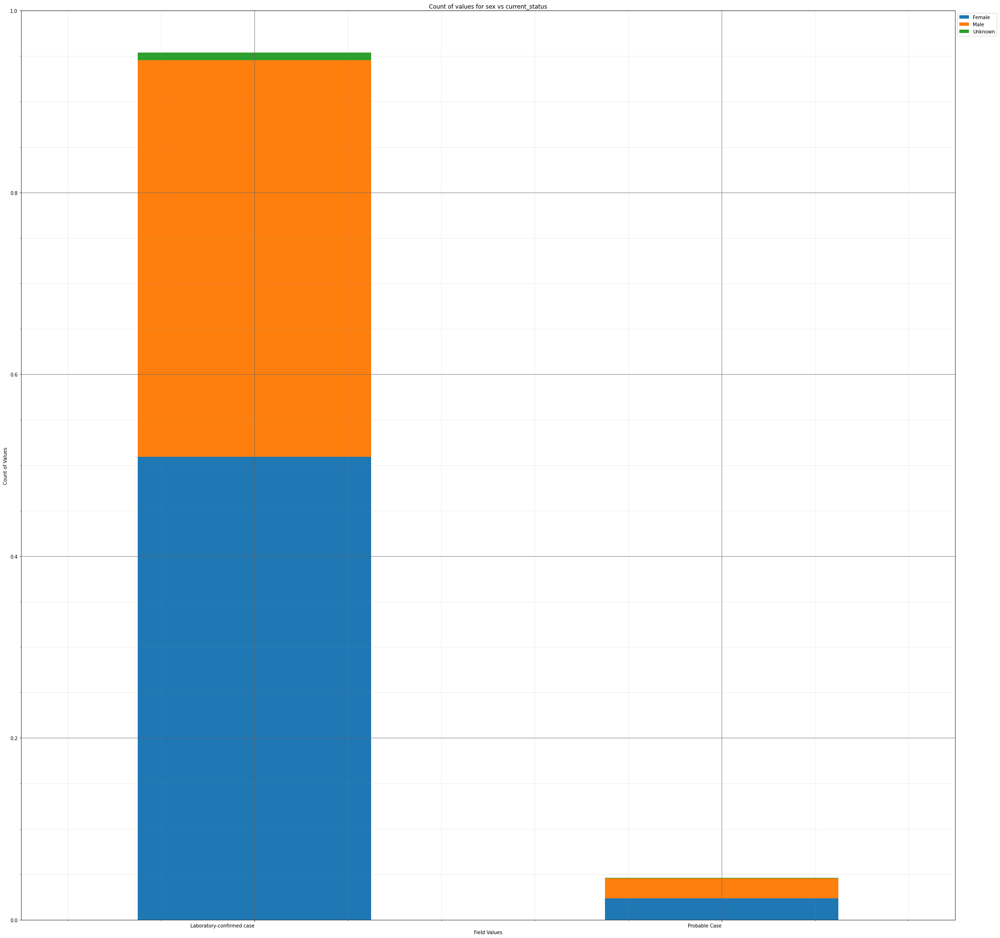



----------------------


Grouping over current_status|age_group results in:



,current_status,age_group,Rows,% Frequency
0,Laboratory-confirmed case,0 - 9 Years,430,4.503561
1,Laboratory-confirmed case,10 - 19 Years,960,10.054462
2,Laboratory-confirmed case,20 - 29 Years,1648,17.260159
3,Laboratory-confirmed case,30 - 39 Years,1449,15.175953
4,Laboratory-confirmed case,40 - 49 Years,1340,14.034353
5,Laboratory-confirmed case,50 - 59 Years,1296,13.573523
6,Laboratory-confirmed case,60 - 69 Years,964,10.096355
7,Laboratory-confirmed case,70 - 79 Years,588,6.158358
8,Laboratory-confirmed case,80+ Years,427,4.472141
9,Laboratory-confirmed case,Unknown,4,0.041894


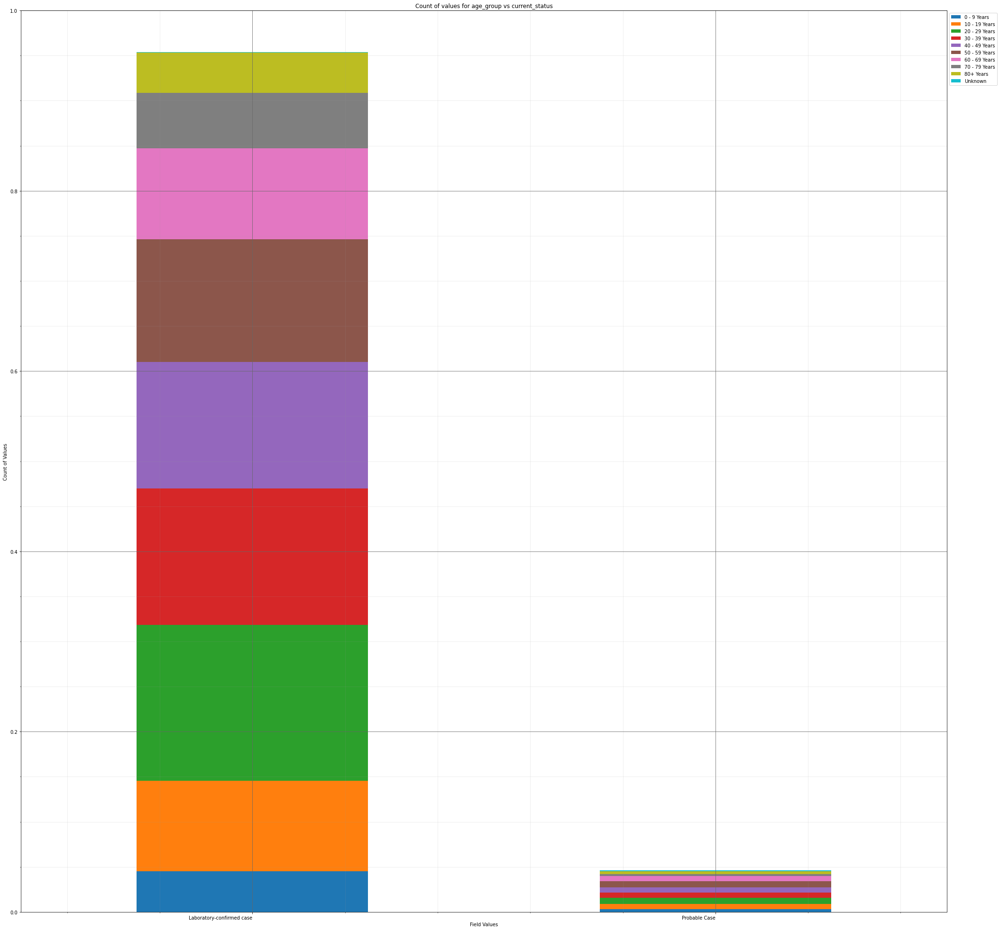



----------------------


Grouping over current_status|hosp_yn results in:



,current_status,hosp_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,4811,50.387516
1,Laboratory-confirmed case,OTH,0,0.000000
2,Laboratory-confirmed case,Unknown,3619,37.903226
3,Laboratory-confirmed case,Yes,676,7.080017
4,Probable Case,No,345,3.613322
5,Probable Case,OTH,0,0.000000
6,Probable Case,Unknown,76,0.795978
7,Probable Case,Yes,21,0.219941


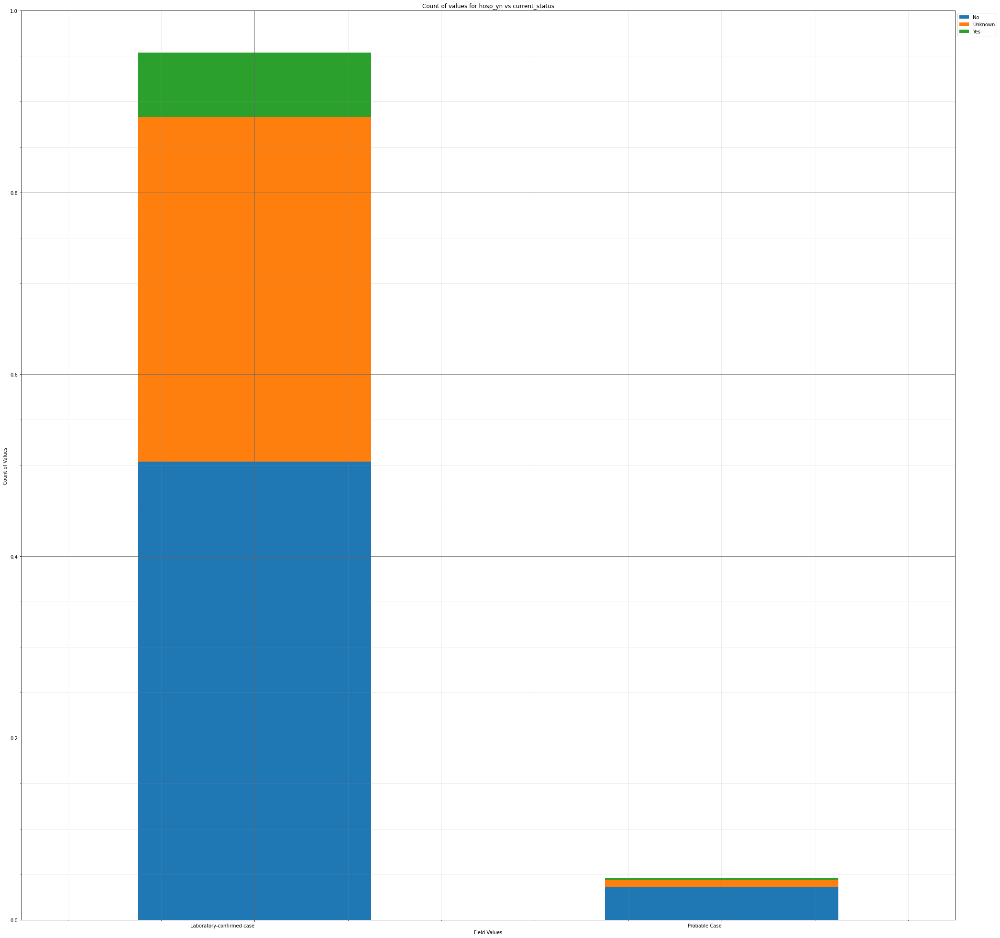



----------------------


Grouping over current_status|icu_yn results in:



,current_status,icu_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,896,9.384164
1,Laboratory-confirmed case,Unknown,8120,85.043988
2,Laboratory-confirmed case,Yes,90,0.942606
3,Probable Case,No,53,0.555090
4,Probable Case,Unknown,389,4.074152
5,Probable Case,Yes,0,0.000000


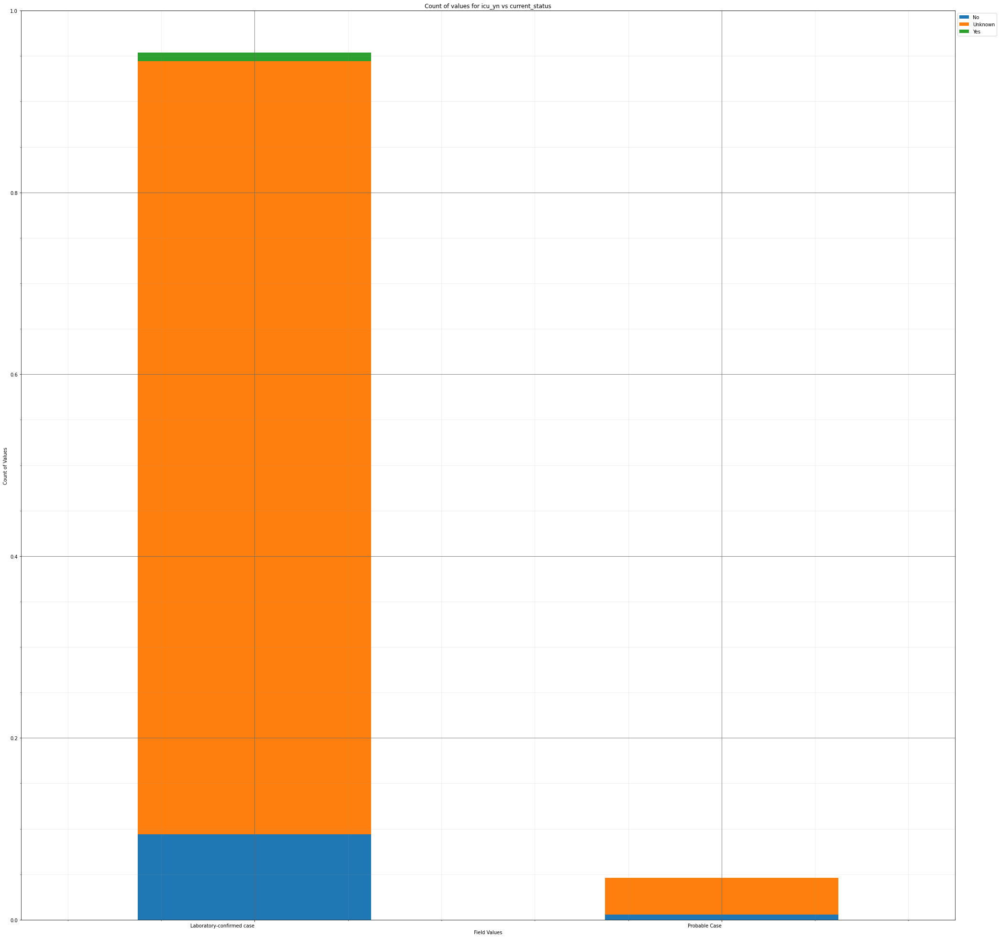



----------------------


Grouping over current_status|death_yn results in:



,current_status,death_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,8801,92.176372
1,Laboratory-confirmed case,Yes,305,3.194386
2,Probable Case,No,415,4.346460
3,Probable Case,Yes,27,0.282782


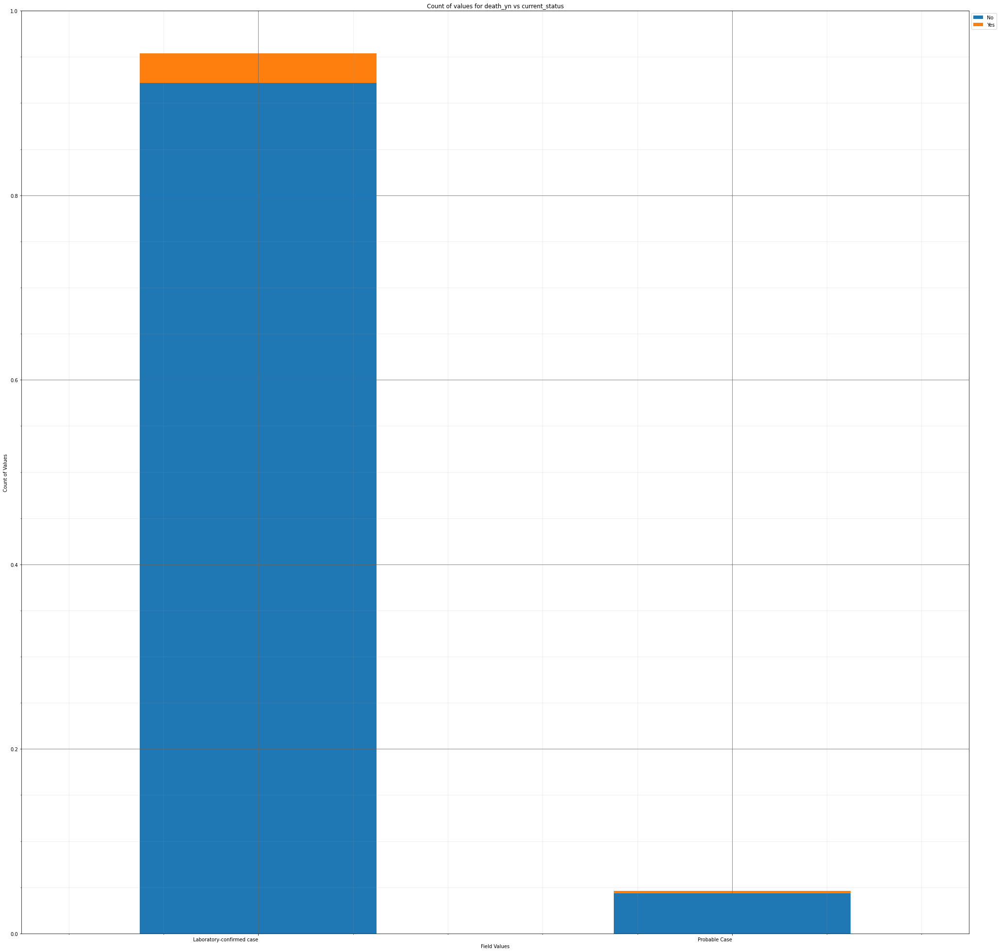



----------------------


Grouping over current_status|medcond_yn results in:



,current_status,medcond_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,888,9.300377
1,Laboratory-confirmed case,Unknown,7407,77.576456
2,Laboratory-confirmed case,Yes,811,8.493925
3,Probable Case,No,38,0.397989
4,Probable Case,Unknown,384,4.021785
5,Probable Case,Yes,20,0.209468


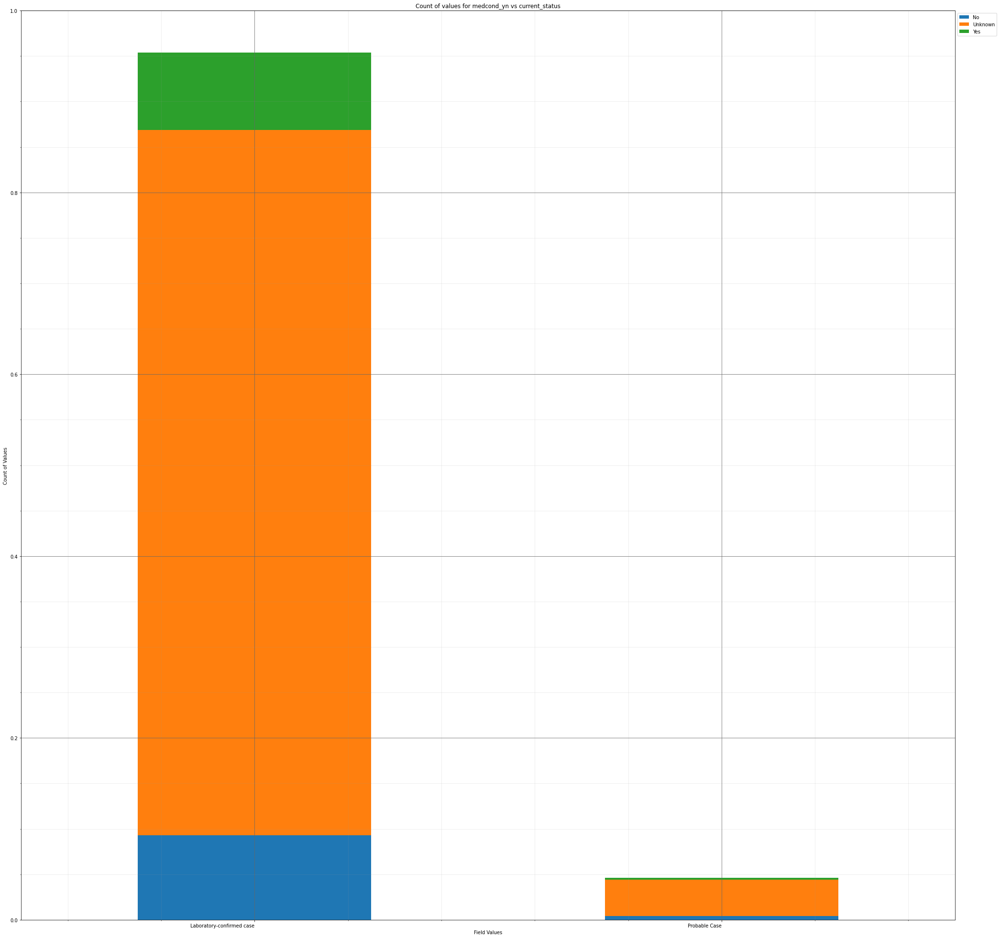



----------------------


Grouping over current_status|race results in:



,current_status,race,Rows,% Frequency
0,Laboratory-confirmed case,American Indian/Alaska Native,62,0.649351
1,Laboratory-confirmed case,Asian,231,2.419355
2,Laboratory-confirmed case,Black,669,7.006703
3,Laboratory-confirmed case,Hispanic/Latino,901,9.436531
4,Laboratory-confirmed case,Multiple/Other,478,5.006284
5,Laboratory-confirmed case,Native Hawaiian/Other Pacific Islander,23,0.240888
6,Laboratory-confirmed case,Unknown,3676,38.500209
7,Laboratory-confirmed case,White,3066,32.111437
8,Probable Case,American Indian/Alaska Native,4,0.041894
9,Probable Case,Asian,8,0.083787


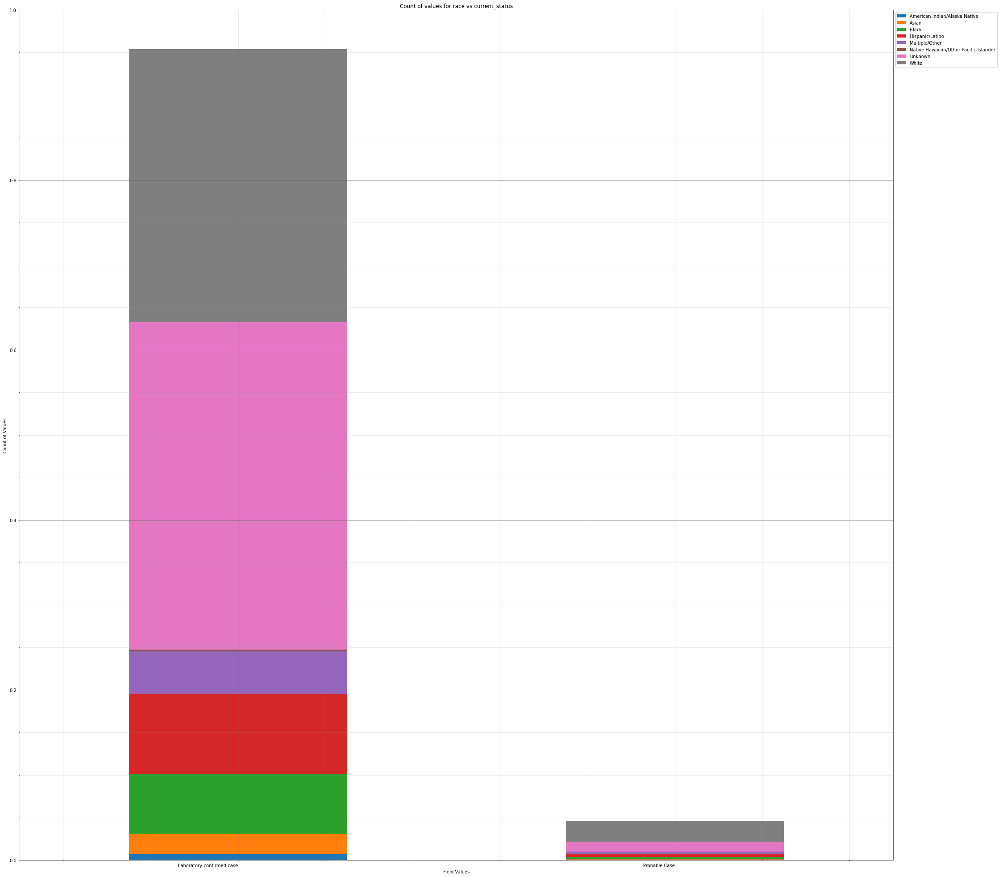



----------------------


Grouping over sex|current_status results in:



,sex,current_status,Rows,% Frequency
0,Female,Laboratory-confirmed case,4862,50.921659
1,Female,Probable Case,227,2.377461
2,Male,Laboratory-confirmed case,4166,43.632174
3,Male,Probable Case,210,2.199413
4,Unknown,Laboratory-confirmed case,78,0.816925
5,Unknown,Probable Case,5,0.052367


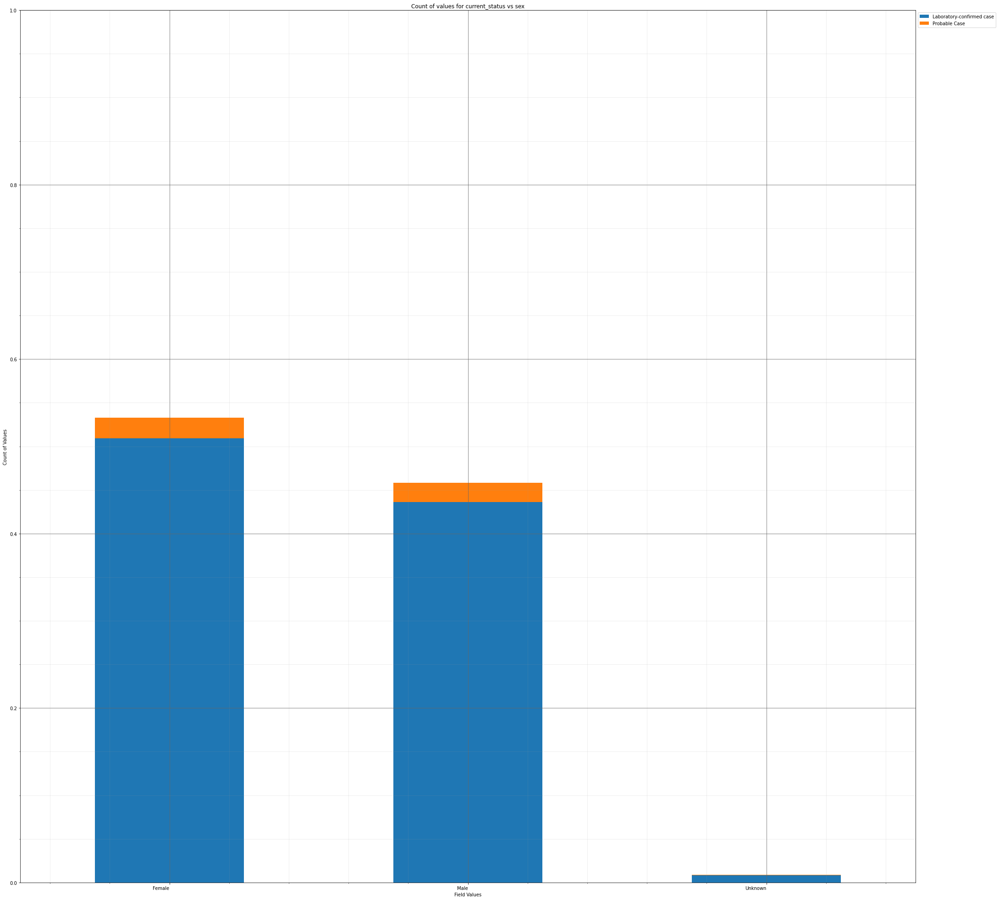



----------------------


Grouping over sex|age_group results in:



,sex,age_group,Rows,% Frequency
0,Female,0 - 9 Years,233,2.440302
1,Female,10 - 19 Years,525,5.498534
2,Female,20 - 29 Years,925,9.687893
3,Female,30 - 39 Years,806,8.441558
4,Female,40 - 49 Years,727,7.614160
5,Female,50 - 59 Years,726,7.603687
6,Female,60 - 69 Years,529,5.540427
7,Female,70 - 79 Years,314,3.288647
8,Female,80+ Years,294,3.079179
9,Female,Unknown,10,0.104734


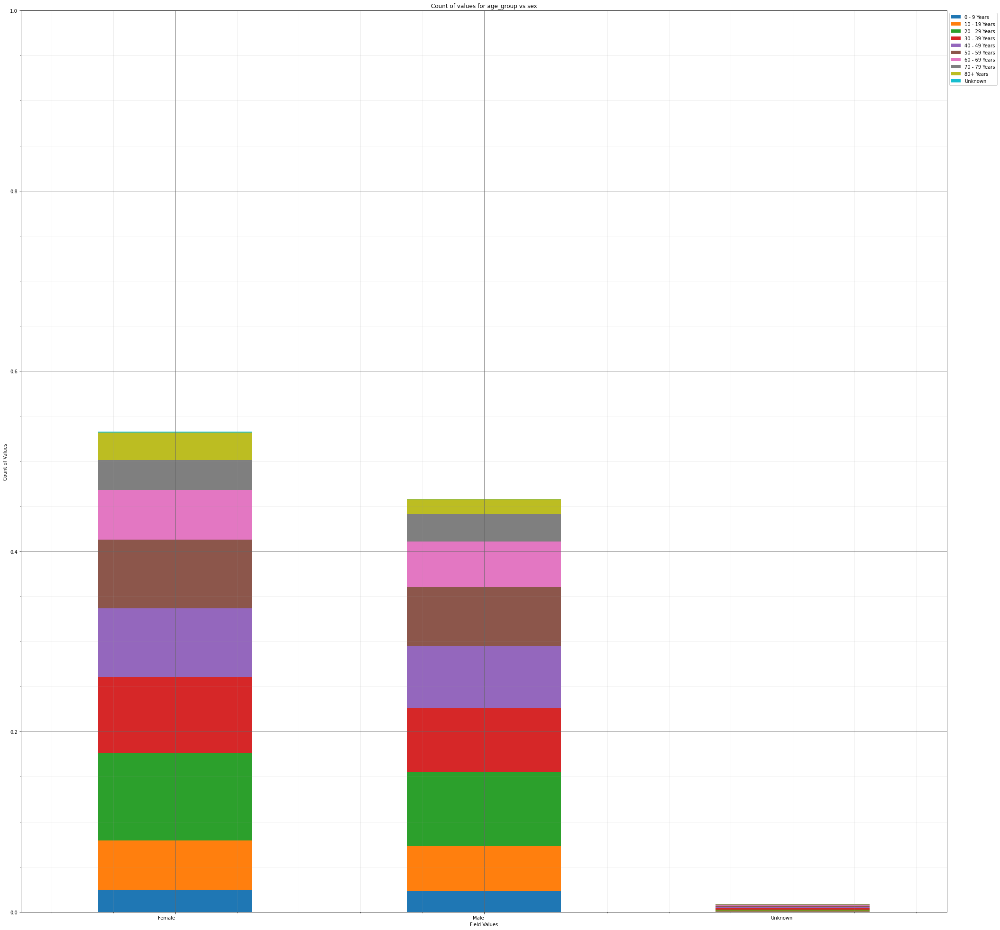



----------------------


Grouping over sex|hosp_yn results in:



,sex,hosp_yn,Rows,% Frequency
0,Female,No,2824,29.576875
1,Female,OTH,0,0.000000
2,Female,Unknown,1919,20.098450
3,Female,Yes,346,3.623796
4,Male,No,2305,24.141181
5,Male,OTH,0,0.000000
6,Male,Unknown,1721,18.024717
7,Male,Yes,350,3.665689
8,Unknown,No,27,0.282782
9,Unknown,OTH,0,0.000000


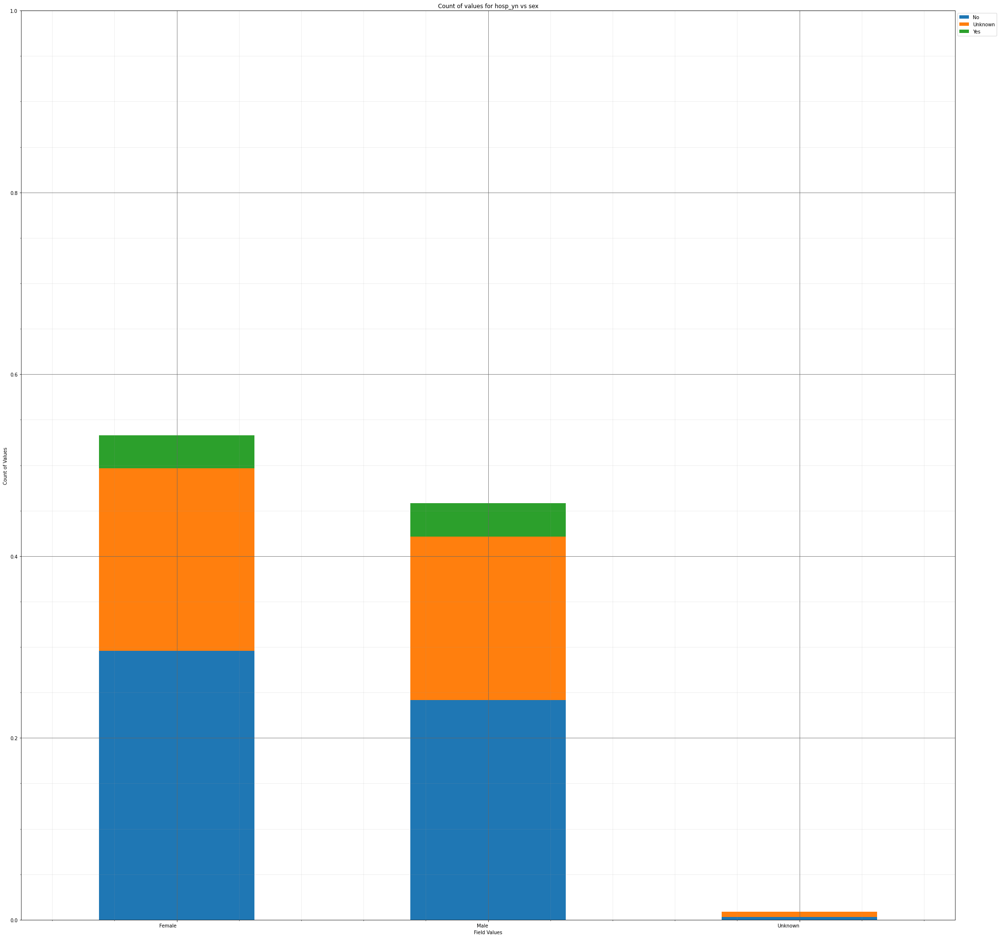



----------------------


Grouping over sex|icu_yn results in:



,sex,icu_yn,Rows,% Frequency
0,Female,No,509,5.330959
1,Female,Unknown,4540,47.549225
2,Female,Yes,40,0.418936
3,Male,No,436,4.566401
4,Male,Unknown,3891,40.751990
5,Male,Yes,49,0.513196
6,Unknown,No,4,0.041894
7,Unknown,Unknown,78,0.816925
8,Unknown,Yes,1,0.010473


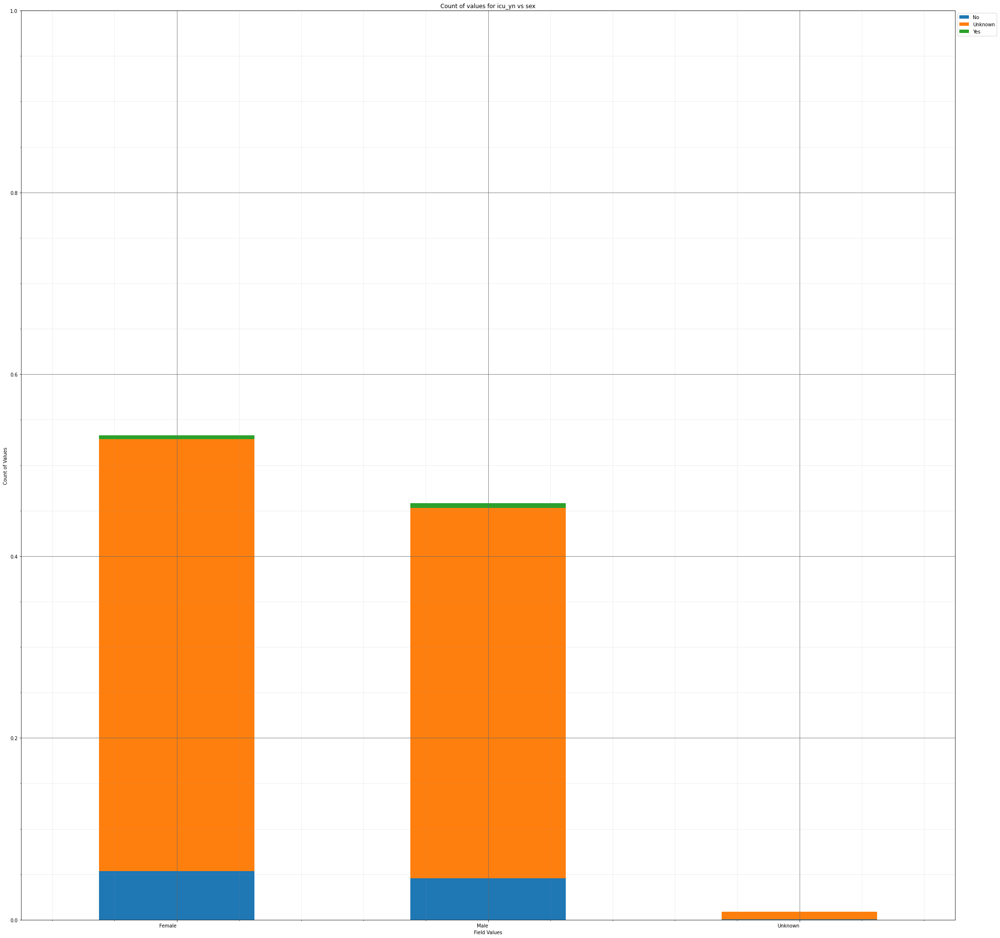



----------------------


Grouping over sex|death_yn results in:



,sex,death_yn,Rows,% Frequency
0,Female,No,4923,51.560536
1,Female,Yes,166,1.738584
2,Male,No,4213,44.124424
3,Male,Yes,163,1.707164
4,Unknown,No,80,0.837872
5,Unknown,Yes,3,0.031420


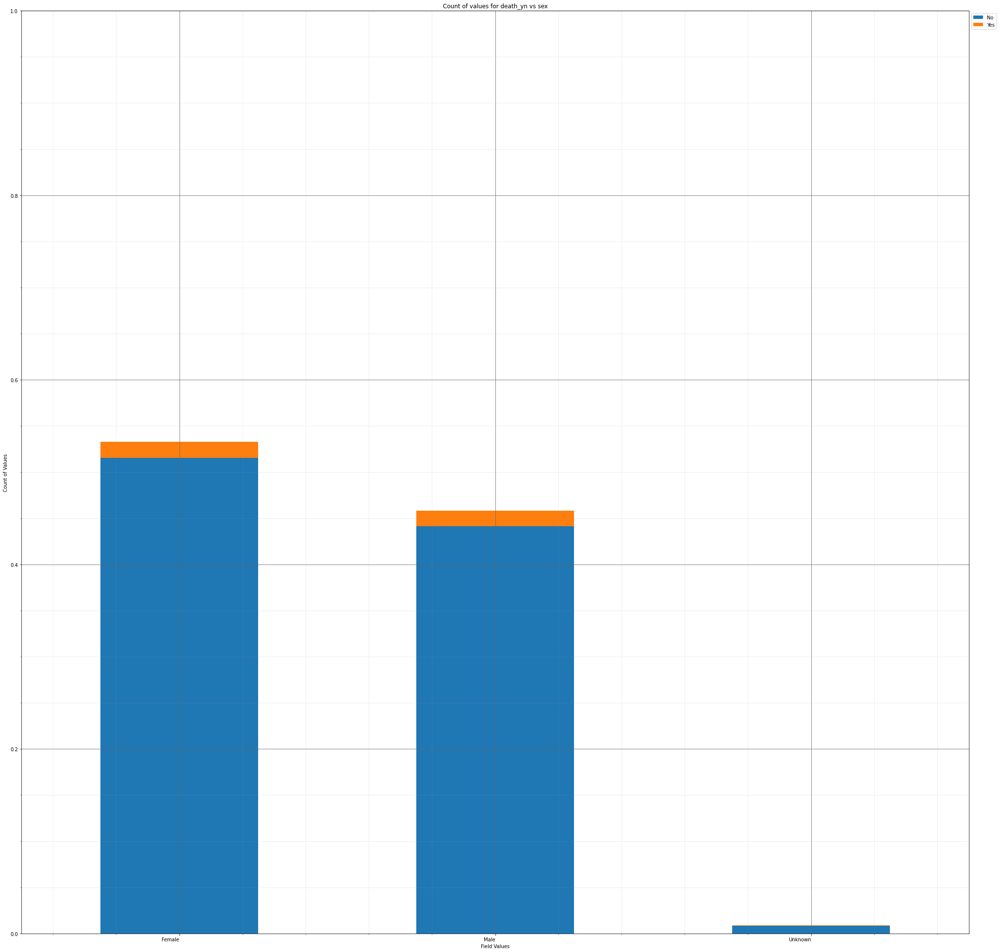



----------------------


Grouping over sex|medcond_yn results in:



,sex,medcond_yn,Rows,% Frequency
0,Female,No,507,5.310013
1,Female,Unknown,4125,43.202765
2,Female,Yes,457,4.786343
3,Male,No,412,4.315040
4,Male,Unknown,3593,37.630917
5,Male,Yes,371,3.885630
6,Unknown,No,7,0.073314
7,Unknown,Unknown,73,0.764558
8,Unknown,Yes,3,0.031420


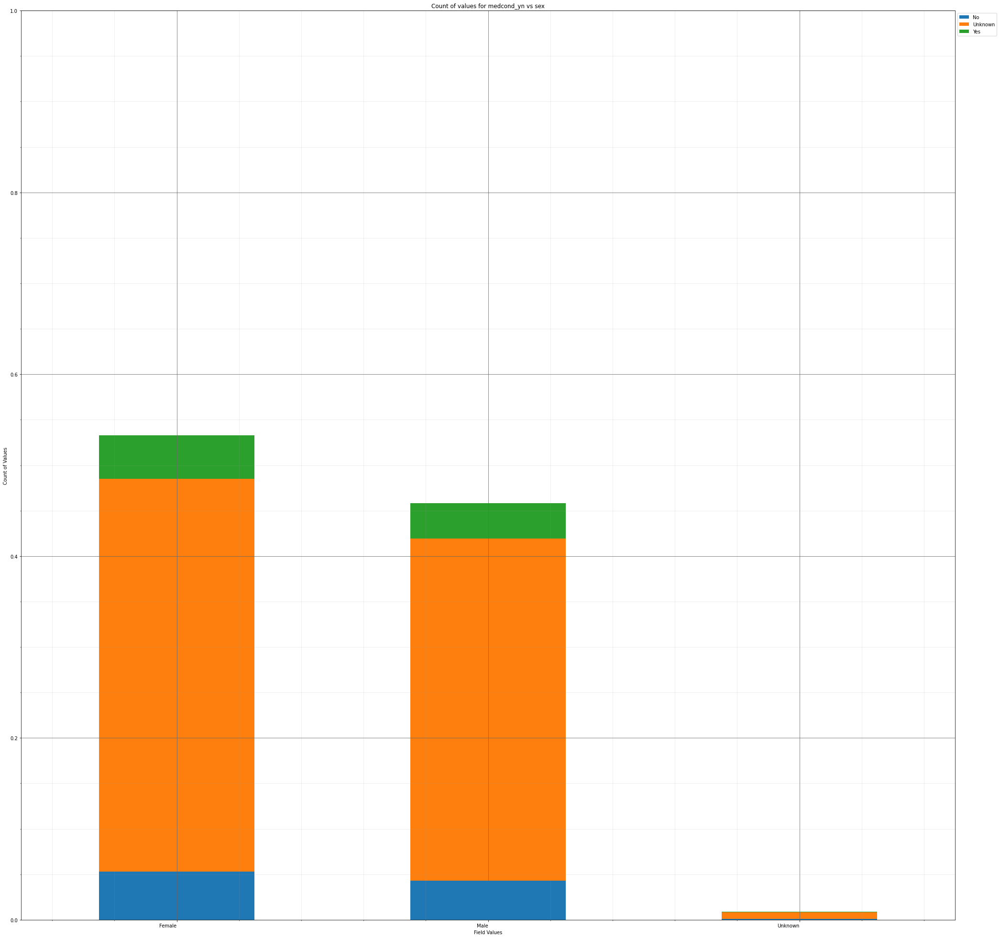



----------------------


Grouping over sex|race results in:



,sex,race,Rows,% Frequency
0,Female,American Indian/Alaska Native,34,0.356096
1,Female,Asian,122,1.277755
2,Female,Black,410,4.294093
3,Female,Hispanic/Latino,510,5.341433
4,Female,Multiple/Other,262,2.744030
5,Female,Native Hawaiian/Other Pacific Islander,14,0.146628
6,Female,Unknown,1960,20.527859
7,Female,White,1777,18.611227
8,Male,American Indian/Alaska Native,32,0.335149
9,Male,Asian,114,1.193967


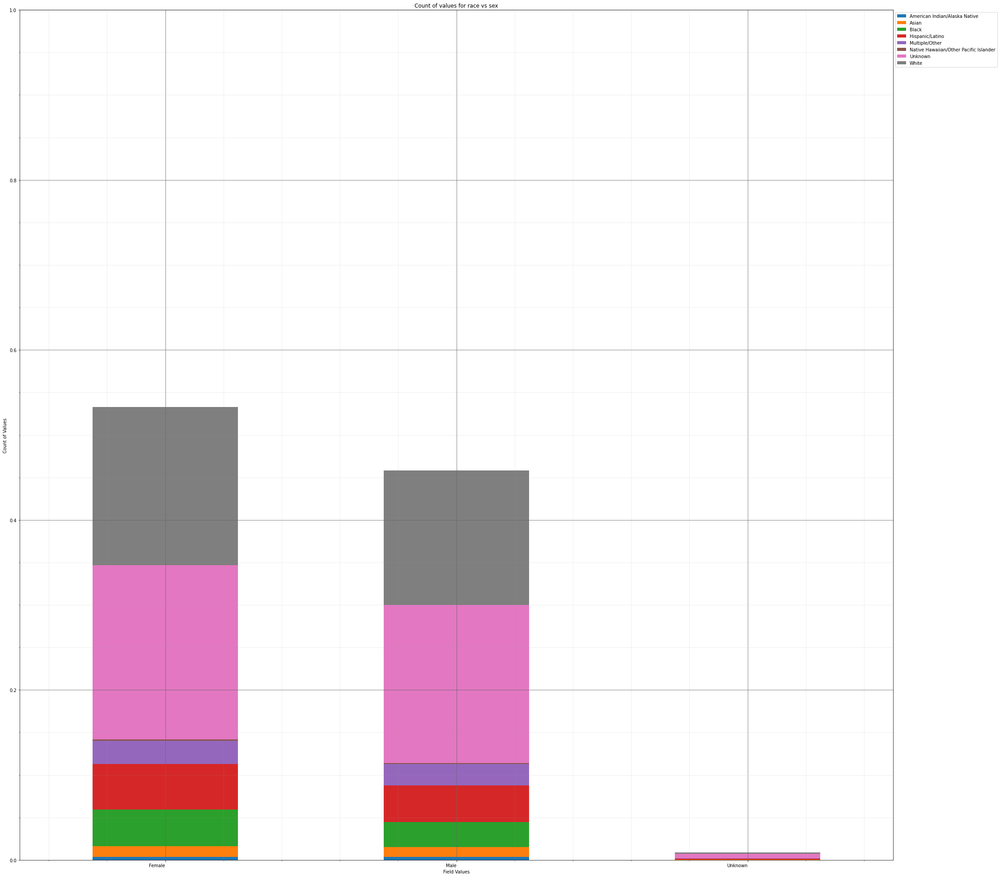



----------------------


Grouping over age_group|current_status results in:



,age_group,current_status,Rows,% Frequency
0,0 - 9 Years,Laboratory-confirmed case,430,4.503561
1,0 - 9 Years,Probable Case,28,0.293255
2,10 - 19 Years,Laboratory-confirmed case,960,10.054462
3,10 - 19 Years,Probable Case,54,0.565563
4,20 - 29 Years,Laboratory-confirmed case,1648,17.260159
5,20 - 29 Years,Probable Case,70,0.733138
6,30 - 39 Years,Laboratory-confirmed case,1449,15.175953
7,30 - 39 Years,Probable Case,54,0.565563
8,40 - 49 Years,Laboratory-confirmed case,1340,14.034353
9,40 - 49 Years,Probable Case,56,0.586510


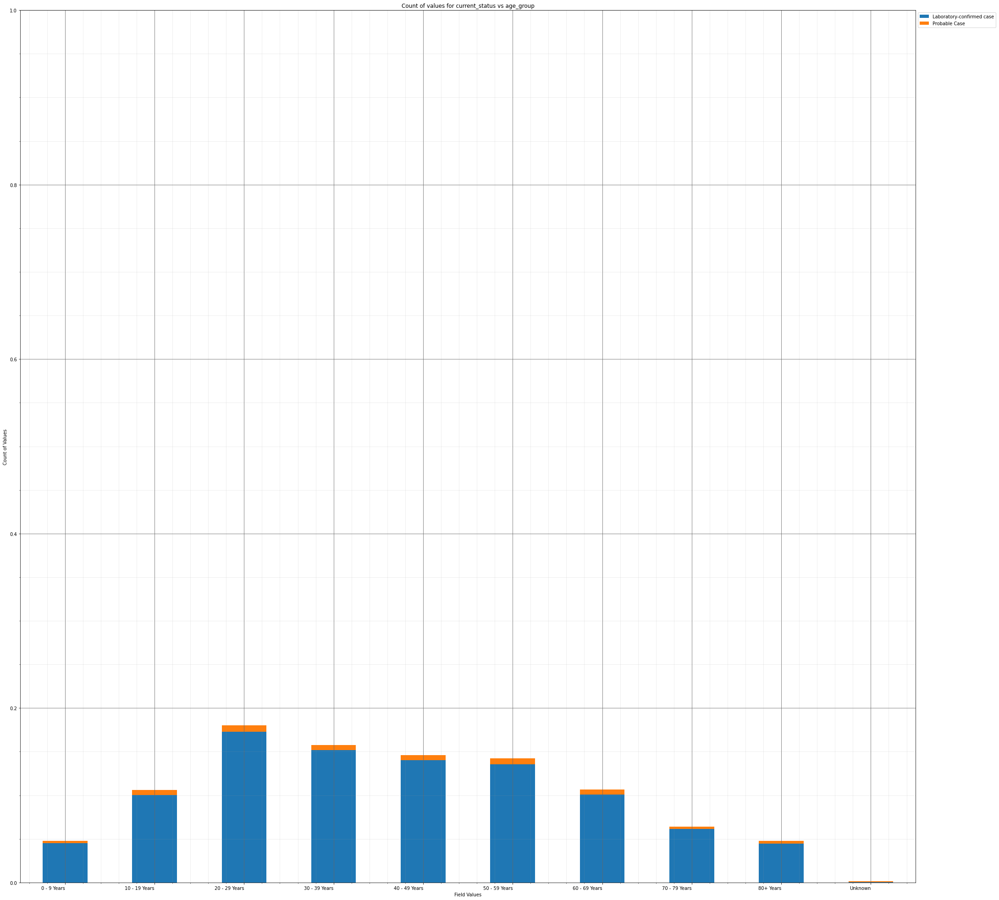



----------------------


Grouping over age_group|sex results in:



,age_group,sex,Rows,% Frequency
0,0 - 9 Years,Female,233,2.440302
1,0 - 9 Years,Male,221,2.314621
2,0 - 9 Years,Unknown,4,0.041894
3,10 - 19 Years,Female,525,5.498534
4,10 - 19 Years,Male,477,4.995811
5,10 - 19 Years,Unknown,12,0.125681
6,20 - 29 Years,Female,925,9.687893
7,20 - 29 Years,Male,784,8.211144
8,20 - 29 Years,Unknown,9,0.094261
9,30 - 39 Years,Female,806,8.441558


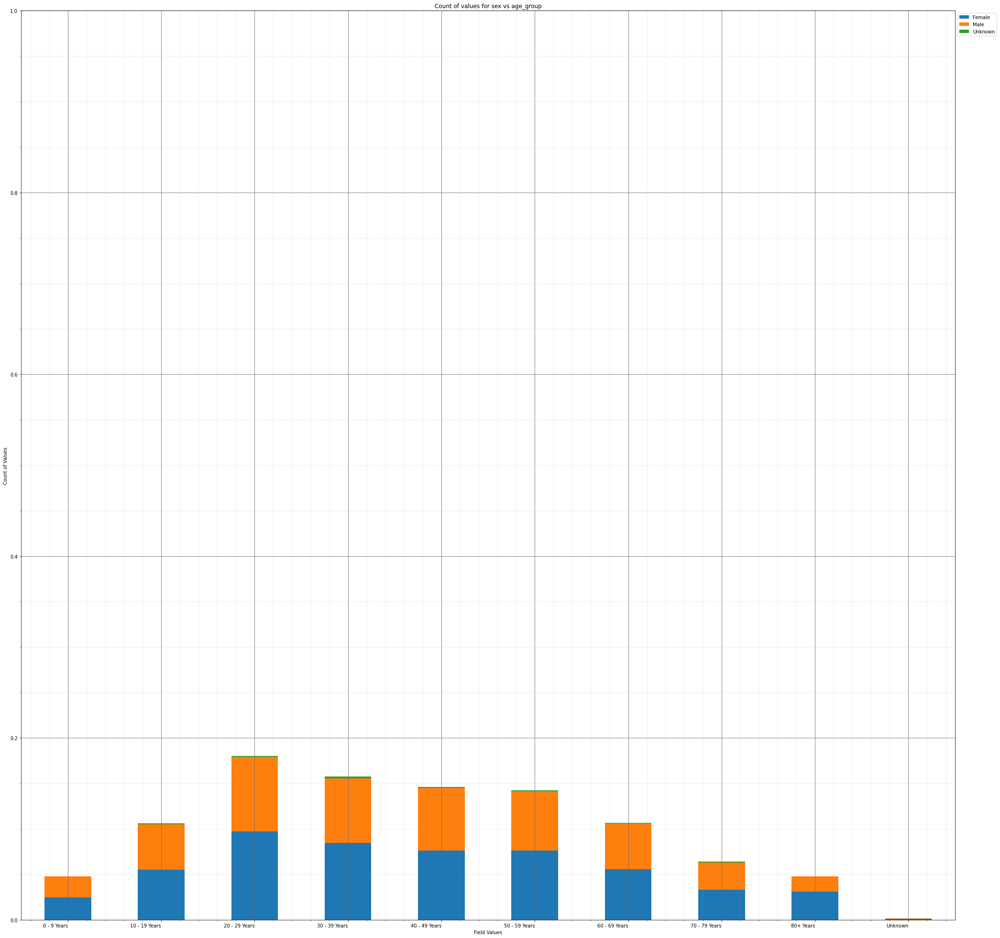



----------------------


Grouping over age_group|hosp_yn results in:



,age_group,hosp_yn,Rows,% Frequency
0,0 - 9 Years,No,259,2.712610
1,0 - 9 Years,OTH,0,0.000000
2,0 - 9 Years,Unknown,191,2.000419
3,0 - 9 Years,Yes,8,0.083787
4,10 - 19 Years,No,605,6.336406
5,10 - 19 Years,OTH,0,0.000000
6,10 - 19 Years,Unknown,399,4.178886
7,10 - 19 Years,Yes,10,0.104734
8,20 - 29 Years,No,975,10.211563
9,20 - 29 Years,OTH,0,0.000000


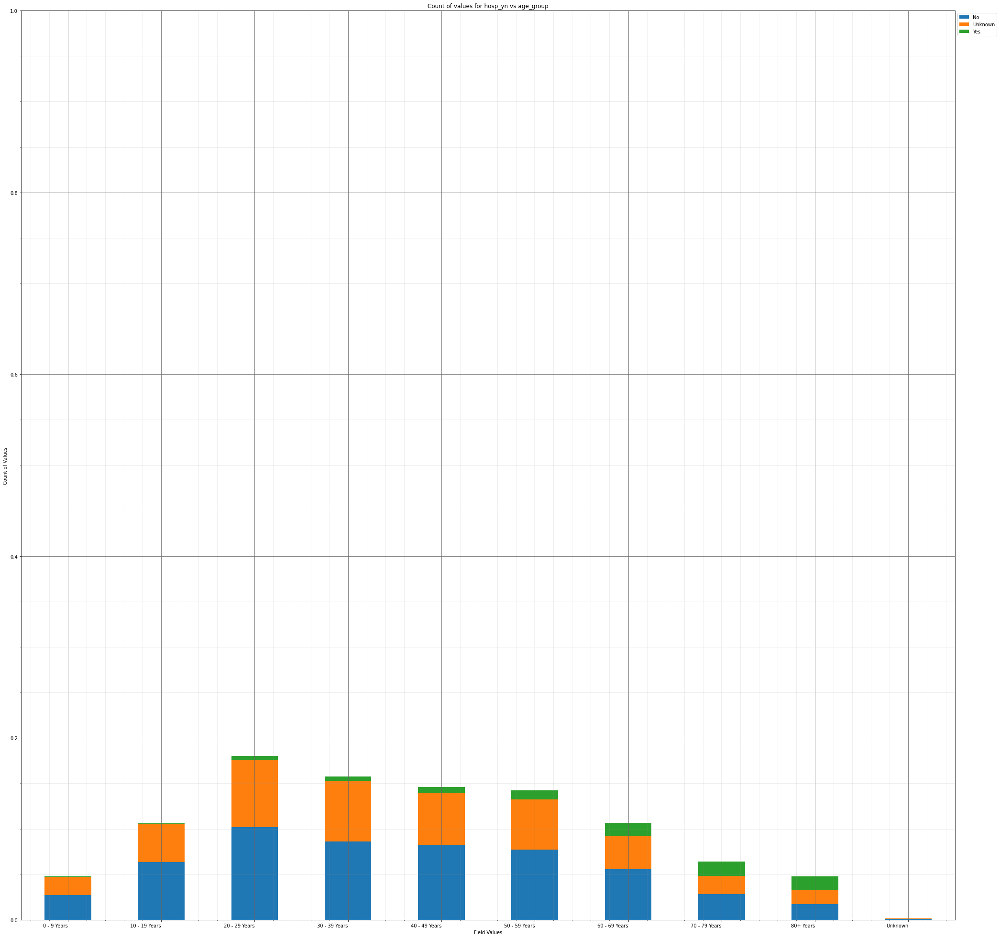



----------------------


Grouping over age_group|icu_yn results in:



,age_group,icu_yn,Rows,% Frequency
0,0 - 9 Years,No,32,0.335149
1,0 - 9 Years,Unknown,426,4.461667
2,0 - 9 Years,Yes,0,0.000000
3,10 - 19 Years,No,115,1.204441
4,10 - 19 Years,Unknown,897,9.394638
5,10 - 19 Years,Yes,2,0.020947
6,20 - 29 Years,No,167,1.749057
7,20 - 29 Years,Unknown,1551,16.244240
8,20 - 29 Years,Yes,0,0.000000
9,30 - 39 Years,No,164,1.717637


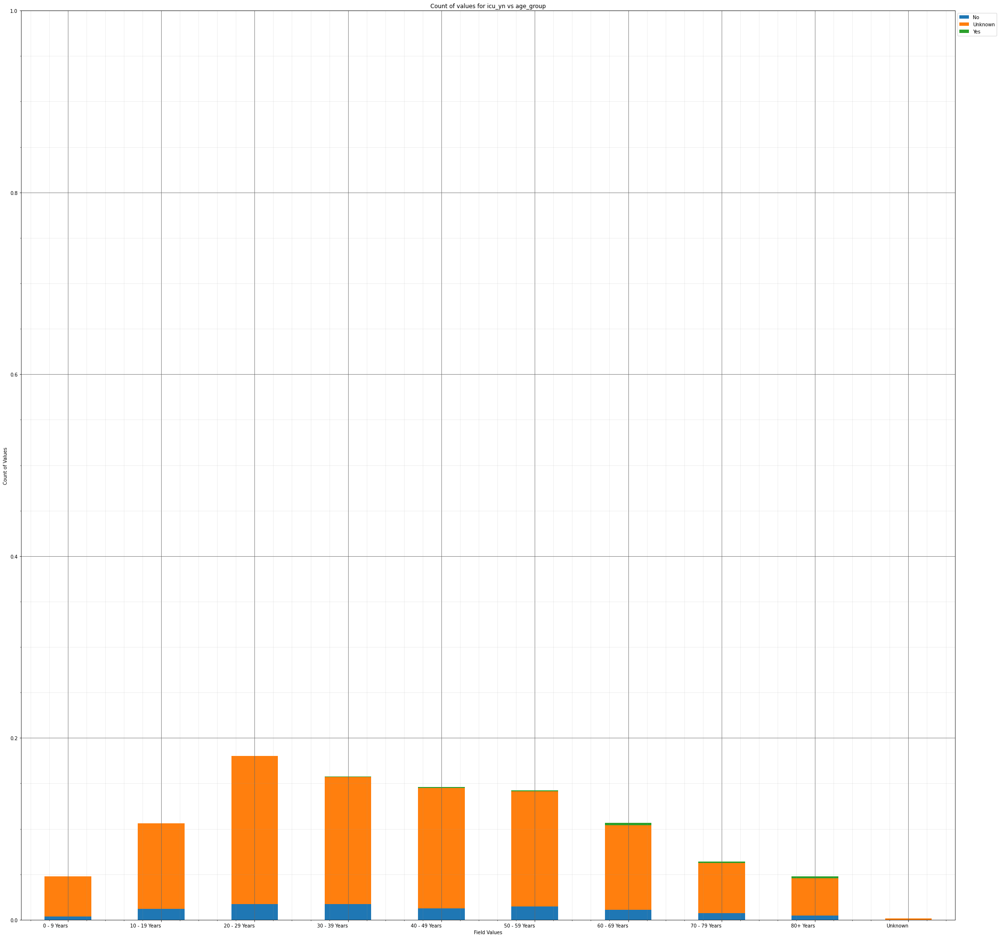



----------------------


Grouping over age_group|death_yn results in:



,age_group,death_yn,Rows,% Frequency
0,0 - 9 Years,No,458,4.796816
1,0 - 9 Years,Yes,0,0.000000
2,10 - 19 Years,No,1014,10.620025
3,10 - 19 Years,Yes,0,0.000000
4,20 - 29 Years,No,1718,17.993297
5,20 - 29 Years,Yes,0,0.000000
6,30 - 39 Years,No,1501,15.720570
7,30 - 39 Years,Yes,2,0.020947
8,40 - 49 Years,No,1384,14.495182
9,40 - 49 Years,Yes,12,0.125681


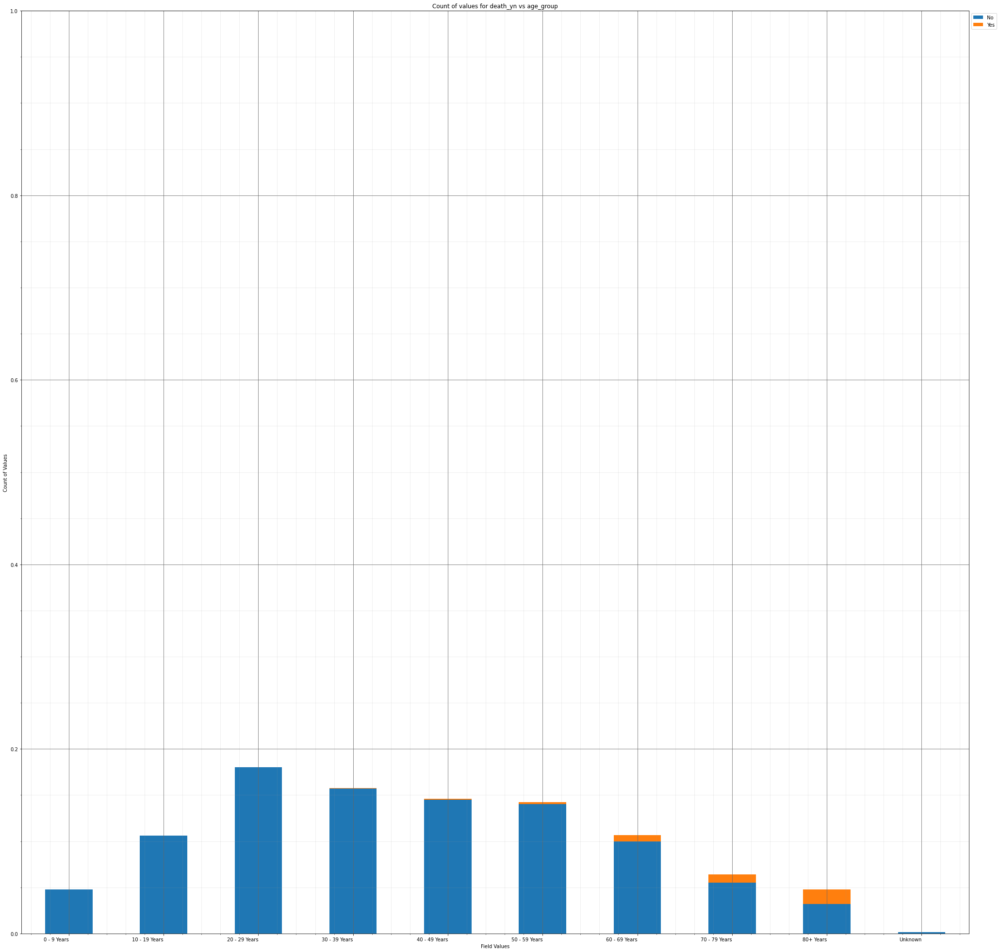



----------------------


Grouping over age_group|medcond_yn results in:



,age_group,medcond_yn,Rows,% Frequency
0,0 - 9 Years,No,52,0.544617
1,0 - 9 Years,Unknown,393,4.116045
2,0 - 9 Years,Yes,13,0.136154
3,10 - 19 Years,No,142,1.487222
4,10 - 19 Years,Unknown,839,8.787181
5,10 - 19 Years,Yes,33,0.345622
6,20 - 29 Years,No,221,2.314621
7,20 - 29 Years,Unknown,1414,14.809384
8,20 - 29 Years,Yes,83,0.869292
9,30 - 39 Years,No,172,1.801424


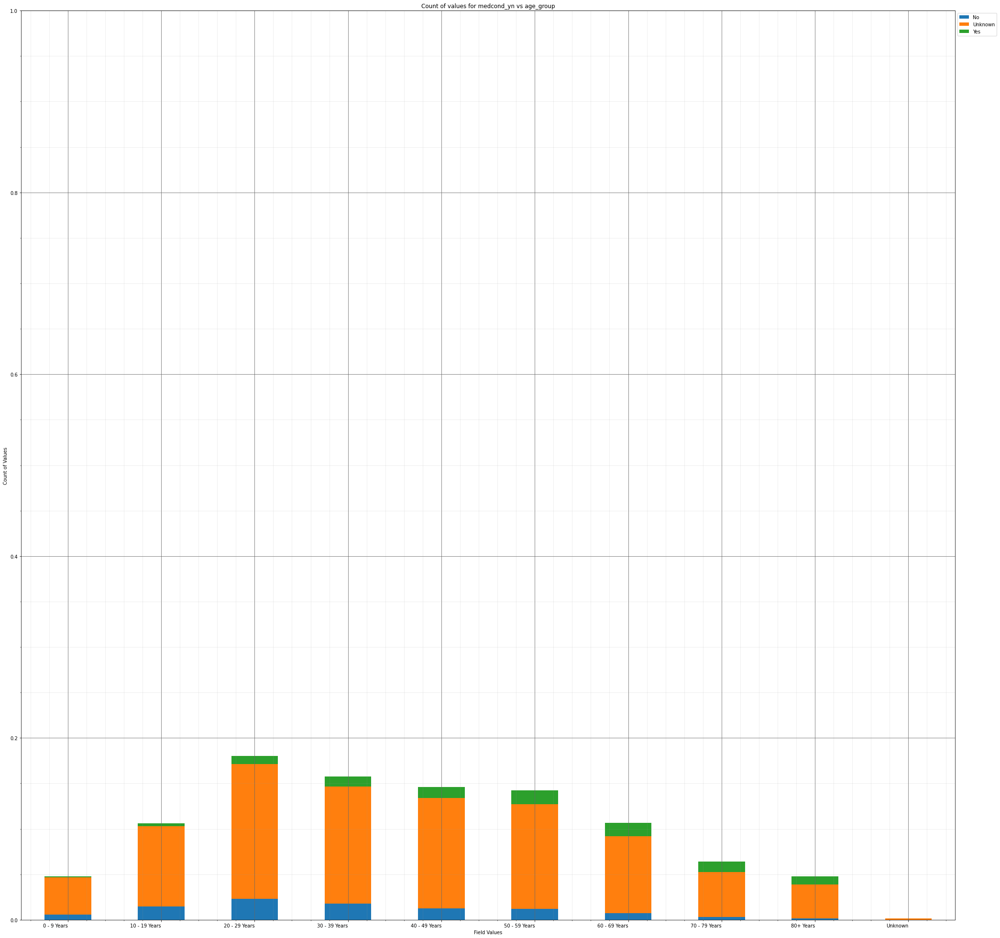



----------------------


Grouping over age_group|race results in:



,age_group,race,Rows,% Frequency
0,0 - 9 Years,American Indian/Alaska Native,4,0.041894
1,0 - 9 Years,Asian,12,0.125681
2,0 - 9 Years,Black,29,0.303729
3,0 - 9 Years,Hispanic/Latino,53,0.555090
4,0 - 9 Years,Multiple/Other,37,0.387516
...,...,...,...,...
75,Unknown,Hispanic/Latino,0,0.000000
76,Unknown,Multiple/Other,2,0.020947
77,Unknown,Native Hawaiian/Other Pacific Islander,0,0.000000
78,Unknown,Unknown,11,0.115207


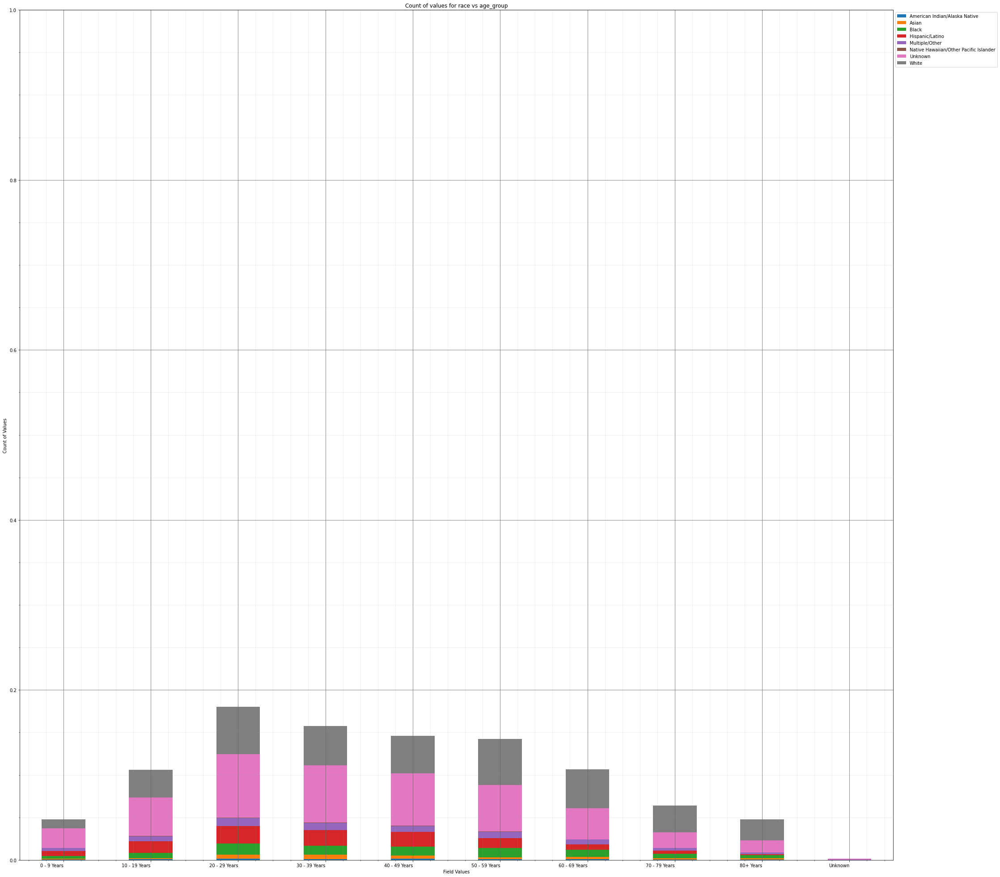



----------------------


Grouping over hosp_yn|current_status results in:



,hosp_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,4811,50.387516
1,No,Probable Case,345,3.613322
2,OTH,Laboratory-confirmed case,0,0.000000
3,OTH,Probable Case,0,0.000000
4,Unknown,Laboratory-confirmed case,3619,37.903226
5,Unknown,Probable Case,76,0.795978
6,Yes,Laboratory-confirmed case,676,7.080017
7,Yes,Probable Case,21,0.219941


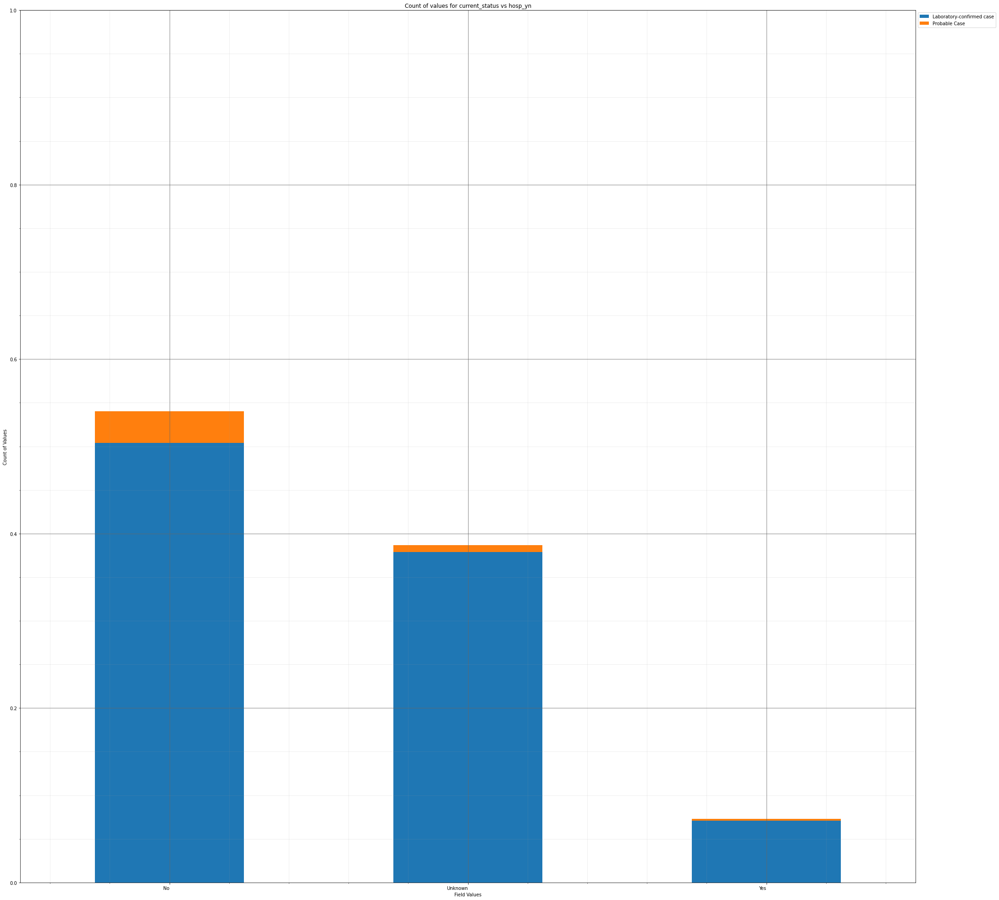



----------------------


Grouping over hosp_yn|sex results in:



,hosp_yn,sex,Rows,% Frequency
0,No,Female,2824,29.576875
1,No,Male,2305,24.141181
2,No,Unknown,27,0.282782
3,OTH,Female,0,0.000000
4,OTH,Male,0,0.000000
5,OTH,Unknown,0,0.000000
6,Unknown,Female,1919,20.098450
7,Unknown,Male,1721,18.024717
8,Unknown,Unknown,55,0.576037
9,Yes,Female,346,3.623796


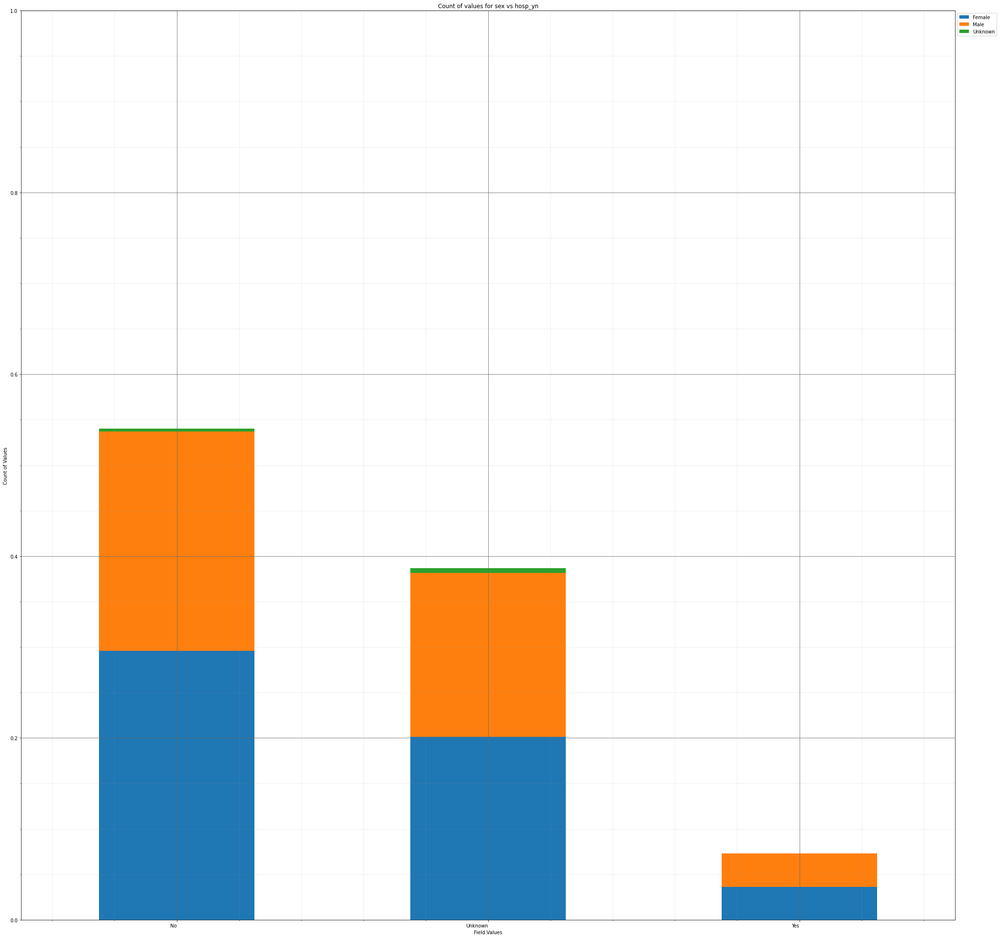



----------------------


Grouping over hosp_yn|age_group results in:



,hosp_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,259,2.712610
1,No,10 - 19 Years,605,6.336406
2,No,20 - 29 Years,975,10.211563
3,No,30 - 39 Years,821,8.598659
4,No,40 - 49 Years,786,8.232090
5,No,50 - 59 Years,738,7.729367
6,No,60 - 69 Years,531,5.561374
7,No,70 - 79 Years,268,2.806871
8,No,80+ Years,163,1.707164
9,No,Unknown,10,0.104734


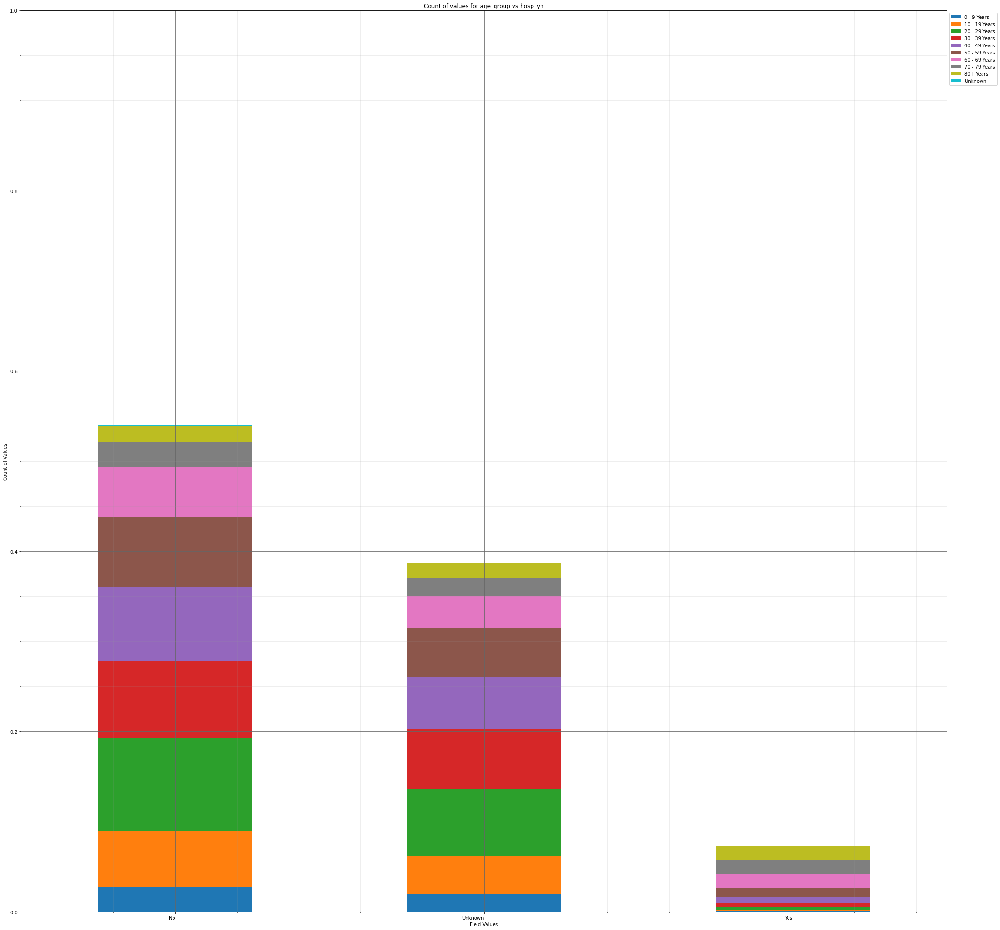



----------------------


Grouping over hosp_yn|icu_yn results in:



,hosp_yn,icu_yn,Rows,% Frequency
0,No,No,790,8.273984
1,No,Unknown,4366,45.726854
2,No,Yes,0,0.000000
3,OTH,No,0,0.000000
4,OTH,Unknown,0,0.000000
5,OTH,Yes,0,0.000000
6,Unknown,No,27,0.282782
7,Unknown,Unknown,3668,38.416422
8,Unknown,Yes,0,0.000000
9,Yes,No,132,1.382488


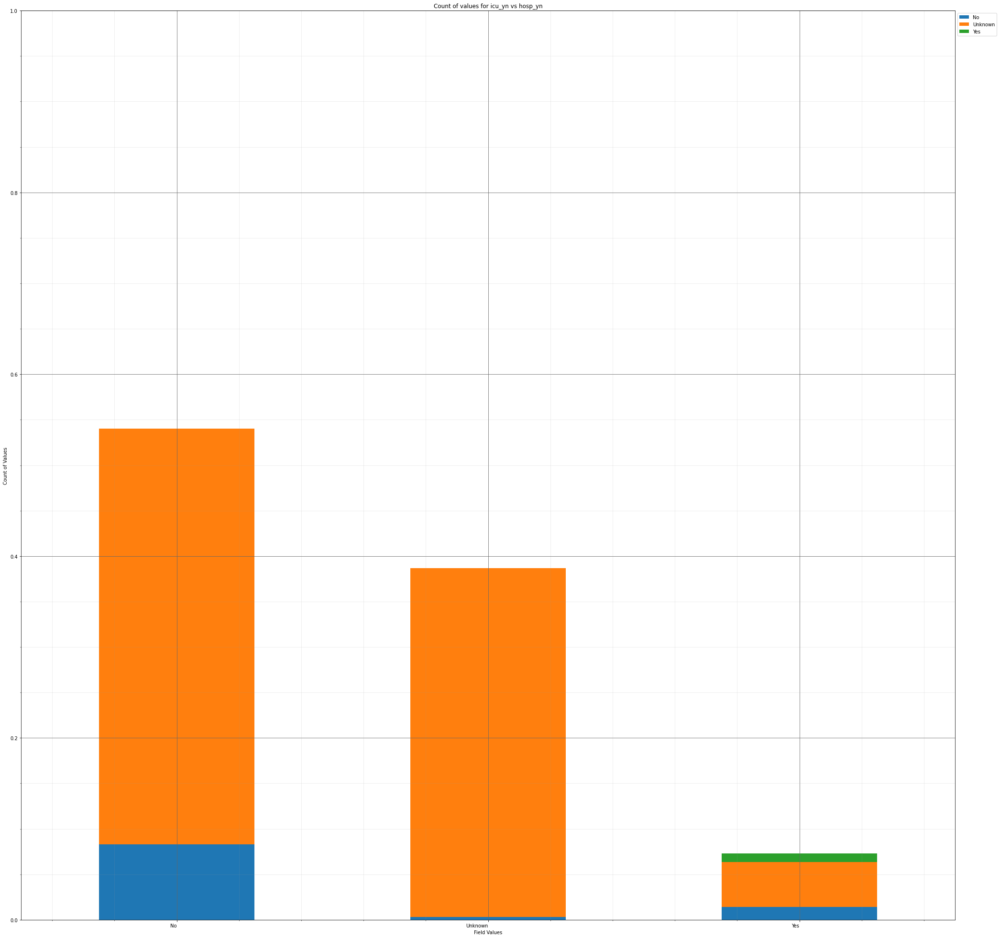



----------------------


Grouping over hosp_yn|death_yn results in:



,hosp_yn,death_yn,Rows,% Frequency
0,No,No,5110,53.519062
1,No,Yes,46,0.481776
2,OTH,No,0,0.000000
3,OTH,Yes,0,0.000000
4,Unknown,No,3614,37.850859
5,Unknown,Yes,81,0.848345
6,Yes,No,492,5.152912
7,Yes,Yes,205,2.147047


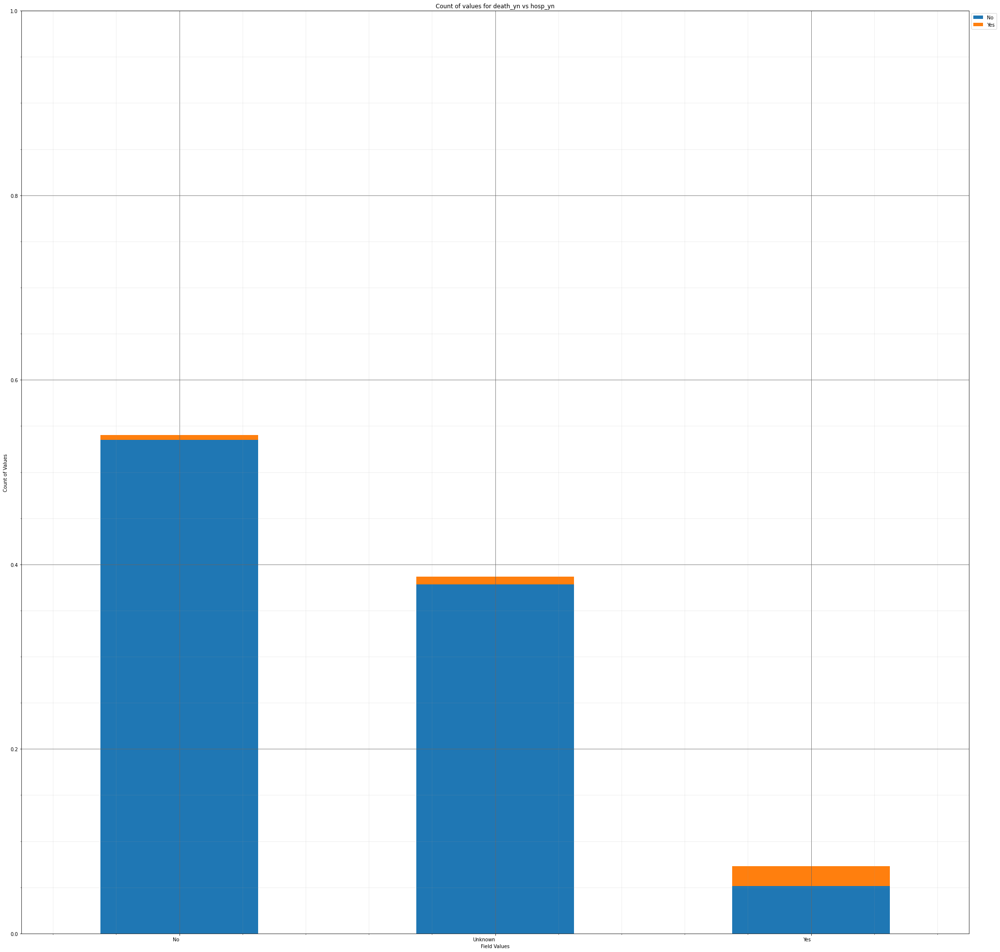



----------------------


Grouping over hosp_yn|medcond_yn results in:



,hosp_yn,medcond_yn,Rows,% Frequency
0,No,No,691,7.237118
1,No,Unknown,3914,40.992878
2,No,Yes,551,5.770842
3,OTH,No,0,0.000000
4,OTH,Unknown,0,0.000000
5,OTH,Yes,0,0.000000
6,Unknown,No,202,2.115626
7,Unknown,Unknown,3390,35.504818
8,Unknown,Yes,103,1.078760
9,Yes,No,33,0.345622


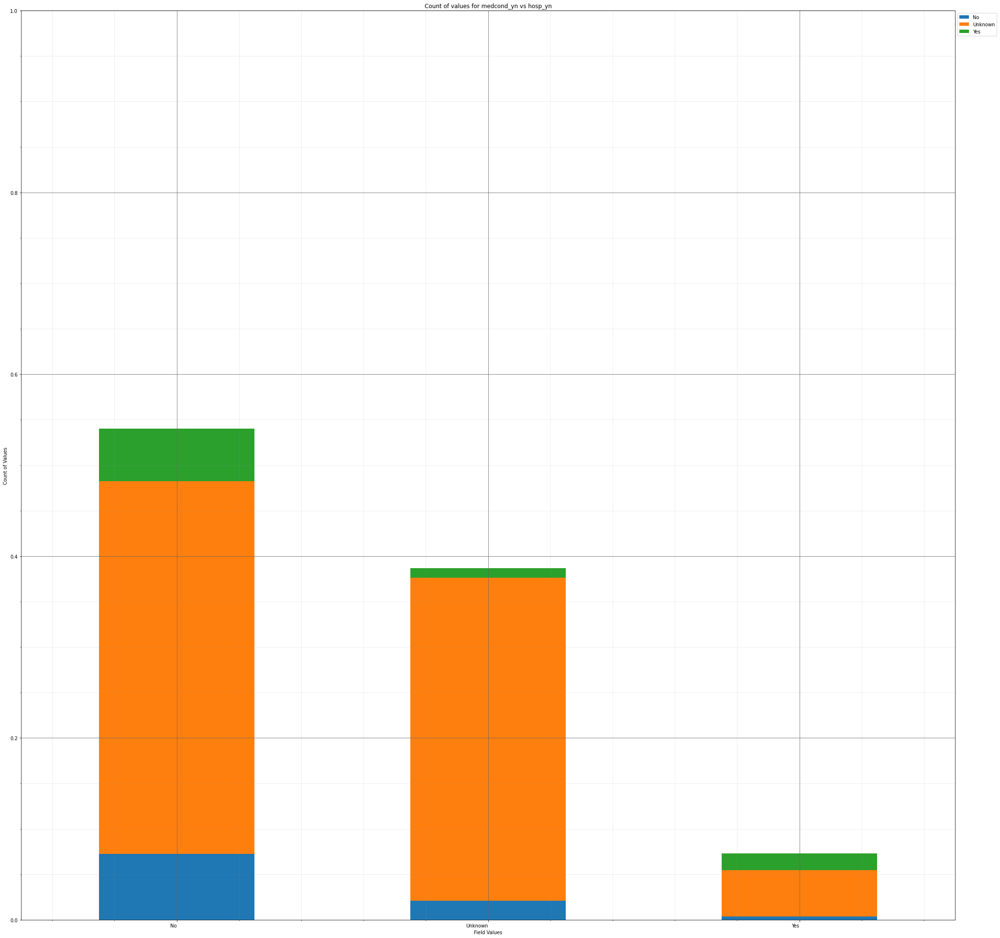



----------------------


Grouping over hosp_yn|race results in:



,hosp_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,39,0.408463
1,No,Asian,113,1.183494
2,No,Black,438,4.587348
3,No,Hispanic/Latino,704,7.373272
4,No,Multiple/Other,267,2.796397
5,No,Native Hawaiian/Other Pacific Islander,12,0.125681
6,No,Unknown,1391,14.568496
7,No,White,2192,22.957687
8,OTH,American Indian/Alaska Native,0,0.000000
9,OTH,Asian,0,0.000000


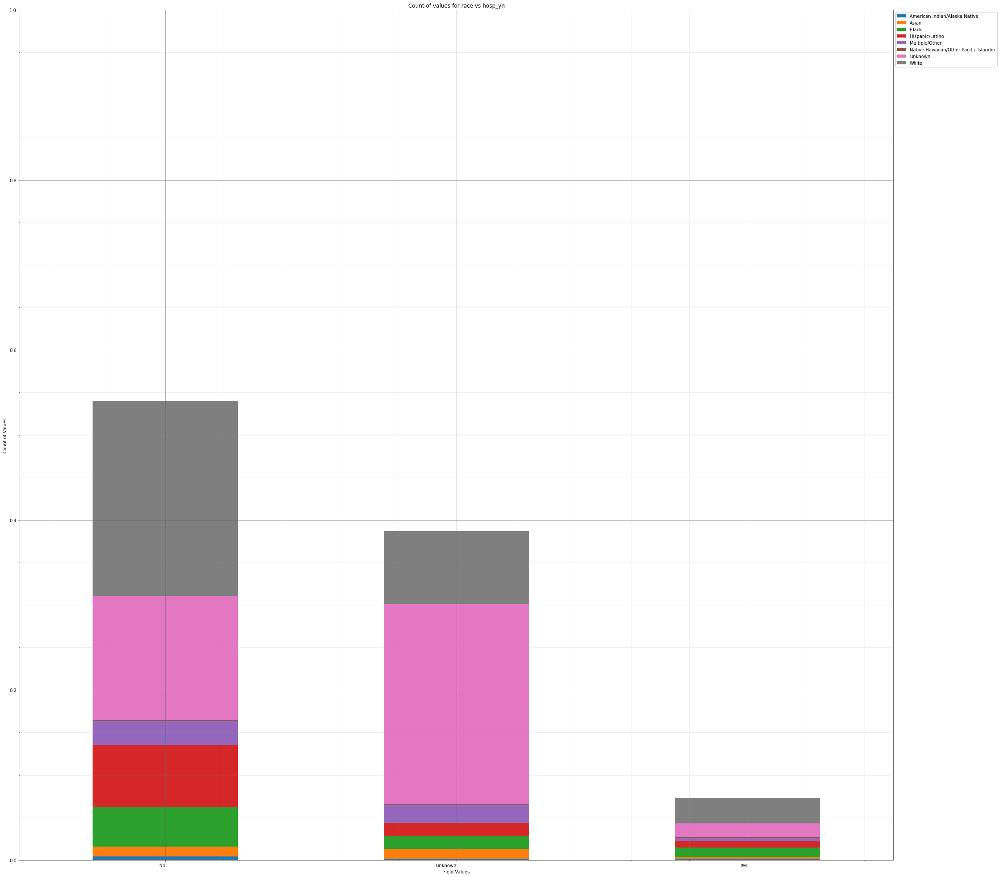



----------------------


Grouping over icu_yn|current_status results in:



,icu_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,896,9.384164
1,No,Probable Case,53,0.555090
2,Unknown,Laboratory-confirmed case,8120,85.043988
3,Unknown,Probable Case,389,4.074152
4,Yes,Laboratory-confirmed case,90,0.942606
5,Yes,Probable Case,0,0.000000


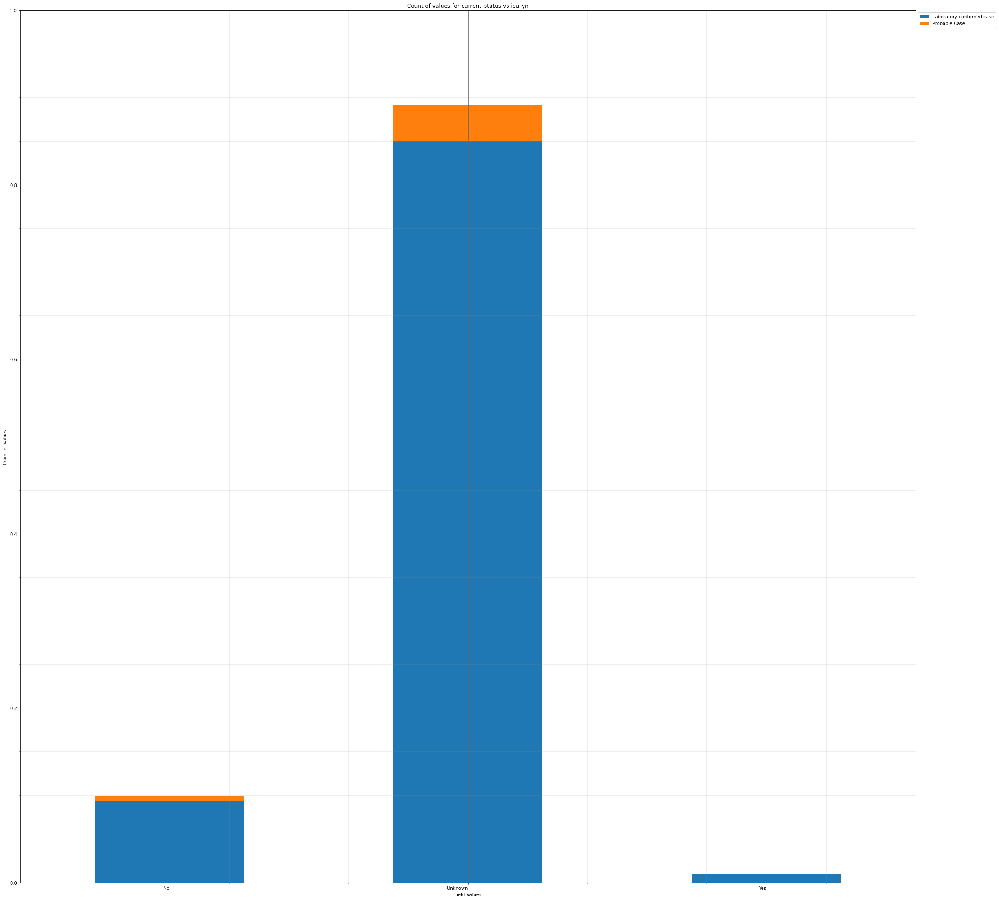



----------------------


Grouping over icu_yn|sex results in:



,icu_yn,sex,Rows,% Frequency
0,No,Female,509,5.330959
1,No,Male,436,4.566401
2,No,Unknown,4,0.041894
3,Unknown,Female,4540,47.549225
4,Unknown,Male,3891,40.751990
5,Unknown,Unknown,78,0.816925
6,Yes,Female,40,0.418936
7,Yes,Male,49,0.513196
8,Yes,Unknown,1,0.010473


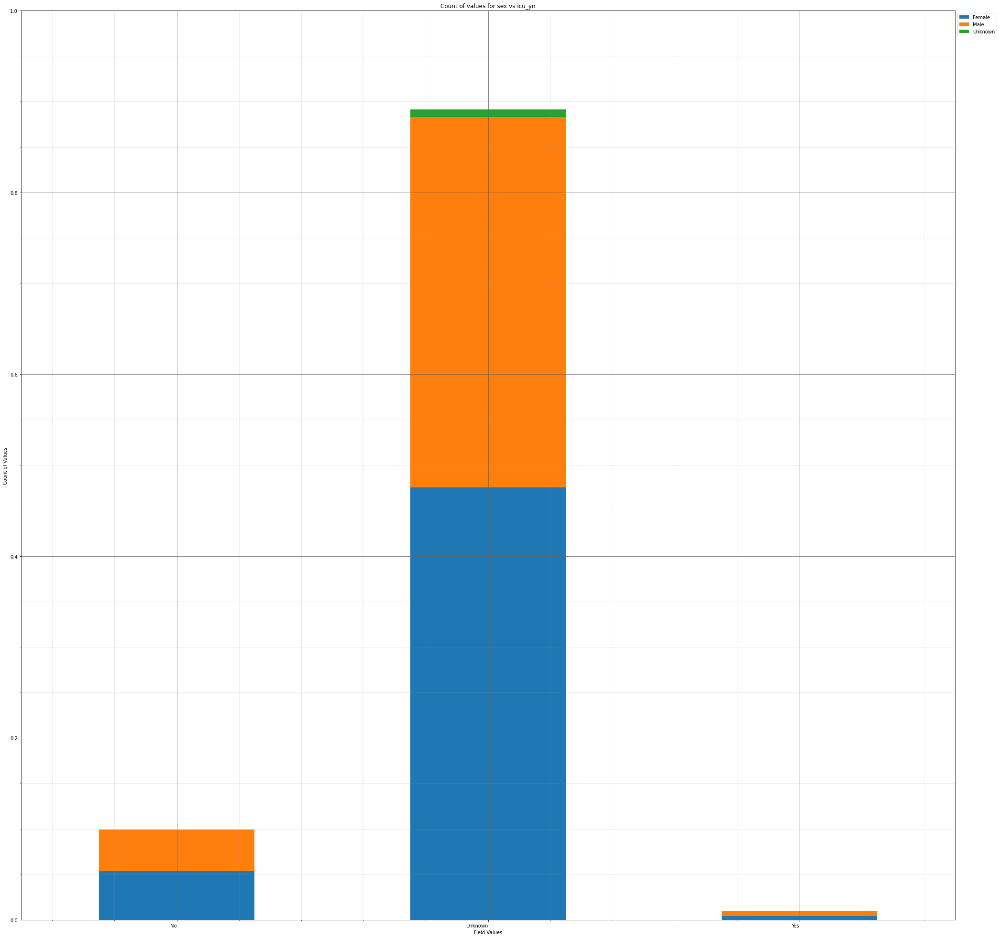



----------------------


Grouping over icu_yn|age_group results in:



,icu_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,32,0.335149
1,No,10 - 19 Years,115,1.204441
2,No,20 - 29 Years,167,1.749057
3,No,30 - 39 Years,164,1.717637
4,No,40 - 49 Years,118,1.235861
5,No,50 - 59 Years,139,1.455802
6,No,60 - 69 Years,102,1.068287
7,No,70 - 79 Years,67,0.701718
8,No,80+ Years,45,0.471303
9,No,Unknown,0,0.000000


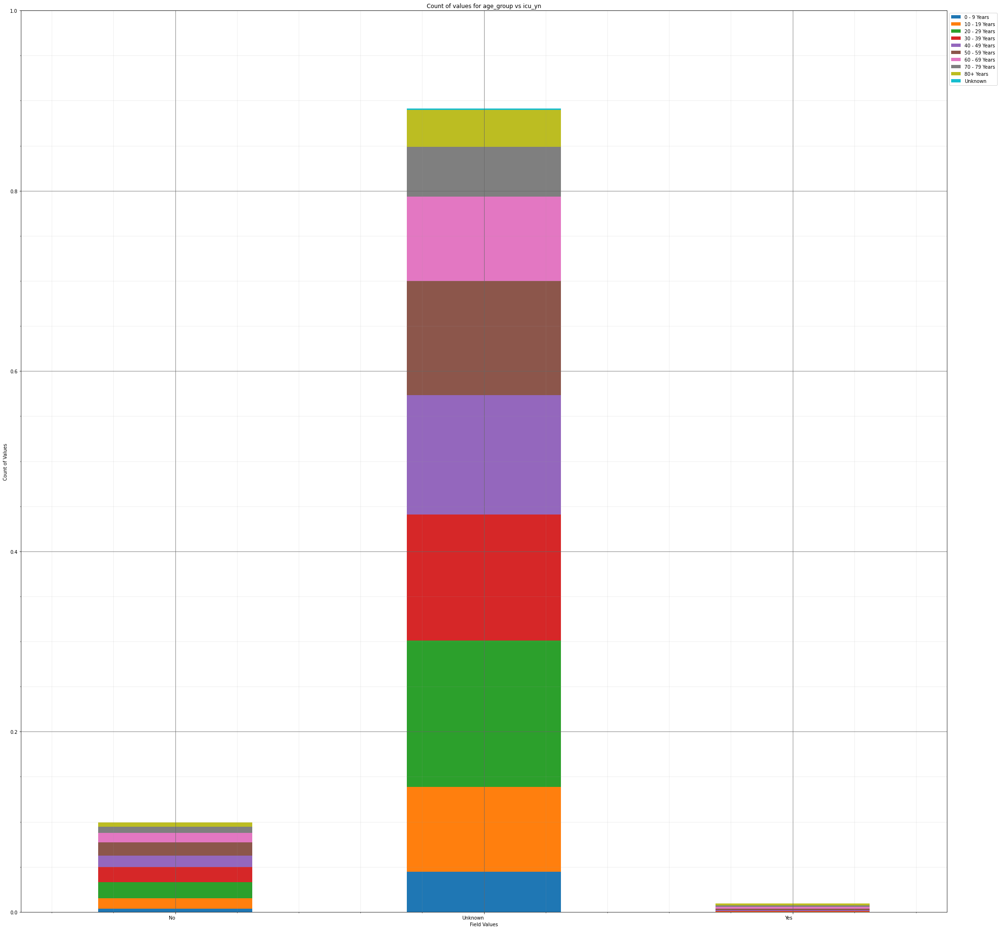



----------------------


Grouping over icu_yn|hosp_yn results in:



,icu_yn,hosp_yn,Rows,% Frequency
0,No,No,790,8.273984
1,No,OTH,0,0.000000
2,No,Unknown,27,0.282782
3,No,Yes,132,1.382488
4,Unknown,No,4366,45.726854
5,Unknown,OTH,0,0.000000
6,Unknown,Unknown,3668,38.416422
7,Unknown,Yes,475,4.974864
8,Yes,No,0,0.000000
9,Yes,OTH,0,0.000000


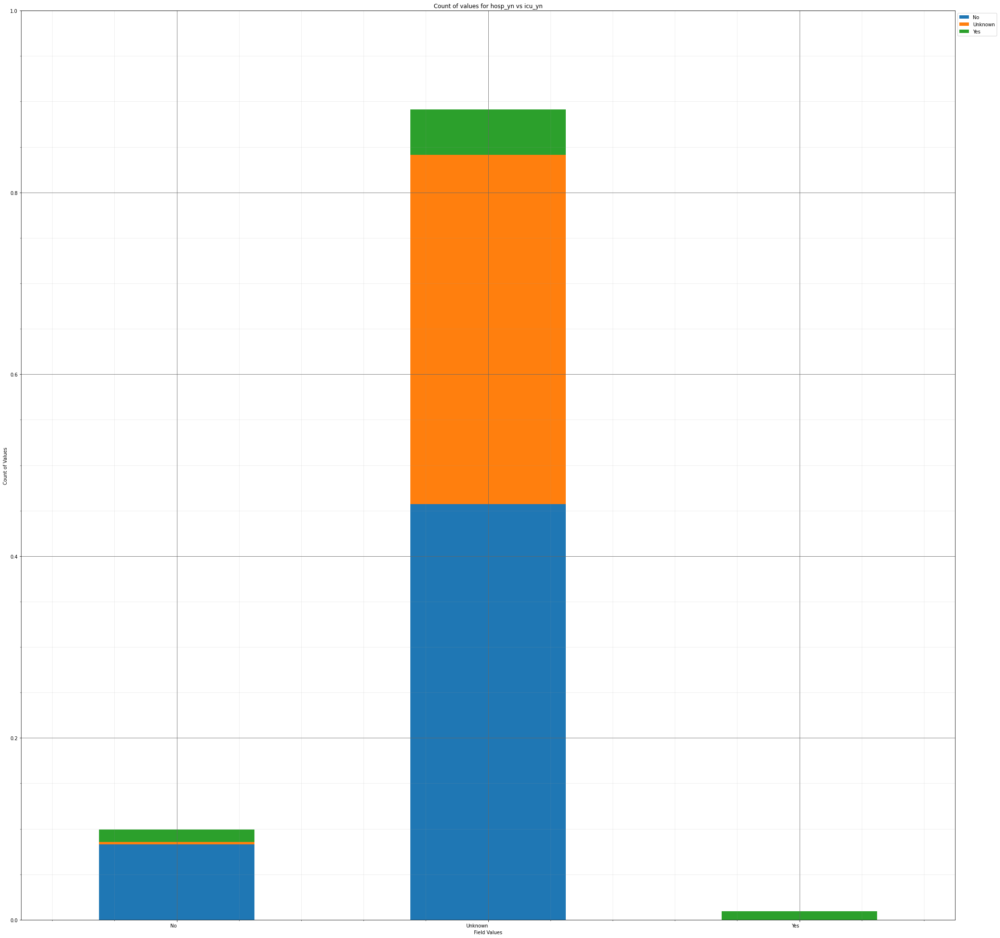



----------------------


Grouping over icu_yn|death_yn results in:



,icu_yn,death_yn,Rows,% Frequency
0,No,No,922,9.656473
1,No,Yes,27,0.282782
2,Unknown,No,8252,86.426477
3,Unknown,Yes,257,2.691663
4,Yes,No,42,0.439883
5,Yes,Yes,48,0.502723


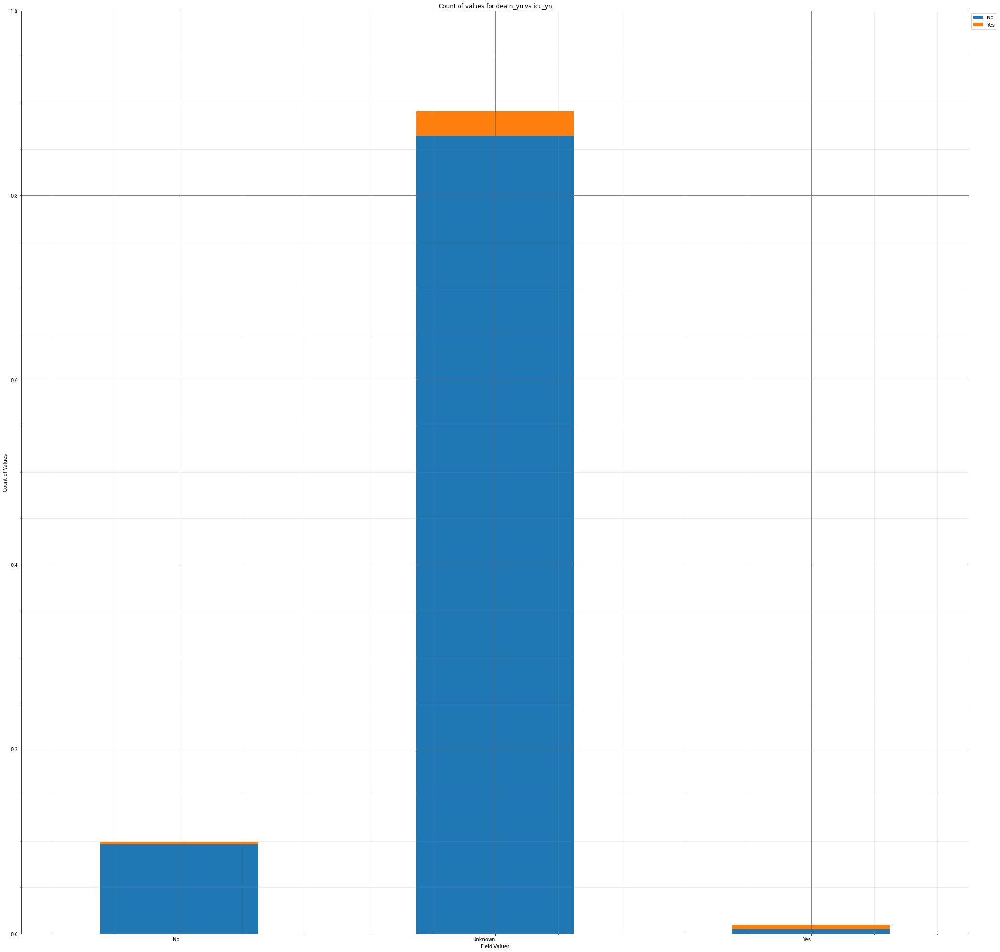



----------------------


Grouping over icu_yn|medcond_yn results in:



,icu_yn,medcond_yn,Rows,% Frequency
0,No,No,398,4.168412
1,No,Unknown,249,2.607876
2,No,Yes,302,3.162966
3,Unknown,No,522,5.467114
4,Unknown,Unknown,7501,78.560955
5,Unknown,Yes,486,5.090071
6,Yes,No,6,0.062840
7,Yes,Unknown,41,0.429409
8,Yes,Yes,43,0.450356


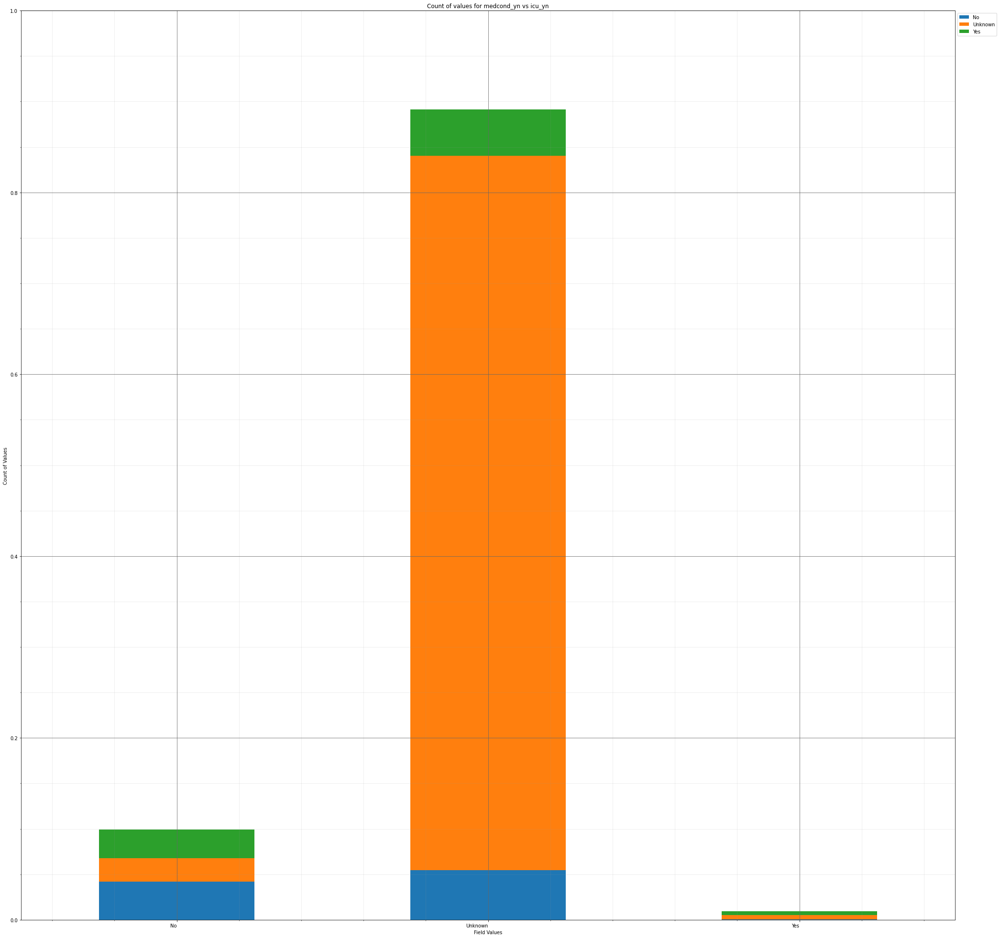



----------------------


Grouping over icu_yn|race results in:



,icu_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,7,0.073314
1,No,Asian,14,0.146628
2,No,Black,68,0.712191
3,No,Hispanic/Latino,159,1.665270
4,No,Multiple/Other,32,0.335149
5,No,Native Hawaiian/Other Pacific Islander,6,0.062840
6,No,Unknown,182,1.906158
7,No,White,481,5.037704
8,Unknown,American Indian/Alaska Native,57,0.596984
9,Unknown,Asian,221,2.314621


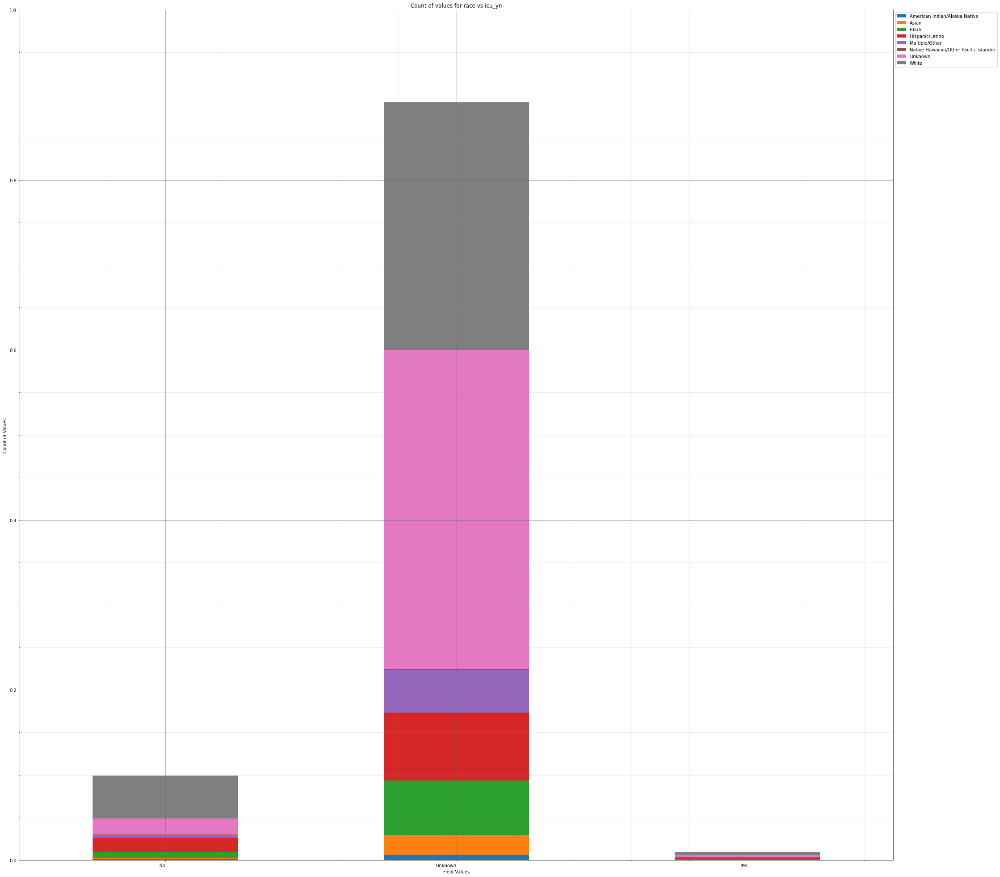



----------------------


Grouping over death_yn|current_status results in:



,death_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,8801,92.176372
1,No,Probable Case,415,4.346460
2,Yes,Laboratory-confirmed case,305,3.194386
3,Yes,Probable Case,27,0.282782


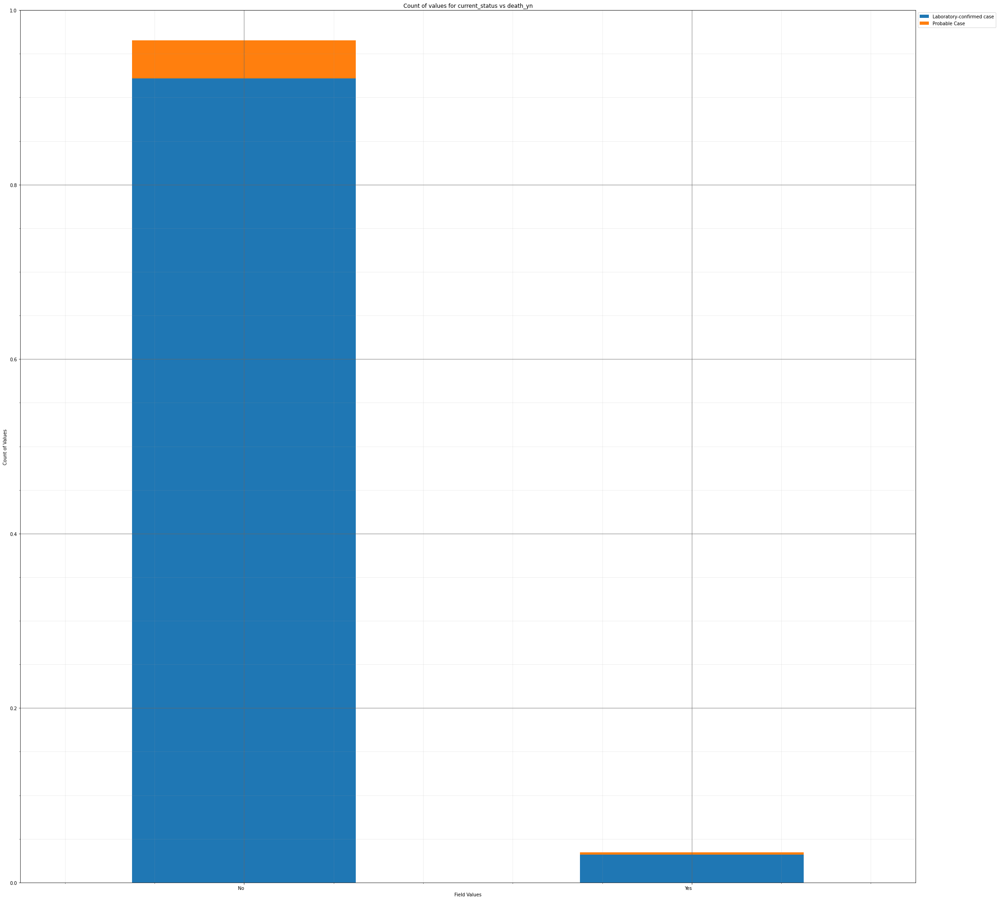



----------------------


Grouping over death_yn|sex results in:



,death_yn,sex,Rows,% Frequency
0,No,Female,4923,51.560536
1,No,Male,4213,44.124424
2,No,Unknown,80,0.837872
3,Yes,Female,166,1.738584
4,Yes,Male,163,1.707164
5,Yes,Unknown,3,0.031420


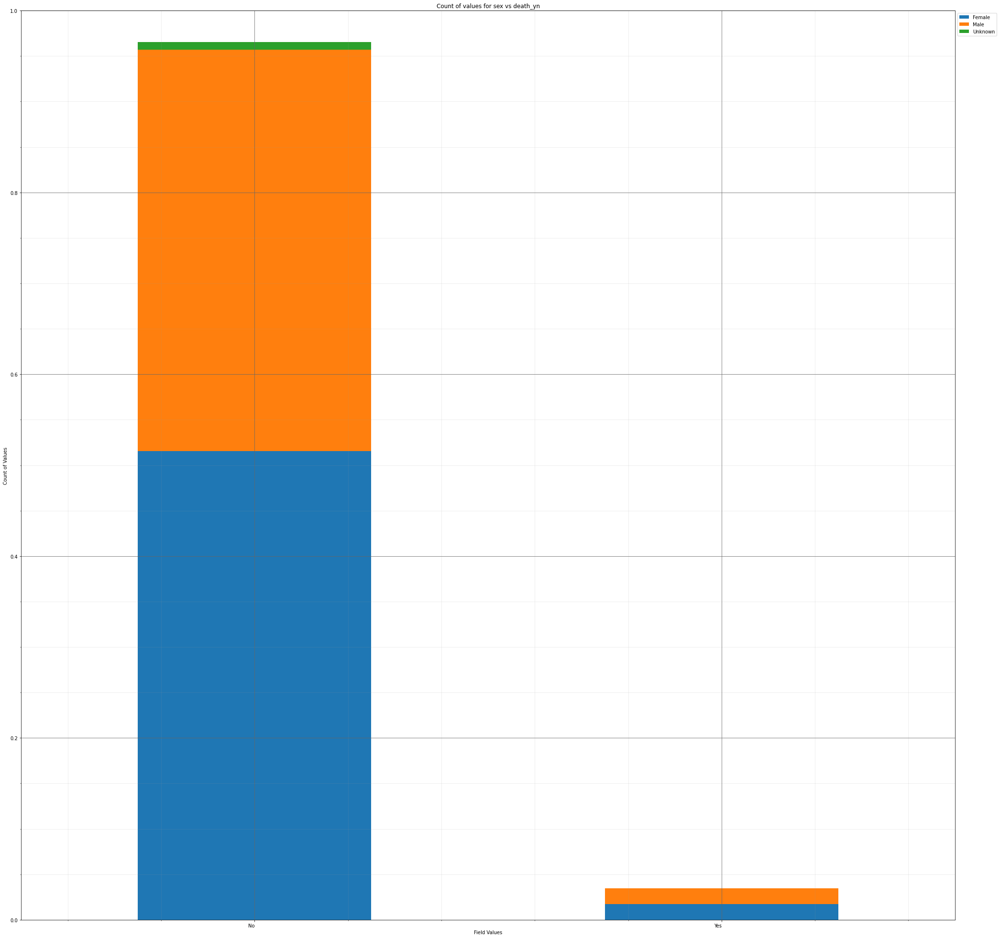



----------------------


Grouping over death_yn|age_group results in:



,death_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,458,4.796816
1,No,10 - 19 Years,1014,10.620025
2,No,20 - 29 Years,1718,17.993297
3,No,30 - 39 Years,1501,15.720570
4,No,40 - 49 Years,1384,14.495182
5,No,50 - 59 Years,1340,14.034353
6,No,60 - 69 Years,954,9.991621
7,No,70 - 79 Years,528,5.529954
8,No,80+ Years,306,3.204860
9,No,Unknown,13,0.136154


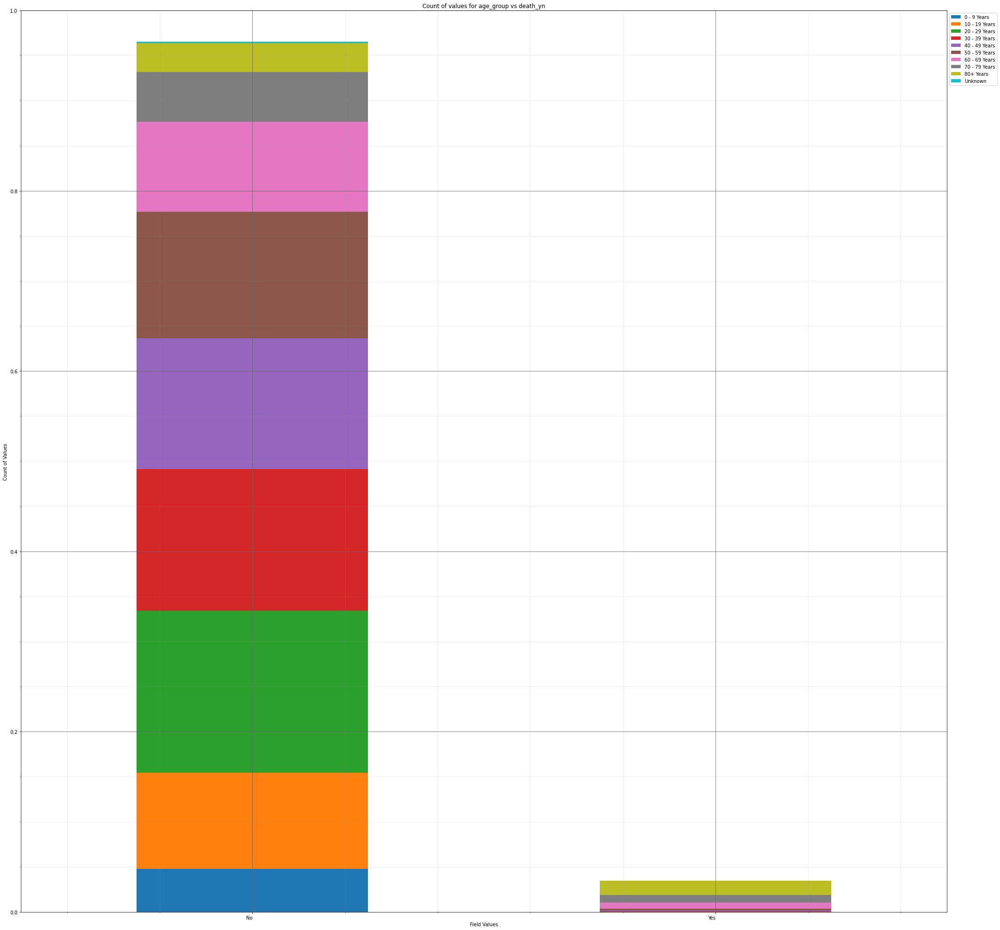



----------------------


Grouping over death_yn|hosp_yn results in:



,death_yn,hosp_yn,Rows,% Frequency
0,No,No,5110,53.519062
1,No,OTH,0,0.000000
2,No,Unknown,3614,37.850859
3,No,Yes,492,5.152912
4,Yes,No,46,0.481776
5,Yes,OTH,0,0.000000
6,Yes,Unknown,81,0.848345
7,Yes,Yes,205,2.147047


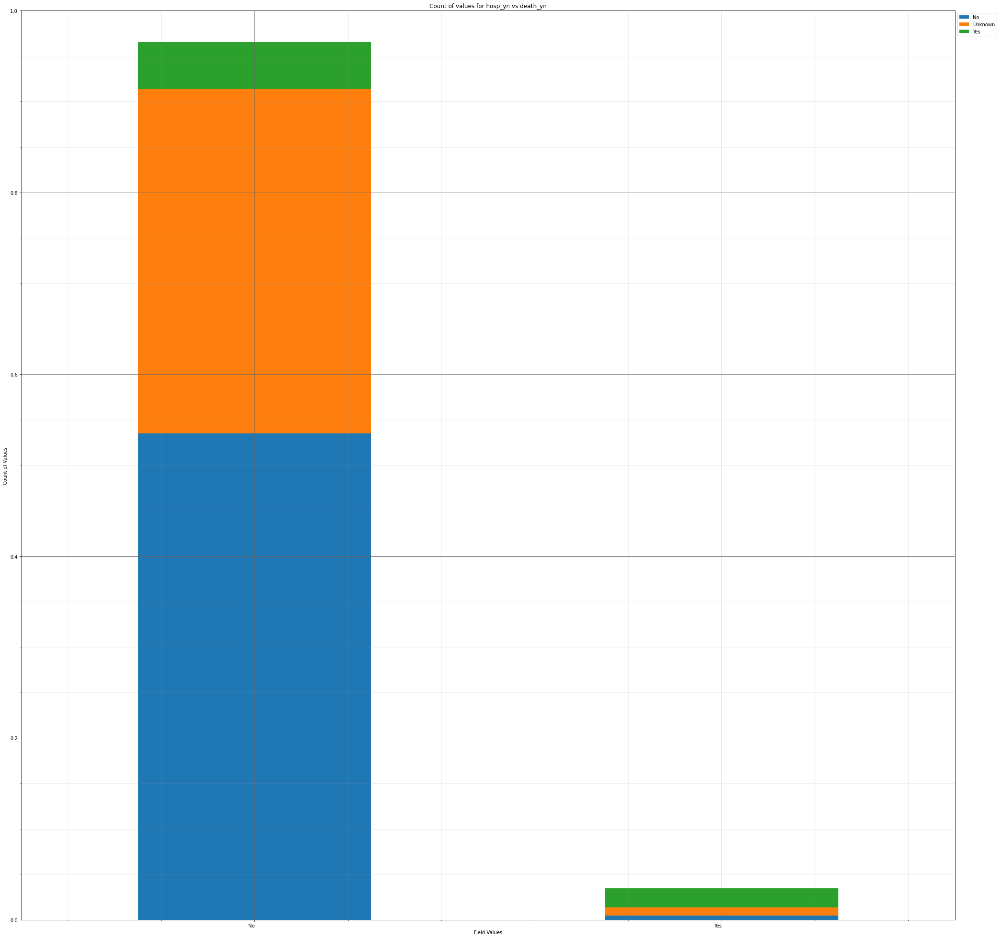



----------------------


Grouping over death_yn|icu_yn results in:



,death_yn,icu_yn,Rows,% Frequency
0,No,No,922,9.656473
1,No,Unknown,8252,86.426477
2,No,Yes,42,0.439883
3,Yes,No,27,0.282782
4,Yes,Unknown,257,2.691663
5,Yes,Yes,48,0.502723


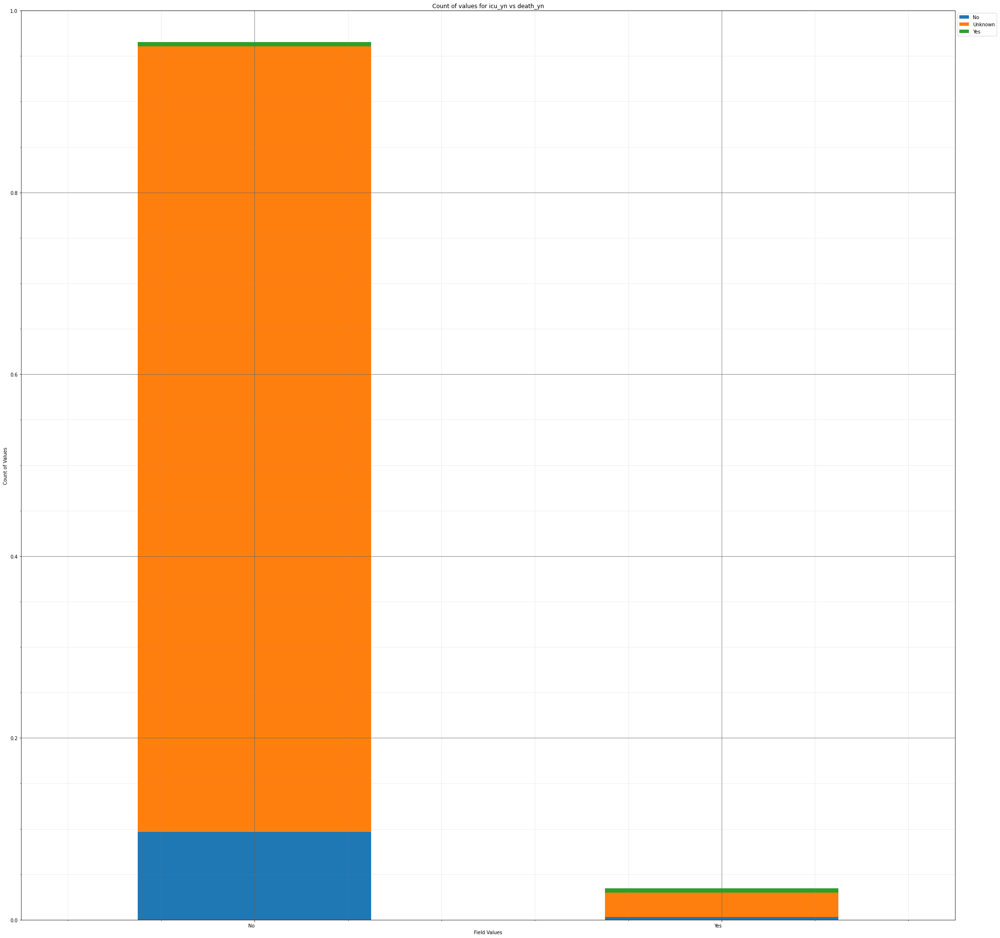



----------------------


Grouping over death_yn|medcond_yn results in:



,death_yn,medcond_yn,Rows,% Frequency
0,No,No,918,9.614579
1,No,Unknown,7560,79.178886
2,No,Yes,738,7.729367
3,Yes,No,8,0.083787
4,Yes,Unknown,231,2.419355
5,Yes,Yes,93,0.974026


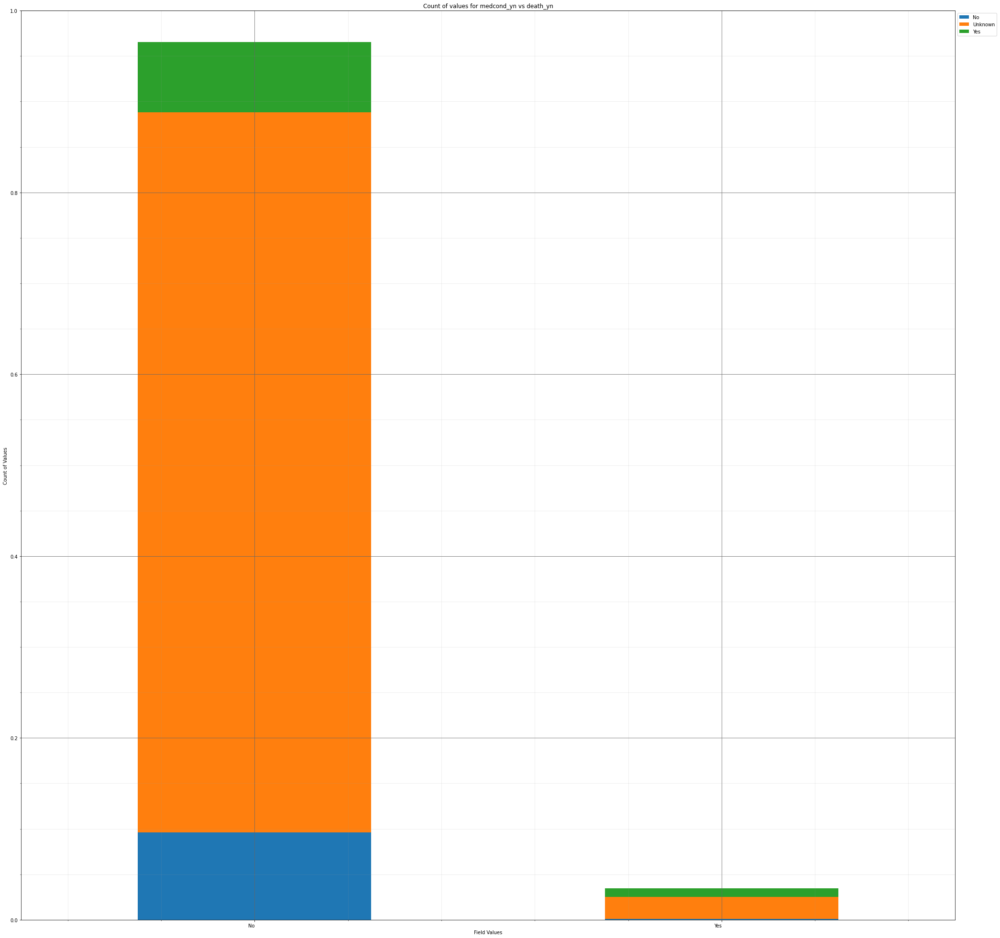



----------------------


Grouping over death_yn|race results in:



,death_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,60,0.628404
1,No,Asian,229,2.398408
2,No,Black,655,6.860075
3,No,Hispanic/Latino,900,9.426058
4,No,Multiple/Other,499,5.226225
5,No,Native Hawaiian/Other Pacific Islander,23,0.240888
6,No,Unknown,3721,38.971512
7,No,White,3129,32.771261
8,Yes,American Indian/Alaska Native,6,0.062840
9,Yes,Asian,10,0.104734


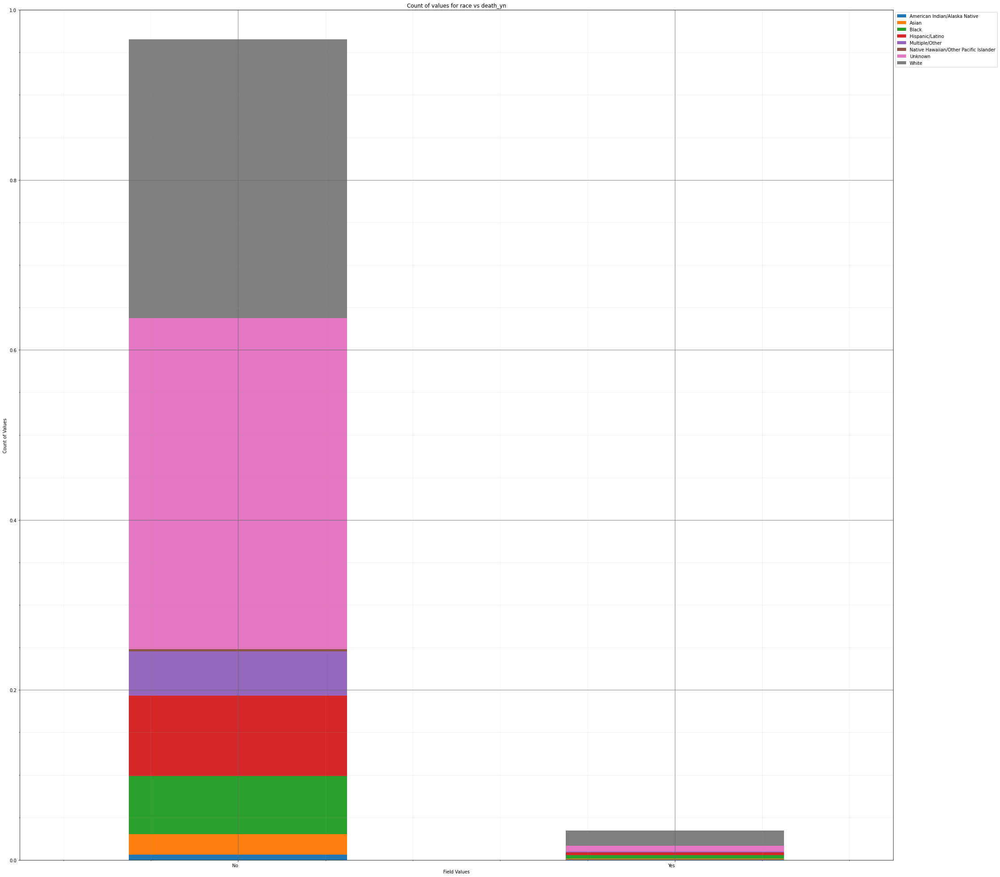



----------------------


Grouping over medcond_yn|current_status results in:



,medcond_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,888,9.300377
1,No,Probable Case,38,0.397989
2,Unknown,Laboratory-confirmed case,7407,77.576456
3,Unknown,Probable Case,384,4.021785
4,Yes,Laboratory-confirmed case,811,8.493925
5,Yes,Probable Case,20,0.209468


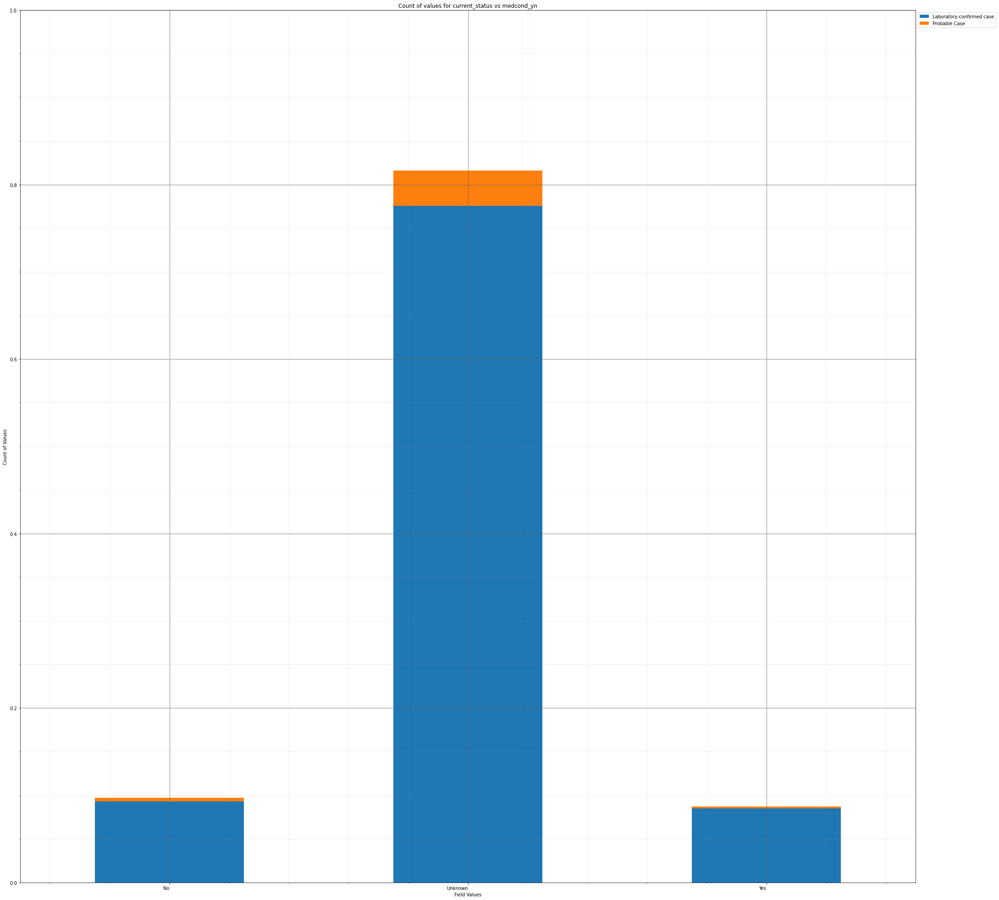



----------------------


Grouping over medcond_yn|sex results in:



,medcond_yn,sex,Rows,% Frequency
0,No,Female,507,5.310013
1,No,Male,412,4.315040
2,No,Unknown,7,0.073314
3,Unknown,Female,4125,43.202765
4,Unknown,Male,3593,37.630917
5,Unknown,Unknown,73,0.764558
6,Yes,Female,457,4.786343
7,Yes,Male,371,3.885630
8,Yes,Unknown,3,0.031420


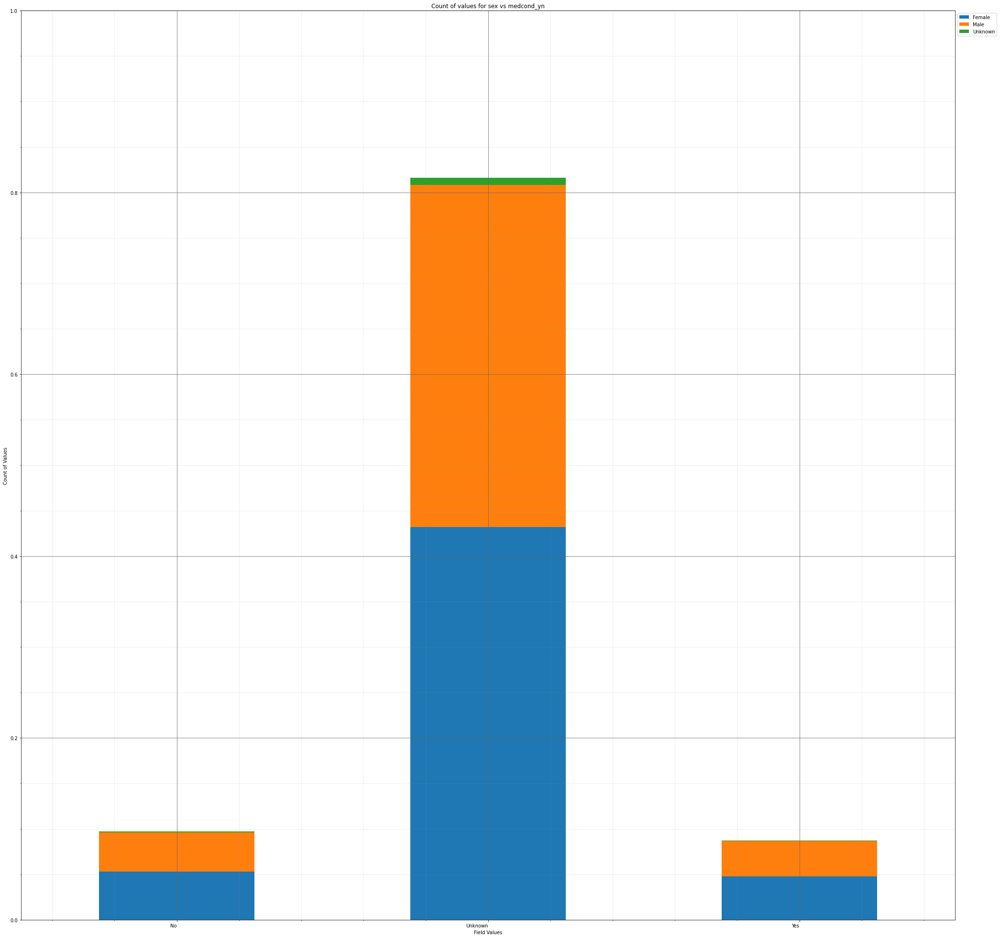



----------------------


Grouping over medcond_yn|age_group results in:



,medcond_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,52,0.544617
1,No,10 - 19 Years,142,1.487222
2,No,20 - 29 Years,221,2.314621
3,No,30 - 39 Years,172,1.801424
4,No,40 - 49 Years,118,1.235861
5,No,50 - 59 Years,113,1.183494
6,No,60 - 69 Years,68,0.712191
7,No,70 - 79 Years,28,0.293255
8,No,80+ Years,12,0.125681
9,No,Unknown,0,0.000000


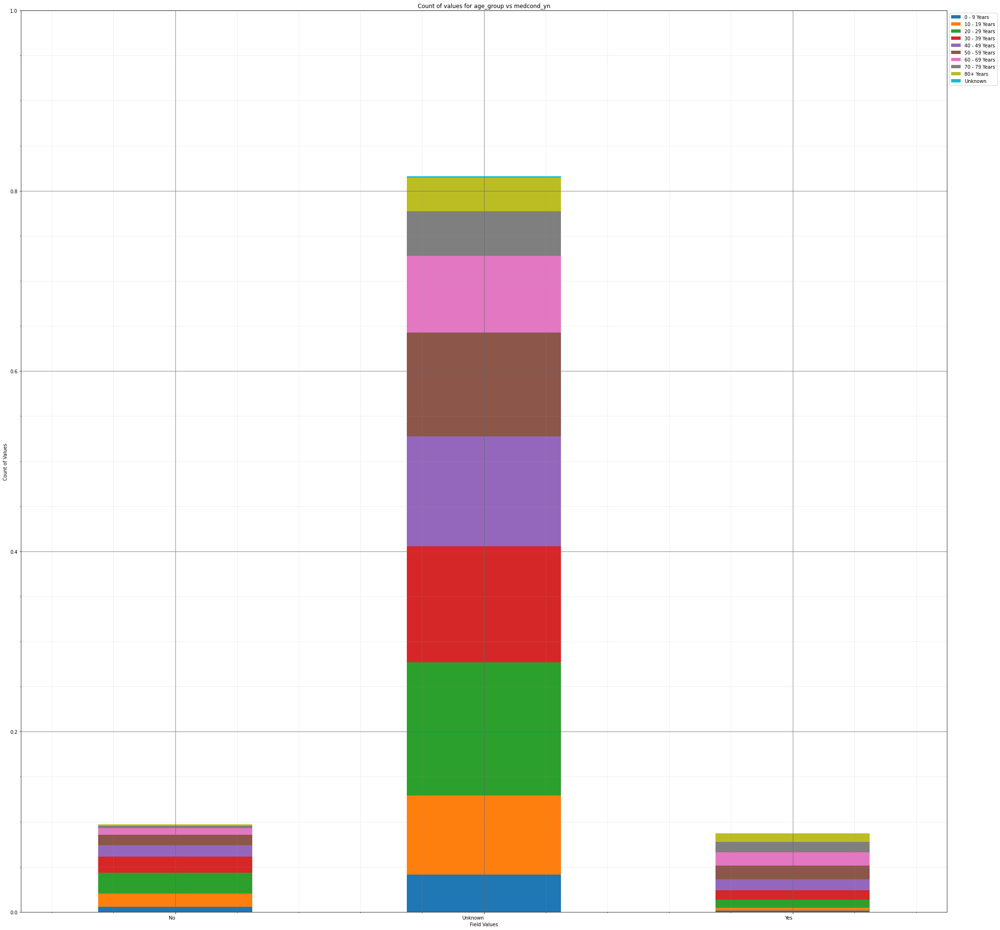



----------------------


Grouping over medcond_yn|hosp_yn results in:



,medcond_yn,hosp_yn,Rows,% Frequency
0,No,No,691,7.237118
1,No,OTH,0,0.000000
2,No,Unknown,202,2.115626
3,No,Yes,33,0.345622
4,Unknown,No,3914,40.992878
5,Unknown,OTH,0,0.000000
6,Unknown,Unknown,3390,35.504818
7,Unknown,Yes,487,5.100545
8,Yes,No,551,5.770842
9,Yes,OTH,0,0.000000


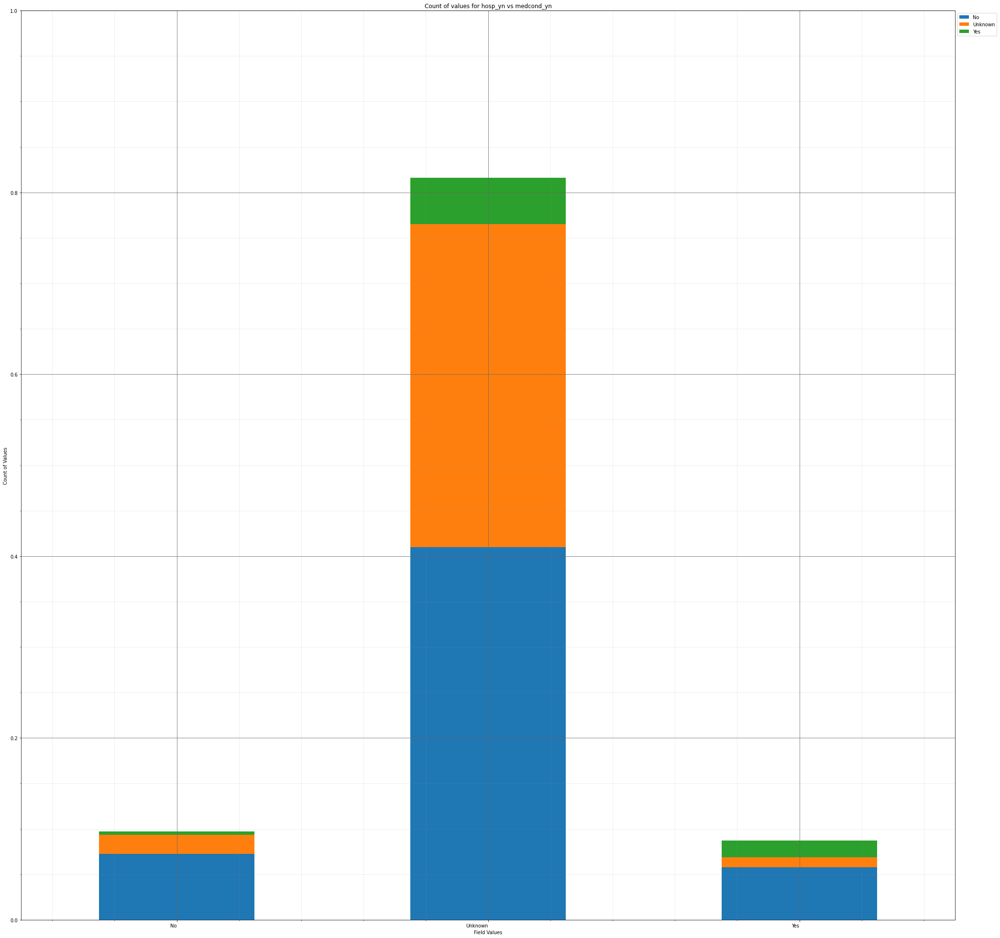



----------------------


Grouping over medcond_yn|icu_yn results in:



,medcond_yn,icu_yn,Rows,% Frequency
0,No,No,398,4.168412
1,No,Unknown,522,5.467114
2,No,Yes,6,0.062840
3,Unknown,No,249,2.607876
4,Unknown,Unknown,7501,78.560955
5,Unknown,Yes,41,0.429409
6,Yes,No,302,3.162966
7,Yes,Unknown,486,5.090071
8,Yes,Yes,43,0.450356


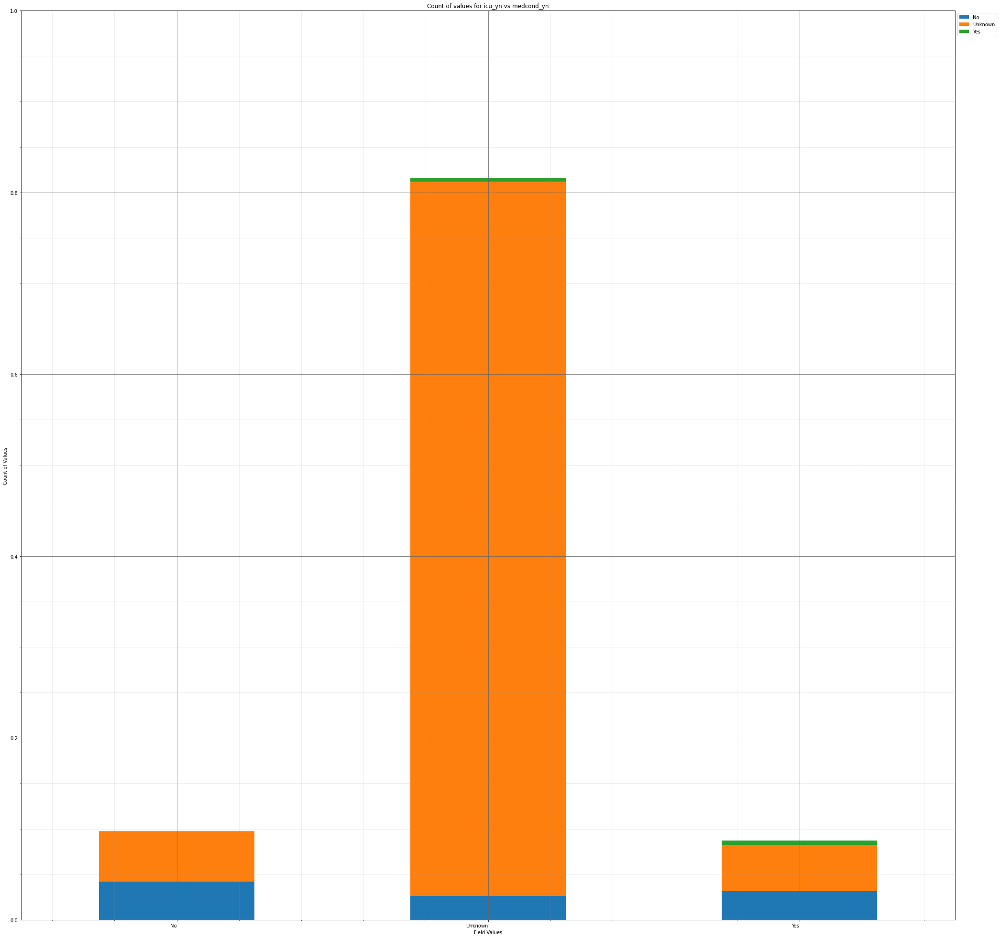



----------------------


Grouping over medcond_yn|death_yn results in:



,medcond_yn,death_yn,Rows,% Frequency
0,No,No,918,9.614579
1,No,Yes,8,0.083787
2,Unknown,No,7560,79.178886
3,Unknown,Yes,231,2.419355
4,Yes,No,738,7.729367
5,Yes,Yes,93,0.974026


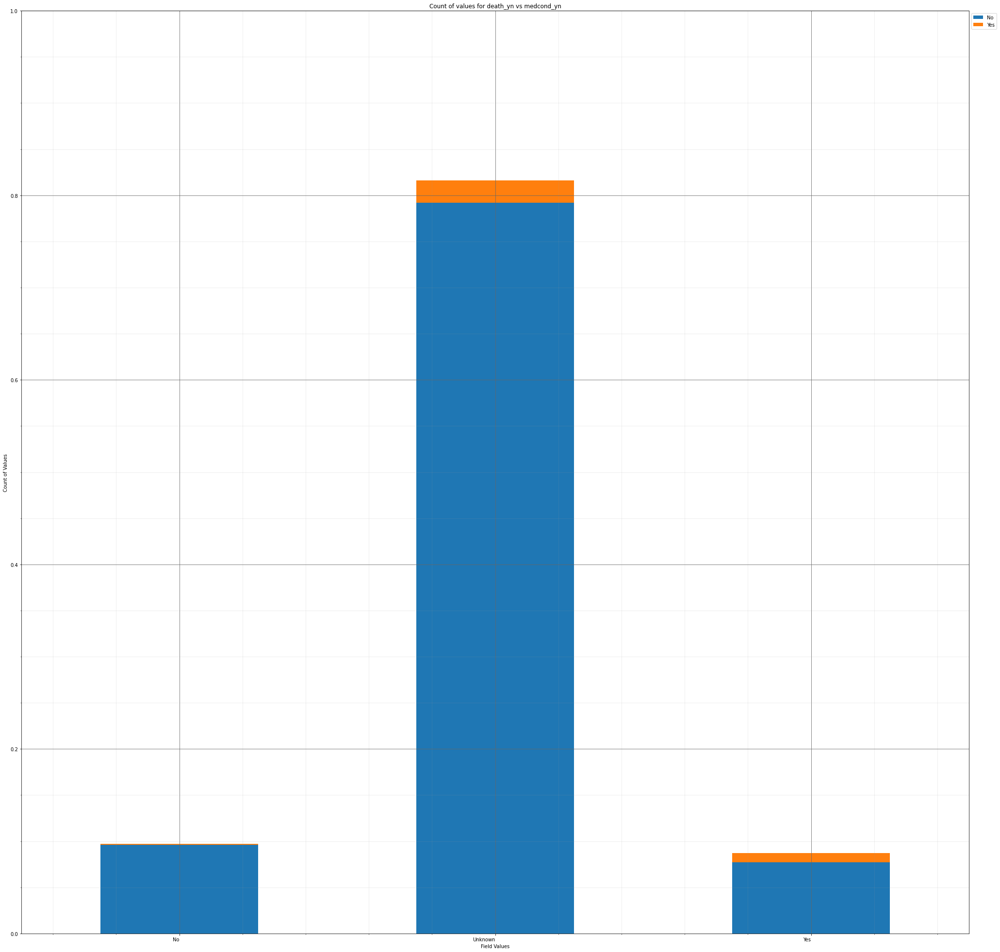



----------------------


Grouping over medcond_yn|race results in:



,medcond_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,4,0.041894
1,No,Asian,17,0.178048
2,No,Black,69,0.722664
3,No,Hispanic/Latino,155,1.623377
4,No,Multiple/Other,32,0.335149
5,No,Native Hawaiian/Other Pacific Islander,2,0.020947
6,No,Unknown,162,1.696690
7,No,White,485,5.079598
8,Unknown,American Indian/Alaska Native,55,0.576037
9,Unknown,Asian,204,2.136573


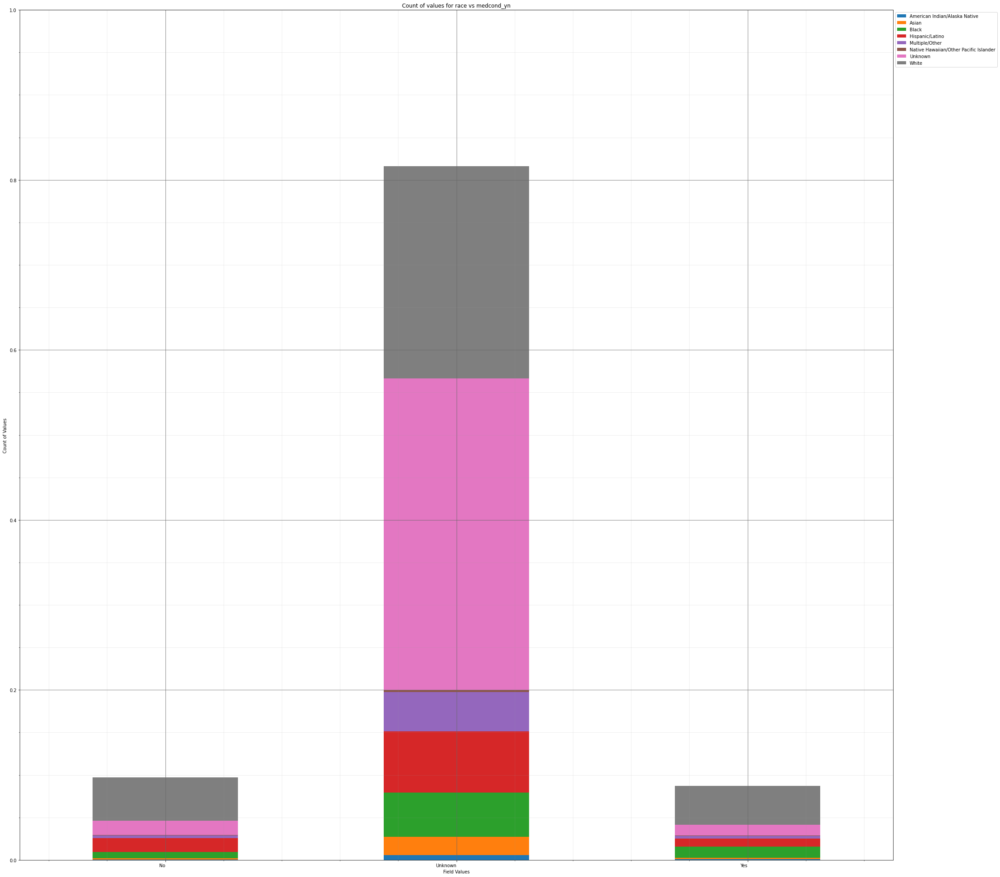



----------------------


Grouping over race|current_status results in:



,race,current_status,Rows,% Frequency
0,American Indian/Alaska Native,Laboratory-confirmed case,62,0.649351
1,American Indian/Alaska Native,Probable Case,4,0.041894
2,Asian,Laboratory-confirmed case,231,2.419355
3,Asian,Probable Case,8,0.083787
4,Black,Laboratory-confirmed case,669,7.006703
5,Black,Probable Case,24,0.251362
6,Hispanic/Latino,Laboratory-confirmed case,901,9.436531
7,Hispanic/Latino,Probable Case,27,0.282782
8,Multiple/Other,Laboratory-confirmed case,478,5.006284
9,Multiple/Other,Probable Case,32,0.335149


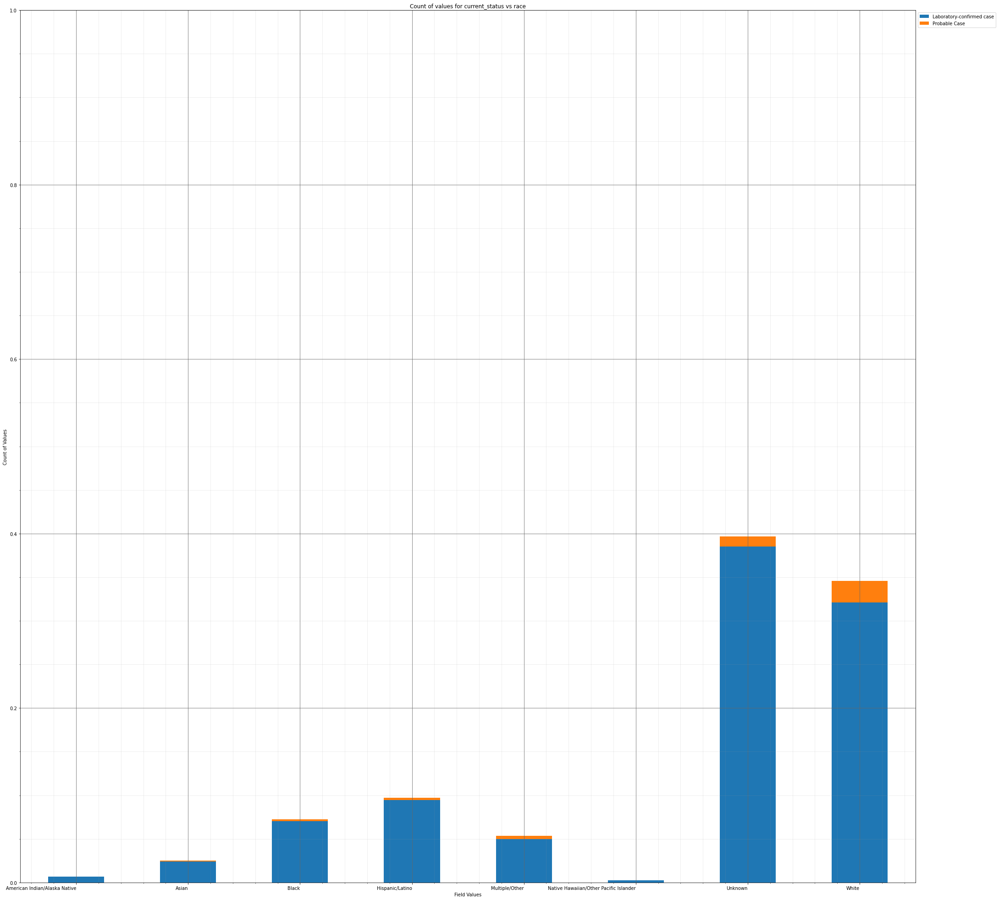



----------------------


Grouping over race|sex results in:



,race,sex,Rows,% Frequency
0,American Indian/Alaska Native,Female,34,0.356096
1,American Indian/Alaska Native,Male,32,0.335149
2,American Indian/Alaska Native,Unknown,0,0.000000
3,Asian,Female,122,1.277755
4,Asian,Male,114,1.193967
5,Asian,Unknown,3,0.031420
6,Black,Female,410,4.294093
7,Black,Male,281,2.943025
8,Black,Unknown,2,0.020947
9,Hispanic/Latino,Female,510,5.341433


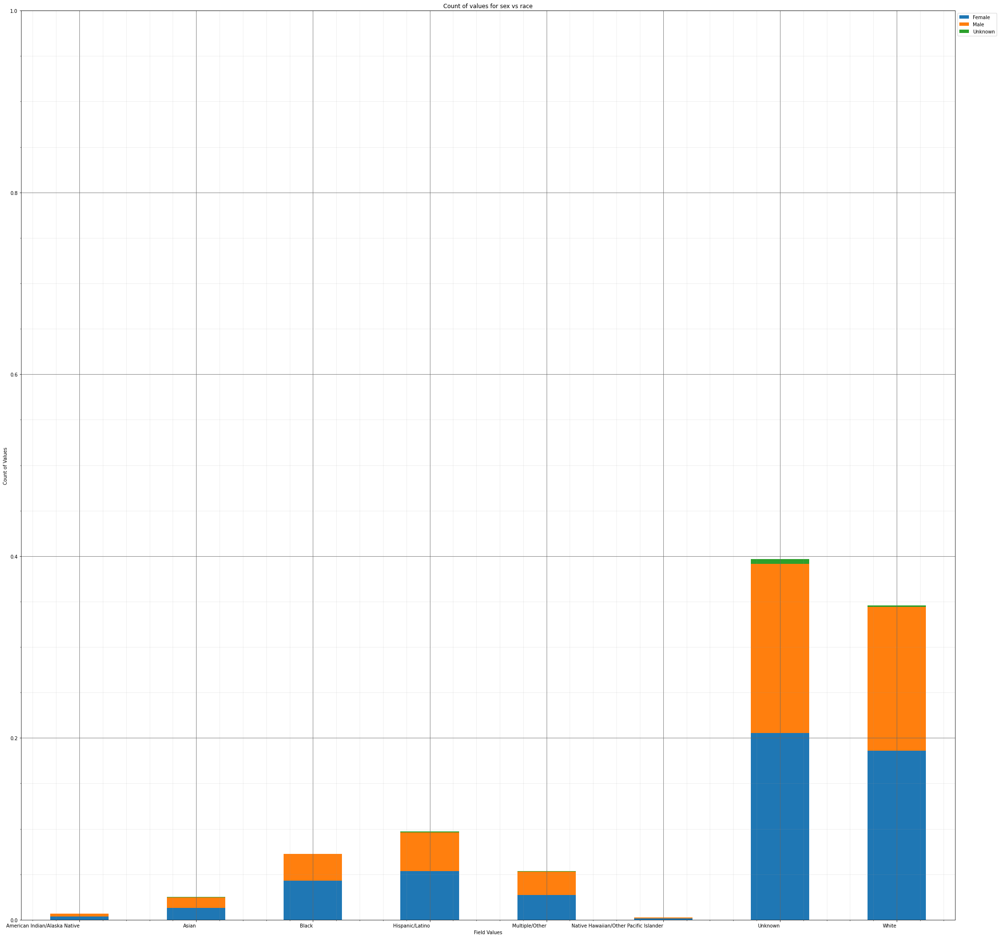



----------------------


Grouping over race|age_group results in:



,race,age_group,Rows,% Frequency
0,American Indian/Alaska Native,0 - 9 Years,4,0.041894
1,American Indian/Alaska Native,10 - 19 Years,8,0.083787
2,American Indian/Alaska Native,20 - 29 Years,12,0.125681
3,American Indian/Alaska Native,30 - 39 Years,8,0.083787
4,American Indian/Alaska Native,40 - 49 Years,12,0.125681
...,...,...,...,...
75,White,50 - 59 Years,520,5.446167
76,White,60 - 69 Years,437,4.576875
77,White,70 - 79 Years,299,3.131546
78,White,80+ Years,236,2.471722


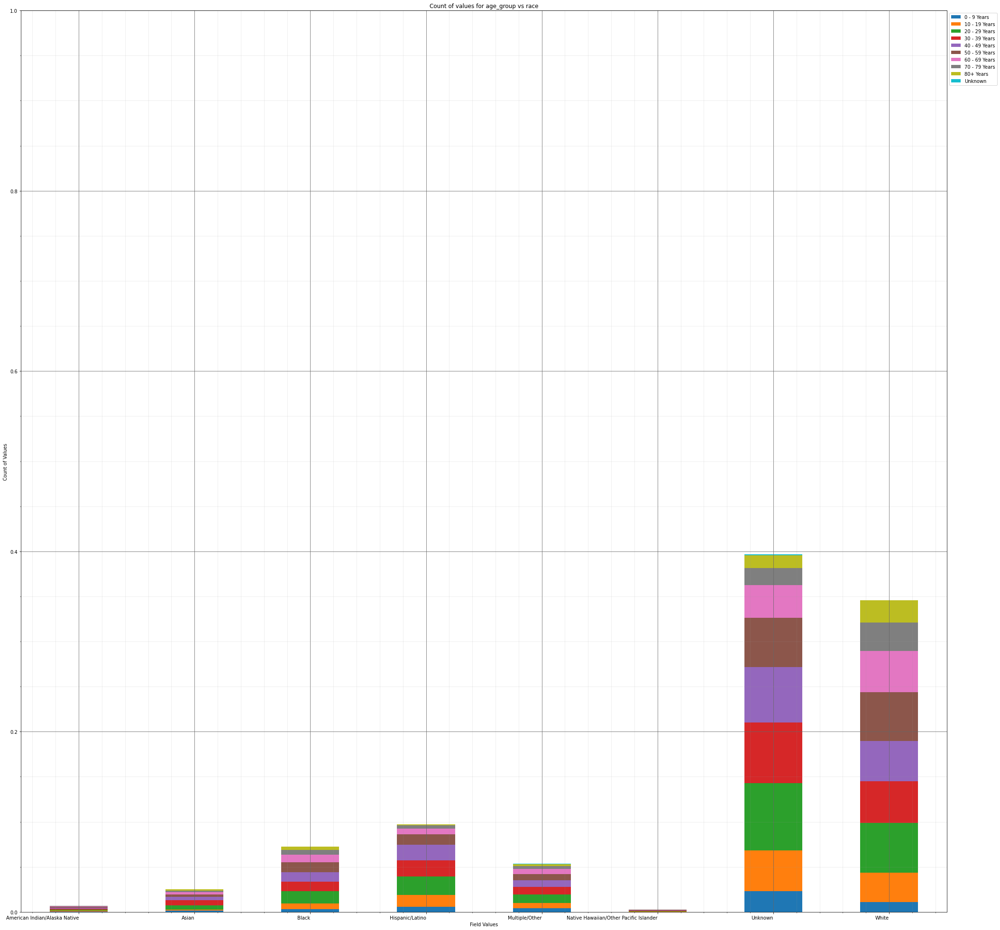



----------------------


Grouping over race|hosp_yn results in:



,race,hosp_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,39,0.408463
1,American Indian/Alaska Native,OTH,0,0.000000
2,American Indian/Alaska Native,Unknown,14,0.146628
3,American Indian/Alaska Native,Yes,13,0.136154
4,Asian,No,113,1.183494
5,Asian,OTH,0,0.000000
6,Asian,Unknown,103,1.078760
7,Asian,Yes,23,0.240888
8,Black,No,438,4.587348
9,Black,OTH,0,0.000000


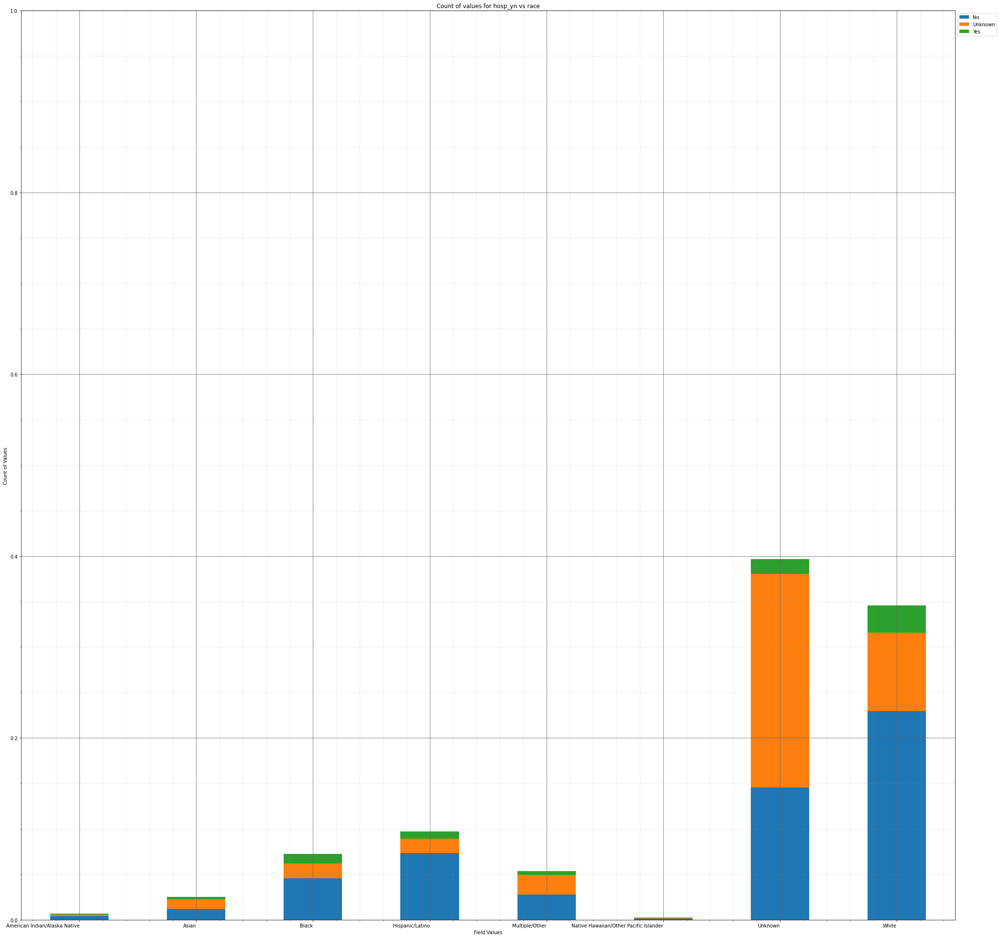



----------------------


Grouping over race|icu_yn results in:



,race,icu_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,7,0.073314
1,American Indian/Alaska Native,Unknown,57,0.596984
2,American Indian/Alaska Native,Yes,2,0.020947
3,Asian,No,14,0.146628
4,Asian,Unknown,221,2.314621
5,Asian,Yes,4,0.041894
6,Black,No,68,0.712191
7,Black,Unknown,616,6.451613
8,Black,Yes,9,0.094261
9,Hispanic/Latino,No,159,1.665270


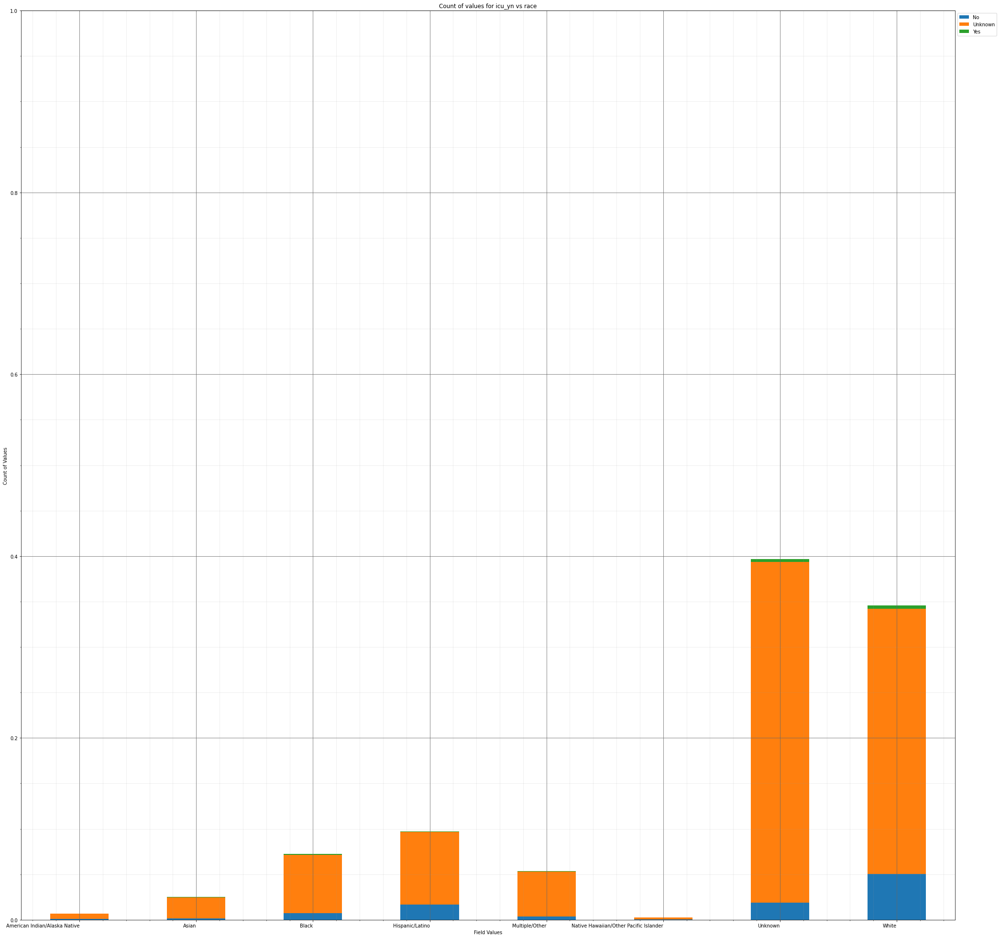



----------------------


Grouping over race|death_yn results in:



,race,death_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,60,0.628404
1,American Indian/Alaska Native,Yes,6,0.062840
2,Asian,No,229,2.398408
3,Asian,Yes,10,0.104734
4,Black,No,655,6.860075
5,Black,Yes,38,0.397989
6,Hispanic/Latino,No,900,9.426058
7,Hispanic/Latino,Yes,28,0.293255
8,Multiple/Other,No,499,5.226225
9,Multiple/Other,Yes,11,0.115207


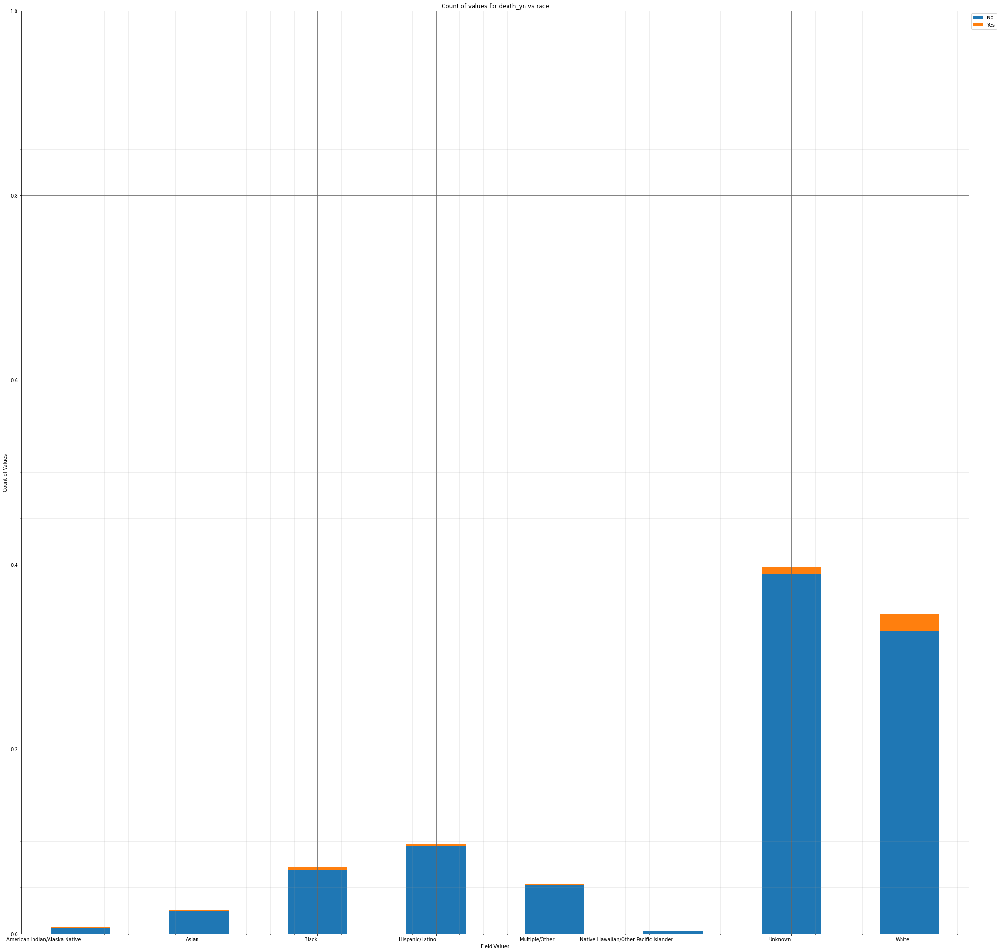



----------------------


Grouping over race|medcond_yn results in:



,race,medcond_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,4,0.041894
1,American Indian/Alaska Native,Unknown,55,0.576037
2,American Indian/Alaska Native,Yes,7,0.073314
3,Asian,No,17,0.178048
4,Asian,Unknown,204,2.136573
5,Asian,Yes,18,0.188521
6,Black,No,69,0.722664
7,Black,Unknown,500,5.236699
8,Black,Yes,124,1.298701
9,Hispanic/Latino,No,155,1.623377


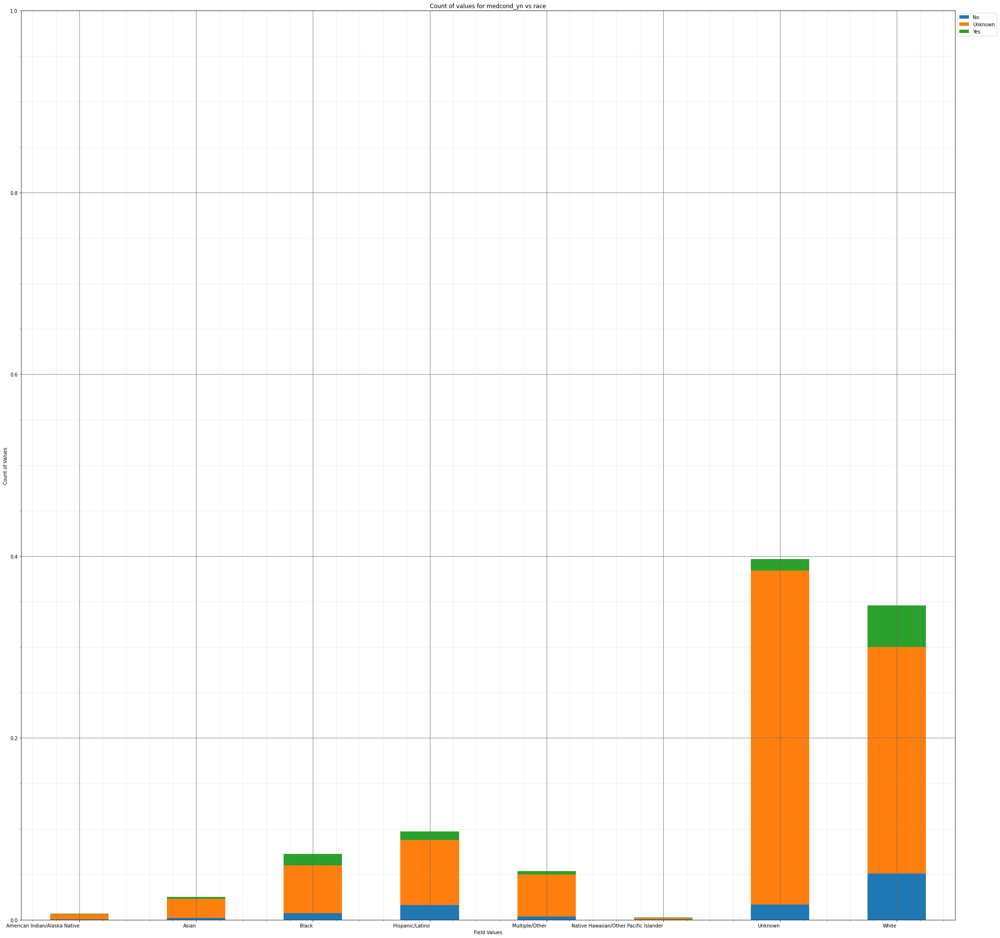

In [72]:
dd_multi_clnd_freq_dict=group_over_multi_categories(deduped_covid_sample_df,categorical_columns,save_fig=True,pdf_fn=multi_categorical_barplot_dedupe_cleanseF_fn)

## 2.10 Plot the Earliest Case Date

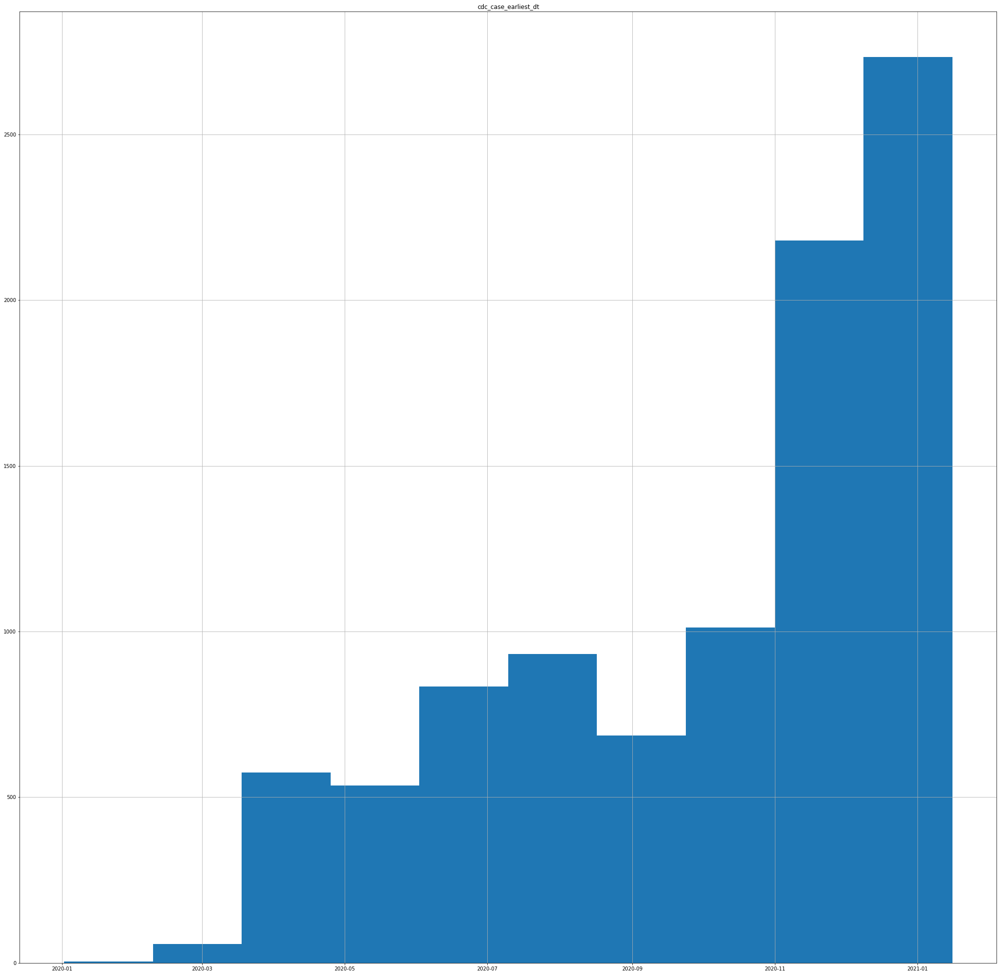

In [73]:
figure=(deduped_covid_sample_df[deduped_covid_sample_df.select_dtypes('datetime').columns]
     .hist(figsize=(35,35)))
plt.savefig('cdc_earliest_case_date.png')

In [74]:
deduped_covid_sample_df.select_dtypes('datetime').columns

Index(['cdc_case_earliest_dt'], dtype='object')

In [75]:
def cat_missing_check_cleanse(row):
    """Highlight rows with potential missing_values"""

    #Configuration Values
    col_to_check=8
    default_colour = 'green'
    flag_colour=''
    high_flag_colour_val='red'
    med_flag_colour_val='orange'
    low_flag_colour_val='yellow'
    val_to_check=0

    #Row length valid
    if len(row)>=col_to_check:

        #
        if row.values[col_to_check] == 'High':
            flag_colour = high_flag_colour_val
            
        elif row.values[col_to_check] == 'Medium':
            flag_colour = med_flag_colour_val
            
        elif row.values[col_to_check] == 'Low':
            flag_colour = low_flag_colour_val

        if flag_colour=='':
            colour=default_colour
        else:
            colour=flag_colour

        return ['background-color: {}'.format(colour)]*len(row.values)

    else:
        print('Row too short - Reconfigure Column Number')
        return ['background-color: {}'.format(default_colour)]*len(row.values)

## 2.11 Rerun Describe

In [76]:
#Format Dictionary:
non_numeric_format_dictionary={
                              '% Populated': "{:.0f}%"
                              ,'% Missing': "{:.0f}%"
                                ,'% Top Value':"{:.0f}%"}





#Produce a summary table - Note the continuous features in this dataset are dates
#Note: As of now, pandas allows using describe with dates so keeping it in, but this will be depreciated
category_summary_df=deduped_covid_sample_df[categorical_columns].describe().T

#Add what Percent is populated
category_summary_df['% Populated']=100*(category_summary_df['count']/deduped_covid_sample_df.shape[0])

#Percent missing
category_summary_df['% Missing']=100-category_summary_df['% Populated']

#Prevelance of top vlaue
category_summary_df['% Top Value']=100*(category_summary_df['freq']/deduped_covid_sample_df.shape[0])

#Give a warning depending on quartile of missing data - upper quartiles are high
category_summary_df['Missing Warning']=np.select([(category_summary_df['% Missing']==0),(category_summary_df['% Missing']>0) & (category_summary_df['% Missing']<25),(category_summary_df['% Missing']>=25) & (category_summary_df['% Missing']<50),category_summary_df['% Missing']>=50],['None','Low','Medium','High'])

category_summary_df=category_summary_df.reset_index()
category_summary_df=category_summary_df.rename(columns={"index": "feature"})


(category_summary_df.style.apply(cat_missing_check_cleanse, axis=1)
                                         .format(non_numeric_format_dictionary))

,feature,count,unique,top,freq,% Populated,% Missing,% Top Value,Missing Warning
0,current_status,9548,2,Laboratory-confirmed case,9106,100%,0%,95%,None
1,sex,9548,3,Female,5089,100%,0%,53%,None
2,age_group,9548,10,20 - 29 Years,1718,100%,0%,18%,None
3,hosp_yn,9548,3,No,5156,100%,0%,54%,None
4,icu_yn,9548,3,Unknown,8509,100%,0%,89%,None
5,death_yn,9548,2,No,9216,100%,0%,97%,None
6,medcond_yn,9548,3,Unknown,7791,100%,0%,82%,None
7,race,9548,8,Unknown,3787,100%,0%,40%,None


In [77]:
#Check the unique values
for column in categorical_columns:
    print('For {} the unique values are: {}\n'.format(column,deduped_covid_sample_df[column].unique()))

For current_status the unique values are: ['Laboratory-confirmed case', 'Probable Case']
Categories (2, object): ['Laboratory-confirmed case', 'Probable Case']

For sex the unique values are: ['Female', 'Male', 'Unknown']
Categories (3, object): ['Female', 'Male', 'Unknown']

For age_group the unique values are: ['50 - 59 Years', '10 - 19 Years', '60 - 69 Years', '40 - 49 Years', '30 - 39 Years', '80+ Years', '20 - 29 Years', '0 - 9 Years', '70 - 79 Years', 'Unknown']
Categories (10, object): ['50 - 59 Years', '10 - 19 Years', '60 - 69 Years', '40 - 49 Years', ..., '20 - 29 Years', '0 - 9 Years', '70 - 79 Years', 'Unknown']

For hosp_yn the unique values are: ['Unknown', 'No', 'Yes']
Categories (3, object): ['Unknown', 'No', 'Yes']

For icu_yn the unique values are: ['Unknown', 'No', 'Yes']
Categories (3, object): ['Unknown', 'No', 'Yes']

For death_yn the unique values are: ['No', 'Yes']
Categories (2, object): ['No', 'Yes']

For medcond_yn the unique values are: ['Unknown', 'No', 'Ye

## 2.12 Save the Cleansed Dataset

In [78]:
deduped_covid_sample_df.to_csv(cleansed_filepath, index_label=False)

try:
    deduped_covid_sample_df.to_pickle(cleansed_filepath[:-3]+'pickle')
except:
    print('You need to install the pickle module appropriately.')

In [79]:
categorical_columns=deduped_covid_sample_df.select_dtypes('category').columns
datetime_columns=deduped_covid_sample_df.select_dtypes('datetime').columns
numeric_columns=deduped_covid_sample_df.select_dtypes('float64').columns

display(categorical_columns)
display(datetime_columns)
display(numeric_columns)

Index(['current_status', 'sex', 'age_group', 'hosp_yn', 'icu_yn', 'death_yn',
       'medcond_yn', 'race'],
      dtype='object')

Index(['cdc_case_earliest_dt'], dtype='object')

Index(['days_until_onset'], dtype='object')

# 3.0 and 4.0 Extension and Pairing Of Features

## 3.1 read in adf

In [80]:
categorical_columns=['current_status', 'sex', 'age_group', 'hosp_yn', 'icu_yn', 'death_yn',
       'medcond_yn', 'race']
datetime_columns=['cdc_case_earliest_dt']
numeric_columns=['days_until_onset']

#Read Pickle
try:
    adf=pd.read_pickle(cleansed_filepath[:-3]+'pickle')

#You don't have pickle available 
except:
    adf=pd.read_csv(cleansed_filepath,dtype=str)
    data_convert(adf,'datetime',datetime_columns,datetime_format)
    data_convert(adf,'category',categorical_columns,datetime_format)
    data_convert(adf,'numeric',numeric_columns,datetime_format)

## 3.2 Extend ADF with day, month, year of diagnosis

In [81]:
#These are categories as they're serving as bins. May be relevant for viewing by month and by day and by year as we are broaching two years. Year is less useful as skewed to 2020
adf['cdc_case_earliest_day']=(adf['cdc_case_earliest_dt'].dt.day).astype('category')
adf['cdc_case_earliest_weekday']=(adf['cdc_case_earliest_dt'].dt.weekday).astype('category')
adf['cdc_case_earliest_month']=(adf['cdc_case_earliest_dt'].dt.month).astype('category')
adf['cdc_case_earliest_year']=(adf['cdc_case_earliest_dt'].dt.year).astype('category')

#Some demographic info is missing
adf.loc[(adf['sex']=='Unknown')|(adf['age_group']=='Unknown')|(adf['race']=='Unknown'),'demographic_missing']='True'
adf.loc[(adf['demographic_missing']!='True'),'demographic_missing']='False'

#Some demographic info is missing - Death is never missing
adf.loc[(adf['hosp_yn']=='Unknown')|(adf['icu_yn']=='Unknown')|(adf['medcond_yn']=='Unknown'),'medical_missing']='True'
adf.loc[(adf['medical_missing']!='True'),'medical_missing']='False'


adf['medical_missing']=adf['medical_missing'].astype('category')
adf['demographic_missing']=adf['demographic_missing'].astype('category')

category_columns=adf.select_dtypes('category').columns
display(adf)

,cdc_case_earliest_dt,current_status,sex,age_group,hosp_yn,icu_yn,death_yn,medcond_yn,race,days_until_onset,onset_present,cdc_case_earliest_day,cdc_case_earliest_weekday,cdc_case_earliest_month,cdc_case_earliest_year,demographic_missing,medical_missing
0,2020-09-30,Laboratory-confirmed case,Female,50 - 59 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False,30,2,9,2020,True,True
1,2020-04-16,Laboratory-confirmed case,Male,50 - 59 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False,16,3,4,2020,True,True
2,2020-09-22,Laboratory-confirmed case,Female,10 - 19 Years,No,No,No,No,White,0.0,True,22,1,9,2020,False,False
3,2020-10-30,Laboratory-confirmed case,Female,60 - 69 Years,No,Unknown,No,Unknown,Multiple/Other,0.0,True,30,4,10,2020,False,True
4,2020-12-17,Laboratory-confirmed case,Male,40 - 49 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False,17,3,12,2020,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9994,2021-01-14,Laboratory-confirmed case,Female,80+ Years,No,Unknown,No,Unknown,Multiple/Other,0.0,False,14,3,1,2021,False,True
9995,2020-09-24,Laboratory-confirmed case,Female,30 - 39 Years,No,Unknown,No,Unknown,Hispanic/Latino,0.0,True,24,3,9,2020,False,True
9997,2020-08-27,Laboratory-confirmed case,Female,10 - 19 Years,No,Unknown,No,Unknown,Unknown,1.0,True,27,3,8,2020,True,True
9998,2021-01-04,Laboratory-confirmed case,Unknown,30 - 39 Years,Unknown,Unknown,No,Unknown,Unknown,0.0,False,4,0,1,2021,True,True


## 3.3 The question asks to analyse and then extend.

I am going to extend and analyse. 

Inside group_over_multi_categories()


----------------------


Grouping over current_status|sex results in:



,current_status,sex,Rows,% Frequency
0,Laboratory-confirmed case,Female,4862,50.921659
1,Laboratory-confirmed case,Male,4166,43.632174
2,Laboratory-confirmed case,Unknown,78,0.816925
3,Probable Case,Female,227,2.377461
4,Probable Case,Male,210,2.199413
5,Probable Case,Unknown,5,0.052367


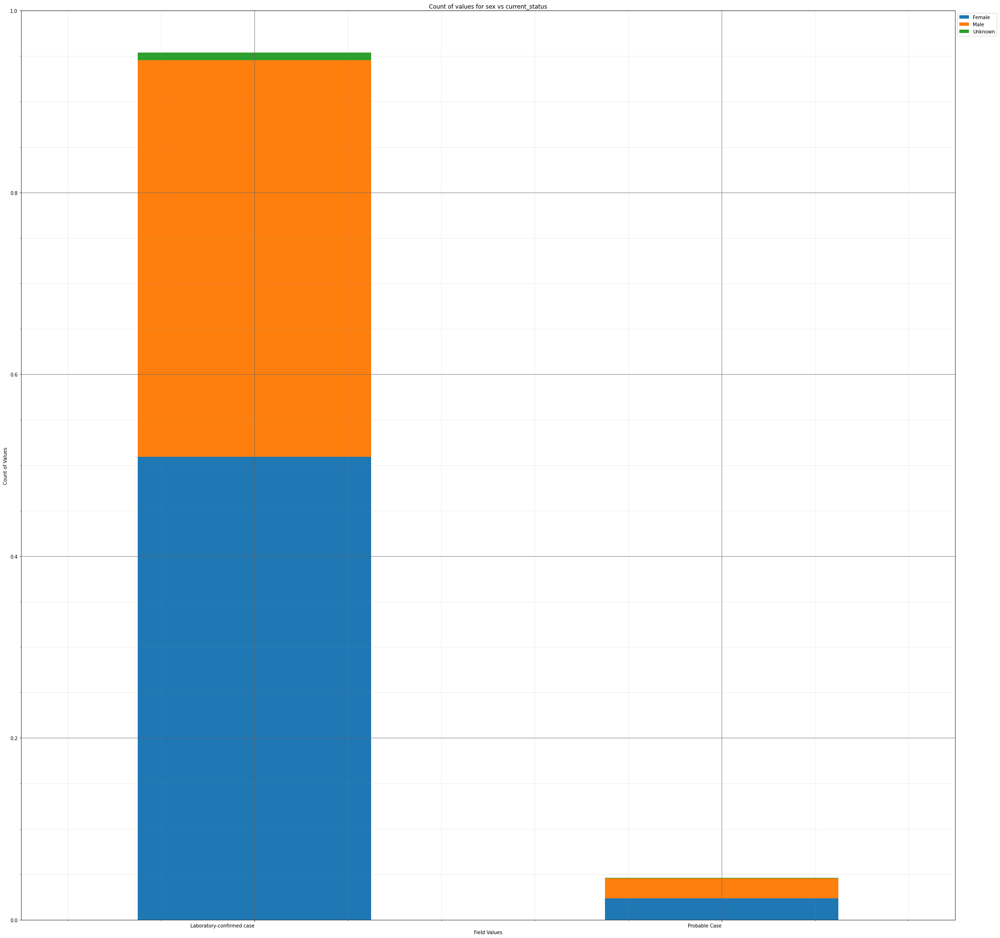



----------------------


Grouping over current_status|age_group results in:



,current_status,age_group,Rows,% Frequency
0,Laboratory-confirmed case,0 - 9 Years,430,4.503561
1,Laboratory-confirmed case,10 - 19 Years,960,10.054462
2,Laboratory-confirmed case,20 - 29 Years,1648,17.260159
3,Laboratory-confirmed case,30 - 39 Years,1449,15.175953
4,Laboratory-confirmed case,40 - 49 Years,1340,14.034353
5,Laboratory-confirmed case,50 - 59 Years,1296,13.573523
6,Laboratory-confirmed case,60 - 69 Years,964,10.096355
7,Laboratory-confirmed case,70 - 79 Years,588,6.158358
8,Laboratory-confirmed case,80+ Years,427,4.472141
9,Laboratory-confirmed case,Unknown,4,0.041894


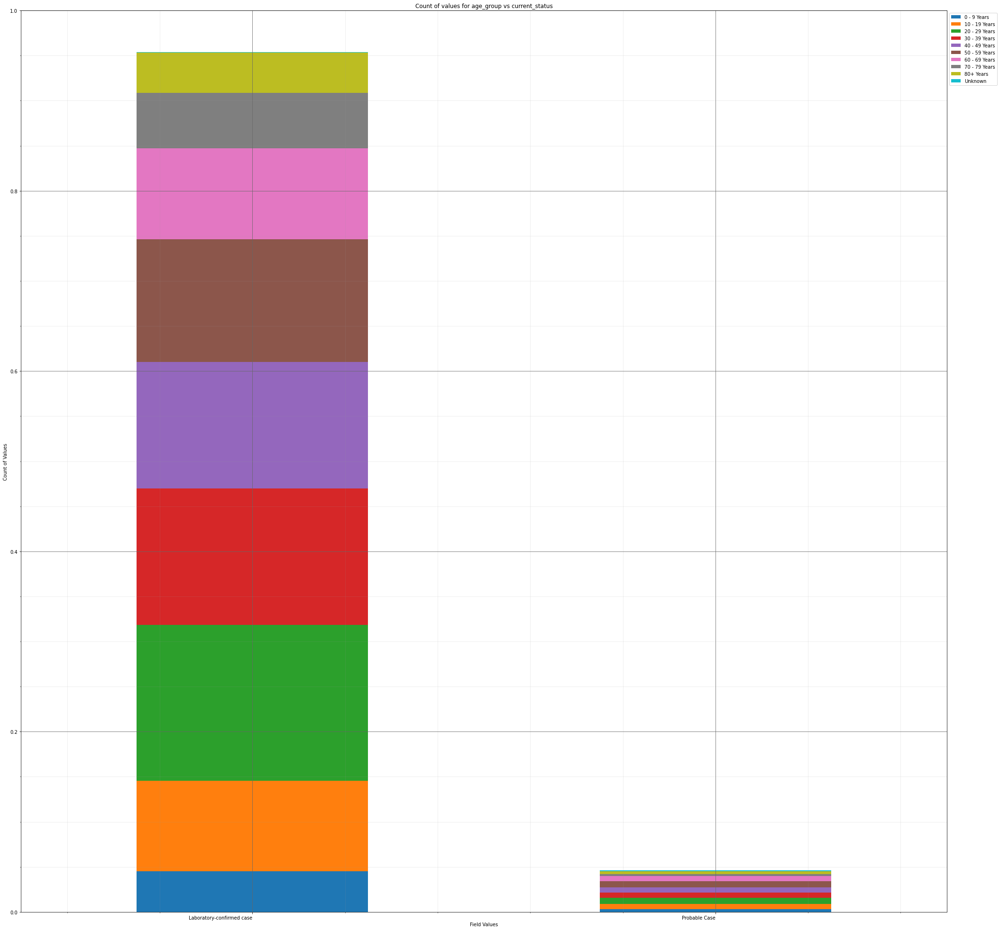



----------------------


Grouping over current_status|hosp_yn results in:



,current_status,hosp_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,4811,50.387516
1,Laboratory-confirmed case,OTH,0,0.000000
2,Laboratory-confirmed case,Unknown,3619,37.903226
3,Laboratory-confirmed case,Yes,676,7.080017
4,Probable Case,No,345,3.613322
5,Probable Case,OTH,0,0.000000
6,Probable Case,Unknown,76,0.795978
7,Probable Case,Yes,21,0.219941


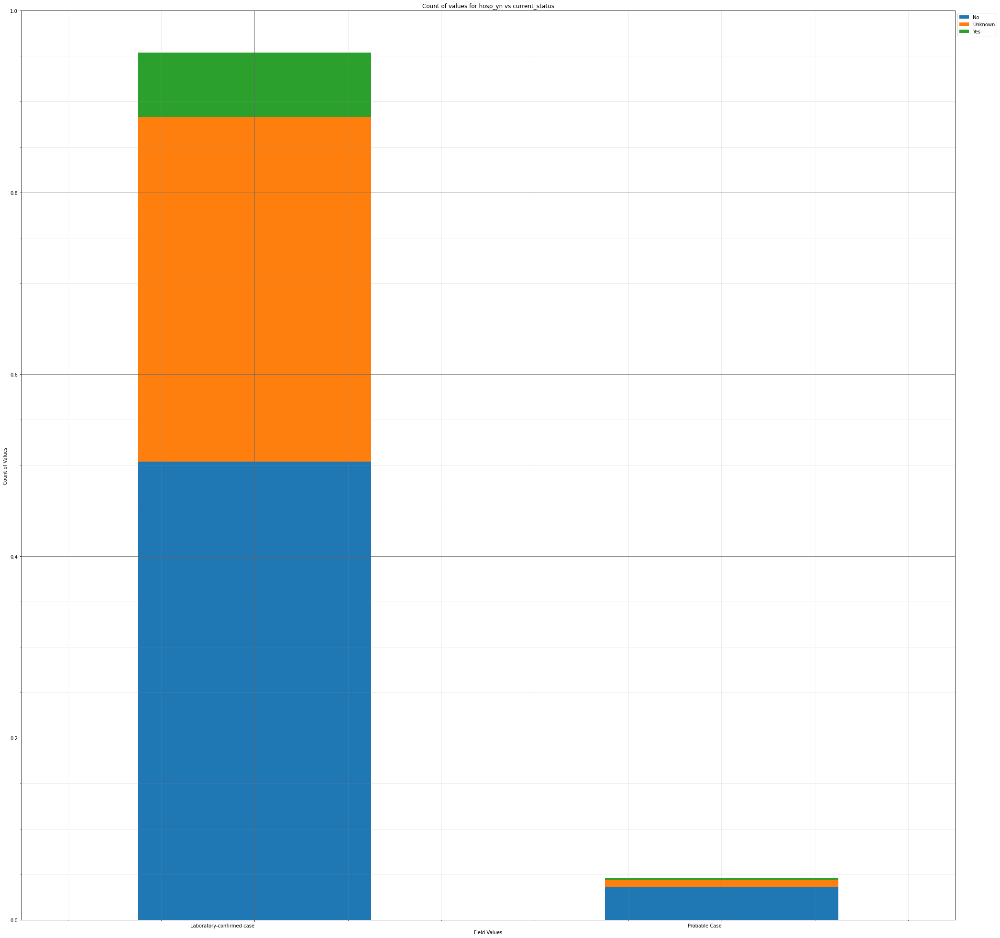



----------------------


Grouping over current_status|icu_yn results in:



,current_status,icu_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,896,9.384164
1,Laboratory-confirmed case,Unknown,8120,85.043988
2,Laboratory-confirmed case,Yes,90,0.942606
3,Probable Case,No,53,0.555090
4,Probable Case,Unknown,389,4.074152
5,Probable Case,Yes,0,0.000000


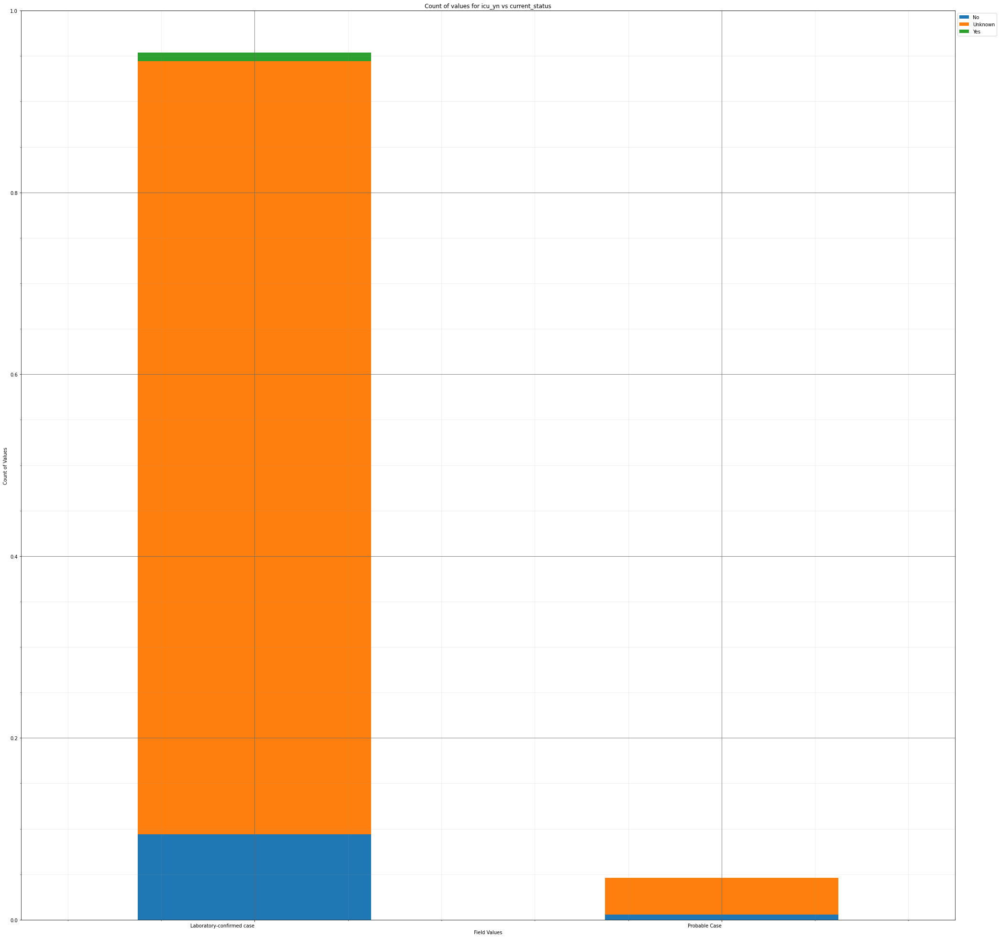



----------------------


Grouping over current_status|death_yn results in:



,current_status,death_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,8801,92.176372
1,Laboratory-confirmed case,Yes,305,3.194386
2,Probable Case,No,415,4.346460
3,Probable Case,Yes,27,0.282782


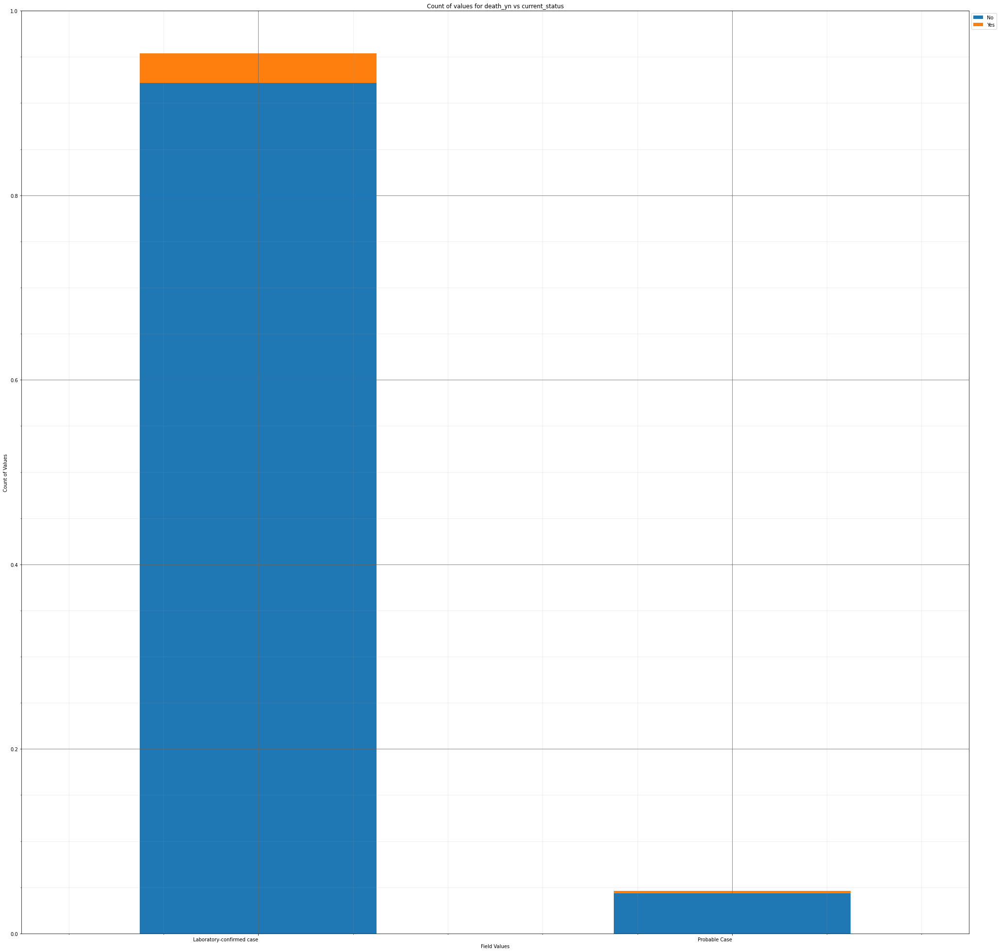



----------------------


Grouping over current_status|medcond_yn results in:



,current_status,medcond_yn,Rows,% Frequency
0,Laboratory-confirmed case,No,888,9.300377
1,Laboratory-confirmed case,Unknown,7407,77.576456
2,Laboratory-confirmed case,Yes,811,8.493925
3,Probable Case,No,38,0.397989
4,Probable Case,Unknown,384,4.021785
5,Probable Case,Yes,20,0.209468


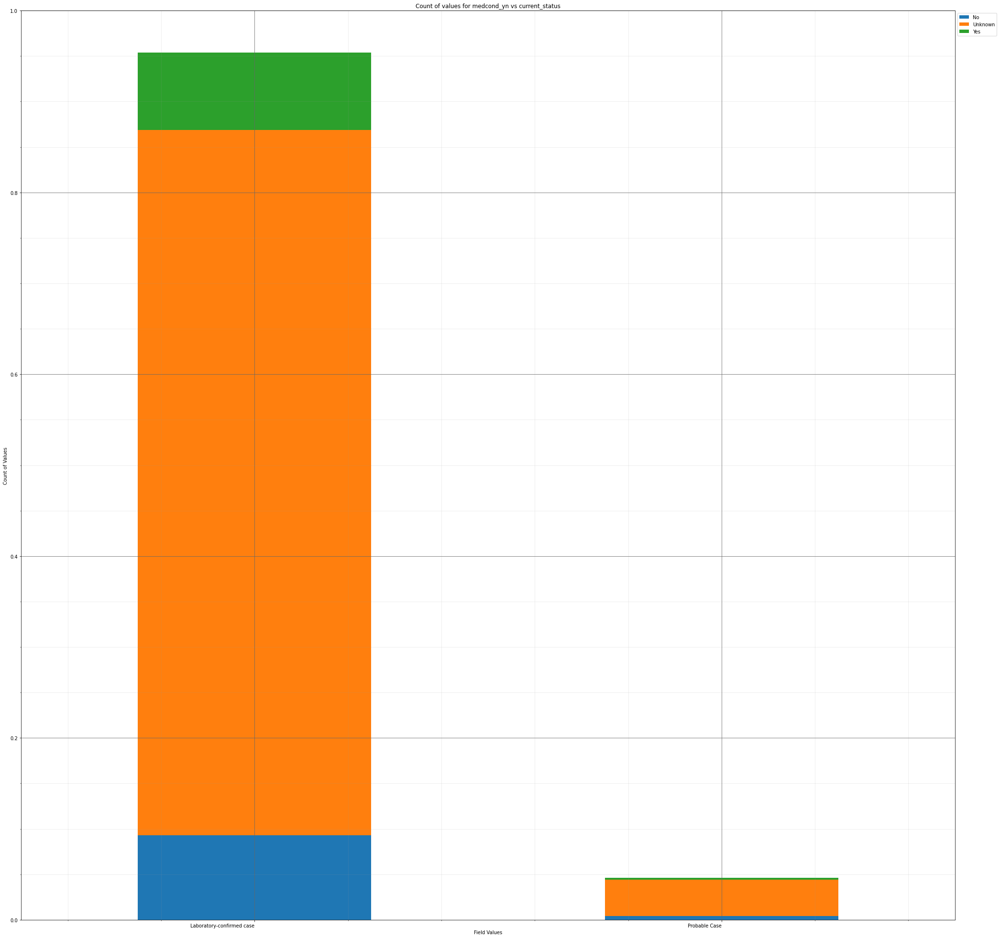



----------------------


Grouping over current_status|race results in:



,current_status,race,Rows,% Frequency
0,Laboratory-confirmed case,American Indian/Alaska Native,62,0.649351
1,Laboratory-confirmed case,Asian,231,2.419355
2,Laboratory-confirmed case,Black,669,7.006703
3,Laboratory-confirmed case,Hispanic/Latino,901,9.436531
4,Laboratory-confirmed case,Multiple/Other,478,5.006284
5,Laboratory-confirmed case,Native Hawaiian/Other Pacific Islander,23,0.240888
6,Laboratory-confirmed case,Unknown,3676,38.500209
7,Laboratory-confirmed case,White,3066,32.111437
8,Probable Case,American Indian/Alaska Native,4,0.041894
9,Probable Case,Asian,8,0.083787


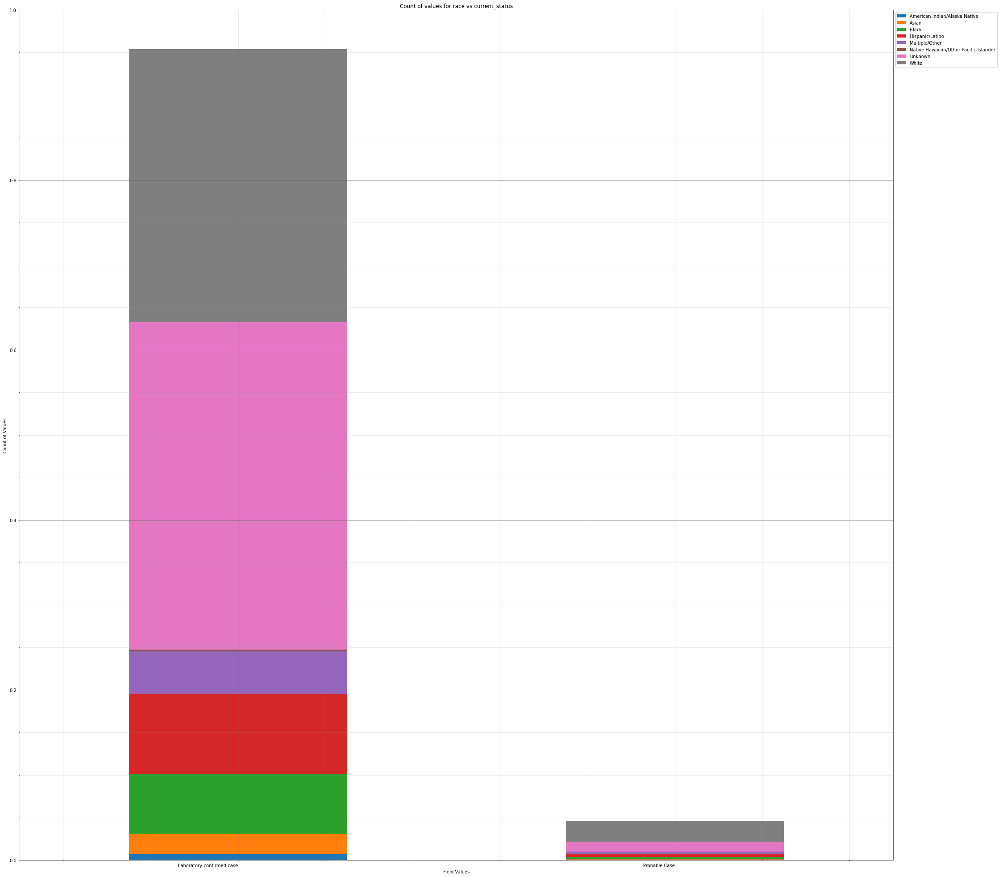



----------------------


Grouping over current_status|cdc_case_earliest_day results in:



,current_status,cdc_case_earliest_day,Rows,% Frequency
0,Laboratory-confirmed case,1,269,2.817344
1,Laboratory-confirmed case,2,310,3.246753
2,Laboratory-confirmed case,3,293,3.068705
3,Laboratory-confirmed case,4,325,3.403854
4,Laboratory-confirmed case,5,311,3.257227
...,...,...,...,...
57,Probable Case,27,8,0.083787
58,Probable Case,28,14,0.146628
59,Probable Case,29,16,0.167574
60,Probable Case,30,13,0.136154


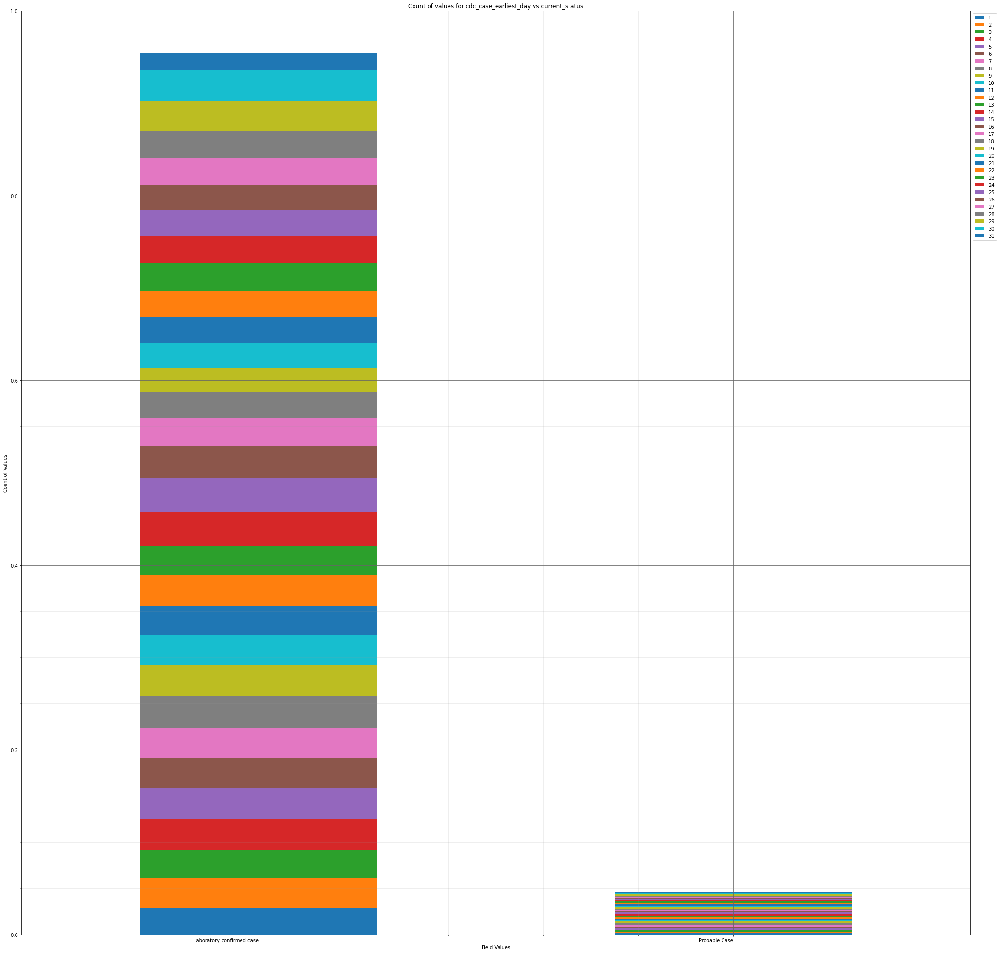



----------------------


Grouping over current_status|cdc_case_earliest_weekday results in:



,current_status,cdc_case_earliest_weekday,Rows,% Frequency
0,Laboratory-confirmed case,0,1566,16.401341
1,Laboratory-confirmed case,1,1445,15.134059
2,Laboratory-confirmed case,2,1493,15.636783
3,Laboratory-confirmed case,3,1314,13.762044
4,Laboratory-confirmed case,4,1320,13.824885
5,Laboratory-confirmed case,5,1086,11.374110
6,Laboratory-confirmed case,6,882,9.237537
7,Probable Case,0,72,0.754085
8,Probable Case,1,67,0.701718
9,Probable Case,2,71,0.743611


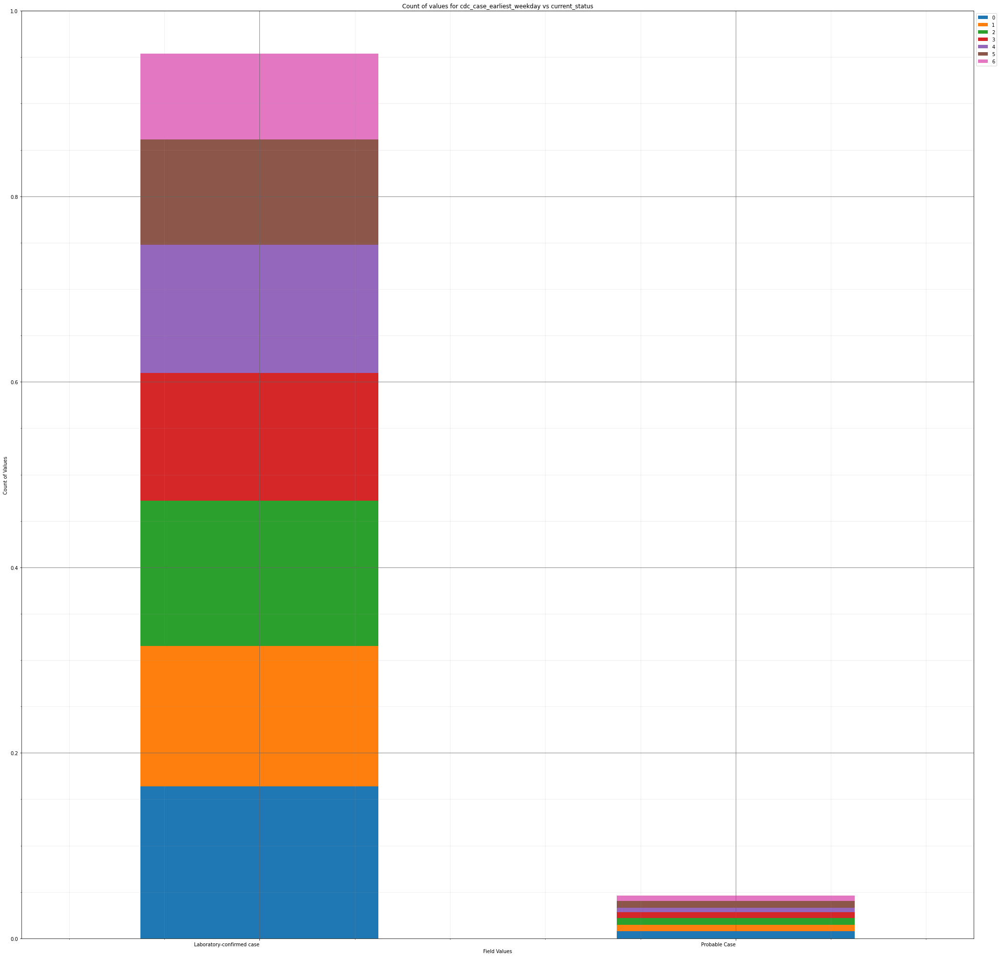



----------------------


Grouping over current_status|cdc_case_earliest_month results in:



,current_status,cdc_case_earliest_month,Rows,% Frequency
0,Laboratory-confirmed case,1,1044,10.934227
1,Laboratory-confirmed case,2,3,0.031420
2,Laboratory-confirmed case,3,228,2.387935
3,Laboratory-confirmed case,4,480,5.027231
4,Laboratory-confirmed case,5,416,4.356933
5,Laboratory-confirmed case,6,576,6.032677
6,Laboratory-confirmed case,7,879,9.206116
7,Laboratory-confirmed case,8,555,5.812736
8,Laboratory-confirmed case,9,537,5.624214
9,Laboratory-confirmed case,10,801,8.389191


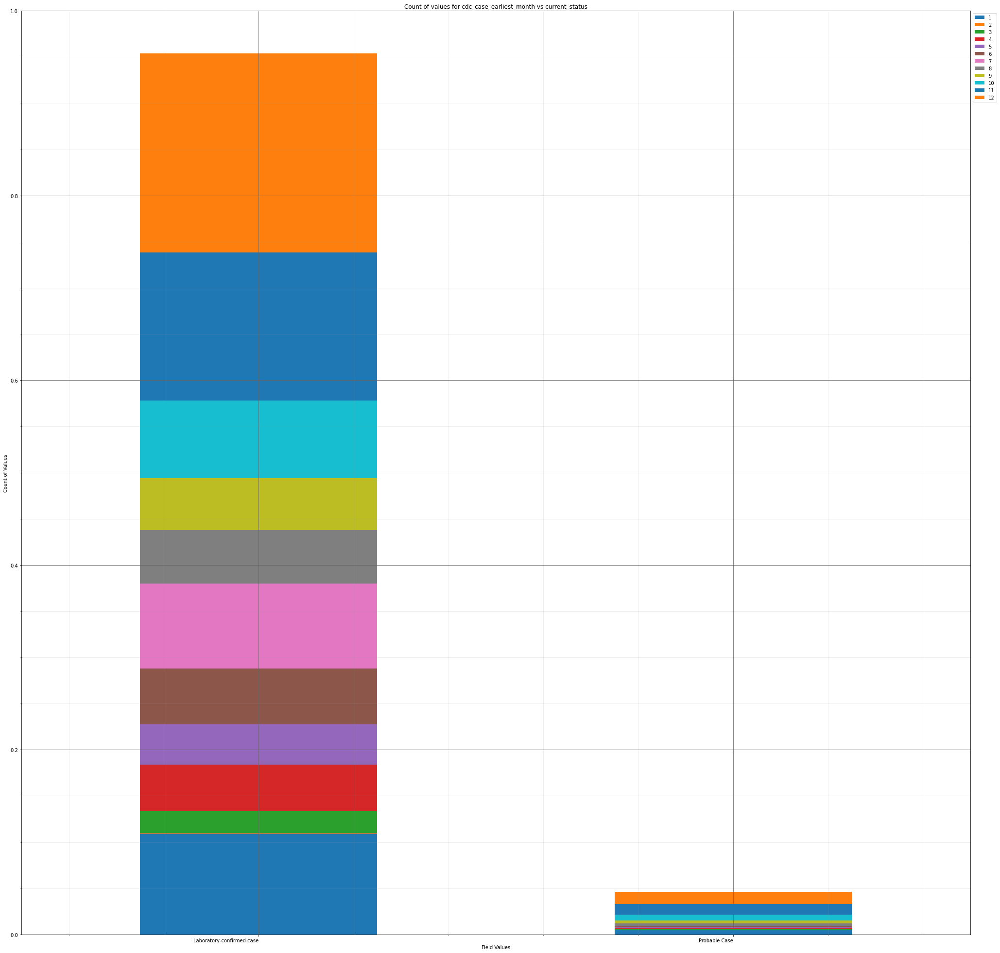



----------------------


Grouping over current_status|cdc_case_earliest_year results in:



,current_status,cdc_case_earliest_year,Rows,% Frequency
0,Laboratory-confirmed case,2020,8065,84.467951
1,Laboratory-confirmed case,2021,1041,10.902807
2,Probable Case,2020,394,4.126519
3,Probable Case,2021,48,0.502723


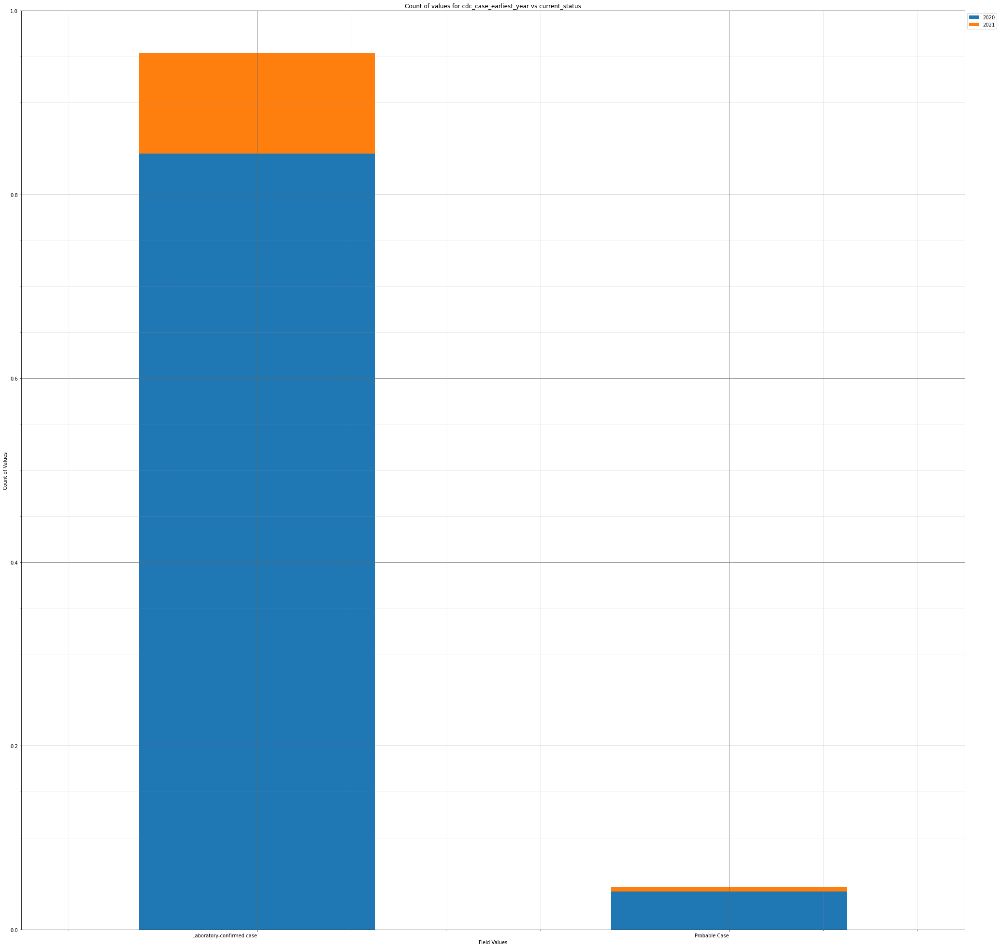



----------------------


Grouping over current_status|demographic_missing results in:



,current_status,demographic_missing,Rows,% Frequency
0,Laboratory-confirmed case,False,5399,56.545873
1,Laboratory-confirmed case,True,3707,38.824885
2,Probable Case,False,325,3.403854
3,Probable Case,True,117,1.225388


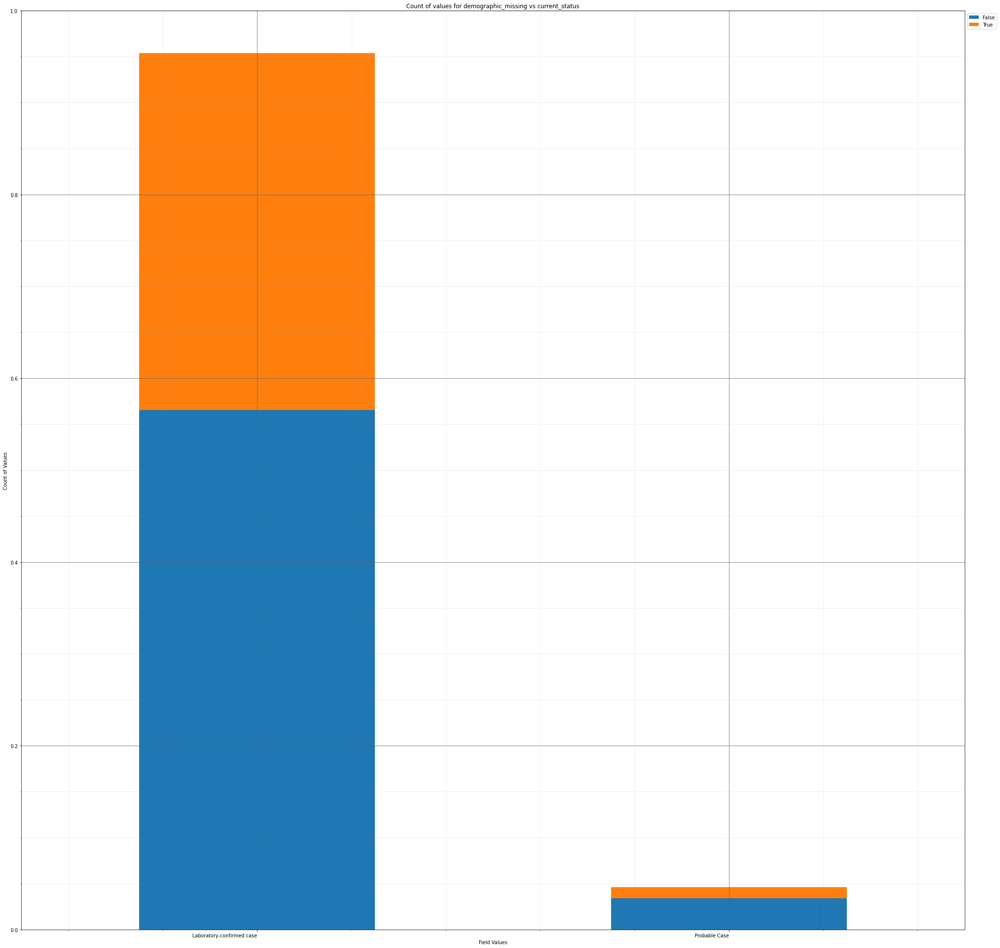



----------------------


Grouping over current_status|medical_missing results in:



,current_status,medical_missing,Rows,% Frequency
0,Laboratory-confirmed case,False,687,7.195224
1,Laboratory-confirmed case,True,8419,88.175534
2,Probable Case,False,42,0.439883
3,Probable Case,True,400,4.189359


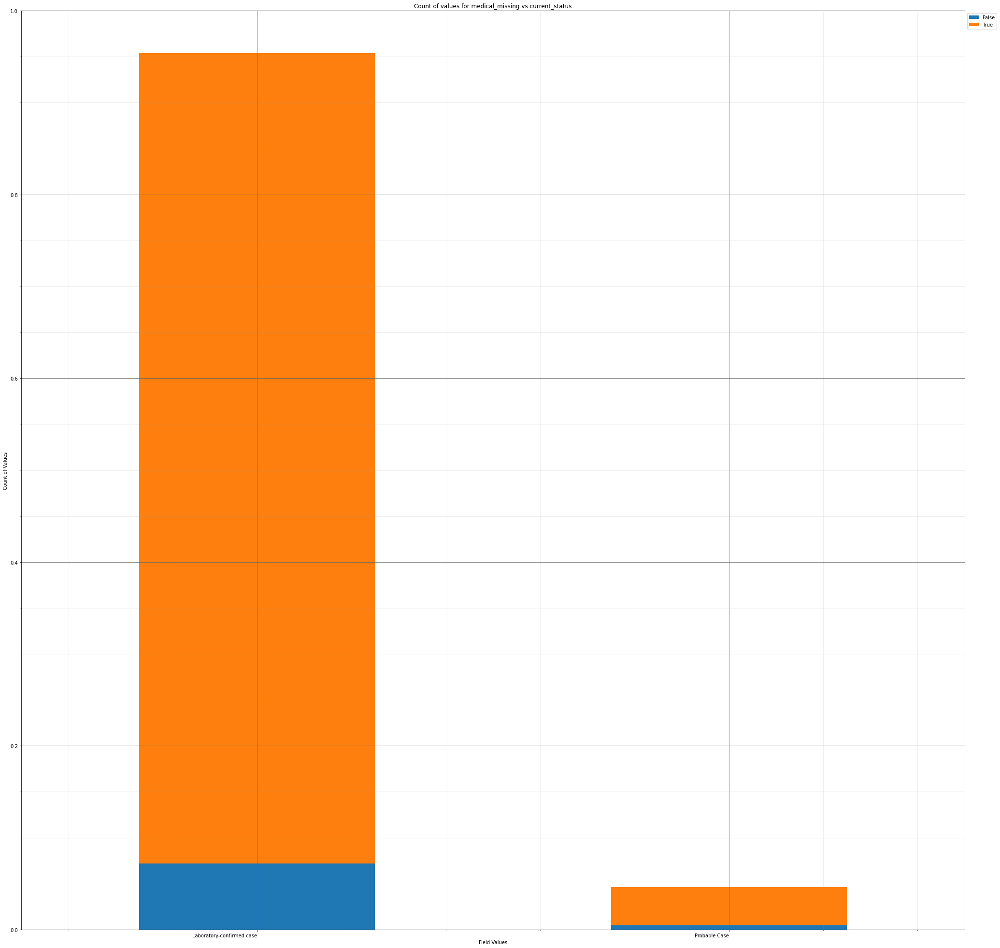



----------------------


Grouping over sex|current_status results in:



,sex,current_status,Rows,% Frequency
0,Female,Laboratory-confirmed case,4862,50.921659
1,Female,Probable Case,227,2.377461
2,Male,Laboratory-confirmed case,4166,43.632174
3,Male,Probable Case,210,2.199413
4,Unknown,Laboratory-confirmed case,78,0.816925
5,Unknown,Probable Case,5,0.052367


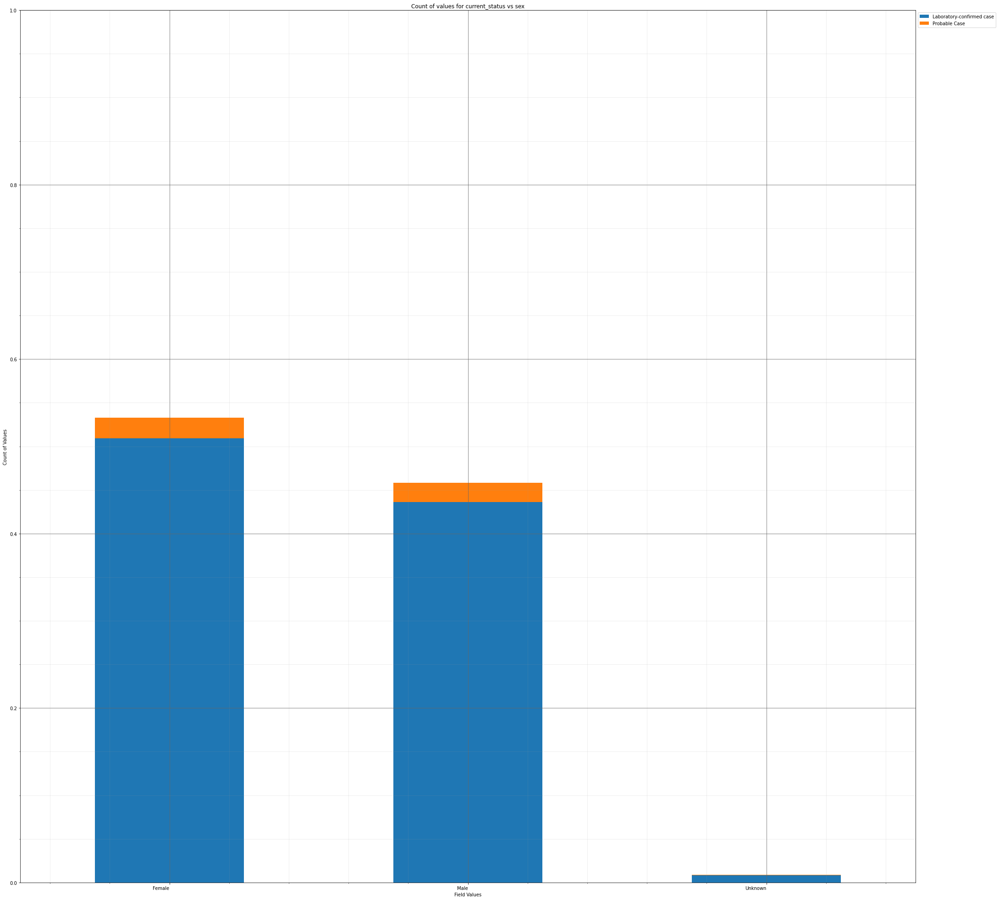



----------------------


Grouping over sex|age_group results in:



,sex,age_group,Rows,% Frequency
0,Female,0 - 9 Years,233,2.440302
1,Female,10 - 19 Years,525,5.498534
2,Female,20 - 29 Years,925,9.687893
3,Female,30 - 39 Years,806,8.441558
4,Female,40 - 49 Years,727,7.614160
5,Female,50 - 59 Years,726,7.603687
6,Female,60 - 69 Years,529,5.540427
7,Female,70 - 79 Years,314,3.288647
8,Female,80+ Years,294,3.079179
9,Female,Unknown,10,0.104734


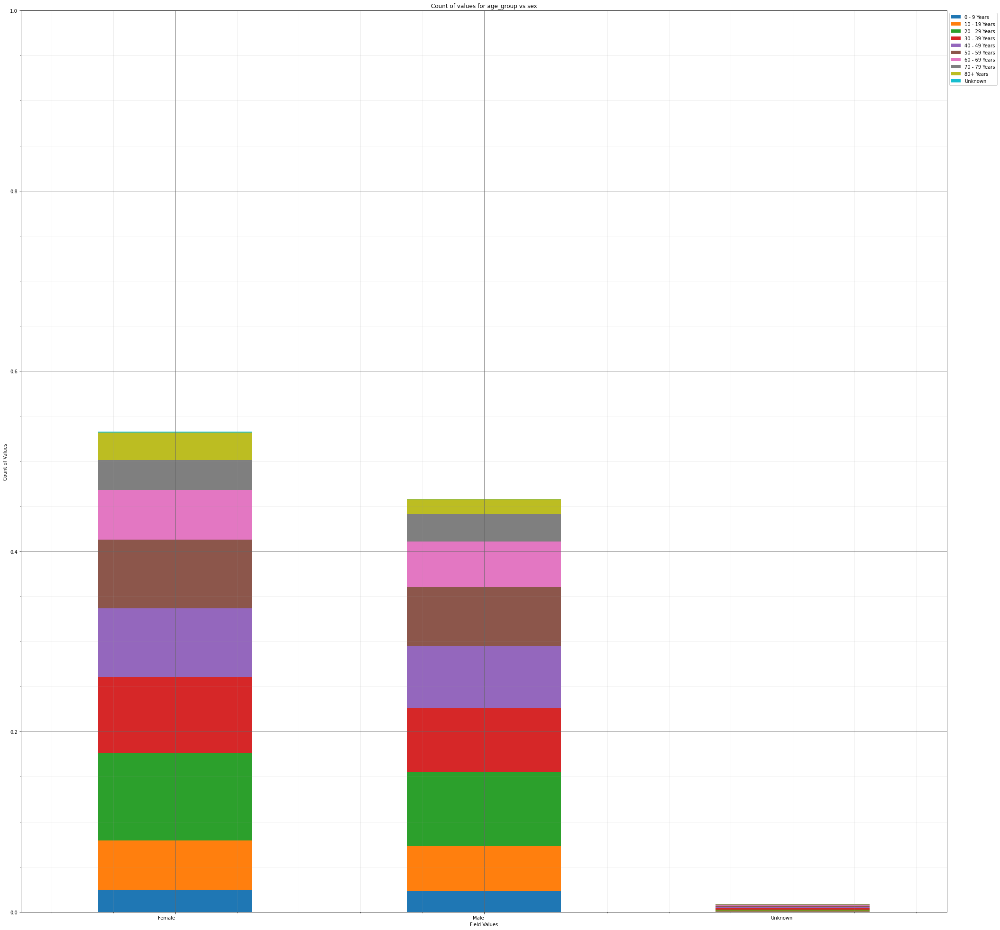



----------------------


Grouping over sex|hosp_yn results in:



,sex,hosp_yn,Rows,% Frequency
0,Female,No,2824,29.576875
1,Female,OTH,0,0.000000
2,Female,Unknown,1919,20.098450
3,Female,Yes,346,3.623796
4,Male,No,2305,24.141181
5,Male,OTH,0,0.000000
6,Male,Unknown,1721,18.024717
7,Male,Yes,350,3.665689
8,Unknown,No,27,0.282782
9,Unknown,OTH,0,0.000000


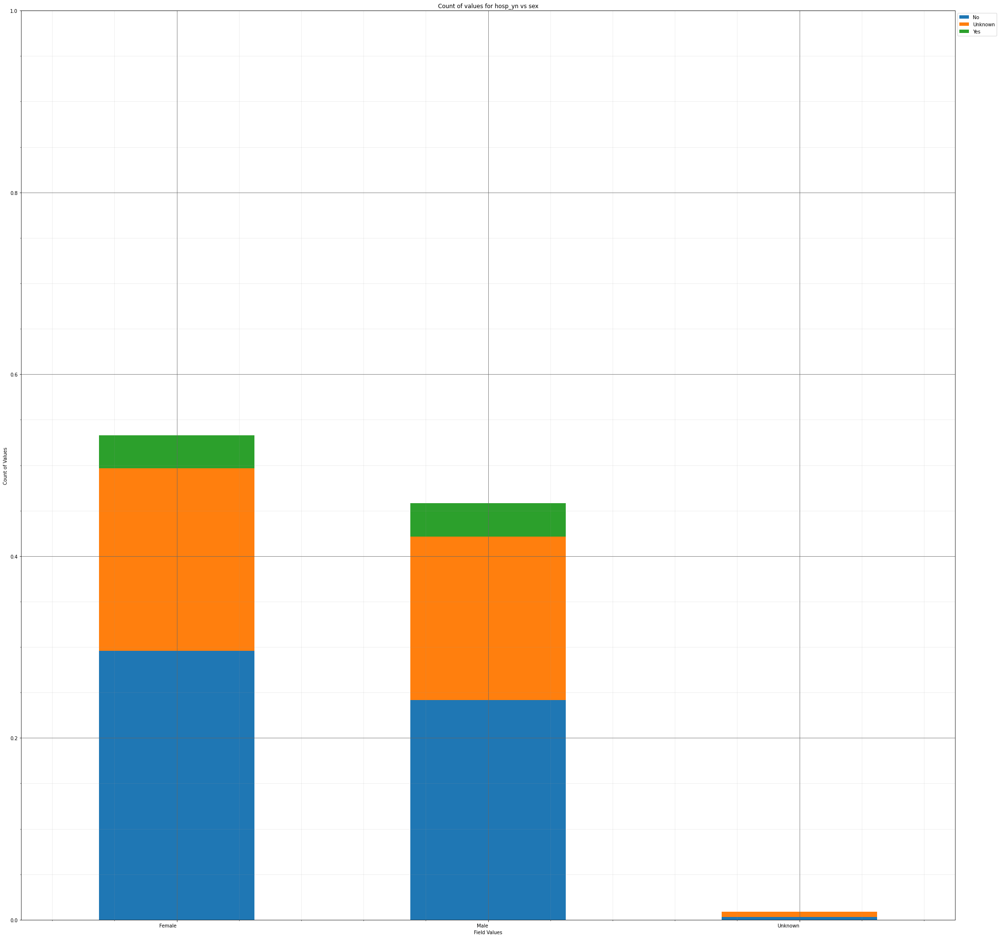



----------------------


Grouping over sex|icu_yn results in:



,sex,icu_yn,Rows,% Frequency
0,Female,No,509,5.330959
1,Female,Unknown,4540,47.549225
2,Female,Yes,40,0.418936
3,Male,No,436,4.566401
4,Male,Unknown,3891,40.751990
5,Male,Yes,49,0.513196
6,Unknown,No,4,0.041894
7,Unknown,Unknown,78,0.816925
8,Unknown,Yes,1,0.010473


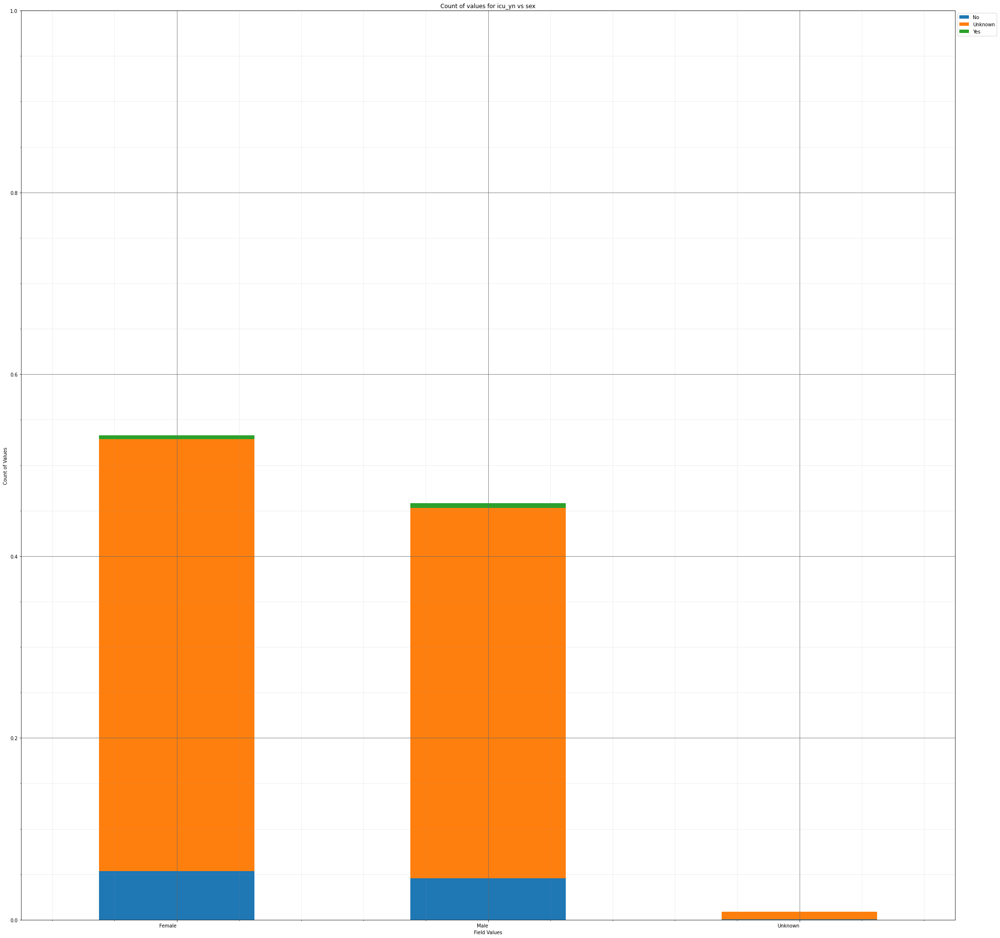



----------------------


Grouping over sex|death_yn results in:



,sex,death_yn,Rows,% Frequency
0,Female,No,4923,51.560536
1,Female,Yes,166,1.738584
2,Male,No,4213,44.124424
3,Male,Yes,163,1.707164
4,Unknown,No,80,0.837872
5,Unknown,Yes,3,0.031420


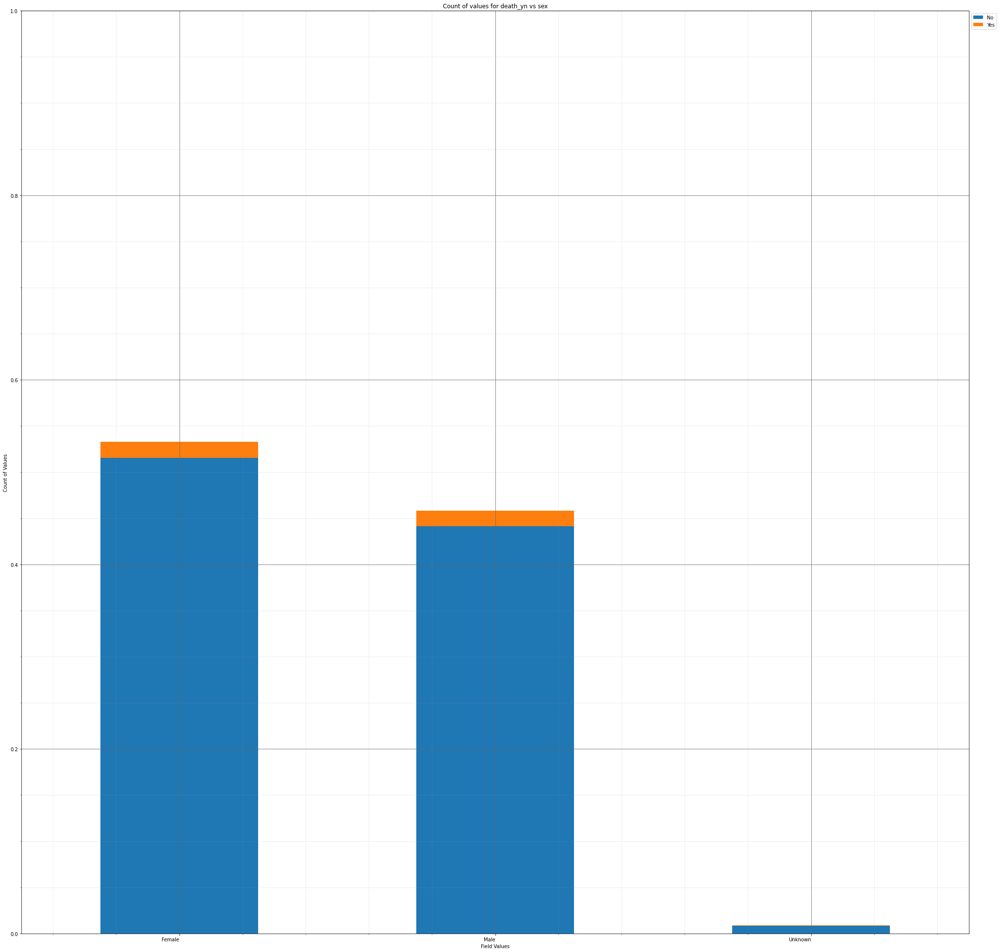



----------------------


Grouping over sex|medcond_yn results in:



,sex,medcond_yn,Rows,% Frequency
0,Female,No,507,5.310013
1,Female,Unknown,4125,43.202765
2,Female,Yes,457,4.786343
3,Male,No,412,4.315040
4,Male,Unknown,3593,37.630917
5,Male,Yes,371,3.885630
6,Unknown,No,7,0.073314
7,Unknown,Unknown,73,0.764558
8,Unknown,Yes,3,0.031420


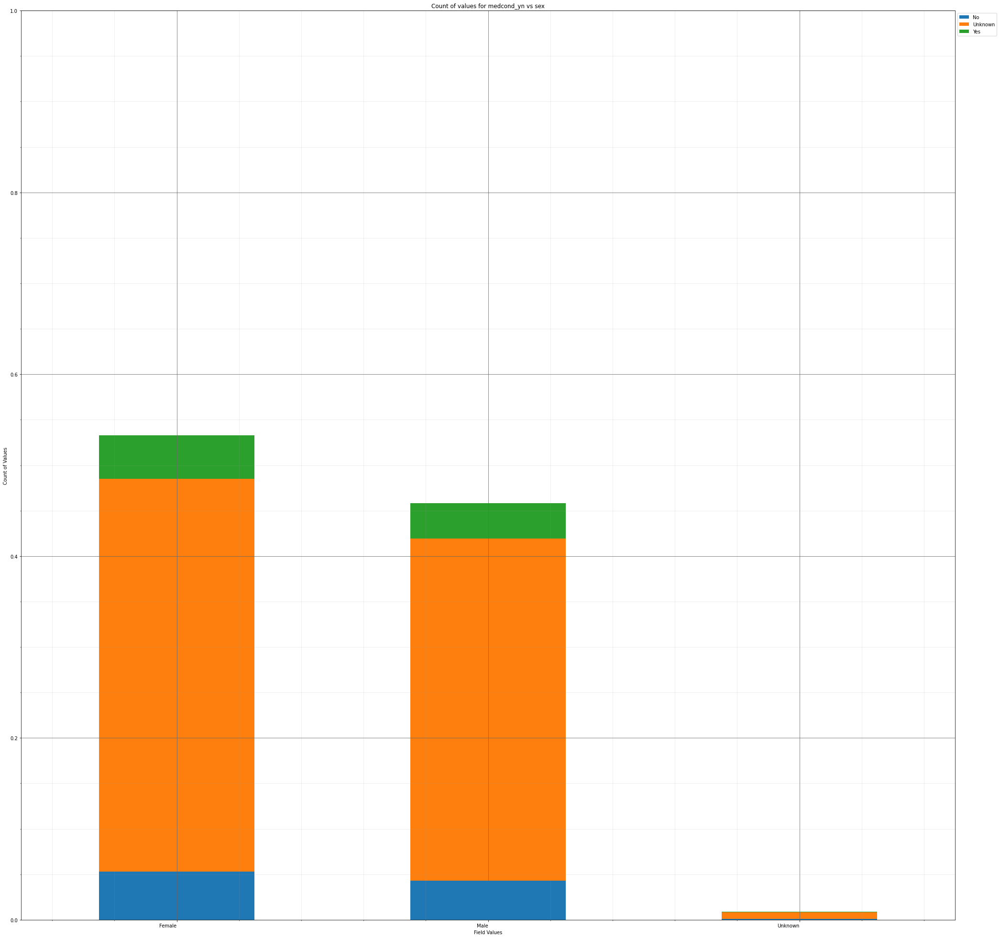



----------------------


Grouping over sex|race results in:



,sex,race,Rows,% Frequency
0,Female,American Indian/Alaska Native,34,0.356096
1,Female,Asian,122,1.277755
2,Female,Black,410,4.294093
3,Female,Hispanic/Latino,510,5.341433
4,Female,Multiple/Other,262,2.744030
5,Female,Native Hawaiian/Other Pacific Islander,14,0.146628
6,Female,Unknown,1960,20.527859
7,Female,White,1777,18.611227
8,Male,American Indian/Alaska Native,32,0.335149
9,Male,Asian,114,1.193967


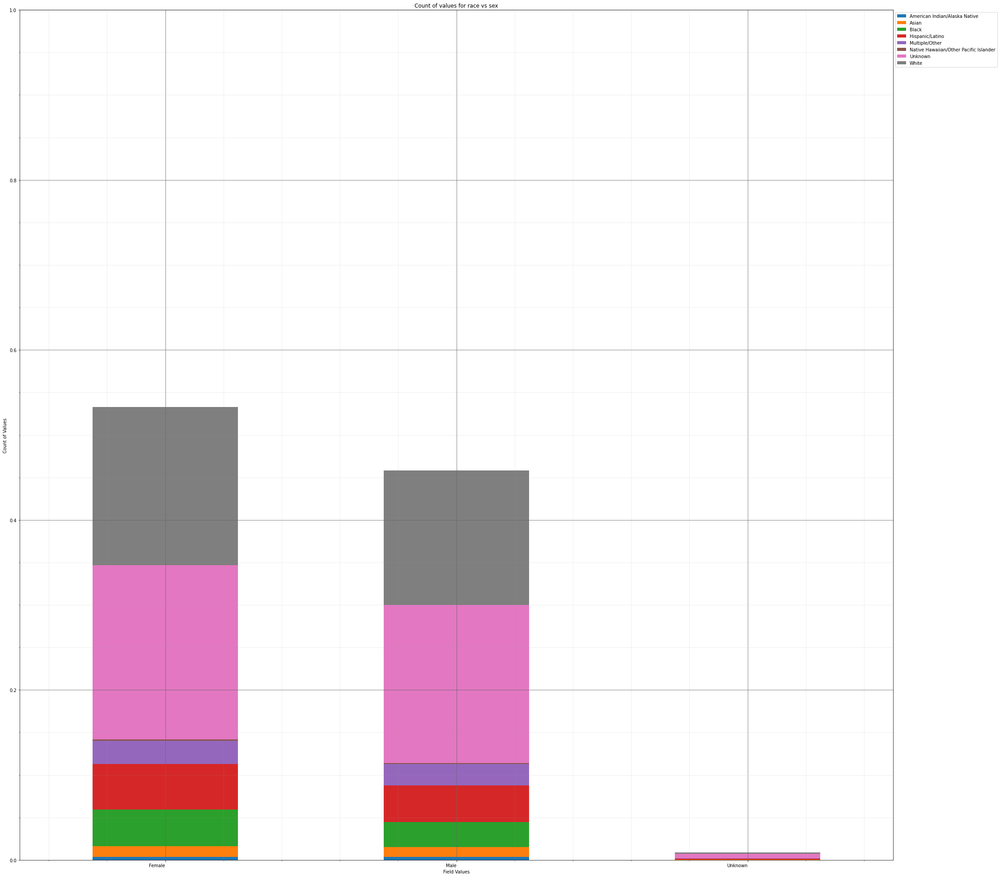



----------------------


Grouping over sex|cdc_case_earliest_day results in:



,sex,cdc_case_earliest_day,Rows,% Frequency
0,Female,1,162,1.696690
1,Female,2,176,1.843318
2,Female,3,175,1.832845
3,Female,4,173,1.811898
4,Female,5,172,1.801424
...,...,...,...,...
88,Unknown,27,3,0.031420
89,Unknown,28,3,0.031420
90,Unknown,29,5,0.052367
91,Unknown,30,4,0.041894


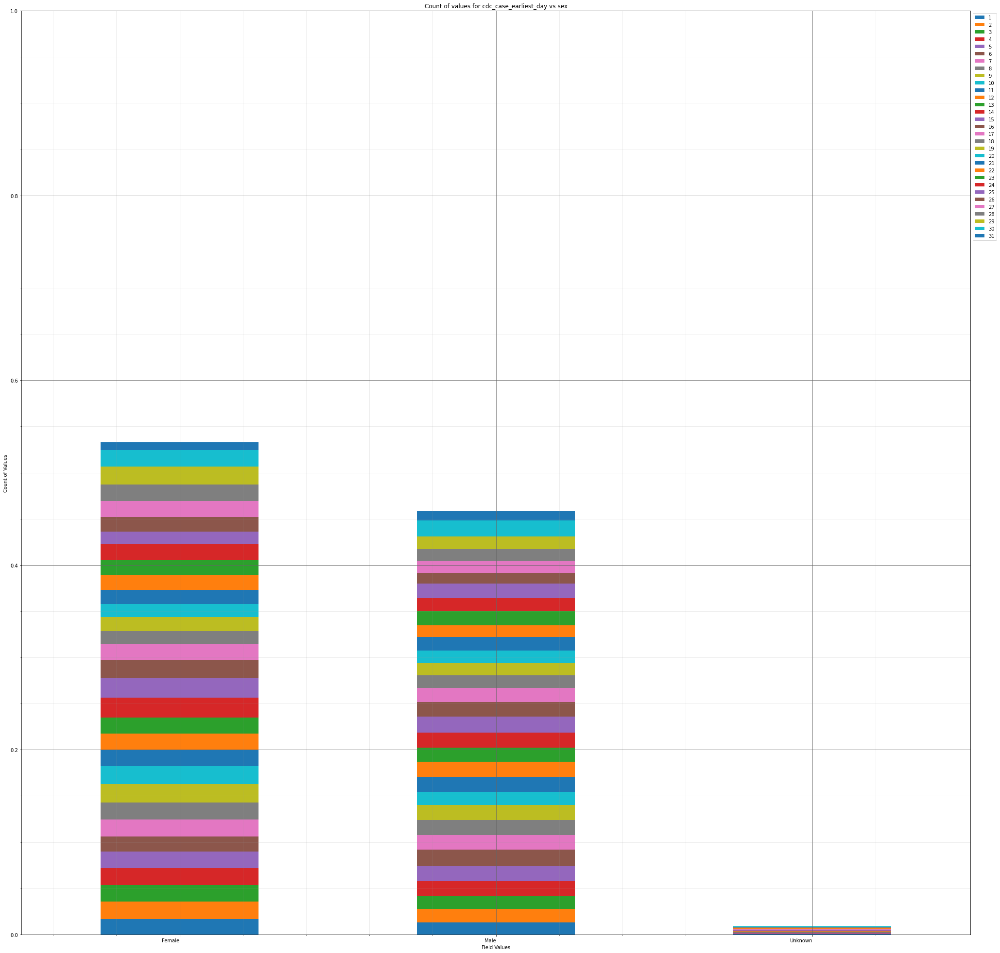



----------------------


Grouping over sex|cdc_case_earliest_weekday results in:



,sex,cdc_case_earliest_weekday,Rows,% Frequency
0,Female,0,870,9.111856
1,Female,1,775,8.116883
2,Female,2,841,8.808127
3,Female,3,744,7.792208
4,Female,4,733,7.677000
5,Female,5,611,6.399246
6,Female,6,515,5.393800
7,Male,0,754,7.896942
8,Male,1,721,7.551320
9,Male,2,708,7.415165


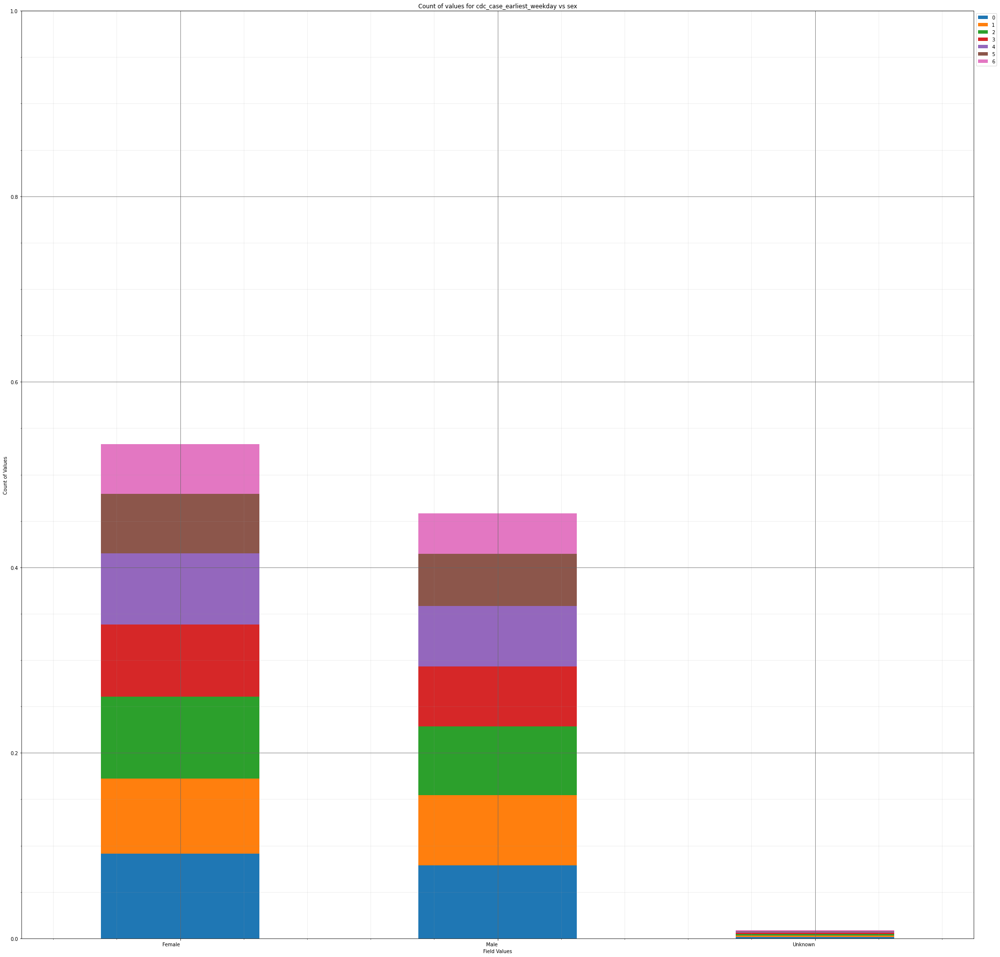



----------------------


Grouping over sex|cdc_case_earliest_month results in:



,sex,cdc_case_earliest_month,Rows,% Frequency
0,Female,1,593,6.210725
1,Female,2,0,0.000000
2,Female,3,120,1.256808
3,Female,4,275,2.880184
4,Female,5,243,2.545036
5,Female,6,307,3.215333
6,Female,7,477,4.995811
7,Female,8,318,3.330540
8,Female,9,295,3.089652
9,Female,10,456,4.775869


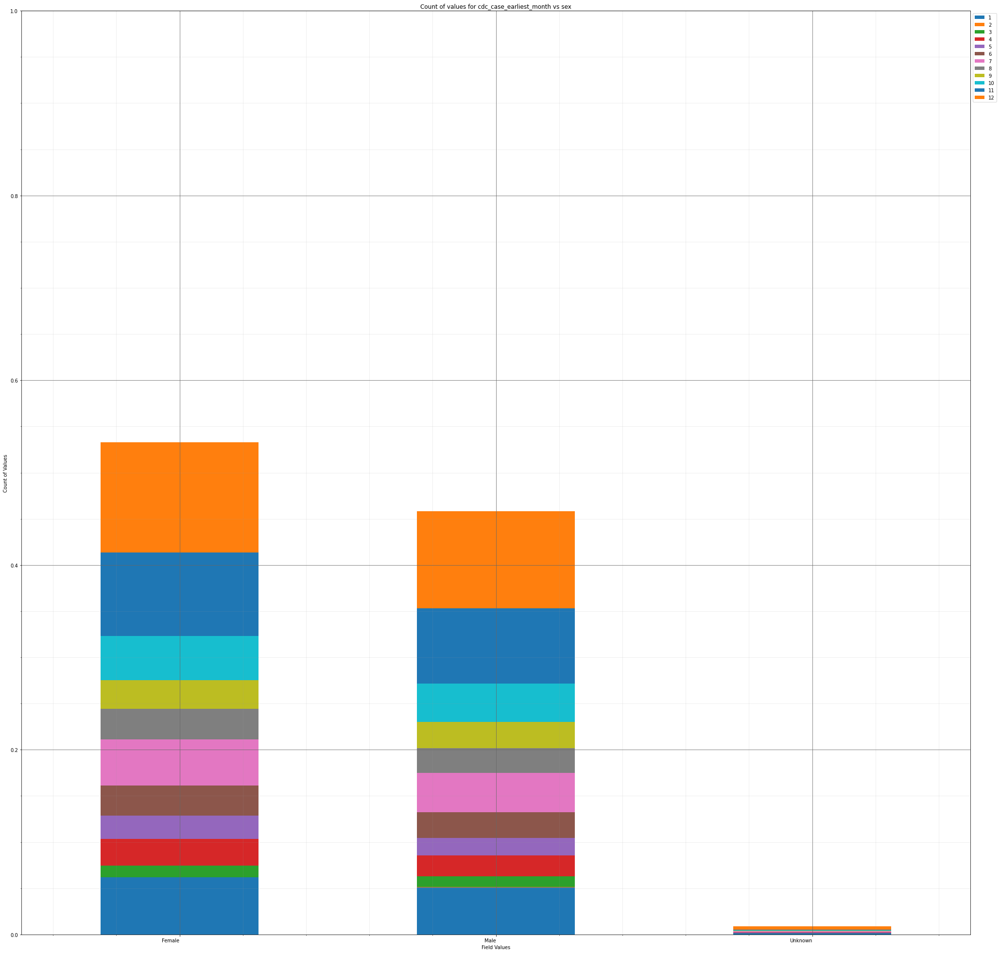



----------------------


Grouping over sex|cdc_case_earliest_year results in:



,sex,cdc_case_earliest_year,Rows,% Frequency
0,Female,2020,4499,47.119816
1,Female,2021,590,6.179305
2,Male,2020,3891,40.751990
3,Male,2021,485,5.079598
4,Unknown,2020,69,0.722664
5,Unknown,2021,14,0.146628


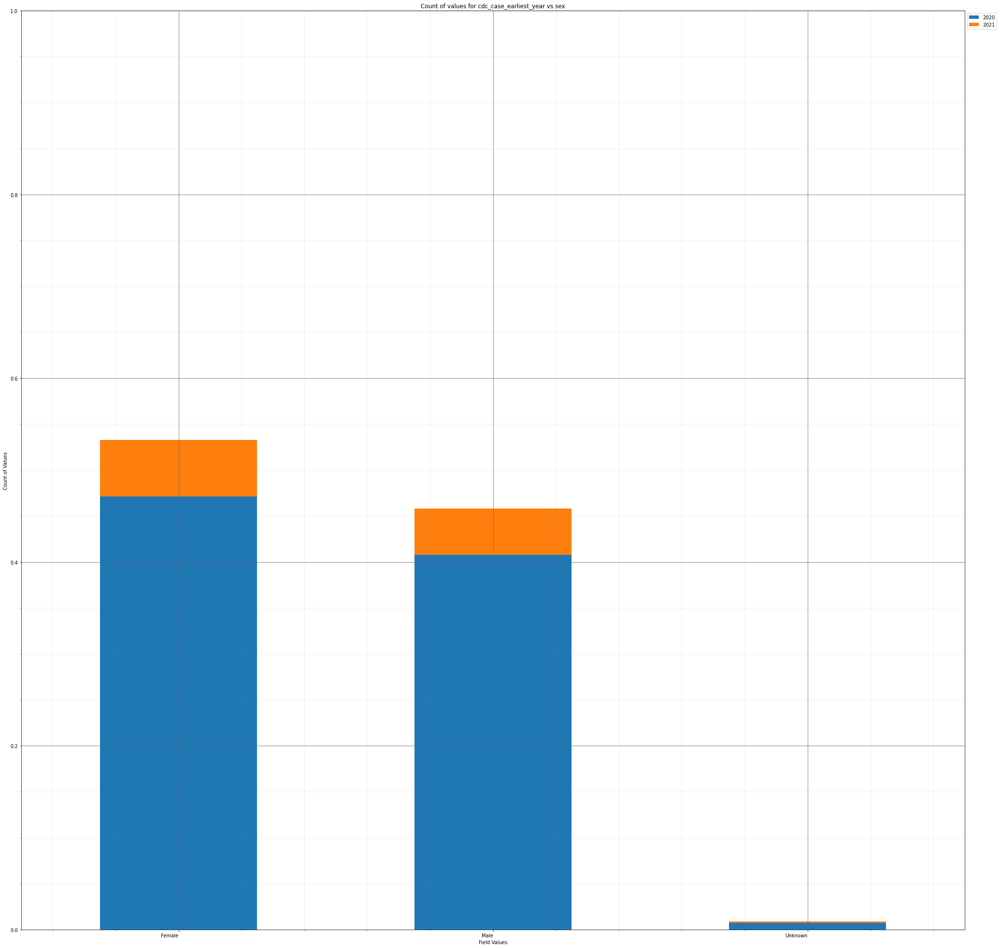



----------------------


Grouping over sex|demographic_missing results in:



,sex,demographic_missing,Rows,% Frequency
0,Female,False,3127,32.750314
1,Female,True,1962,20.548806
2,Male,False,2597,27.199413
3,Male,True,1779,18.632174
4,Unknown,False,0,0.000000
5,Unknown,True,83,0.869292


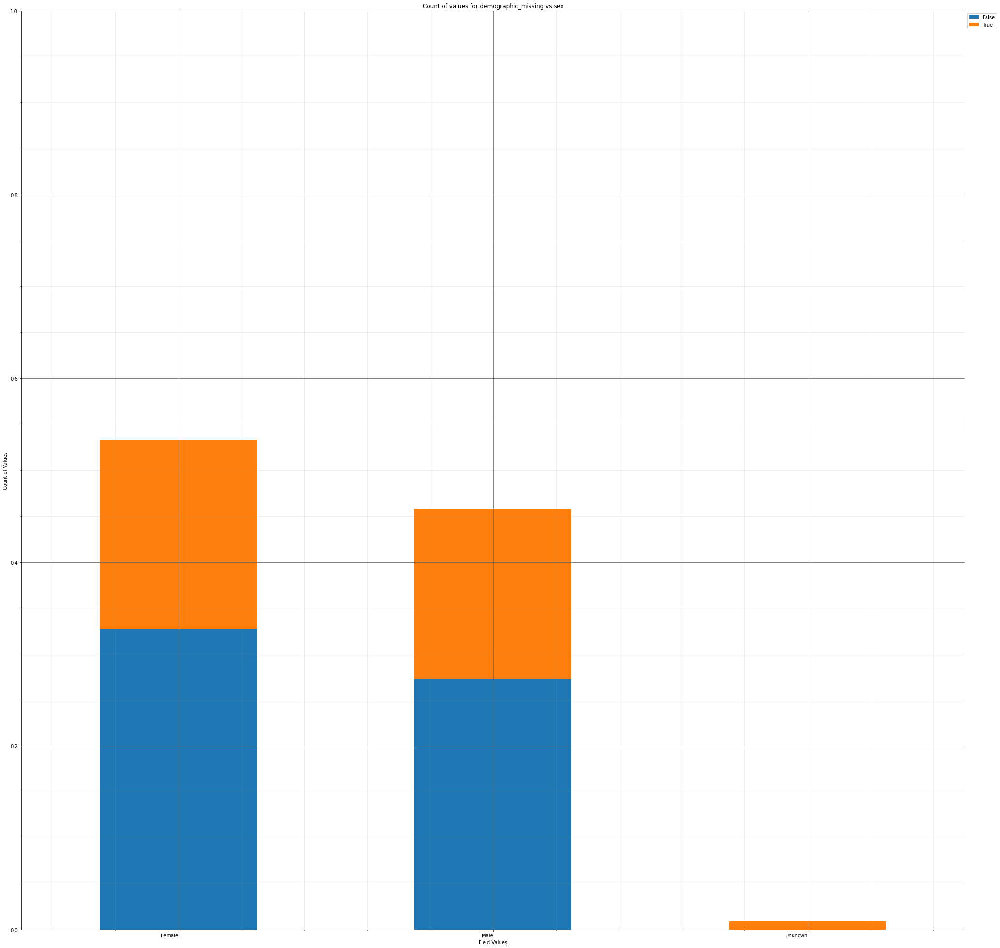



----------------------


Grouping over sex|medical_missing results in:



,sex,medical_missing,Rows,% Frequency
0,Female,False,396,4.147465
1,Female,True,4693,49.151655
2,Male,False,329,3.445748
3,Male,True,4047,42.385840
4,Unknown,False,4,0.041894
5,Unknown,True,79,0.827398


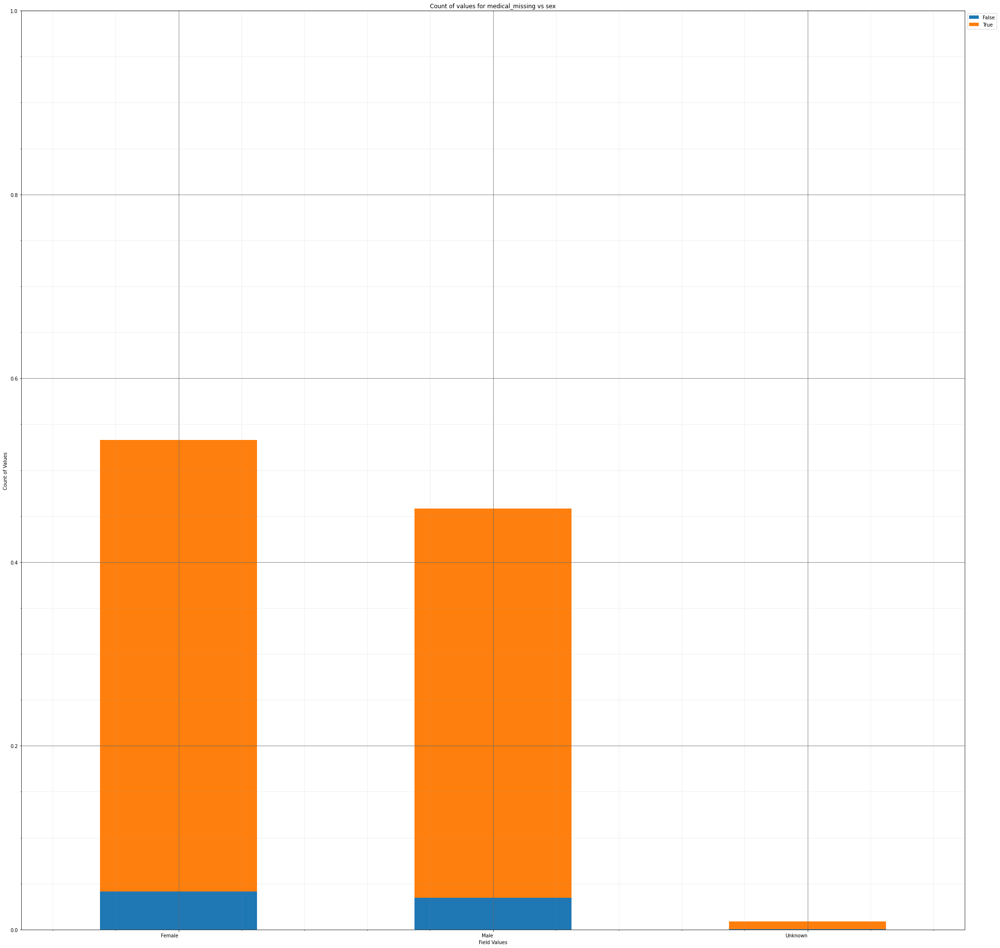



----------------------


Grouping over age_group|current_status results in:



,age_group,current_status,Rows,% Frequency
0,0 - 9 Years,Laboratory-confirmed case,430,4.503561
1,0 - 9 Years,Probable Case,28,0.293255
2,10 - 19 Years,Laboratory-confirmed case,960,10.054462
3,10 - 19 Years,Probable Case,54,0.565563
4,20 - 29 Years,Laboratory-confirmed case,1648,17.260159
5,20 - 29 Years,Probable Case,70,0.733138
6,30 - 39 Years,Laboratory-confirmed case,1449,15.175953
7,30 - 39 Years,Probable Case,54,0.565563
8,40 - 49 Years,Laboratory-confirmed case,1340,14.034353
9,40 - 49 Years,Probable Case,56,0.586510


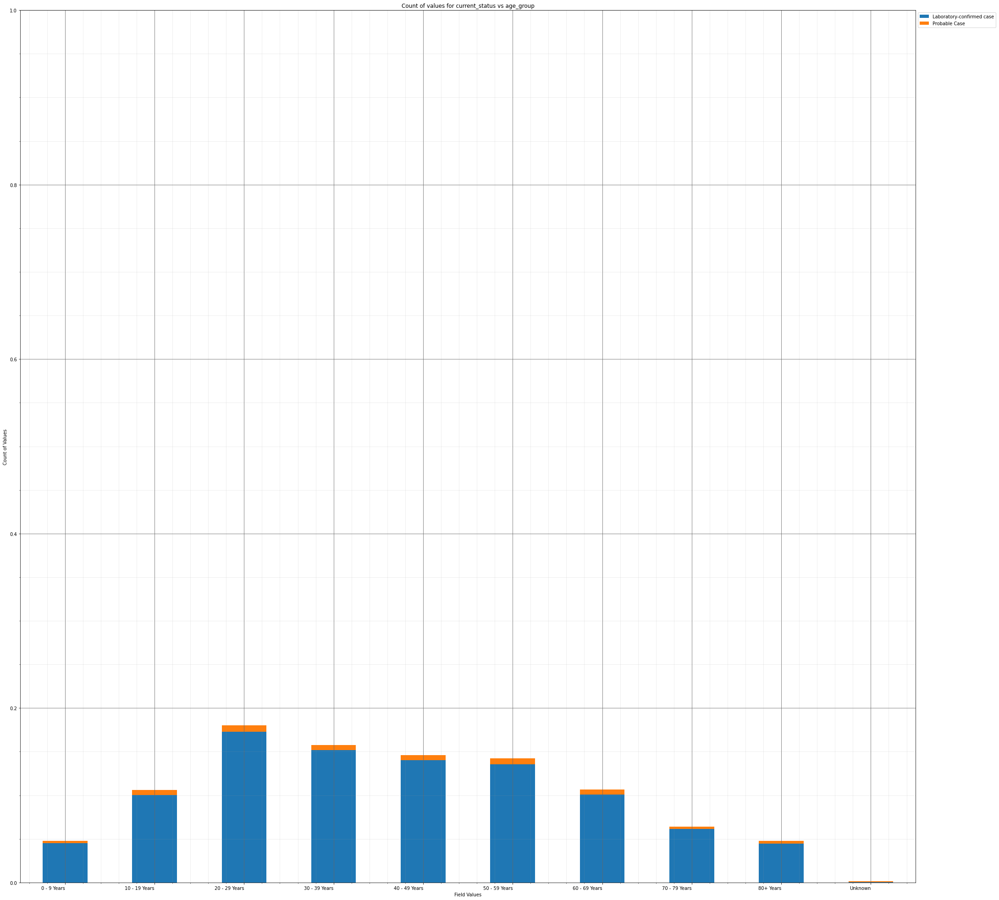



----------------------


Grouping over age_group|sex results in:



,age_group,sex,Rows,% Frequency
0,0 - 9 Years,Female,233,2.440302
1,0 - 9 Years,Male,221,2.314621
2,0 - 9 Years,Unknown,4,0.041894
3,10 - 19 Years,Female,525,5.498534
4,10 - 19 Years,Male,477,4.995811
5,10 - 19 Years,Unknown,12,0.125681
6,20 - 29 Years,Female,925,9.687893
7,20 - 29 Years,Male,784,8.211144
8,20 - 29 Years,Unknown,9,0.094261
9,30 - 39 Years,Female,806,8.441558


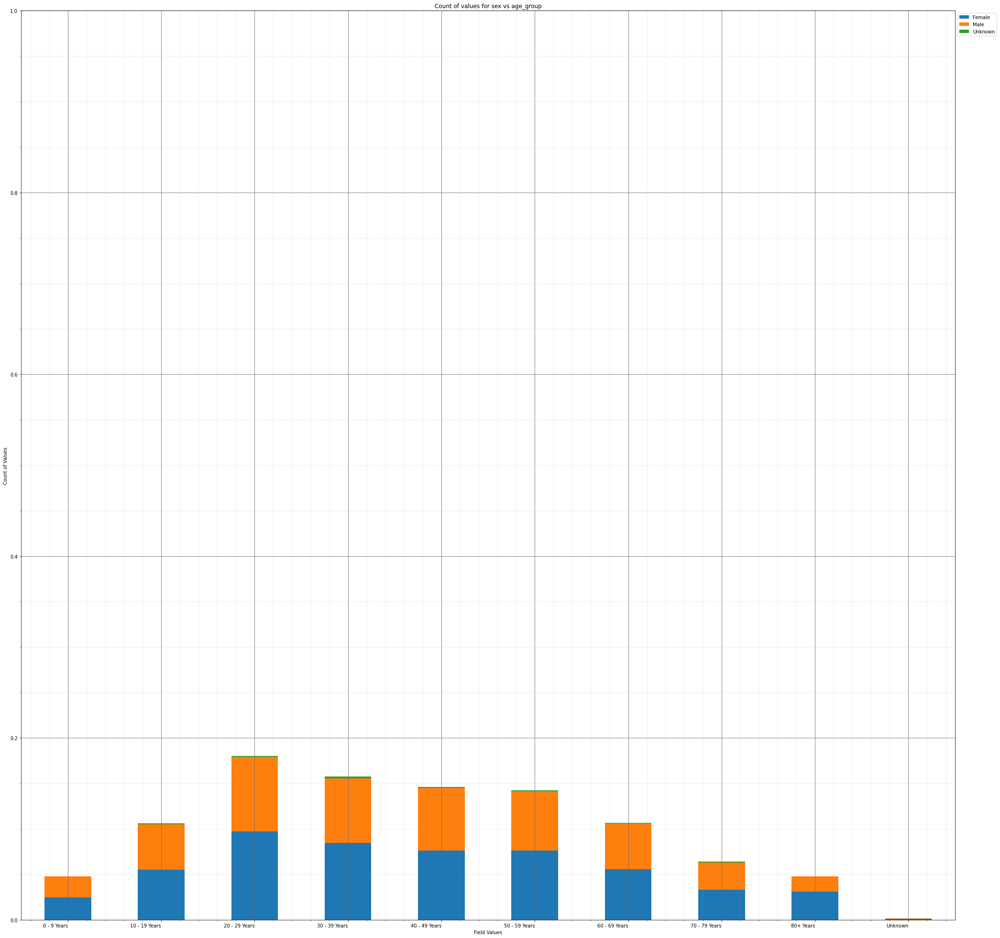



----------------------


Grouping over age_group|hosp_yn results in:



,age_group,hosp_yn,Rows,% Frequency
0,0 - 9 Years,No,259,2.712610
1,0 - 9 Years,OTH,0,0.000000
2,0 - 9 Years,Unknown,191,2.000419
3,0 - 9 Years,Yes,8,0.083787
4,10 - 19 Years,No,605,6.336406
5,10 - 19 Years,OTH,0,0.000000
6,10 - 19 Years,Unknown,399,4.178886
7,10 - 19 Years,Yes,10,0.104734
8,20 - 29 Years,No,975,10.211563
9,20 - 29 Years,OTH,0,0.000000


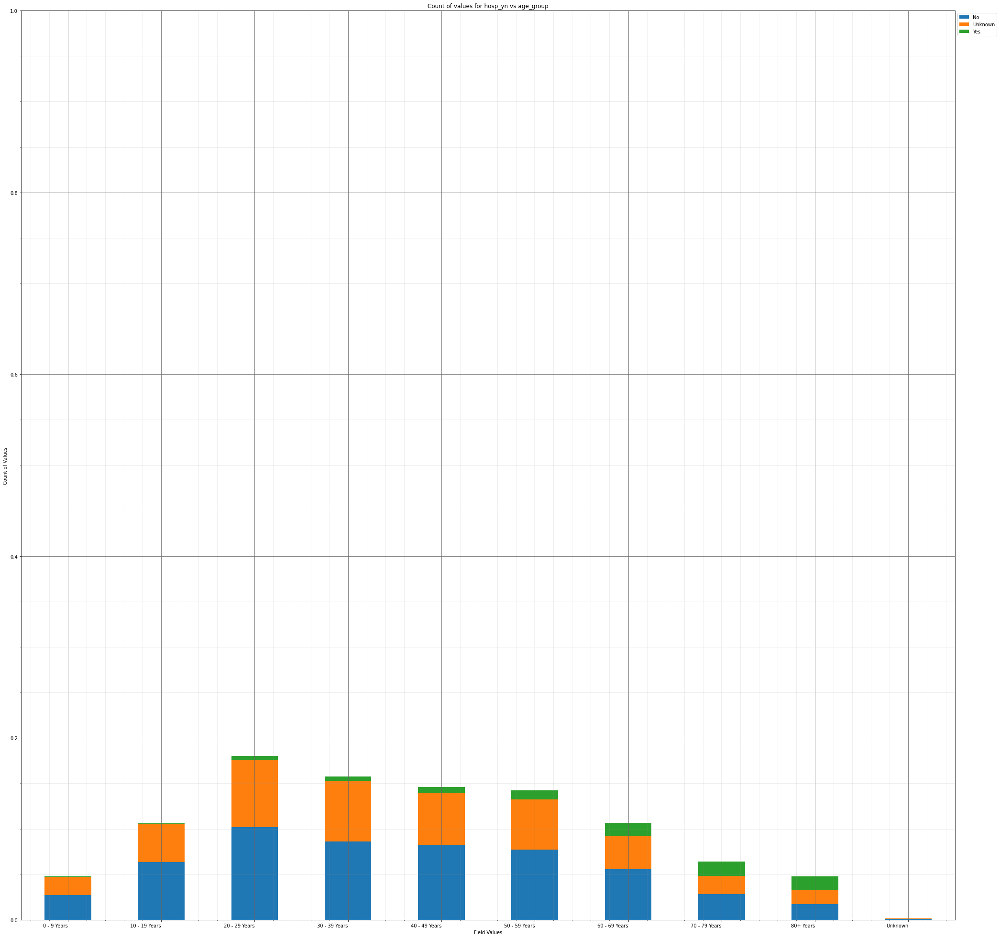



----------------------


Grouping over age_group|icu_yn results in:



,age_group,icu_yn,Rows,% Frequency
0,0 - 9 Years,No,32,0.335149
1,0 - 9 Years,Unknown,426,4.461667
2,0 - 9 Years,Yes,0,0.000000
3,10 - 19 Years,No,115,1.204441
4,10 - 19 Years,Unknown,897,9.394638
5,10 - 19 Years,Yes,2,0.020947
6,20 - 29 Years,No,167,1.749057
7,20 - 29 Years,Unknown,1551,16.244240
8,20 - 29 Years,Yes,0,0.000000
9,30 - 39 Years,No,164,1.717637


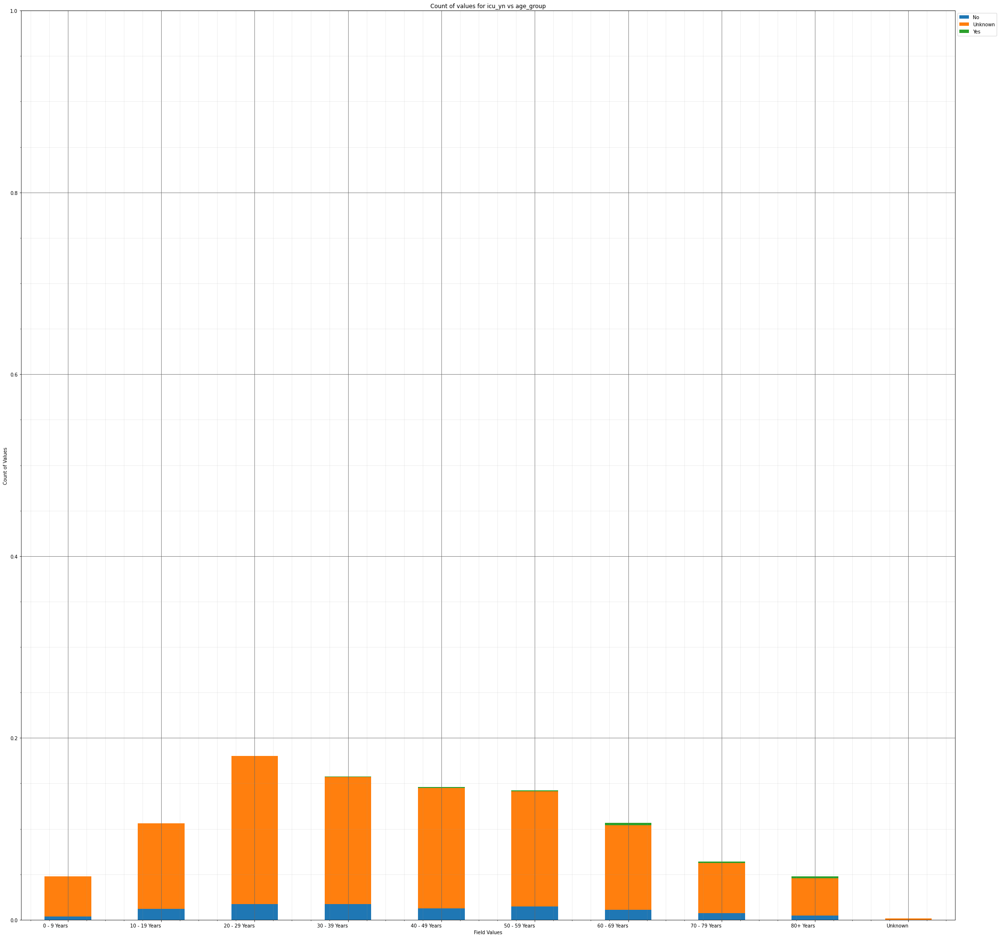



----------------------


Grouping over age_group|death_yn results in:



,age_group,death_yn,Rows,% Frequency
0,0 - 9 Years,No,458,4.796816
1,0 - 9 Years,Yes,0,0.000000
2,10 - 19 Years,No,1014,10.620025
3,10 - 19 Years,Yes,0,0.000000
4,20 - 29 Years,No,1718,17.993297
5,20 - 29 Years,Yes,0,0.000000
6,30 - 39 Years,No,1501,15.720570
7,30 - 39 Years,Yes,2,0.020947
8,40 - 49 Years,No,1384,14.495182
9,40 - 49 Years,Yes,12,0.125681


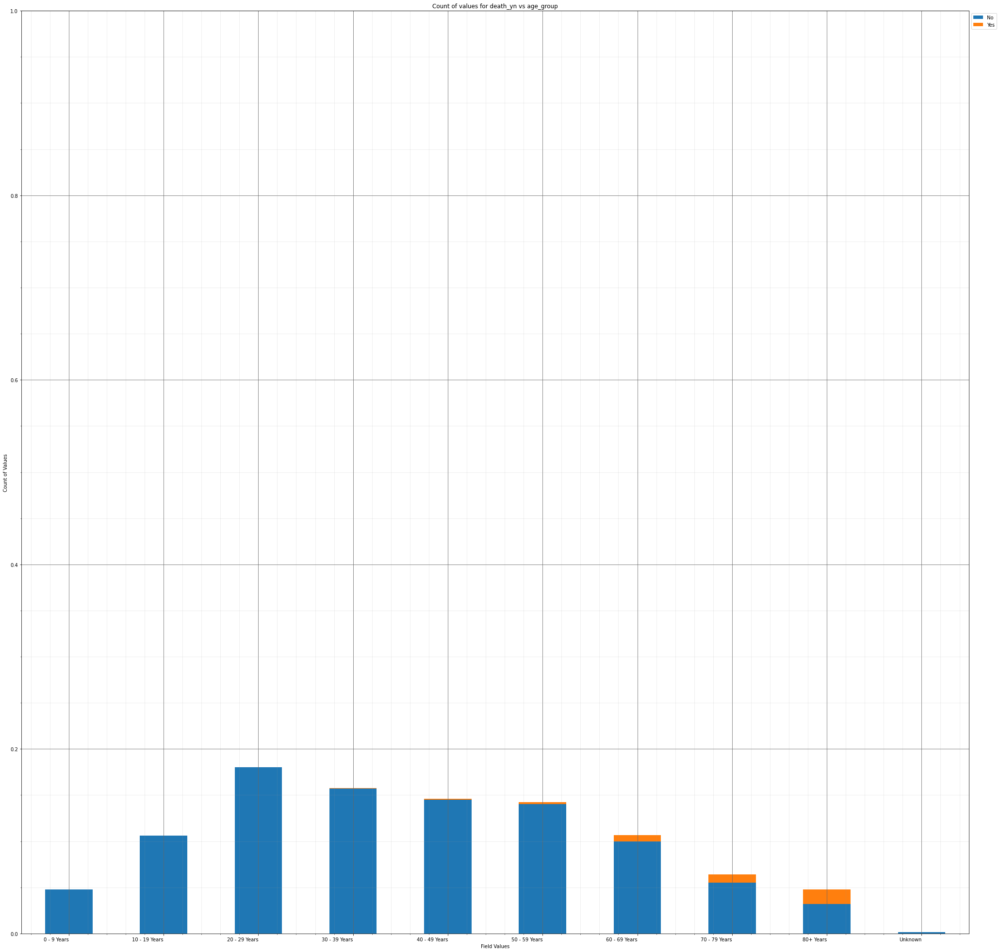



----------------------


Grouping over age_group|medcond_yn results in:



,age_group,medcond_yn,Rows,% Frequency
0,0 - 9 Years,No,52,0.544617
1,0 - 9 Years,Unknown,393,4.116045
2,0 - 9 Years,Yes,13,0.136154
3,10 - 19 Years,No,142,1.487222
4,10 - 19 Years,Unknown,839,8.787181
5,10 - 19 Years,Yes,33,0.345622
6,20 - 29 Years,No,221,2.314621
7,20 - 29 Years,Unknown,1414,14.809384
8,20 - 29 Years,Yes,83,0.869292
9,30 - 39 Years,No,172,1.801424


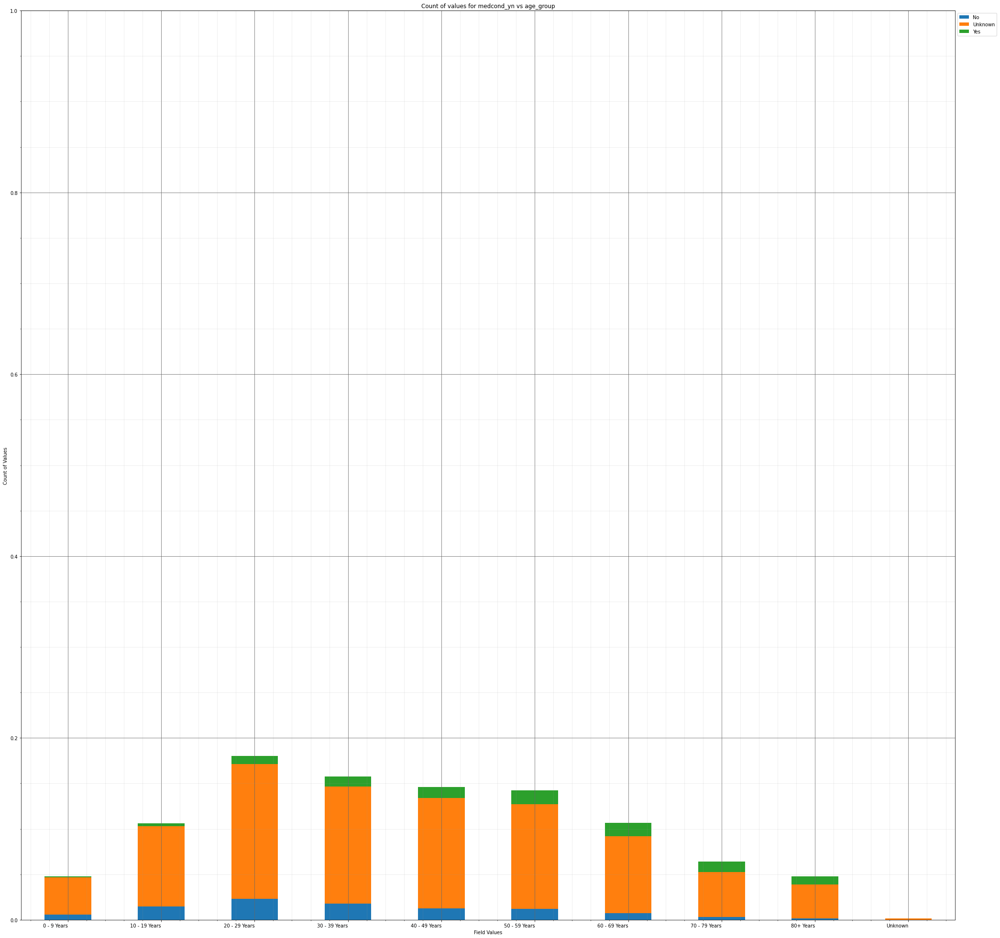



----------------------


Grouping over age_group|race results in:



,age_group,race,Rows,% Frequency
0,0 - 9 Years,American Indian/Alaska Native,4,0.041894
1,0 - 9 Years,Asian,12,0.125681
2,0 - 9 Years,Black,29,0.303729
3,0 - 9 Years,Hispanic/Latino,53,0.555090
4,0 - 9 Years,Multiple/Other,37,0.387516
...,...,...,...,...
75,Unknown,Hispanic/Latino,0,0.000000
76,Unknown,Multiple/Other,2,0.020947
77,Unknown,Native Hawaiian/Other Pacific Islander,0,0.000000
78,Unknown,Unknown,11,0.115207


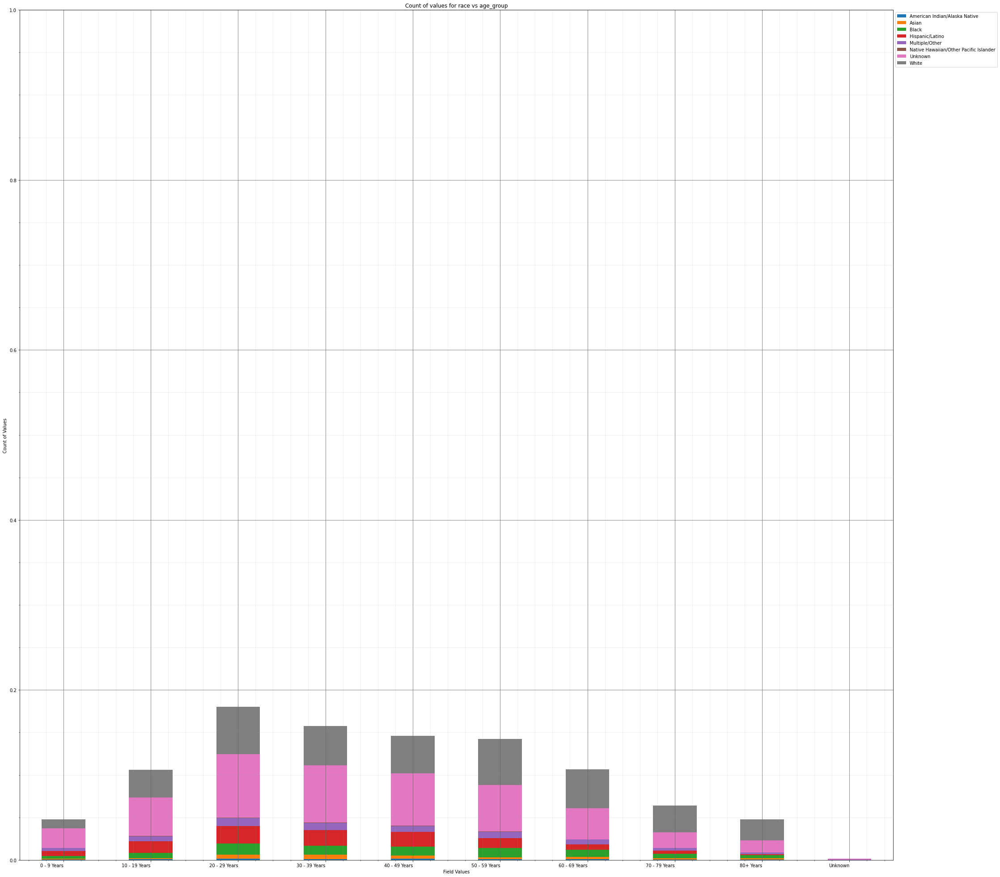



----------------------


Grouping over age_group|cdc_case_earliest_day results in:



,age_group,cdc_case_earliest_day,Rows,% Frequency
0,0 - 9 Years,1,9,0.094261
1,0 - 9 Years,2,13,0.136154
2,0 - 9 Years,3,10,0.104734
3,0 - 9 Years,4,15,0.157101
4,0 - 9 Years,5,18,0.188521
...,...,...,...,...
305,Unknown,27,1,0.010473
306,Unknown,28,1,0.010473
307,Unknown,29,1,0.010473
308,Unknown,30,1,0.010473


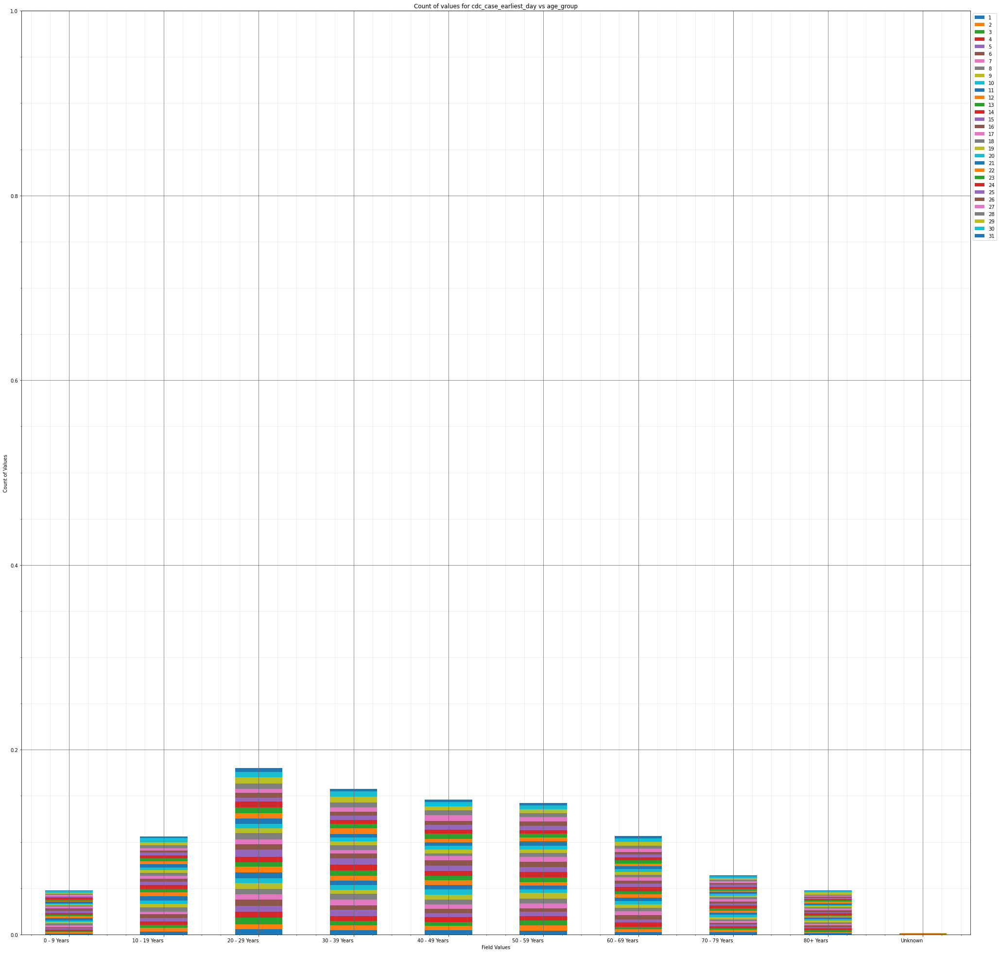



----------------------


Grouping over age_group|cdc_case_earliest_weekday results in:



,age_group,cdc_case_earliest_weekday,Rows,% Frequency
0,0 - 9 Years,0,91,0.953079
1,0 - 9 Years,1,70,0.733138
2,0 - 9 Years,2,70,0.733138
3,0 - 9 Years,3,68,0.712191
4,0 - 9 Years,4,68,0.712191
...,...,...,...,...
65,Unknown,2,1,0.010473
66,Unknown,3,1,0.010473
67,Unknown,4,3,0.031420
68,Unknown,5,2,0.020947


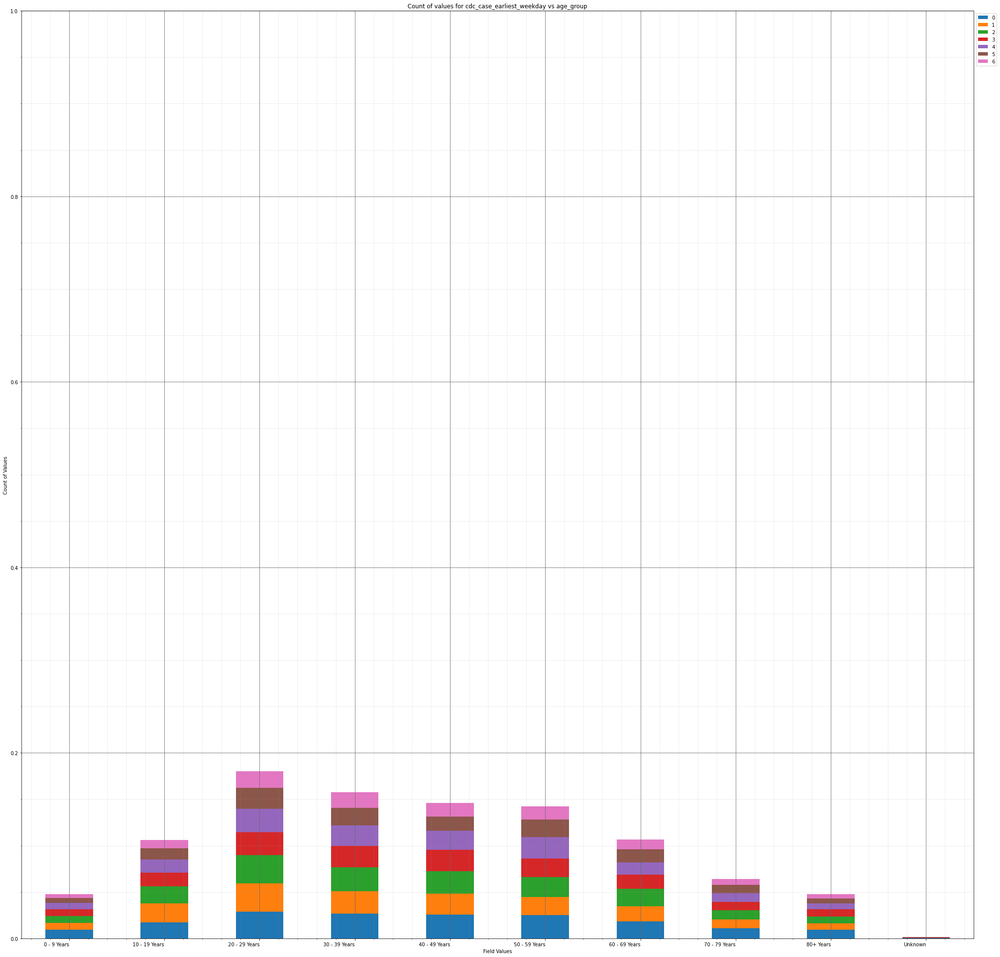



----------------------


Grouping over age_group|cdc_case_earliest_month results in:



,age_group,cdc_case_earliest_month,Rows,% Frequency
0,0 - 9 Years,1,68,0.712191
1,0 - 9 Years,2,0,0.000000
2,0 - 9 Years,3,3,0.031420
3,0 - 9 Years,4,8,0.083787
4,0 - 9 Years,5,10,0.104734
...,...,...,...,...
115,Unknown,8,0,0.000000
116,Unknown,9,1,0.010473
117,Unknown,10,2,0.020947
118,Unknown,11,3,0.031420


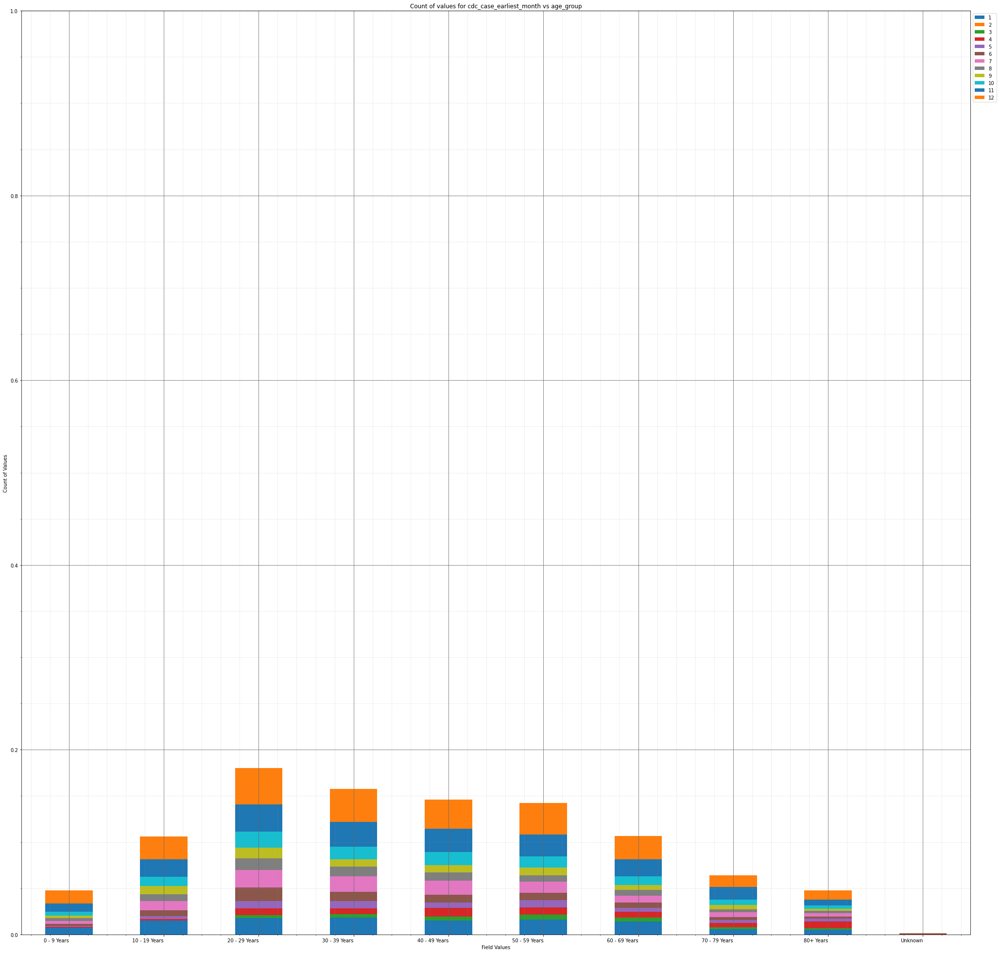



----------------------


Grouping over age_group|cdc_case_earliest_year results in:



,age_group,cdc_case_earliest_year,Rows,% Frequency
0,0 - 9 Years,2020,391,4.095098
1,0 - 9 Years,2021,67,0.701718
2,10 - 19 Years,2020,871,9.122329
3,10 - 19 Years,2021,143,1.497696
4,20 - 29 Years,2020,1548,16.212819
5,20 - 29 Years,2021,170,1.780478
6,30 - 39 Years,2020,1328,13.908672
7,30 - 39 Years,2021,175,1.832845
8,40 - 49 Years,2020,1253,13.123167
9,40 - 49 Years,2021,143,1.497696


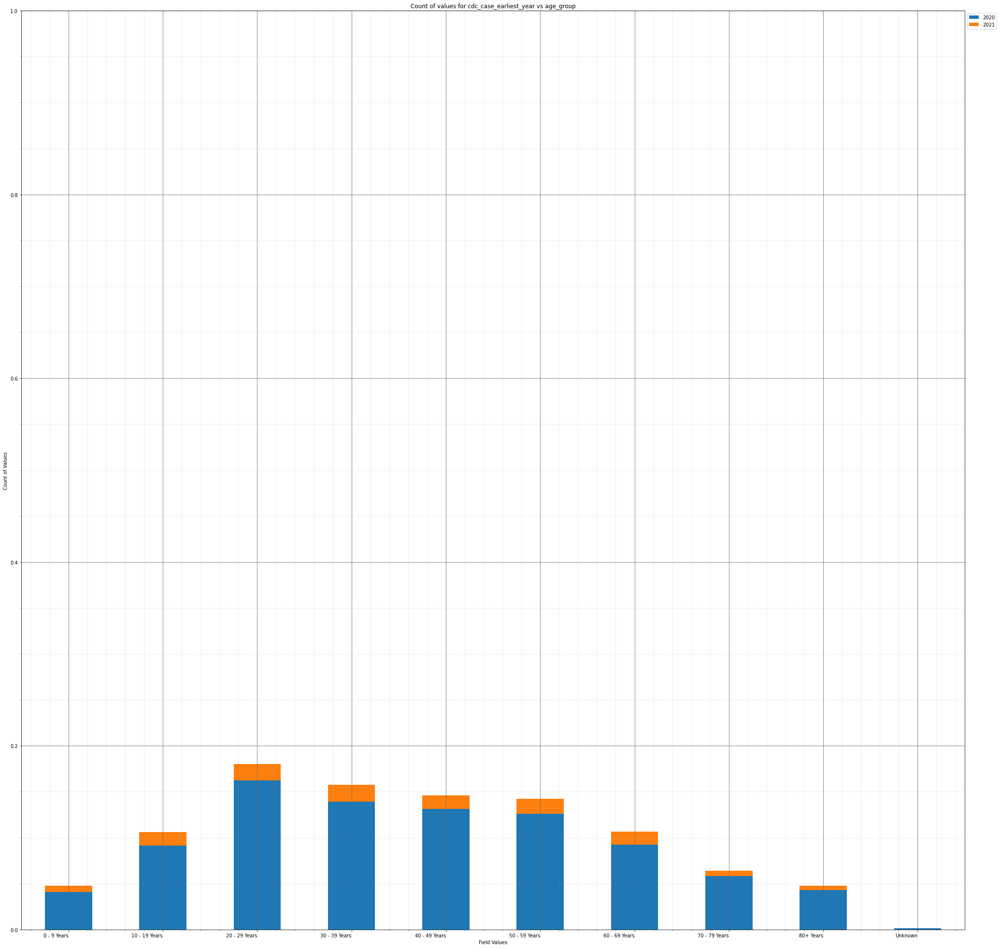



----------------------


Grouping over age_group|demographic_missing results in:



,age_group,demographic_missing,Rows,% Frequency
0,0 - 9 Years,False,238,2.492669
1,0 - 9 Years,True,220,2.304147
2,10 - 19 Years,False,575,6.022204
3,10 - 19 Years,True,439,4.597822
4,20 - 29 Years,False,1000,10.473398
5,20 - 29 Years,True,718,7.519899
6,30 - 39 Years,False,854,8.944282
7,30 - 39 Years,True,649,6.797235
8,40 - 49 Years,False,806,8.441558
9,40 - 49 Years,True,590,6.179305


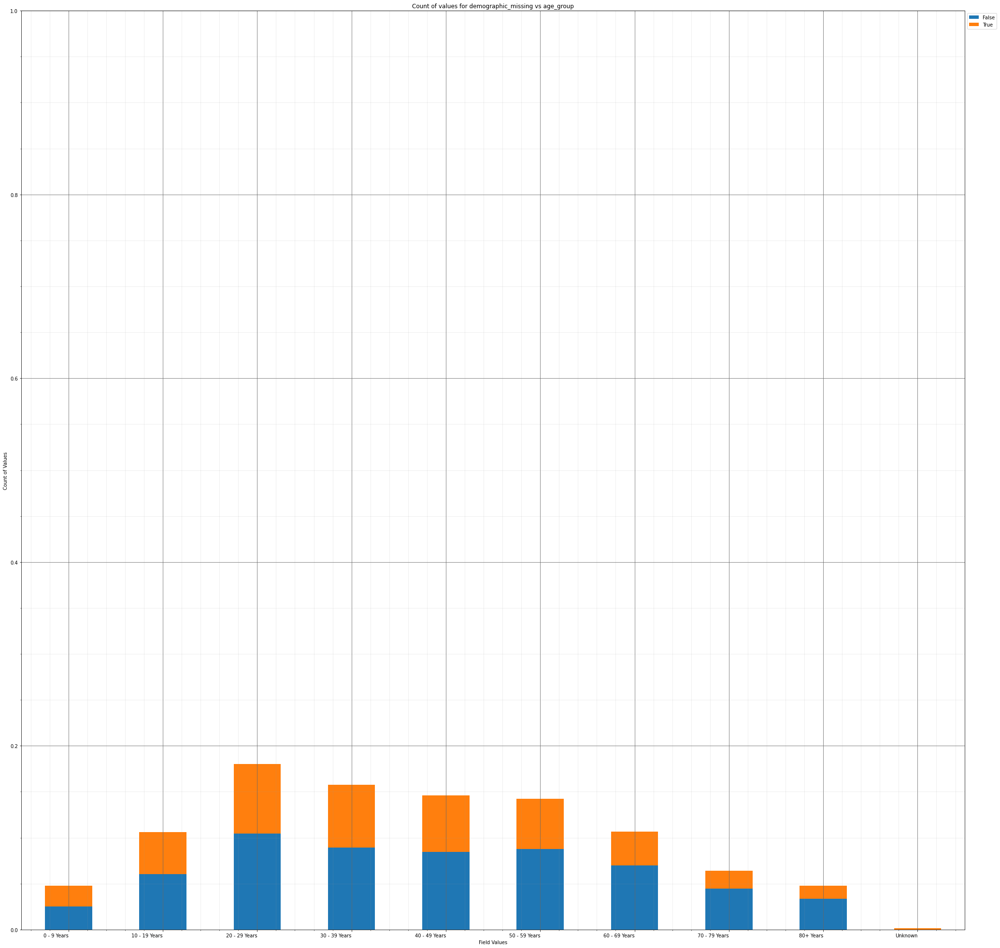



----------------------


Grouping over age_group|medical_missing results in:



,age_group,medical_missing,Rows,% Frequency
0,0 - 9 Years,False,23,0.240888
1,0 - 9 Years,True,435,4.555928
2,10 - 19 Years,False,71,0.743611
3,10 - 19 Years,True,943,9.876414
4,20 - 29 Years,False,111,1.162547
5,20 - 29 Years,True,1607,16.830750
6,30 - 39 Years,False,124,1.298701
7,30 - 39 Years,True,1379,14.442815
8,40 - 49 Years,False,87,0.911186
9,40 - 49 Years,True,1309,13.709677


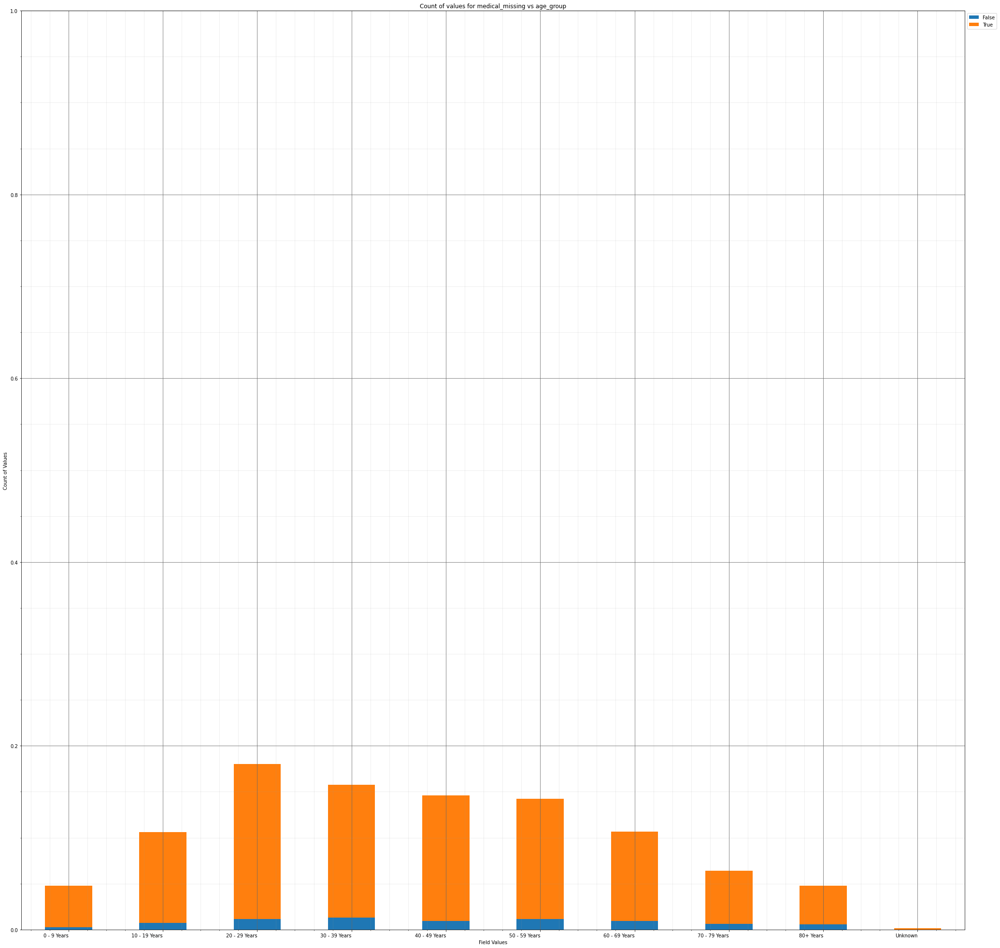



----------------------


Grouping over hosp_yn|current_status results in:



,hosp_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,4811,50.387516
1,No,Probable Case,345,3.613322
2,OTH,Laboratory-confirmed case,0,0.000000
3,OTH,Probable Case,0,0.000000
4,Unknown,Laboratory-confirmed case,3619,37.903226
5,Unknown,Probable Case,76,0.795978
6,Yes,Laboratory-confirmed case,676,7.080017
7,Yes,Probable Case,21,0.219941


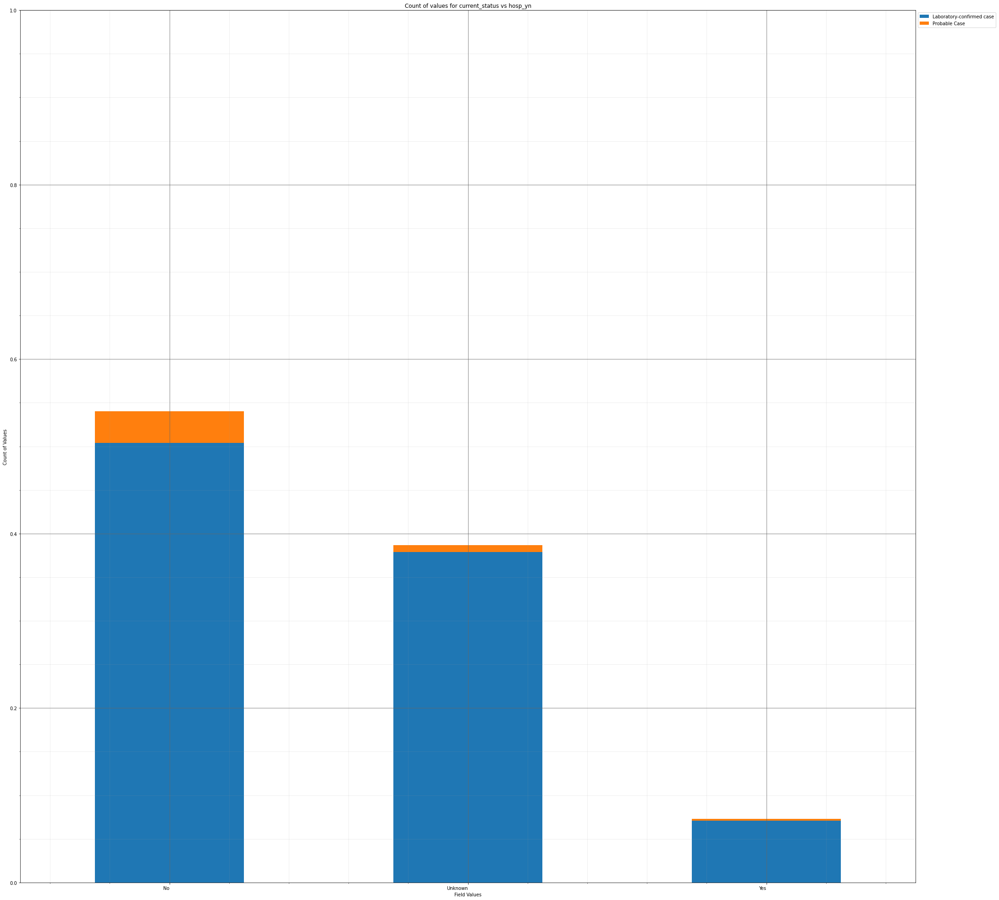



----------------------


Grouping over hosp_yn|sex results in:



,hosp_yn,sex,Rows,% Frequency
0,No,Female,2824,29.576875
1,No,Male,2305,24.141181
2,No,Unknown,27,0.282782
3,OTH,Female,0,0.000000
4,OTH,Male,0,0.000000
5,OTH,Unknown,0,0.000000
6,Unknown,Female,1919,20.098450
7,Unknown,Male,1721,18.024717
8,Unknown,Unknown,55,0.576037
9,Yes,Female,346,3.623796


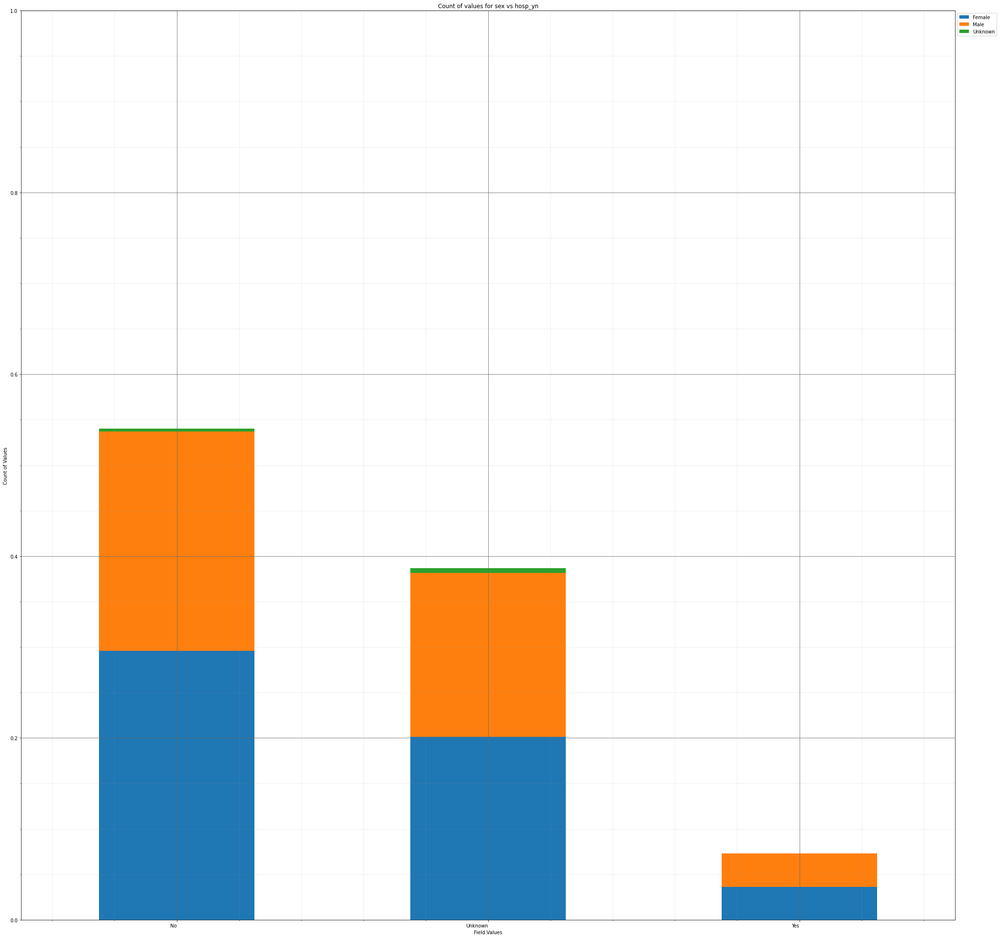



----------------------


Grouping over hosp_yn|age_group results in:



,hosp_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,259,2.712610
1,No,10 - 19 Years,605,6.336406
2,No,20 - 29 Years,975,10.211563
3,No,30 - 39 Years,821,8.598659
4,No,40 - 49 Years,786,8.232090
5,No,50 - 59 Years,738,7.729367
6,No,60 - 69 Years,531,5.561374
7,No,70 - 79 Years,268,2.806871
8,No,80+ Years,163,1.707164
9,No,Unknown,10,0.104734


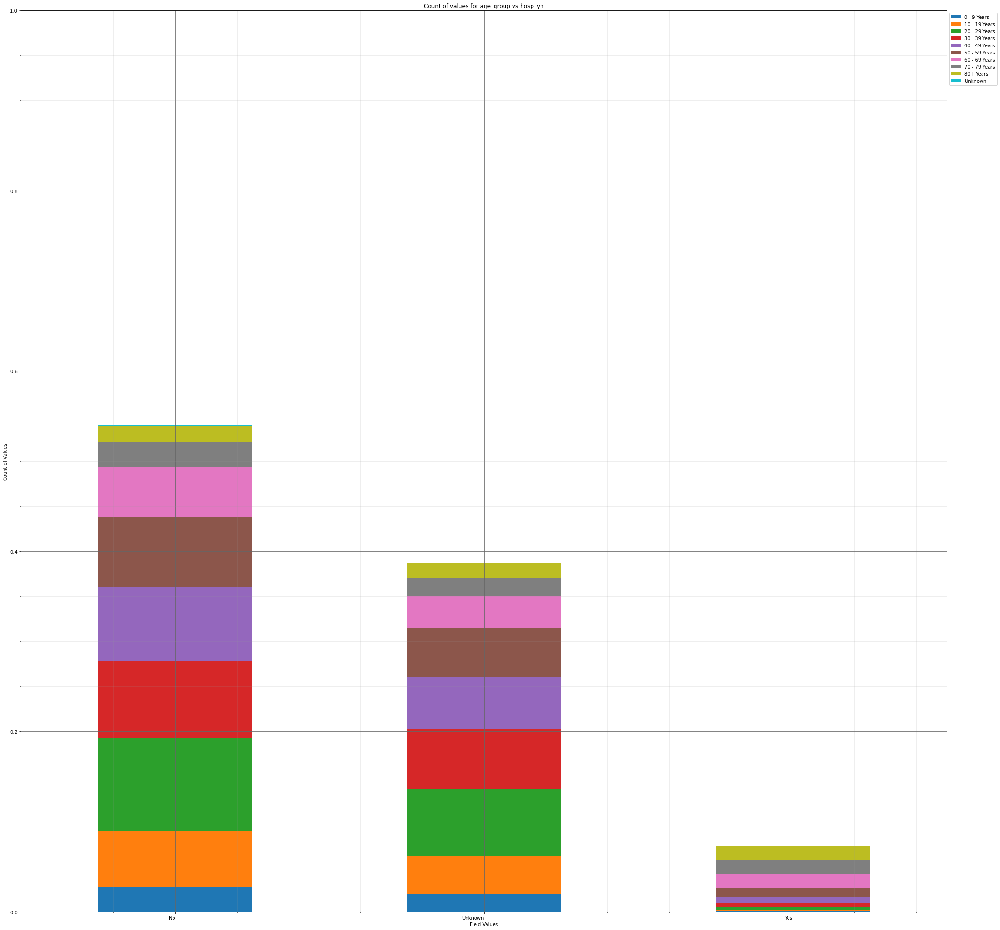



----------------------


Grouping over hosp_yn|icu_yn results in:



,hosp_yn,icu_yn,Rows,% Frequency
0,No,No,790,8.273984
1,No,Unknown,4366,45.726854
2,No,Yes,0,0.000000
3,OTH,No,0,0.000000
4,OTH,Unknown,0,0.000000
5,OTH,Yes,0,0.000000
6,Unknown,No,27,0.282782
7,Unknown,Unknown,3668,38.416422
8,Unknown,Yes,0,0.000000
9,Yes,No,132,1.382488


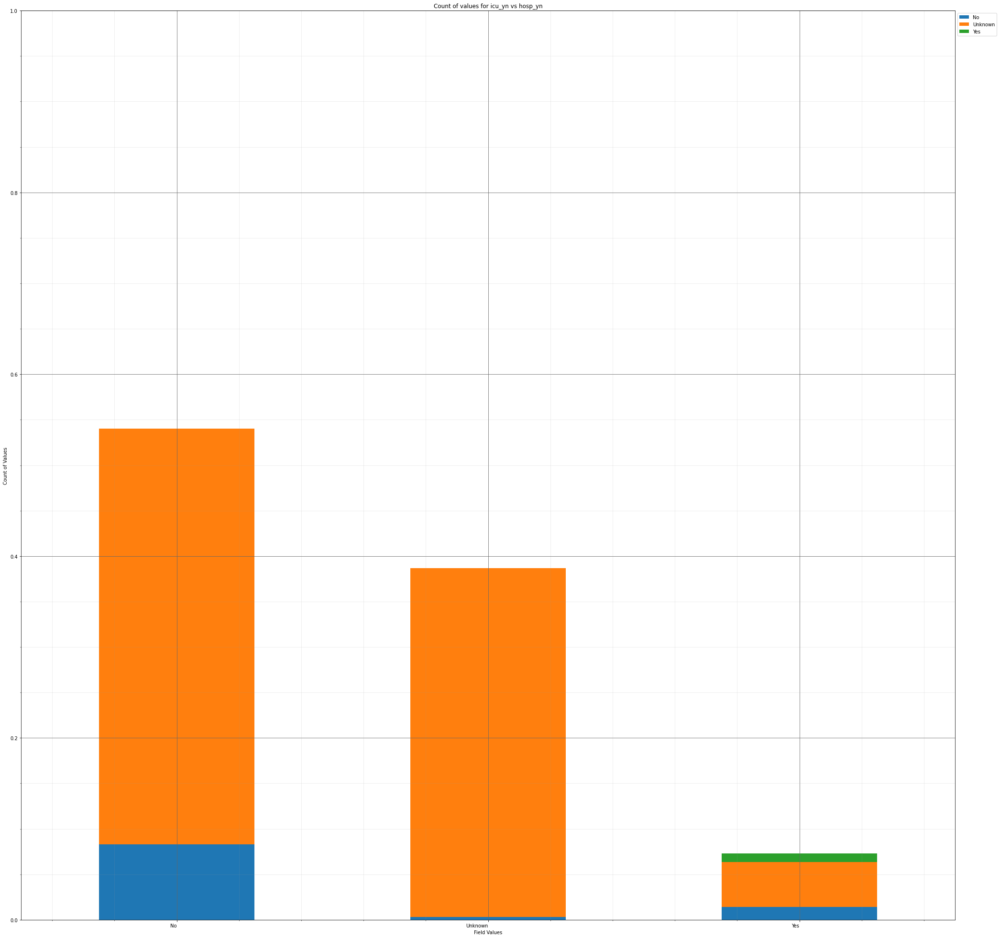



----------------------


Grouping over hosp_yn|death_yn results in:



,hosp_yn,death_yn,Rows,% Frequency
0,No,No,5110,53.519062
1,No,Yes,46,0.481776
2,OTH,No,0,0.000000
3,OTH,Yes,0,0.000000
4,Unknown,No,3614,37.850859
5,Unknown,Yes,81,0.848345
6,Yes,No,492,5.152912
7,Yes,Yes,205,2.147047


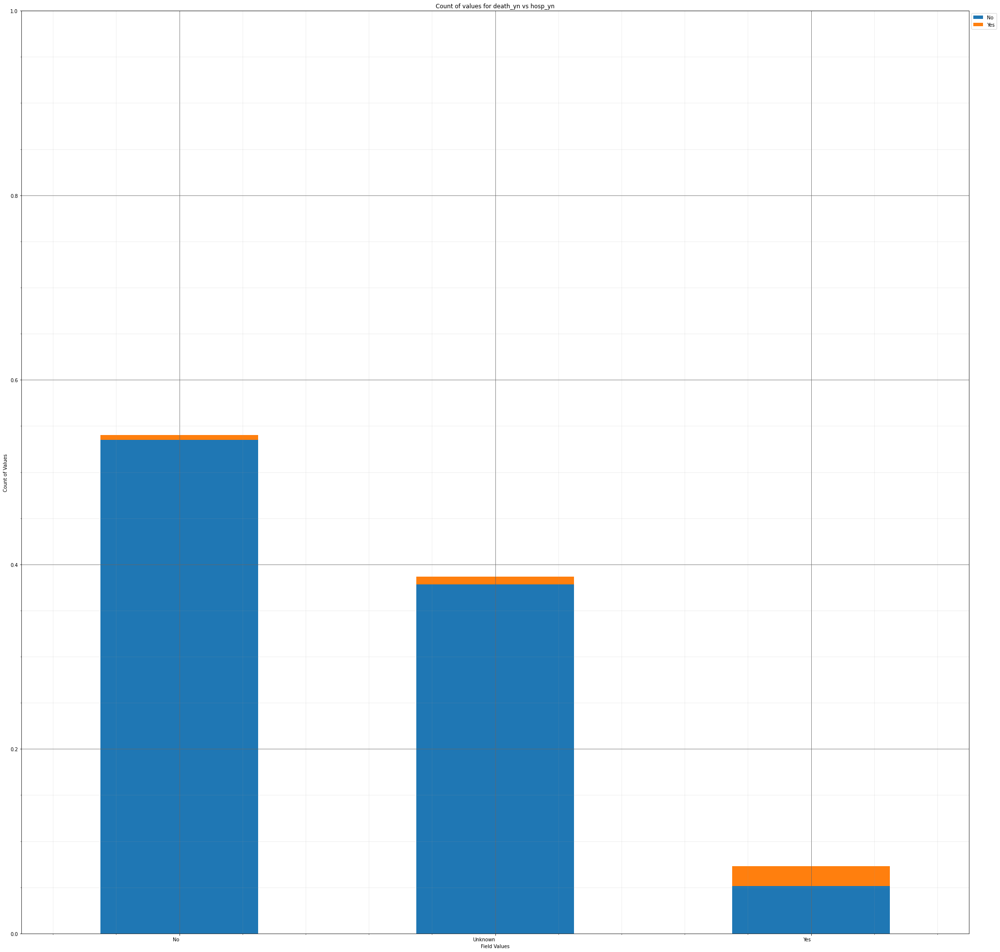



----------------------


Grouping over hosp_yn|medcond_yn results in:



,hosp_yn,medcond_yn,Rows,% Frequency
0,No,No,691,7.237118
1,No,Unknown,3914,40.992878
2,No,Yes,551,5.770842
3,OTH,No,0,0.000000
4,OTH,Unknown,0,0.000000
5,OTH,Yes,0,0.000000
6,Unknown,No,202,2.115626
7,Unknown,Unknown,3390,35.504818
8,Unknown,Yes,103,1.078760
9,Yes,No,33,0.345622


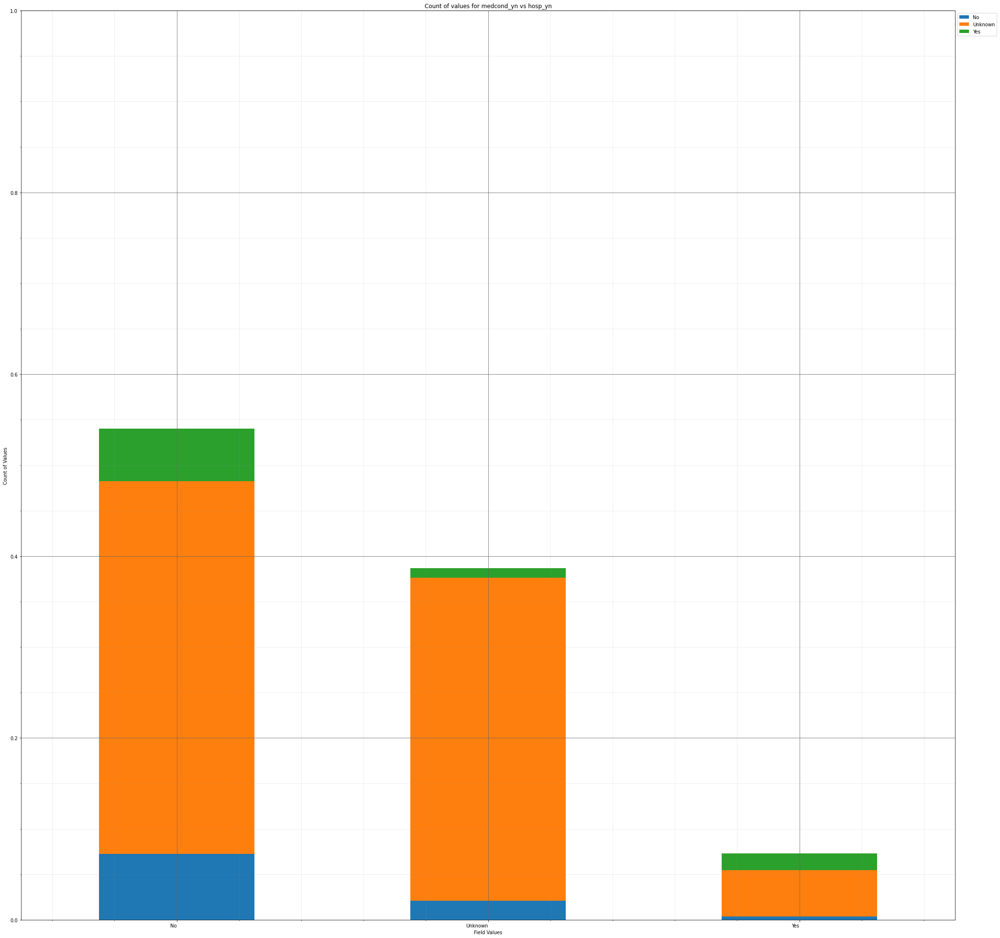



----------------------


Grouping over hosp_yn|race results in:



,hosp_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,39,0.408463
1,No,Asian,113,1.183494
2,No,Black,438,4.587348
3,No,Hispanic/Latino,704,7.373272
4,No,Multiple/Other,267,2.796397
5,No,Native Hawaiian/Other Pacific Islander,12,0.125681
6,No,Unknown,1391,14.568496
7,No,White,2192,22.957687
8,OTH,American Indian/Alaska Native,0,0.000000
9,OTH,Asian,0,0.000000


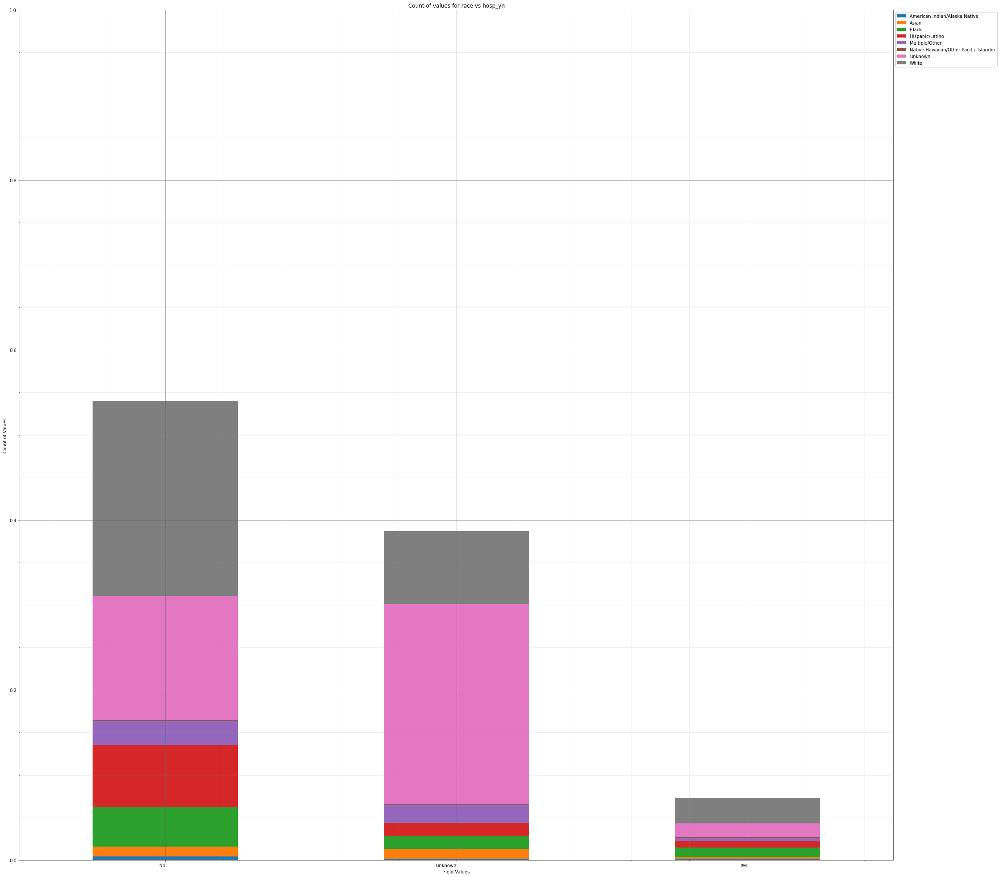



----------------------


Grouping over hosp_yn|cdc_case_earliest_day results in:



,hosp_yn,cdc_case_earliest_day,Rows,% Frequency
0,No,1,150,1.571010
1,No,2,180,1.885212
2,No,3,167,1.749057
3,No,4,175,1.832845
4,No,5,174,1.822371
...,...,...,...,...
119,Yes,27,33,0.345622
120,Yes,28,19,0.198995
121,Yes,29,19,0.198995
122,Yes,30,31,0.324675


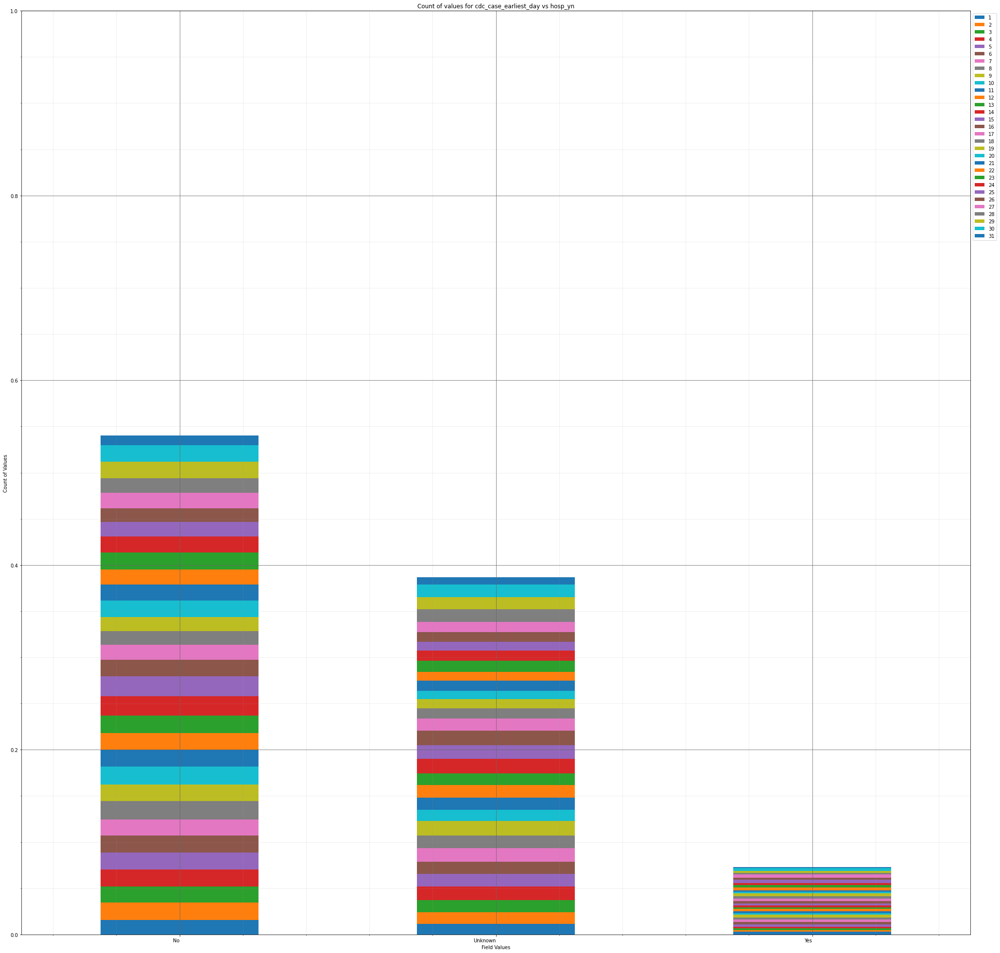



----------------------


Grouping over hosp_yn|cdc_case_earliest_weekday results in:



,hosp_yn,cdc_case_earliest_weekday,Rows,% Frequency
0,No,0,881,9.227063
1,No,1,811,8.493925
2,No,2,834,8.734814
3,No,3,718,7.519899
4,No,4,719,7.530373
5,No,5,625,6.545873
6,No,6,568,5.948890
7,OTH,0,0,0.000000
8,OTH,1,0,0.000000
9,OTH,2,0,0.000000


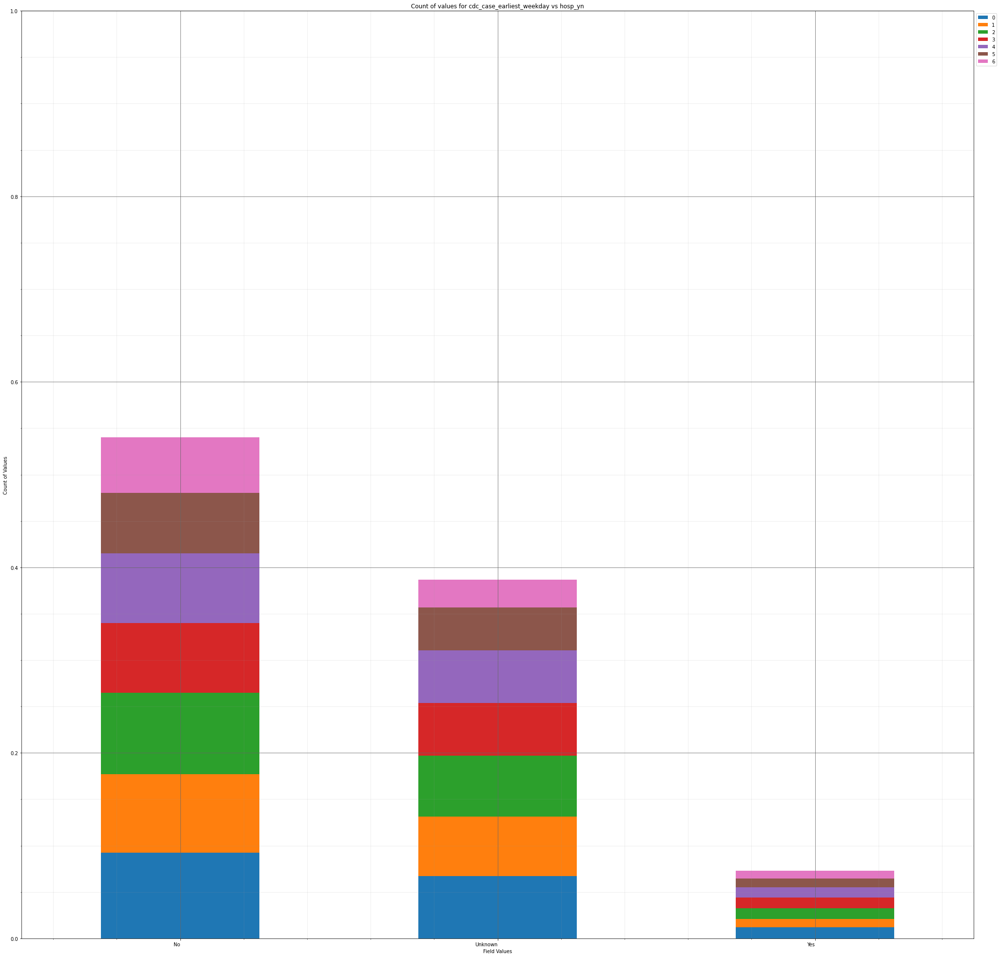



----------------------


Grouping over hosp_yn|cdc_case_earliest_month results in:



,hosp_yn,cdc_case_earliest_month,Rows,% Frequency
0,No,1,463,4.849183
1,No,2,1,0.010473
2,No,3,108,1.131127
3,No,4,225,2.356514
4,No,5,206,2.157520
5,No,6,361,3.780897
6,No,7,527,5.519481
7,No,8,373,3.906577
8,No,9,393,4.116045
9,No,10,558,5.844156


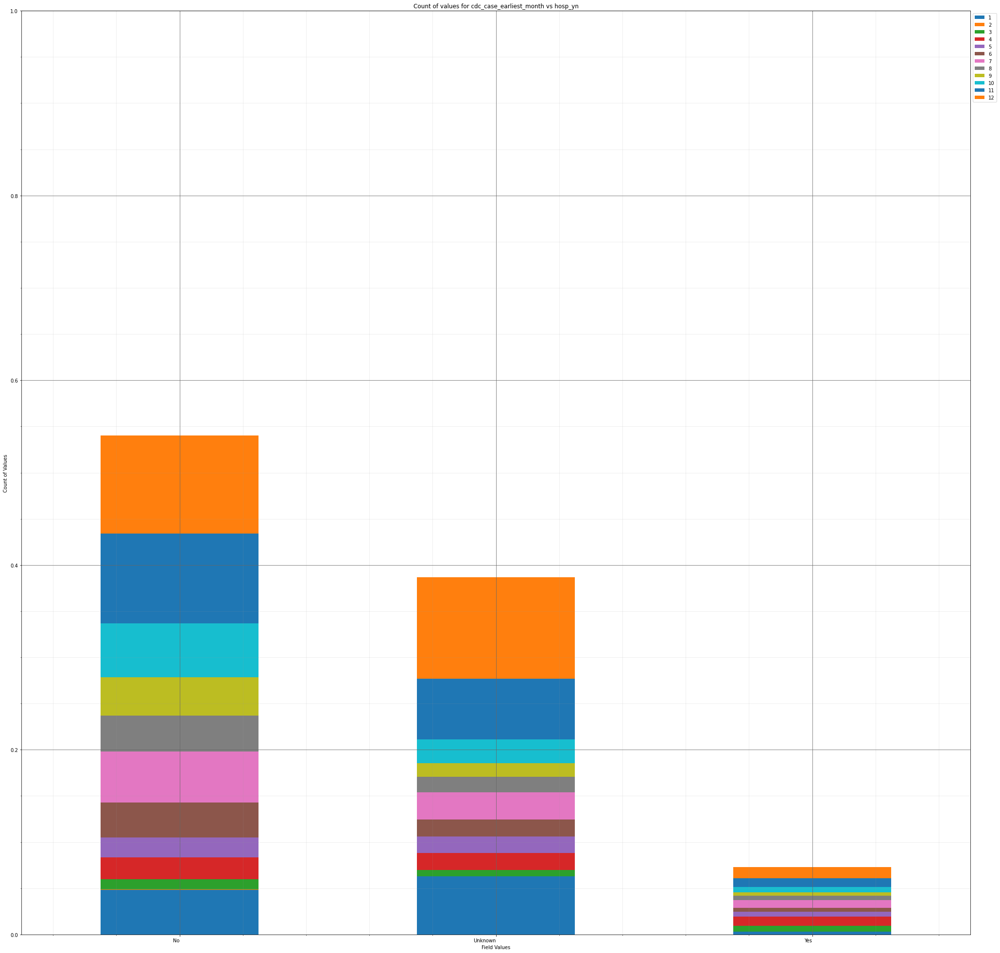



----------------------


Grouping over hosp_yn|cdc_case_earliest_year results in:



,hosp_yn,cdc_case_earliest_year,Rows,% Frequency
0,No,2020,4695,49.172602
1,No,2021,461,4.828236
2,OTH,2020,0,0.000000
3,OTH,2021,0,0.000000
4,Unknown,2020,3094,32.404692
5,Unknown,2021,601,6.294512
6,Yes,2020,670,7.017176
7,Yes,2021,27,0.282782


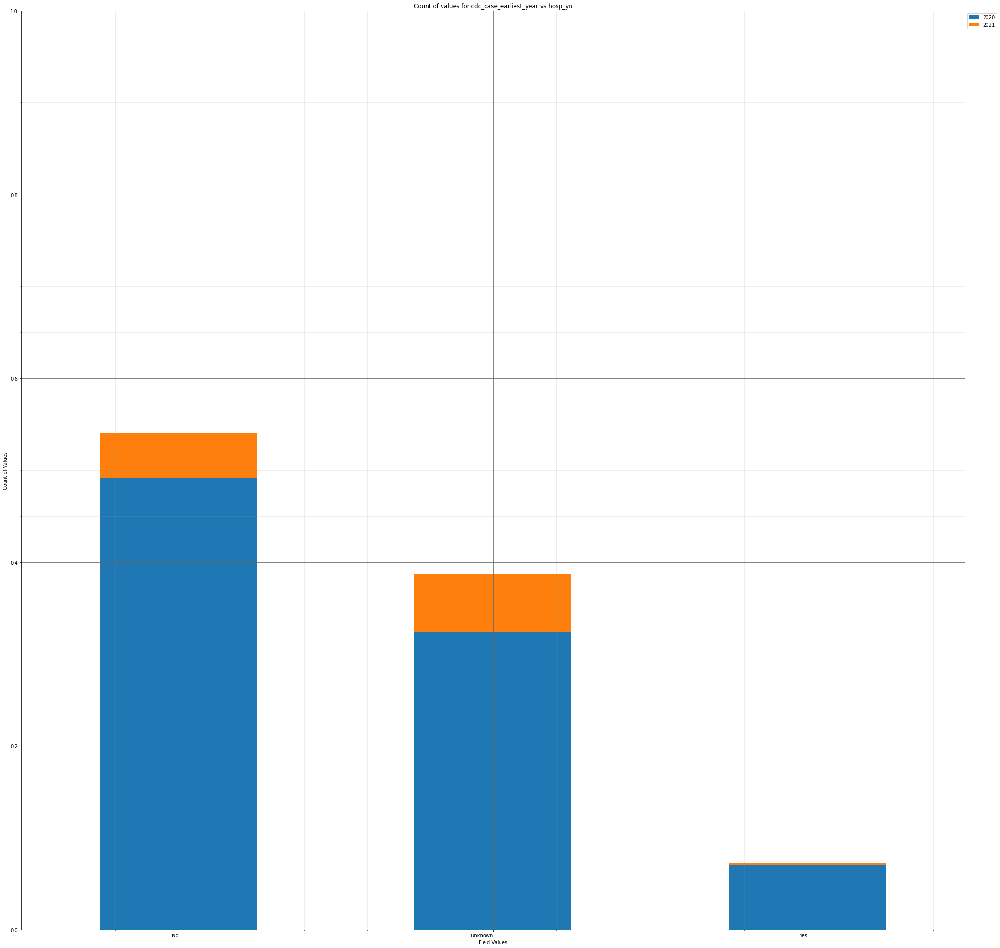



----------------------


Grouping over hosp_yn|demographic_missing results in:



,hosp_yn,demographic_missing,Rows,% Frequency
0,No,False,3744,39.212401
1,No,True,1412,14.788437
2,OTH,False,0,0.000000
3,OTH,True,0,0.000000
4,Unknown,False,1440,15.081693
5,Unknown,True,2255,23.617512
6,Yes,False,540,5.655635
7,Yes,True,157,1.644323


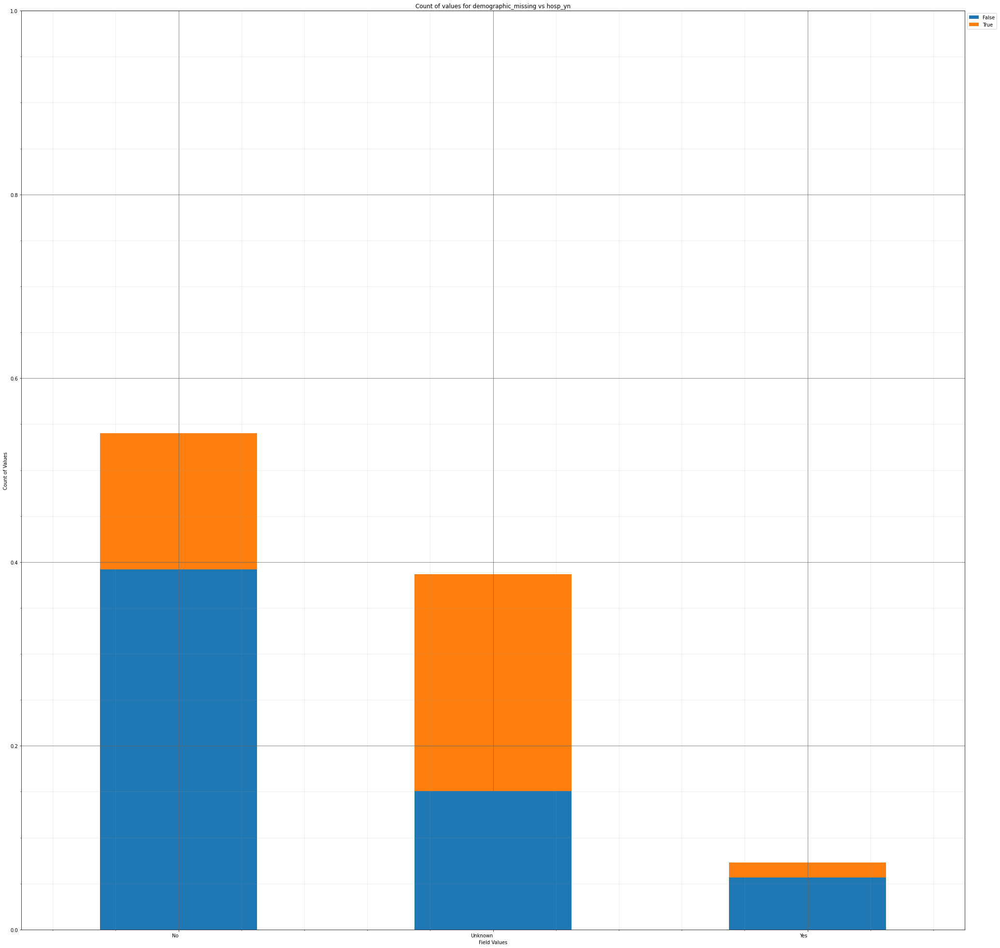



----------------------


Grouping over hosp_yn|medical_missing results in:



,hosp_yn,medical_missing,Rows,% Frequency
0,No,False,591,6.189778
1,No,True,4565,47.811060
2,OTH,False,0,0.000000
3,OTH,True,0,0.000000
4,Unknown,False,0,0.000000
5,Unknown,True,3695,38.699204
6,Yes,False,138,1.445329
7,Yes,True,559,5.854629


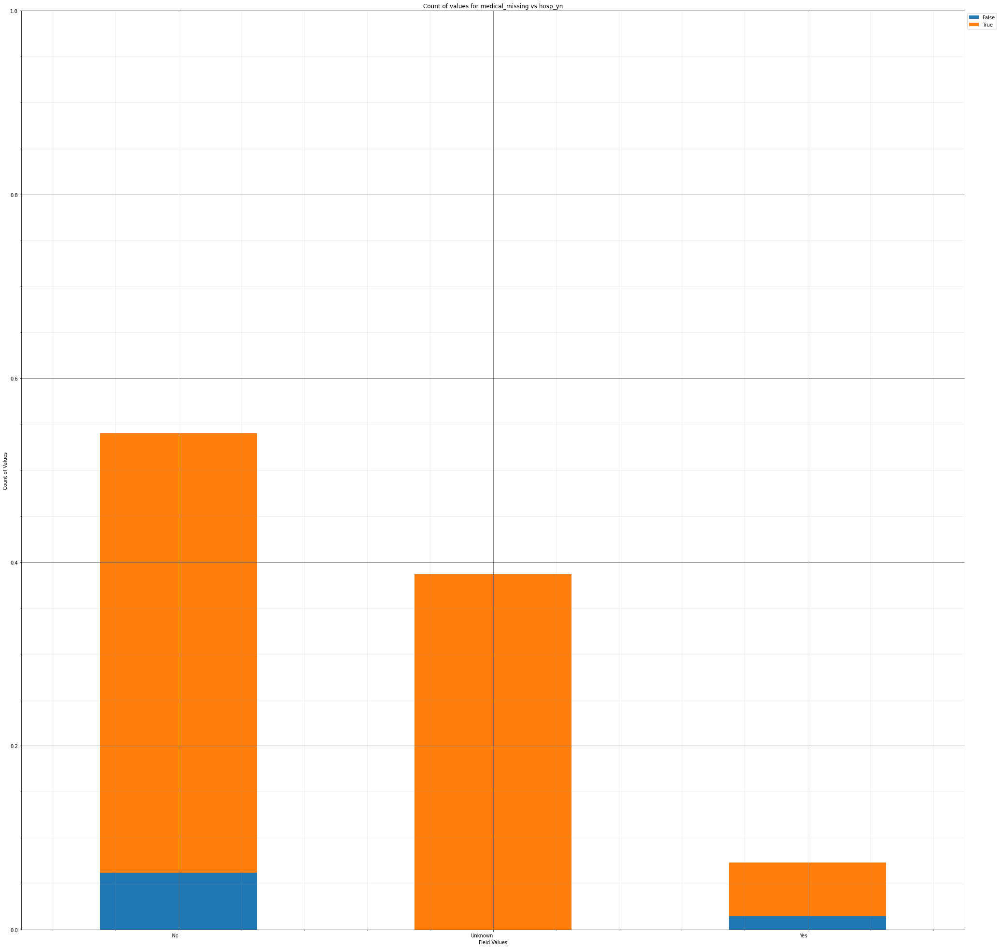



----------------------


Grouping over icu_yn|current_status results in:



,icu_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,896,9.384164
1,No,Probable Case,53,0.555090
2,Unknown,Laboratory-confirmed case,8120,85.043988
3,Unknown,Probable Case,389,4.074152
4,Yes,Laboratory-confirmed case,90,0.942606
5,Yes,Probable Case,0,0.000000


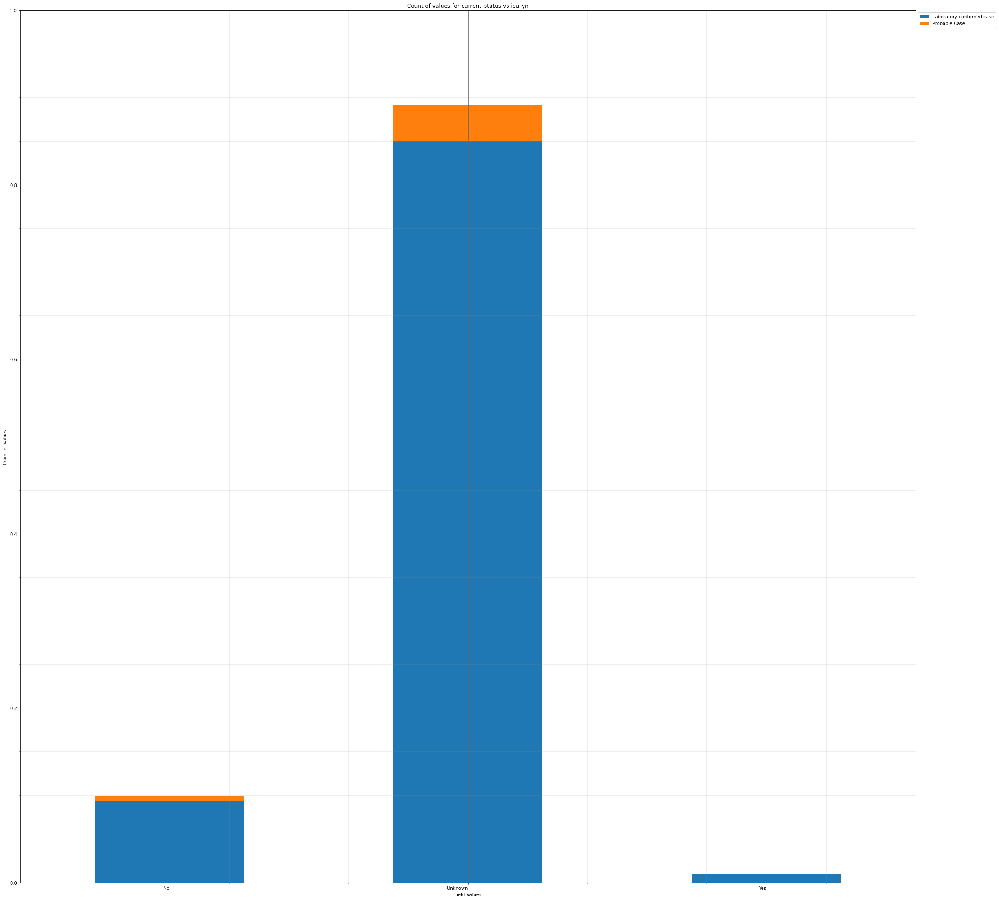



----------------------


Grouping over icu_yn|sex results in:



,icu_yn,sex,Rows,% Frequency
0,No,Female,509,5.330959
1,No,Male,436,4.566401
2,No,Unknown,4,0.041894
3,Unknown,Female,4540,47.549225
4,Unknown,Male,3891,40.751990
5,Unknown,Unknown,78,0.816925
6,Yes,Female,40,0.418936
7,Yes,Male,49,0.513196
8,Yes,Unknown,1,0.010473


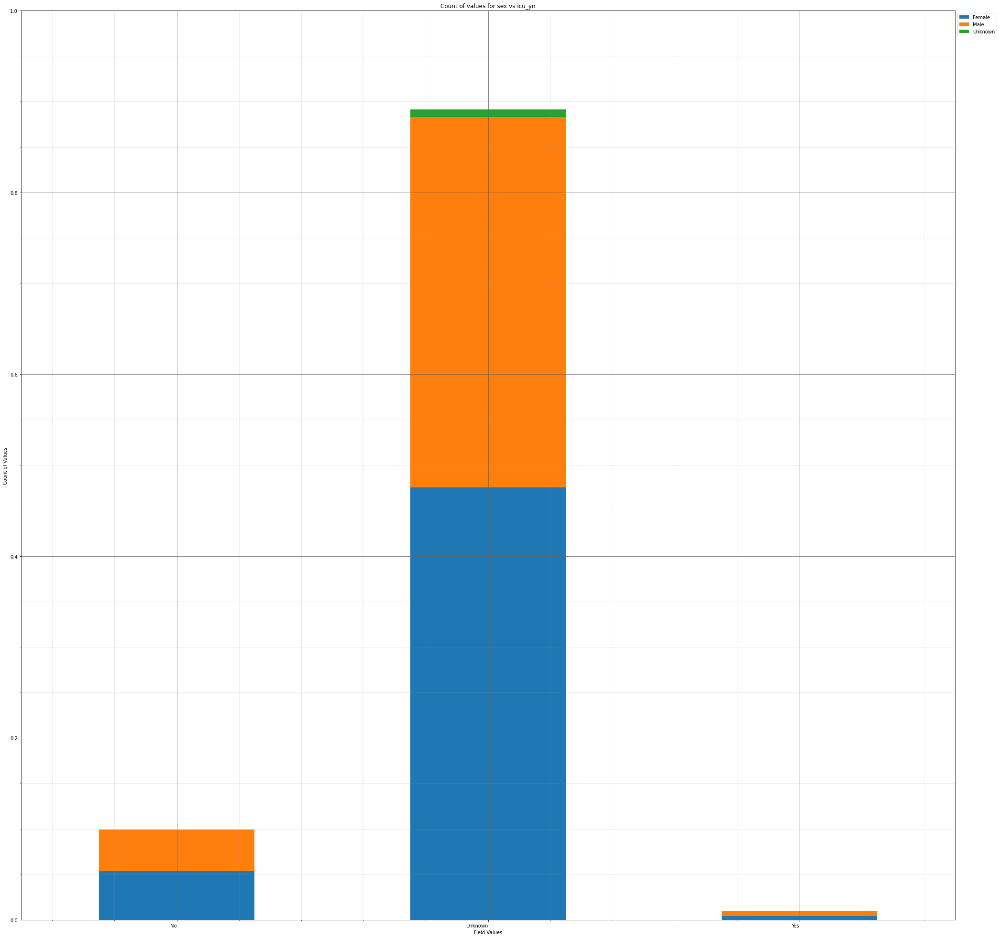



----------------------


Grouping over icu_yn|age_group results in:



,icu_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,32,0.335149
1,No,10 - 19 Years,115,1.204441
2,No,20 - 29 Years,167,1.749057
3,No,30 - 39 Years,164,1.717637
4,No,40 - 49 Years,118,1.235861
5,No,50 - 59 Years,139,1.455802
6,No,60 - 69 Years,102,1.068287
7,No,70 - 79 Years,67,0.701718
8,No,80+ Years,45,0.471303
9,No,Unknown,0,0.000000


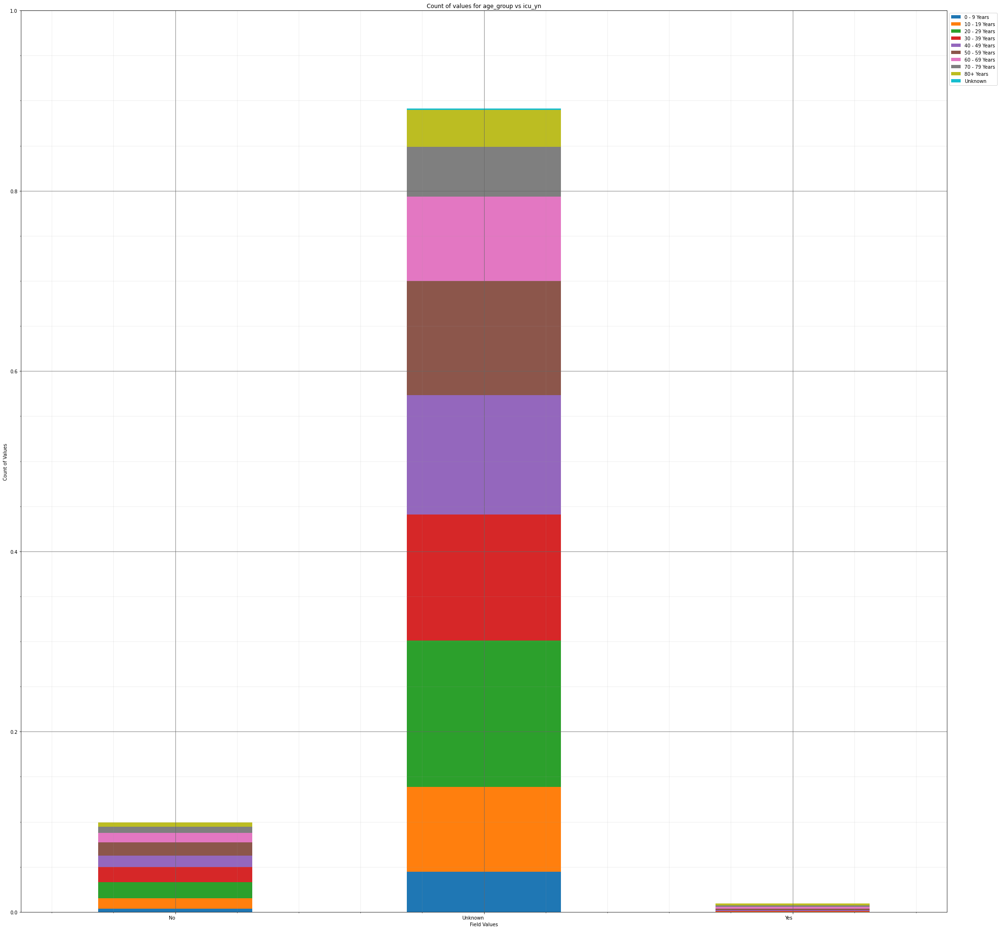



----------------------


Grouping over icu_yn|hosp_yn results in:



,icu_yn,hosp_yn,Rows,% Frequency
0,No,No,790,8.273984
1,No,OTH,0,0.000000
2,No,Unknown,27,0.282782
3,No,Yes,132,1.382488
4,Unknown,No,4366,45.726854
5,Unknown,OTH,0,0.000000
6,Unknown,Unknown,3668,38.416422
7,Unknown,Yes,475,4.974864
8,Yes,No,0,0.000000
9,Yes,OTH,0,0.000000


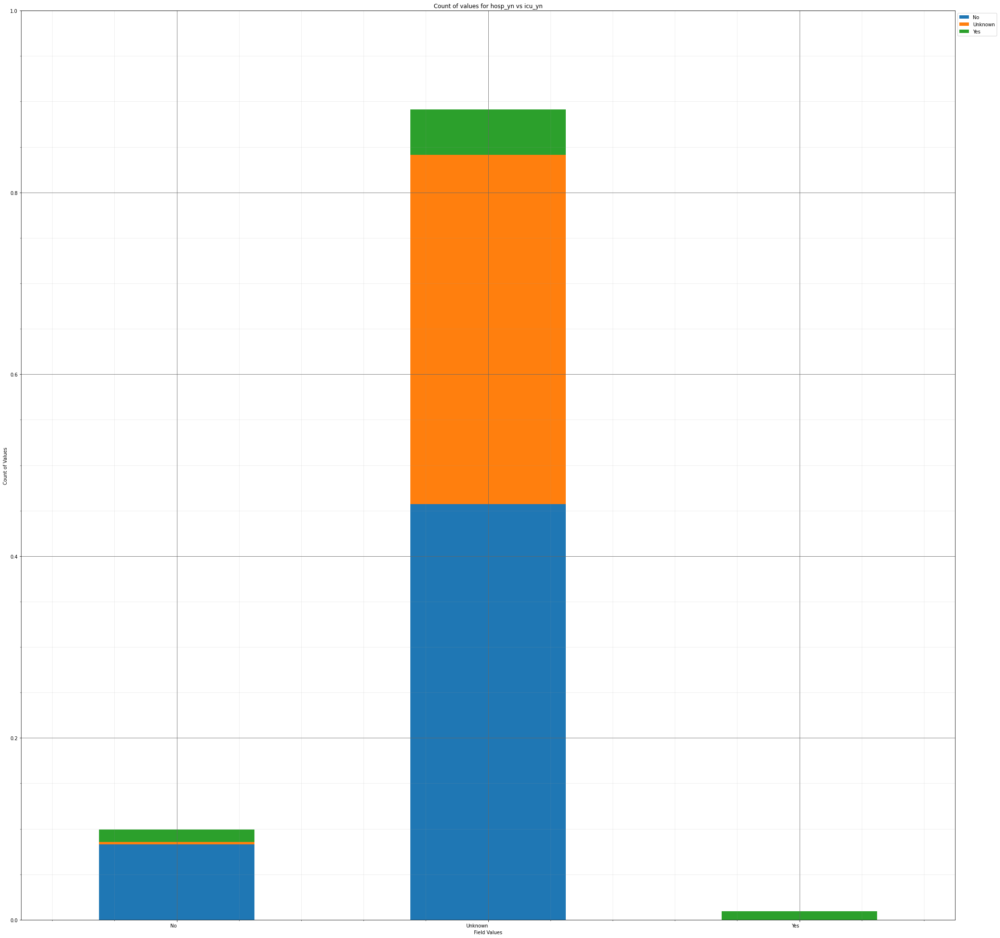



----------------------


Grouping over icu_yn|death_yn results in:



,icu_yn,death_yn,Rows,% Frequency
0,No,No,922,9.656473
1,No,Yes,27,0.282782
2,Unknown,No,8252,86.426477
3,Unknown,Yes,257,2.691663
4,Yes,No,42,0.439883
5,Yes,Yes,48,0.502723


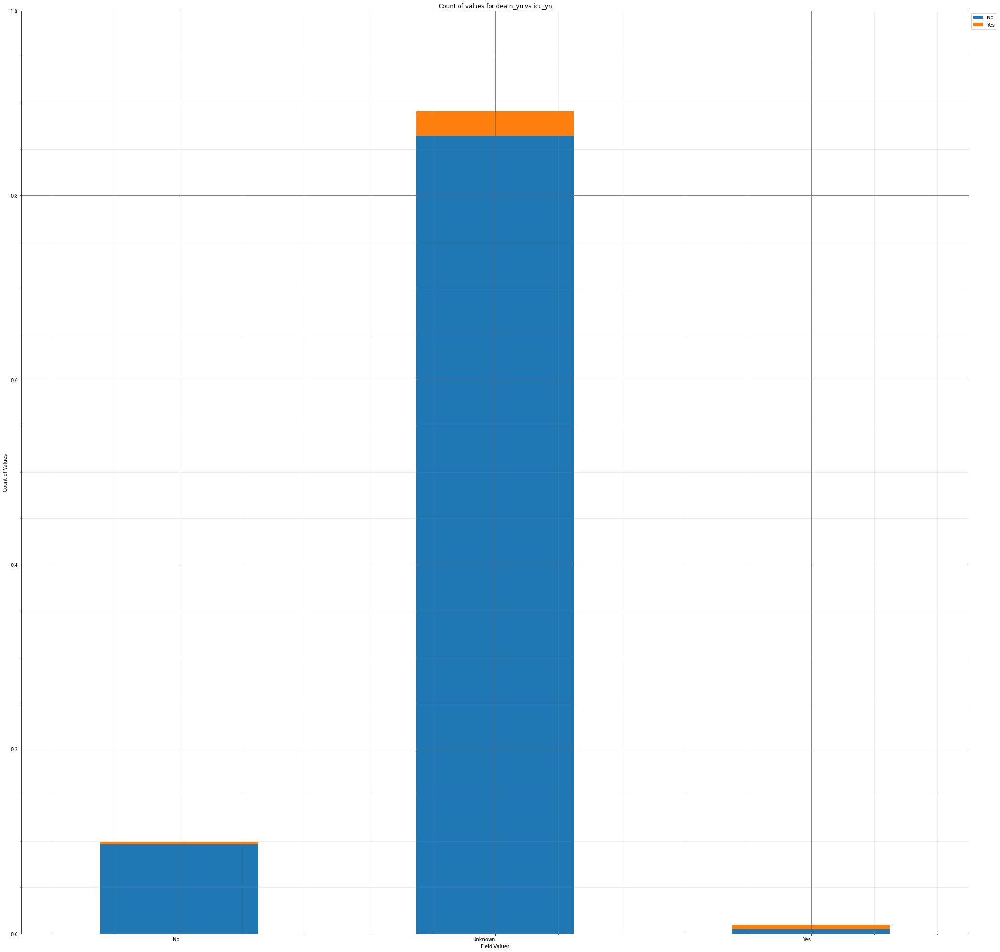



----------------------


Grouping over icu_yn|medcond_yn results in:



,icu_yn,medcond_yn,Rows,% Frequency
0,No,No,398,4.168412
1,No,Unknown,249,2.607876
2,No,Yes,302,3.162966
3,Unknown,No,522,5.467114
4,Unknown,Unknown,7501,78.560955
5,Unknown,Yes,486,5.090071
6,Yes,No,6,0.062840
7,Yes,Unknown,41,0.429409
8,Yes,Yes,43,0.450356


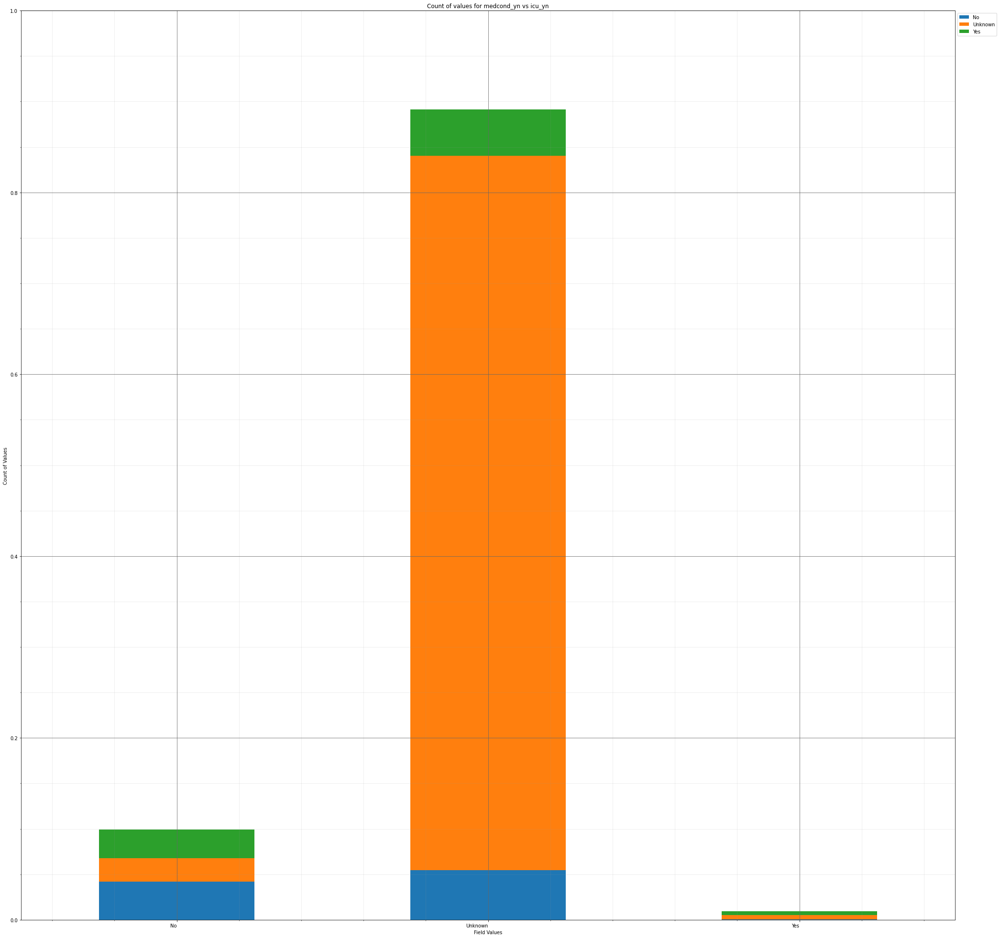



----------------------


Grouping over icu_yn|race results in:



,icu_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,7,0.073314
1,No,Asian,14,0.146628
2,No,Black,68,0.712191
3,No,Hispanic/Latino,159,1.665270
4,No,Multiple/Other,32,0.335149
5,No,Native Hawaiian/Other Pacific Islander,6,0.062840
6,No,Unknown,182,1.906158
7,No,White,481,5.037704
8,Unknown,American Indian/Alaska Native,57,0.596984
9,Unknown,Asian,221,2.314621


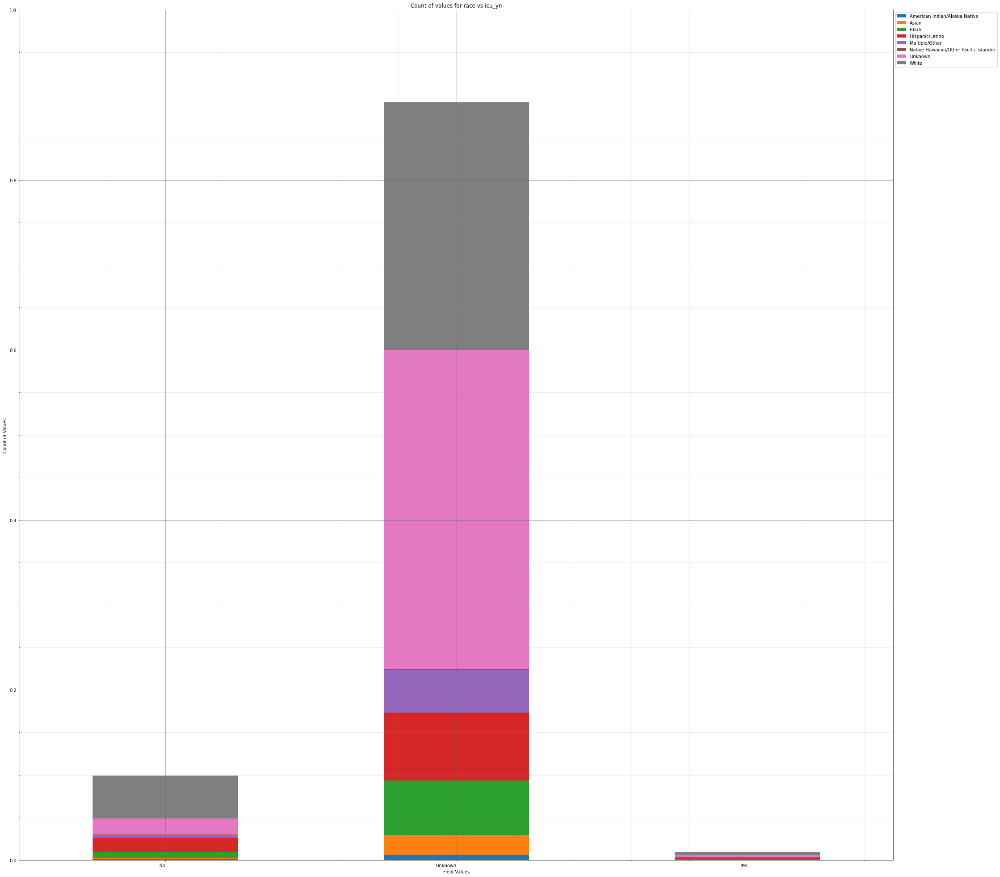



----------------------


Grouping over icu_yn|cdc_case_earliest_day results in:



,icu_yn,cdc_case_earliest_day,Rows,% Frequency
0,No,1,32,0.335149
1,No,2,28,0.293255
2,No,3,27,0.282782
3,No,4,34,0.356096
4,No,5,34,0.356096
...,...,...,...,...
88,Yes,27,7,0.073314
89,Yes,28,3,0.031420
90,Yes,29,0,0.000000
91,Yes,30,5,0.052367


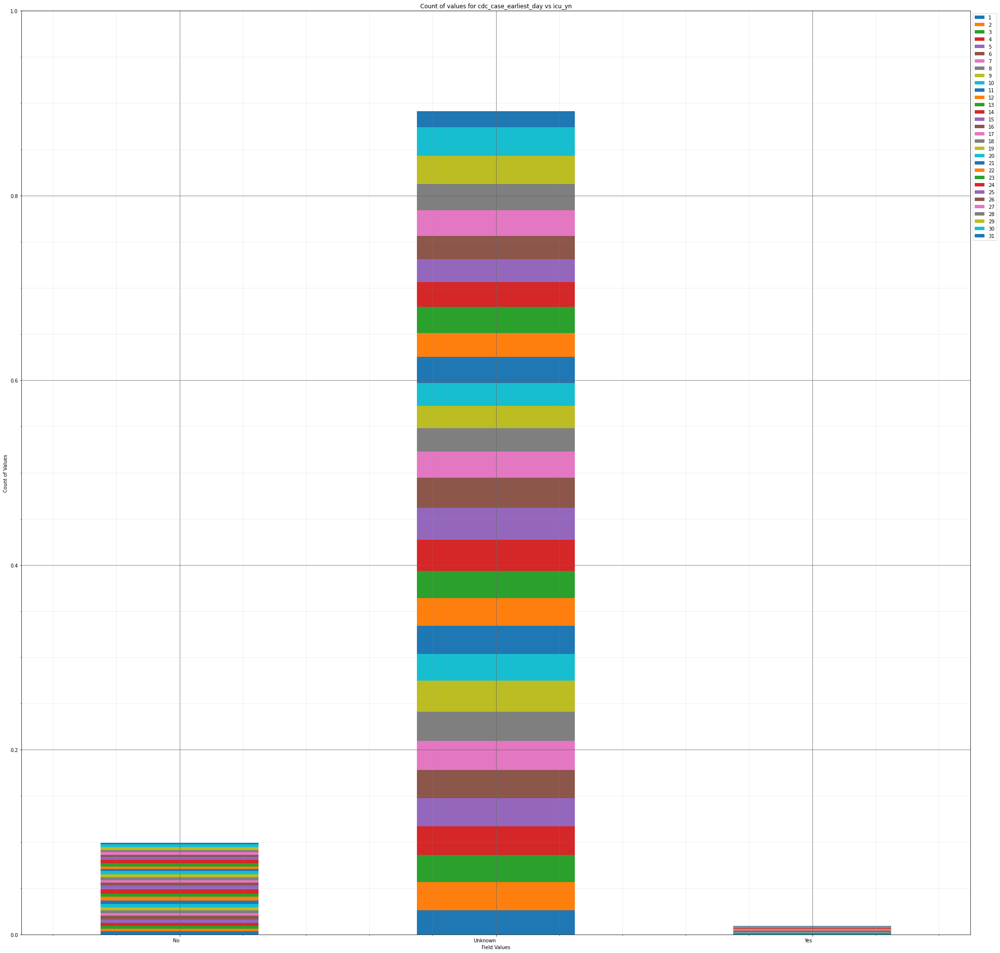



----------------------


Grouping over icu_yn|cdc_case_earliest_weekday results in:



,icu_yn,cdc_case_earliest_weekday,Rows,% Frequency
0,No,0,164,1.717637
1,No,1,140,1.466276
2,No,2,133,1.392962
3,No,3,127,1.330121
4,No,4,155,1.623377
5,No,5,123,1.288228
6,No,6,107,1.120654
7,Unknown,0,1458,15.270214
8,Unknown,1,1358,14.222874
9,Unknown,2,1417,14.840804


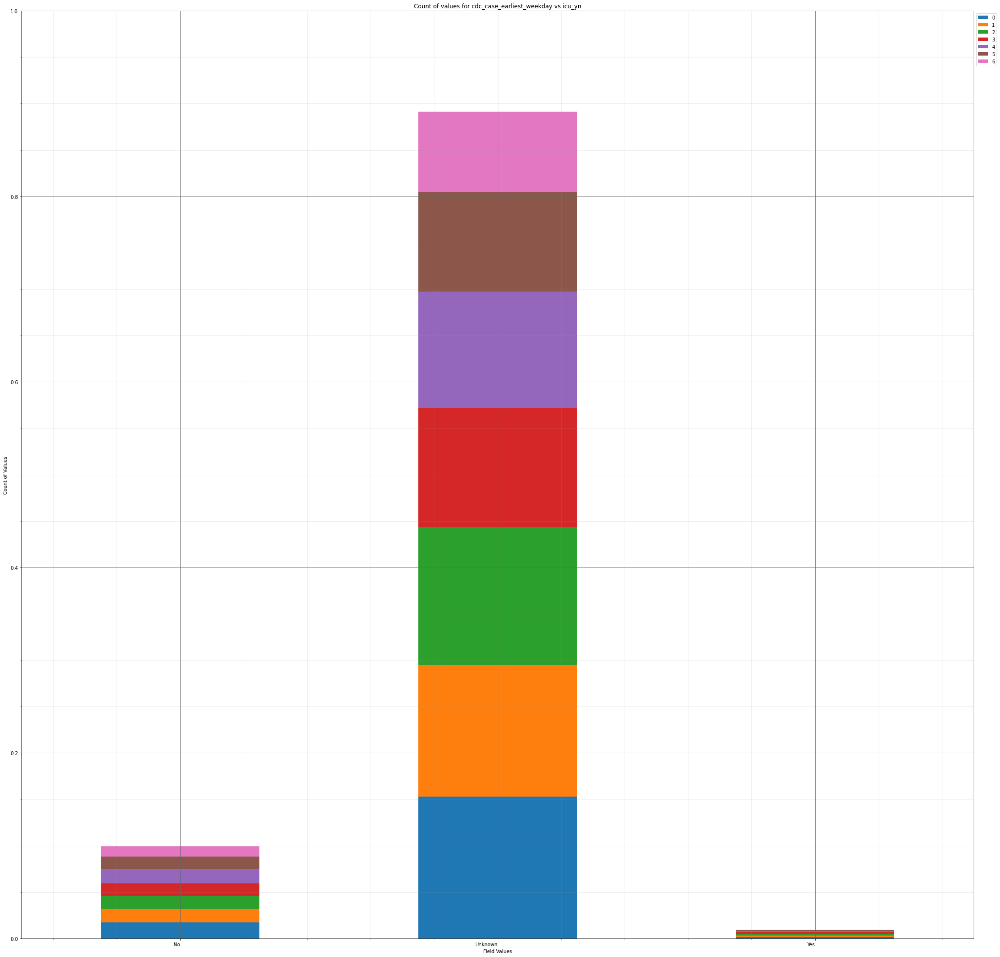



----------------------


Grouping over icu_yn|cdc_case_earliest_month results in:



,icu_yn,cdc_case_earliest_month,Rows,% Frequency
0,No,1,54,0.565563
1,No,2,0,0.000000
2,No,3,37,0.387516
3,No,4,70,0.733138
4,No,5,60,0.628404
5,No,6,66,0.691244
6,No,7,94,0.984499
7,No,8,62,0.649351
8,No,9,71,0.743611
9,No,10,132,1.382488


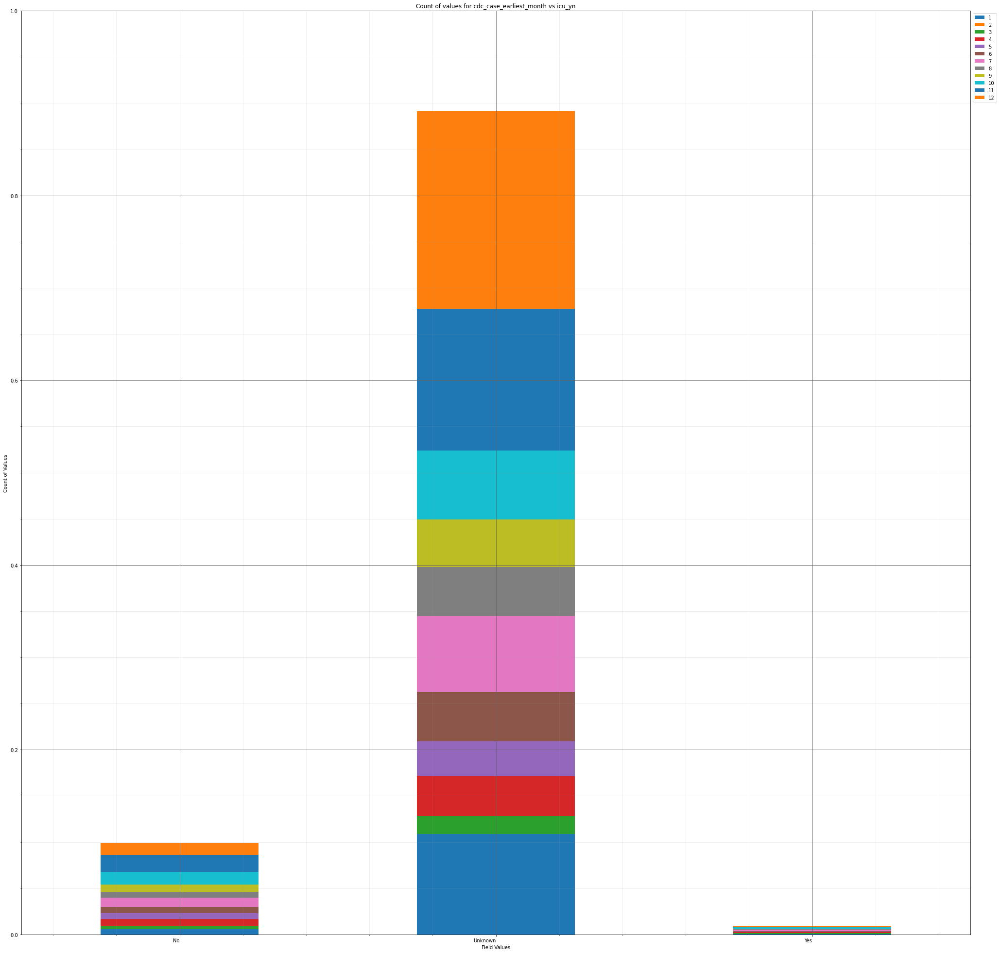



----------------------


Grouping over icu_yn|cdc_case_earliest_year results in:



,icu_yn,cdc_case_earliest_year,Rows,% Frequency
0,No,2020,895,9.373691
1,No,2021,54,0.565563
2,Unknown,2020,7476,78.299120
3,Unknown,2021,1033,10.819020
4,Yes,2020,88,0.921659
5,Yes,2021,2,0.020947


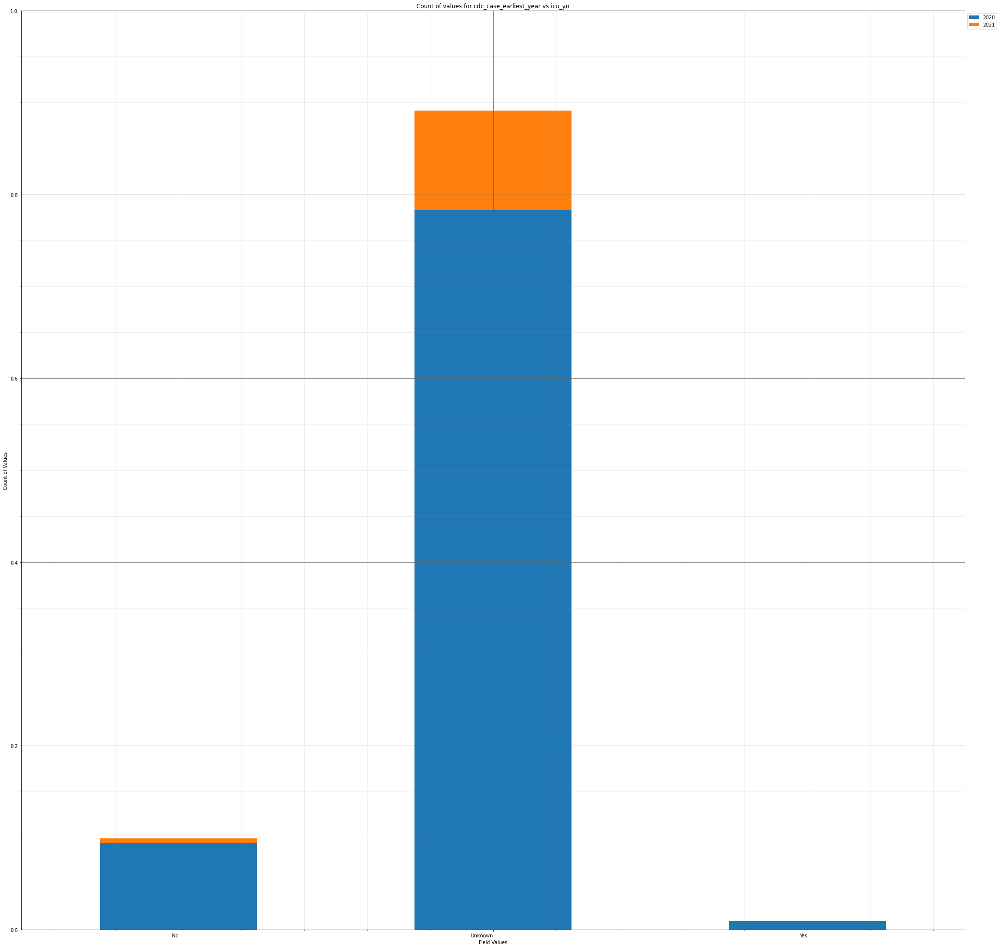



----------------------


Grouping over icu_yn|demographic_missing results in:



,icu_yn,demographic_missing,Rows,% Frequency
0,No,False,764,8.001676
1,No,True,185,1.937579
2,Unknown,False,4899,51.309175
3,Unknown,True,3610,37.808965
4,Yes,False,61,0.638877
5,Yes,True,29,0.303729


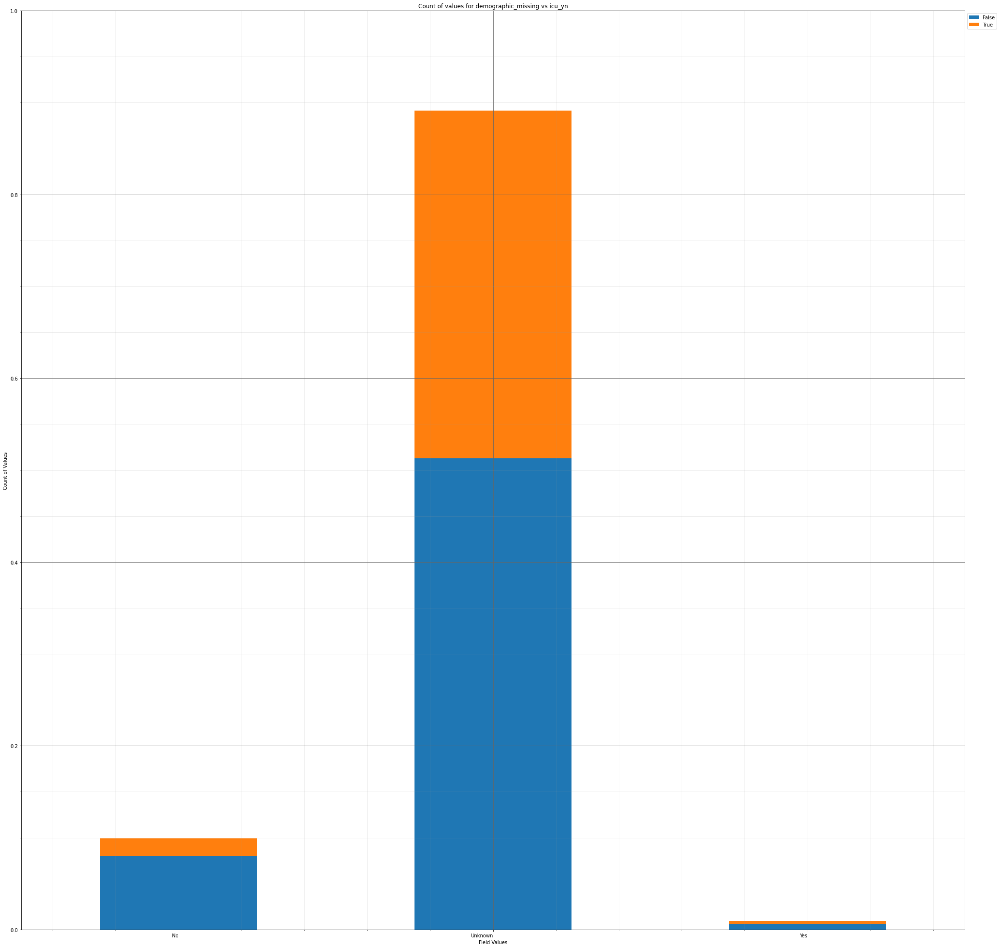



----------------------


Grouping over icu_yn|medical_missing results in:



,icu_yn,medical_missing,Rows,% Frequency
0,No,False,680,7.121910
1,No,True,269,2.817344
2,Unknown,False,0,0.000000
3,Unknown,True,8509,89.118140
4,Yes,False,49,0.513196
5,Yes,True,41,0.429409


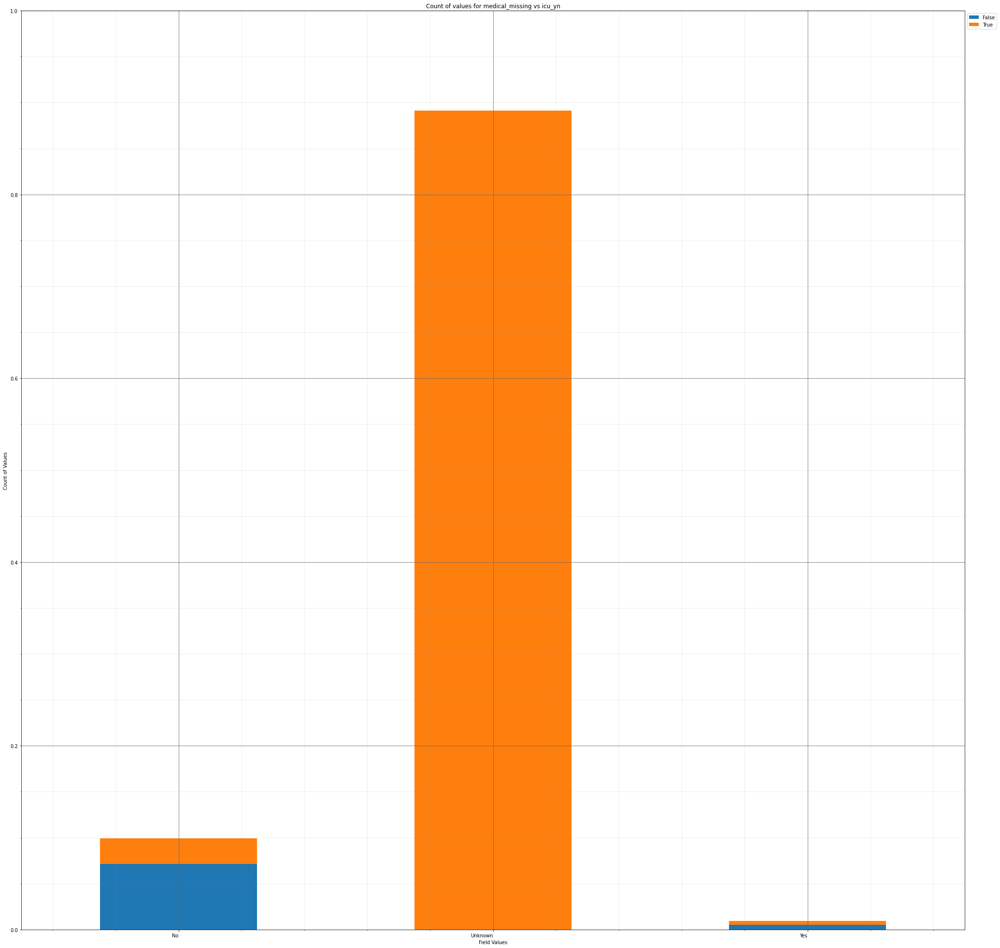



----------------------


Grouping over death_yn|current_status results in:



,death_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,8801,92.176372
1,No,Probable Case,415,4.346460
2,Yes,Laboratory-confirmed case,305,3.194386
3,Yes,Probable Case,27,0.282782


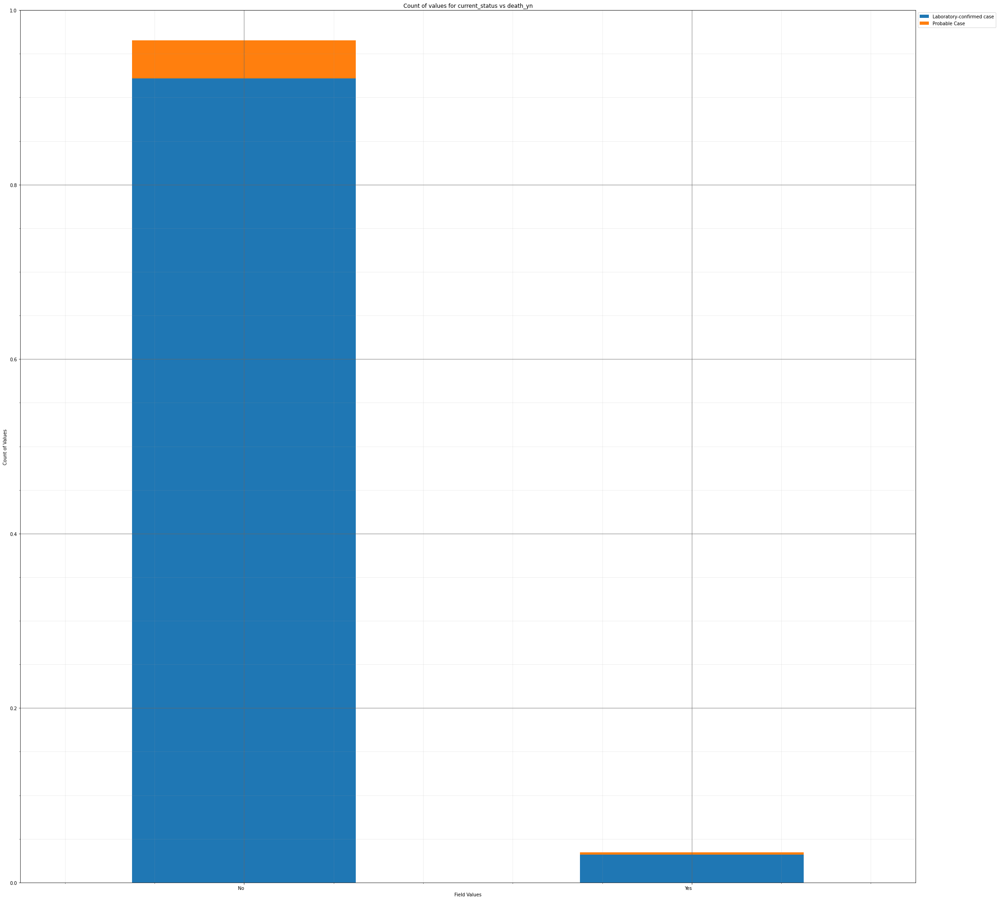



----------------------


Grouping over death_yn|sex results in:



,death_yn,sex,Rows,% Frequency
0,No,Female,4923,51.560536
1,No,Male,4213,44.124424
2,No,Unknown,80,0.837872
3,Yes,Female,166,1.738584
4,Yes,Male,163,1.707164
5,Yes,Unknown,3,0.031420


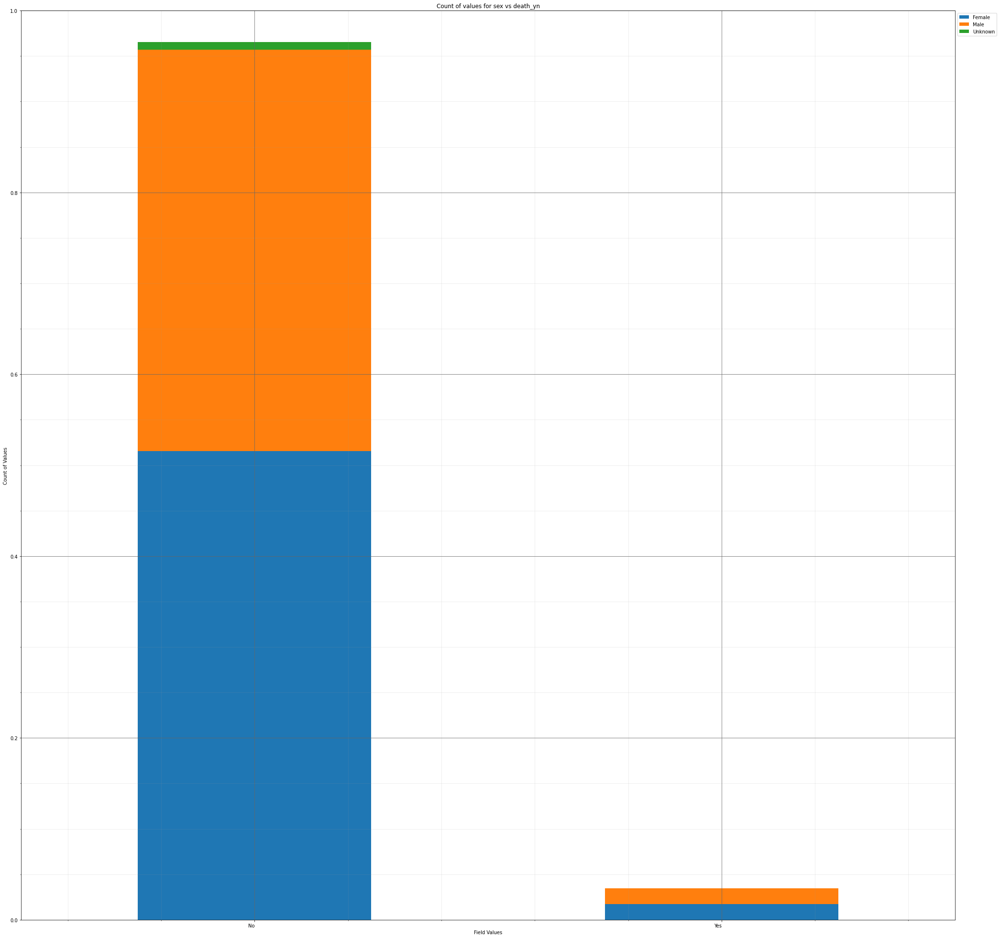



----------------------


Grouping over death_yn|age_group results in:



,death_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,458,4.796816
1,No,10 - 19 Years,1014,10.620025
2,No,20 - 29 Years,1718,17.993297
3,No,30 - 39 Years,1501,15.720570
4,No,40 - 49 Years,1384,14.495182
5,No,50 - 59 Years,1340,14.034353
6,No,60 - 69 Years,954,9.991621
7,No,70 - 79 Years,528,5.529954
8,No,80+ Years,306,3.204860
9,No,Unknown,13,0.136154


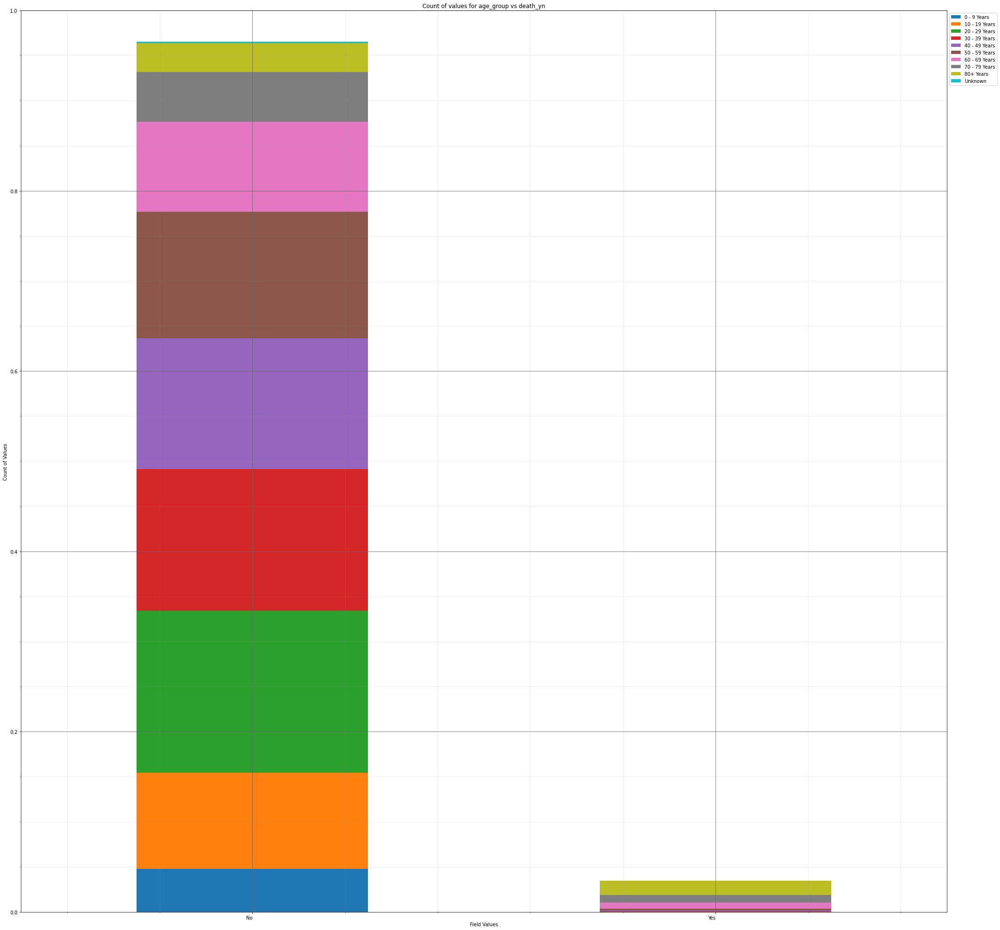



----------------------


Grouping over death_yn|hosp_yn results in:



,death_yn,hosp_yn,Rows,% Frequency
0,No,No,5110,53.519062
1,No,OTH,0,0.000000
2,No,Unknown,3614,37.850859
3,No,Yes,492,5.152912
4,Yes,No,46,0.481776
5,Yes,OTH,0,0.000000
6,Yes,Unknown,81,0.848345
7,Yes,Yes,205,2.147047


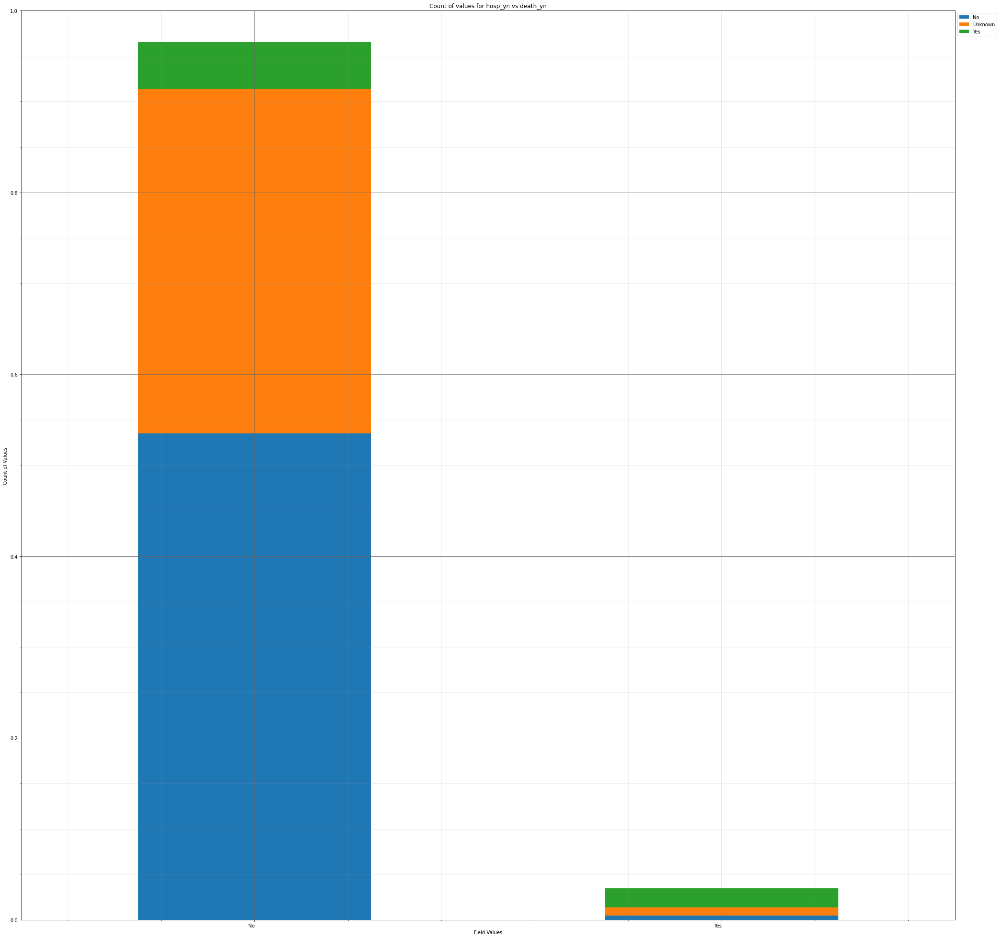



----------------------


Grouping over death_yn|icu_yn results in:



,death_yn,icu_yn,Rows,% Frequency
0,No,No,922,9.656473
1,No,Unknown,8252,86.426477
2,No,Yes,42,0.439883
3,Yes,No,27,0.282782
4,Yes,Unknown,257,2.691663
5,Yes,Yes,48,0.502723


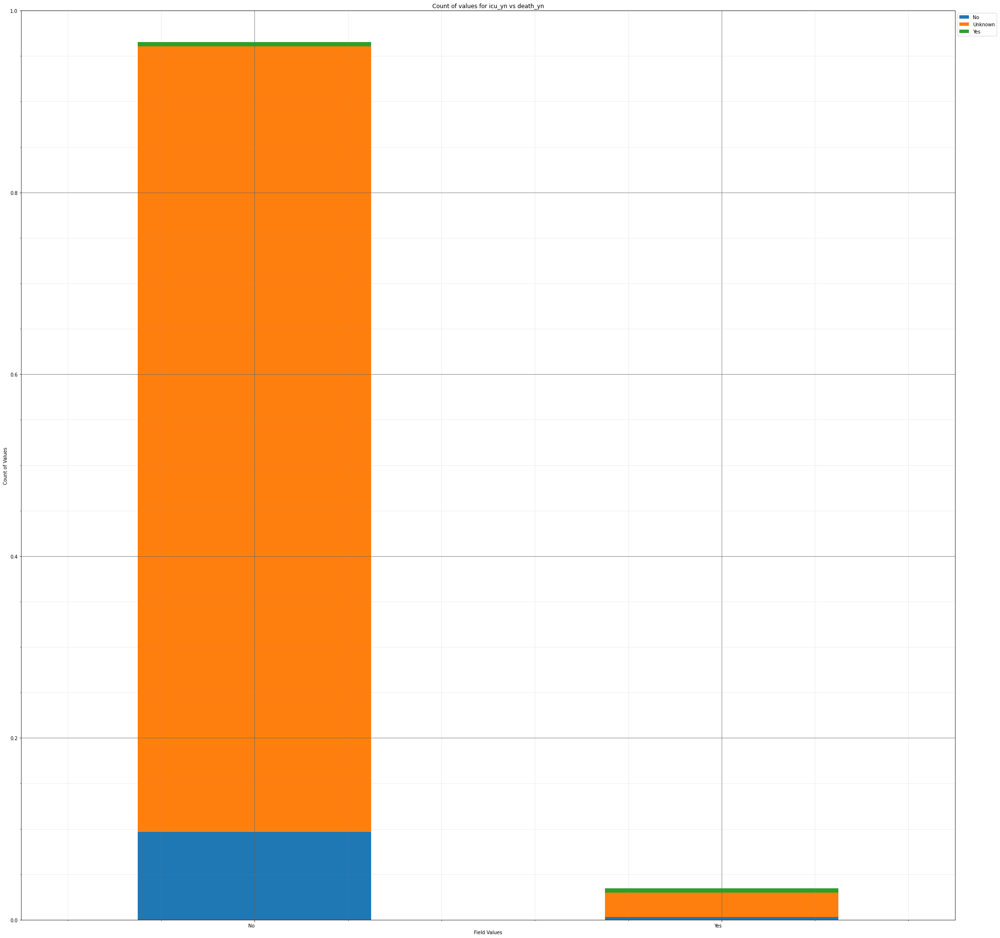



----------------------


Grouping over death_yn|medcond_yn results in:



,death_yn,medcond_yn,Rows,% Frequency
0,No,No,918,9.614579
1,No,Unknown,7560,79.178886
2,No,Yes,738,7.729367
3,Yes,No,8,0.083787
4,Yes,Unknown,231,2.419355
5,Yes,Yes,93,0.974026


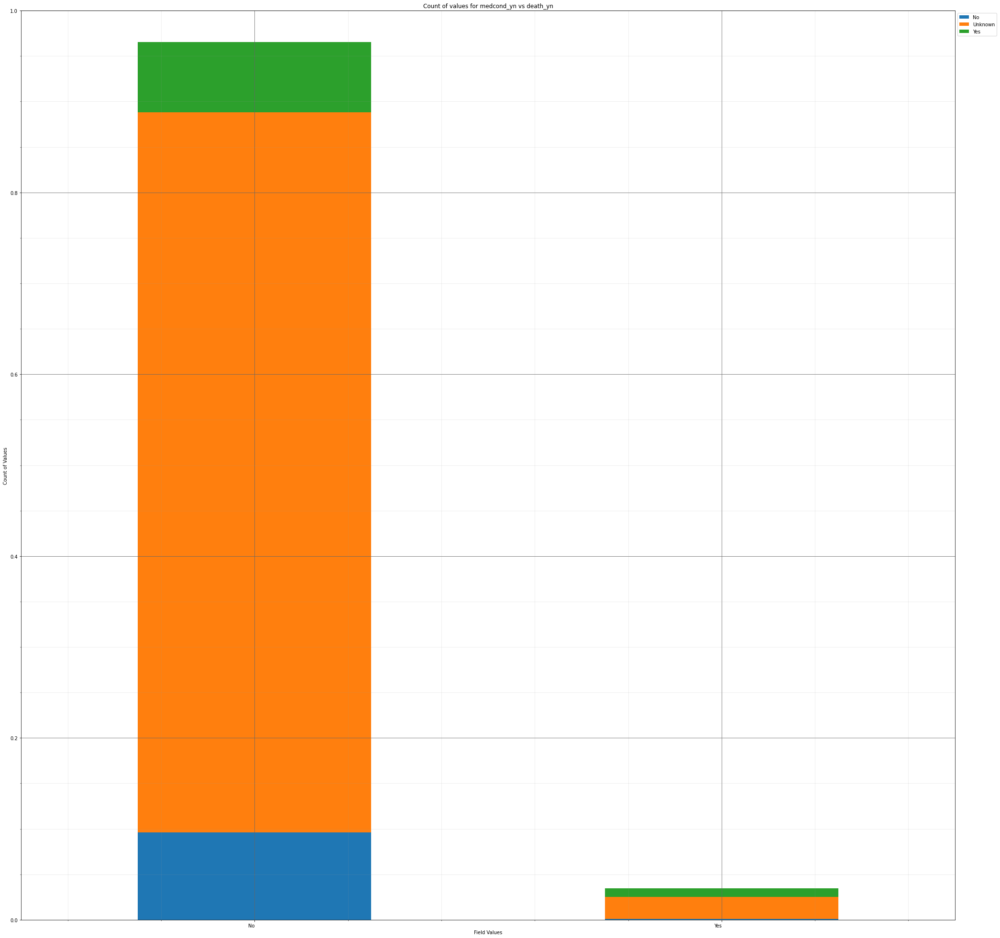



----------------------


Grouping over death_yn|race results in:



,death_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,60,0.628404
1,No,Asian,229,2.398408
2,No,Black,655,6.860075
3,No,Hispanic/Latino,900,9.426058
4,No,Multiple/Other,499,5.226225
5,No,Native Hawaiian/Other Pacific Islander,23,0.240888
6,No,Unknown,3721,38.971512
7,No,White,3129,32.771261
8,Yes,American Indian/Alaska Native,6,0.062840
9,Yes,Asian,10,0.104734


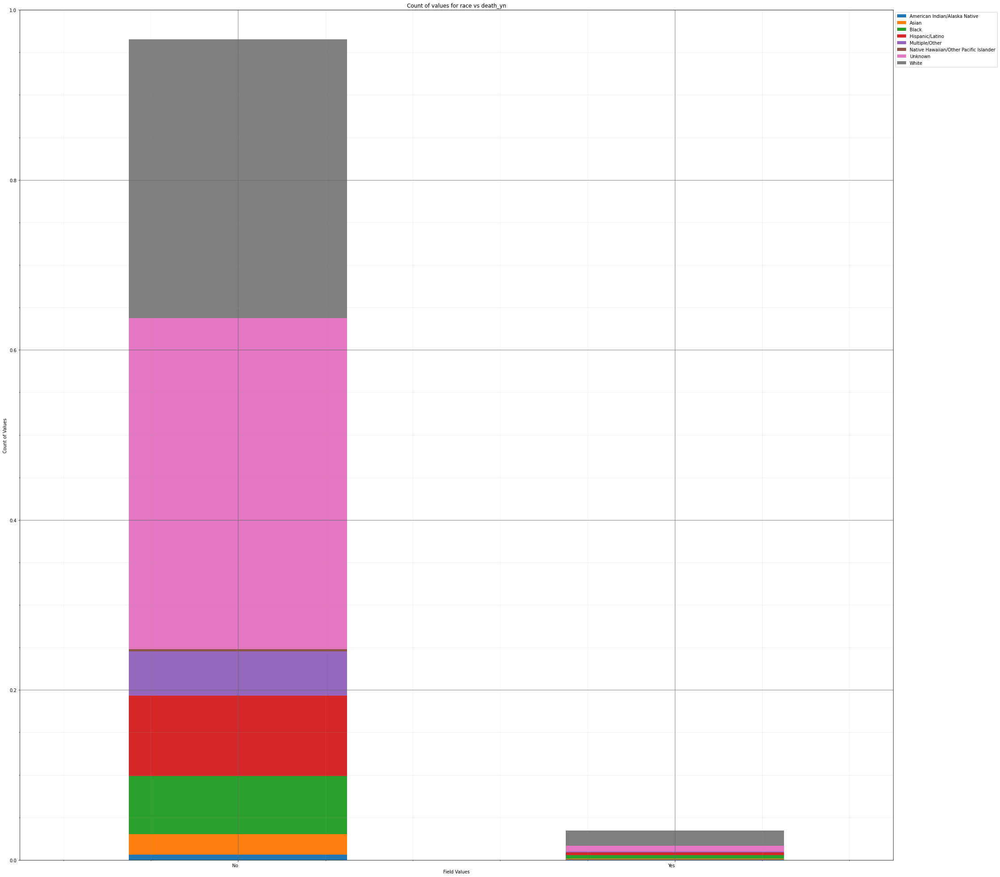



----------------------


Grouping over death_yn|cdc_case_earliest_day results in:



,death_yn,cdc_case_earliest_day,Rows,% Frequency
0,No,1,275,2.880184
1,No,2,315,3.299120
2,No,3,297,3.110599
3,No,4,326,3.414328
4,No,5,316,3.309594
...,...,...,...,...
57,Yes,27,12,0.125681
58,Yes,28,11,0.115207
59,Yes,29,11,0.115207
60,Yes,30,11,0.115207


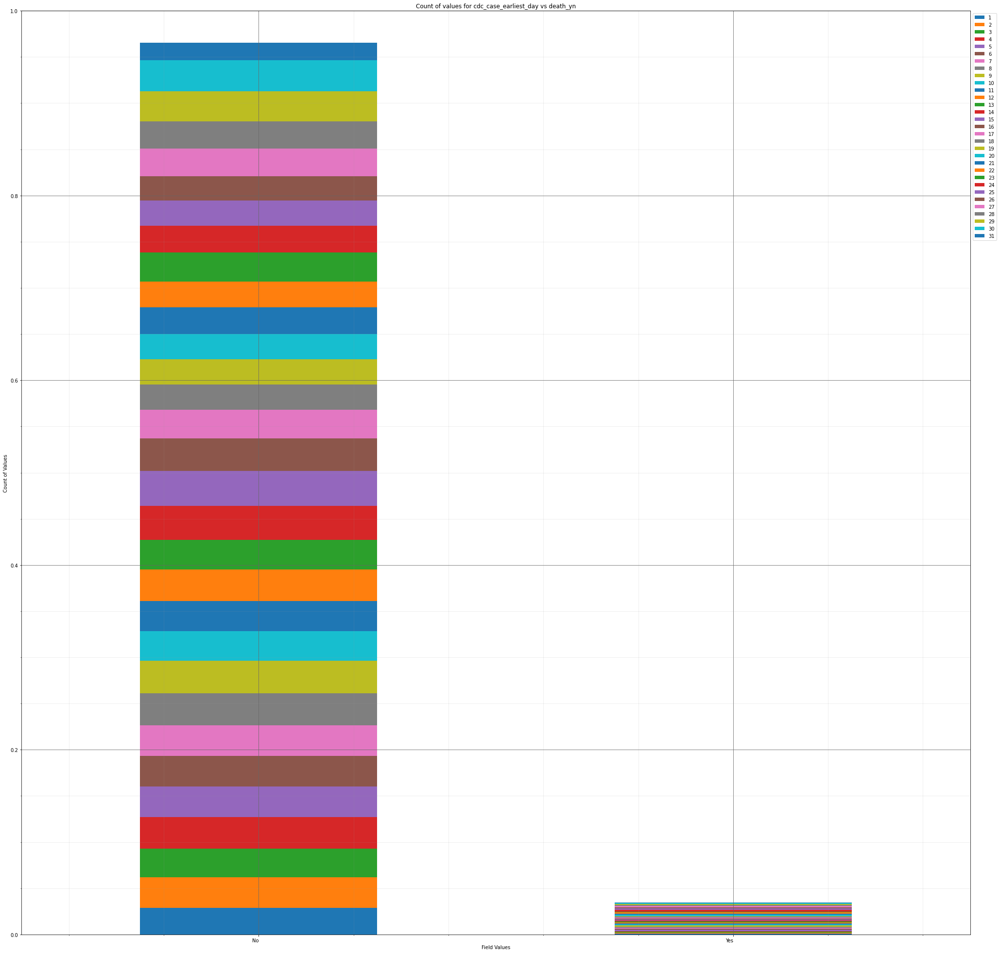



----------------------


Grouping over death_yn|cdc_case_earliest_weekday results in:



,death_yn,cdc_case_earliest_weekday,Rows,% Frequency
0,No,0,1576,16.506075
1,No,1,1473,15.427315
2,No,2,1511,15.825304
3,No,3,1330,13.929619
4,No,4,1320,13.824885
5,No,5,1109,11.614998
6,No,6,897,9.394638
7,Yes,0,62,0.649351
8,Yes,1,39,0.408463
9,Yes,2,53,0.555090


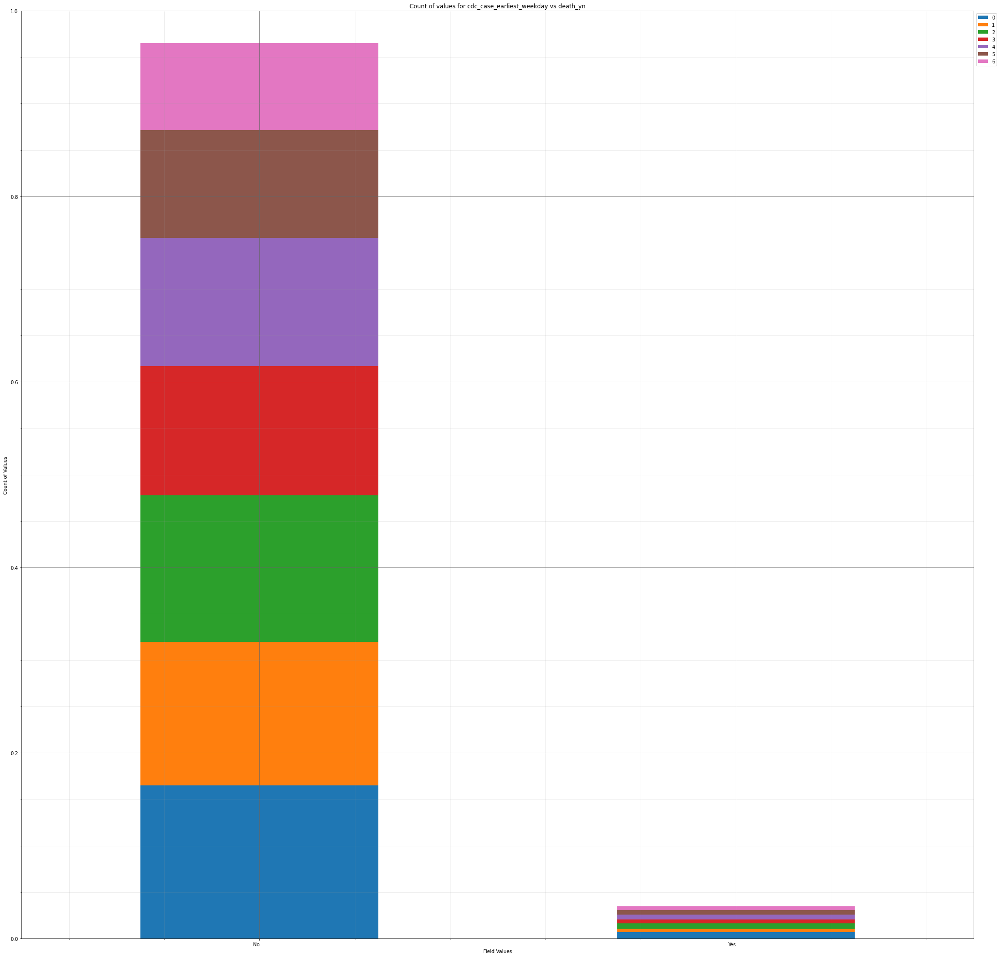



----------------------


Grouping over death_yn|cdc_case_earliest_month results in:



,death_yn,cdc_case_earliest_month,Rows,% Frequency
0,No,1,1079,11.300796
1,No,2,2,0.020947
2,No,3,202,2.115626
3,No,4,423,4.430247
4,No,5,403,4.220779
5,No,6,562,5.886049
6,No,7,861,9.017595
7,No,8,560,5.865103
8,No,9,557,5.833682
9,No,10,834,8.734814


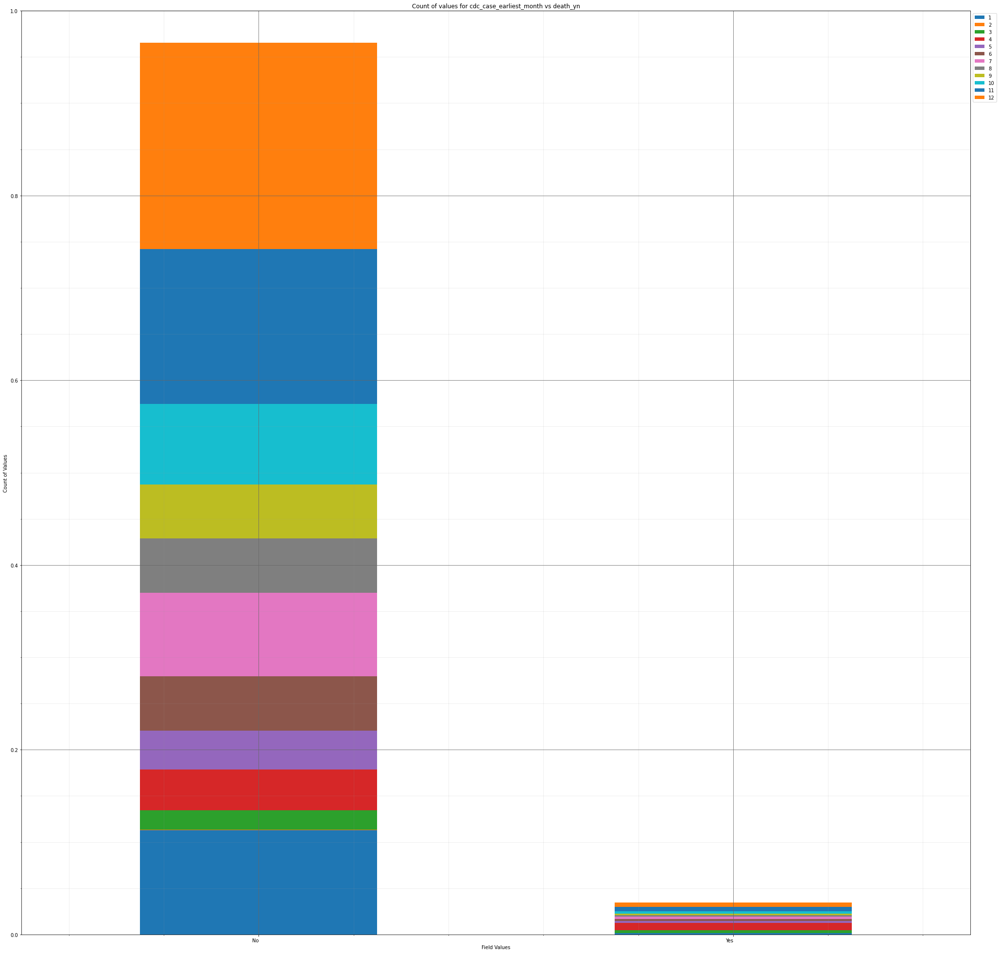



----------------------


Grouping over death_yn|cdc_case_earliest_year results in:



,death_yn,cdc_case_earliest_year,Rows,% Frequency
0,No,2020,8141,85.263930
1,No,2021,1075,11.258902
2,Yes,2020,318,3.330540
3,Yes,2021,14,0.146628


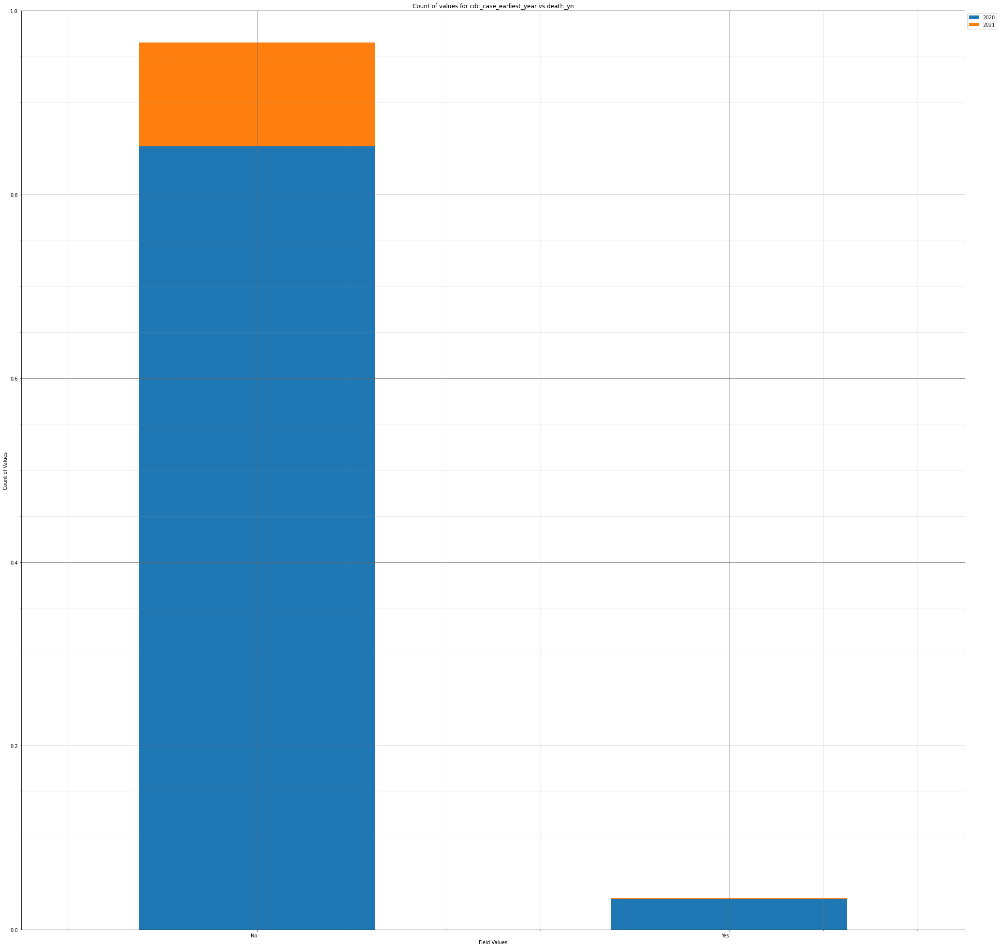



----------------------


Grouping over death_yn|demographic_missing results in:



,death_yn,demographic_missing,Rows,% Frequency
0,No,False,5461,57.195224
1,No,True,3755,39.327608
2,Yes,False,263,2.754504
3,Yes,True,69,0.722664


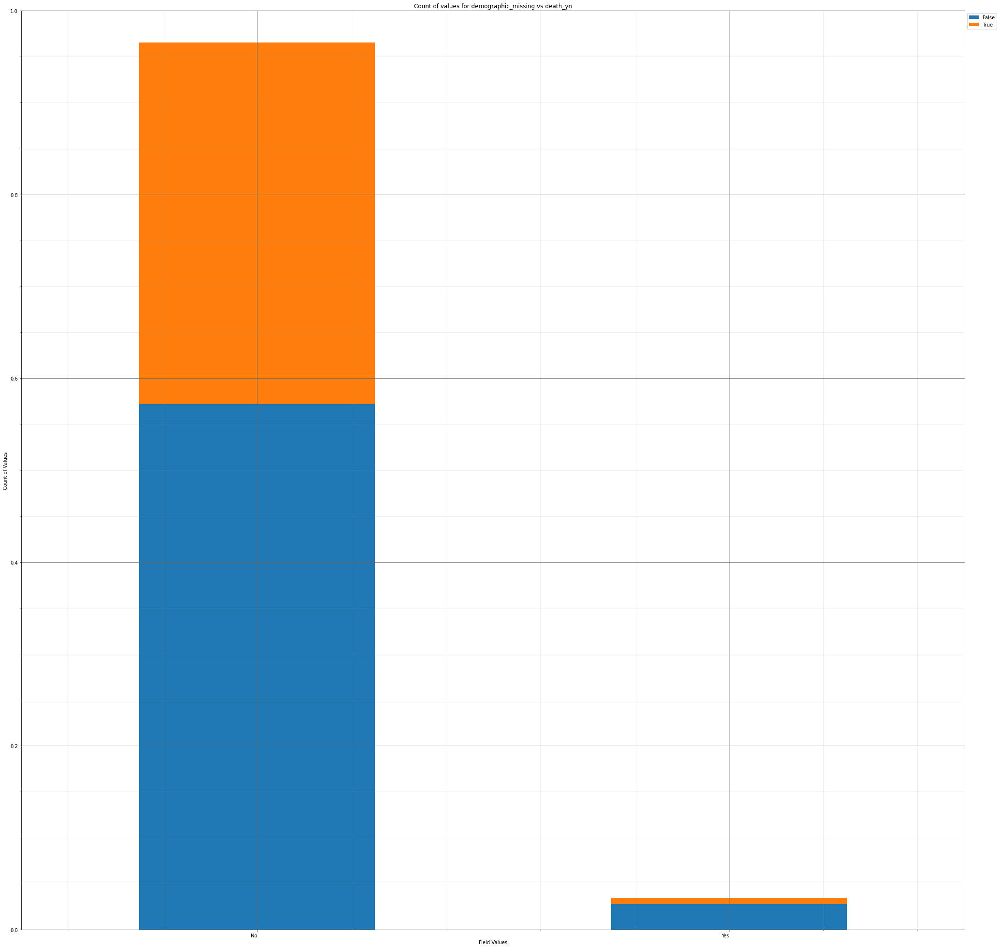



----------------------


Grouping over death_yn|medical_missing results in:



,death_yn,medical_missing,Rows,% Frequency
0,No,False,676,7.080017
1,No,True,8540,89.442815
2,Yes,False,53,0.555090
3,Yes,True,279,2.922078


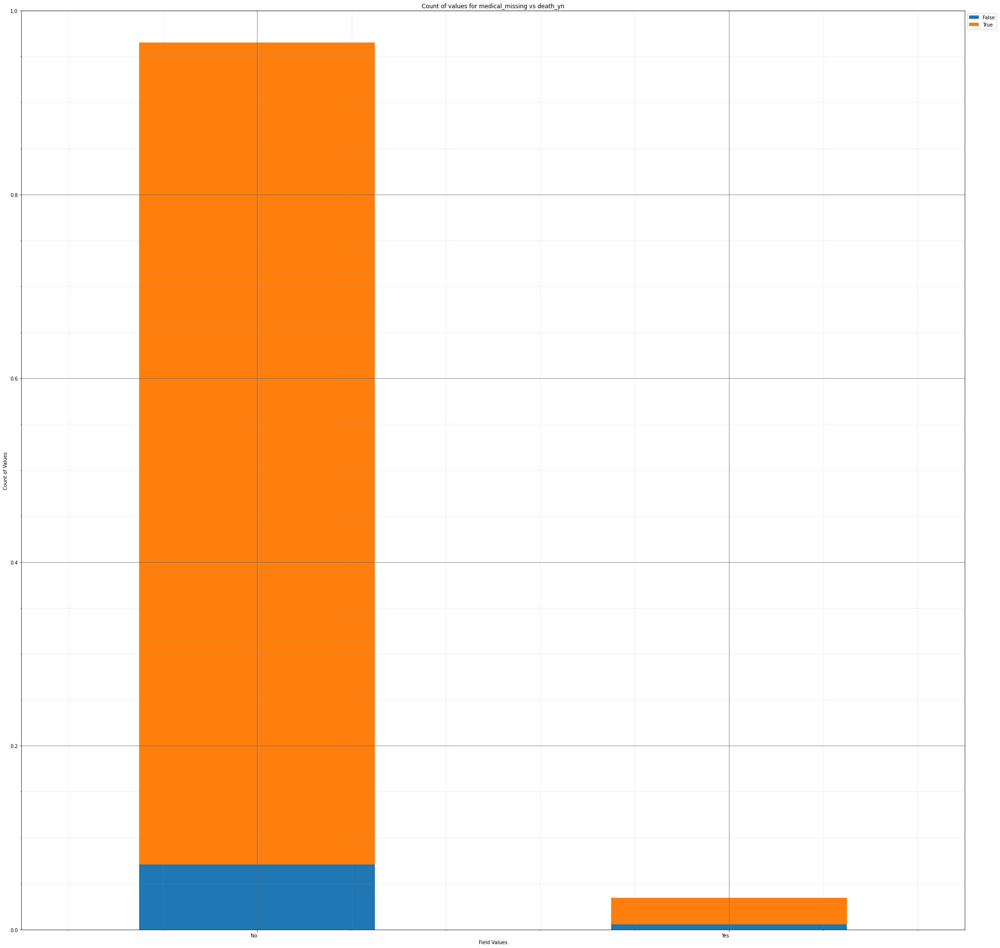



----------------------


Grouping over medcond_yn|current_status results in:



,medcond_yn,current_status,Rows,% Frequency
0,No,Laboratory-confirmed case,888,9.300377
1,No,Probable Case,38,0.397989
2,Unknown,Laboratory-confirmed case,7407,77.576456
3,Unknown,Probable Case,384,4.021785
4,Yes,Laboratory-confirmed case,811,8.493925
5,Yes,Probable Case,20,0.209468


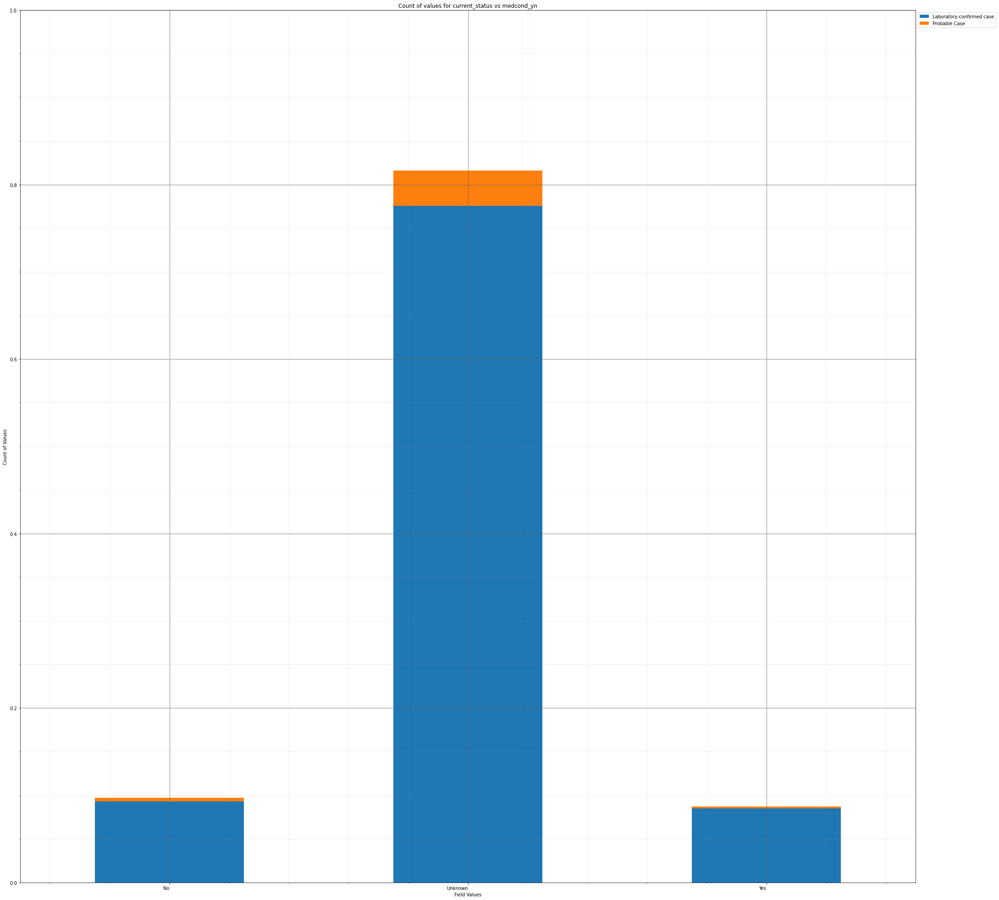



----------------------


Grouping over medcond_yn|sex results in:



,medcond_yn,sex,Rows,% Frequency
0,No,Female,507,5.310013
1,No,Male,412,4.315040
2,No,Unknown,7,0.073314
3,Unknown,Female,4125,43.202765
4,Unknown,Male,3593,37.630917
5,Unknown,Unknown,73,0.764558
6,Yes,Female,457,4.786343
7,Yes,Male,371,3.885630
8,Yes,Unknown,3,0.031420


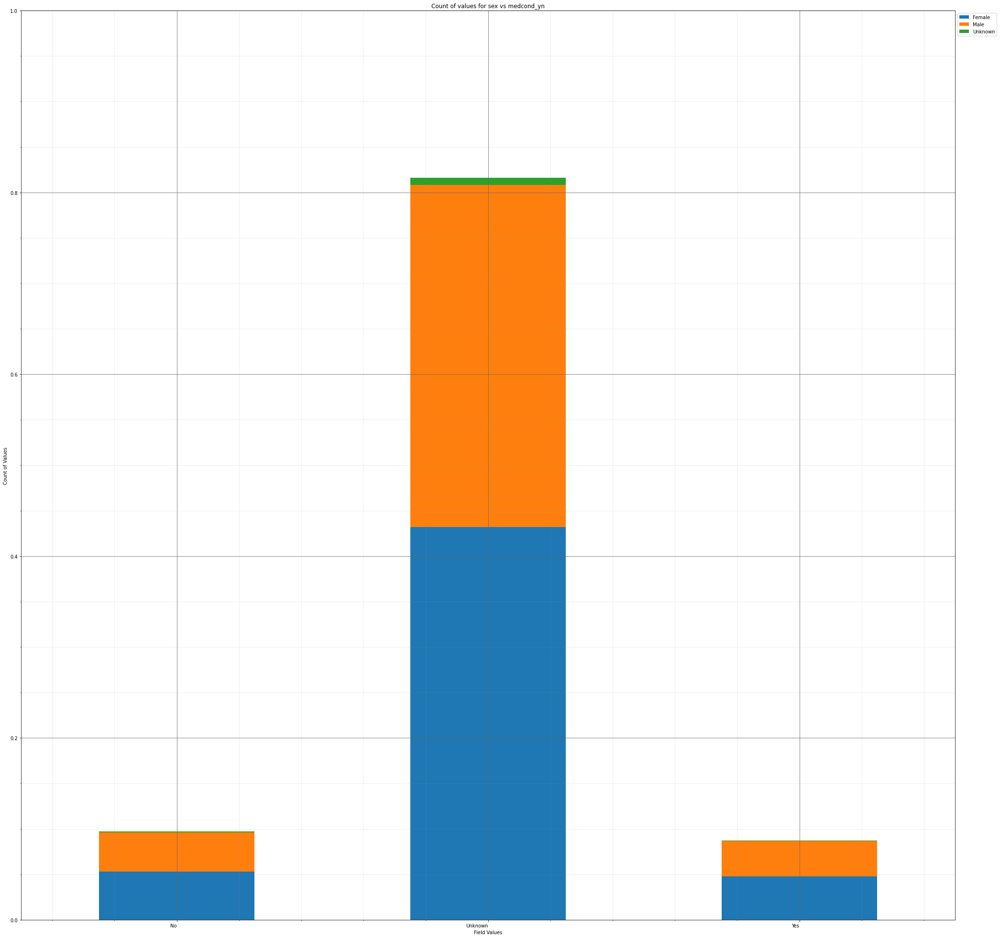



----------------------


Grouping over medcond_yn|age_group results in:



,medcond_yn,age_group,Rows,% Frequency
0,No,0 - 9 Years,52,0.544617
1,No,10 - 19 Years,142,1.487222
2,No,20 - 29 Years,221,2.314621
3,No,30 - 39 Years,172,1.801424
4,No,40 - 49 Years,118,1.235861
5,No,50 - 59 Years,113,1.183494
6,No,60 - 69 Years,68,0.712191
7,No,70 - 79 Years,28,0.293255
8,No,80+ Years,12,0.125681
9,No,Unknown,0,0.000000


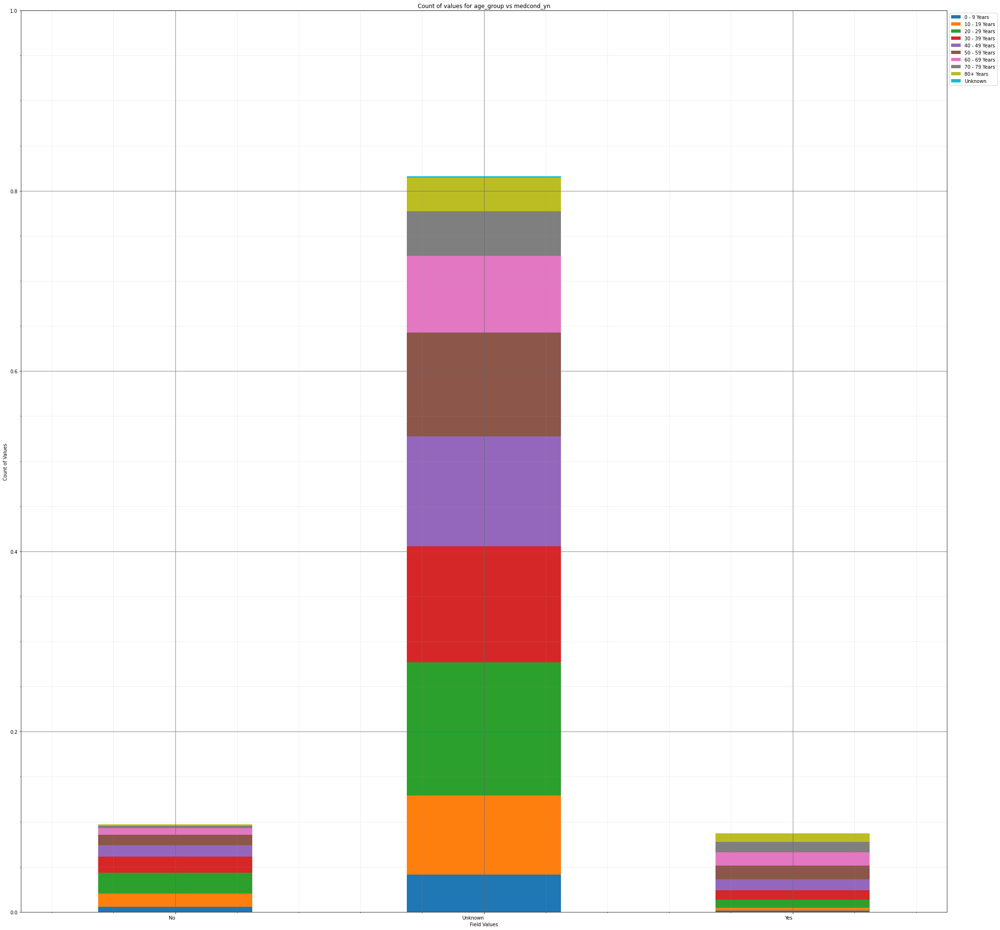



----------------------


Grouping over medcond_yn|hosp_yn results in:



,medcond_yn,hosp_yn,Rows,% Frequency
0,No,No,691,7.237118
1,No,OTH,0,0.000000
2,No,Unknown,202,2.115626
3,No,Yes,33,0.345622
4,Unknown,No,3914,40.992878
5,Unknown,OTH,0,0.000000
6,Unknown,Unknown,3390,35.504818
7,Unknown,Yes,487,5.100545
8,Yes,No,551,5.770842
9,Yes,OTH,0,0.000000


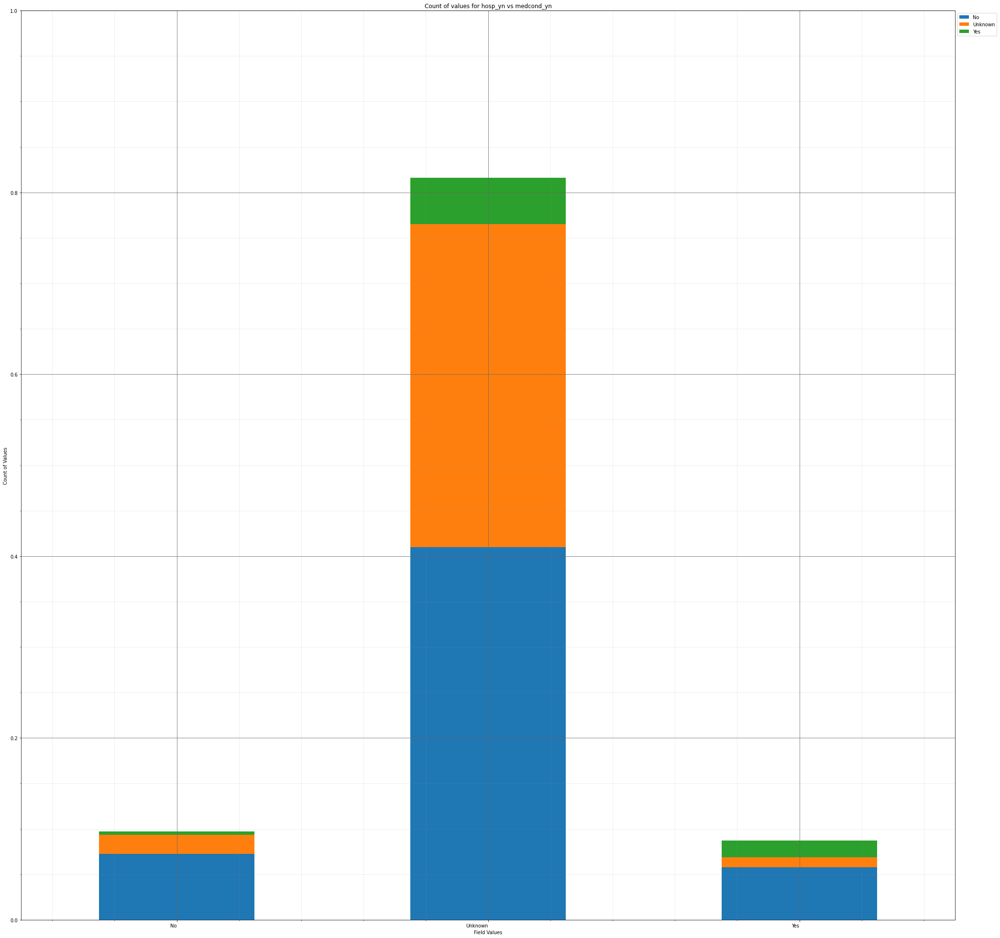



----------------------


Grouping over medcond_yn|icu_yn results in:



,medcond_yn,icu_yn,Rows,% Frequency
0,No,No,398,4.168412
1,No,Unknown,522,5.467114
2,No,Yes,6,0.062840
3,Unknown,No,249,2.607876
4,Unknown,Unknown,7501,78.560955
5,Unknown,Yes,41,0.429409
6,Yes,No,302,3.162966
7,Yes,Unknown,486,5.090071
8,Yes,Yes,43,0.450356


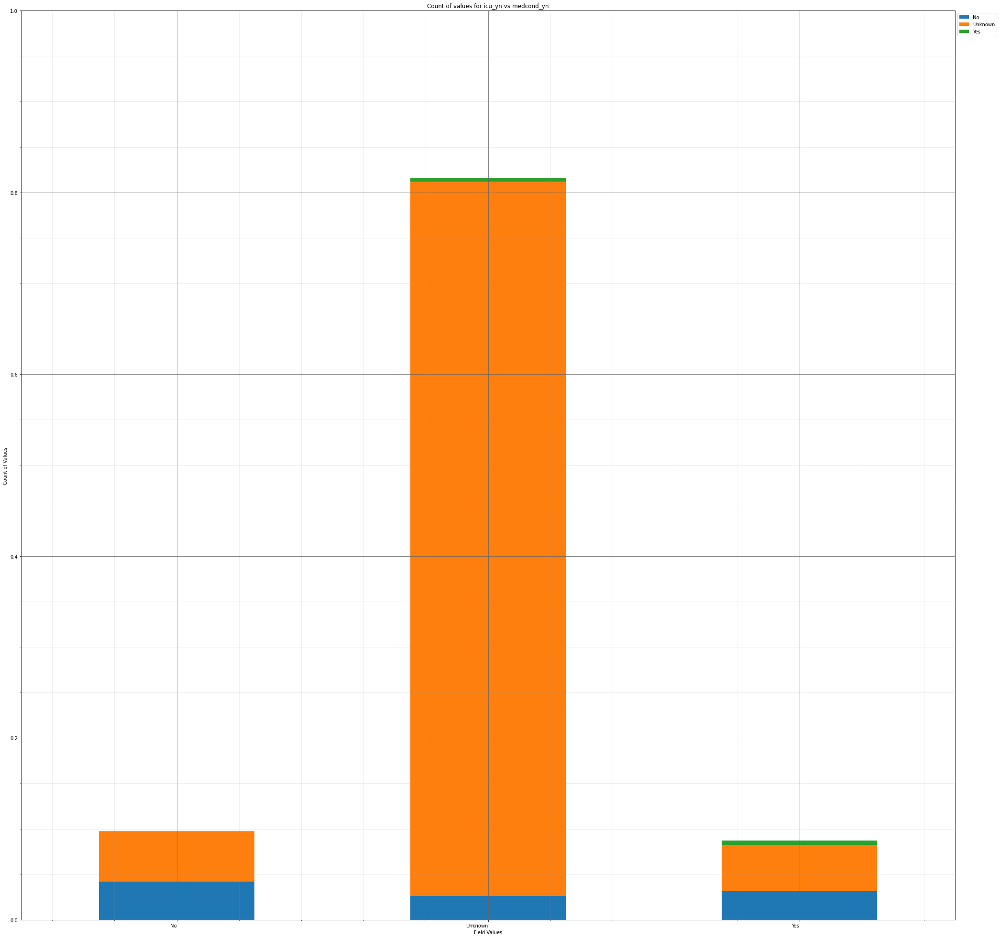



----------------------


Grouping over medcond_yn|death_yn results in:



,medcond_yn,death_yn,Rows,% Frequency
0,No,No,918,9.614579
1,No,Yes,8,0.083787
2,Unknown,No,7560,79.178886
3,Unknown,Yes,231,2.419355
4,Yes,No,738,7.729367
5,Yes,Yes,93,0.974026


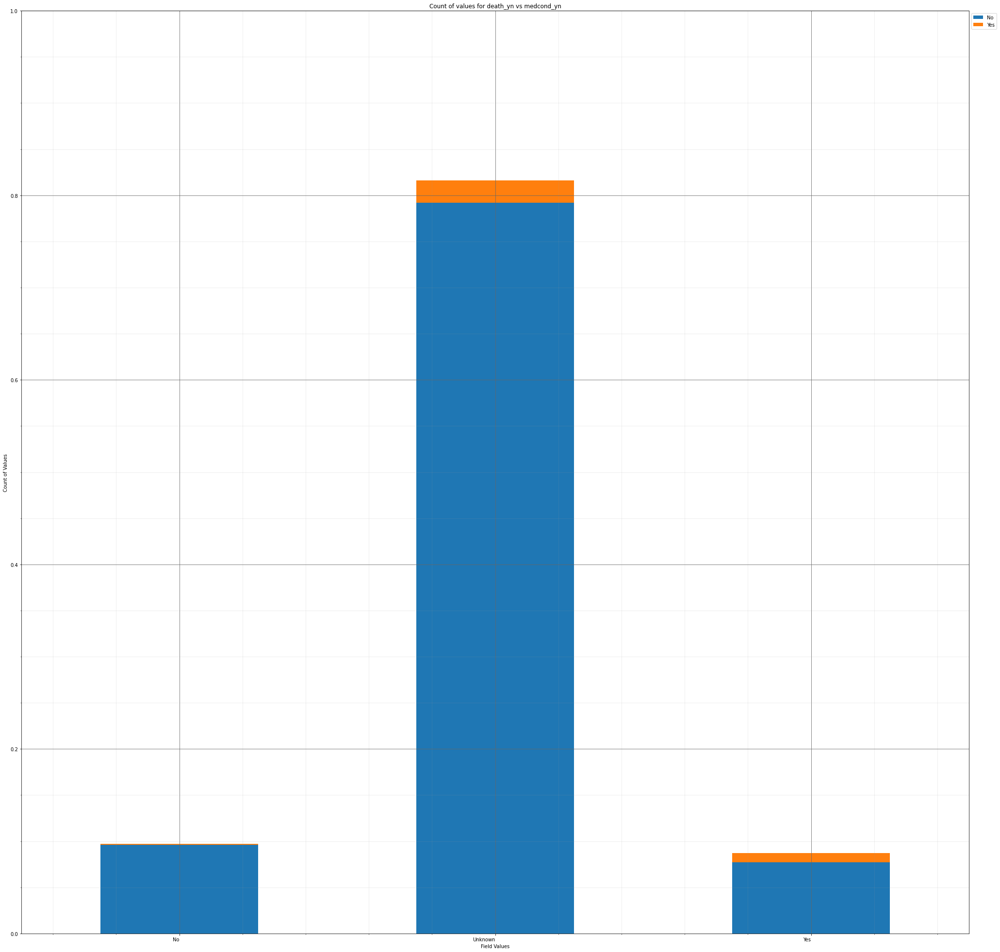



----------------------


Grouping over medcond_yn|race results in:



,medcond_yn,race,Rows,% Frequency
0,No,American Indian/Alaska Native,4,0.041894
1,No,Asian,17,0.178048
2,No,Black,69,0.722664
3,No,Hispanic/Latino,155,1.623377
4,No,Multiple/Other,32,0.335149
5,No,Native Hawaiian/Other Pacific Islander,2,0.020947
6,No,Unknown,162,1.696690
7,No,White,485,5.079598
8,Unknown,American Indian/Alaska Native,55,0.576037
9,Unknown,Asian,204,2.136573


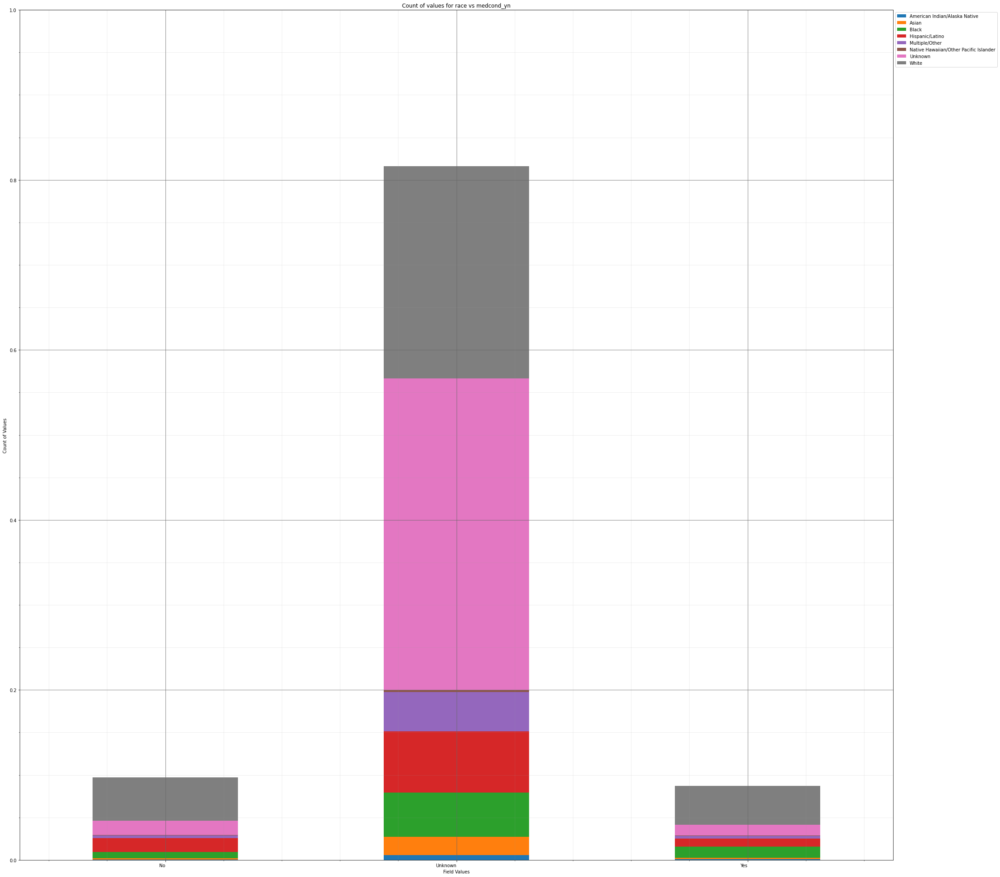



----------------------


Grouping over medcond_yn|cdc_case_earliest_day results in:



,medcond_yn,cdc_case_earliest_day,Rows,% Frequency
0,No,1,28,0.293255
1,No,2,24,0.251362
2,No,3,20,0.209468
3,No,4,30,0.314202
4,No,5,30,0.314202
...,...,...,...,...
88,Yes,27,28,0.293255
89,Yes,28,22,0.230415
90,Yes,29,22,0.230415
91,Yes,30,27,0.282782


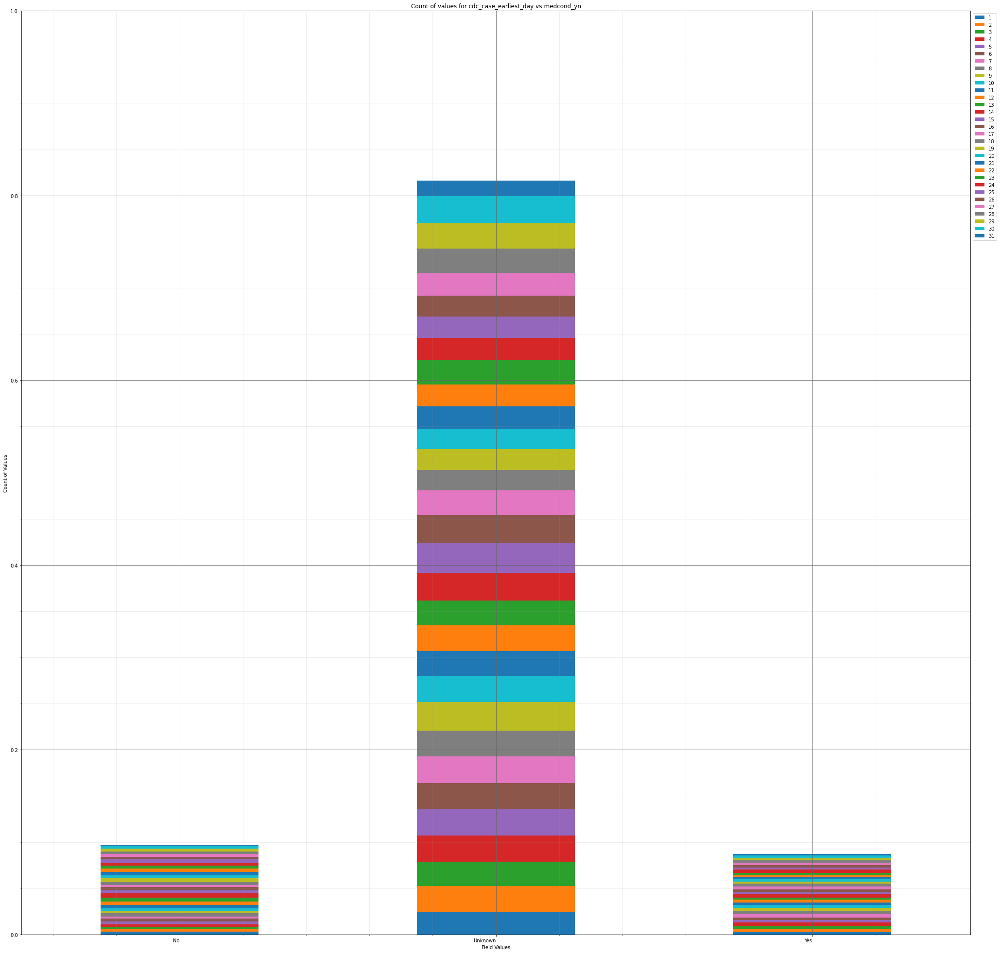



----------------------


Grouping over medcond_yn|cdc_case_earliest_weekday results in:



,medcond_yn,cdc_case_earliest_weekday,Rows,% Frequency
0,No,0,156,1.633850
1,No,1,145,1.518643
2,No,2,158,1.654797
3,No,3,95,0.994973
4,No,4,143,1.497696
5,No,5,116,1.214914
6,No,6,113,1.183494
7,Unknown,0,1330,13.929619
8,Unknown,1,1255,13.144114
9,Unknown,2,1289,13.500209


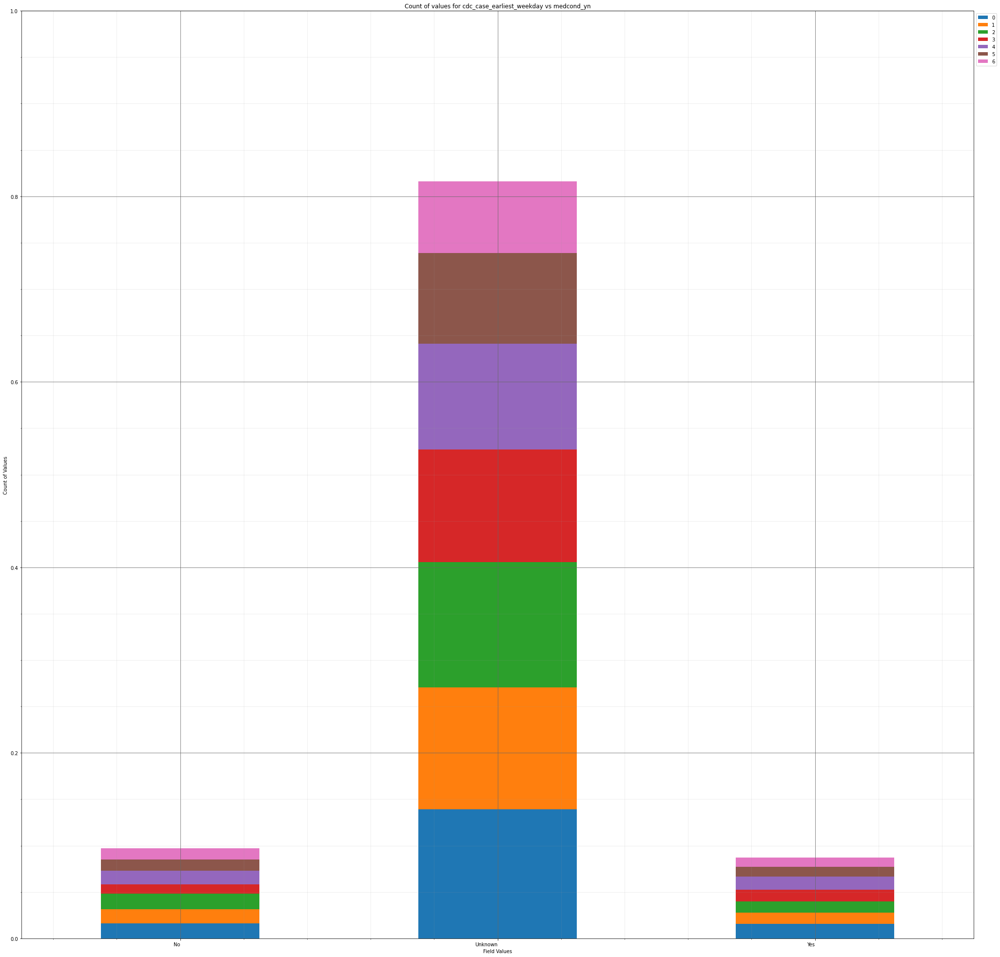



----------------------


Grouping over medcond_yn|cdc_case_earliest_month results in:



,medcond_yn,cdc_case_earliest_month,Rows,% Frequency
0,No,1,55,0.576037
1,No,2,0,0.000000
2,No,3,19,0.198995
3,No,4,46,0.481776
4,No,5,52,0.544617
5,No,6,54,0.565563
6,No,7,92,0.963553
7,No,8,80,0.837872
8,No,9,81,0.848345
9,No,10,131,1.372015


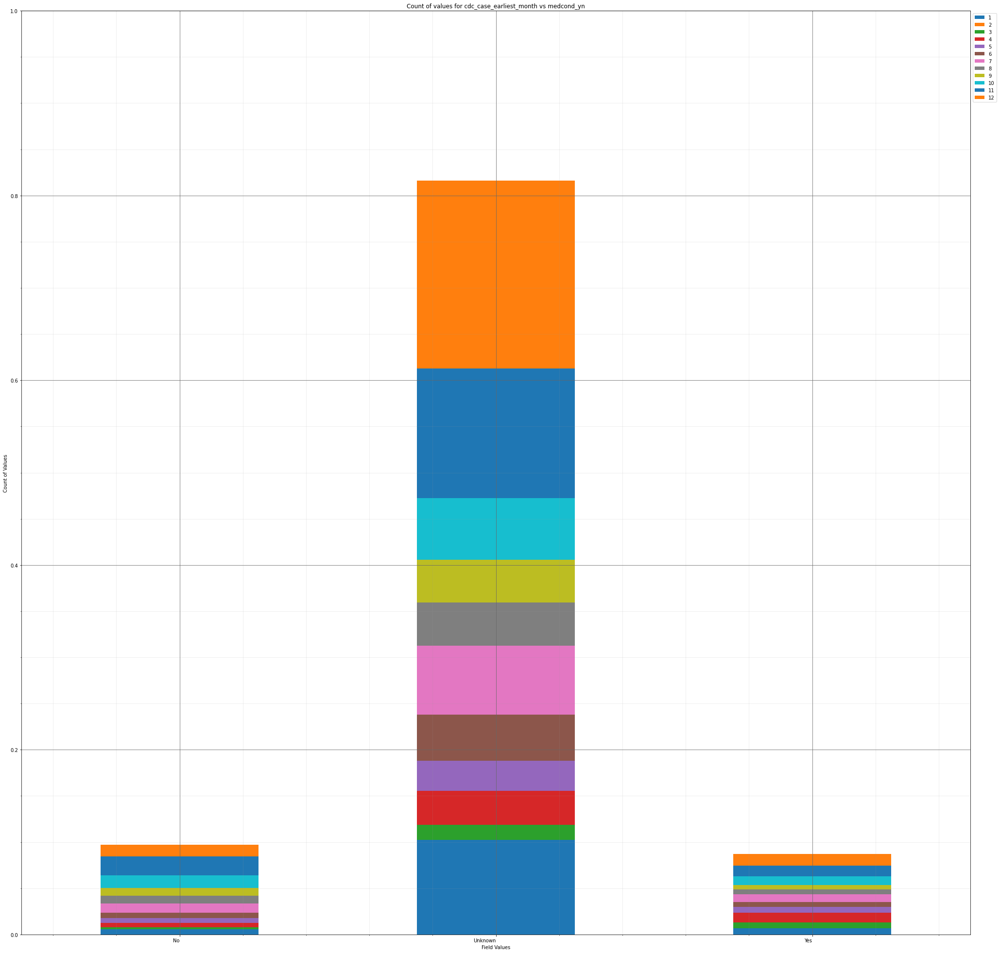



----------------------


Grouping over medcond_yn|cdc_case_earliest_year results in:



,medcond_yn,cdc_case_earliest_year,Rows,% Frequency
0,No,2020,871,9.122329
1,No,2021,55,0.576037
2,Unknown,2020,6818,71.407625
3,Unknown,2021,973,10.190616
4,Yes,2020,770,8.064516
5,Yes,2021,61,0.638877


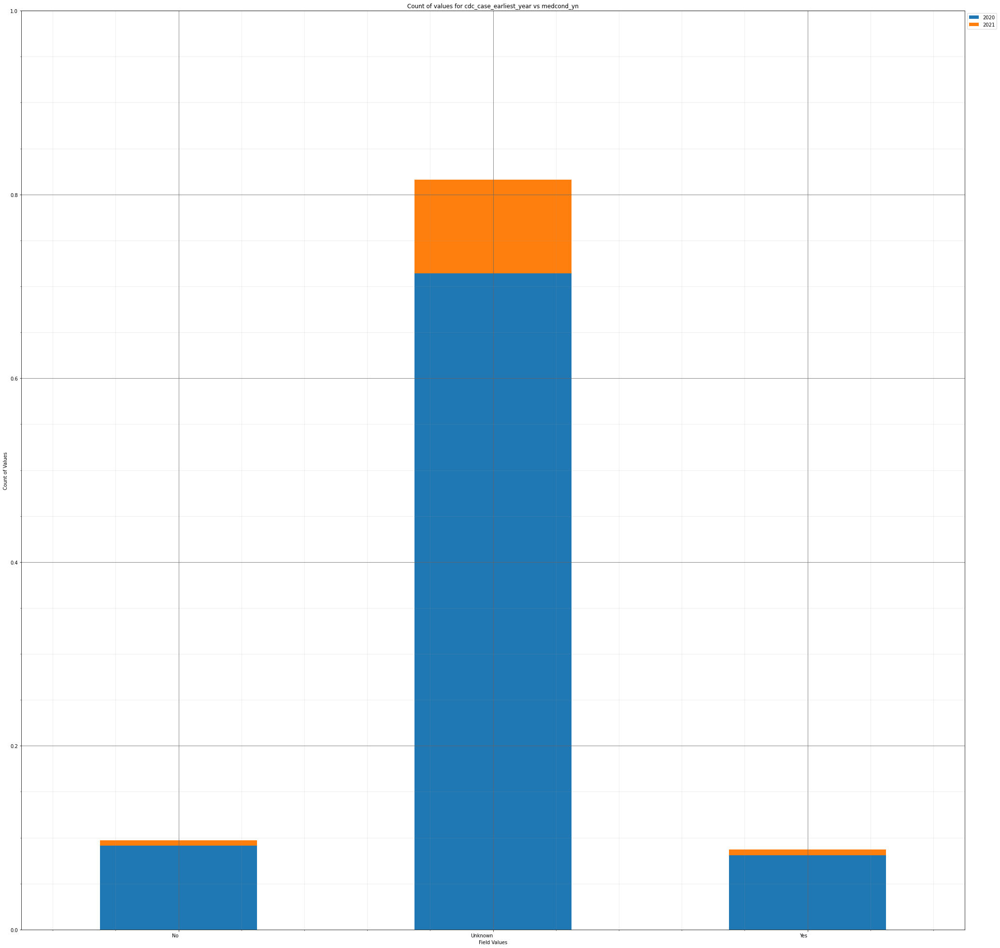



----------------------


Grouping over medcond_yn|demographic_missing results in:



,medcond_yn,demographic_missing,Rows,% Frequency
0,No,False,758,7.938835
1,No,True,168,1.759531
2,Unknown,False,4260,44.616674
3,Unknown,True,3531,36.981567
4,Yes,False,706,7.394219
5,Yes,True,125,1.309175


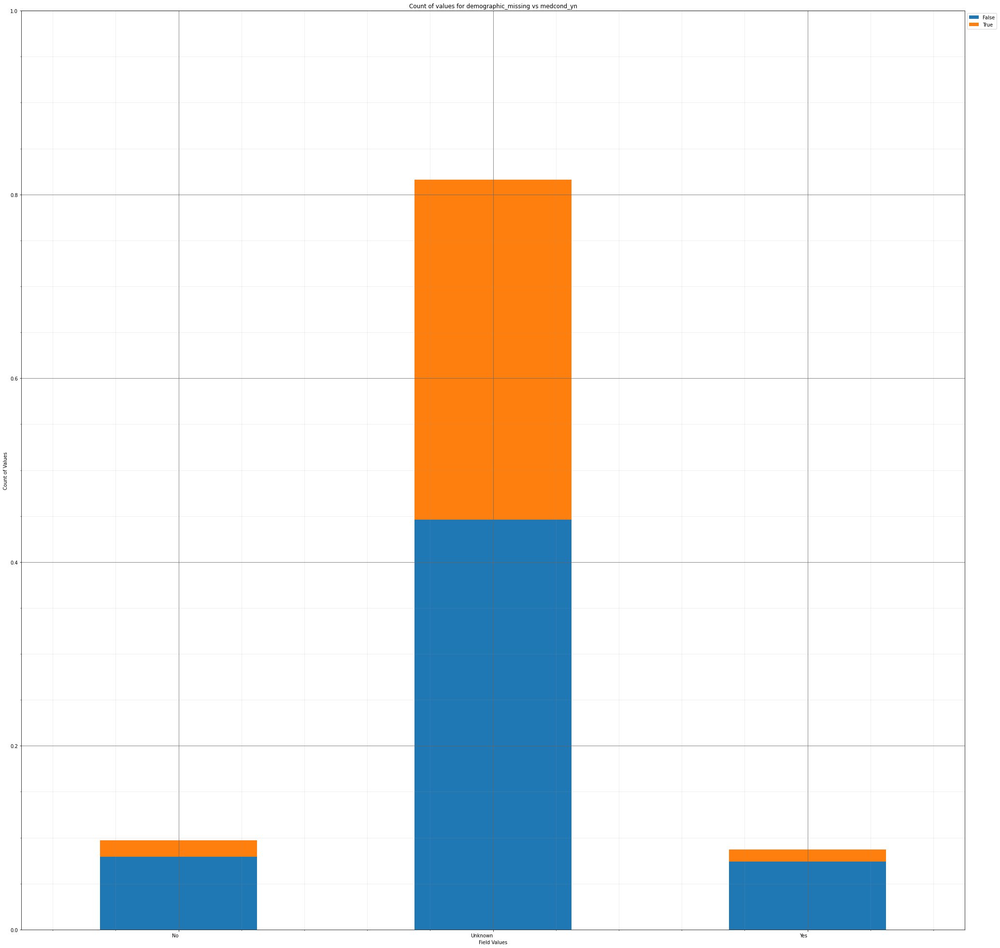



----------------------


Grouping over medcond_yn|medical_missing results in:



,medcond_yn,medical_missing,Rows,% Frequency
0,No,False,391,4.095098
1,No,True,535,5.603268
2,Unknown,False,0,0.000000
3,Unknown,True,7791,81.598240
4,Yes,False,338,3.540008
5,Yes,True,493,5.163385


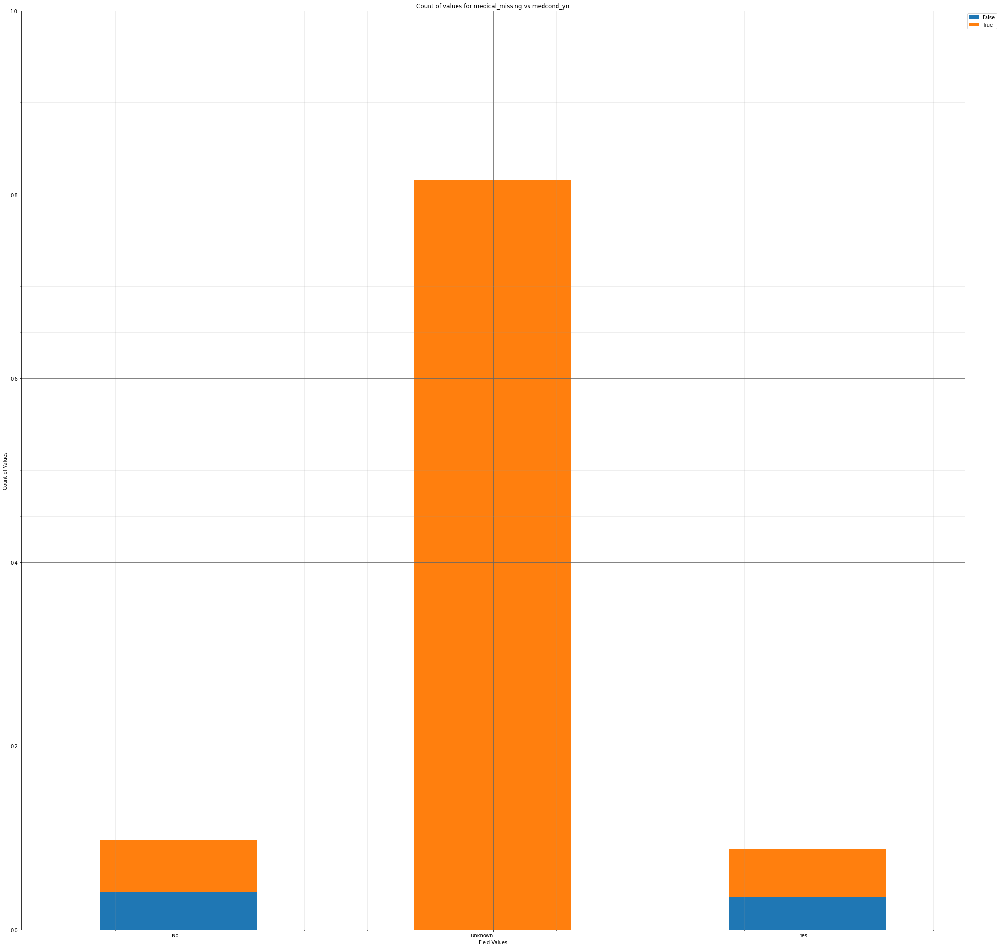



----------------------


Grouping over race|current_status results in:



,race,current_status,Rows,% Frequency
0,American Indian/Alaska Native,Laboratory-confirmed case,62,0.649351
1,American Indian/Alaska Native,Probable Case,4,0.041894
2,Asian,Laboratory-confirmed case,231,2.419355
3,Asian,Probable Case,8,0.083787
4,Black,Laboratory-confirmed case,669,7.006703
5,Black,Probable Case,24,0.251362
6,Hispanic/Latino,Laboratory-confirmed case,901,9.436531
7,Hispanic/Latino,Probable Case,27,0.282782
8,Multiple/Other,Laboratory-confirmed case,478,5.006284
9,Multiple/Other,Probable Case,32,0.335149


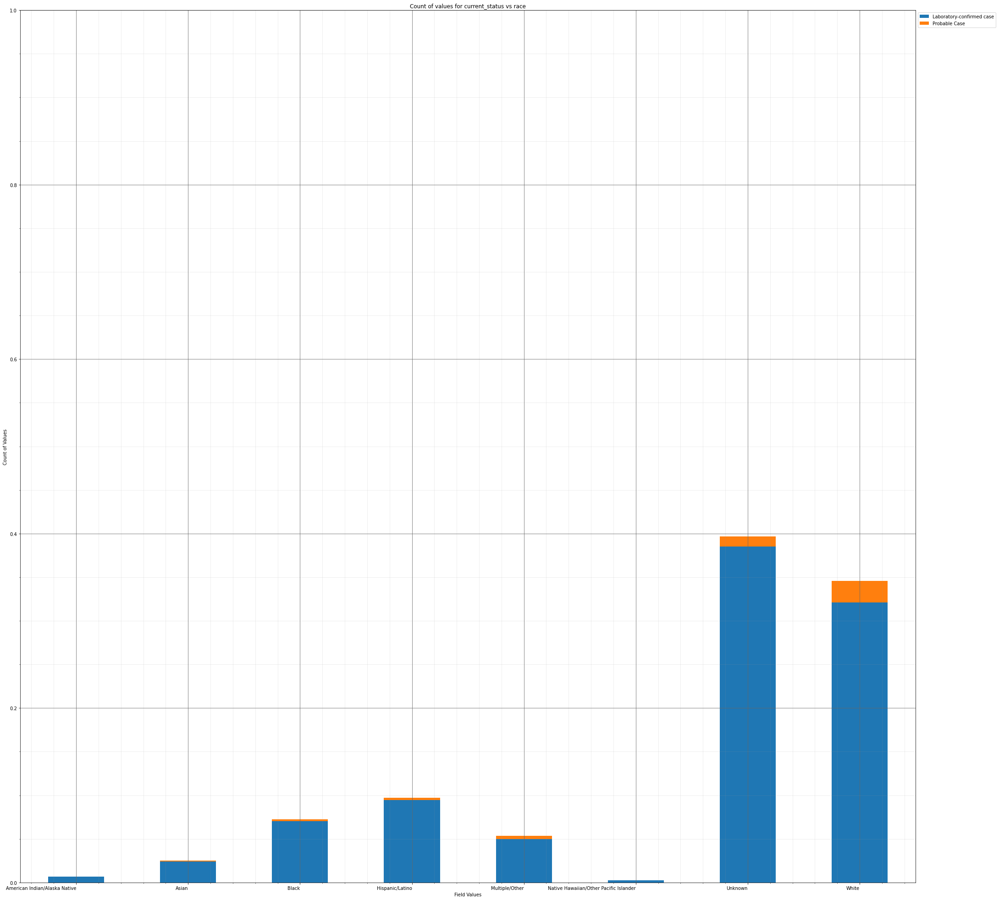



----------------------


Grouping over race|sex results in:



,race,sex,Rows,% Frequency
0,American Indian/Alaska Native,Female,34,0.356096
1,American Indian/Alaska Native,Male,32,0.335149
2,American Indian/Alaska Native,Unknown,0,0.000000
3,Asian,Female,122,1.277755
4,Asian,Male,114,1.193967
5,Asian,Unknown,3,0.031420
6,Black,Female,410,4.294093
7,Black,Male,281,2.943025
8,Black,Unknown,2,0.020947
9,Hispanic/Latino,Female,510,5.341433


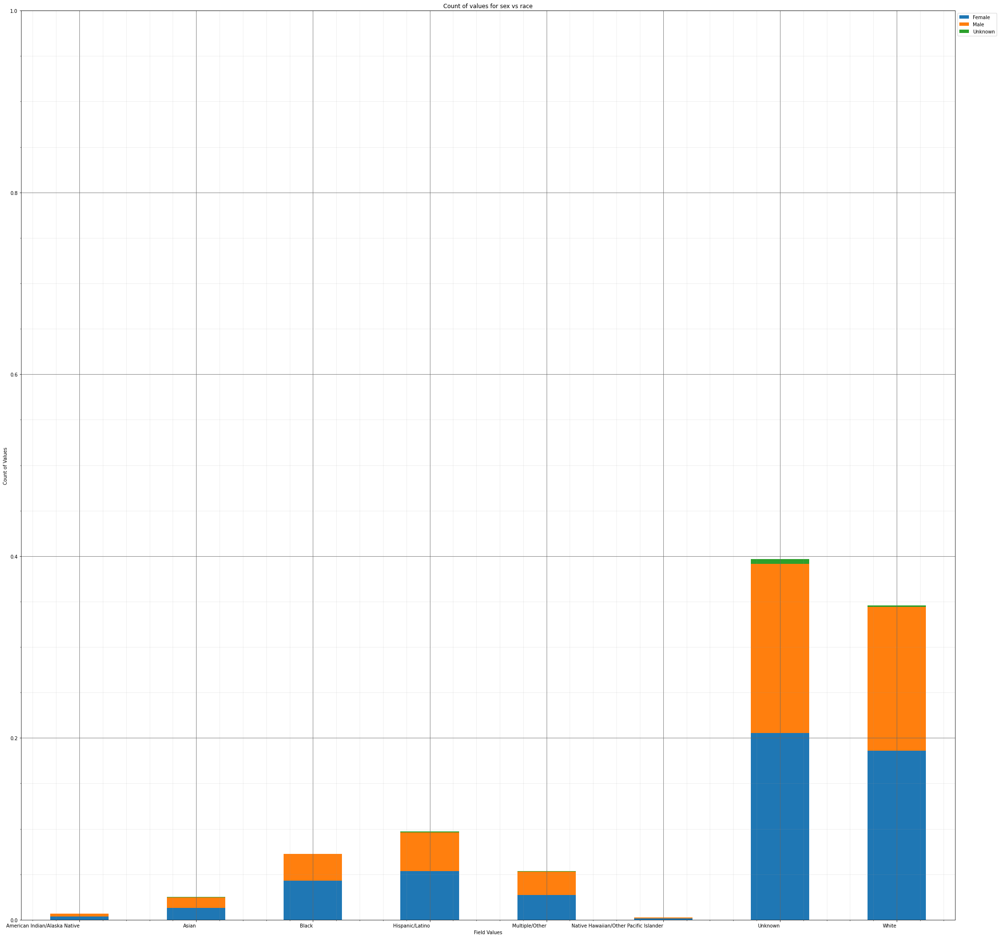



----------------------


Grouping over race|age_group results in:



,race,age_group,Rows,% Frequency
0,American Indian/Alaska Native,0 - 9 Years,4,0.041894
1,American Indian/Alaska Native,10 - 19 Years,8,0.083787
2,American Indian/Alaska Native,20 - 29 Years,12,0.125681
3,American Indian/Alaska Native,30 - 39 Years,8,0.083787
4,American Indian/Alaska Native,40 - 49 Years,12,0.125681
...,...,...,...,...
75,White,50 - 59 Years,520,5.446167
76,White,60 - 69 Years,437,4.576875
77,White,70 - 79 Years,299,3.131546
78,White,80+ Years,236,2.471722


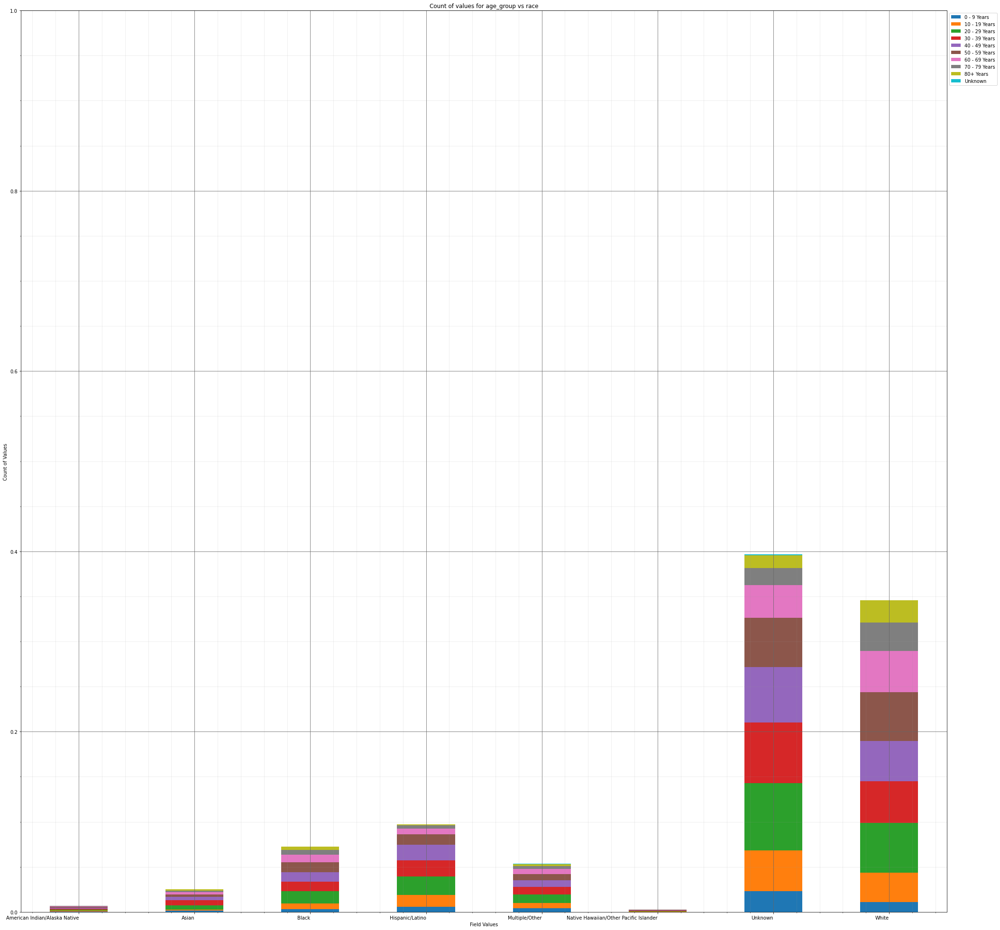



----------------------


Grouping over race|hosp_yn results in:



,race,hosp_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,39,0.408463
1,American Indian/Alaska Native,OTH,0,0.000000
2,American Indian/Alaska Native,Unknown,14,0.146628
3,American Indian/Alaska Native,Yes,13,0.136154
4,Asian,No,113,1.183494
5,Asian,OTH,0,0.000000
6,Asian,Unknown,103,1.078760
7,Asian,Yes,23,0.240888
8,Black,No,438,4.587348
9,Black,OTH,0,0.000000


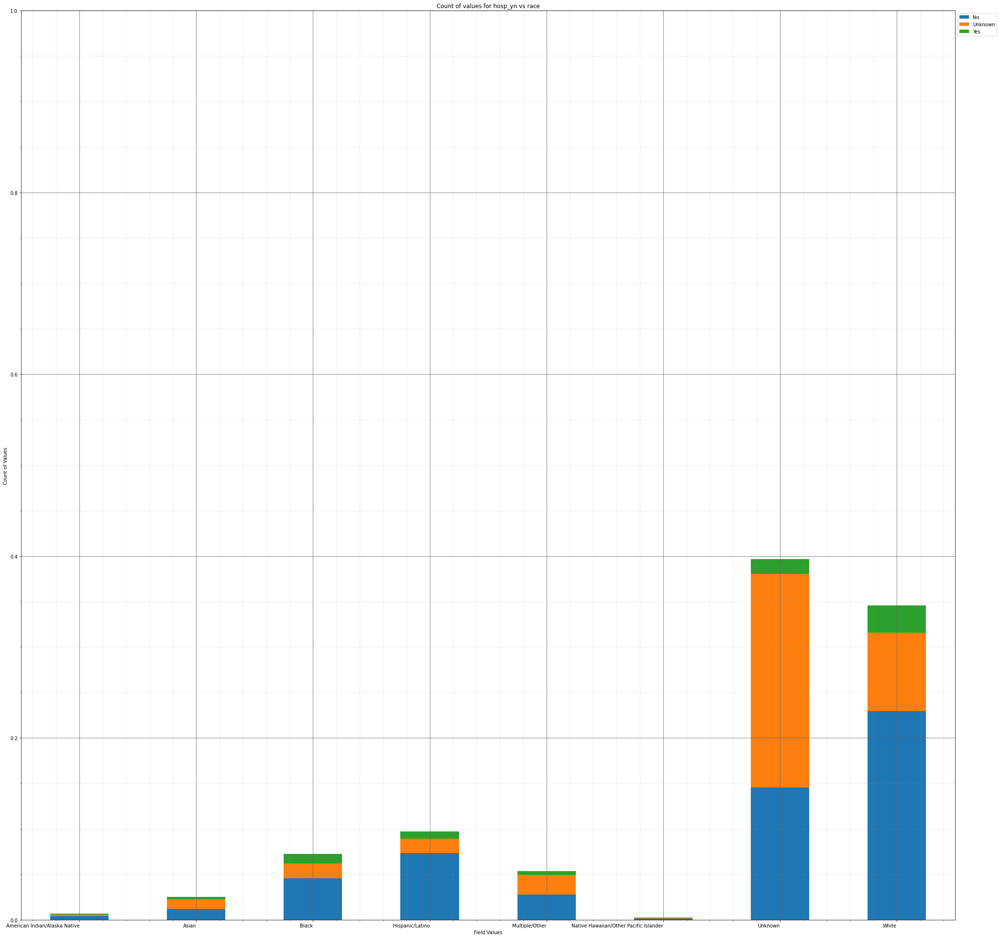



----------------------


Grouping over race|icu_yn results in:



,race,icu_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,7,0.073314
1,American Indian/Alaska Native,Unknown,57,0.596984
2,American Indian/Alaska Native,Yes,2,0.020947
3,Asian,No,14,0.146628
4,Asian,Unknown,221,2.314621
5,Asian,Yes,4,0.041894
6,Black,No,68,0.712191
7,Black,Unknown,616,6.451613
8,Black,Yes,9,0.094261
9,Hispanic/Latino,No,159,1.665270


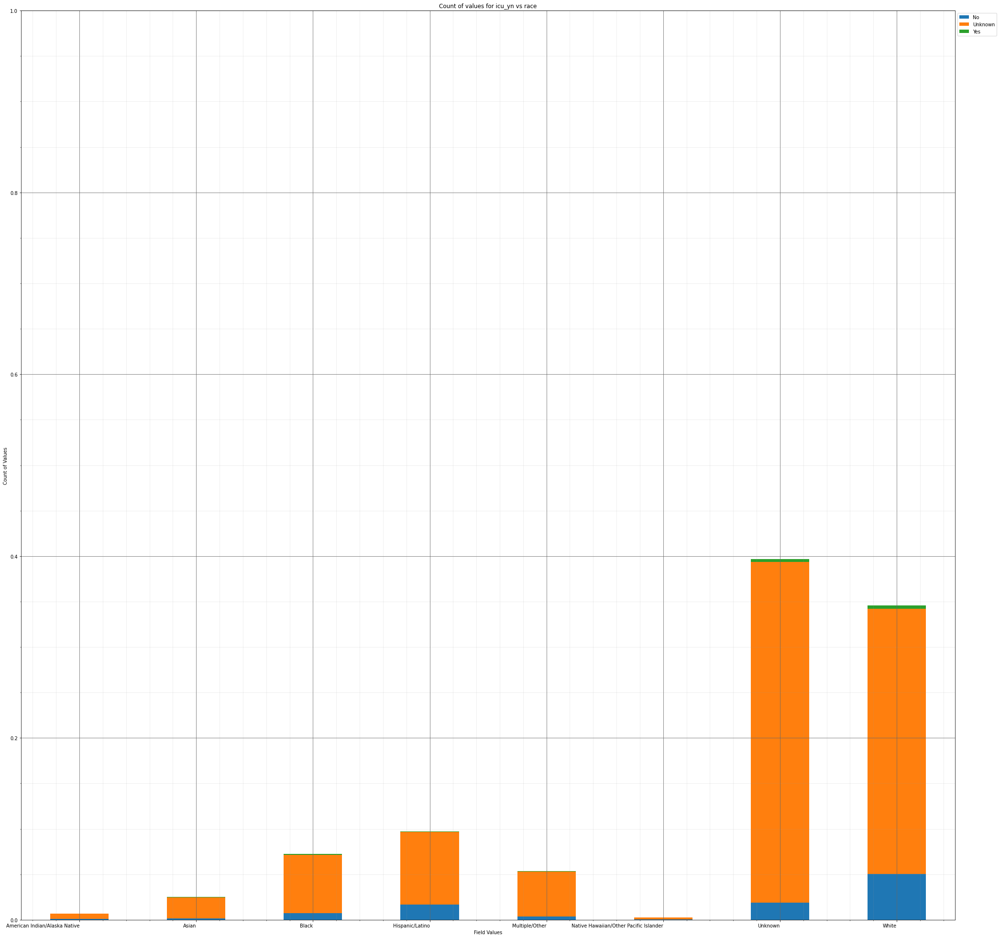



----------------------


Grouping over race|death_yn results in:



,race,death_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,60,0.628404
1,American Indian/Alaska Native,Yes,6,0.062840
2,Asian,No,229,2.398408
3,Asian,Yes,10,0.104734
4,Black,No,655,6.860075
5,Black,Yes,38,0.397989
6,Hispanic/Latino,No,900,9.426058
7,Hispanic/Latino,Yes,28,0.293255
8,Multiple/Other,No,499,5.226225
9,Multiple/Other,Yes,11,0.115207


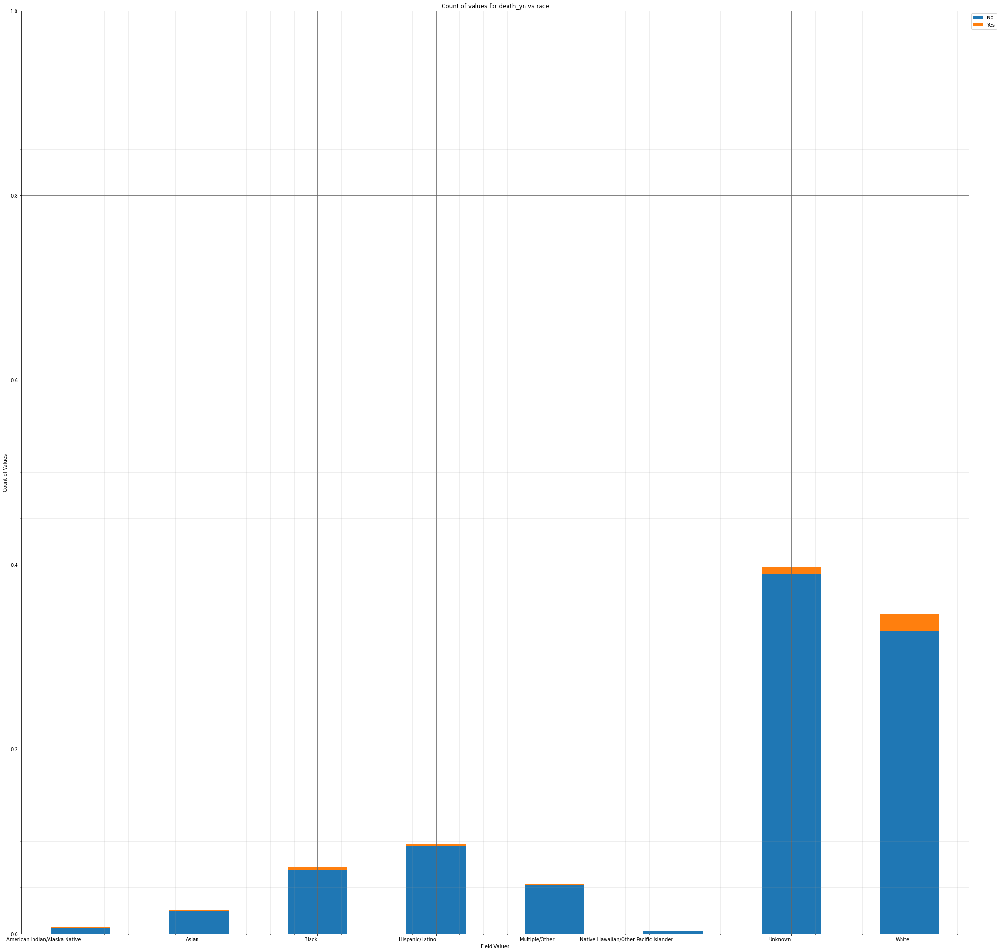



----------------------


Grouping over race|medcond_yn results in:



,race,medcond_yn,Rows,% Frequency
0,American Indian/Alaska Native,No,4,0.041894
1,American Indian/Alaska Native,Unknown,55,0.576037
2,American Indian/Alaska Native,Yes,7,0.073314
3,Asian,No,17,0.178048
4,Asian,Unknown,204,2.136573
5,Asian,Yes,18,0.188521
6,Black,No,69,0.722664
7,Black,Unknown,500,5.236699
8,Black,Yes,124,1.298701
9,Hispanic/Latino,No,155,1.623377


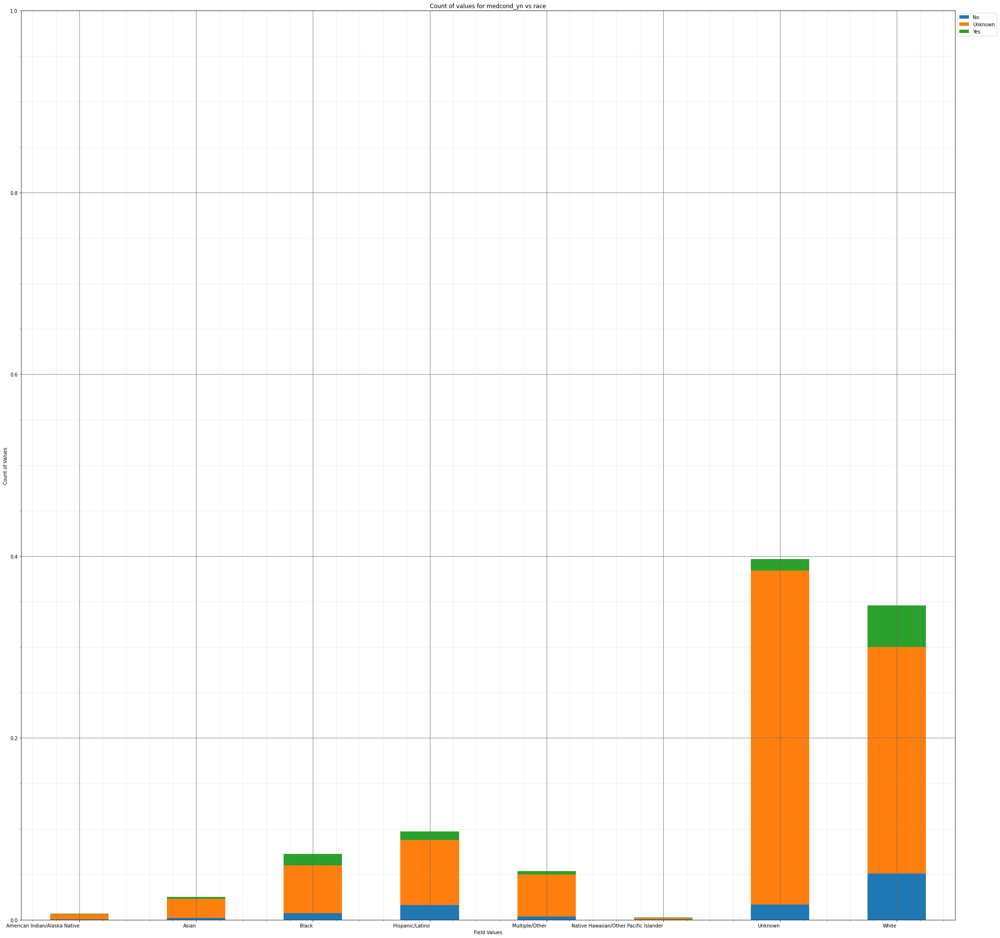



----------------------


Grouping over race|cdc_case_earliest_day results in:



,race,cdc_case_earliest_day,Rows,% Frequency
0,American Indian/Alaska Native,1,1,0.010473
1,American Indian/Alaska Native,2,2,0.020947
2,American Indian/Alaska Native,3,2,0.020947
3,American Indian/Alaska Native,4,5,0.052367
4,American Indian/Alaska Native,5,0,0.000000
...,...,...,...,...
243,White,27,99,1.036866
244,White,28,91,0.953079
245,White,29,120,1.256808
246,White,30,114,1.193967


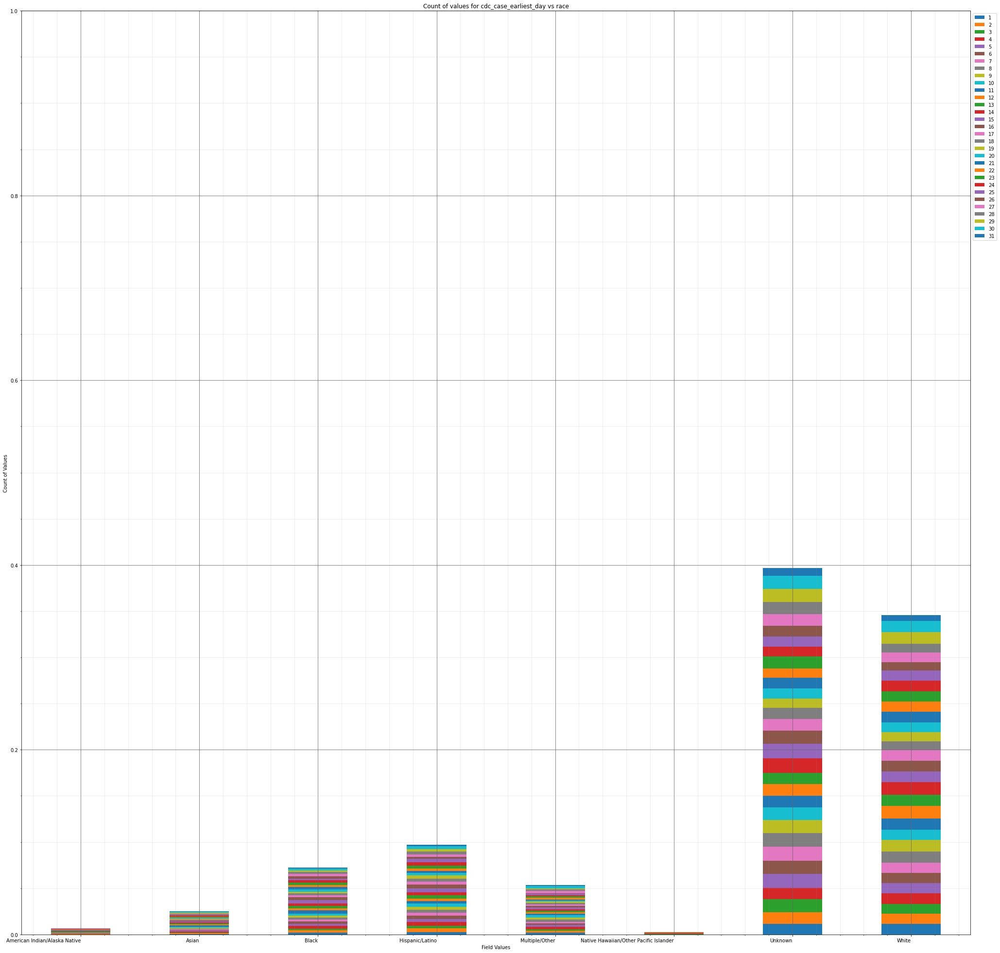



----------------------


Grouping over race|cdc_case_earliest_weekday results in:



,race,cdc_case_earliest_weekday,Rows,% Frequency
0,American Indian/Alaska Native,0,15,0.157101
1,American Indian/Alaska Native,1,11,0.115207
2,American Indian/Alaska Native,2,5,0.052367
3,American Indian/Alaska Native,3,6,0.062840
4,American Indian/Alaska Native,4,8,0.083787
5,American Indian/Alaska Native,5,13,0.136154
6,American Indian/Alaska Native,6,8,0.083787
7,Asian,0,37,0.387516
8,Asian,1,29,0.303729
9,Asian,2,51,0.534143


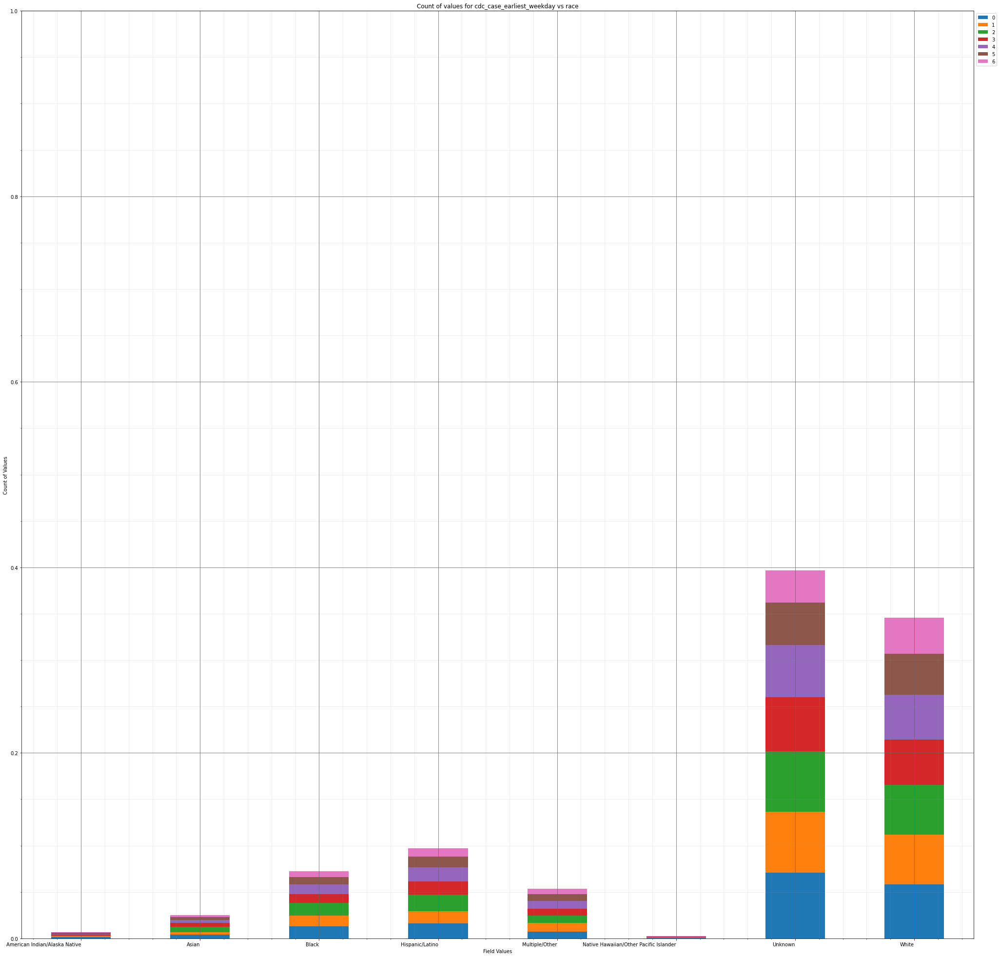



----------------------


Grouping over race|cdc_case_earliest_month results in:



,race,cdc_case_earliest_month,Rows,% Frequency
0,American Indian/Alaska Native,1,9,0.094261
1,American Indian/Alaska Native,2,0,0.000000
2,American Indian/Alaska Native,3,1,0.010473
3,American Indian/Alaska Native,4,0,0.000000
4,American Indian/Alaska Native,5,2,0.020947
...,...,...,...,...
91,White,8,177,1.853791
92,White,9,240,2.513615
93,White,10,400,4.189359
94,White,11,741,7.760788


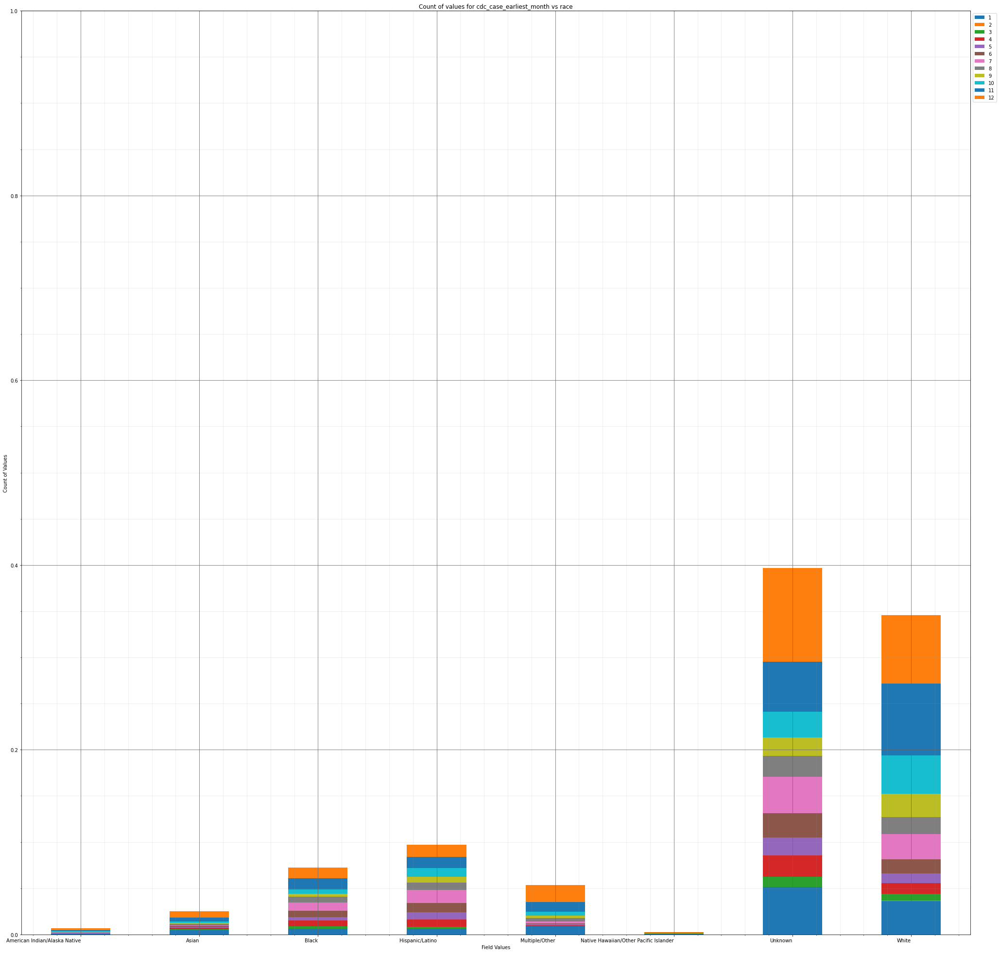



----------------------


Grouping over race|cdc_case_earliest_year results in:



,race,cdc_case_earliest_year,Rows,% Frequency
0,American Indian/Alaska Native,2020,57,0.596984
1,American Indian/Alaska Native,2021,9,0.094261
2,Asian,2020,195,2.042313
3,Asian,2021,44,0.460829
4,Black,2020,634,6.640134
5,Black,2021,59,0.617930
6,Hispanic/Latino,2020,870,9.111856
7,Hispanic/Latino,2021,58,0.607457
8,Multiple/Other,2020,430,4.503561
9,Multiple/Other,2021,80,0.837872


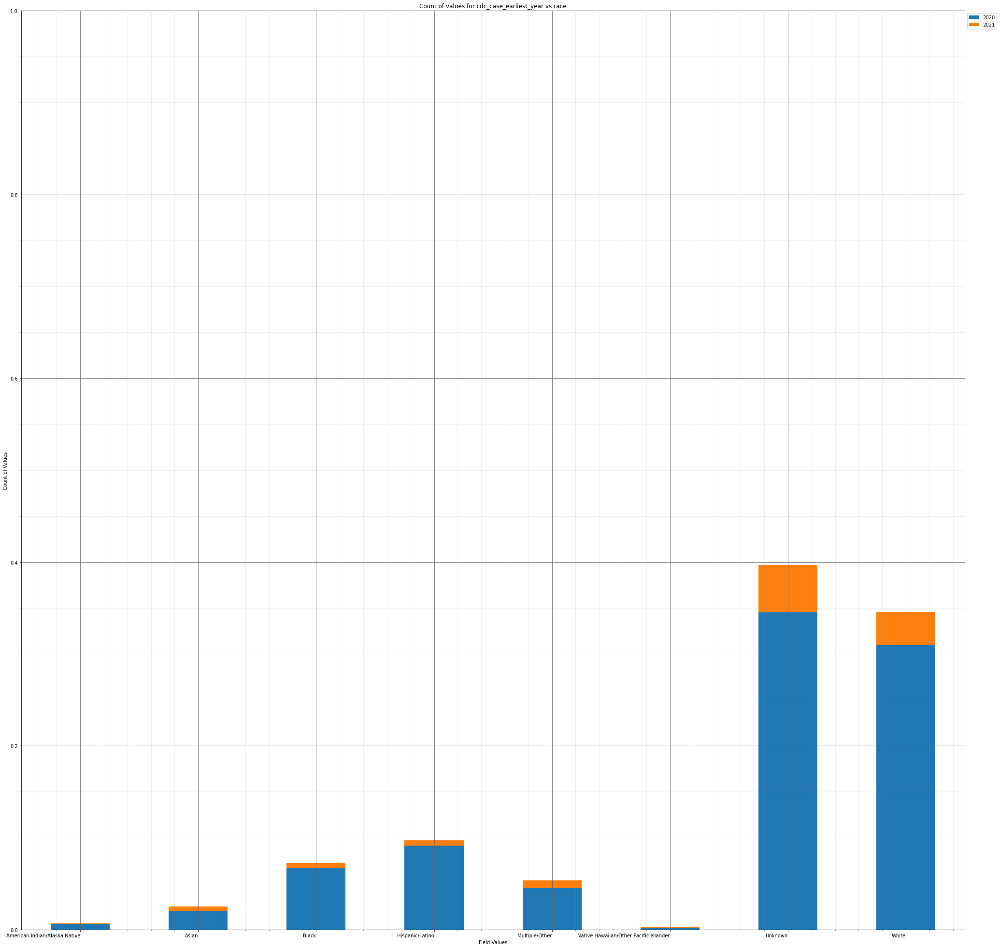



----------------------


Grouping over race|demographic_missing results in:



,race,demographic_missing,Rows,% Frequency
0,American Indian/Alaska Native,False,66,0.691244
1,American Indian/Alaska Native,True,0,0.000000
2,Asian,False,236,2.471722
3,Asian,True,3,0.031420
4,Black,False,691,7.237118
5,Black,True,2,0.020947
6,Hispanic/Latino,False,919,9.625052
7,Hispanic/Latino,True,9,0.094261
8,Multiple/Other,False,504,5.278592
9,Multiple/Other,True,6,0.062840


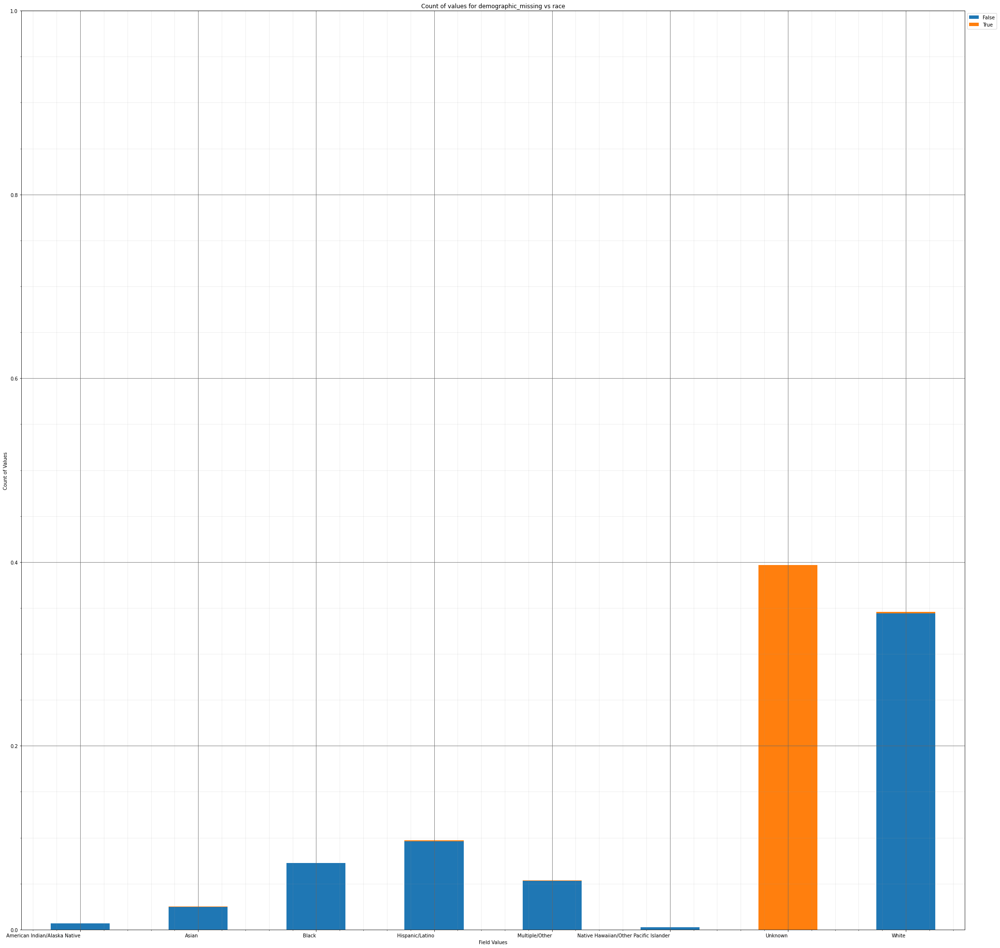



----------------------


Grouping over race|medical_missing results in:



,race,medical_missing,Rows,% Frequency
0,American Indian/Alaska Native,False,4,0.041894
1,American Indian/Alaska Native,True,62,0.649351
2,Asian,False,12,0.125681
3,Asian,True,227,2.377461
4,Black,False,57,0.596984
5,Black,True,636,6.661081
6,Hispanic/Latino,False,112,1.173021
7,Hispanic/Latino,True,816,8.546292
8,Multiple/Other,False,28,0.293255
9,Multiple/Other,True,482,5.048178


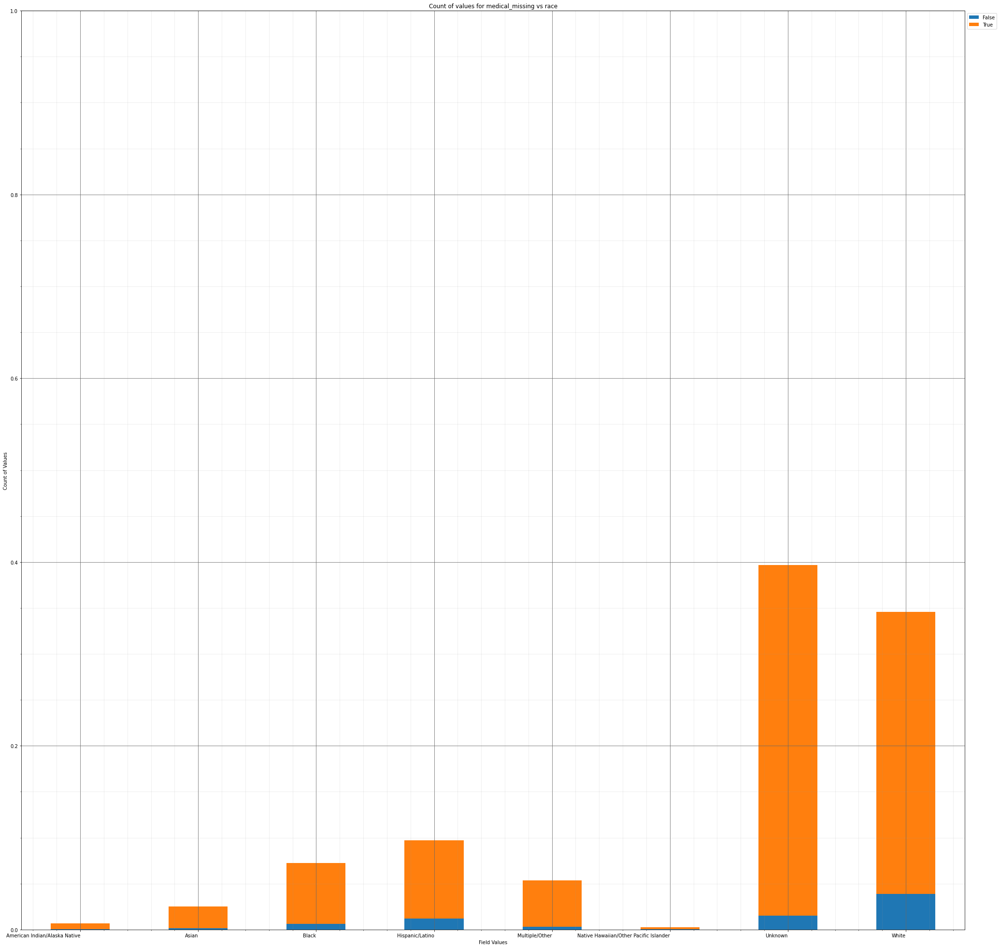



----------------------


Grouping over cdc_case_earliest_day|current_status results in:



,cdc_case_earliest_day,current_status,Rows,% Frequency
0,1,Laboratory-confirmed case,269,2.817344
1,1,Probable Case,17,0.178048
2,2,Laboratory-confirmed case,310,3.246753
3,2,Probable Case,11,0.115207
4,3,Laboratory-confirmed case,293,3.068705
...,...,...,...,...
57,29,Probable Case,16,0.167574
58,30,Laboratory-confirmed case,321,3.361961
59,30,Probable Case,13,0.136154
60,31,Laboratory-confirmed case,169,1.770004


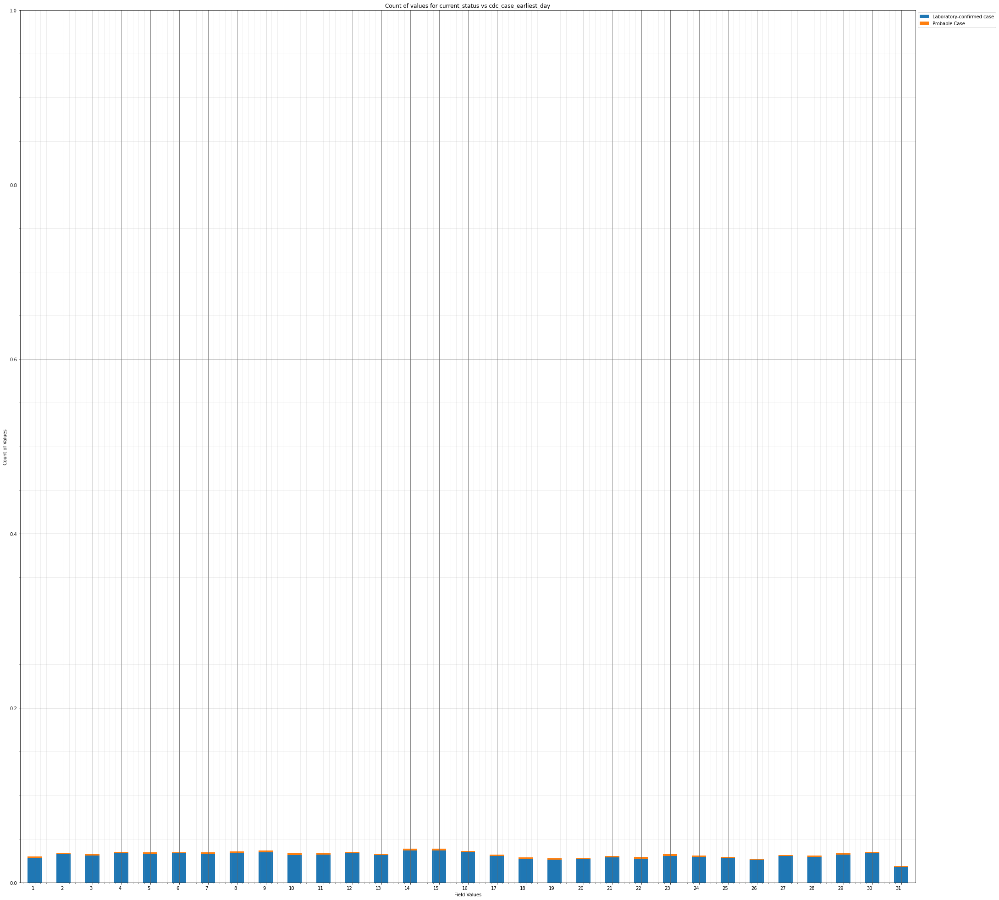



----------------------


Grouping over cdc_case_earliest_day|sex results in:



,cdc_case_earliest_day,sex,Rows,% Frequency
0,1,Female,162,1.696690
1,1,Male,122,1.277755
2,1,Unknown,2,0.020947
3,2,Female,176,1.843318
4,2,Male,144,1.508169
...,...,...,...,...
88,30,Male,163,1.707164
89,30,Unknown,4,0.041894
90,31,Female,84,0.879765
91,31,Male,98,1.026393


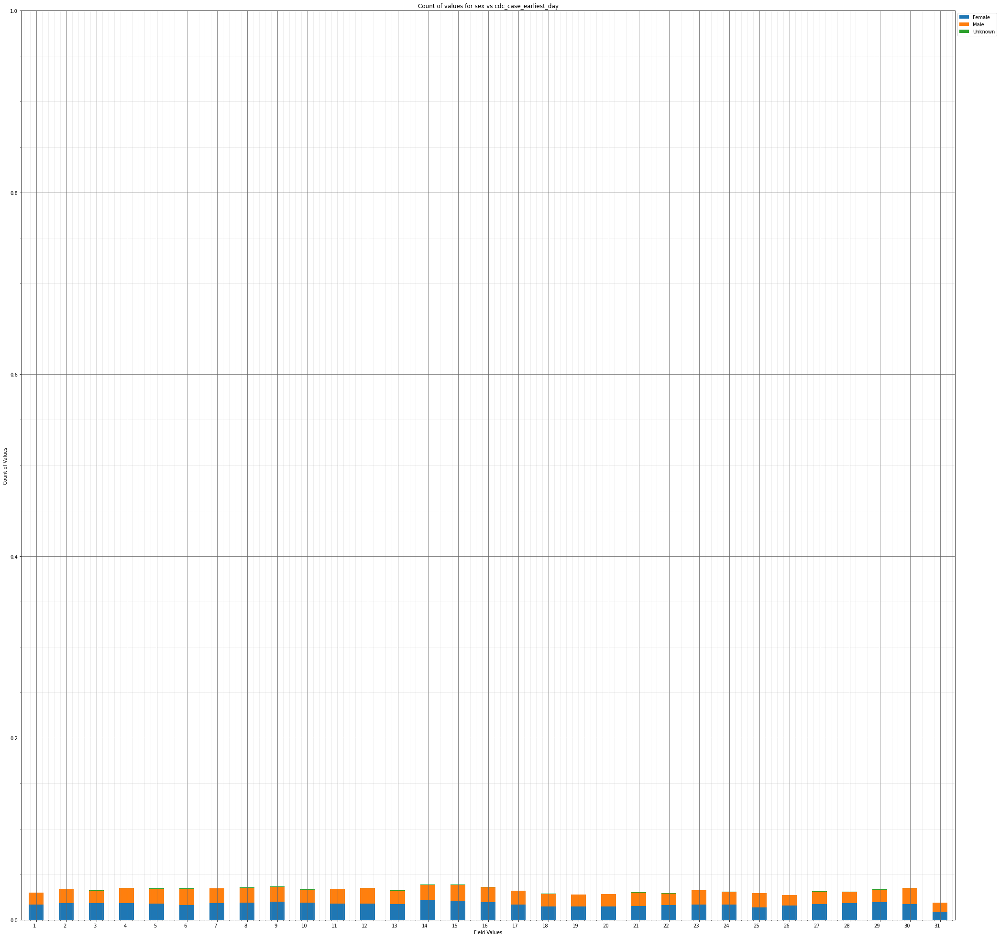



----------------------


Grouping over cdc_case_earliest_day|age_group results in:



,cdc_case_earliest_day,age_group,Rows,% Frequency
0,1,0 - 9 Years,9,0.094261
1,1,10 - 19 Years,31,0.324675
2,1,20 - 29 Years,53,0.555090
3,1,30 - 39 Years,42,0.439883
4,1,40 - 49 Years,43,0.450356
...,...,...,...,...
305,31,50 - 59 Years,27,0.282782
306,31,60 - 69 Years,24,0.251362
307,31,70 - 79 Years,10,0.104734
308,31,80+ Years,5,0.052367


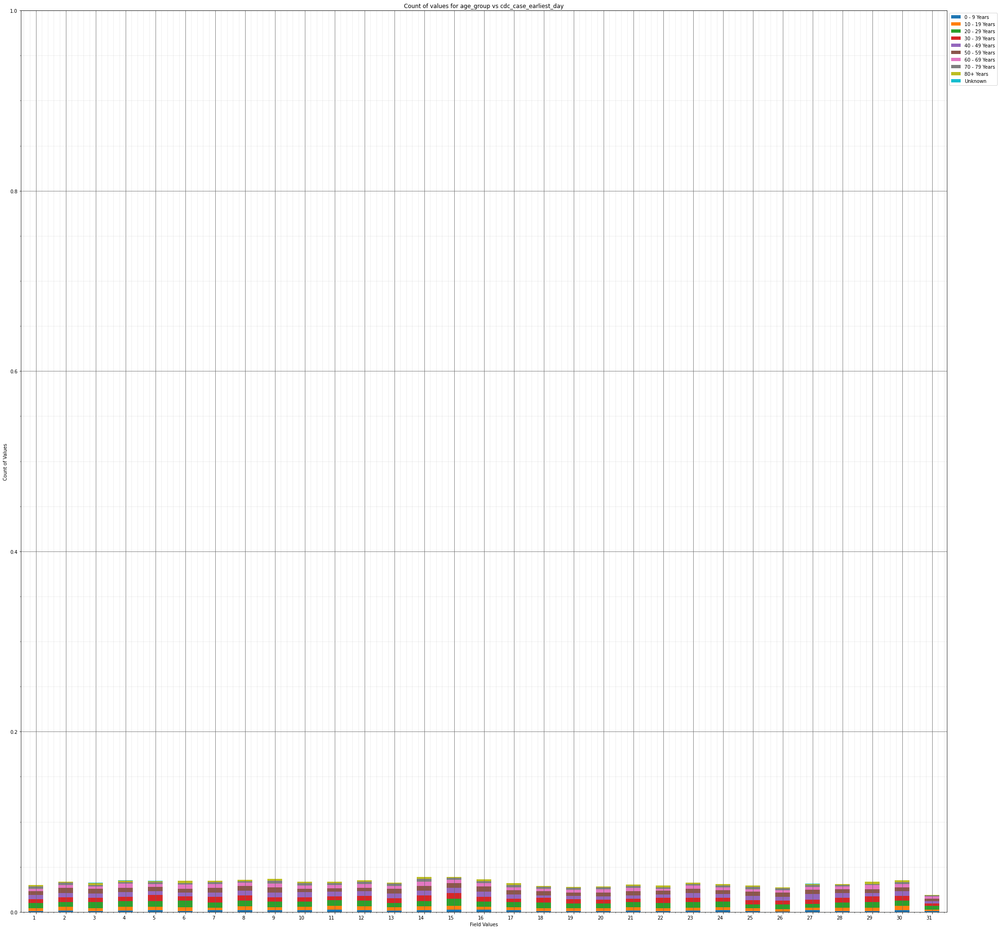



----------------------


Grouping over cdc_case_earliest_day|hosp_yn results in:



,cdc_case_earliest_day,hosp_yn,Rows,% Frequency
0,1,No,150,1.571010
1,1,OTH,0,0.000000
2,1,Unknown,109,1.141600
3,1,Yes,27,0.282782
4,2,No,180,1.885212
...,...,...,...,...
119,30,Yes,31,0.324675
120,31,No,97,1.015920
121,31,OTH,0,0.000000
122,31,Unknown,76,0.795978


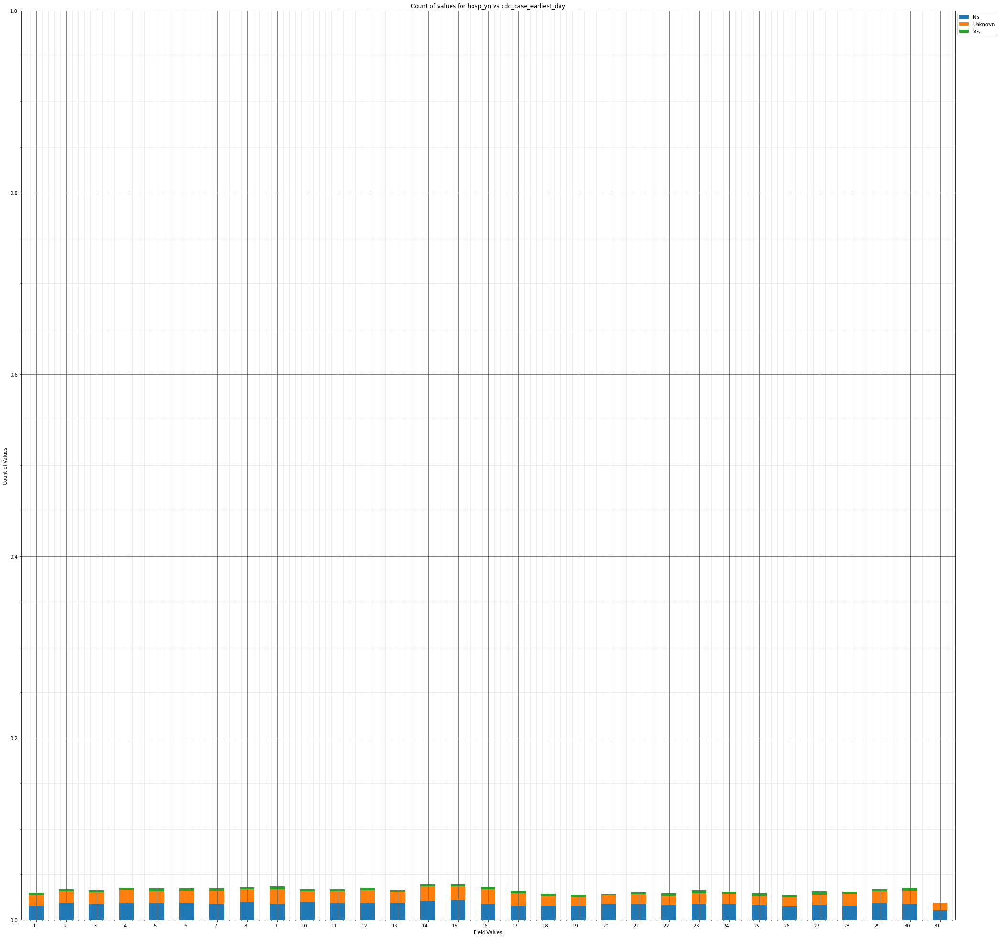



----------------------


Grouping over cdc_case_earliest_day|icu_yn results in:



,cdc_case_earliest_day,icu_yn,Rows,% Frequency
0,1,No,32,0.335149
1,1,Unknown,251,2.628823
2,1,Yes,3,0.031420
3,2,No,28,0.293255
4,2,Unknown,291,3.047759
...,...,...,...,...
88,30,Unknown,295,3.089652
89,30,Yes,5,0.052367
90,31,No,15,0.157101
91,31,Unknown,166,1.738584


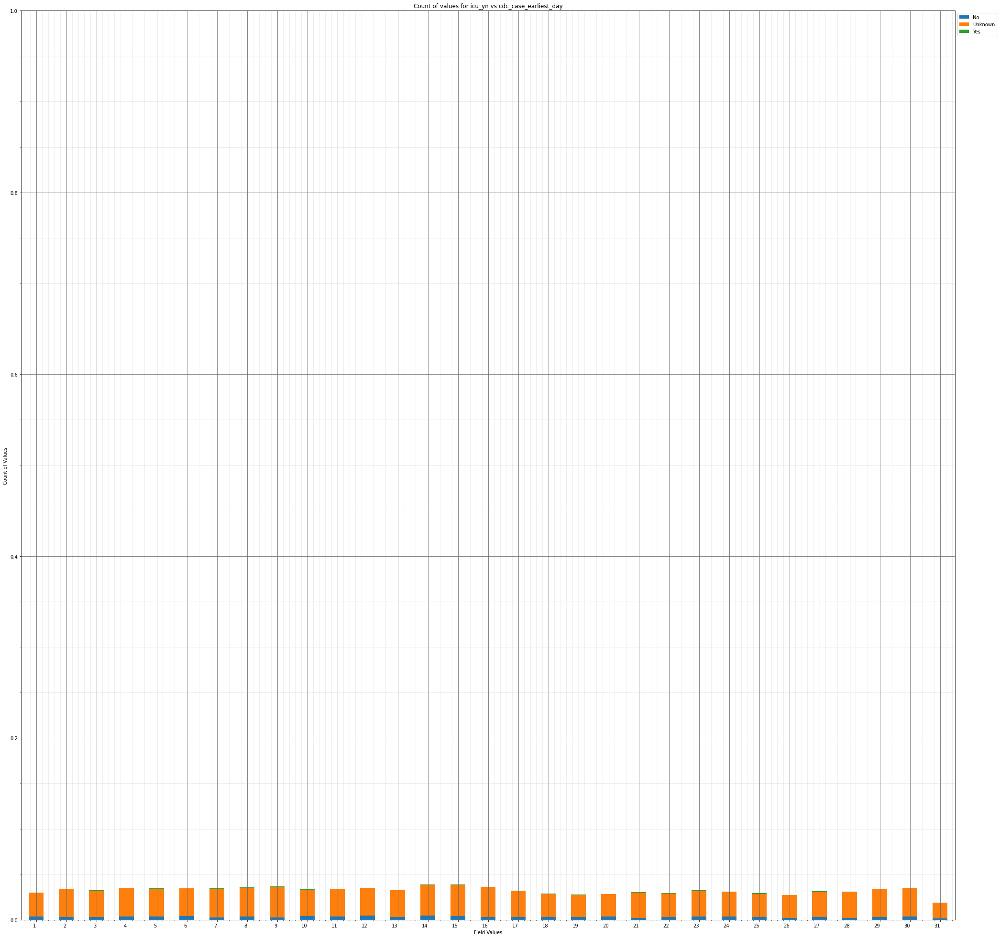



----------------------


Grouping over cdc_case_earliest_day|death_yn results in:



,cdc_case_earliest_day,death_yn,Rows,% Frequency
0,1,No,275,2.880184
1,1,Yes,11,0.115207
2,2,No,315,3.299120
3,2,Yes,6,0.062840
4,3,No,297,3.110599
...,...,...,...,...
57,29,Yes,11,0.115207
58,30,No,323,3.382907
59,30,Yes,11,0.115207
60,31,No,177,1.853791


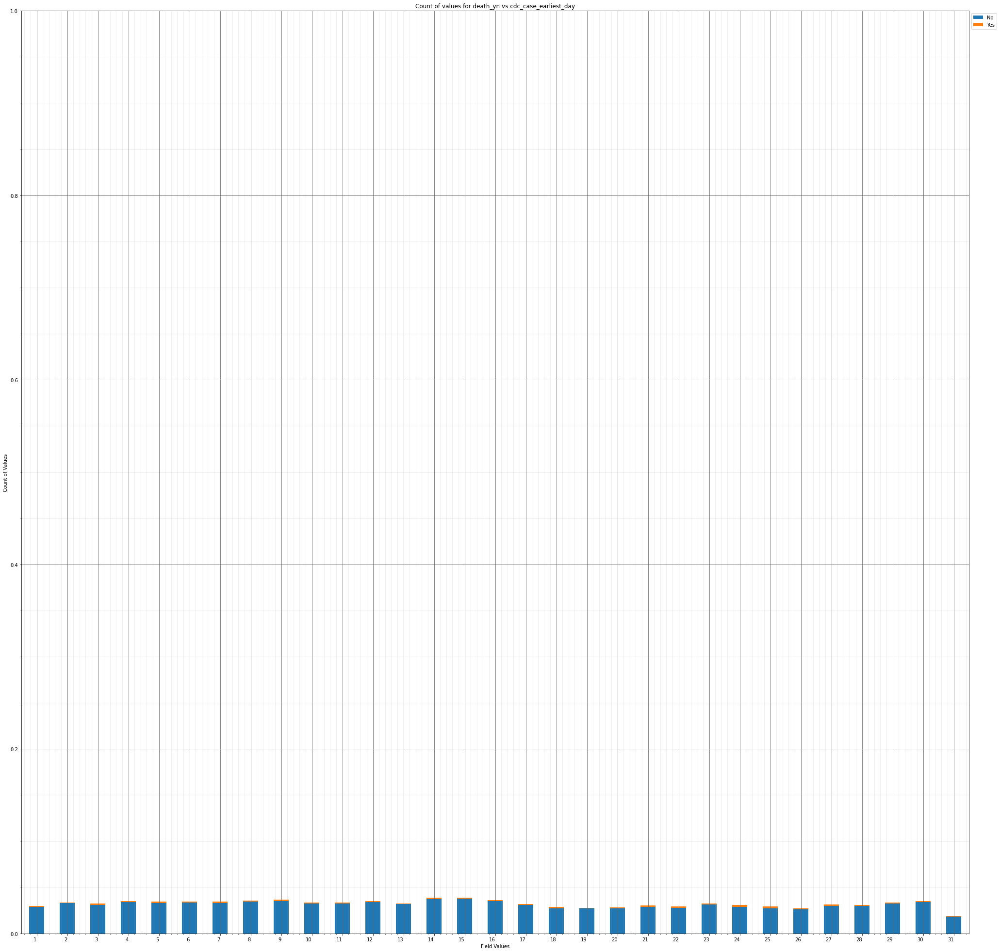



----------------------


Grouping over cdc_case_earliest_day|medcond_yn results in:



,cdc_case_earliest_day,medcond_yn,Rows,% Frequency
0,1,No,28,0.293255
1,1,Unknown,234,2.450775
2,1,Yes,24,0.251362
3,2,No,24,0.251362
4,2,Unknown,268,2.806871
...,...,...,...,...
88,30,Unknown,280,2.932551
89,30,Yes,27,0.282782
90,31,No,12,0.125681
91,31,Unknown,154,1.612903


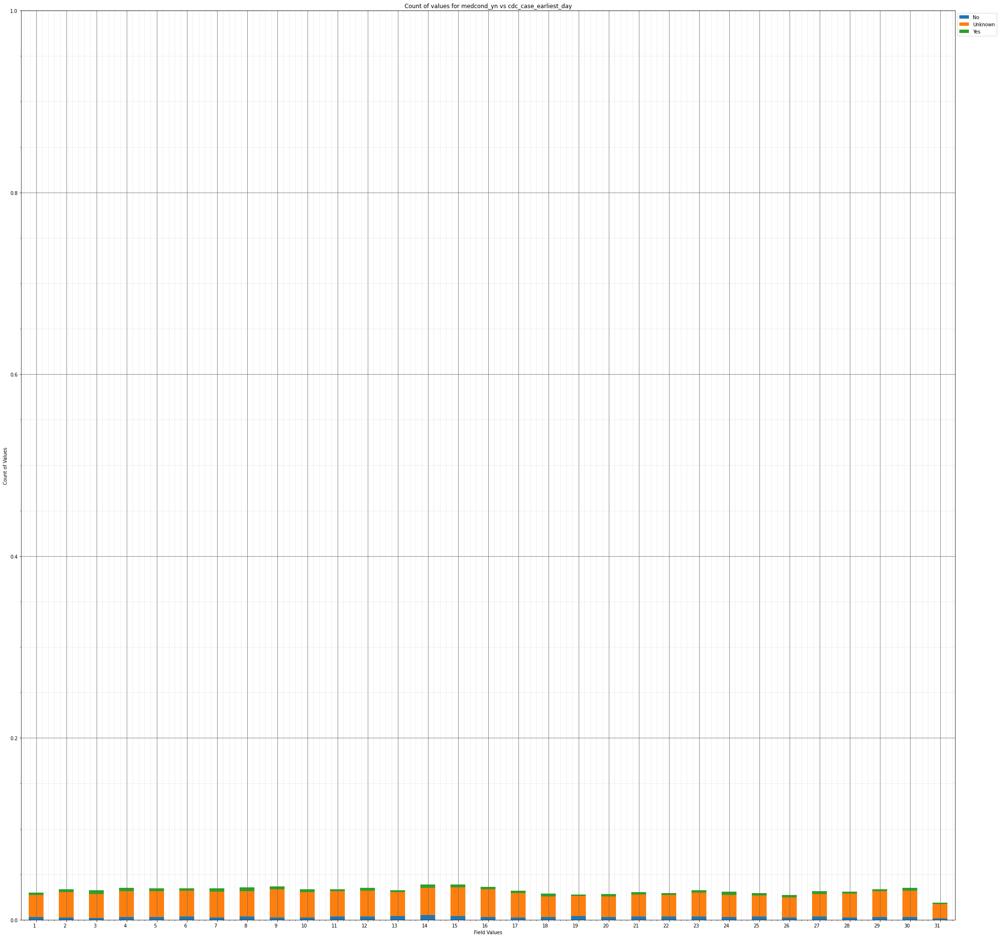



----------------------


Grouping over cdc_case_earliest_day|race results in:



,cdc_case_earliest_day,race,Rows,% Frequency
0,1,American Indian/Alaska Native,1,0.010473
1,1,Asian,4,0.041894
2,1,Black,20,0.209468
3,1,Hispanic/Latino,25,0.261835
4,1,Multiple/Other,19,0.198995
...,...,...,...,...
243,31,Hispanic/Latino,16,0.167574
244,31,Multiple/Other,11,0.115207
245,31,Native Hawaiian/Other Pacific Islander,0,0.000000
246,31,Unknown,78,0.816925


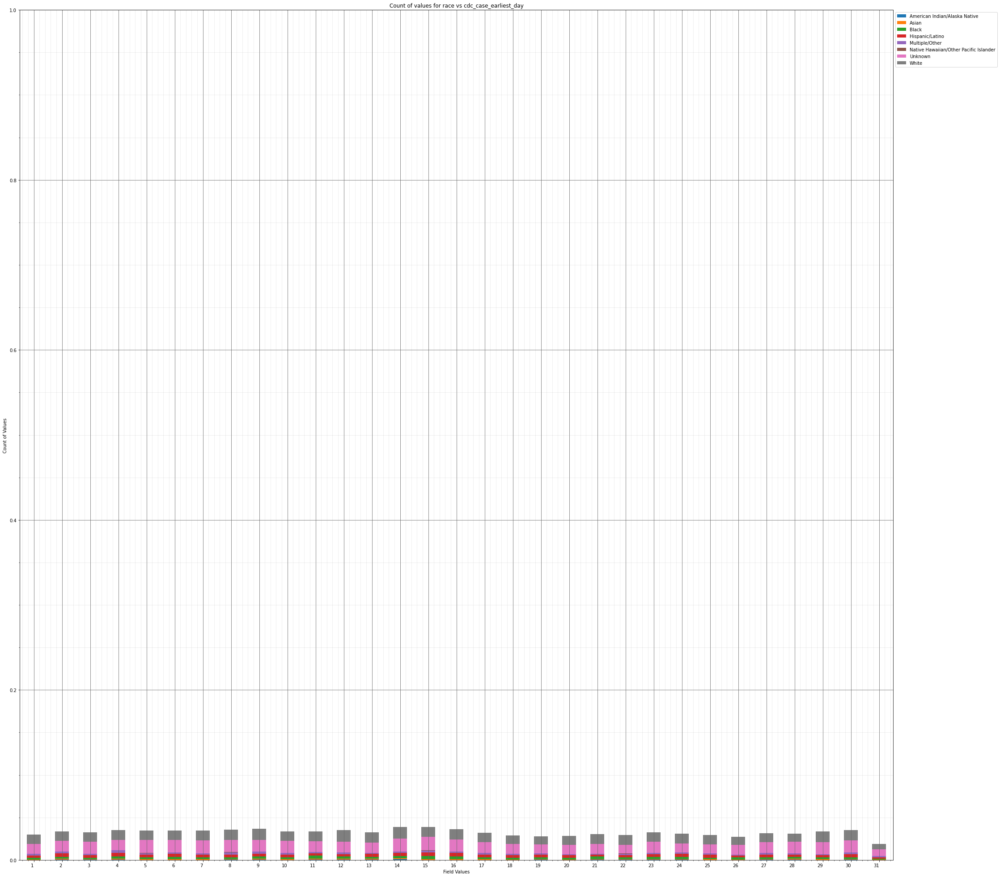



----------------------


Grouping over cdc_case_earliest_day|cdc_case_earliest_weekday results in:



,cdc_case_earliest_day,cdc_case_earliest_weekday,Rows,% Frequency
0,1,0,10,0.104734
1,1,1,88,0.921659
2,1,2,50,0.523670
3,1,3,24,0.251362
4,1,4,59,0.617930
...,...,...,...,...
212,31,2,0,0.000000
213,31,3,90,0.942606
214,31,4,19,0.198995
215,31,5,37,0.387516


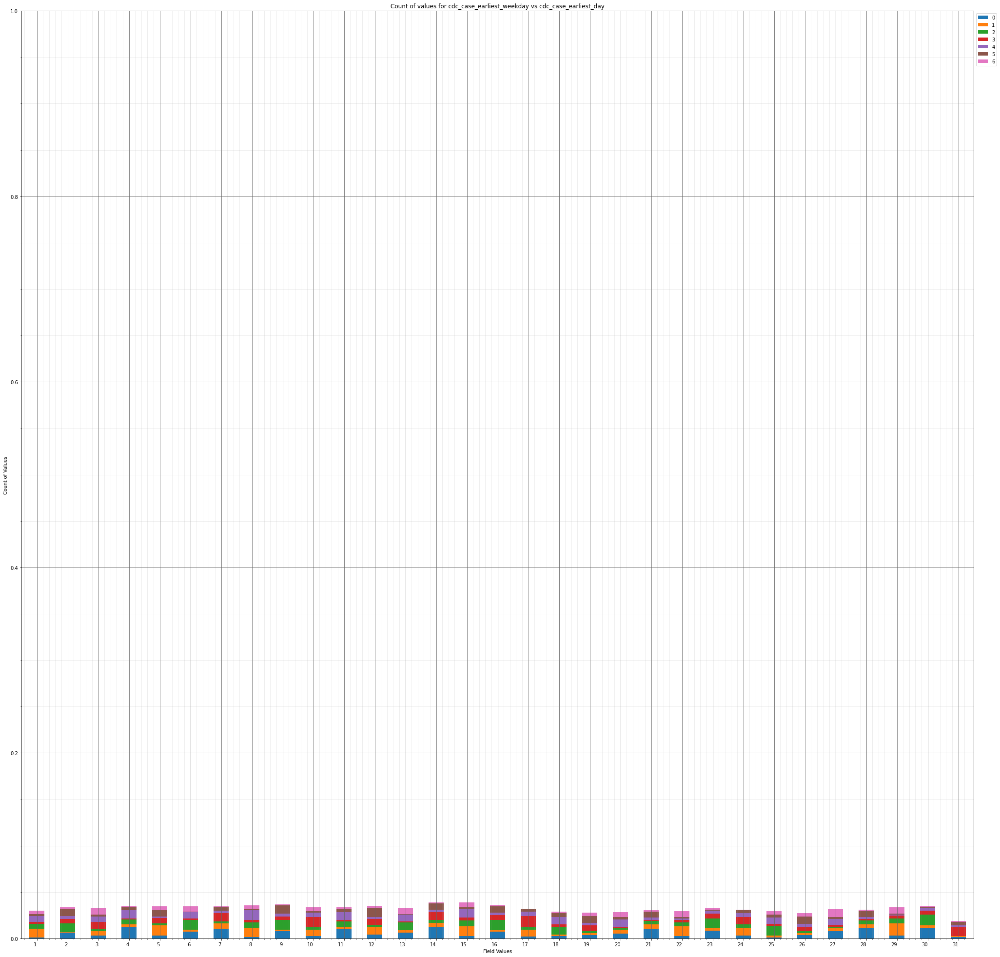



----------------------


Grouping over cdc_case_earliest_day|cdc_case_earliest_month results in:



,cdc_case_earliest_day,cdc_case_earliest_month,Rows,% Frequency
0,1,1,46,0.481776
1,1,2,0,0.000000
2,1,3,0,0.000000
3,1,4,21,0.219941
4,1,5,13,0.136154
...,...,...,...,...
367,31,8,13,0.136154
368,31,9,0,0.000000
369,31,10,37,0.387516
370,31,11,0,0.000000


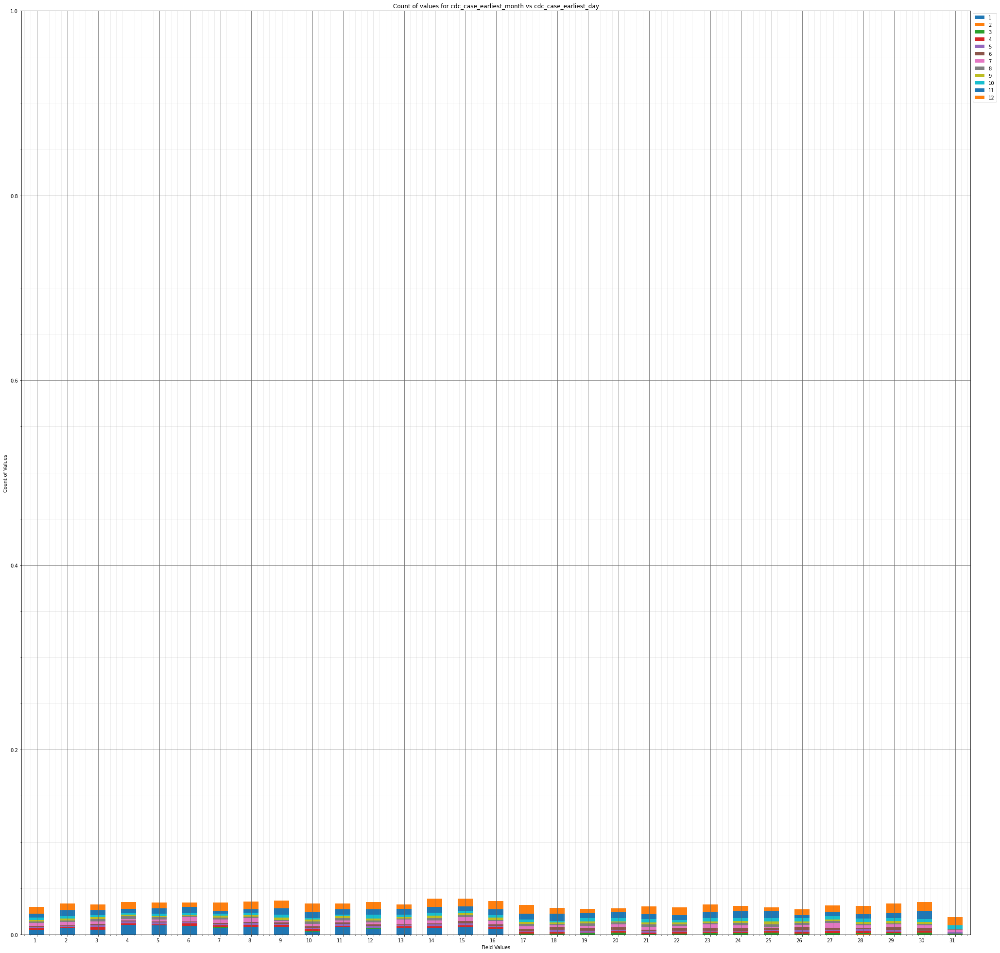



----------------------


Grouping over cdc_case_earliest_day|cdc_case_earliest_year results in:



,cdc_case_earliest_day,cdc_case_earliest_year,Rows,% Frequency
0,1,2020,240,2.513615
1,1,2021,46,0.481776
2,2,2020,255,2.670716
3,2,2021,66,0.691244
4,3,2020,257,2.691663
...,...,...,...,...
57,29,2021,0,0.000000
58,30,2020,334,3.498115
59,30,2021,0,0.000000
60,31,2020,182,1.906158


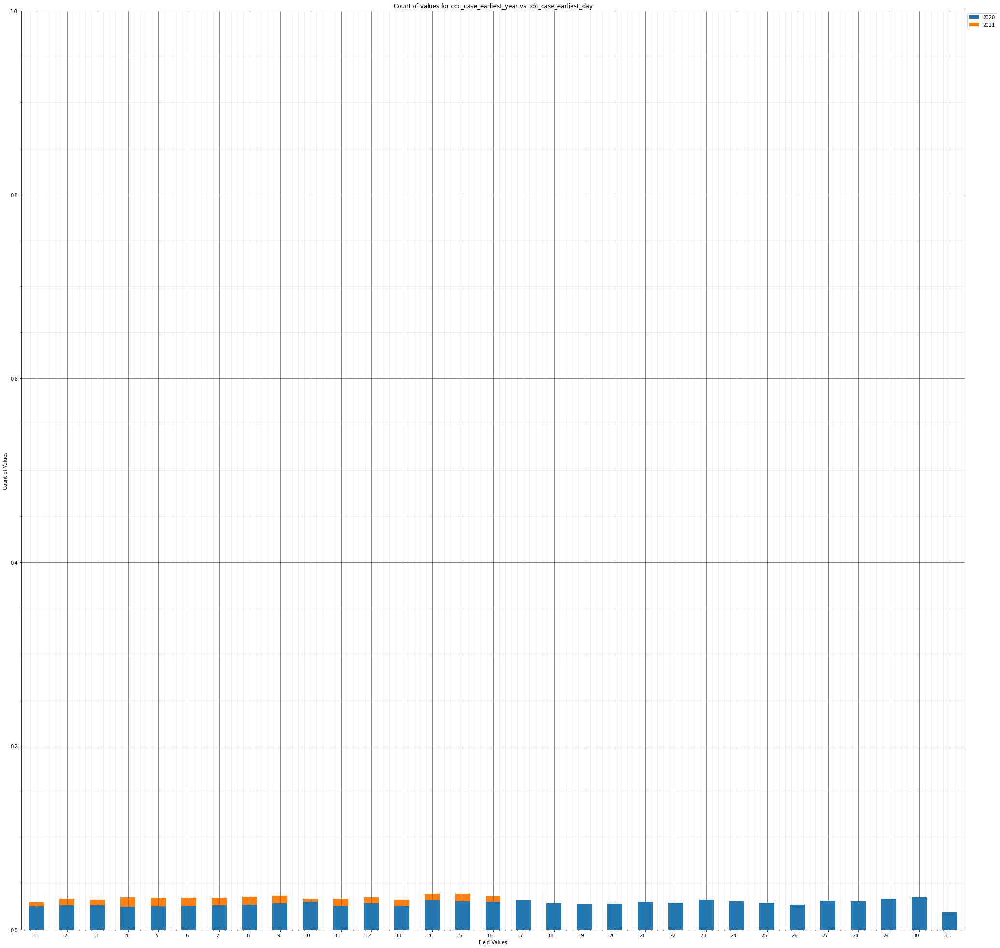



----------------------


Grouping over cdc_case_earliest_day|demographic_missing results in:



,cdc_case_earliest_day,demographic_missing,Rows,% Frequency
0,1,False,176,1.843318
1,1,True,110,1.152074
2,2,False,197,2.063259
3,2,True,124,1.298701
4,3,False,174,1.822371
...,...,...,...,...
57,29,True,137,1.434855
58,30,False,196,2.052786
59,30,True,138,1.445329
60,31,False,103,1.078760


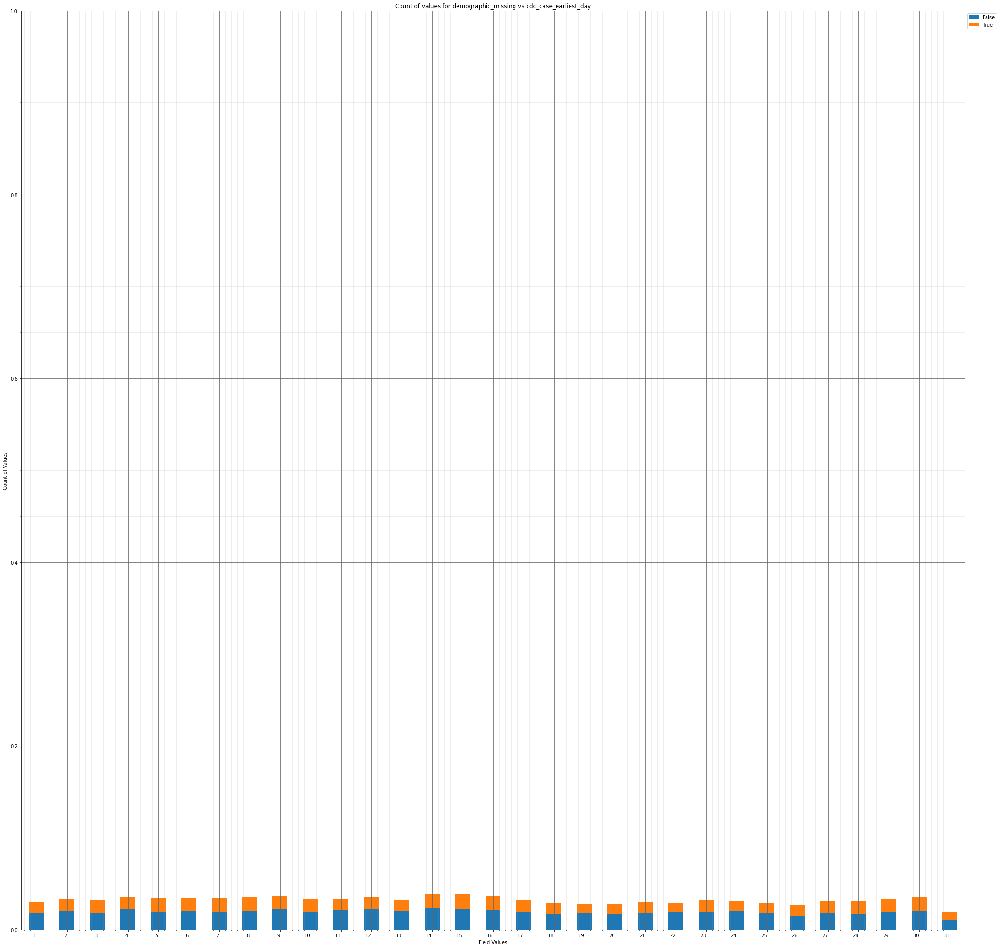



----------------------


Grouping over cdc_case_earliest_day|medical_missing results in:



,cdc_case_earliest_day,medical_missing,Rows,% Frequency
0,1,False,24,0.251362
1,1,True,262,2.744030
2,2,False,20,0.209468
3,2,True,301,3.152493
4,3,False,20,0.209468
...,...,...,...,...
57,29,True,298,3.121072
58,30,False,27,0.282782
59,30,True,307,3.215333
60,31,False,10,0.104734


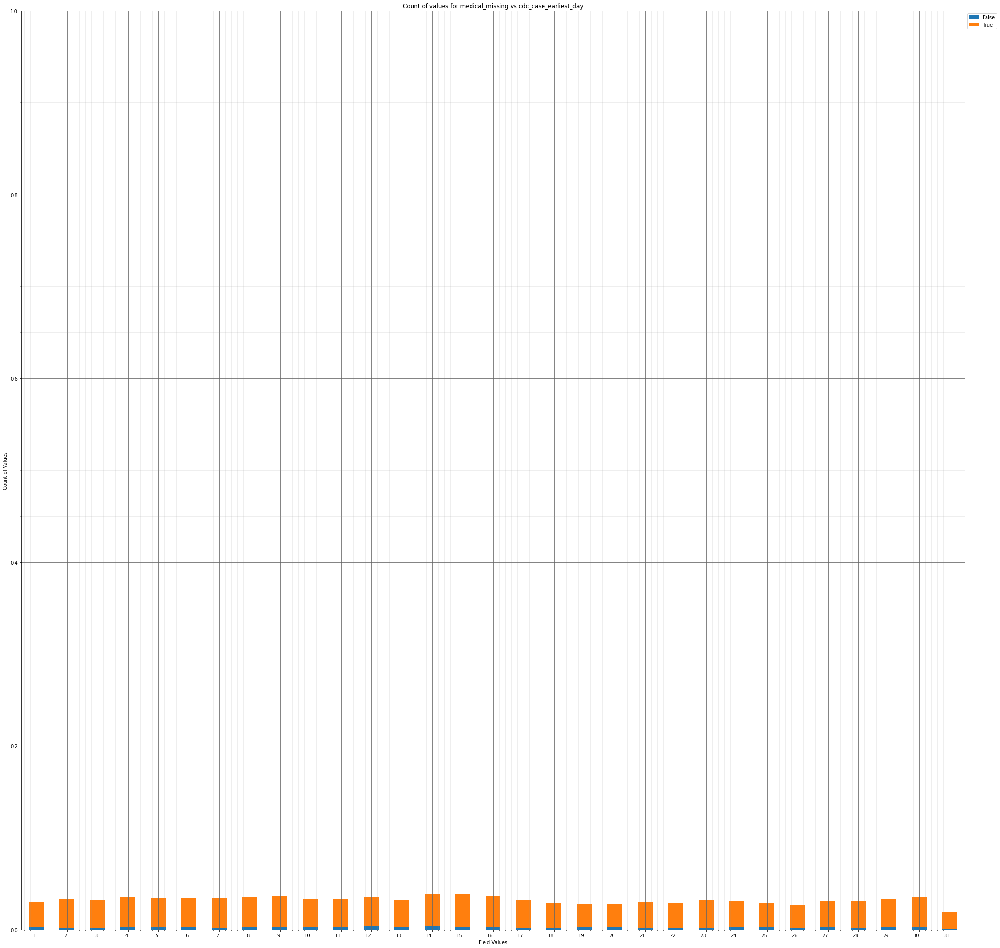



----------------------


Grouping over cdc_case_earliest_weekday|current_status results in:



,cdc_case_earliest_weekday,current_status,Rows,% Frequency
0,0,Laboratory-confirmed case,1566,16.401341
1,0,Probable Case,72,0.754085
2,1,Laboratory-confirmed case,1445,15.134059
3,1,Probable Case,67,0.701718
4,2,Laboratory-confirmed case,1493,15.636783
5,2,Probable Case,71,0.743611
6,3,Laboratory-confirmed case,1314,13.762044
7,3,Probable Case,59,0.617930
8,4,Laboratory-confirmed case,1320,13.824885
9,4,Probable Case,47,0.492250


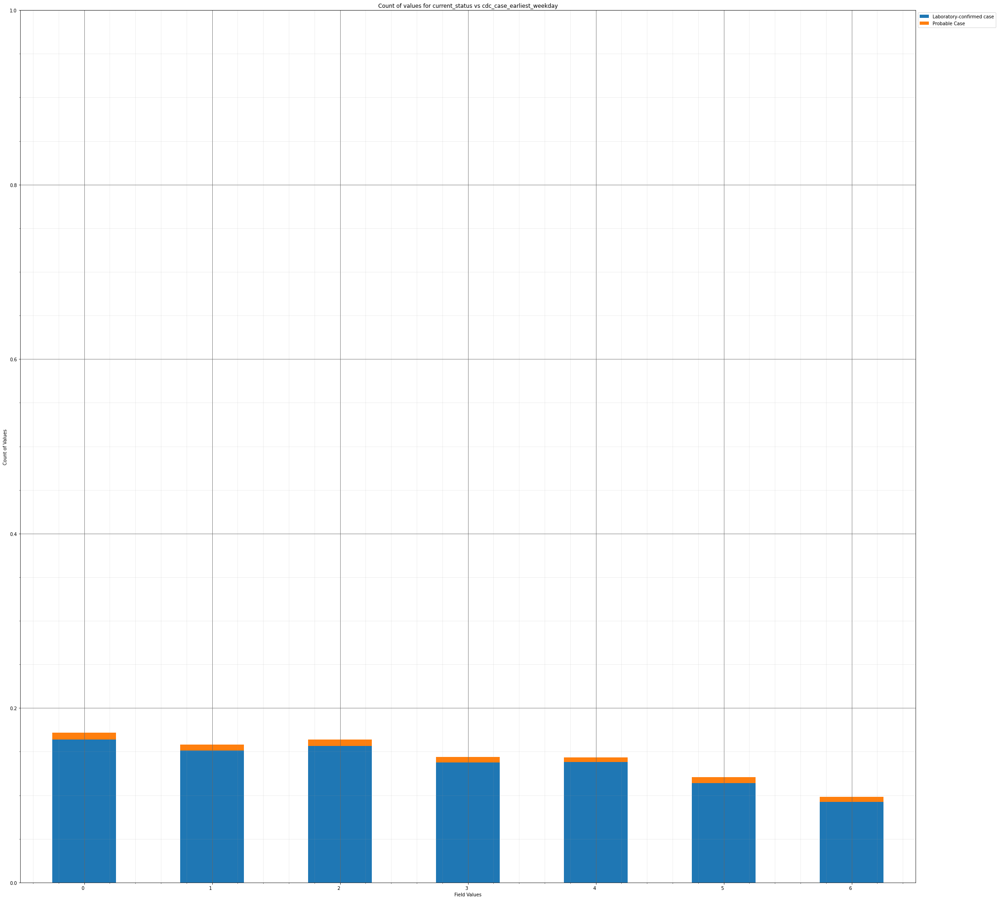



----------------------


Grouping over cdc_case_earliest_weekday|sex results in:



,cdc_case_earliest_weekday,sex,Rows,% Frequency
0,0,Female,870,9.111856
1,0,Male,754,7.896942
2,0,Unknown,14,0.146628
3,1,Female,775,8.116883
4,1,Male,721,7.551320
5,1,Unknown,16,0.167574
6,2,Female,841,8.808127
7,2,Male,708,7.415165
8,2,Unknown,15,0.157101
9,3,Female,744,7.792208


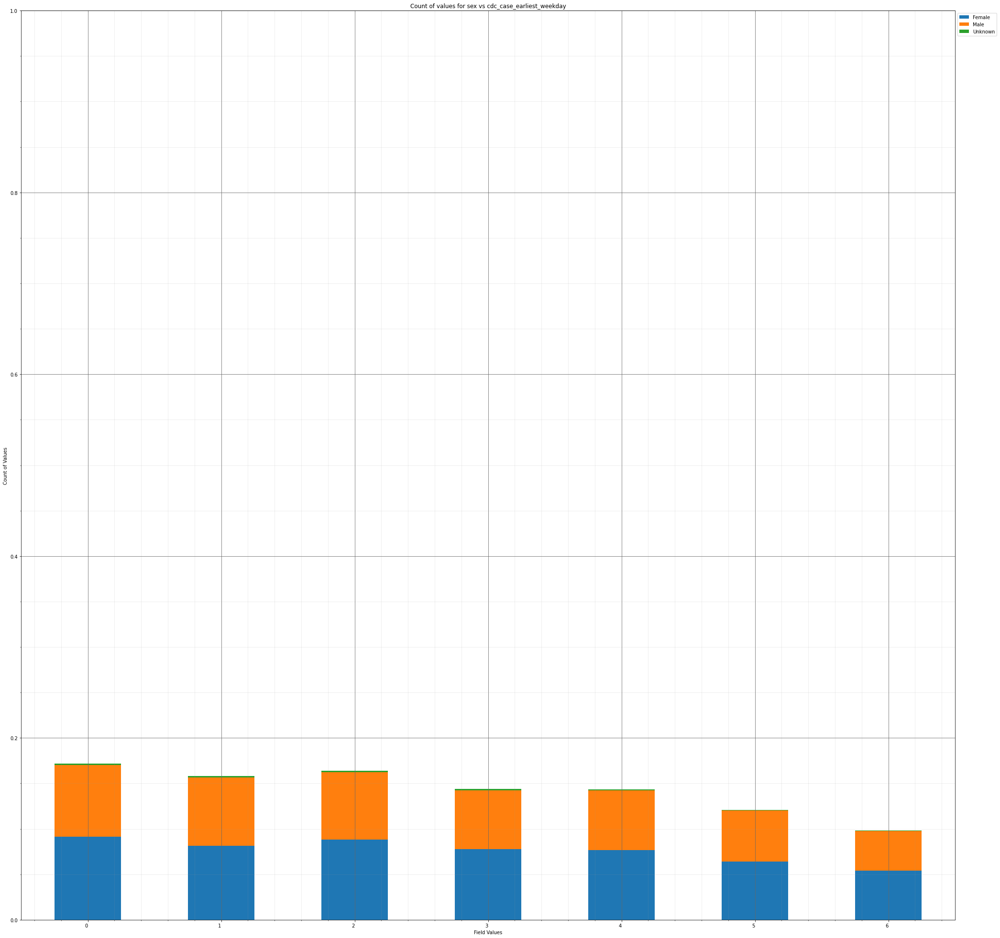



----------------------


Grouping over cdc_case_earliest_weekday|age_group results in:



,cdc_case_earliest_weekday,age_group,Rows,% Frequency
0,0,0 - 9 Years,91,0.953079
1,0,10 - 19 Years,166,1.738584
2,0,20 - 29 Years,276,2.890658
3,0,30 - 39 Years,254,2.660243
4,0,40 - 49 Years,245,2.565982
...,...,...,...,...
65,6,50 - 59 Years,135,1.413909
66,6,60 - 69 Years,101,1.057813
67,6,70 - 79 Years,58,0.607457
68,6,80+ Years,48,0.502723


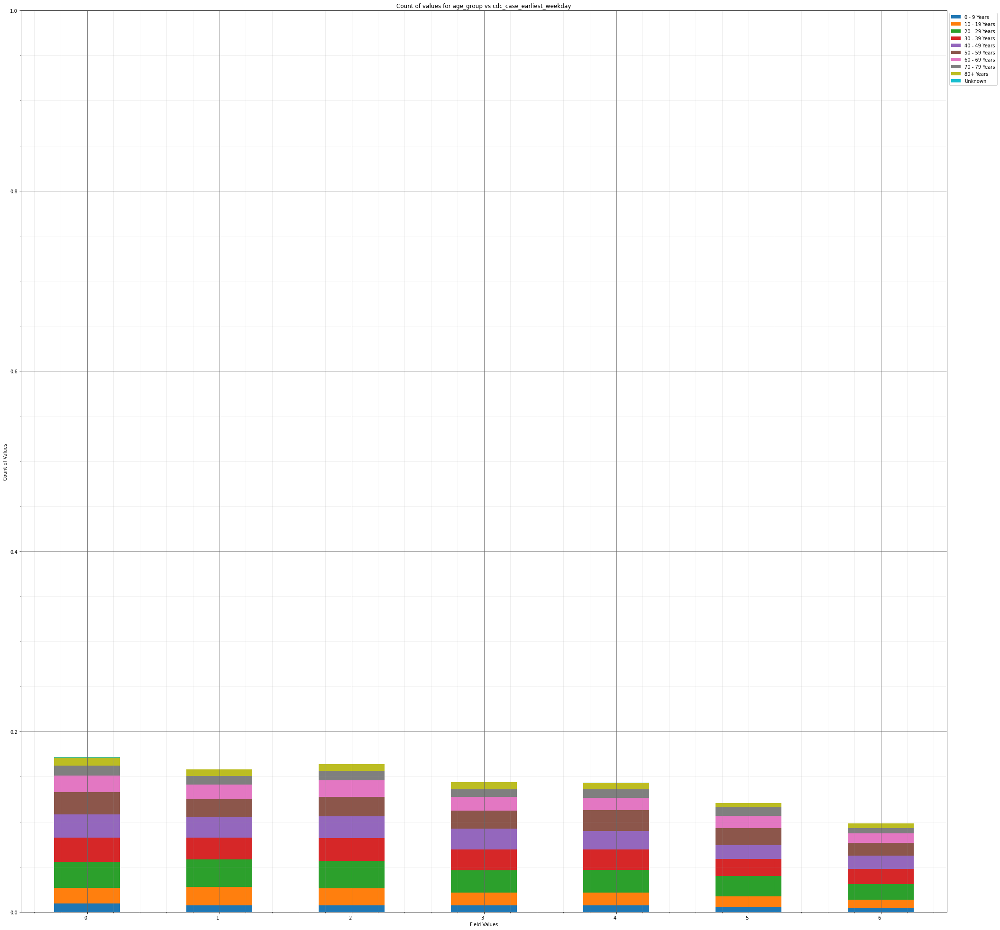



----------------------


Grouping over cdc_case_earliest_weekday|hosp_yn results in:



,cdc_case_earliest_weekday,hosp_yn,Rows,% Frequency
0,0,No,881,9.227063
1,0,OTH,0,0.000000
2,0,Unknown,643,6.734395
3,0,Yes,114,1.193967
4,1,No,811,8.493925
5,1,OTH,0,0.000000
6,1,Unknown,613,6.420193
7,1,Yes,88,0.921659
8,2,No,834,8.734814
9,2,OTH,0,0.000000


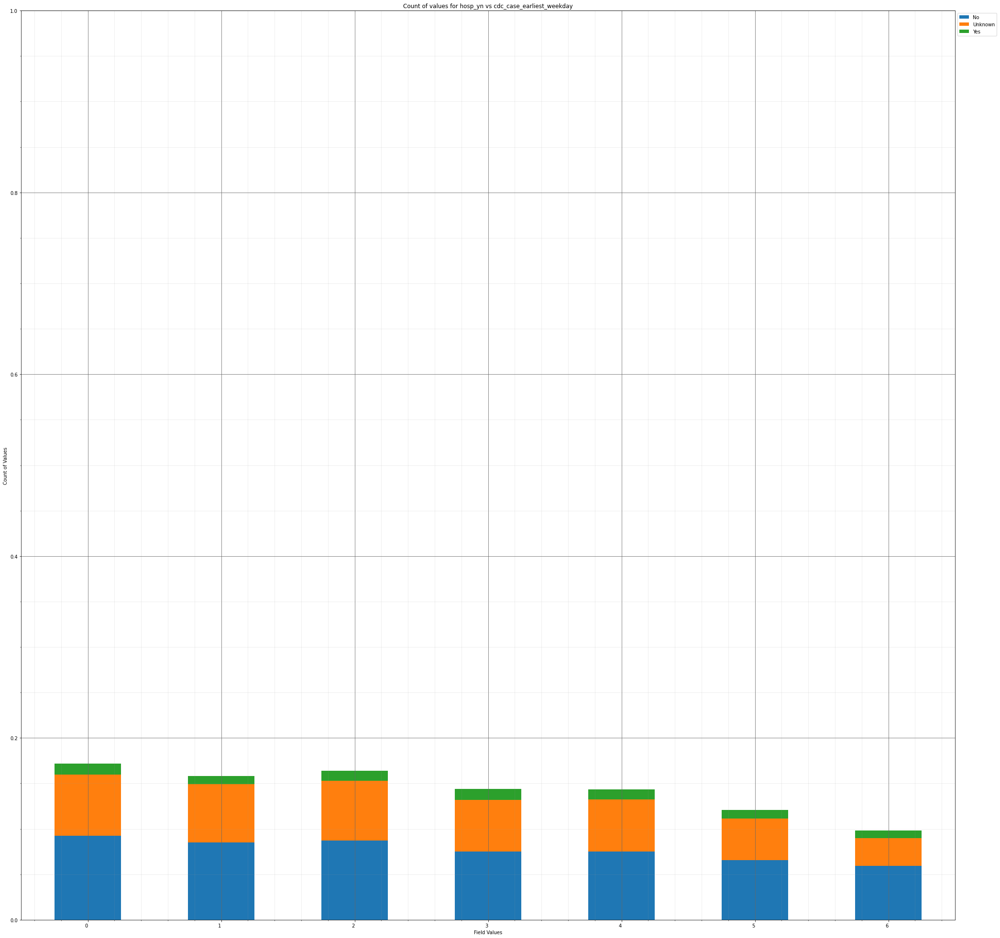



----------------------


Grouping over cdc_case_earliest_weekday|icu_yn results in:



,cdc_case_earliest_weekday,icu_yn,Rows,% Frequency
0,0,No,164,1.717637
1,0,Unknown,1458,15.270214
2,0,Yes,16,0.167574
3,1,No,140,1.466276
4,1,Unknown,1358,14.222874
5,1,Yes,14,0.146628
6,2,No,133,1.392962
7,2,Unknown,1417,14.840804
8,2,Yes,14,0.146628
9,3,No,127,1.330121


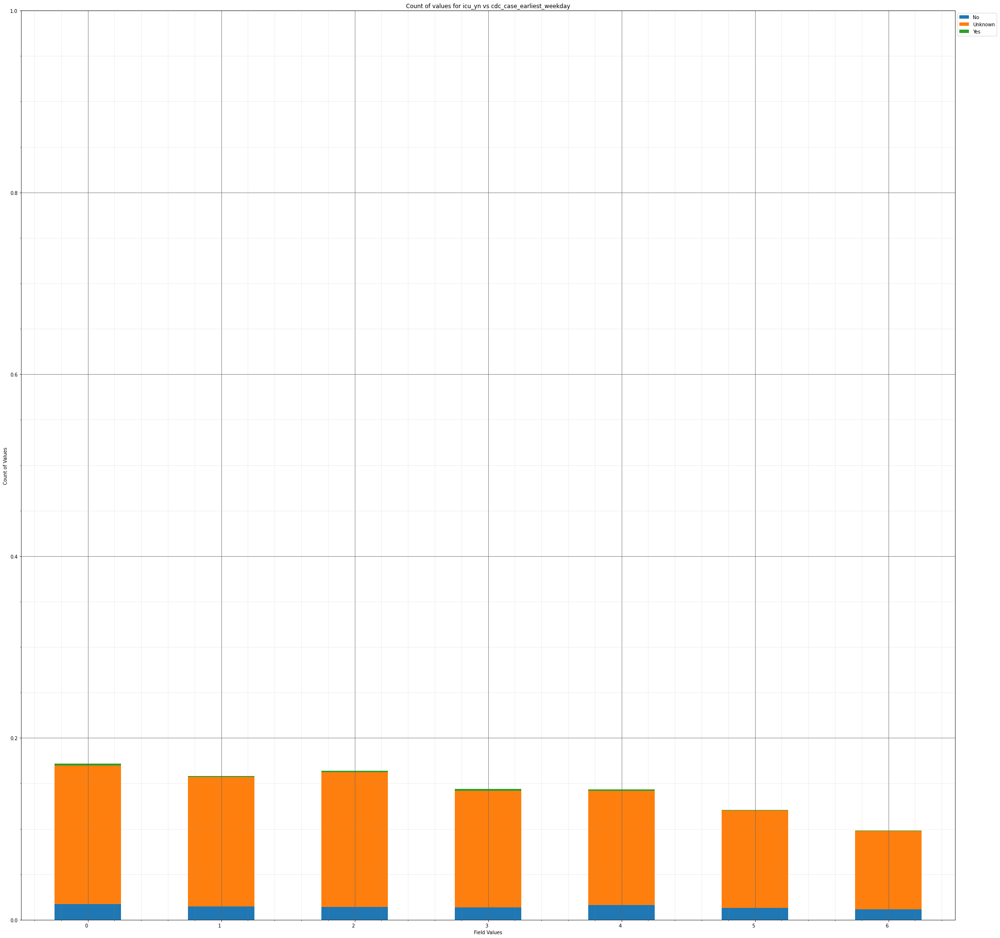



----------------------


Grouping over cdc_case_earliest_weekday|death_yn results in:



,cdc_case_earliest_weekday,death_yn,Rows,% Frequency
0,0,No,1576,16.506075
1,0,Yes,62,0.649351
2,1,No,1473,15.427315
3,1,Yes,39,0.408463
4,2,No,1511,15.825304
5,2,Yes,53,0.555090
6,3,No,1330,13.929619
7,3,Yes,43,0.450356
8,4,No,1320,13.824885
9,4,Yes,47,0.492250


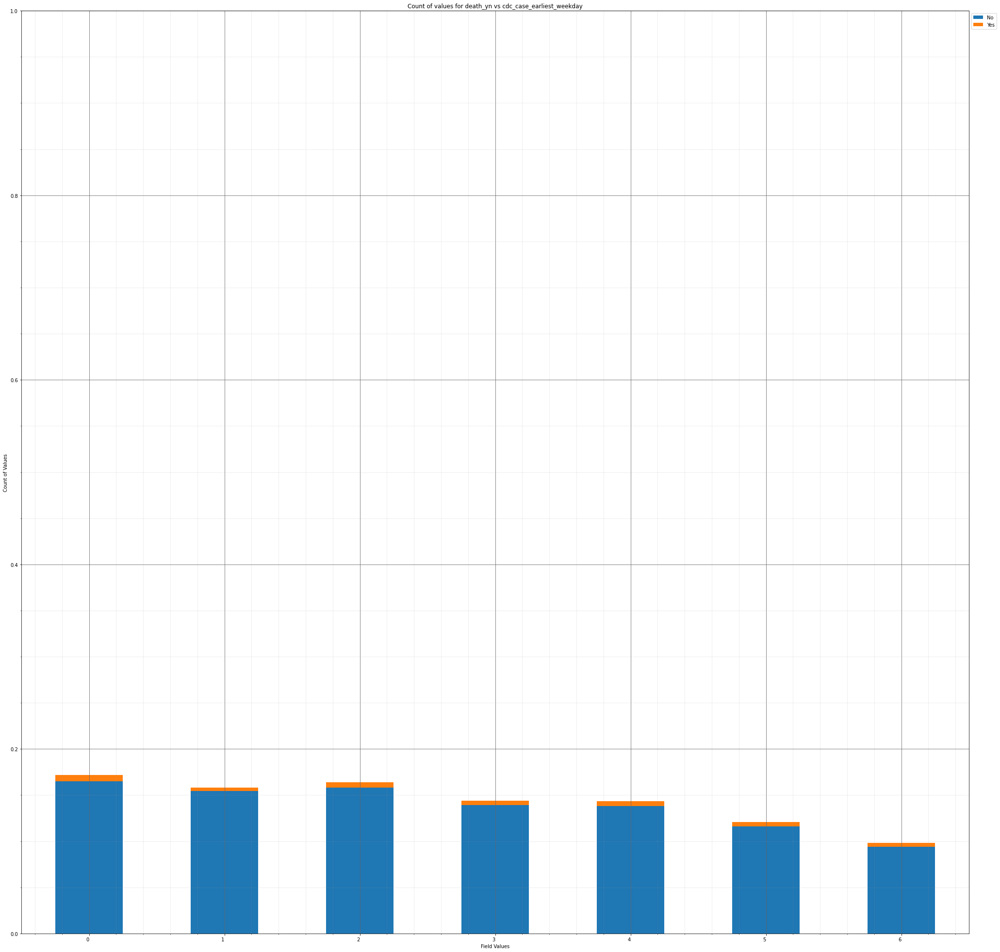



----------------------


Grouping over cdc_case_earliest_weekday|medcond_yn results in:



,cdc_case_earliest_weekday,medcond_yn,Rows,% Frequency
0,0,No,156,1.633850
1,0,Unknown,1330,13.929619
2,0,Yes,152,1.591956
3,1,No,145,1.518643
4,1,Unknown,1255,13.144114
5,1,Yes,112,1.173021
6,2,No,158,1.654797
7,2,Unknown,1289,13.500209
8,2,Yes,117,1.225388
9,3,No,95,0.994973


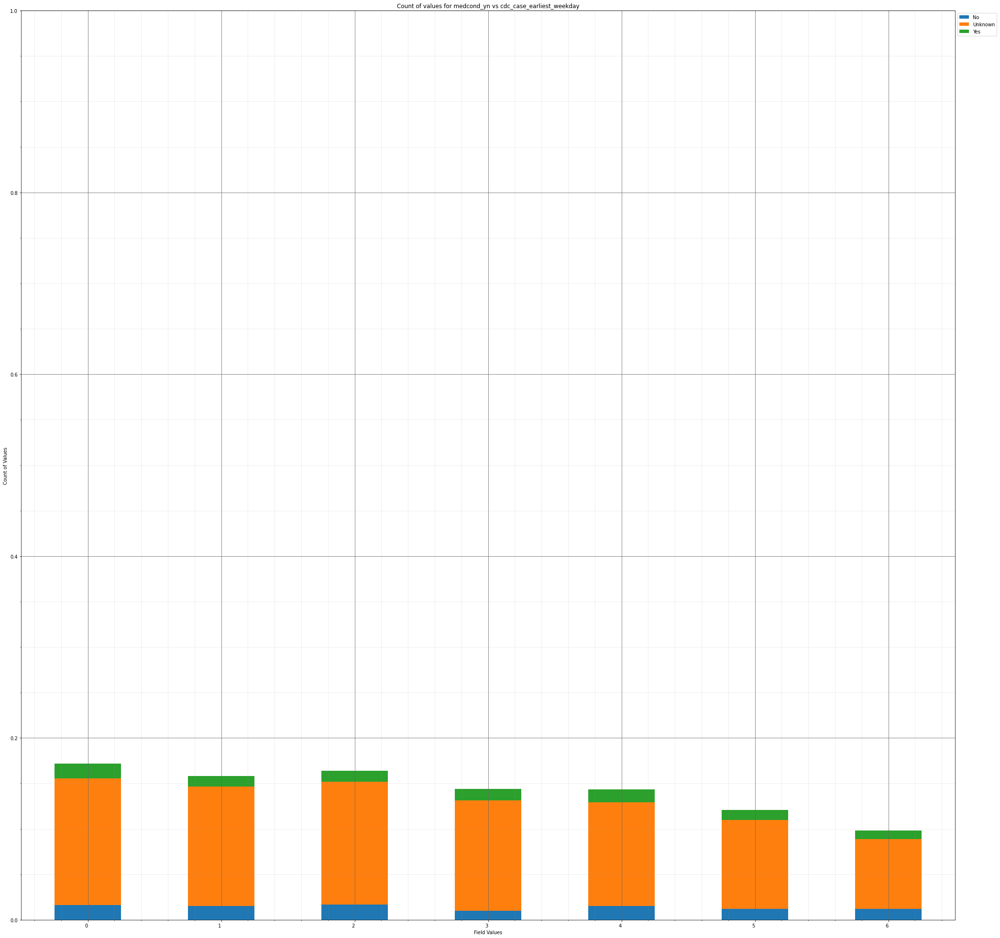



----------------------


Grouping over cdc_case_earliest_weekday|race results in:



,cdc_case_earliest_weekday,race,Rows,% Frequency
0,0,American Indian/Alaska Native,15,0.157101
1,0,Asian,37,0.387516
2,0,Black,125,1.309175
3,0,Hispanic/Latino,156,1.633850
4,0,Multiple/Other,71,0.743611
5,0,Native Hawaiian/Other Pacific Islander,4,0.041894
6,0,Unknown,674,7.059070
7,0,White,556,5.823209
8,1,American Indian/Alaska Native,11,0.115207
9,1,Asian,29,0.303729


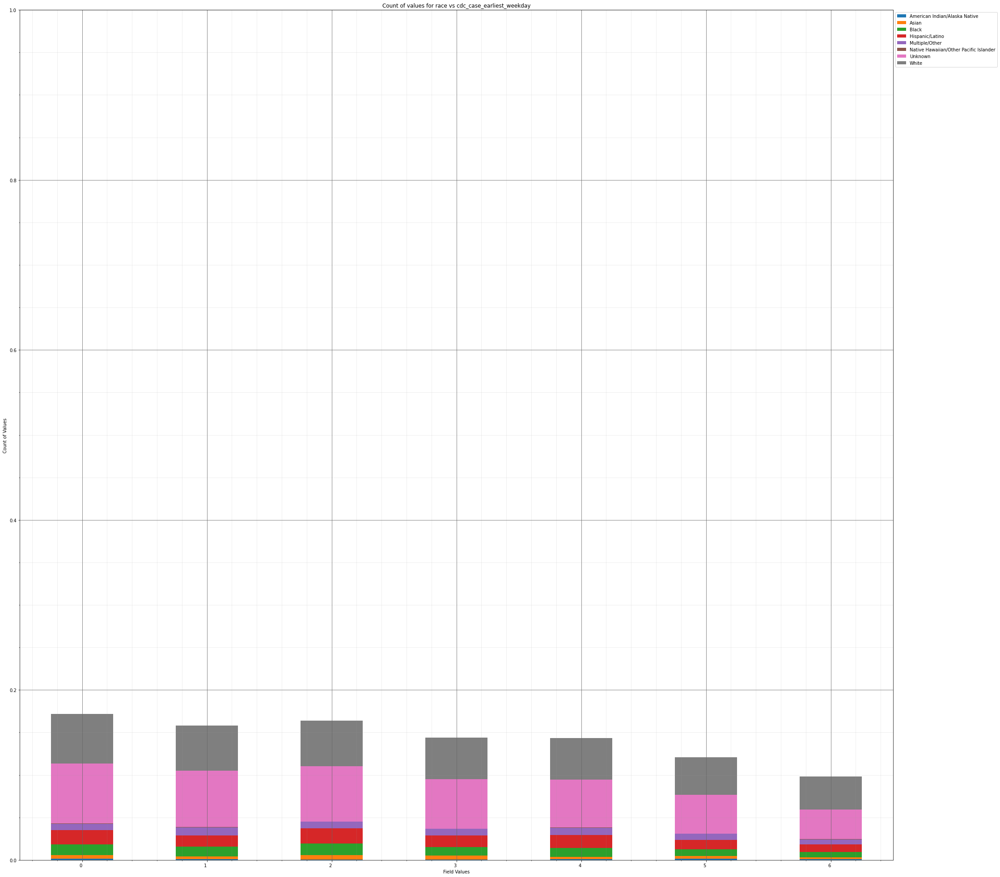



----------------------


Grouping over cdc_case_earliest_weekday|cdc_case_earliest_day results in:



,cdc_case_earliest_weekday,cdc_case_earliest_day,Rows,% Frequency
0,0,1,10,0.104734
1,0,2,58,0.607457
2,0,3,27,0.282782
3,0,4,118,1.235861
4,0,5,27,0.282782
...,...,...,...,...
212,6,27,79,0.827398
213,6,28,17,0.178048
214,6,29,64,0.670297
215,6,30,12,0.125681


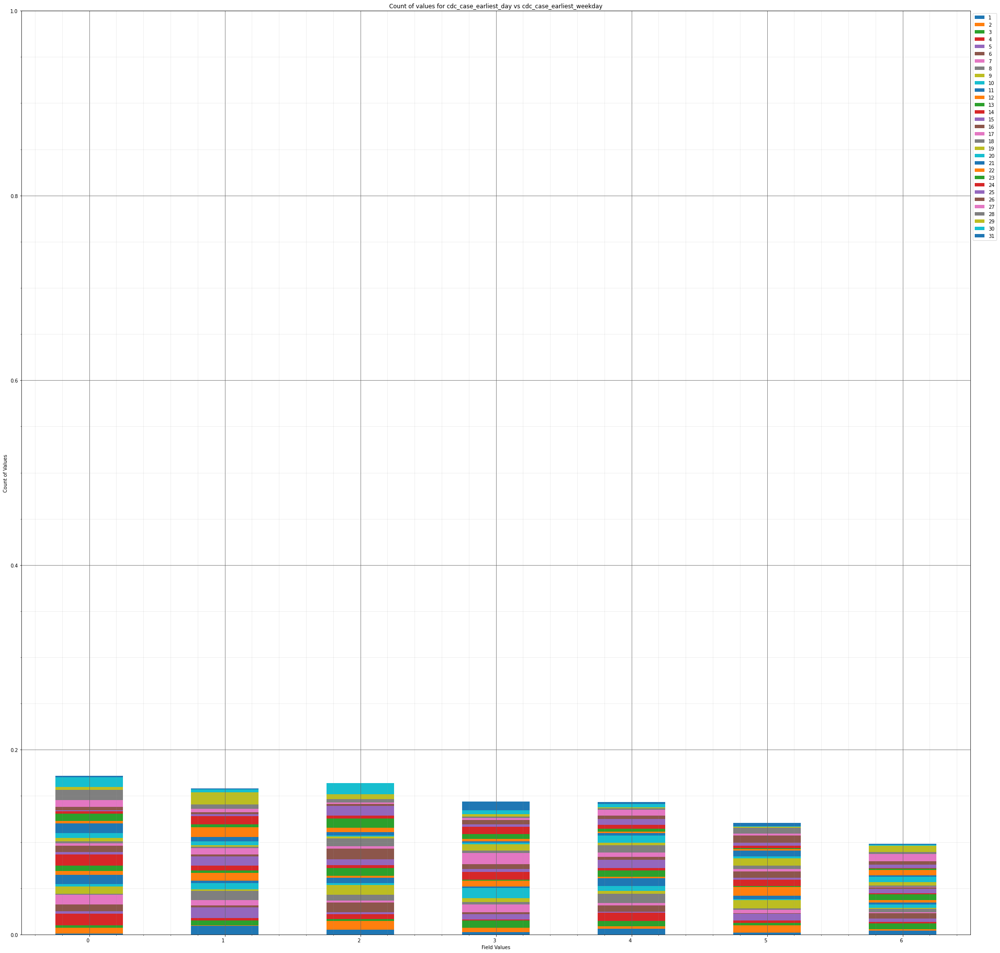



----------------------


Grouping over cdc_case_earliest_weekday|cdc_case_earliest_month results in:



,cdc_case_earliest_weekday,cdc_case_earliest_month,Rows,% Frequency
0,0,1,177,1.853791
1,0,2,0,0.000000
2,0,3,48,0.502723
3,0,4,77,0.806452
4,0,5,71,0.743611
...,...,...,...,...
79,6,8,65,0.680771
80,6,9,48,0.502723
81,6,10,81,0.848345
82,6,11,215,2.251780


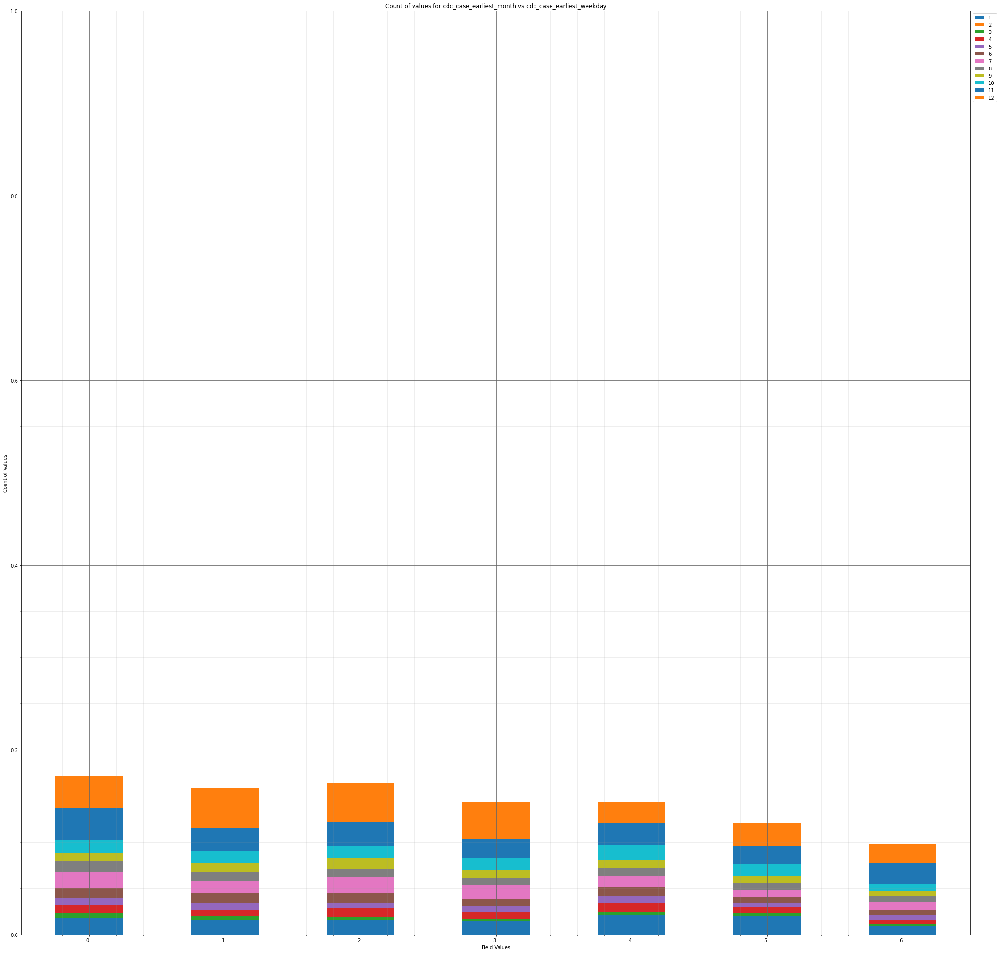



----------------------


Grouping over cdc_case_earliest_weekday|cdc_case_earliest_year results in:



,cdc_case_earliest_weekday,cdc_case_earliest_year,Rows,% Frequency
0,0,2020,1462,15.312107
1,0,2021,176,1.843318
2,1,2020,1361,14.254294
3,1,2021,151,1.581483
4,2,2020,1413,14.798911
5,2,2021,151,1.581483
6,3,2020,1237,12.955593
7,3,2021,136,1.424382
8,4,2020,1169,12.243402
9,4,2021,198,2.073733


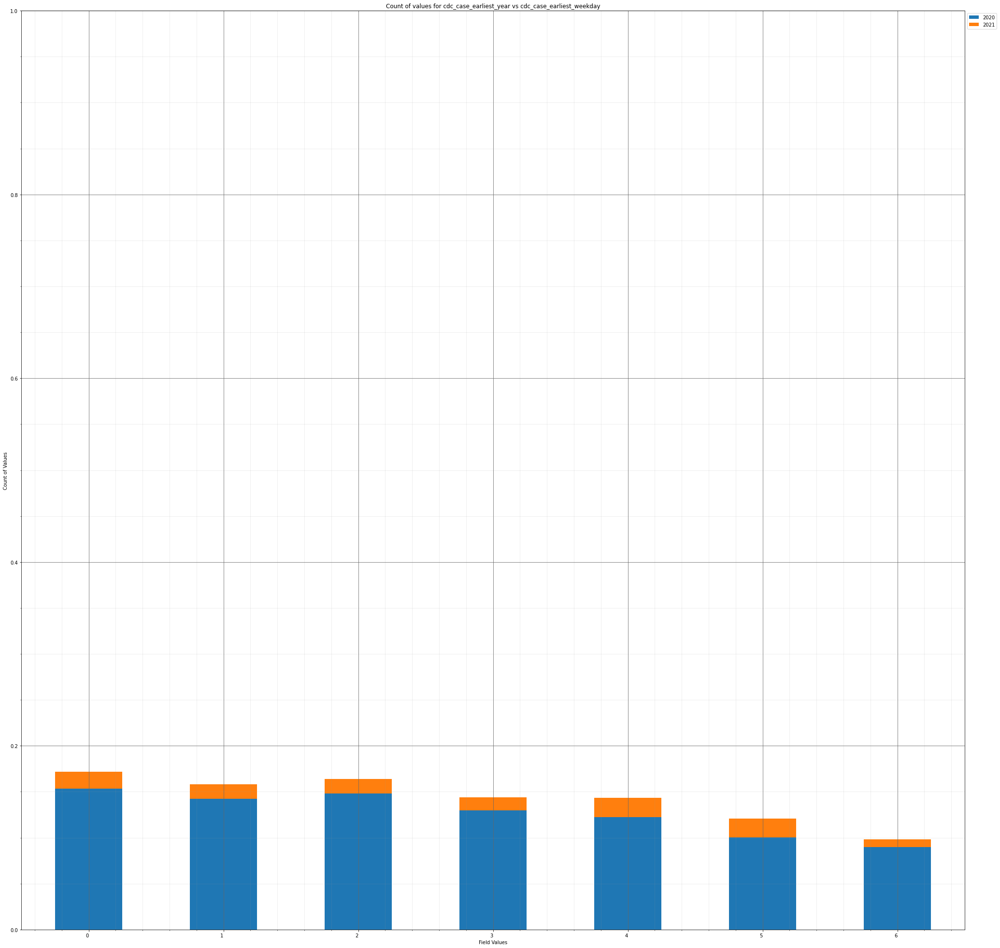



----------------------


Grouping over cdc_case_earliest_weekday|demographic_missing results in:



,cdc_case_earliest_weekday,demographic_missing,Rows,% Frequency
0,0,False,959,10.043988
1,0,True,679,7.111437
2,1,False,875,9.164223
3,1,True,637,6.671554
4,2,False,938,9.824047
5,2,True,626,6.556347
6,3,False,810,8.483452
7,3,True,563,5.896523
8,4,False,823,8.619606
9,4,True,544,5.697528


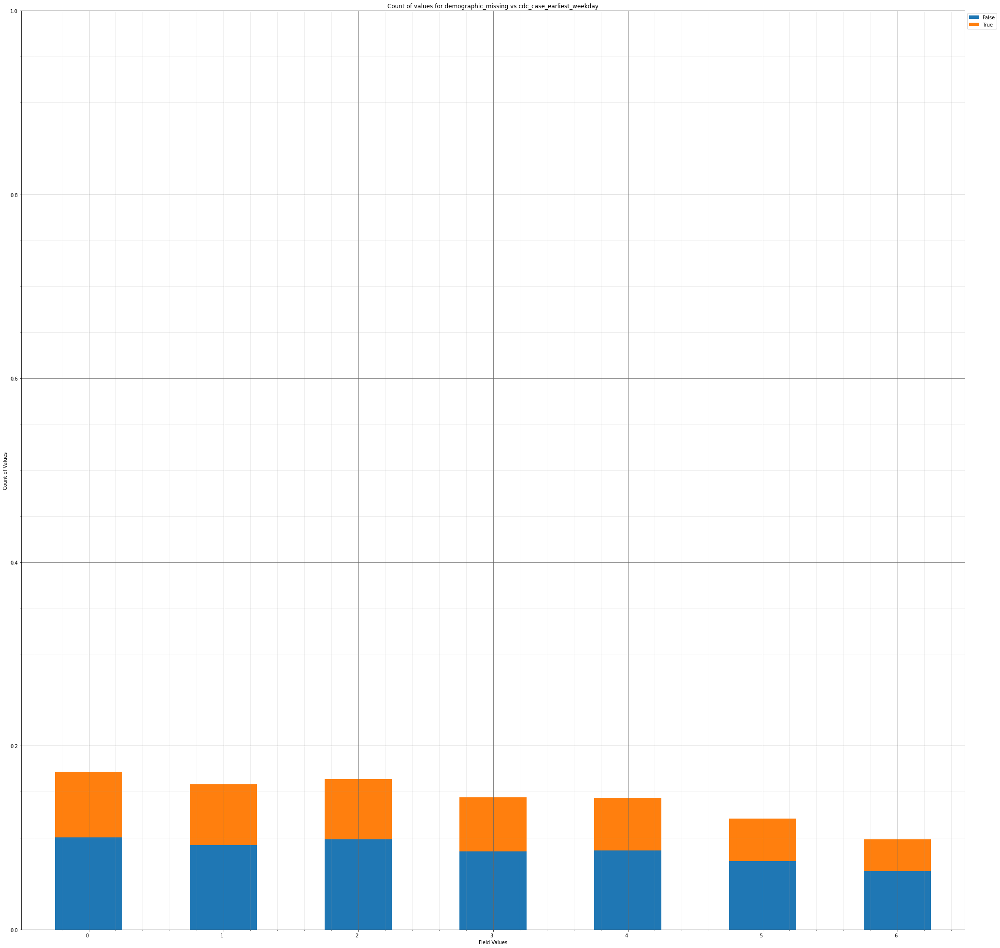



----------------------


Grouping over cdc_case_earliest_weekday|medical_missing results in:



,cdc_case_earliest_weekday,medical_missing,Rows,% Frequency
0,0,False,128,1.340595
1,0,True,1510,15.814830
2,1,False,106,1.110180
3,1,True,1406,14.725597
4,2,False,104,1.089233
5,2,True,1460,15.291160
6,3,False,95,0.994973
7,3,True,1278,13.385002
8,4,False,123,1.288228
9,4,True,1244,13.028907


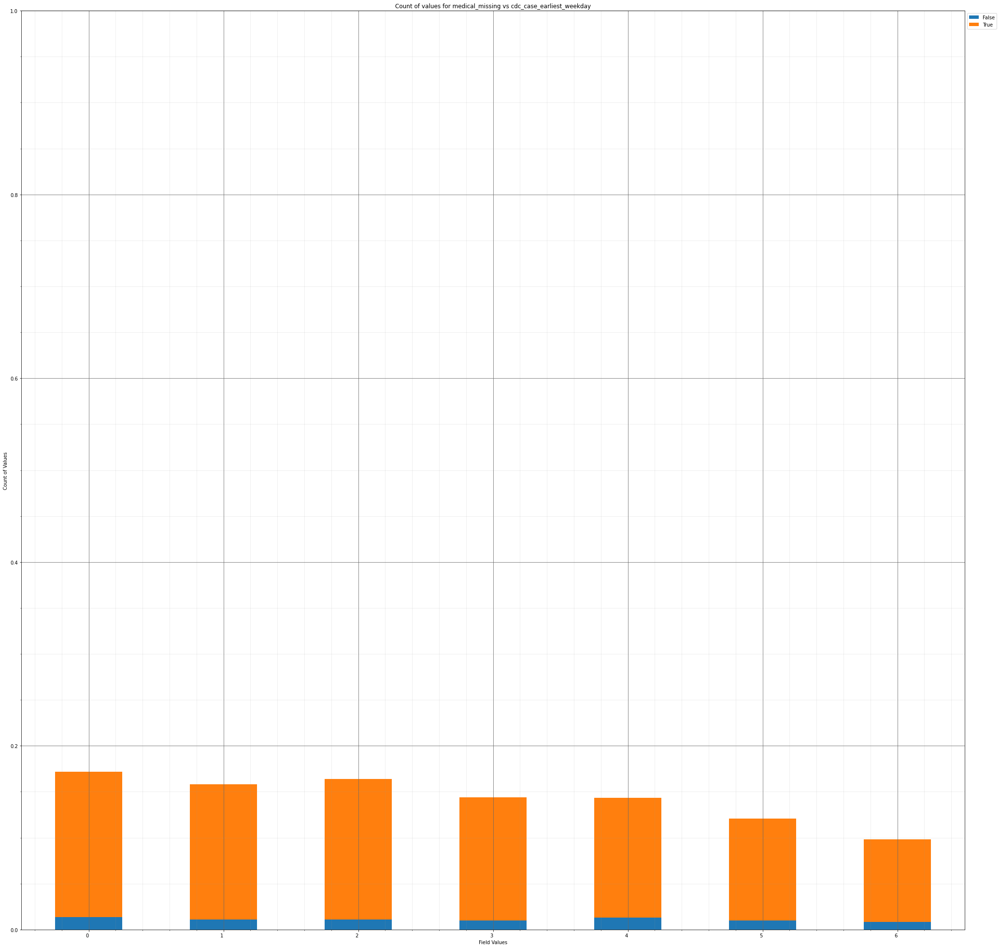



----------------------


Grouping over cdc_case_earliest_month|current_status results in:



,cdc_case_earliest_month,current_status,Rows,% Frequency
0,1,Laboratory-confirmed case,1044,10.934227
1,1,Probable Case,49,0.513196
2,2,Laboratory-confirmed case,3,0.031420
3,2,Probable Case,0,0.000000
4,3,Laboratory-confirmed case,228,2.387935
5,3,Probable Case,5,0.052367
6,4,Laboratory-confirmed case,480,5.027231
7,4,Probable Case,16,0.167574
8,5,Laboratory-confirmed case,416,4.356933
9,5,Probable Case,8,0.083787


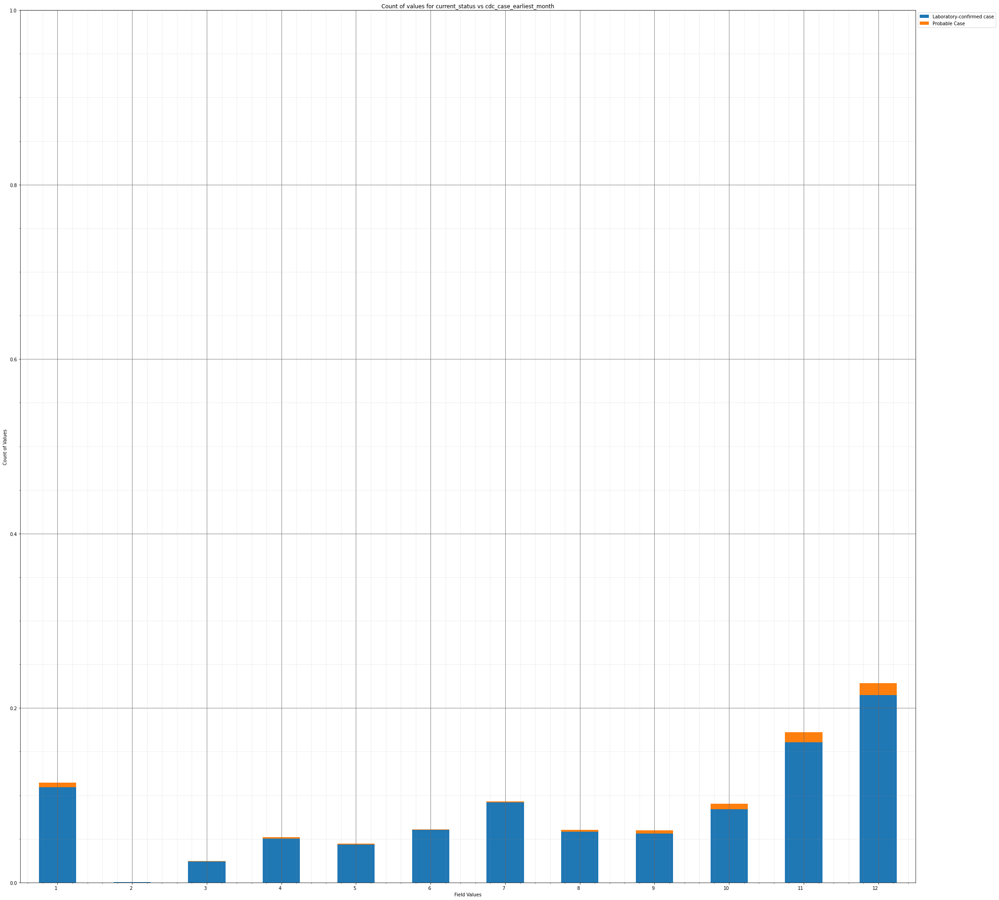



----------------------


Grouping over cdc_case_earliest_month|sex results in:



,cdc_case_earliest_month,sex,Rows,% Frequency
0,1,Female,593,6.210725
1,1,Male,486,5.090071
2,1,Unknown,14,0.146628
3,2,Female,0,0.000000
4,2,Male,3,0.031420
5,2,Unknown,0,0.000000
6,3,Female,120,1.256808
7,3,Male,113,1.183494
8,3,Unknown,0,0.000000
9,4,Female,275,2.880184


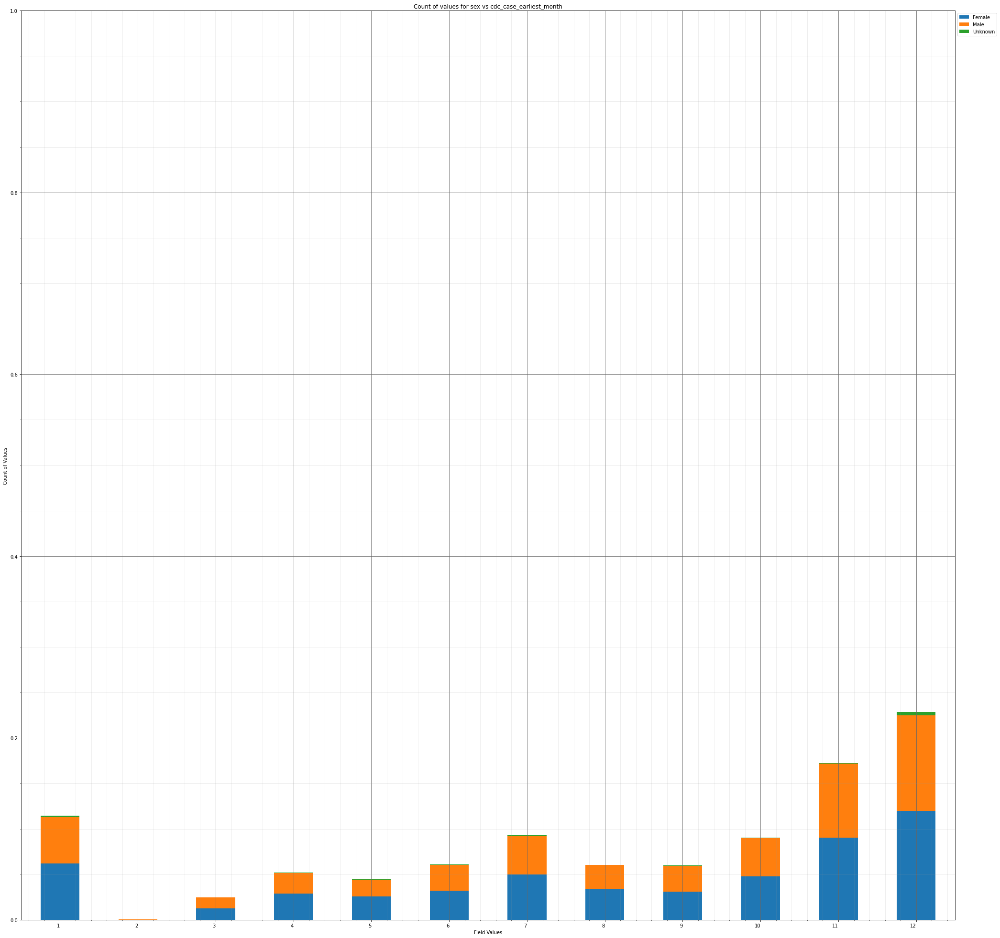



----------------------


Grouping over cdc_case_earliest_month|age_group results in:



,cdc_case_earliest_month,age_group,Rows,% Frequency
0,1,0 - 9 Years,68,0.712191
1,1,10 - 19 Years,143,1.497696
2,1,20 - 29 Years,172,1.801424
3,1,30 - 39 Years,175,1.832845
4,1,40 - 49 Years,143,1.497696
...,...,...,...,...
115,12,50 - 59 Years,327,3.424801
116,12,60 - 69 Years,242,2.534562
117,12,70 - 79 Years,121,1.267281
118,12,80+ Years,95,0.994973


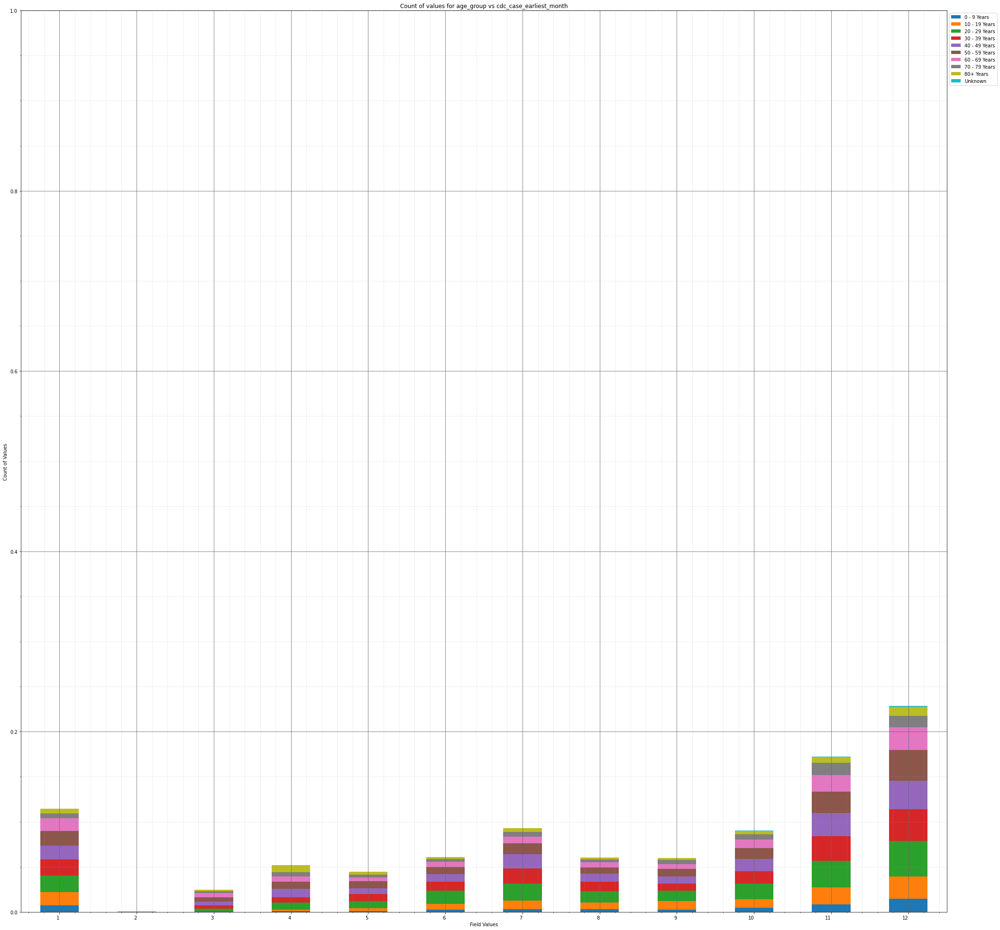



----------------------


Grouping over cdc_case_earliest_month|hosp_yn results in:



,cdc_case_earliest_month,hosp_yn,Rows,% Frequency
0,1,No,463,4.849183
1,1,OTH,0,0.000000
2,1,Unknown,603,6.315459
3,1,Yes,27,0.282782
4,2,No,1,0.010473
5,2,OTH,0,0.000000
6,2,Unknown,0,0.000000
7,2,Yes,2,0.020947
8,3,No,108,1.131127
9,3,OTH,0,0.000000


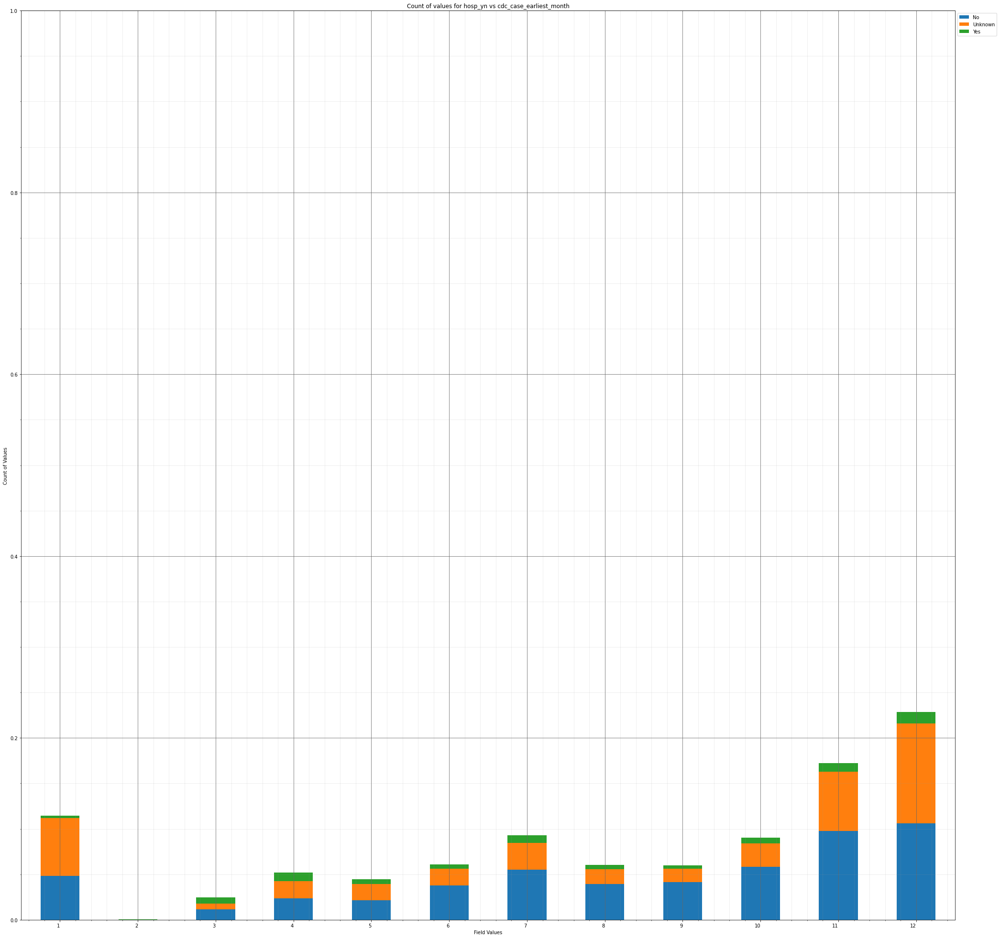



----------------------


Grouping over cdc_case_earliest_month|icu_yn results in:



,cdc_case_earliest_month,icu_yn,Rows,% Frequency
0,1,No,54,0.565563
1,1,Unknown,1037,10.860913
2,1,Yes,2,0.020947
3,2,No,0,0.000000
4,2,Unknown,3,0.031420
5,2,Yes,0,0.000000
6,3,No,37,0.387516
7,3,Unknown,184,1.927105
8,3,Yes,12,0.125681
9,4,No,70,0.733138


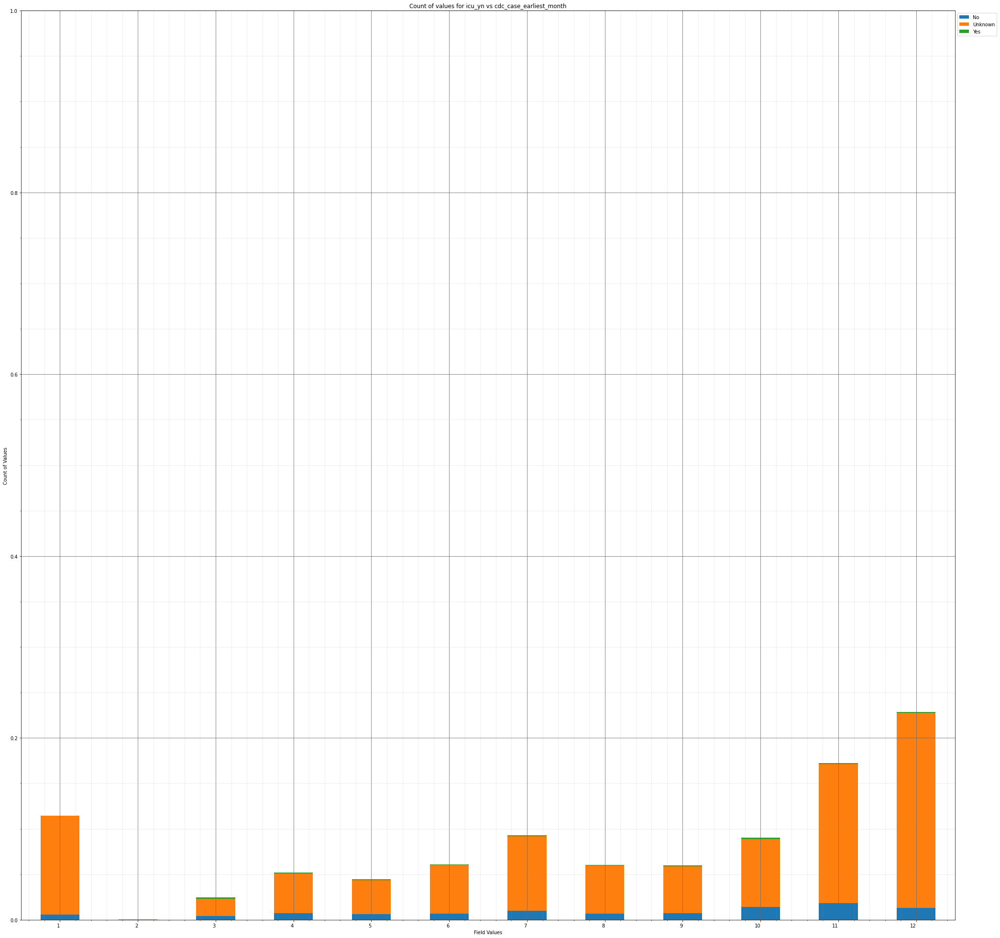



----------------------


Grouping over cdc_case_earliest_month|death_yn results in:



,cdc_case_earliest_month,death_yn,Rows,% Frequency
0,1,No,1079,11.300796
1,1,Yes,14,0.146628
2,2,No,2,0.020947
3,2,Yes,1,0.010473
4,3,No,202,2.115626
5,3,Yes,31,0.324675
6,4,No,423,4.430247
7,4,Yes,73,0.764558
8,5,No,403,4.220779
9,5,Yes,21,0.219941


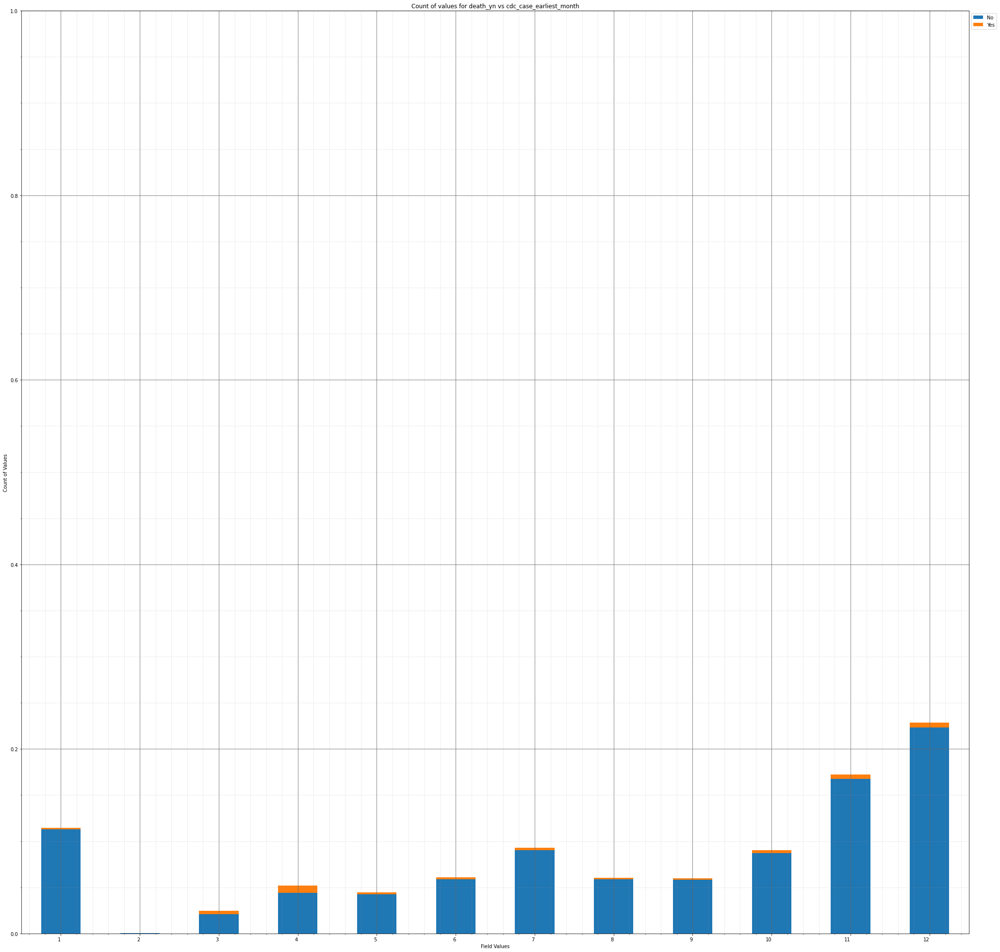



----------------------


Grouping over cdc_case_earliest_month|medcond_yn results in:



,cdc_case_earliest_month,medcond_yn,Rows,% Frequency
0,1,No,55,0.576037
1,1,Unknown,976,10.222036
2,1,Yes,62,0.649351
3,2,No,0,0.000000
4,2,Unknown,3,0.031420
5,2,Yes,0,0.000000
6,3,No,19,0.198995
7,3,Unknown,153,1.602430
8,3,Yes,61,0.638877
9,4,No,46,0.481776


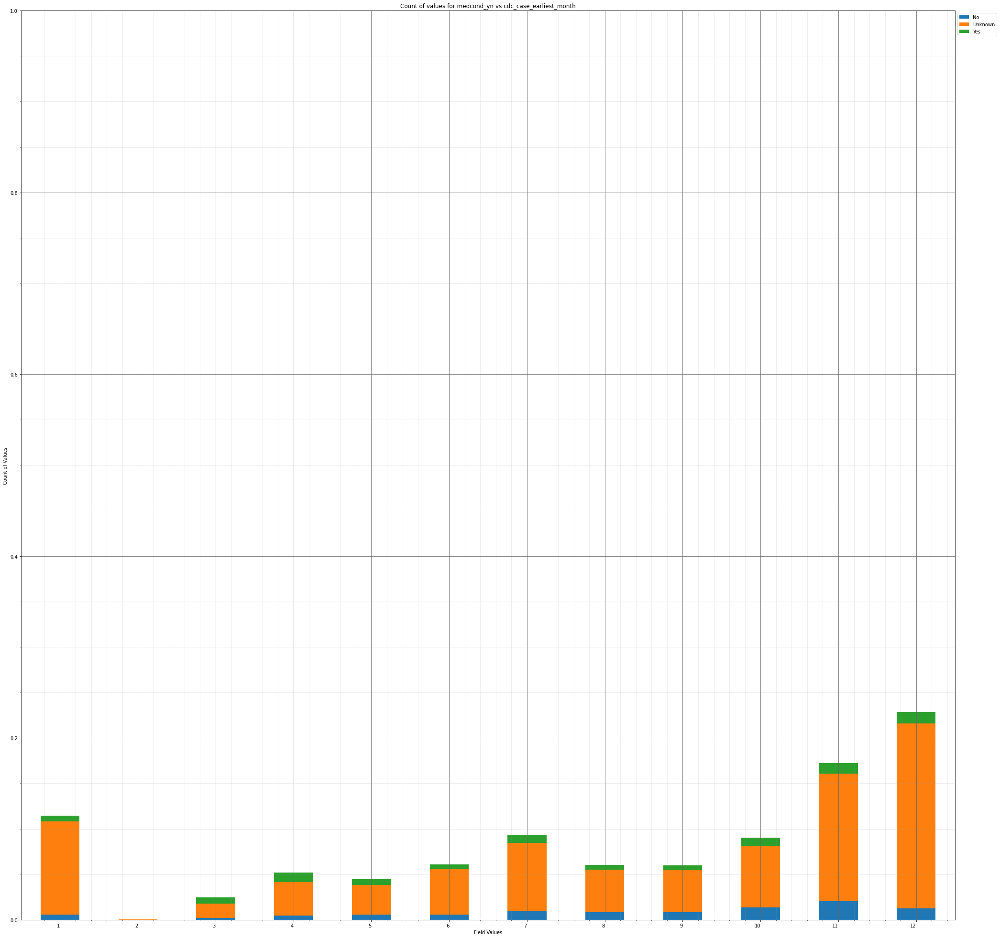



----------------------


Grouping over cdc_case_earliest_month|race results in:



,cdc_case_earliest_month,race,Rows,% Frequency
0,1,American Indian/Alaska Native,9,0.094261
1,1,Asian,44,0.460829
2,1,Black,59,0.617930
3,1,Hispanic/Latino,58,0.607457
4,1,Multiple/Other,82,0.858819
...,...,...,...,...
91,12,Hispanic/Latino,124,1.298701
92,12,Multiple/Other,174,1.822371
93,12,Native Hawaiian/Other Pacific Islander,4,0.041894
94,12,Unknown,968,10.138249


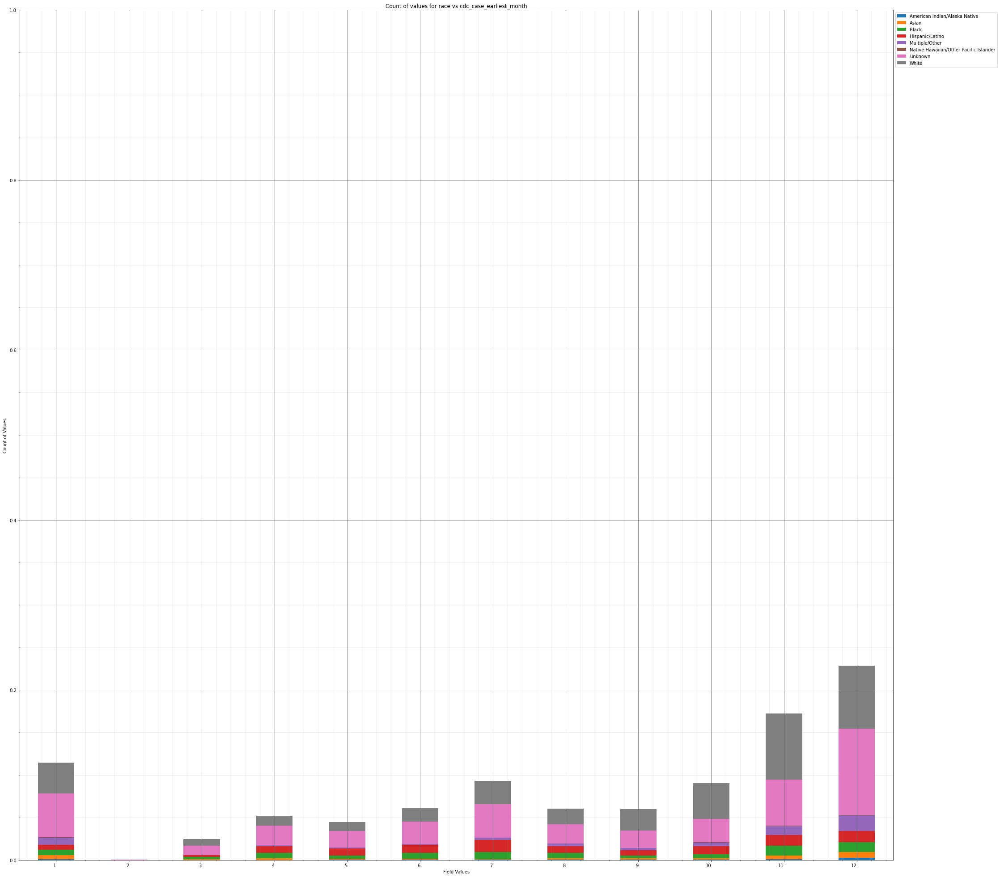



----------------------


Grouping over cdc_case_earliest_month|cdc_case_earliest_day results in:



,cdc_case_earliest_month,cdc_case_earliest_day,Rows,% Frequency
0,1,1,46,0.481776
1,1,2,67,0.701718
2,1,3,51,0.534143
3,1,4,98,1.026393
4,1,5,92,0.963553
...,...,...,...,...
367,12,27,62,0.649351
368,12,28,83,0.869292
369,12,29,102,1.068287
370,12,30,92,0.963553


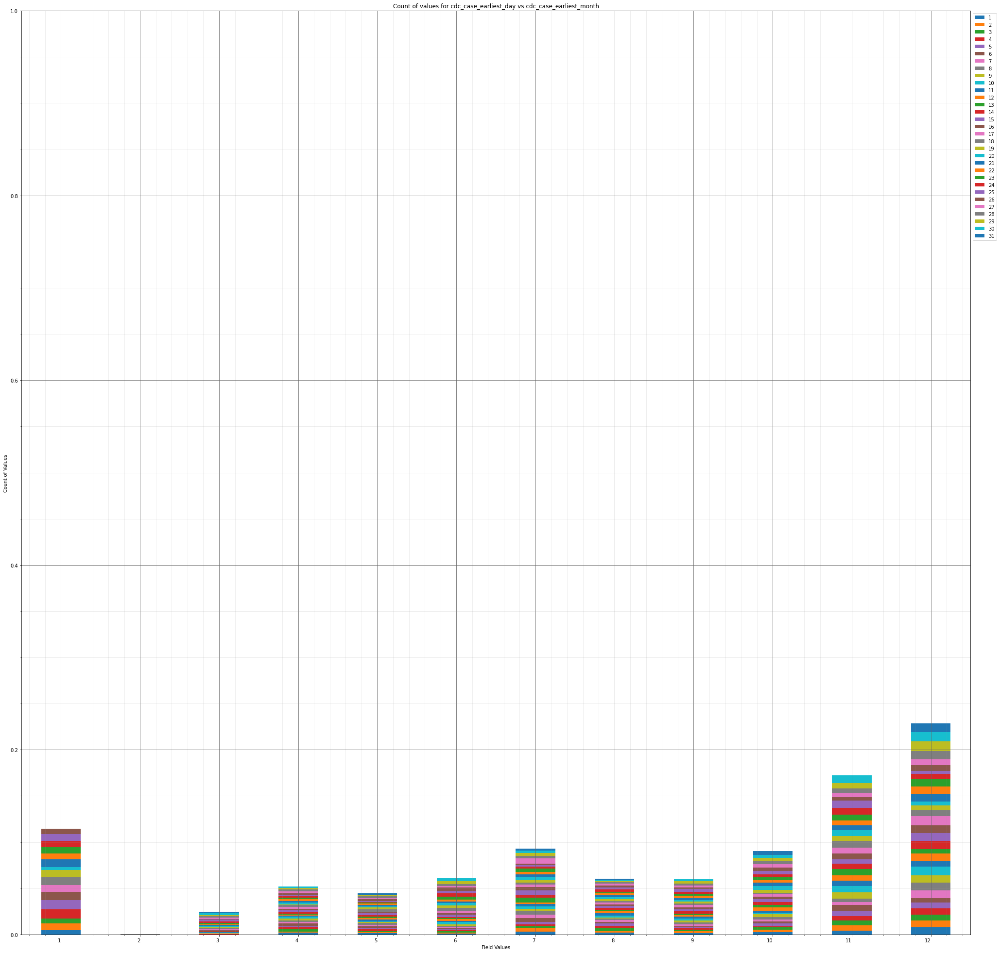



----------------------


Grouping over cdc_case_earliest_month|cdc_case_earliest_weekday results in:



,cdc_case_earliest_month,cdc_case_earliest_weekday,Rows,% Frequency
0,1,0,177,1.853791
1,1,1,151,1.581483
2,1,2,151,1.581483
3,1,3,137,1.434855
4,1,4,198,2.073733
...,...,...,...,...
79,12,2,401,4.199832
80,12,3,385,4.032258
81,12,4,220,2.304147
82,12,5,239,2.503142


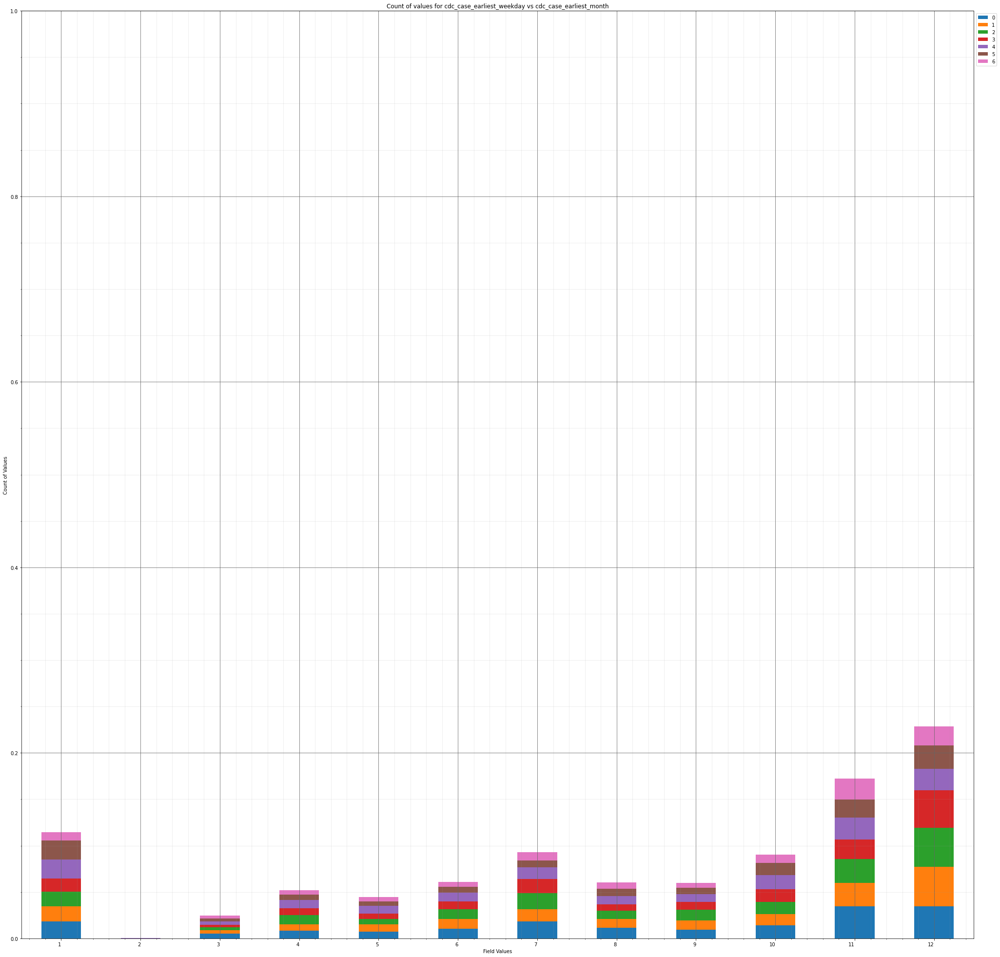



----------------------


Grouping over cdc_case_earliest_month|cdc_case_earliest_year results in:



,cdc_case_earliest_month,cdc_case_earliest_year,Rows,% Frequency
0,1,2020,4,0.041894
1,1,2021,1089,11.405530
2,2,2020,3,0.031420
3,2,2021,0,0.000000
4,3,2020,233,2.440302
5,3,2021,0,0.000000
6,4,2020,496,5.194805
7,4,2021,0,0.000000
8,5,2020,424,4.440721
9,5,2021,0,0.000000


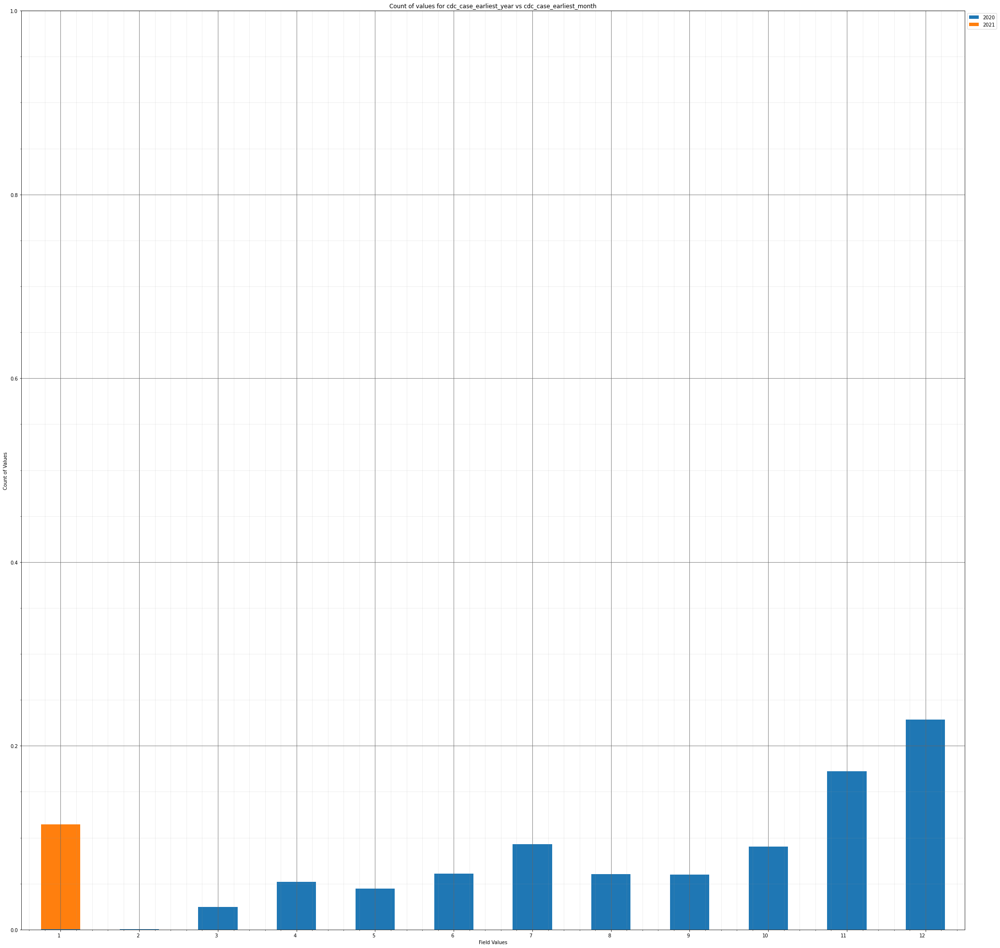



----------------------


Grouping over cdc_case_earliest_month|demographic_missing results in:



,cdc_case_earliest_month,demographic_missing,Rows,% Frequency
0,1,False,599,6.273565
1,1,True,494,5.173858
2,2,False,2,0.020947
3,2,True,1,0.010473
4,3,False,130,1.361542
5,3,True,103,1.078760
6,4,False,272,2.848764
7,4,True,224,2.346041
8,5,False,237,2.482195
9,5,True,187,1.958525


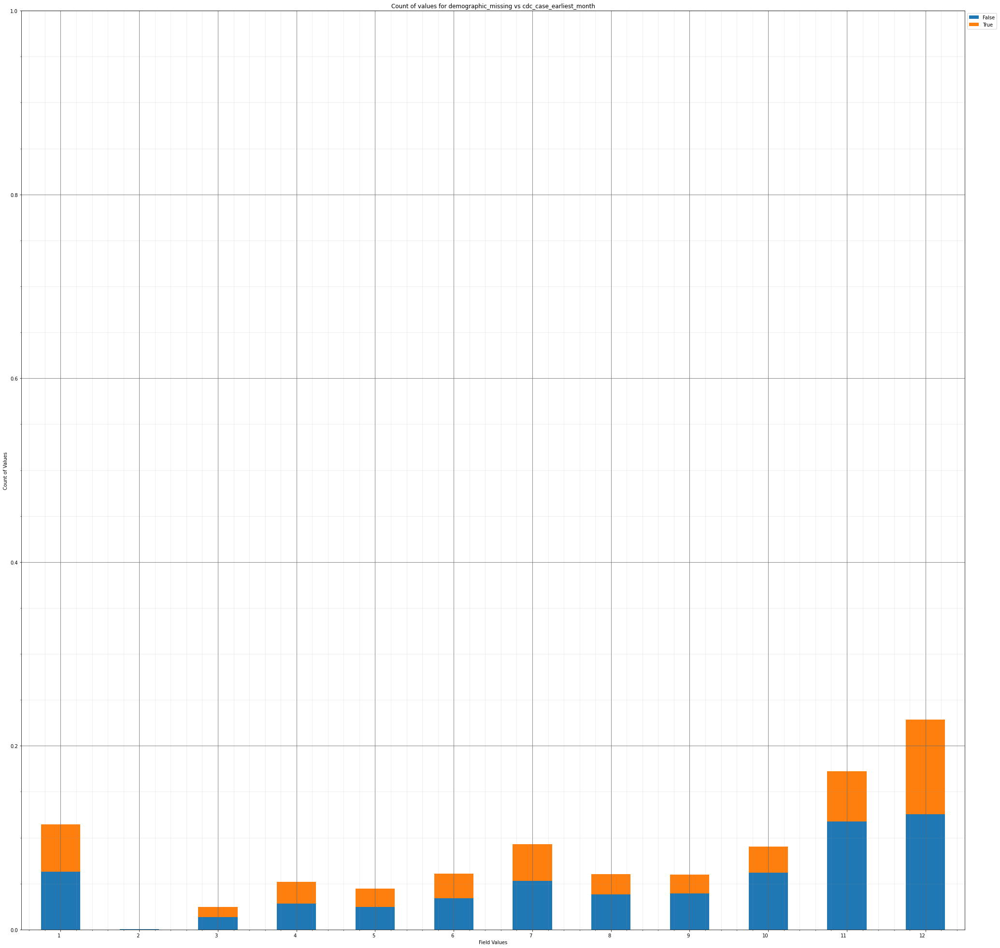



----------------------


Grouping over cdc_case_earliest_month|medical_missing results in:



,cdc_case_earliest_month,medical_missing,Rows,% Frequency
0,1,False,37,0.387516
1,1,True,1056,11.059908
2,2,False,0,0.000000
3,2,True,3,0.031420
4,3,False,32,0.335149
5,3,True,201,2.105153
6,4,False,65,0.680771
7,4,True,431,4.514034
8,5,False,51,0.534143
9,5,True,373,3.906577


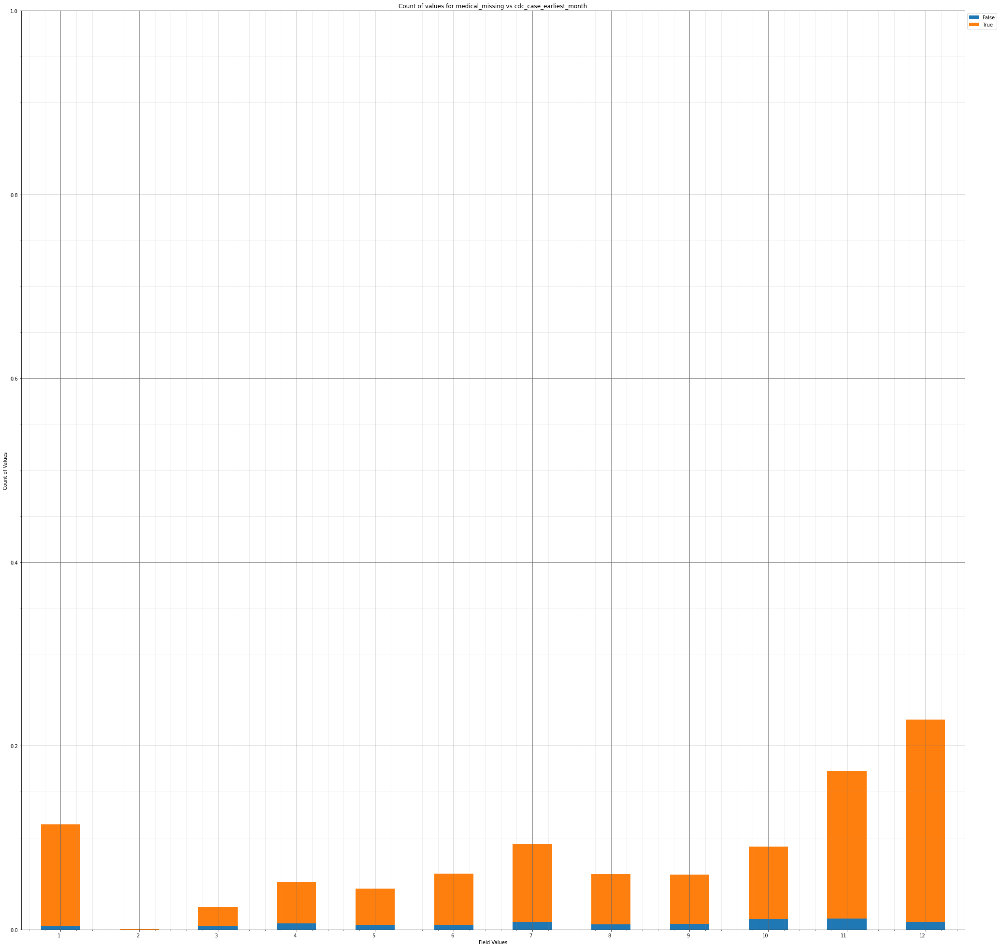



----------------------


Grouping over cdc_case_earliest_year|current_status results in:



,cdc_case_earliest_year,current_status,Rows,% Frequency
0,2020,Laboratory-confirmed case,8065,84.467951
1,2020,Probable Case,394,4.126519
2,2021,Laboratory-confirmed case,1041,10.902807
3,2021,Probable Case,48,0.502723


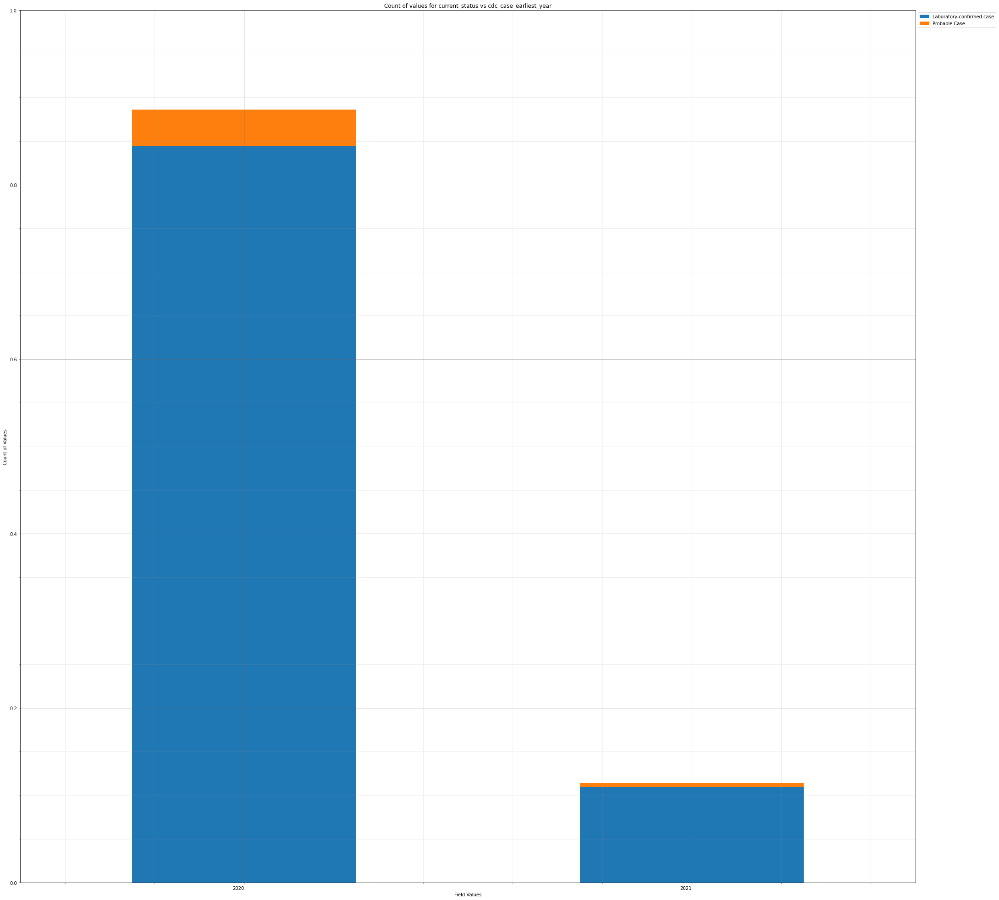



----------------------


Grouping over cdc_case_earliest_year|sex results in:



,cdc_case_earliest_year,sex,Rows,% Frequency
0,2020,Female,4499,47.119816
1,2020,Male,3891,40.751990
2,2020,Unknown,69,0.722664
3,2021,Female,590,6.179305
4,2021,Male,485,5.079598
5,2021,Unknown,14,0.146628


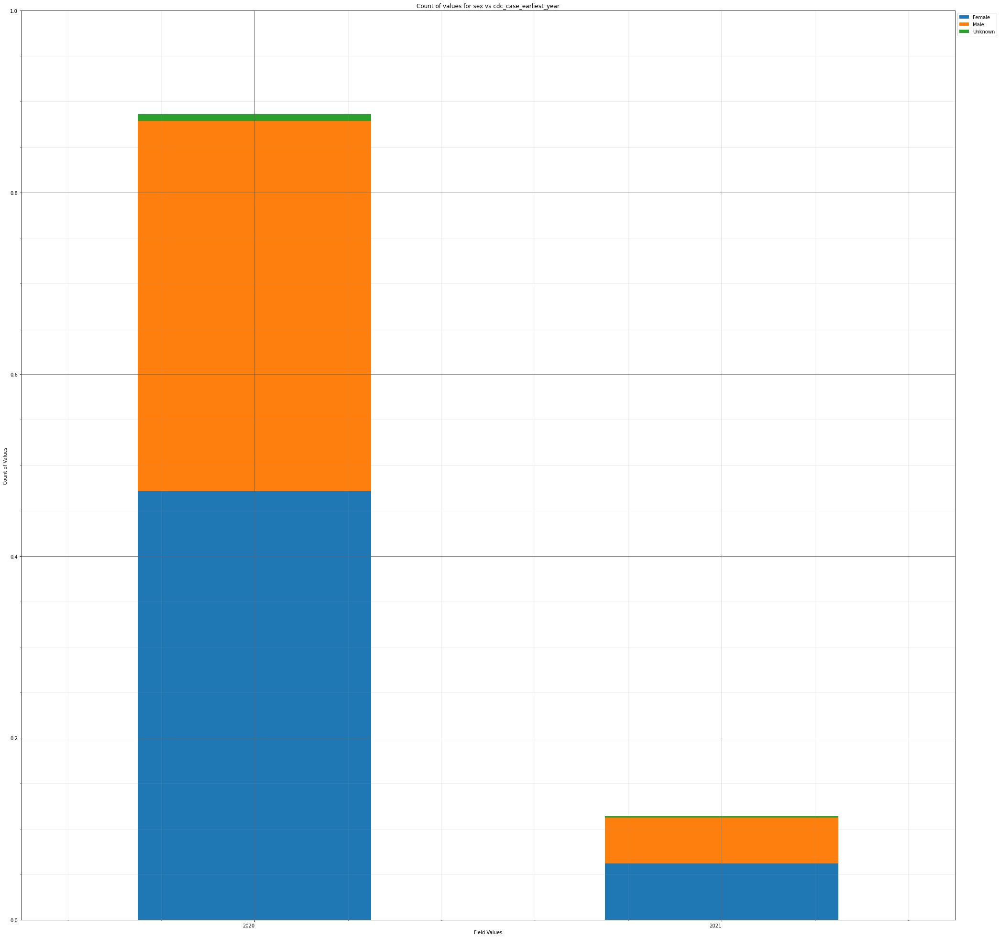



----------------------


Grouping over cdc_case_earliest_year|age_group results in:



,cdc_case_earliest_year,age_group,Rows,% Frequency
0,2020,0 - 9 Years,391,4.095098
1,2020,10 - 19 Years,871,9.122329
2,2020,20 - 29 Years,1548,16.212819
3,2020,30 - 39 Years,1328,13.908672
4,2020,40 - 49 Years,1253,13.123167
5,2020,50 - 59 Years,1203,12.599497
6,2020,60 - 69 Years,884,9.258483
7,2020,70 - 79 Years,557,5.833682
8,2020,80+ Years,411,4.304566
9,2020,Unknown,13,0.136154


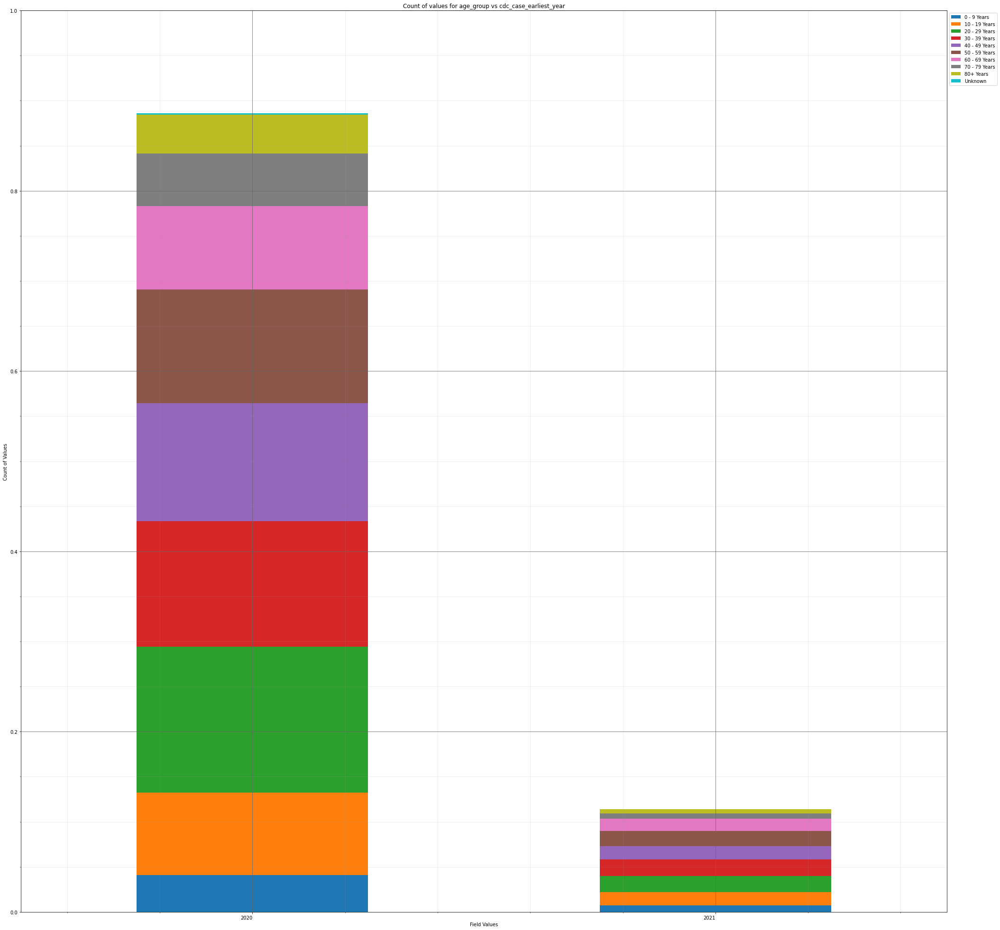



----------------------


Grouping over cdc_case_earliest_year|hosp_yn results in:



,cdc_case_earliest_year,hosp_yn,Rows,% Frequency
0,2020,No,4695,49.172602
1,2020,OTH,0,0.000000
2,2020,Unknown,3094,32.404692
3,2020,Yes,670,7.017176
4,2021,No,461,4.828236
5,2021,OTH,0,0.000000
6,2021,Unknown,601,6.294512
7,2021,Yes,27,0.282782


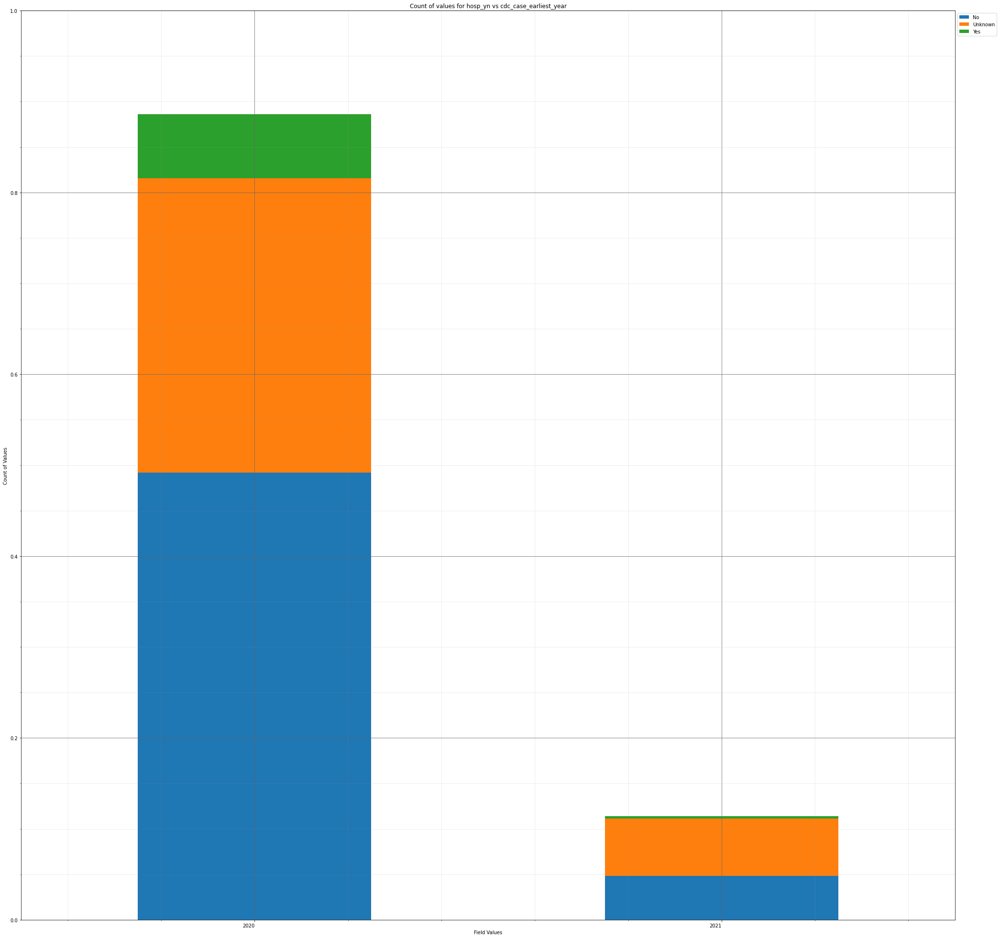



----------------------


Grouping over cdc_case_earliest_year|icu_yn results in:



,cdc_case_earliest_year,icu_yn,Rows,% Frequency
0,2020,No,895,9.373691
1,2020,Unknown,7476,78.299120
2,2020,Yes,88,0.921659
3,2021,No,54,0.565563
4,2021,Unknown,1033,10.819020
5,2021,Yes,2,0.020947


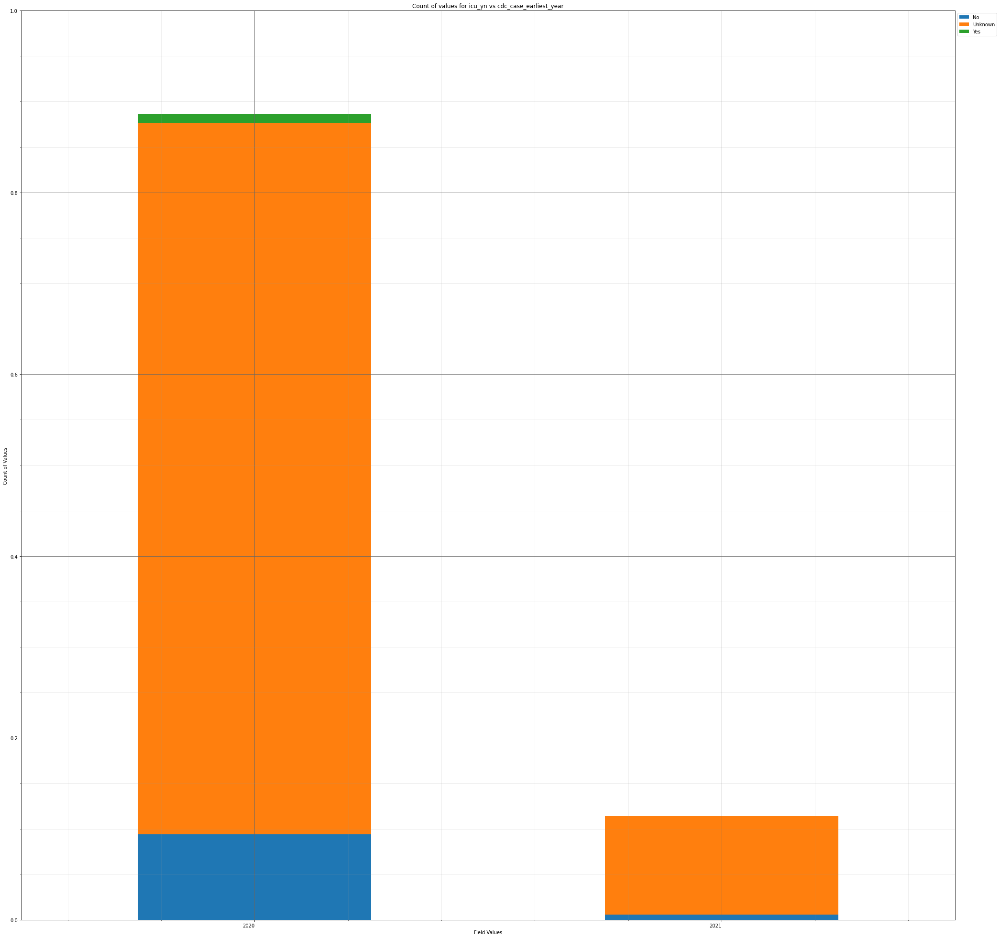



----------------------


Grouping over cdc_case_earliest_year|death_yn results in:



,cdc_case_earliest_year,death_yn,Rows,% Frequency
0,2020,No,8141,85.263930
1,2020,Yes,318,3.330540
2,2021,No,1075,11.258902
3,2021,Yes,14,0.146628


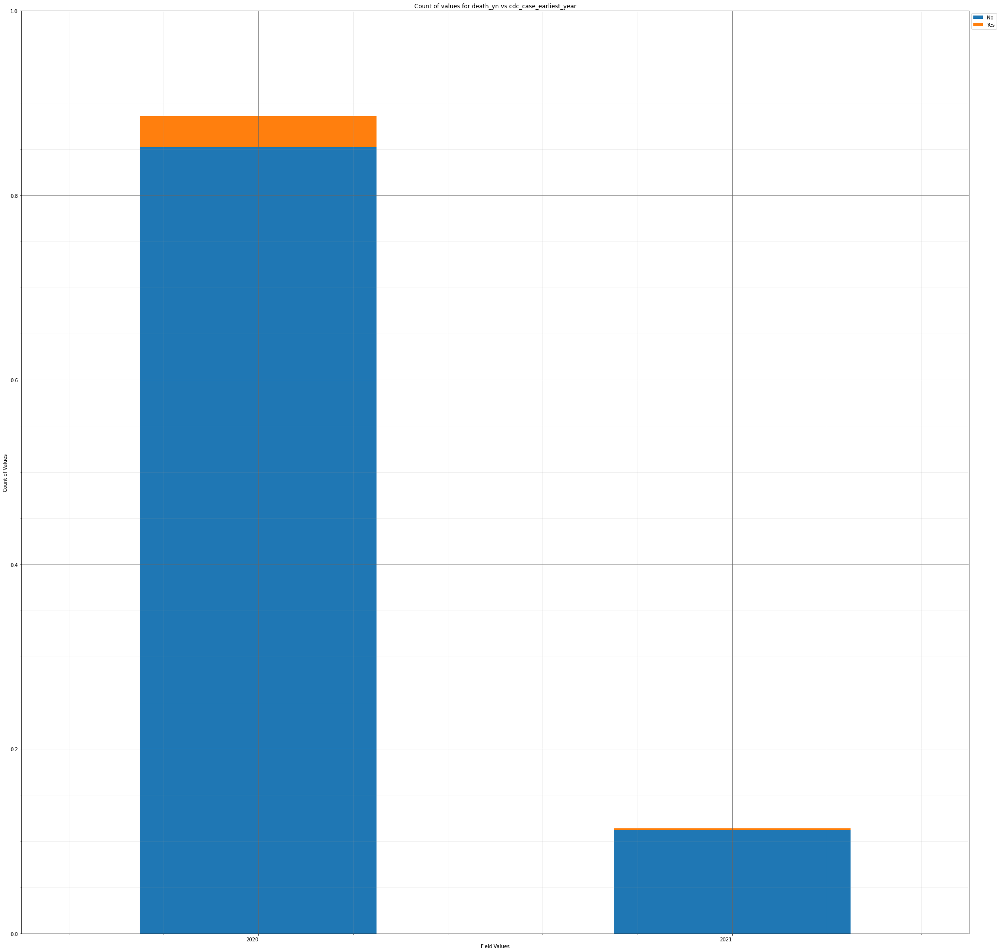



----------------------


Grouping over cdc_case_earliest_year|medcond_yn results in:



,cdc_case_earliest_year,medcond_yn,Rows,% Frequency
0,2020,No,871,9.122329
1,2020,Unknown,6818,71.407625
2,2020,Yes,770,8.064516
3,2021,No,55,0.576037
4,2021,Unknown,973,10.190616
5,2021,Yes,61,0.638877


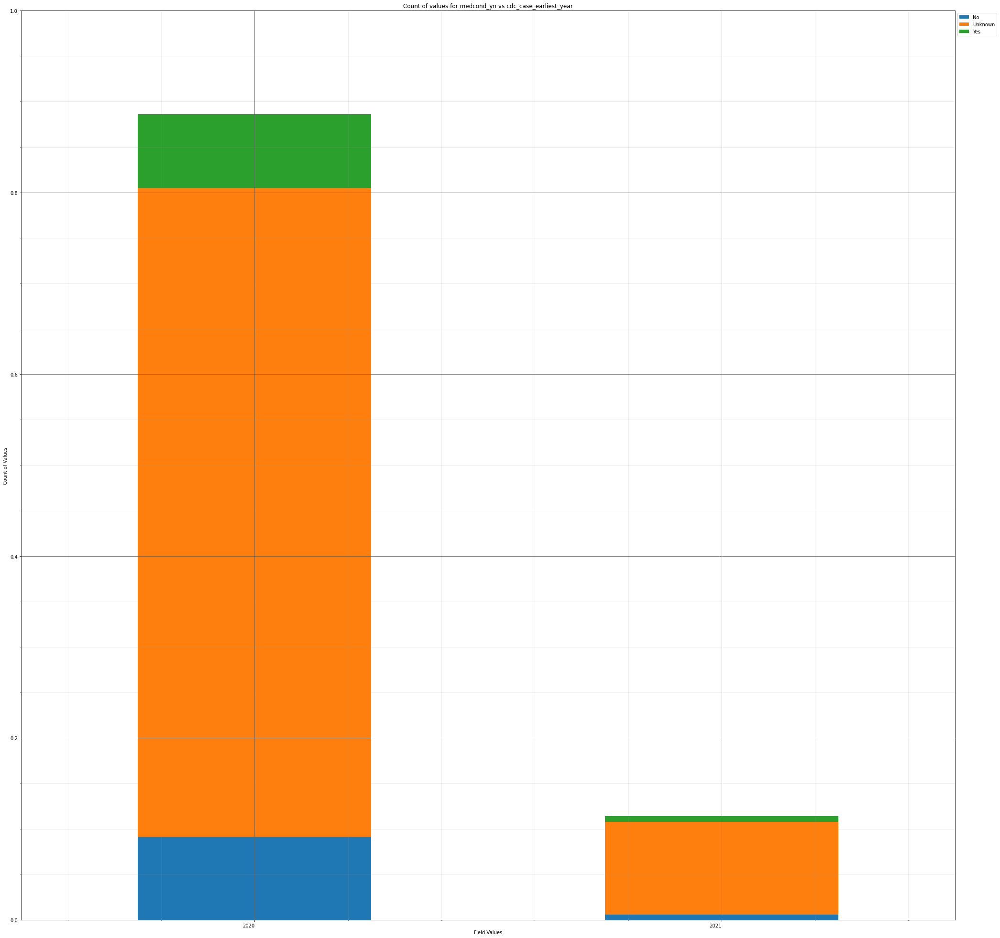



----------------------


Grouping over cdc_case_earliest_year|race results in:



,cdc_case_earliest_year,race,Rows,% Frequency
0,2020,American Indian/Alaska Native,57,0.596984
1,2020,Asian,195,2.042313
2,2020,Black,634,6.640134
3,2020,Hispanic/Latino,870,9.111856
4,2020,Multiple/Other,430,4.503561
5,2020,Native Hawaiian/Other Pacific Islander,20,0.209468
6,2020,Unknown,3297,34.530792
7,2020,White,2956,30.959363
8,2021,American Indian/Alaska Native,9,0.094261
9,2021,Asian,44,0.460829


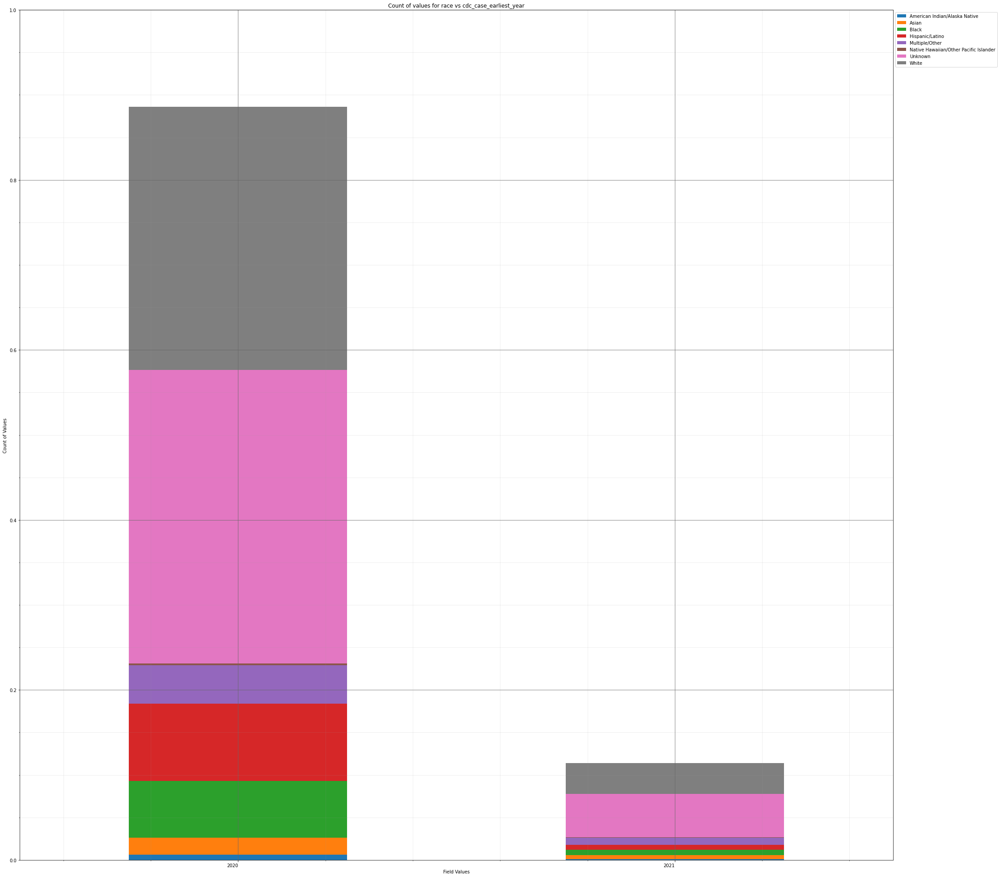



----------------------


Grouping over cdc_case_earliest_year|cdc_case_earliest_day results in:



,cdc_case_earliest_year,cdc_case_earliest_day,Rows,% Frequency
0,2020,1,240,2.513615
1,2020,2,255,2.670716
2,2020,3,257,2.691663
3,2020,4,235,2.461248
4,2020,5,238,2.492669
...,...,...,...,...
57,2021,27,0,0.000000
58,2021,28,0,0.000000
59,2021,29,0,0.000000
60,2021,30,0,0.000000


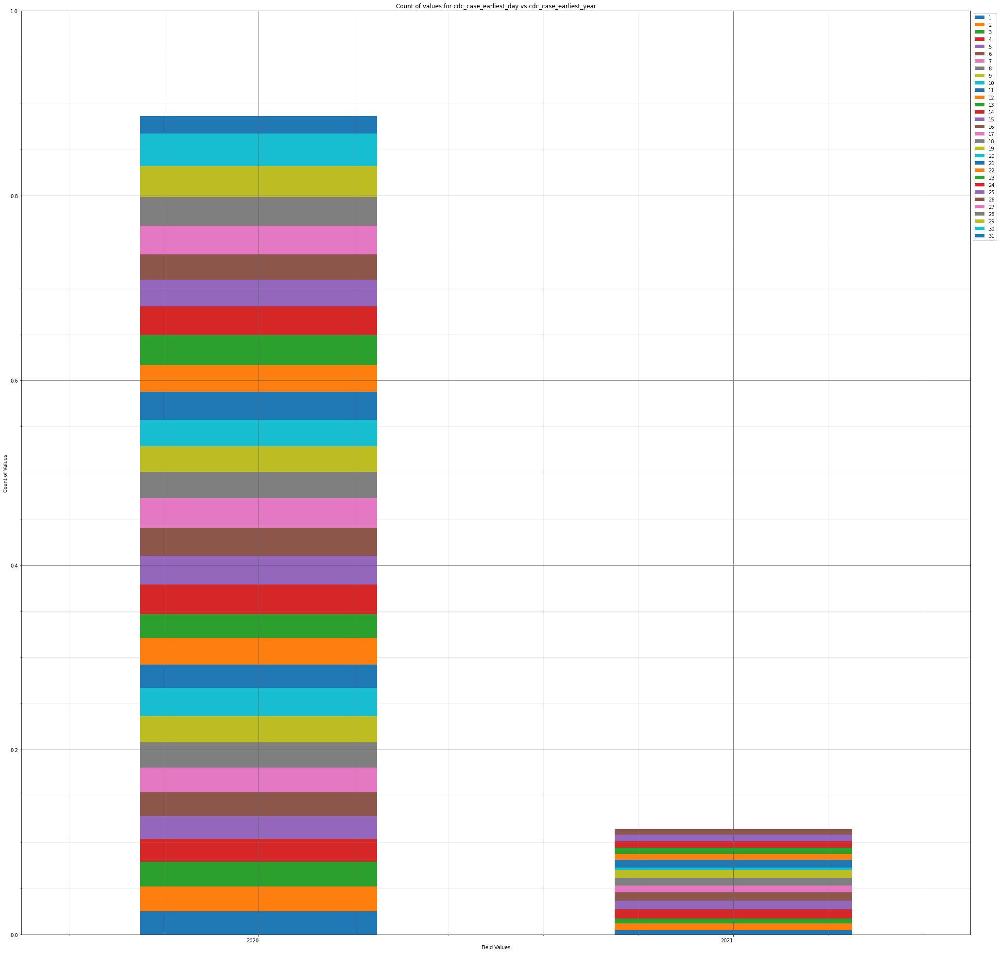



----------------------


Grouping over cdc_case_earliest_year|cdc_case_earliest_weekday results in:



,cdc_case_earliest_year,cdc_case_earliest_weekday,Rows,% Frequency
0,2020,0,1462,15.312107
1,2020,1,1361,14.254294
2,2020,2,1413,14.798911
3,2020,3,1237,12.955593
4,2020,4,1169,12.243402
5,2020,5,959,10.043988
6,2020,6,858,8.986175
7,2021,0,176,1.843318
8,2021,1,151,1.581483
9,2021,2,151,1.581483


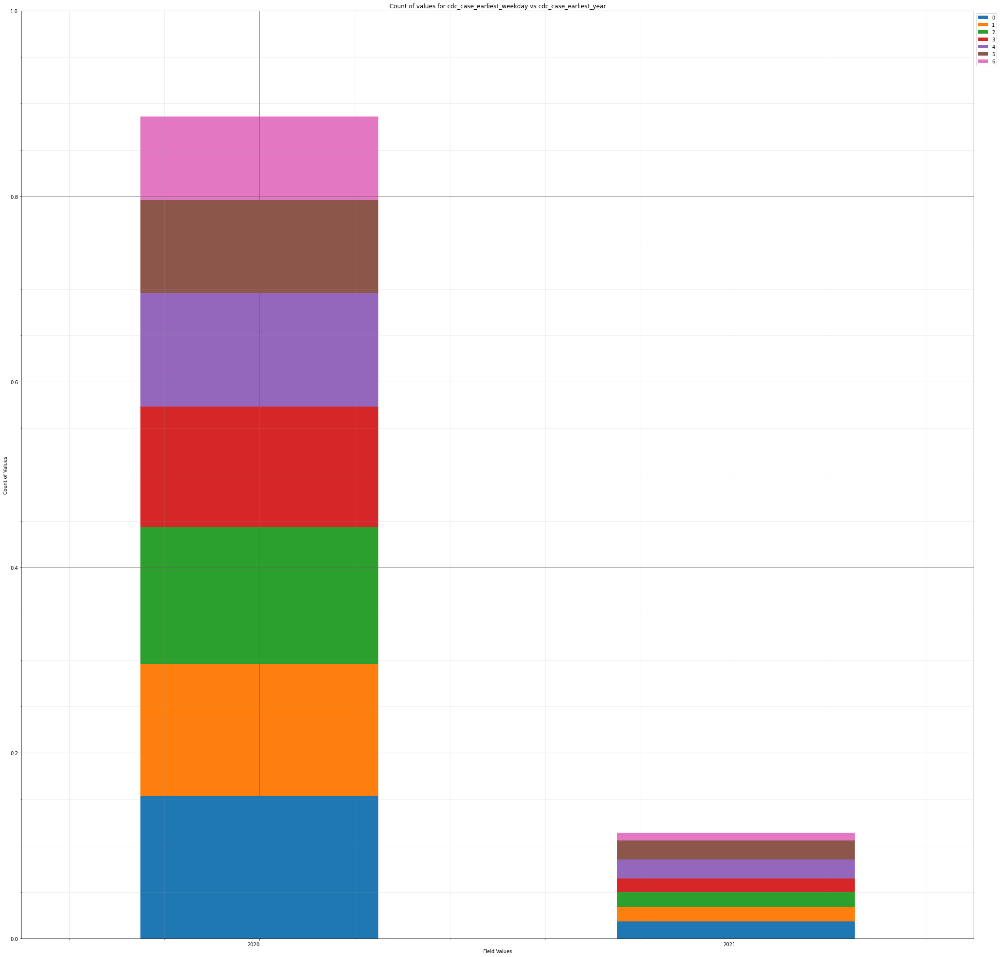



----------------------


Grouping over cdc_case_earliest_year|cdc_case_earliest_month results in:



,cdc_case_earliest_year,cdc_case_earliest_month,Rows,% Frequency
0,2020,1,4,0.041894
1,2020,2,3,0.031420
2,2020,3,233,2.440302
3,2020,4,496,5.194805
4,2020,5,424,4.440721
5,2020,6,581,6.085044
6,2020,7,887,9.289904
7,2020,8,576,6.032677
8,2020,9,570,5.969837
9,2020,10,860,9.007122


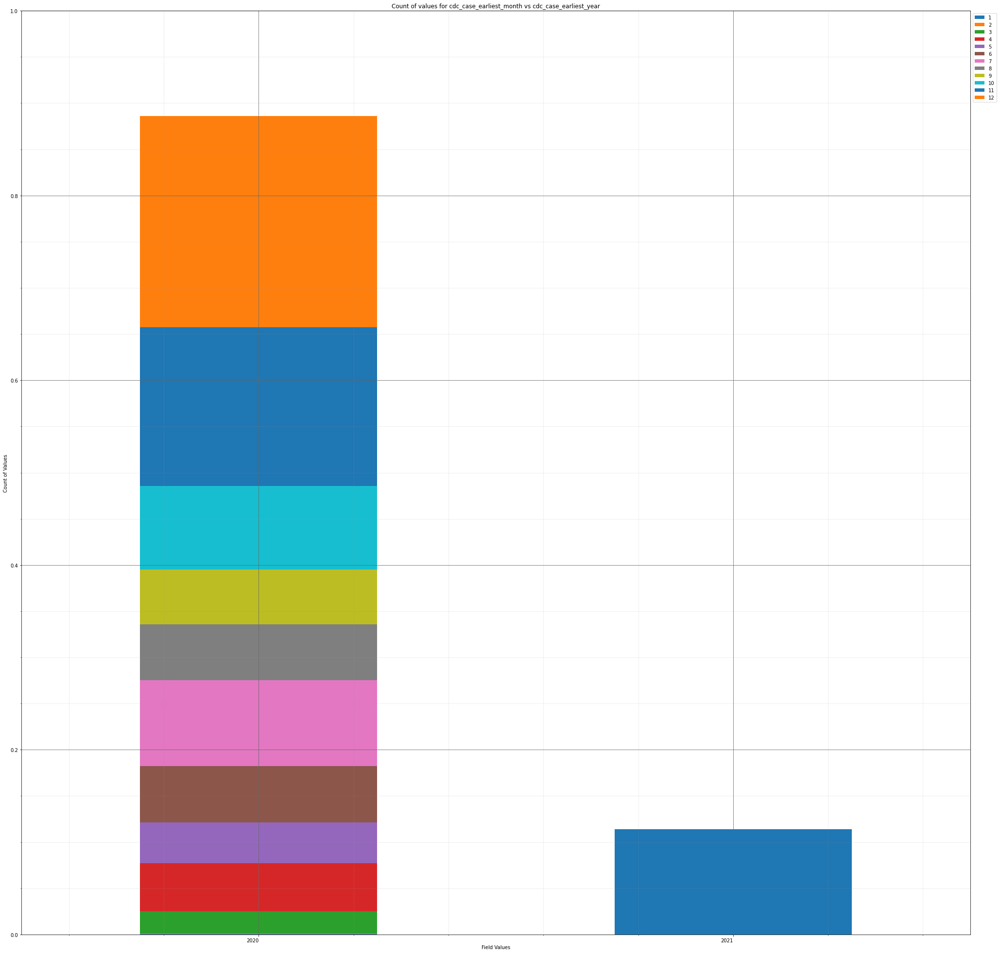



----------------------


Grouping over cdc_case_earliest_year|demographic_missing results in:



,cdc_case_earliest_year,demographic_missing,Rows,% Frequency
0,2020,False,5128,53.707583
1,2020,True,3331,34.886887
2,2021,False,596,6.242145
3,2021,True,493,5.163385


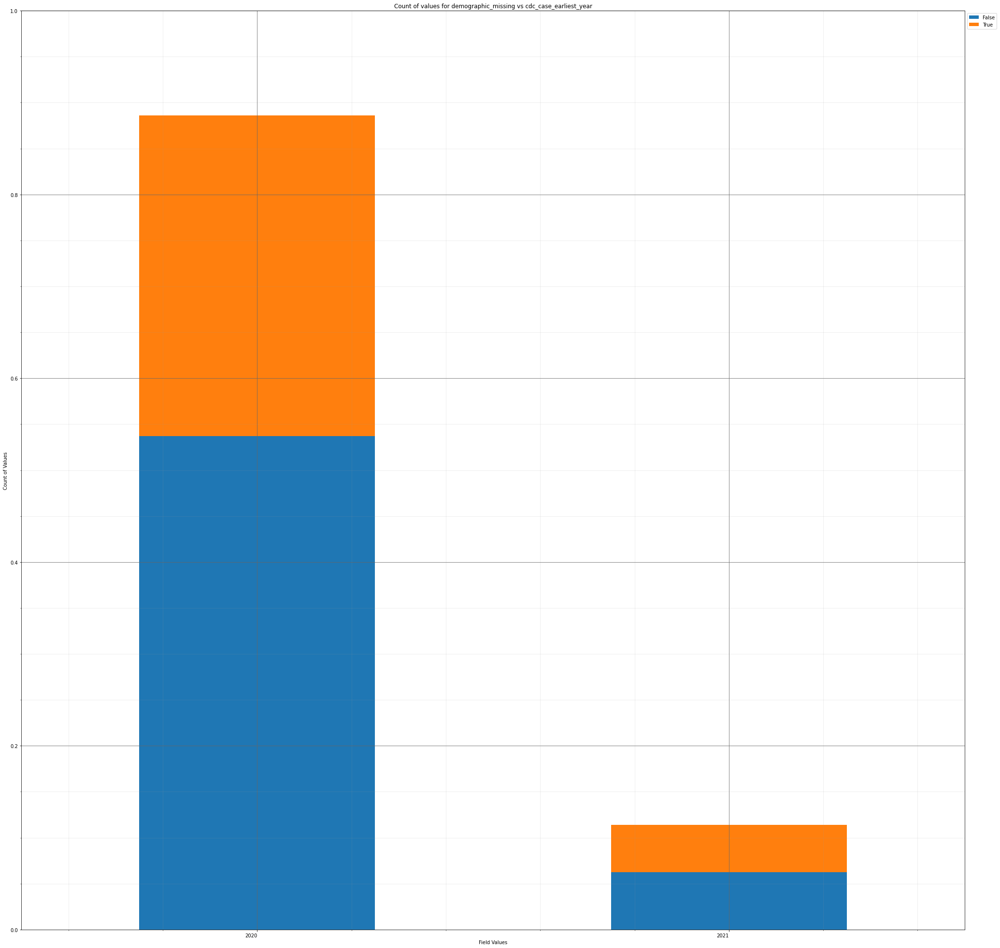



----------------------


Grouping over cdc_case_earliest_year|medical_missing results in:



,cdc_case_earliest_year,medical_missing,Rows,% Frequency
0,2020,False,692,7.247591
1,2020,True,7767,81.346879
2,2021,False,37,0.387516
3,2021,True,1052,11.018014


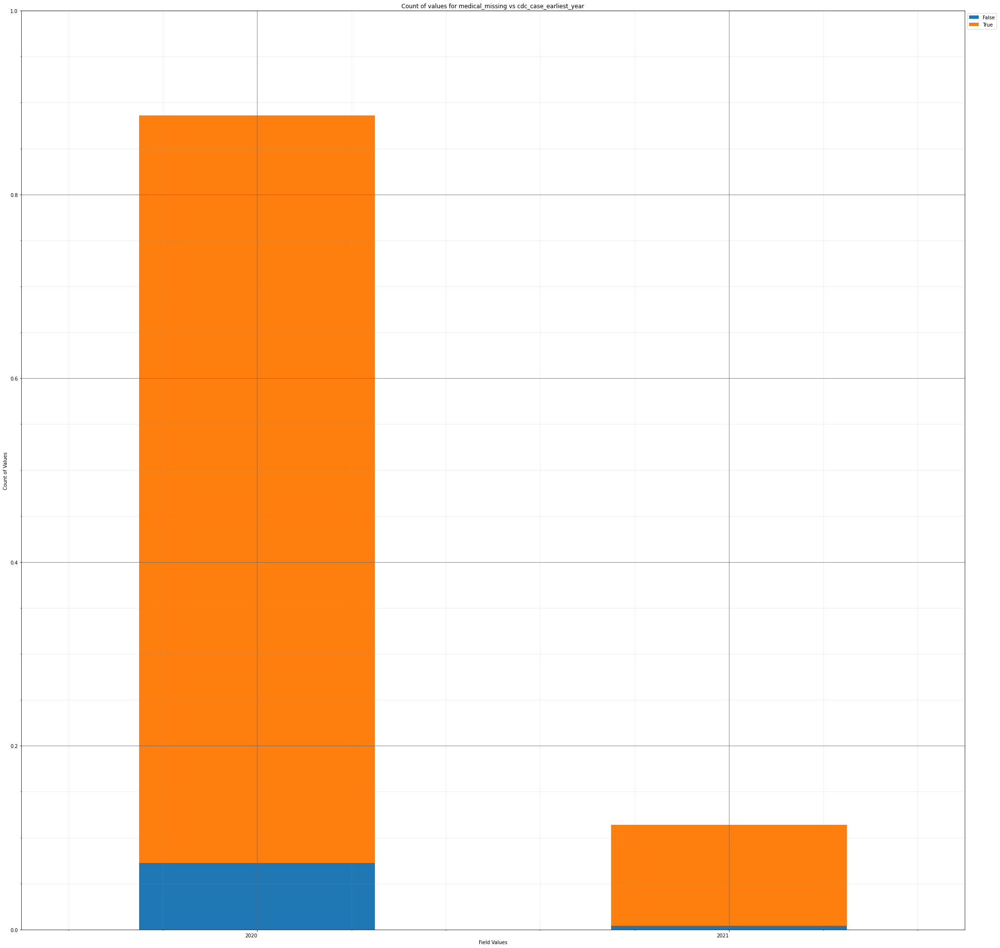



----------------------


Grouping over demographic_missing|current_status results in:



,demographic_missing,current_status,Rows,% Frequency
0,False,Laboratory-confirmed case,5399,56.545873
1,False,Probable Case,325,3.403854
2,True,Laboratory-confirmed case,3707,38.824885
3,True,Probable Case,117,1.225388


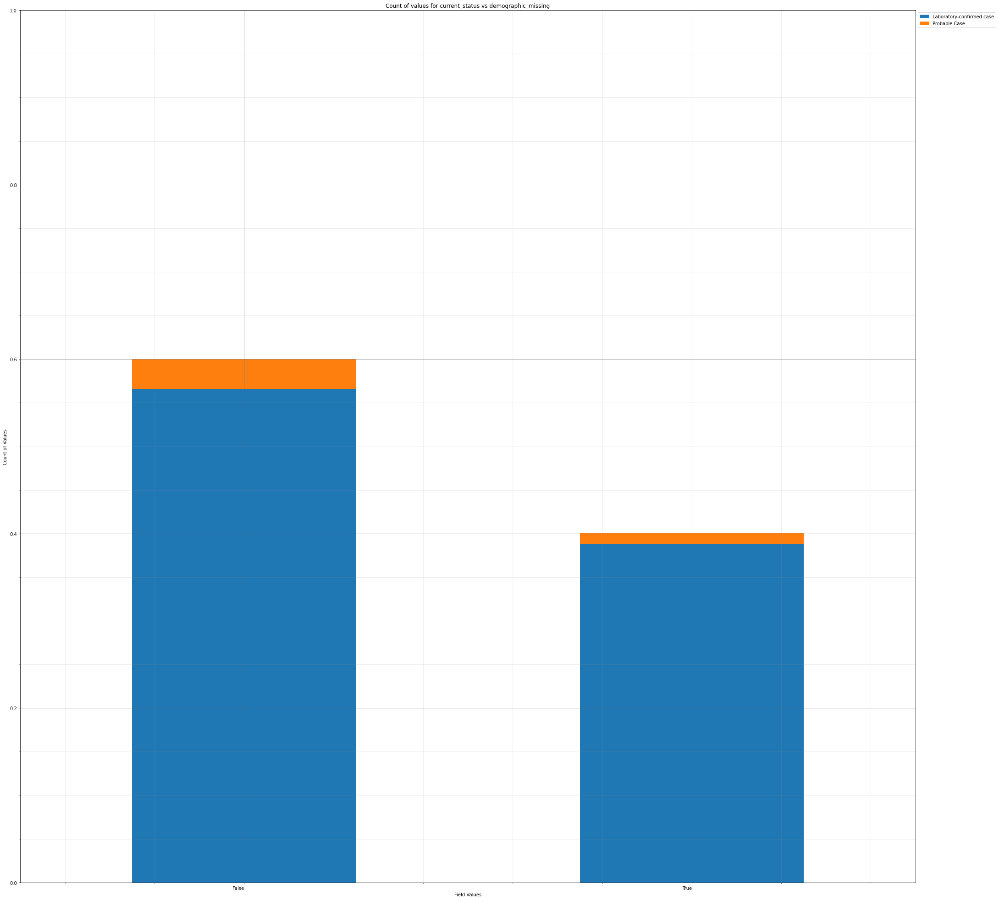



----------------------


Grouping over demographic_missing|sex results in:



,demographic_missing,sex,Rows,% Frequency
0,False,Female,3127,32.750314
1,False,Male,2597,27.199413
2,False,Unknown,0,0.000000
3,True,Female,1962,20.548806
4,True,Male,1779,18.632174
5,True,Unknown,83,0.869292


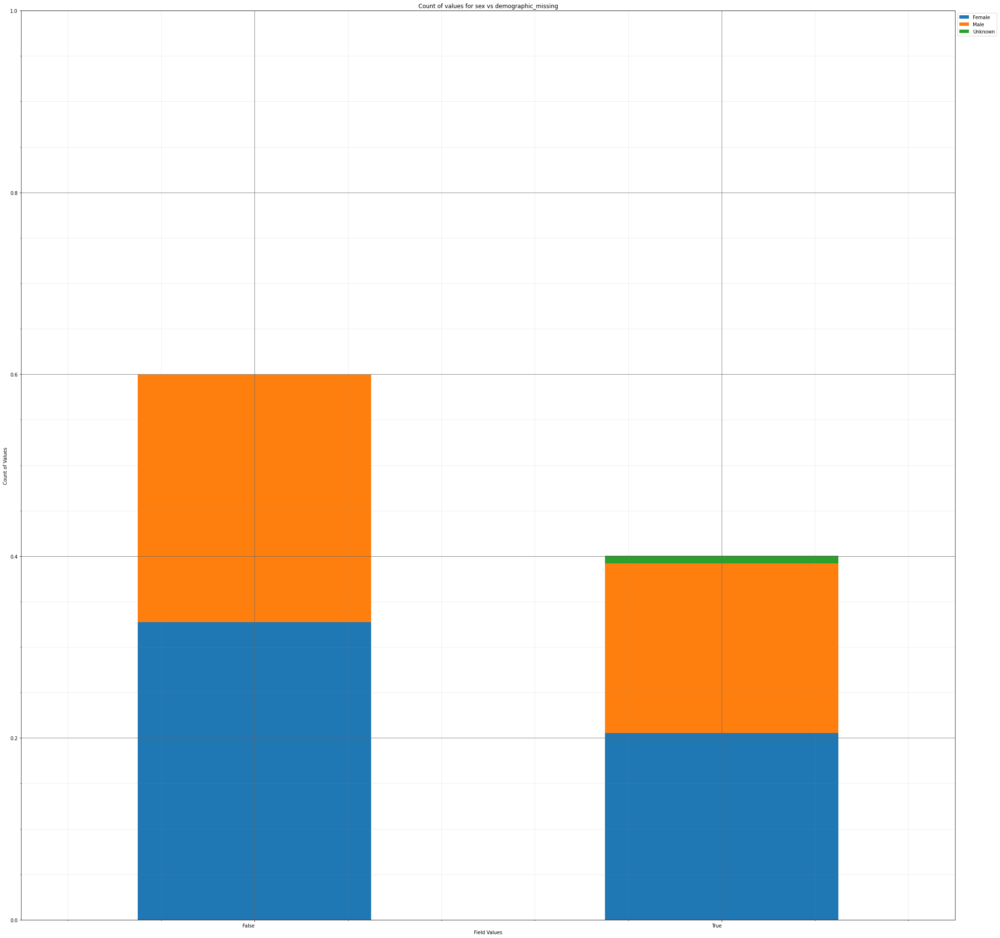



----------------------


Grouping over demographic_missing|age_group results in:



,demographic_missing,age_group,Rows,% Frequency
0,False,0 - 9 Years,238,2.492669
1,False,10 - 19 Years,575,6.022204
2,False,20 - 29 Years,1000,10.473398
3,False,30 - 39 Years,854,8.944282
4,False,40 - 49 Years,806,8.441558
5,False,50 - 59 Years,838,8.776707
6,False,60 - 69 Years,667,6.985756
7,False,70 - 79 Years,426,4.461667
8,False,80+ Years,320,3.351487
9,False,Unknown,0,0.000000


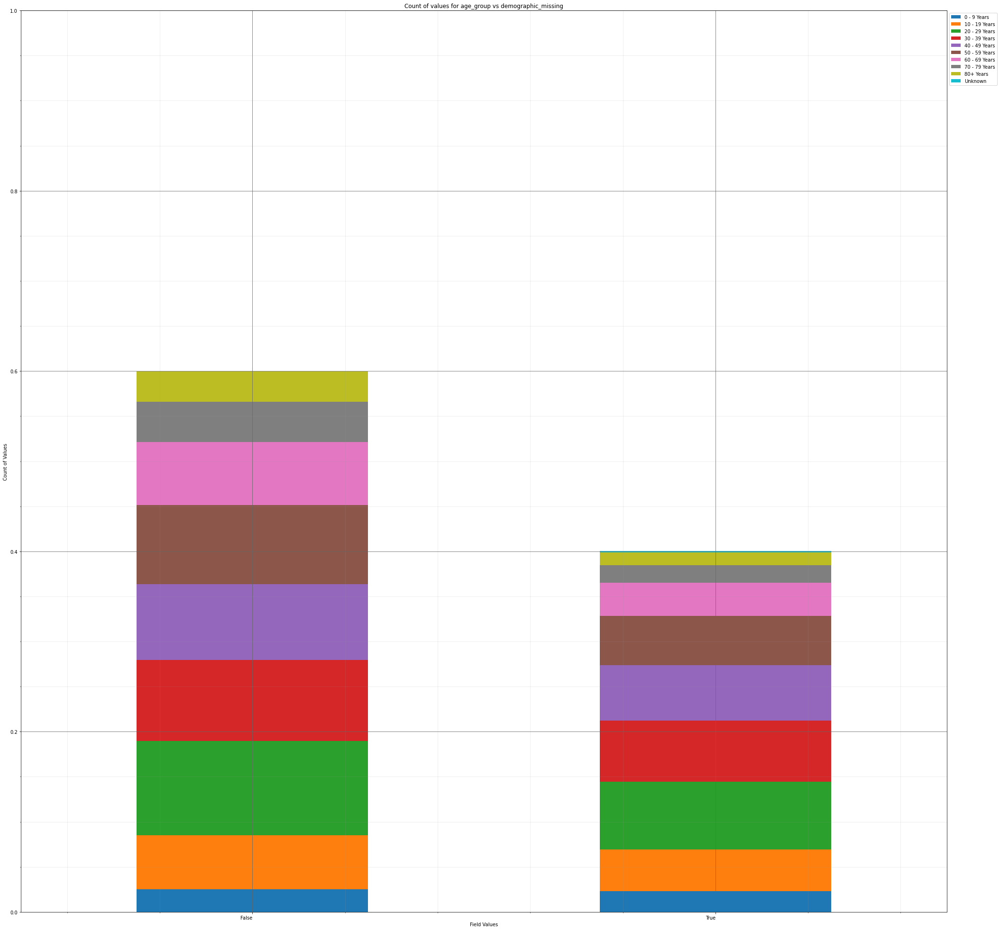



----------------------


Grouping over demographic_missing|hosp_yn results in:



,demographic_missing,hosp_yn,Rows,% Frequency
0,False,No,3744,39.212401
1,False,OTH,0,0.000000
2,False,Unknown,1440,15.081693
3,False,Yes,540,5.655635
4,True,No,1412,14.788437
5,True,OTH,0,0.000000
6,True,Unknown,2255,23.617512
7,True,Yes,157,1.644323


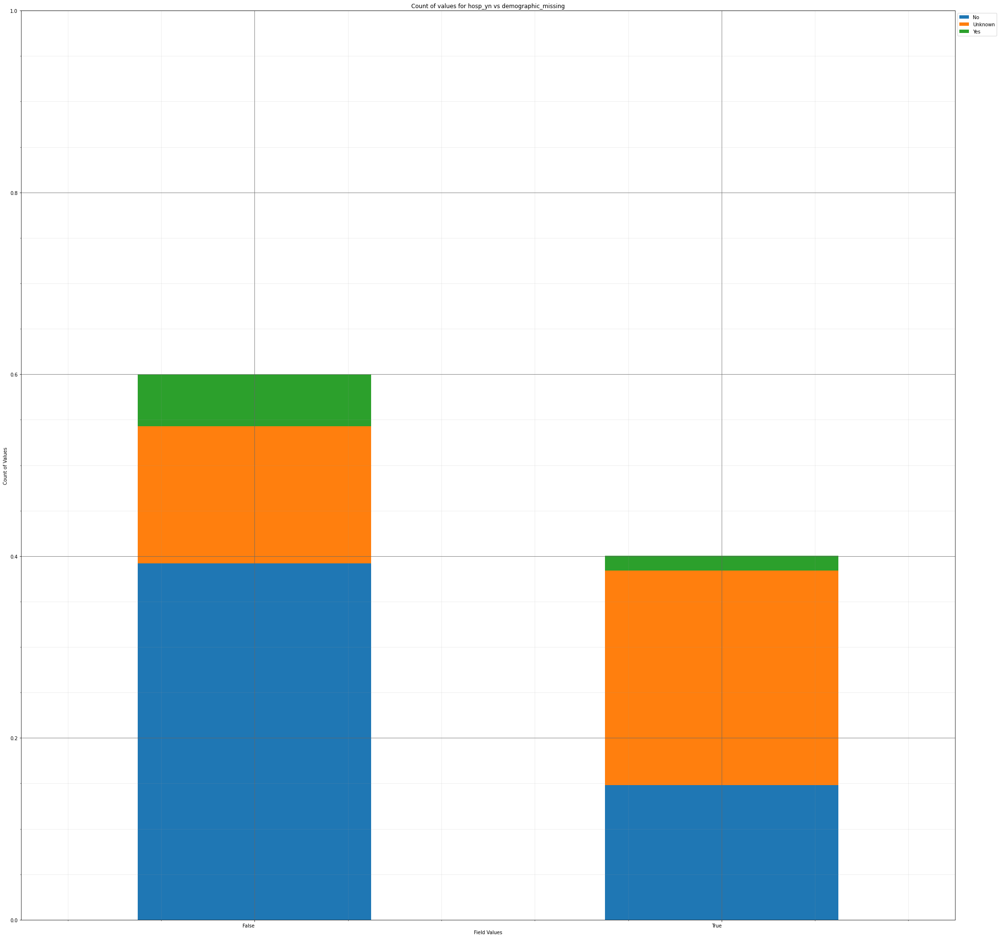



----------------------


Grouping over demographic_missing|icu_yn results in:



,demographic_missing,icu_yn,Rows,% Frequency
0,False,No,764,8.001676
1,False,Unknown,4899,51.309175
2,False,Yes,61,0.638877
3,True,No,185,1.937579
4,True,Unknown,3610,37.808965
5,True,Yes,29,0.303729


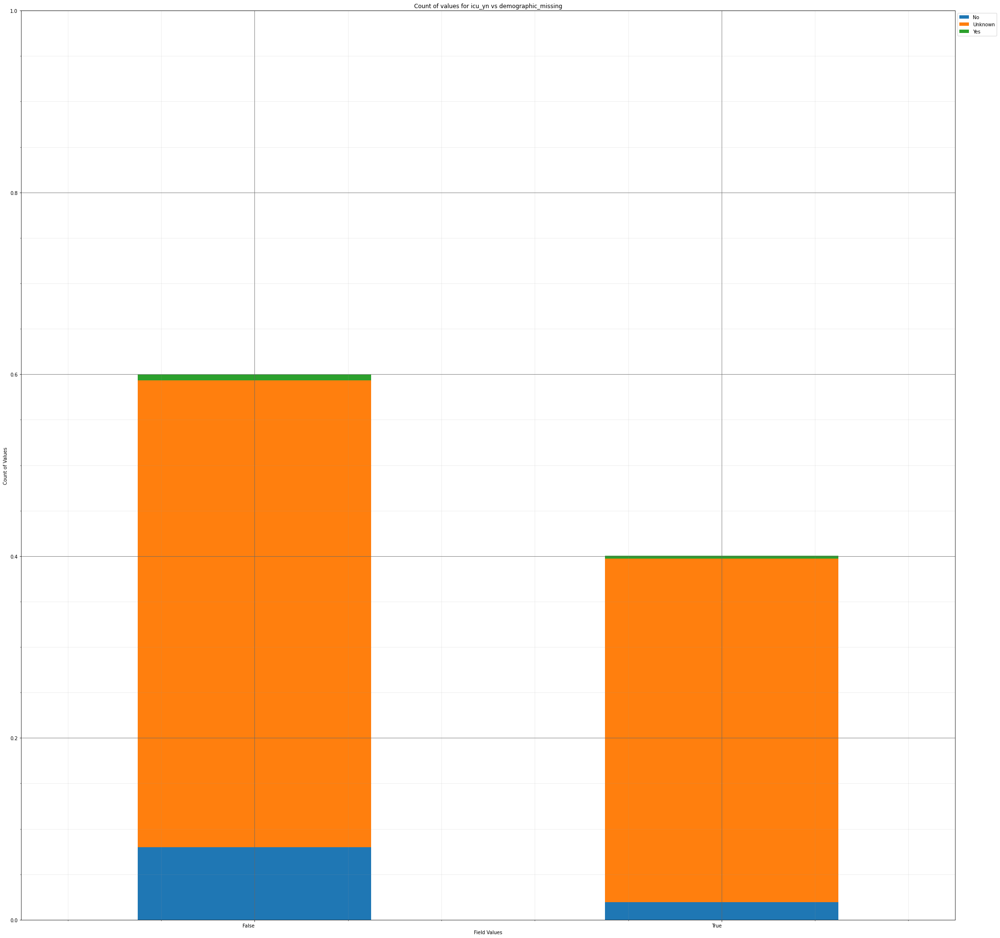



----------------------


Grouping over demographic_missing|death_yn results in:



,demographic_missing,death_yn,Rows,% Frequency
0,False,No,5461,57.195224
1,False,Yes,263,2.754504
2,True,No,3755,39.327608
3,True,Yes,69,0.722664


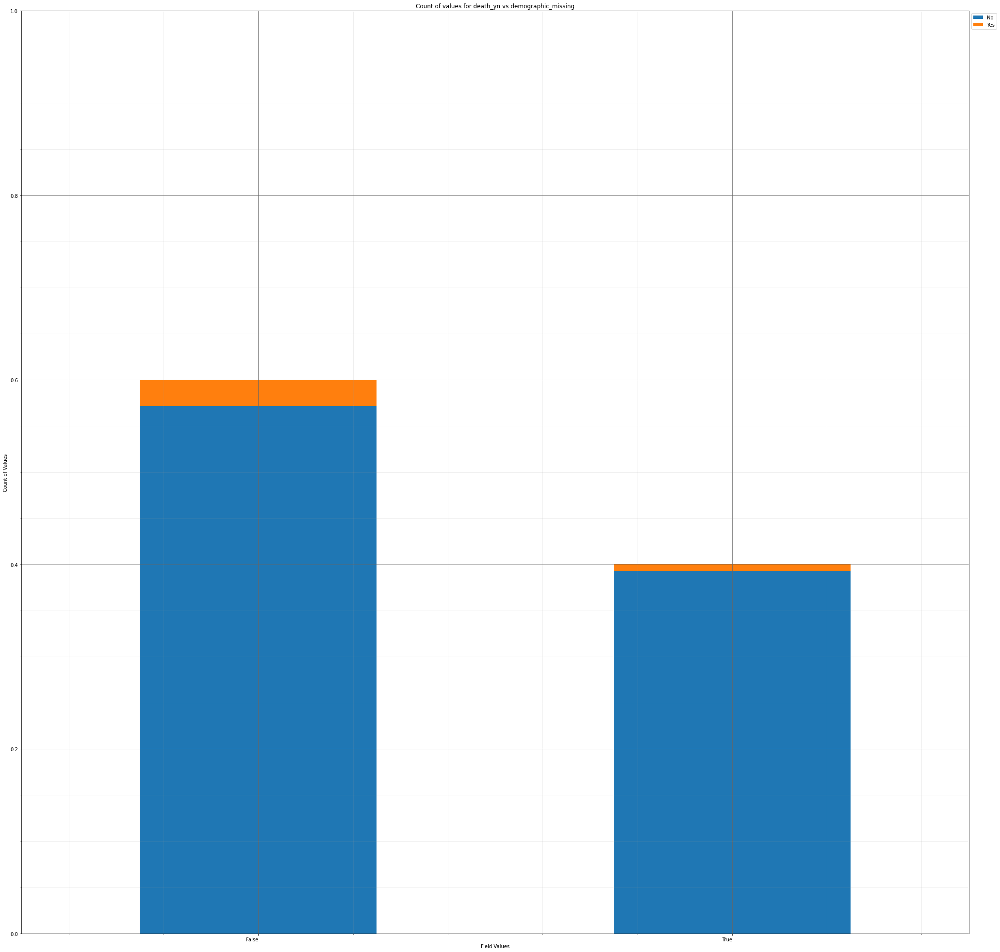



----------------------


Grouping over demographic_missing|medcond_yn results in:



,demographic_missing,medcond_yn,Rows,% Frequency
0,False,No,758,7.938835
1,False,Unknown,4260,44.616674
2,False,Yes,706,7.394219
3,True,No,168,1.759531
4,True,Unknown,3531,36.981567
5,True,Yes,125,1.309175


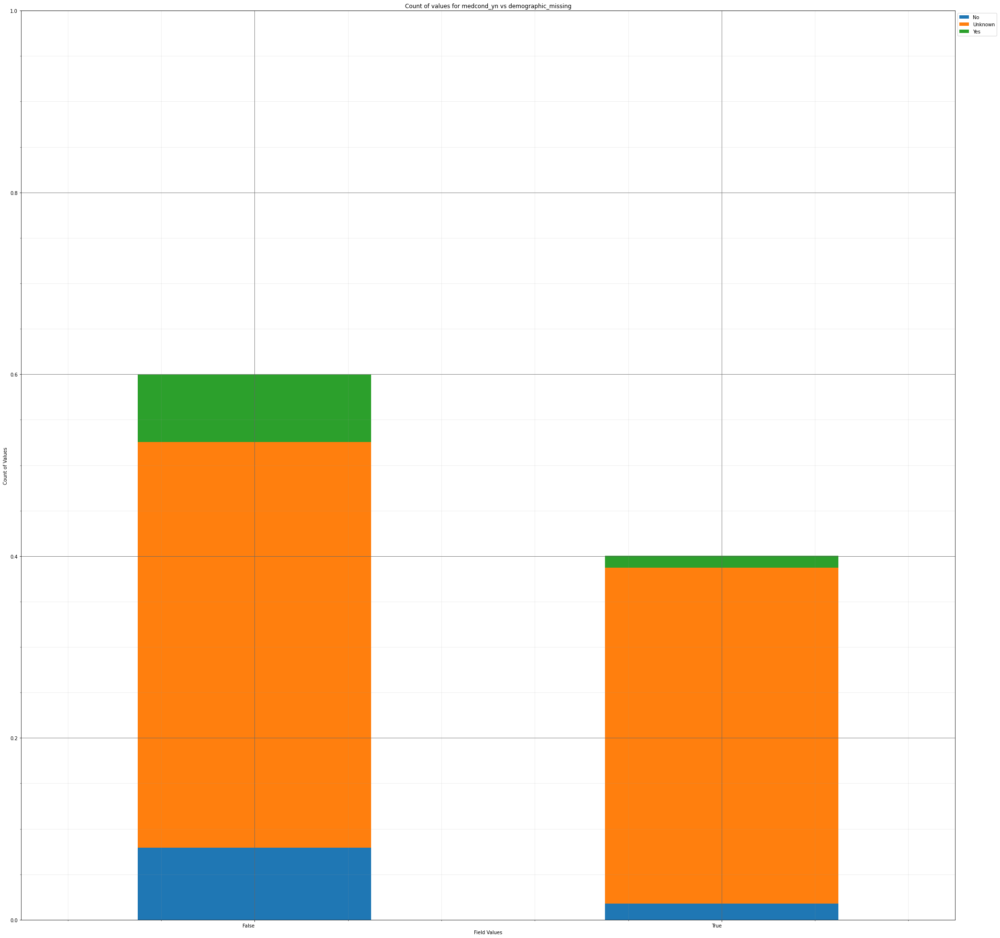



----------------------


Grouping over demographic_missing|race results in:



,demographic_missing,race,Rows,% Frequency
0,False,American Indian/Alaska Native,66,0.691244
1,False,Asian,236,2.471722
2,False,Black,691,7.237118
3,False,Hispanic/Latino,919,9.625052
4,False,Multiple/Other,504,5.278592
5,False,Native Hawaiian/Other Pacific Islander,23,0.240888
6,False,Unknown,0,0.000000
7,False,White,3285,34.405111
8,True,American Indian/Alaska Native,0,0.000000
9,True,Asian,3,0.031420


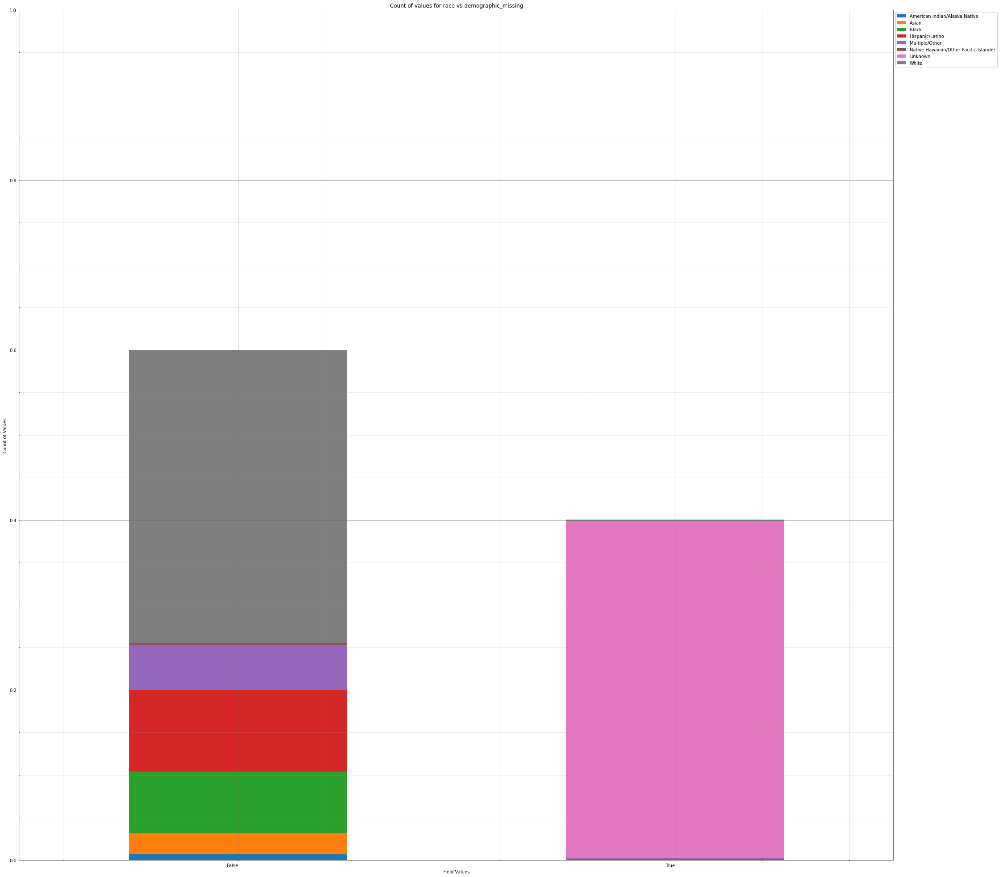



----------------------


Grouping over demographic_missing|cdc_case_earliest_day results in:



,demographic_missing,cdc_case_earliest_day,Rows,% Frequency
0,False,1,176,1.843318
1,False,2,197,2.063259
2,False,3,174,1.822371
3,False,4,216,2.262254
4,False,5,182,1.906158
...,...,...,...,...
57,True,27,122,1.277755
58,True,28,130,1.361542
59,True,29,137,1.434855
60,True,30,138,1.445329


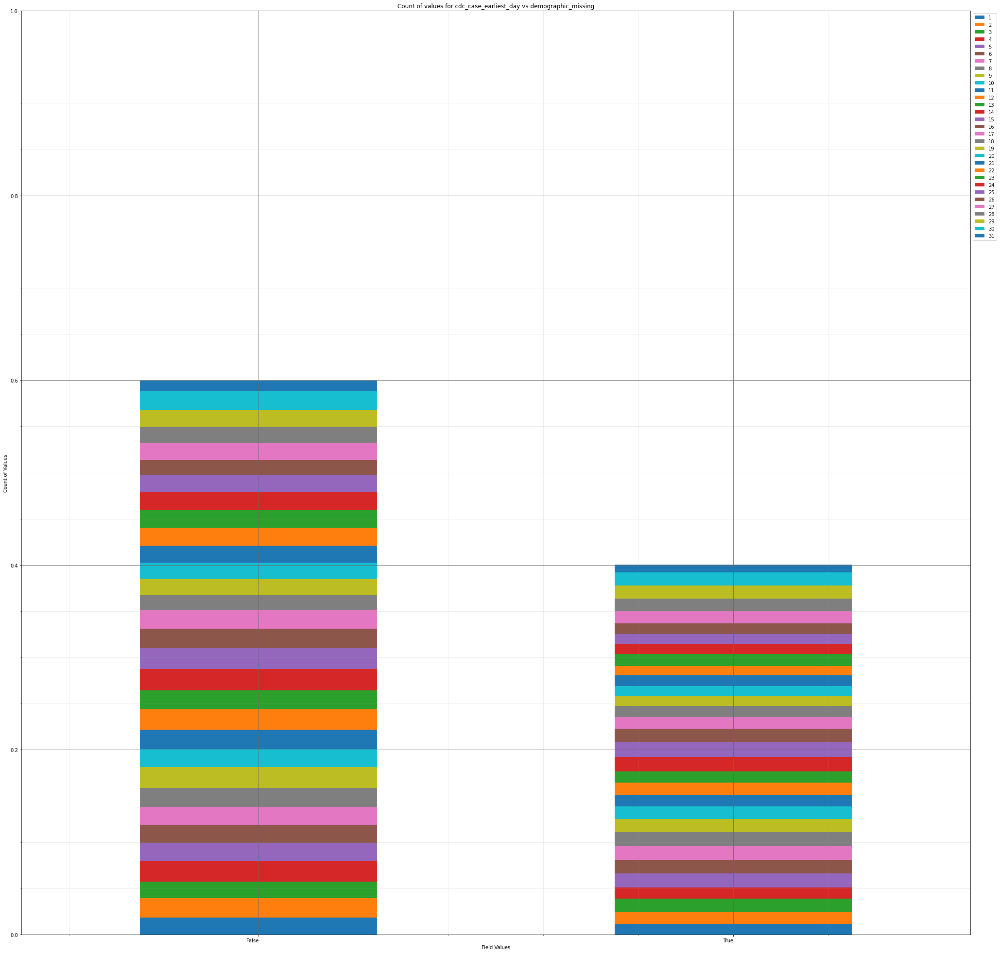



----------------------


Grouping over demographic_missing|cdc_case_earliest_weekday results in:



,demographic_missing,cdc_case_earliest_weekday,Rows,% Frequency
0,False,0,959,10.043988
1,False,1,875,9.164223
2,False,2,938,9.824047
3,False,3,810,8.483452
4,False,4,823,8.619606
5,False,5,714,7.478006
6,False,6,605,6.336406
7,True,0,679,7.111437
8,True,1,637,6.671554
9,True,2,626,6.556347


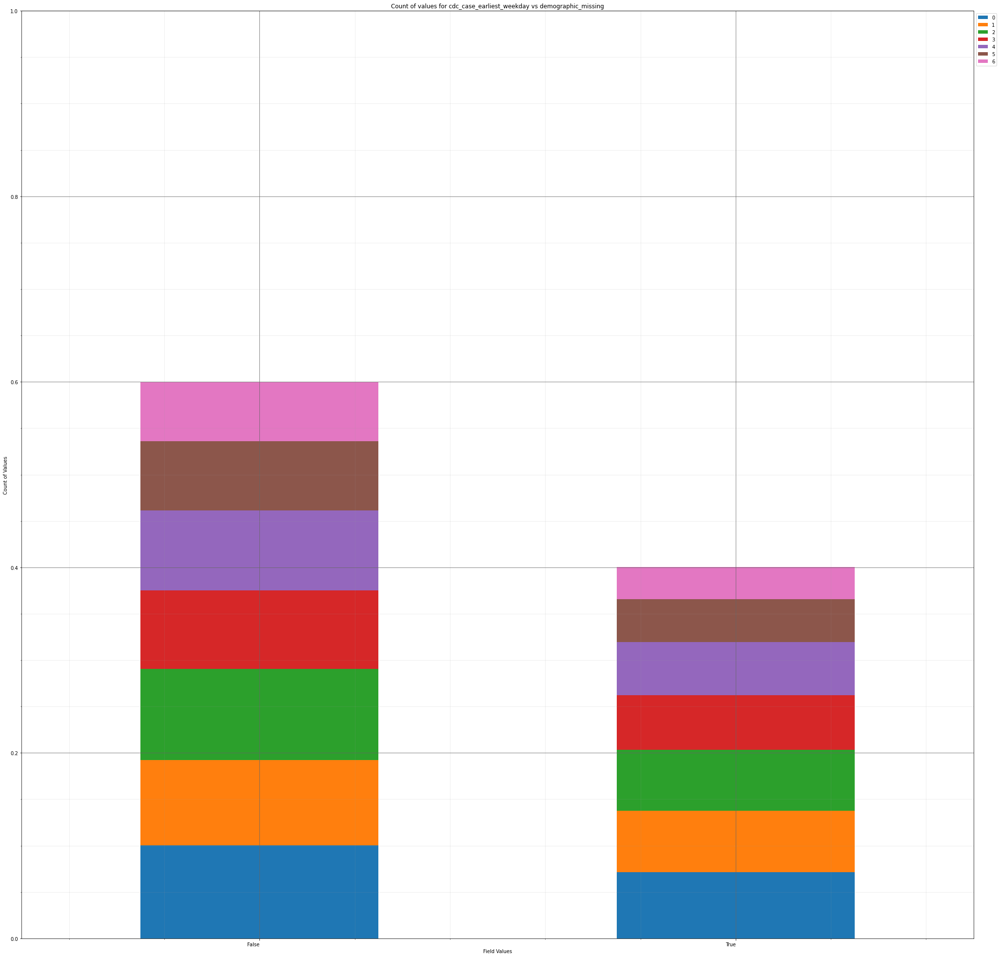



----------------------


Grouping over demographic_missing|cdc_case_earliest_month results in:



,demographic_missing,cdc_case_earliest_month,Rows,% Frequency
0,False,1,599,6.273565
1,False,2,2,0.020947
2,False,3,130,1.361542
3,False,4,272,2.848764
4,False,5,237,2.482195
5,False,6,325,3.403854
6,False,7,507,5.310013
7,False,8,363,3.801843
8,False,9,374,3.917051
9,False,10,593,6.210725


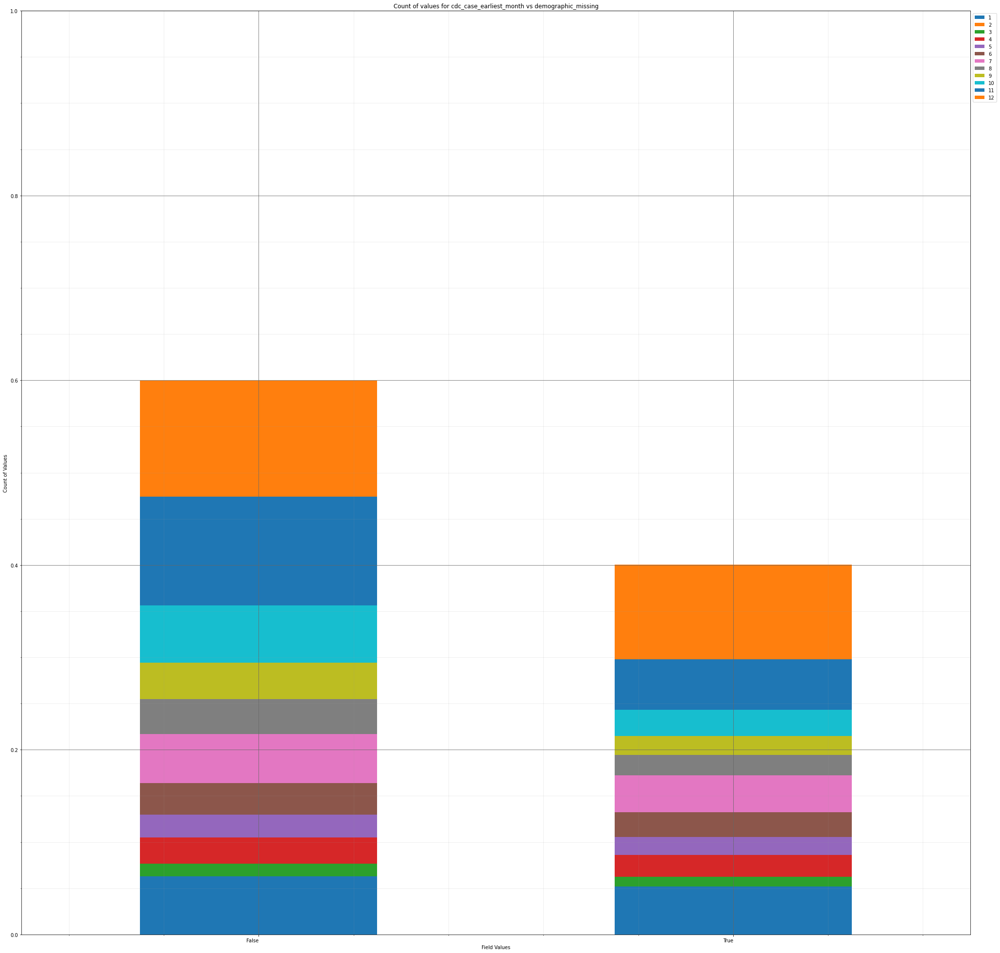



----------------------


Grouping over demographic_missing|cdc_case_earliest_year results in:



,demographic_missing,cdc_case_earliest_year,Rows,% Frequency
0,False,2020,5128,53.707583
1,False,2021,596,6.242145
2,True,2020,3331,34.886887
3,True,2021,493,5.163385


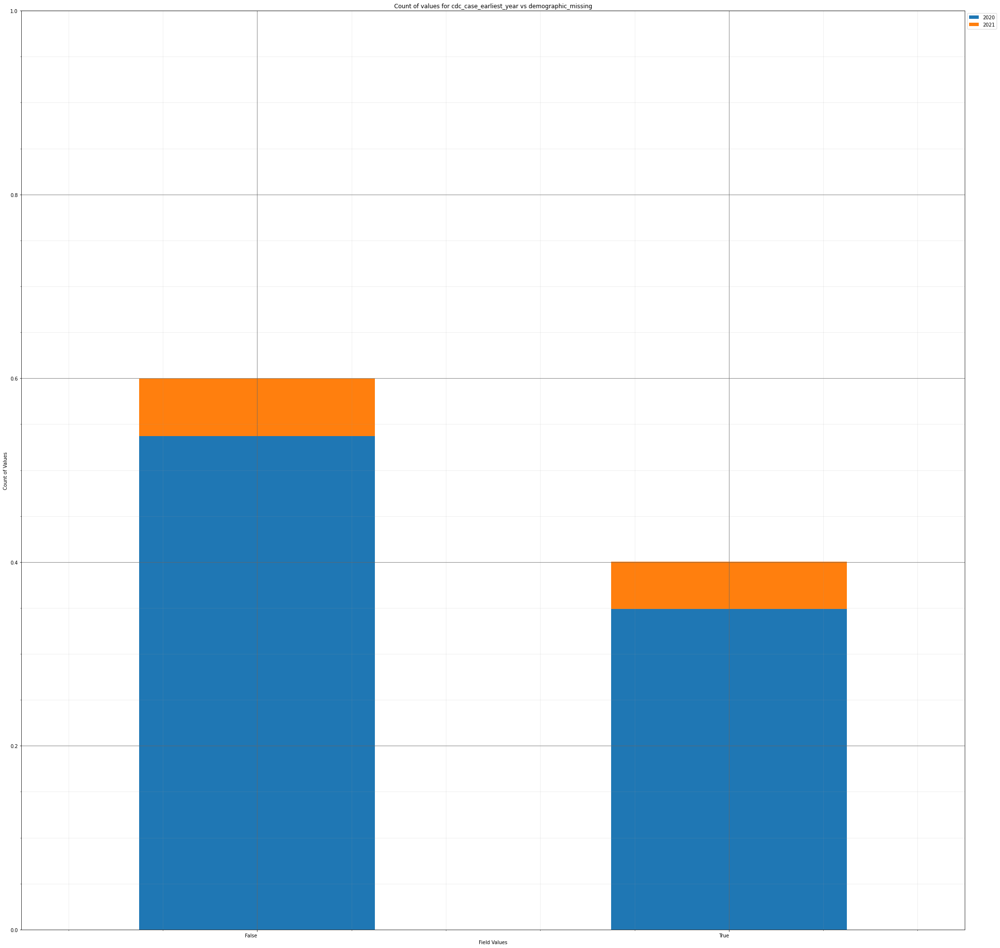



----------------------


Grouping over demographic_missing|medical_missing results in:



,demographic_missing,medical_missing,Rows,% Frequency
0,False,False,582,6.095517
1,False,True,5142,53.854210
2,True,False,147,1.539589
3,True,True,3677,38.510683


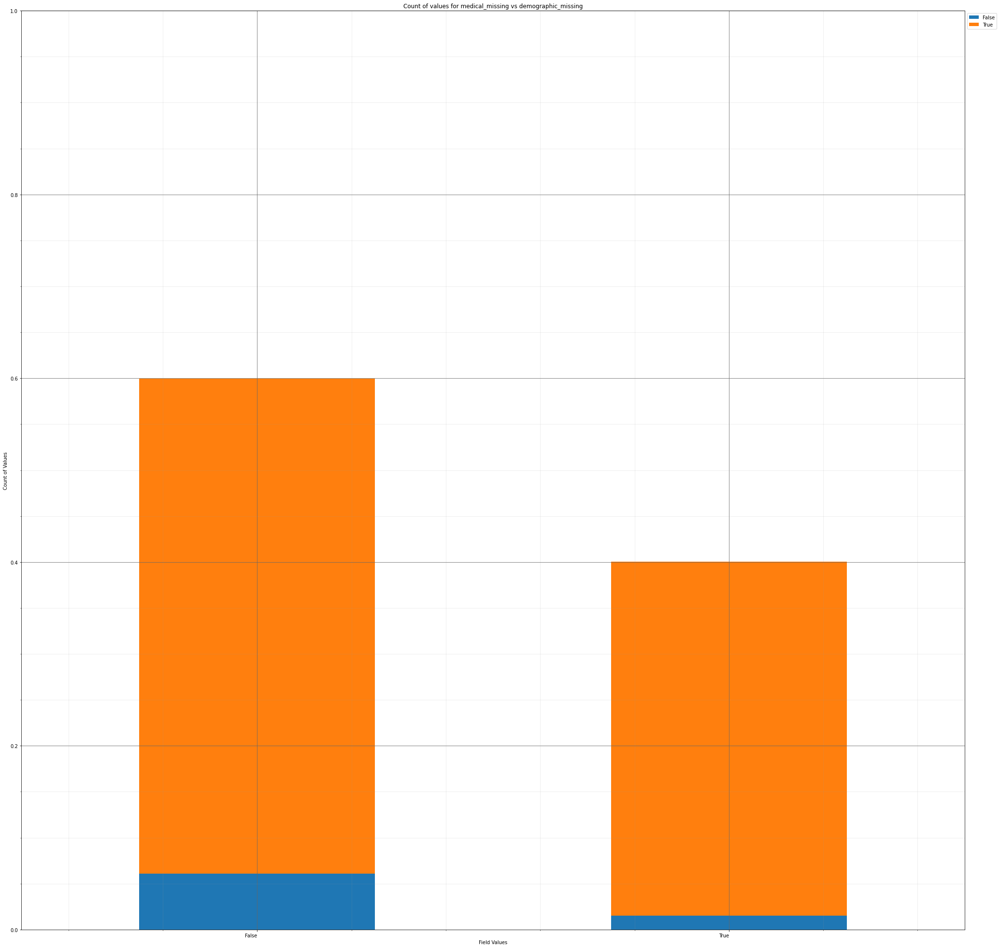



----------------------


Grouping over medical_missing|current_status results in:



,medical_missing,current_status,Rows,% Frequency
0,False,Laboratory-confirmed case,687,7.195224
1,False,Probable Case,42,0.439883
2,True,Laboratory-confirmed case,8419,88.175534
3,True,Probable Case,400,4.189359


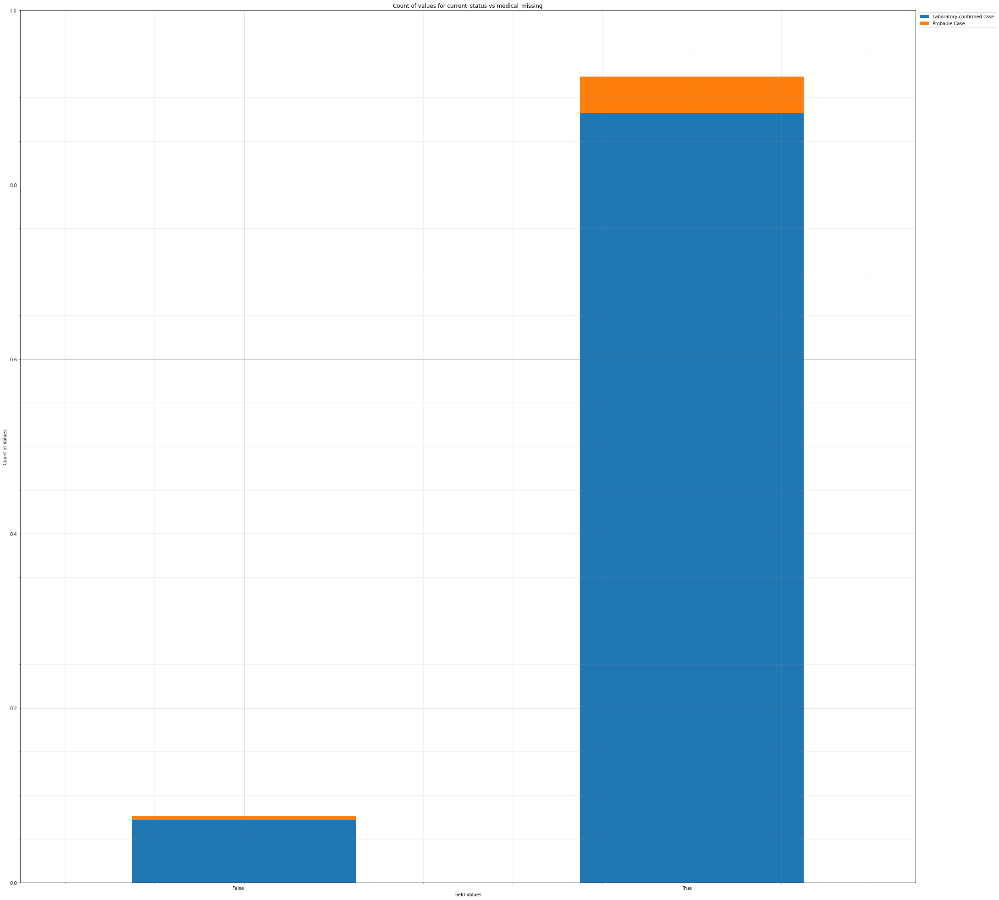



----------------------


Grouping over medical_missing|sex results in:



,medical_missing,sex,Rows,% Frequency
0,False,Female,396,4.147465
1,False,Male,329,3.445748
2,False,Unknown,4,0.041894
3,True,Female,4693,49.151655
4,True,Male,4047,42.385840
5,True,Unknown,79,0.827398


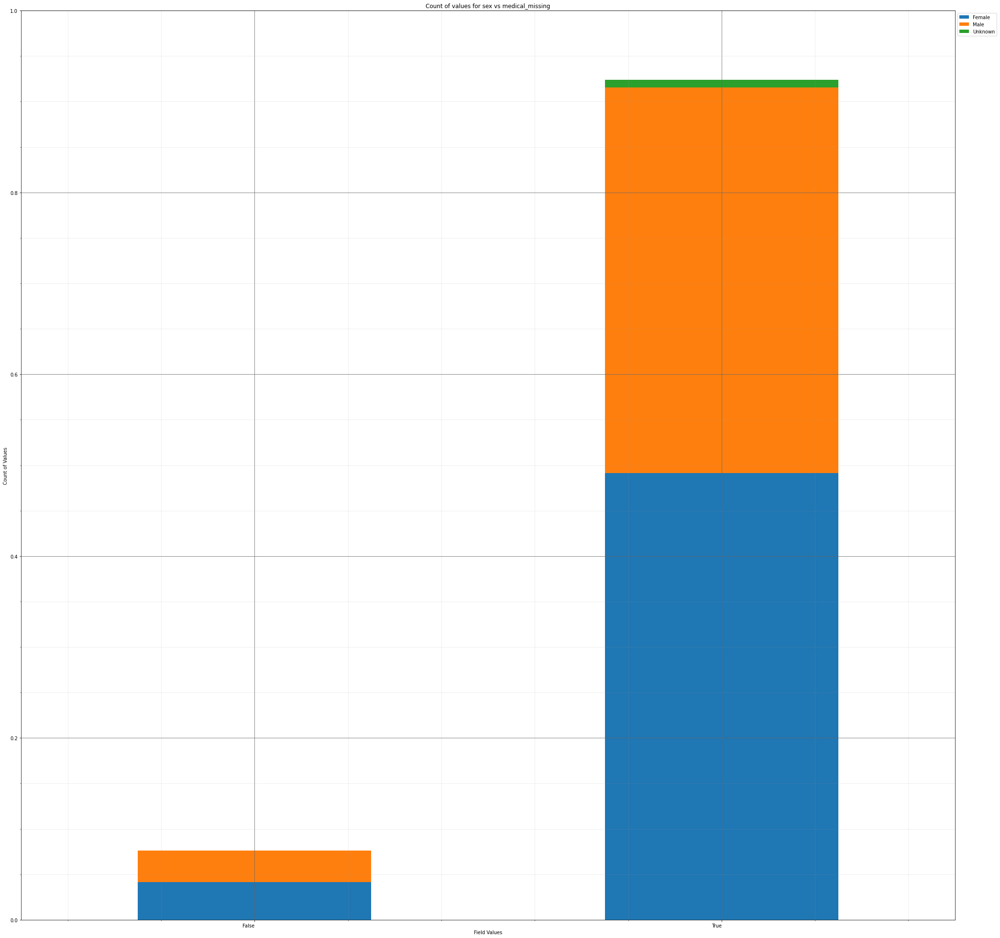



----------------------


Grouping over medical_missing|age_group results in:



,medical_missing,age_group,Rows,% Frequency
0,False,0 - 9 Years,23,0.240888
1,False,10 - 19 Years,71,0.743611
2,False,20 - 29 Years,111,1.162547
3,False,30 - 39 Years,124,1.298701
4,False,40 - 49 Years,87,0.911186
5,False,50 - 59 Years,111,1.162547
6,False,60 - 69 Years,87,0.911186
7,False,70 - 79 Years,61,0.638877
8,False,80+ Years,54,0.565563
9,False,Unknown,0,0.000000


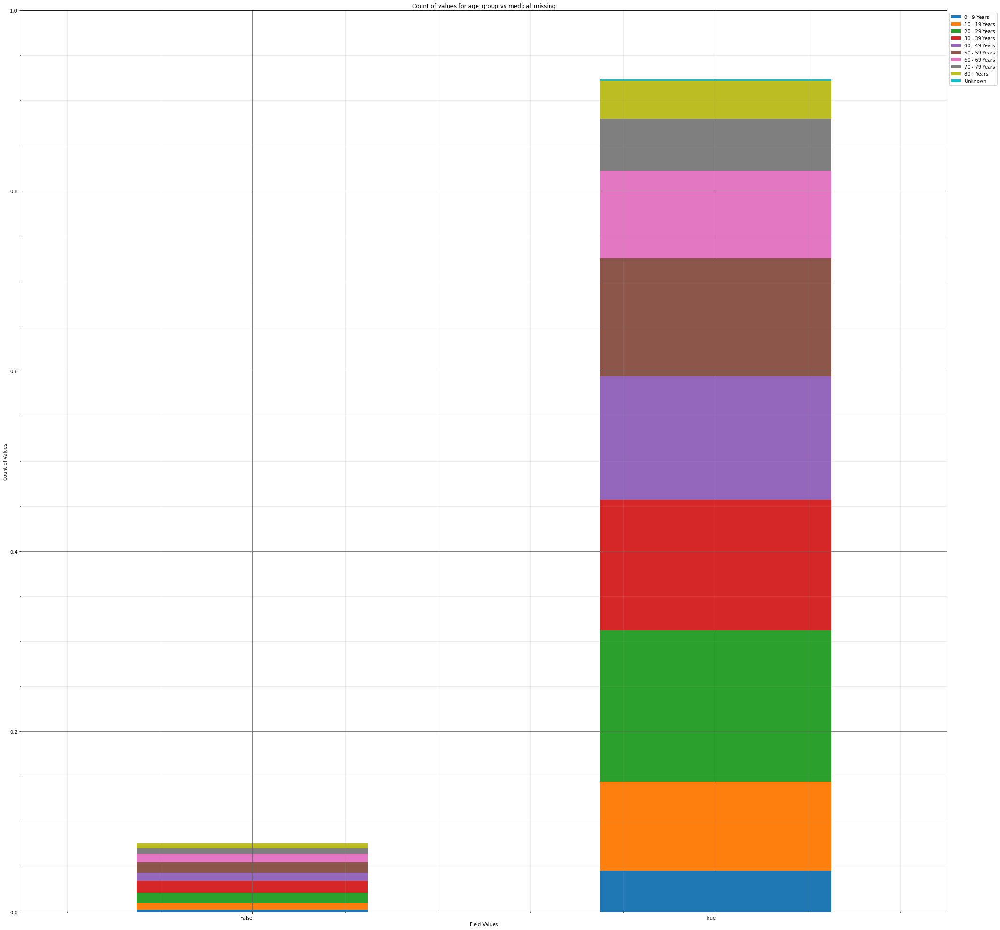



----------------------


Grouping over medical_missing|hosp_yn results in:



,medical_missing,hosp_yn,Rows,% Frequency
0,False,No,591,6.189778
1,False,OTH,0,0.000000
2,False,Unknown,0,0.000000
3,False,Yes,138,1.445329
4,True,No,4565,47.811060
5,True,OTH,0,0.000000
6,True,Unknown,3695,38.699204
7,True,Yes,559,5.854629


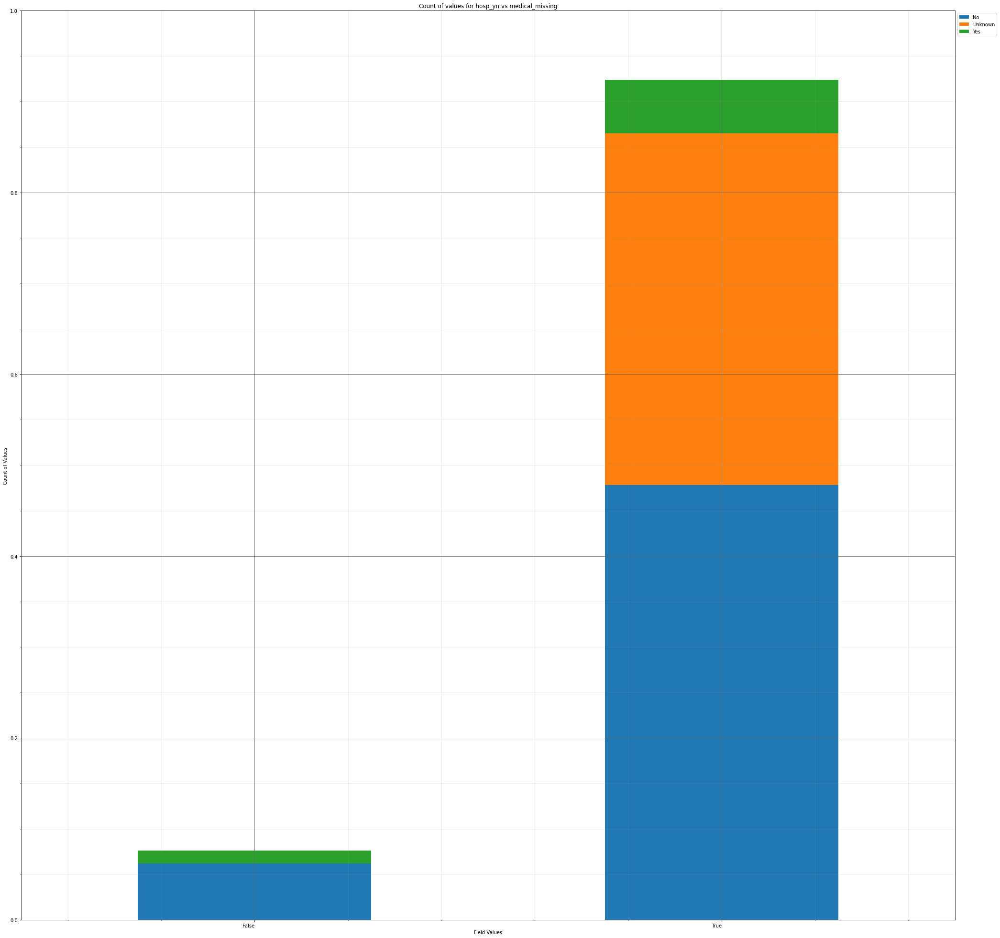



----------------------


Grouping over medical_missing|icu_yn results in:



,medical_missing,icu_yn,Rows,% Frequency
0,False,No,680,7.121910
1,False,Unknown,0,0.000000
2,False,Yes,49,0.513196
3,True,No,269,2.817344
4,True,Unknown,8509,89.118140
5,True,Yes,41,0.429409


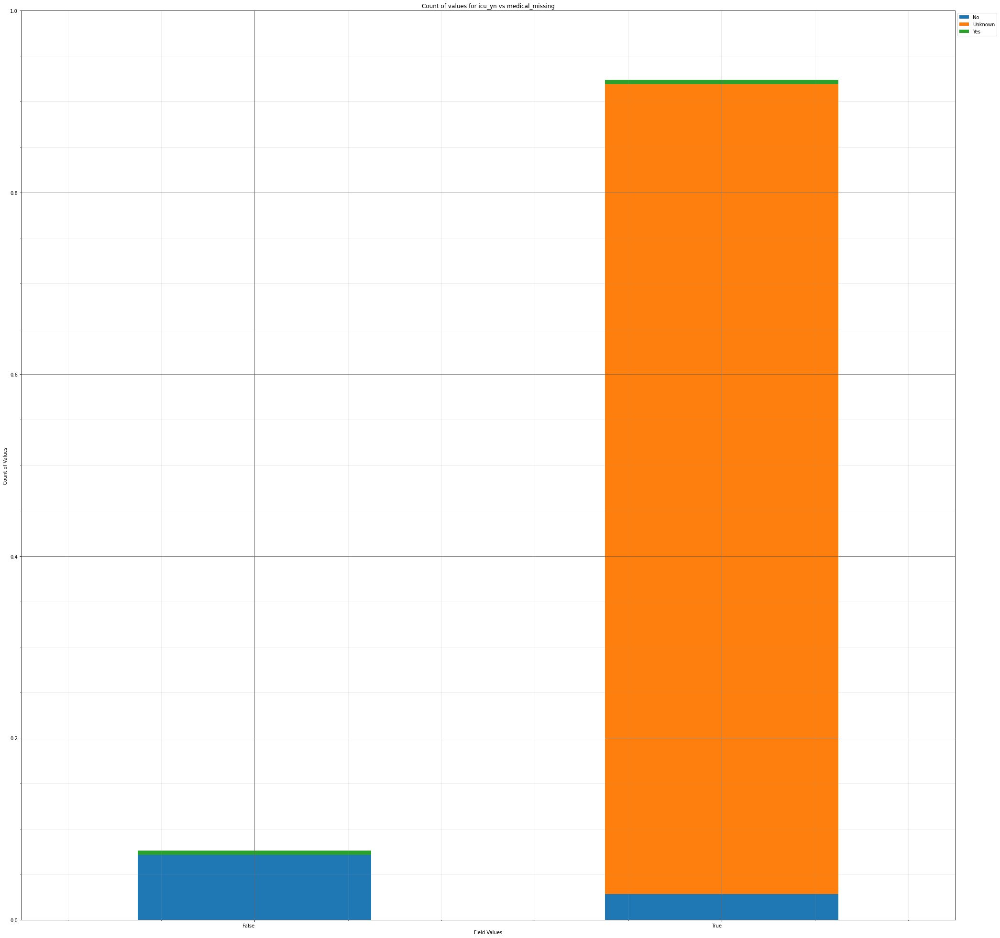



----------------------


Grouping over medical_missing|death_yn results in:



,medical_missing,death_yn,Rows,% Frequency
0,False,No,676,7.080017
1,False,Yes,53,0.555090
2,True,No,8540,89.442815
3,True,Yes,279,2.922078


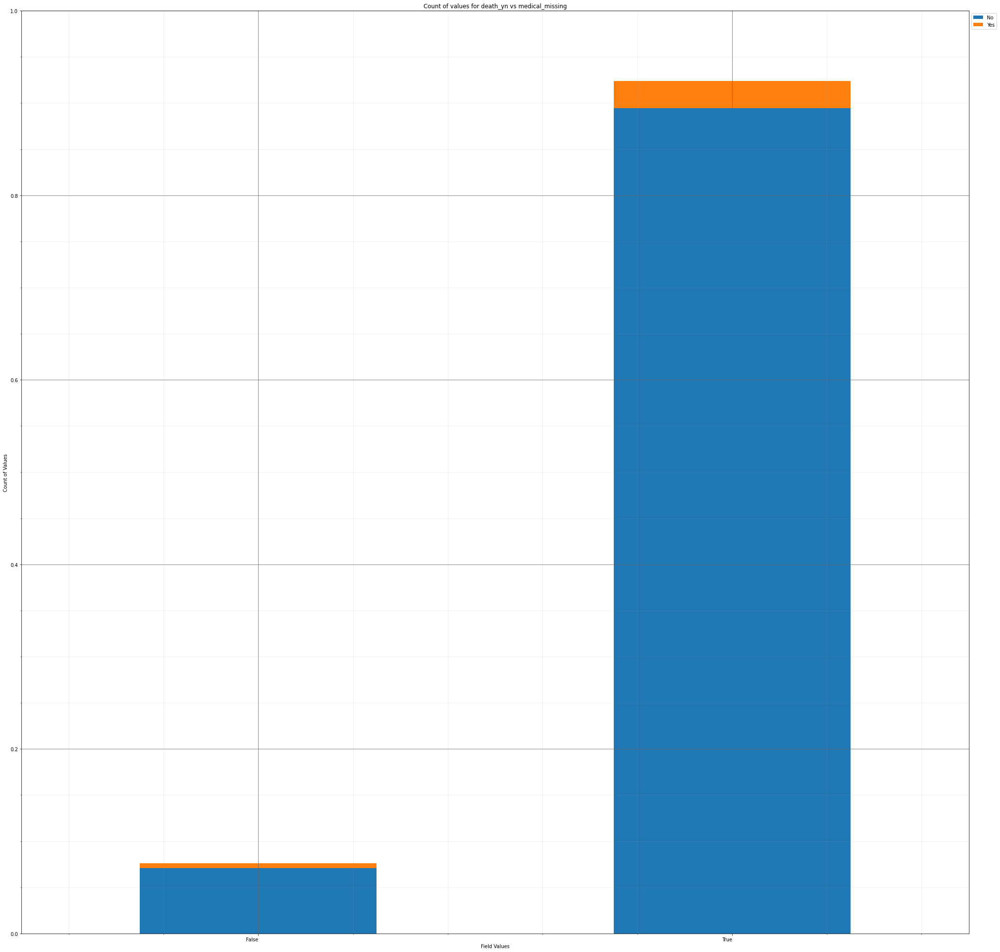



----------------------


Grouping over medical_missing|medcond_yn results in:



,medical_missing,medcond_yn,Rows,% Frequency
0,False,No,391,4.095098
1,False,Unknown,0,0.000000
2,False,Yes,338,3.540008
3,True,No,535,5.603268
4,True,Unknown,7791,81.598240
5,True,Yes,493,5.163385


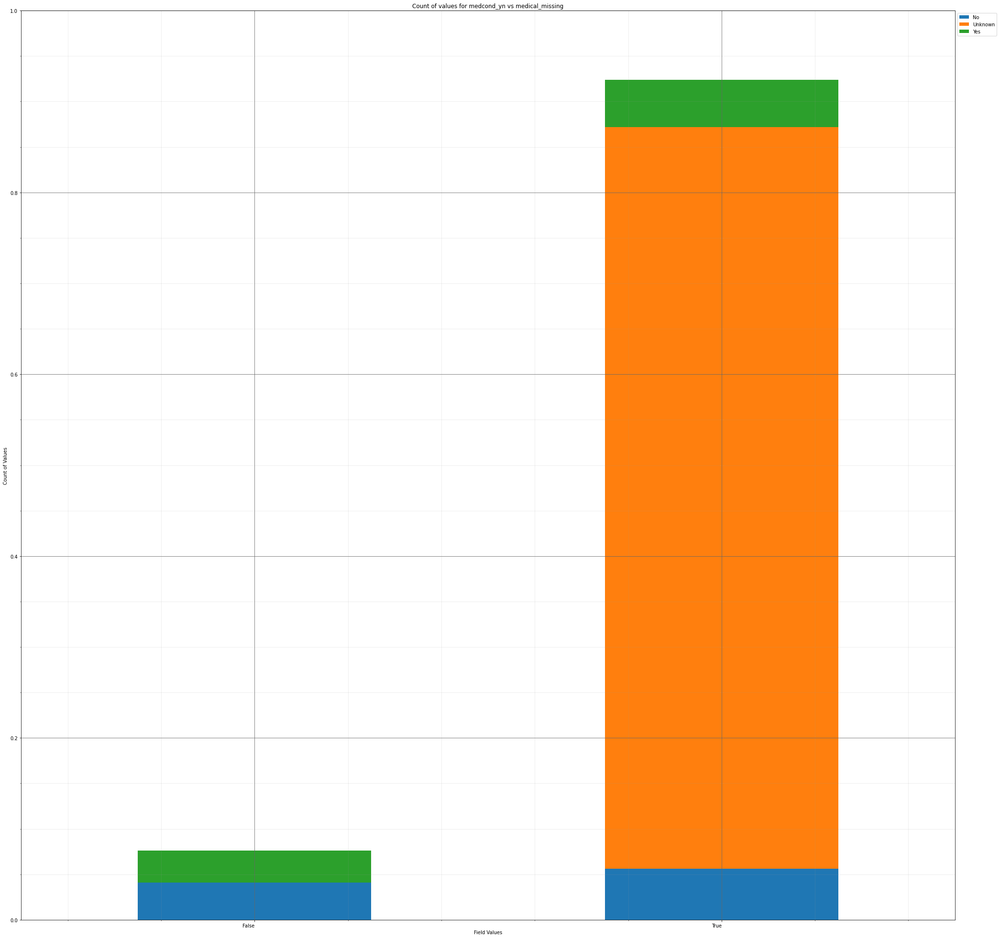



----------------------


Grouping over medical_missing|race results in:



,medical_missing,race,Rows,% Frequency
0,False,American Indian/Alaska Native,4,0.041894
1,False,Asian,12,0.125681
2,False,Black,57,0.596984
3,False,Hispanic/Latino,112,1.173021
4,False,Multiple/Other,28,0.293255
5,False,Native Hawaiian/Other Pacific Islander,3,0.031420
6,False,Unknown,144,1.508169
7,False,White,369,3.864684
8,True,American Indian/Alaska Native,62,0.649351
9,True,Asian,227,2.377461


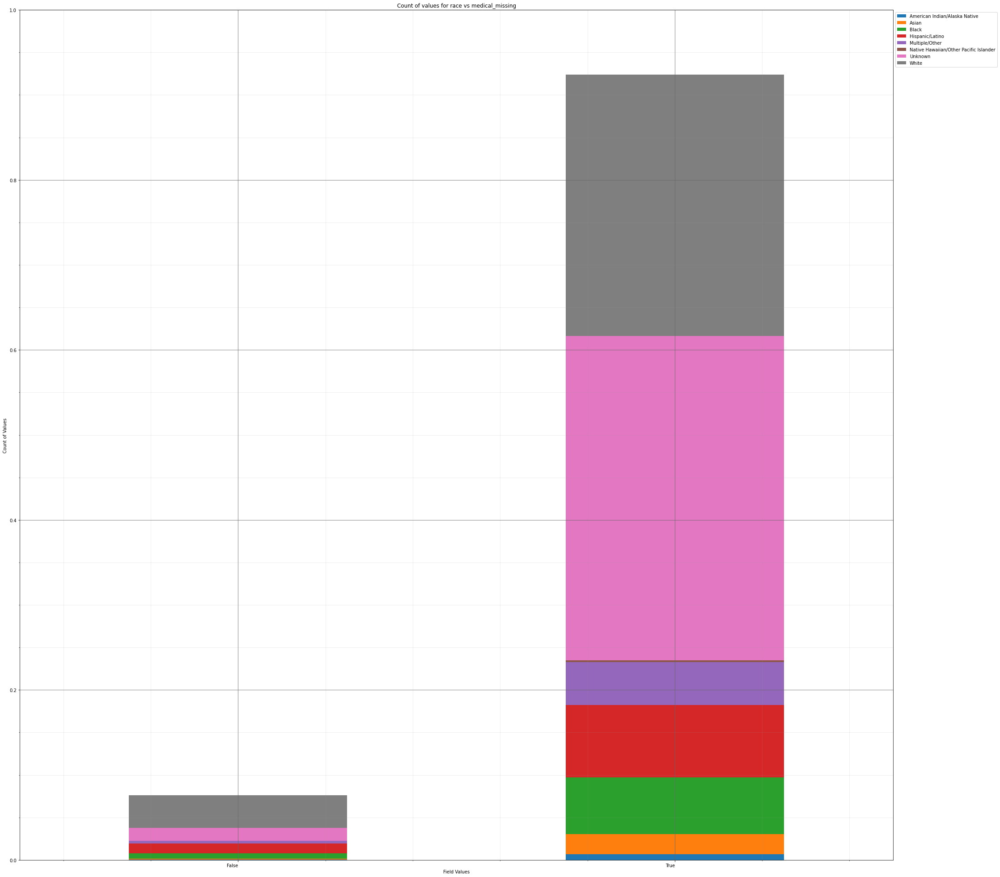



----------------------


Grouping over medical_missing|cdc_case_earliest_day results in:



,medical_missing,cdc_case_earliest_day,Rows,% Frequency
0,False,1,24,0.251362
1,False,2,20,0.209468
2,False,3,20,0.209468
3,False,4,29,0.303729
4,False,5,30,0.314202
...,...,...,...,...
57,True,27,272,2.848764
58,True,28,280,2.932551
59,True,29,298,3.121072
60,True,30,307,3.215333


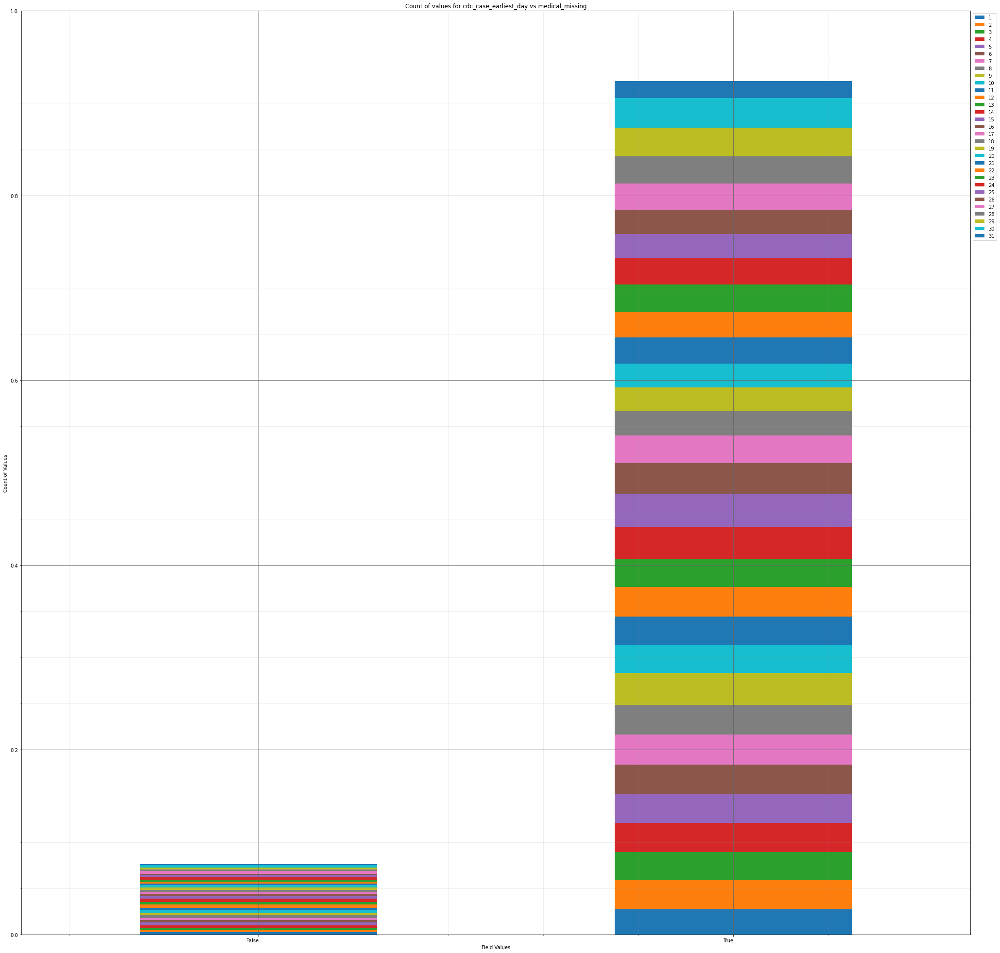



----------------------


Grouping over medical_missing|cdc_case_earliest_weekday results in:



,medical_missing,cdc_case_earliest_weekday,Rows,% Frequency
0,False,0,128,1.340595
1,False,1,106,1.110180
2,False,2,104,1.089233
3,False,3,95,0.994973
4,False,4,123,1.288228
5,False,5,92,0.963553
6,False,6,81,0.848345
7,True,0,1510,15.814830
8,True,1,1406,14.725597
9,True,2,1460,15.291160


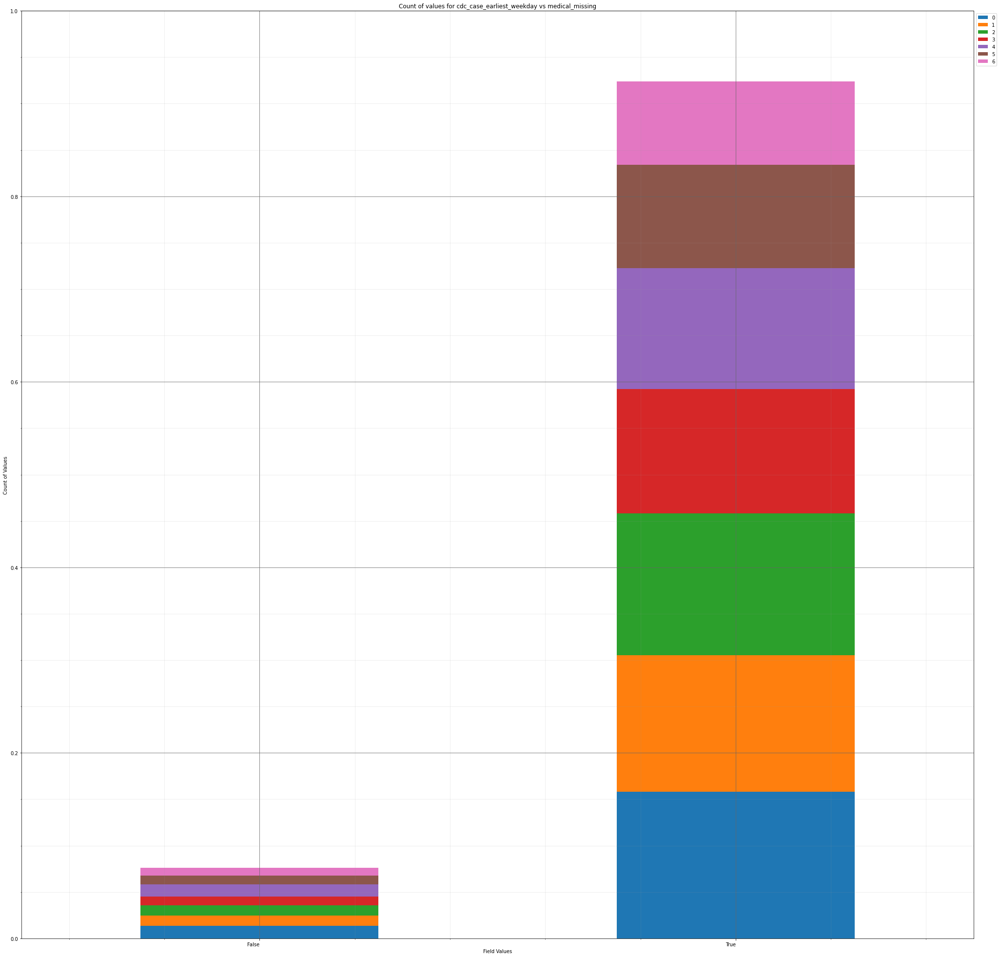



----------------------


Grouping over medical_missing|cdc_case_earliest_month results in:



,medical_missing,cdc_case_earliest_month,Rows,% Frequency
0,False,1,37,0.387516
1,False,2,0,0.000000
2,False,3,32,0.335149
3,False,4,65,0.680771
4,False,5,51,0.534143
5,False,6,51,0.534143
6,False,7,77,0.806452
7,False,8,55,0.576037
8,False,9,60,0.628404
9,False,10,110,1.152074


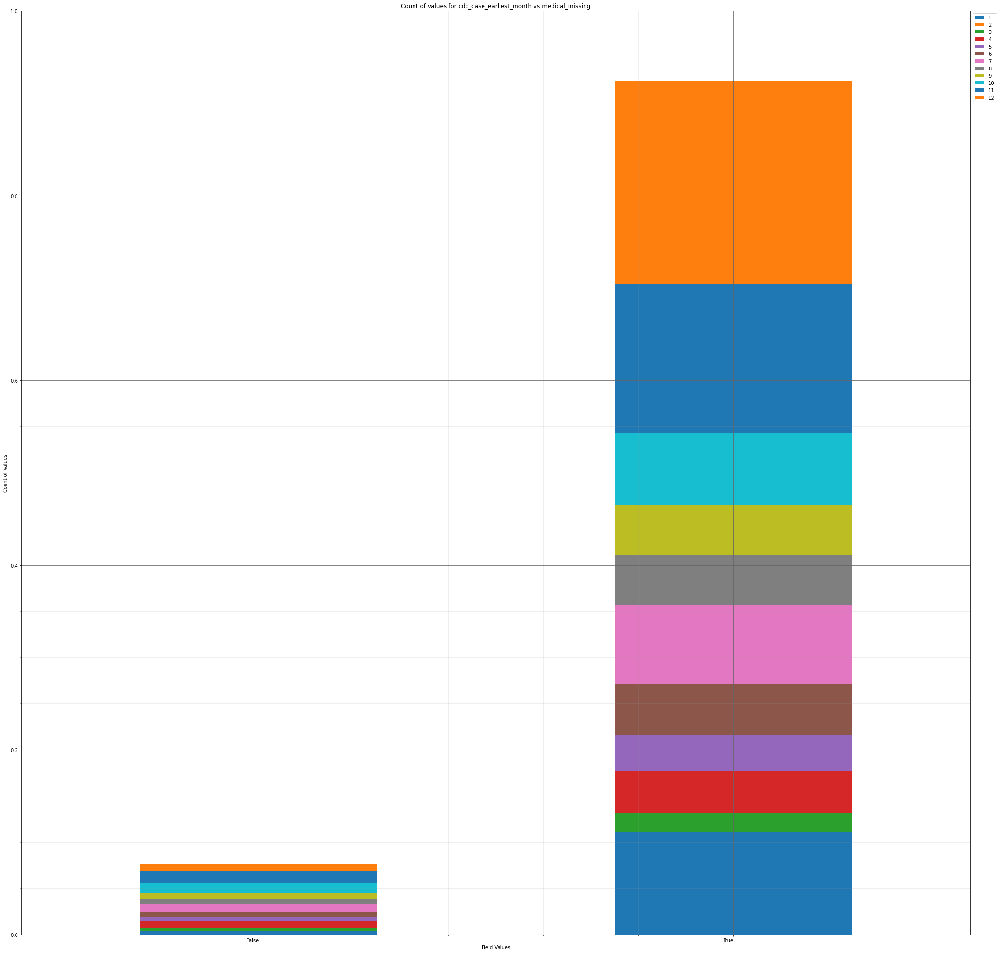



----------------------


Grouping over medical_missing|cdc_case_earliest_year results in:



,medical_missing,cdc_case_earliest_year,Rows,% Frequency
0,False,2020,692,7.247591
1,False,2021,37,0.387516
2,True,2020,7767,81.346879
3,True,2021,1052,11.018014


In [ ]:
all_pairs_dict={}
all_pairs_dict=group_over_multi_categories(adf,category_columns,multi_categorical_barplot_adf_fn,save_output=True,save_fig=True)

In [ ]:
all_single_pairs_dict={}
all_single_pairs_dict=group_over_single_categories(adf,category_columns,single_categorical_barplot_adf_fn,save_fig=True)

In [ ]:
def stacked_group_over_multi_categories(df,categorical_columns,pdf_fn,save_output=False,save_fig=False):
    """A function to group over all pairs of categories
    
    Warning: This can be memory intensive as we have (columnCount)C(2) pairings, so only run this if your device is able!"""
    
    print("Inside group_over_multi_categories()")
    row_count=len(df)
    grouping_type={}
    timestamp_now=dt.datetime.timestamp(dt.datetime.now())
    
    #Try run this
    try:
    
        #Dataframe is not empty, and there are categorical columns to group over:
        if df.empty==False and len(categorical_columns)>0:
            with PdfPages(pdf_fn) as pp:
                column=''
                second_column=''
                
                #Let's go through the category column type
                for column in categorical_columns:

                    #Second index, n^2
                    for second_column in categorical_columns:
                        multi_column=[column]


                        #Create a key to access - pipe delimited as columns contain _
                        grouping_key="{}|{}"

                        #No point in grouping the same column twice
                        if second_column!=column:
                            multi_column+=[second_column]
                            grouping_key=grouping_key.format(column,second_column)

                            #Separator
                            print('\n\n----------------------\n\n')
                            agg_df=df.groupby(multi_column).agg({df.columns[0]:"count"})
                            agg_df=agg_df.reset_index()
                            agg_df=agg_df.rename(columns={df.columns[0]:'Rows'})
                            agg_df['% Frequency']=100*(agg_df['Rows']/row_count)

                            #Be explicit over what we're displaying
                            print('Grouping over {} results in:\n'.format(grouping_key))

                            #Display the result
                            display(agg_df)
                            agg_df=agg_df.reset_index()

                            sagg_df=(
                                    adf
                                    .groupby([column])
                                    .agg({adf.columns[0]:"count"})
                                    .reset_index()
                                    .rename(columns={adf.columns[0]:'TotalRows'})
                                    )

                            join_df=agg_df.merge(sagg_df,left_on=column,right_on=column,suffixes=('_subbed','_group'))
                            join_df['% Stacked']=join_df['Rows']/join_df['TotalRows']

                            figure=((join_df
                                  .pivot_table(index=column,columns=second_column,values='% Stacked')
                                  .fillna(0))

                                          .plot(kind='bar'
                                            , stacked=True
                                            , title='Distribution of values for {} vs {}'.format(second_column,column)
                                            , xlabel='Field Values'
                                            , ylabel='Makeup of Values'
                                            , figsize=(35,35)

                            ))

                            #This grid style is from the sample Lab5 as I like how it looks
                            plt.ylim([0,1])
                            plt.grid(b=True, which='major', color='#666666', linestyle='-')
                            plt.setp(figure.get_xticklabels(), ha="right", rotation=0)
                            plt.minorticks_on()
                            plt.grid(b=True, which='minor', color='#999999', linestyle='-', alpha=0.2)
                            plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)
                            plt.show()

                            

                            if save_fig:
                                pp.savefig(figure.get_figure())

                            #Only save if explicitly passed - This could kill your memory.
                            if save_output:
                                grouping_type[grouping_key]=agg_df

                        
    #Catch exceptions
    except Exception as exc:
        print("Function exception:\n")
        #check exception is memory error
        if exc==MemoryError:
            print("Sorry, your device is not able to run this function as you have hit a memory limit")
            
        print(exc)
        

    return grouping_type

In [ ]:
#Be careful if you run this. You'll need a good computer or this will kill it

In [ ]:
stack_dict={}

stack_dict=stacked_group_over_multi_categories(adf,category_columns,stack_multi_categorical_barplot_adf_fn,save_output=,save_fig=True)

# Extension and Analysis Commentary

## Extension Commentary

I elected to pair and plot all combinations of features within the dataset. 

To extend the set, I created day, month, year, and workday featuers for the cdc_case date. This was primarily to help determine if cases followed any trend in terms of timing in the week or month or year which could be insightful. Confounding factors could be if certain areas operate on a rotating staff basis, then potentially trends in deaths could point for further area to investigate.

Adding on to my earlier analysis and inspection, I changed the onset date into a column highlighting the number of days after diagnosis that symptoms appeared. My initial hypothesis surrounding this is that individuals who got tested and did not become symptomatic until later would have had a better expected outcome due to earlier intervention and treatment management and that this could have predictive power in determining if a patient was at risk of dying.

Finally, I added flags for whether demographic or medical data was missing for a particular record. Although I personally wished to avoid removing duplicates until it becomes fed into an ML model, it will be necessary to experiment with different featuers being present or absent given the high quantity of missing values within the dataset. These flags are to provide a convenient way to filter the dataset and focus on the rows where a full dataset is present if needed.

## Analysis

For the purpose of analysing pairs of featurs, beyond some of the analysis already conducted, I am electing to focus on plotting the target feature death_yn verssu other cathegorical columns. Other features of interest may be pbriefly discussed however the year focus will be on the death_yn feature against others. Unfortunately as the data is primarily categorical, the analysis focuses primarily on feature distribution.

Key Points:

* death vs age highlights an increasing relative proportion of deaths among patients in the older cohort, rising from a minor factor among 30-39 years to occupying an increased proportion as the age increases suggested this factor is likely an indicator which should be factored into our model.

* death vs hosp_yn and icu_yn : Among those with hosp_yn = True and/or icu_yn=True, the death rate is similarly significantly larger in relative likelihood compared to other attribute combinations.

* month vs death Interestingly over time the deaths per moment as a proportion they've occupied has decreased with February particularly high in terms of the proportion of deaths and this proportion decreases from March onwards.

* medcond vs death Interestingly although the comorbidity True instances features an elevated proportion of Death, the increase was not as significant as I had expected.

* race vs Death American Indian and Black individuals in the sample set are dying at a higher proportion than other races. Given that the context of this dataset is from the CDC and focuses on the American healthcare system, where wealth is a significant factor in terms of quality of treatment and racial biases are likely to leave minorities to be at an economic disadvantage, this is potentially a contributing element.

* day vs death People whose CDC Earliest date is The 24th and 25th day in the month are most likely to die over the course of treatment. Although the impact of this is not as significant as other factors 

One area of note is that a 100% stacked bar chart diminishes the importance of how prevalent features actually area and fails to saccount for how single instances are more likely to have an impact on a feature of smaller size. Due to this, the barcharts which are stacked can give a highly misleading view of the data (although can be useful to gain a perspective on relevant factors to our model) and should be considered in relation to the stacked (but not 100% stacked) bar charts produced continuously within the report. 